In [1]:
import os
import optuna
import numpy as np
import pandas as pd
import warnings
# from three_class_ncv_selectk import NestedCVOptimizer
from two_class_loo import LeaveOneOutNestedCVOptimizer
warnings.filterwarnings('ignore')

/home/edumaba/Public/MPhil_Thesis/Code/wear_uropatch/.venv/lib/python3.12/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
def nested_cv_binary(X, y, groups, exp_name, positive_class="void", save_plots=True):
    """
    Run binary nested cross-validation with comprehensive results including confusion matrices.
    
    Parameters:
    -----------
    X : DataFrame
        Feature matrix
    y : Series/array 
        Target labels (binary)
    groups : Series/array
        Group labels for GroupKFold
    exp_name : str
        Experiment name for saving plots
    positive_class : str
        Which class to treat as positive (default: "void")
    save_plots : bool
        Whether to save visualization plots
        
    Returns:
    --------
    dict: Comprehensive results including DataFrames and confusion matrices
    """
    # Initialize binary classifier
    optimizer = LeaveOneOutNestedCVOptimizer(  # Use Document 2 implementation
        X=X,
        y=y,
        groups=groups,
        positive_class=positive_class,
        n_inner_folds=3,
        n_trials=50,
        random_state=42
    )
    
    print(f"\nRunning binary nested cross-validation...")
    print(f"Positive class: '{positive_class}'")
    summaries = optimizer.run_nested_cv()
    
    # Get comprehensive results
    results_df = optimizer.get_results_dataframe()
    # auc_summary = optimizer.get_auc_summary()
    feature_summary = optimizer.get_feature_selection_summary()
    # cm_summary = optimizer.get_confusion_matrices_summary()
    cm_dataframe = optimizer.get_confusion_matrix_dataframe()
    
    # Print key results
    print(f"\n📊 BINARY CLASSIFICATION RESULTS:")
    if 'best_model' in summaries:
        print(f"Best performing model: {summaries['best_model'].upper()}")
        print(f"Best F1 (positive): {summaries['best_f1_positive']:.4f}")
        print(f"Best accuracy: {summaries['best_accuracy']:.4f}")
        print(f"Best AUC: {summaries['best_auc']:.4f}")
    else:
        print("Error: Could not determine best model")
    
    # Generate and save plots if requested
    if save_plots:
        plot_dir = f"plots_{exp_name}_binary"
        import os
        os.makedirs(plot_dir, exist_ok=True)
        
        # ROC curves
        optimizer.plot_roc_curves(save_path=f"{plot_dir}/roc_curves.png")
        
        # # AUC comparison
        # optimizer.plot_auc_comparison(save_path=f"{plot_dir}/auc_comparison.png")
        
        # # Feature selection analysis
        # optimizer.plot_feature_selection_analysis(save_path=f"{plot_dir}/feature_analysis.png")
        
        # # Confusion matrices - aggregated view
        # optimizer.plot_confusion_matrices(save_path=f"{plot_dir}/confusion_matrices.png")
        
        # # Individual fold confusion matrices for best model
        # best_model = summaries.get('best_model', 'rf')
        # optimizer.plot_individual_fold_cms(
        #     model_name=best_model, 
        #     save_path=f"{plot_dir}/cm_folds_{best_model}.png"
        # )
        
        # print(f"\n📁 Plots saved to: {plot_dir}/")
    
    return {
        'summary': summaries,
        'results_dataframe': results_df,
        # 'auc_summary': auc_summary,
        'feature_summary': feature_summary,
        # 'confusion_matrices': cm_summary,
        'confusion_matrix_dataframe': cm_dataframe,
        'optimizer': optimizer  # Keep reference for additional analysis
    }

In [3]:
files = [
    'two_class_pp_1s_no.csv',
    'two_class_pp_1s_0.5.csv',
    'two_class_pp_1s_0.8.csv',
    'two_class_pp_2s_no.csv',
    'two_class_pp_2s_0.5.csv',
    'two_class_pp_2s_0.8.csv',
    'two_class_pp_3s_no.csv',
    'two_class_pp_3s_0.5.csv',
    'two_class_pp_3s_0.8.csv',
    'two_class_pp_4s_no.csv',
    'two_class_pp_4s_0.5.csv',
    'two_class_pp_4s_0.8.csv',
    'two_class_pp_5s_no.csv',
    'two_class_pp_5s_0.5.csv',
    'two_class_pp_5s_0.8.csv'
]

base_path = '/home/edumaba/Public/MPhil_Thesis/Code/wear_uropatch/pipeline/data_extracted_features'


1. Loop through all files
2. Perform nested cross validation on each file
3. Store result in this format

![Output format](/home/edumaba/Public/MPhil_Thesis/Code/wear_uropatch/output_format.png)


[I 2025-09-17 22:27:22,641] A new study created in memory with name: no-name-e7f805e4-3c66-4398-973b-3473cacd4f27


Nested cross-validation for 1s_no
Leave-One-Out CV will use 41 folds (one per experiment)
Experiments: [np.int64(1), np.int64(2), np.int64(3), np.int64(4), np.int64(5), np.int64(6), np.int64(7), np.int64(8), np.int64(9), np.int64(10), np.int64(11), np.int64(12), np.int64(13), np.int64(14), np.int64(15), np.int64(16), np.int64(17), np.int64(18), np.int64(19), np.int64(20), np.int64(21), np.int64(22), np.int64(23), np.int64(24), np.int64(25), np.int64(26), np.int64(27), np.int64(28), np.int64(29), np.int64(30), np.int64(31), np.int64(32), np.int64(33), np.int64(34), np.int64(35), np.int64(36), np.int64(37), np.int64(38), np.int64(39), np.int64(40), np.int64(41)]
Positive class 'void' is encoded as: 1
Label mapping: {'non-void': np.int64(0), 'void': np.int64(1)}

Running binary nested cross-validation...
Positive class: 'void'
Starting Leave-One-Out Nested Cross-Validation...
Will evaluate on 41 experiments (one held out per fold)

OUTER FOLD 1/41
Testing on experiment: 1
Train size: 2350

[I 2025-09-17 22:27:23,863] Trial 0 finished with value: -0.561078887352536 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.561078887352536.
[I 2025-09-17 22:27:24,288] Trial 1 finished with value: -0.5621449592719677 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.561078887352536.
[I 2025-09-17 22:27:27,061] Trial 2 finished with value: -3.702708766463058 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf__

Best rf params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 239, 'clf__max_depth': 5, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5488


[I 2025-09-17 22:29:08,491] A new study created in memory with name: no-name-ce9fb42e-2e54-4664-9658-72e5a9f76f0c


Features selected: 71/102
rf - Accuracy: 0.6458, F1(pos): 0.4848, AUC: 0.7878

--- Optimizing XGB for experiment 1 ---


[I 2025-09-17 22:29:08,816] Trial 0 finished with value: -0.6284504130707088 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6284504130707088.
[I 2025-09-17 22:29:10,826] Trial 1 finished with value: -0.5565877484713916 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 273, 'clf__max_depth': 3, 'clf__learning_rate': 0.02322603960091936, 'clf__subsample': 0.7387896328548333, 'clf__colsample_bytree': 0.8176668757829195, 'clf__min_child_weight': 2, 'clf__gamma': 4.65635700309942, 'clf__reg_alpha': 1.6071015597052793, 'clf__reg_lambda': 1.2375668966187927}
Best xgb neg_log_loss: -0.5459
Features selected: 30/102
xgb - Accuracy: 0.6458, F1(pos): 0.5641, AUC: 0.7530

--- Optimizing DT for experiment 1 ---


[I 2025-09-17 22:29:50,446] Trial 0 finished with value: -5.7504130344808395 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -5.7504130344808395.
[I 2025-09-17 22:29:50,481] Trial 1 finished with value: -0.6197825030268201 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6197825030268201.
[I 2025-09-17 22:29:50,510] Trial 2 finished with value: -1.0263177077875654 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sa

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5960
Features selected: 30/102
dt - Accuracy: 0.7292, F1(pos): 0.7111, AUC: 0.7626

OUTER FOLD 2/41
Testing on experiment: 2
Train size: 2361 (from 40 experiments)
Test size: 37
Test class distribution: {'non-void': np.int64(25), 'void': np.int64(12)}

--- Optimizing RF for experiment 2 ---


[I 2025-09-17 22:29:54,225] Trial 0 finished with value: -0.5700547508782948 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5700547508782948.
[I 2025-09-17 22:29:54,613] Trial 1 finished with value: -0.5768196196538856 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5700547508782948.
[I 2025-09-17 22:29:57,469] Trial 2 finished with value: -3.700667044385027 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 423, 'clf__max_depth': 6, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5603


[I 2025-09-17 22:31:35,207] A new study created in memory with name: no-name-a855f1f2-76a2-4476-b846-4240612618b5


Features selected: 91/102
rf - Accuracy: 0.7838, F1(pos): 0.7500, AUC: 0.8433

--- Optimizing XGB for experiment 2 ---


[I 2025-09-17 22:31:35,565] Trial 0 finished with value: -0.6500119127829577 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6500119127829577.
[I 2025-09-17 22:31:37,164] Trial 1 finished with value: -0.5617410176953949 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 476, 'clf__max_depth': 10, 'clf__learning_rate': 0.011029539618590161, 'clf__subsample': 0.9947127635757649, 'clf__colsample_bytree': 0.6047606839380596, 'clf__min_child_weight': 5, 'clf__gamma': 4.994720633222883, 'clf__reg_alpha': 1.3660681759802678, 'clf__reg_lambda': 1.9449454545330427}
Best xgb neg_log_loss: -0.5599


[I 2025-09-17 22:32:28,074] A new study created in memory with name: no-name-3a7a6a61-e7ae-4bbb-9d75-7d052647861e
[I 2025-09-17 22:32:28,179] Trial 0 finished with value: -5.9989901689567775 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -5.9989901689567775.
[I 2025-09-17 22:32:28,214] Trial 1 finished with value: -0.6228832754652719 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6228832754652719.
[I 2025-09-17 22:32:28,243] Trial 2 finished with value: -1.1063980312526713 and parameters: {'selecto

Features selected: 71/102
xgb - Accuracy: 0.8108, F1(pos): 0.7742, AUC: 0.8367

--- Optimizing DT for experiment 2 ---


[I 2025-09-17 22:32:28,301] Trial 3 finished with value: -4.239886776991397 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6228832754652719.
[I 2025-09-17 22:32:28,353] Trial 4 finished with value: -4.461161168940759 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6228832754652719.
[I 2025-09-17 22:32:28,756] Trial 5 finished with value: -6.609878383033833 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_sample

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 4, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5989
Features selected: 20/102
dt - Accuracy: 0.8108, F1(pos): 0.7586, AUC: 0.8533

OUTER FOLD 3/41
Testing on experiment: 3
Train size: 2336 (from 40 experiments)
Test size: 62
Test class distribution: {'non-void': np.int64(46), 'void': np.int64(16)}

--- Optimizing RF for experiment 3 ---


[I 2025-09-17 22:32:31,901] Trial 0 finished with value: -0.6161707270918012 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.6161707270918012.
[I 2025-09-17 22:32:32,274] Trial 1 finished with value: -0.6489954903965196 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.6161707270918012.
[I 2025-09-17 22:32:35,025] Trial 2 finished with value: -4.450809215350188 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 306, 'clf__max_depth': 3, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 3, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.6047


[I 2025-09-17 22:34:01,070] A new study created in memory with name: no-name-890d218a-939b-4782-af1d-91cec1774208


Features selected: 91/102
rf - Accuracy: 0.7097, F1(pos): 0.6087, AUC: 0.8709

--- Optimizing XGB for experiment 3 ---


[I 2025-09-17 22:34:01,367] Trial 0 finished with value: -0.755565223546207 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.755565223546207.
[I 2025-09-17 22:34:02,975] Trial 1 finished with value: -0.6293546130901552 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value:

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 123, 'clf__max_depth': 6, 'clf__learning_rate': 0.0122307926622537, 'clf__subsample': 0.6371708830871397, 'clf__colsample_bytree': 0.9304617187495055, 'clf__min_child_weight': 3, 'clf__gamma': 4.49691220641385, 'clf__reg_alpha': 1.6904886955903518, 'clf__reg_lambda': 1.2583499918339336}
Best xgb neg_log_loss: -0.6089
Features selected: 10/102
xgb - Accuracy: 0.7742, F1(pos): 0.5333, AUC: 0.8356

--- Optimizing DT for experiment 3 ---


[I 2025-09-17 22:34:31,744] Trial 1 finished with value: -0.6613240586444854 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6613240586444854.
[I 2025-09-17 22:34:31,774] Trial 2 finished with value: -1.1940069952480157 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6613240586444854.
[I 2025-09-17 22:34:31,828] Trial 3 finished with value: -5.9678563836239436 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf

Best dt params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 9, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6343
Features selected: 102/102
dt - Accuracy: 0.7097, F1(pos): 0.5500, AUC: 0.7038

OUTER FOLD 4/41
Testing on experiment: 4
Train size: 2342 (from 40 experiments)
Test size: 56
Test class distribution: {'non-void': np.int64(31), 'void': np.int64(25)}

--- Optimizing RF for experiment 4 ---


[I 2025-09-17 22:34:35,117] Trial 0 finished with value: -0.5754725081716154 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5754725081716154.
[I 2025-09-17 22:34:35,500] Trial 1 finished with value: -0.5922582439522258 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5754725081716154.
[I 2025-09-17 22:34:38,365] Trial 2 finished with value: -3.795447262826409 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 173, 'clf__max_depth': 4, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 4, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5736


[I 2025-09-17 22:35:43,754] A new study created in memory with name: no-name-e3ca9150-5e11-46d5-ab34-34e8ecc48534


Features selected: 30/102
rf - Accuracy: 0.7857, F1(pos): 0.7857, AUC: 0.8761

--- Optimizing XGB for experiment 4 ---


[I 2025-09-17 22:35:44,057] Trial 0 finished with value: -0.6707495840719476 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6707495840719476.
[I 2025-09-17 22:35:46,127] Trial 1 finished with value: -0.590121324712373 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 340, 'clf__max_depth': 6, 'clf__learning_rate': 0.04854332100916635, 'clf__subsample': 0.9577966568775824, 'clf__colsample_bytree': 0.6809608397748588, 'clf__min_child_weight': 1, 'clf__gamma': 4.806007823092496, 'clf__reg_alpha': 1.8130460876664003, 'clf__reg_lambda': 0.9356313552491633}
Best xgb neg_log_loss: -0.5781
Features selected: 20/102
xgb - Accuracy: 0.7679, F1(pos): 0.7797, AUC: 0.8542

--- Optimizing DT for experiment 4 ---


[I 2025-09-17 22:36:18,263] Trial 0 finished with value: -6.427850333502559 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.427850333502559.
[I 2025-09-17 22:36:18,298] Trial 1 finished with value: -0.6353964991088005 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6353964991088005.
[I 2025-09-17 22:36:18,329] Trial 2 finished with value: -1.0099876927672269 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 4, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6063
Features selected: 81/102
dt - Accuracy: 0.7321, F1(pos): 0.7619, AUC: 0.7626

OUTER FOLD 5/41
Testing on experiment: 5
Train size: 2363 (from 40 experiments)
Test size: 35
Test class distribution: {'non-void': np.int64(15), 'void': np.int64(20)}

--- Optimizing RF for experiment 5 ---


[I 2025-09-17 22:36:22,156] Trial 0 finished with value: -0.5626396939162238 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5626396939162238.
[I 2025-09-17 22:36:22,532] Trial 1 finished with value: -0.5738907033349744 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5626396939162238.
[I 2025-09-17 22:36:25,348] Trial 2 finished with value: -4.117072434025082 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 418, 'clf__max_depth': 7, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5514


[I 2025-09-17 22:38:01,541] A new study created in memory with name: no-name-95b75874-ab9d-4bff-9c5e-736e74ba801e


Features selected: 71/102
rf - Accuracy: 0.6000, F1(pos): 0.4615, AUC: 0.8633

--- Optimizing XGB for experiment 5 ---


[I 2025-09-17 22:38:01,819] Trial 0 finished with value: -0.6312537117219782 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6312537117219782.
[I 2025-09-17 22:38:03,606] Trial 1 finished with value: -0.5614956779228257 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 265, 'clf__max_depth': 3, 'clf__learning_rate': 0.012532527780061016, 'clf__subsample': 0.8051841926843529, 'clf__colsample_bytree': 0.8196383184451304, 'clf__min_child_weight': 1, 'clf__gamma': 3.7503807703117076, 'clf__reg_alpha': 0.7727137010706535, 'clf__reg_lambda': 1.8359221519360756}
Best xgb neg_log_loss: -0.5502
Features selected: 30/102
xgb - Accuracy: 0.6286, F1(pos): 0.5517, AUC: 0.8133

--- Optimizing DT for experiment 5 ---


[I 2025-09-17 22:38:43,405] Trial 0 finished with value: -6.777212380662005 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.777212380662005.
[I 2025-09-17 22:38:43,440] Trial 1 finished with value: -0.6435433145590465 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6435433145590465.
[I 2025-09-17 22:38:43,470] Trial 2 finished with value: -0.8798328652544374 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 3, 'clf__min_samples_split': 4, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5933
Features selected: 20/102
dt - Accuracy: 0.4857, F1(pos): 0.1818, AUC: 0.8067

OUTER FOLD 6/41
Testing on experiment: 6
Train size: 2325 (from 40 experiments)
Test size: 73
Test class distribution: {'non-void': np.int64(50), 'void': np.int64(23)}

--- Optimizing RF for experiment 6 ---


[I 2025-09-17 22:38:46,983] Trial 0 finished with value: -0.6278474194868586 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.6278474194868586.
[I 2025-09-17 22:38:47,362] Trial 1 finished with value: -0.6651577517449409 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.6278474194868586.
[I 2025-09-17 22:38:50,193] Trial 2 finished with value: -4.36847260159852 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 236, 'clf__max_depth': 3, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.6042


[I 2025-09-17 22:40:22,762] A new study created in memory with name: no-name-cd5721fa-fef6-44a4-a956-92ac1bf3f077


Features selected: 81/102
rf - Accuracy: 0.8630, F1(pos): 0.8000, AUC: 0.9052

--- Optimizing XGB for experiment 6 ---


[I 2025-09-17 22:40:23,047] Trial 0 finished with value: -0.747924998934232 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.747924998934232.
[I 2025-09-17 22:40:24,750] Trial 1 finished with value: -0.6332956885221704 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value:

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 150, 'clf__max_depth': 3, 'clf__learning_rate': 0.015128668558533962, 'clf__subsample': 0.662458580801042, 'clf__colsample_bytree': 0.6583160559936805, 'clf__min_child_weight': 1, 'clf__gamma': 4.741356440312435, 'clf__reg_alpha': 1.5526692004081428, 'clf__reg_lambda': 0.7610835412977461}
Best xgb neg_log_loss: -0.6093
Features selected: 30/102


[I 2025-09-17 22:40:51,628] A new study created in memory with name: no-name-21668bcc-983c-47d5-bbe4-641a5adbe329
[I 2025-09-17 22:40:51,732] Trial 0 finished with value: -7.173618552512292 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.173618552512292.
[I 2025-09-17 22:40:51,767] Trial 1 finished with value: -0.6413633123736201 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6413633123736201.
[I 2025-09-17 22:40:51,796] Trial 2 finished with value: -1.1401841356734788 and parameters: {'selector_

xgb - Accuracy: 0.7808, F1(pos): 0.6000, AUC: 0.8896

--- Optimizing DT for experiment 6 ---


[I 2025-09-17 22:40:51,850] Trial 3 finished with value: -5.660607062439894 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6413633123736201.
[I 2025-09-17 22:40:51,913] Trial 4 finished with value: -5.534204361134143 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6413633123736201.
[I 2025-09-17 22:40:52,342] Trial 5 finished with value: -7.781916011385657 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_sample

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 9, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6389
Features selected: 20/102
dt - Accuracy: 0.8493, F1(pos): 0.7925, AUC: 0.8526

OUTER FOLD 7/41
Testing on experiment: 7
Train size: 2352 (from 40 experiments)
Test size: 46
Test class distribution: {'non-void': np.int64(25), 'void': np.int64(21)}

--- Optimizing RF for experiment 7 ---


[I 2025-09-17 22:40:55,536] Trial 0 finished with value: -0.5791480627649288 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5791480627649288.
[I 2025-09-17 22:40:55,916] Trial 1 finished with value: -0.6057224902084299 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5791480627649288.
[I 2025-09-17 22:40:58,741] Trial 2 finished with value: -3.7247331159850994 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__n_estimators': 379, 'clf__max_depth': 4, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5738


[I 2025-09-17 22:42:48,646] A new study created in memory with name: no-name-74016710-779f-457d-a2ed-54ac3cf95521


Features selected: 51/102
rf - Accuracy: 0.8913, F1(pos): 0.8837, AUC: 0.9124

--- Optimizing XGB for experiment 7 ---


[I 2025-09-17 22:42:49,060] Trial 0 finished with value: -0.6703671372945633 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6703671372945633.
[I 2025-09-17 22:42:50,757] Trial 1 finished with value: -0.5900577657653455 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 188, 'clf__max_depth': 11, 'clf__learning_rate': 0.02566352274944779, 'clf__subsample': 0.8653670933226422, 'clf__colsample_bytree': 0.8879287103745993, 'clf__min_child_weight': 3, 'clf__gamma': 4.967411011074679, 'clf__reg_alpha': 1.9143516532785894, 'clf__reg_lambda': 0.11224783347810953}
Best xgb neg_log_loss: -0.5778
Features selected: 20/102
xgb - Accuracy: 0.8696, F1(pos): 0.8571, AUC: 0.9124

--- Optimizing DT for experiment 7 ---


[I 2025-09-17 22:43:16,540] Trial 0 finished with value: -6.710235963581266 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.710235963581266.
[I 2025-09-17 22:43:16,581] Trial 1 finished with value: -0.634663786424697 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.634663786424697.
[I 2025-09-17 22:43:16,624] Trial 2 finished with value: -1.0432090466621005 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sample

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 1, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6172
Features selected: 20/102
dt - Accuracy: 0.7826, F1(pos): 0.7917, AUC: 0.9048

OUTER FOLD 8/41
Testing on experiment: 8
Train size: 2355 (from 40 experiments)
Test size: 43
Test class distribution: {'non-void': np.int64(21), 'void': np.int64(22)}

--- Optimizing RF for experiment 8 ---


[I 2025-09-17 22:43:21,607] Trial 0 finished with value: -0.5710303582499823 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5710303582499823.
[I 2025-09-17 22:43:21,984] Trial 1 finished with value: -0.5797851143978936 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5710303582499823.
[I 2025-09-17 22:43:24,792] Trial 2 finished with value: -3.8495101663391367 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 392, 'clf__max_depth': 11, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5627


[I 2025-09-17 22:45:26,580] A new study created in memory with name: no-name-aea1e73f-fe88-40a4-bb6c-0eb72463b364


Features selected: 91/102
rf - Accuracy: 0.6512, F1(pos): 0.7059, AUC: 0.7056

--- Optimizing XGB for experiment 8 ---


[I 2025-09-17 22:45:26,928] Trial 0 finished with value: -0.6615509706452011 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6615509706452011.
[I 2025-09-17 22:45:28,625] Trial 1 finished with value: -0.5671723280627973 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 389, 'clf__max_depth': 6, 'clf__learning_rate': 0.012794408021517382, 'clf__subsample': 0.7852316187147016, 'clf__colsample_bytree': 0.6245217349080657, 'clf__min_child_weight': 6, 'clf__gamma': 4.731998131083127, 'clf__reg_alpha': 1.9094227622687783, 'clf__reg_lambda': 1.7624937928019617}
Best xgb neg_log_loss: -0.5648


[I 2025-09-17 22:46:19,751] A new study created in memory with name: no-name-9fdf4d15-7225-48a0-a440-e7e0d7ad9fc5
[I 2025-09-17 22:46:19,856] Trial 0 finished with value: -6.199503013781315 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.199503013781315.
[I 2025-09-17 22:46:19,889] Trial 1 finished with value: -0.6481723456990331 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6481723456990331.
[I 2025-09-17 22:46:19,918] Trial 2 finished with value: -1.2193887524481093 and parameters: {'selector_

Features selected: 91/102
xgb - Accuracy: 0.6279, F1(pos): 0.6190, AUC: 0.6861

--- Optimizing DT for experiment 8 ---


[I 2025-09-17 22:46:19,974] Trial 3 finished with value: -5.746628481295095 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6481723456990331.
[I 2025-09-17 22:46:20,028] Trial 4 finished with value: -4.41529041694679 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6481723456990331.
[I 2025-09-17 22:46:20,427] Trial 5 finished with value: -6.839311121070369 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples

Best dt params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5999
Features selected: 40/102
dt - Accuracy: 0.6744, F1(pos): 0.7200, AUC: 0.7229

OUTER FOLD 9/41
Testing on experiment: 9
Train size: 2320 (from 40 experiments)
Test size: 78
Test class distribution: {'non-void': np.int64(32), 'void': np.int64(46)}

--- Optimizing RF for experiment 9 ---


[I 2025-09-17 22:46:24,997] Trial 0 finished with value: -0.5758085402861775 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5758085402861775.
[I 2025-09-17 22:46:25,380] Trial 1 finished with value: -0.584447468393086 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5758085402861775.
[I 2025-09-17 22:46:28,124] Trial 2 finished with value: -3.0410169139121344 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__n_estimators': 265, 'clf__max_depth': 4, 'clf__min_samples_split': 4, 'clf__min_samples_leaf': 2, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5687


[I 2025-09-17 22:47:34,633] A new study created in memory with name: no-name-5fc5fffd-23d2-42bd-b90d-1de36b3908ba


Features selected: 51/102
rf - Accuracy: 0.7949, F1(pos): 0.8298, AUC: 0.8804

--- Optimizing XGB for experiment 9 ---


[I 2025-09-17 22:47:35,156] Trial 0 finished with value: -0.6496816479659803 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6496816479659803.
[I 2025-09-17 22:47:36,782] Trial 1 finished with value: -0.5813481071210506 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 234, 'clf__max_depth': 6, 'clf__learning_rate': 0.022388282352002326, 'clf__subsample': 0.9884292281217114, 'clf__colsample_bytree': 0.7682591930190723, 'clf__min_child_weight': 7, 'clf__gamma': 4.973833239454635, 'clf__reg_alpha': 0.14781429237224497, 'clf__reg_lambda': 0.09557602822207245}
Best xgb neg_log_loss: -0.5659
Features selected: 40/102
xgb - Accuracy: 0.7436, F1(pos): 0.7727, AUC: 0.8519

--- Optimizing DT for experiment 9 ---


[I 2025-09-17 22:48:08,433] Trial 0 finished with value: -6.873119602001485 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.873119602001485.
[I 2025-09-17 22:48:08,468] Trial 1 finished with value: -0.632394239817115 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.632394239817115.
[I 2025-09-17 22:48:08,497] Trial 2 finished with value: -0.9145251388103386 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sample

Best dt params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 3, 'clf__min_samples_leaf': 2, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5982
Features selected: 40/102
dt - Accuracy: 0.7692, F1(pos): 0.8235, AUC: 0.7459

OUTER FOLD 10/41
Testing on experiment: 10
Train size: 2333 (from 40 experiments)
Test size: 65
Test class distribution: {'non-void': np.int64(30), 'void': np.int64(35)}

--- Optimizing RF for experiment 10 ---


[I 2025-09-17 22:48:12,328] Trial 0 finished with value: -0.5813263532766352 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5813263532766352.
[I 2025-09-17 22:48:12,731] Trial 1 finished with value: -0.5860596087244362 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5813263532766352.
[I 2025-09-17 22:48:15,597] Trial 2 finished with value: -3.7272984522582155 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__n_estimators': 120, 'clf__max_depth': 20, 'clf__min_samples_split': 2, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5701
Features selected: 51/102


[I 2025-09-17 22:49:34,563] A new study created in memory with name: no-name-0d26285e-fea4-4d98-8dde-fc0b52a06ce5


rf - Accuracy: 0.7077, F1(pos): 0.7077, AUC: 0.7657

--- Optimizing XGB for experiment 10 ---


[I 2025-09-17 22:49:35,134] Trial 0 finished with value: -0.6822287942705291 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6822287942705291.
[I 2025-09-17 22:49:36,839] Trial 1 finished with value: -0.5902211297573486 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 246, 'clf__max_depth': 9, 'clf__learning_rate': 0.07815858501481981, 'clf__subsample': 0.8805464159056211, 'clf__colsample_bytree': 0.6876850283667798, 'clf__min_child_weight': 5, 'clf__gamma': 4.772746941284731, 'clf__reg_alpha': 1.6550451201646645, 'clf__reg_lambda': 0.9608397555119117}
Best xgb neg_log_loss: -0.5831
Features selected: 20/102
xgb - Accuracy: 0.5692, F1(pos): 0.4615, AUC: 0.7838

--- Optimizing DT for experiment 10 ---


[I 2025-09-17 22:50:02,373] Trial 1 finished with value: -0.6450654086173092 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6450654086173092.
[I 2025-09-17 22:50:02,405] Trial 2 finished with value: -1.0564996416468067 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6450654086173092.
[I 2025-09-17 22:50:02,460] Trial 3 finished with value: -4.922094872942725 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf_

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 2, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6111
Features selected: 20/102
dt - Accuracy: 0.6462, F1(pos): 0.7013, AUC: 0.6529

OUTER FOLD 11/41
Testing on experiment: 11
Train size: 2306 (from 40 experiments)
Test size: 92
Test class distribution: {'non-void': np.int64(62), 'void': np.int64(30)}

--- Optimizing RF for experiment 11 ---


[I 2025-09-17 22:50:05,779] Trial 0 finished with value: -0.5733769981598168 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5733769981598168.
[I 2025-09-17 22:50:06,224] Trial 1 finished with value: -0.5876354558862039 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5733769981598168.
[I 2025-09-17 22:50:09,105] Trial 2 finished with value: -3.676342358107281 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 289, 'clf__max_depth': 4, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 2, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5573


[I 2025-09-17 22:51:28,311] A new study created in memory with name: no-name-d20dcb53-48cc-4a29-91b3-63e411ee6247


Features selected: 81/102
rf - Accuracy: 0.5435, F1(pos): 0.2222, AUC: 0.4290

--- Optimizing XGB for experiment 11 ---


[I 2025-09-17 22:51:28,597] Trial 0 finished with value: -0.6619764230769721 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6619764230769721.
[I 2025-09-17 22:51:30,082] Trial 1 finished with value: -0.5637066954806887 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__n_estimators': 192, 'clf__max_depth': 3, 'clf__learning_rate': 0.015329836173397244, 'clf__subsample': 0.8673151647283112, 'clf__colsample_bytree': 0.6669635258366793, 'clf__min_child_weight': 7, 'clf__gamma': 1.7381341651616982, 'clf__reg_alpha': 1.9157962743015613, 'clf__reg_lambda': 1.583209512234342}
Best xgb neg_log_loss: -0.5592
Features selected: 51/102
xgb - Accuracy: 0.6087, F1(pos): 0.3333, AUC: 0.5129

--- Optimizing DT for experiment 11 ---


[I 2025-09-17 22:52:16,096] Trial 0 finished with value: -6.7837673646962715 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.7837673646962715.
[I 2025-09-17 22:52:16,131] Trial 1 finished with value: -0.6427773265319152 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6427773265319152.
[I 2025-09-17 22:52:16,160] Trial 2 finished with value: -1.1327343624733062 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sa

Best dt params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 2, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 3, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6106
Features selected: 81/102
dt - Accuracy: 0.4674, F1(pos): 0.2222, AUC: 0.4022

OUTER FOLD 12/41
Testing on experiment: 12
Train size: 2319 (from 40 experiments)
Test size: 79
Test class distribution: {'non-void': np.int64(47), 'void': np.int64(32)}

--- Optimizing RF for experiment 12 ---


[I 2025-09-17 22:52:19,945] Trial 0 finished with value: -0.5619650433761807 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5619650433761807.
[I 2025-09-17 22:52:20,338] Trial 1 finished with value: -0.584780830262504 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5619650433761807.
[I 2025-09-17 22:52:23,075] Trial 2 finished with value: -3.4948578224197866 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__n_estimators': 109, 'clf__max_depth': 4, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5501


[I 2025-09-17 22:53:29,524] A new study created in memory with name: no-name-c386778b-3b2b-4764-81ea-0122e86ed834


Features selected: 102/102
rf - Accuracy: 0.4304, F1(pos): 0.2857, AUC: 0.3298

--- Optimizing XGB for experiment 12 ---


[I 2025-09-17 22:53:29,811] Trial 0 finished with value: -0.6408819137131302 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6408819137131302.
[I 2025-09-17 22:53:31,502] Trial 1 finished with value: -0.5599832937125954 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 56, 'clf__max_depth': 4, 'clf__learning_rate': 0.03457129500409637, 'clf__subsample': 0.7427679678450785, 'clf__colsample_bytree': 0.6021996311222978, 'clf__min_child_weight': 7, 'clf__gamma': 0.10945757410066603, 'clf__reg_alpha': 0.37201626689621686, 'clf__reg_lambda': 1.1482275768836894}
Best xgb neg_log_loss: -0.5521
Features selected: 30/102
xgb - Accuracy: 0.4304, F1(pos): 0.2857, AUC: 0.3165

--- Optimizing DT for experiment 12 ---


[I 2025-09-17 22:53:56,678] Trial 0 finished with value: -6.609013774159059 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.609013774159059.
[I 2025-09-17 22:53:56,713] Trial 1 finished with value: -0.6463572827639122 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6463572827639122.
[I 2025-09-17 22:53:56,743] Trial 2 finished with value: -0.9872668404368321 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 4, 'clf__min_samples_split': 4, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5877
Features selected: 30/102
dt - Accuracy: 0.3544, F1(pos): 0.2388, AUC: 0.2962

OUTER FOLD 13/41
Testing on experiment: 13
Train size: 2348 (from 40 experiments)
Test size: 50
Test class distribution: {'non-void': np.int64(30), 'void': np.int64(20)}

--- Optimizing RF for experiment 13 ---


[I 2025-09-17 22:54:00,087] Trial 0 finished with value: -0.5688151422332172 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5688151422332172.
[I 2025-09-17 22:54:00,483] Trial 1 finished with value: -0.5902904372425302 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5688151422332172.
[I 2025-09-17 22:54:03,459] Trial 2 finished with value: -3.9176912218345876 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 347, 'clf__max_depth': 3, 'clf__min_samples_split': 8, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5662


[I 2025-09-17 22:56:25,818] A new study created in memory with name: no-name-fdbbde5d-1707-4ea0-b5ea-5cf50ac80857


Features selected: 81/102
rf - Accuracy: 0.6200, F1(pos): 0.5366, AUC: 0.6517

--- Optimizing XGB for experiment 13 ---


[I 2025-09-17 22:56:26,123] Trial 0 finished with value: -0.6528611286744778 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6528611286744778.
[I 2025-09-17 22:56:27,668] Trial 1 finished with value: -0.5798321461678967 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 344, 'clf__max_depth': 7, 'clf__learning_rate': 0.026951514866828414, 'clf__subsample': 0.9281510511579875, 'clf__colsample_bytree': 0.6709215607850754, 'clf__min_child_weight': 1, 'clf__gamma': 4.76743281282353, 'clf__reg_alpha': 1.9929638090390496, 'clf__reg_lambda': 0.9085407993912502}
Best xgb neg_log_loss: -0.5644
Features selected: 20/102
xgb - Accuracy: 0.6800, F1(pos): 0.5294, AUC: 0.7433

--- Optimizing DT for experiment 13 ---


[I 2025-09-17 22:56:54,873] Trial 0 finished with value: -6.924016693132482 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.924016693132482.
[I 2025-09-17 22:56:54,909] Trial 1 finished with value: -0.6153024878430323 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6153024878430323.
[I 2025-09-17 22:56:54,938] Trial 2 finished with value: -1.1213256756907246 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5951
Features selected: 81/102
dt - Accuracy: 0.6800, F1(pos): 0.5294, AUC: 0.6467

OUTER FOLD 14/41
Testing on experiment: 14
Train size: 2335 (from 40 experiments)
Test size: 63
Test class distribution: {'non-void': np.int64(29), 'void': np.int64(34)}

--- Optimizing RF for experiment 14 ---


[I 2025-09-17 22:57:01,182] Trial 0 finished with value: -0.562009473233792 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.562009473233792.
[I 2025-09-17 22:57:01,558] Trial 1 finished with value: -0.5775409935751433 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.562009473233792.
[I 2025-09-17 22:57:04,297] Trial 2 finished with value: -3.628896970688834 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf__

Best rf params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 332, 'clf__max_depth': 4, 'clf__min_samples_split': 8, 'clf__min_samples_leaf': 3, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5568


[I 2025-09-17 22:58:47,698] A new study created in memory with name: no-name-172764d2-2e69-477e-bc87-ae86dd28c19a


Features selected: 91/102
rf - Accuracy: 0.7143, F1(pos): 0.6400, AUC: 0.7779

--- Optimizing XGB for experiment 14 ---


[I 2025-09-17 22:58:48,018] Trial 0 finished with value: -0.6548335880522852 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6548335880522852.
[I 2025-09-17 22:58:50,048] Trial 1 finished with value: -0.5698652960864367 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 128, 'clf__max_depth': 3, 'clf__learning_rate': 0.02457242628929064, 'clf__subsample': 0.7278570515132995, 'clf__colsample_bytree': 0.6632872651829603, 'clf__min_child_weight': 7, 'clf__gamma': 2.9806246482614034, 'clf__reg_alpha': 1.5580683819309669, 'clf__reg_lambda': 0.8540536662001423}
Best xgb neg_log_loss: -0.5597
Features selected: 20/102
xgb - Accuracy: 0.6667, F1(pos): 0.6038, AUC: 0.8002

--- Optimizing DT for experiment 14 ---


[I 2025-09-17 22:59:13,064] Trial 1 finished with value: -0.6303893881191132 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6303893881191132.
[I 2025-09-17 22:59:13,094] Trial 2 finished with value: -0.8552584757365215 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6303893881191132.
[I 2025-09-17 22:59:13,148] Trial 3 finished with value: -4.921439191796961 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf_

Best dt params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 2, 'clf__min_samples_leaf': 5, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5888
Features selected: 40/102
dt - Accuracy: 0.6349, F1(pos): 0.6567, AUC: 0.6542

OUTER FOLD 15/41
Testing on experiment: 15
Train size: 2368 (from 40 experiments)
Test size: 30
Test class distribution: {'non-void': np.int64(5), 'void': np.int64(25)}

--- Optimizing RF for experiment 15 ---


[I 2025-09-17 22:59:16,792] Trial 0 finished with value: -0.5698728207288928 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5698728207288928.
[I 2025-09-17 22:59:17,158] Trial 1 finished with value: -0.5797781708946151 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5698728207288928.
[I 2025-09-17 22:59:20,041] Trial 2 finished with value: -4.001183217310146 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 485, 'clf__max_depth': 6, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5609


[I 2025-09-17 23:00:51,904] A new study created in memory with name: no-name-1d1f2d10-3399-4fc0-bd66-a5982db8f4bf


Features selected: 30/102
rf - Accuracy: 0.8000, F1(pos): 0.8636, AUC: 0.9440

--- Optimizing XGB for experiment 15 ---


[I 2025-09-17 23:00:52,210] Trial 0 finished with value: -0.6582411038064345 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6582411038064345.
[I 2025-09-17 23:00:53,785] Trial 1 finished with value: -0.5800398297901372 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 397, 'clf__max_depth': 7, 'clf__learning_rate': 0.01735796932018111, 'clf__subsample': 0.6855718448807814, 'clf__colsample_bytree': 0.7590602526122234, 'clf__min_child_weight': 3, 'clf__gamma': 4.317099412300707, 'clf__reg_alpha': 1.0962194092938928, 'clf__reg_lambda': 0.0013004886414029748}
Best xgb neg_log_loss: -0.5615


[I 2025-09-17 23:01:39,840] A new study created in memory with name: no-name-23b99eb0-0863-4f57-921a-2eef1a09f121
[I 2025-09-17 23:01:39,951] Trial 0 finished with value: -5.945399822510211 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -5.945399822510211.
[I 2025-09-17 23:01:39,984] Trial 1 finished with value: -0.6260786045004926 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6260786045004926.


Features selected: 30/102
xgb - Accuracy: 0.8333, F1(pos): 0.8889, AUC: 0.9520

--- Optimizing DT for experiment 15 ---


[I 2025-09-17 23:01:40,015] Trial 2 finished with value: -1.231745803947048 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6260786045004926.
[I 2025-09-17 23:01:40,070] Trial 3 finished with value: -4.903090291705883 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6260786045004926.
[I 2025-09-17 23:01:40,120] Trial 4 finished with value: -5.114029346230905 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 4, 'clf__min_samples_split': 6, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6070
Features selected: 71/102
dt - Accuracy: 0.9000, F1(pos): 0.9362, AUC: 0.9640

OUTER FOLD 16/41
Testing on experiment: 16
Train size: 2359 (from 40 experiments)
Test size: 39
Test class distribution: {'non-void': np.int64(12), 'void': np.int64(27)}

--- Optimizing RF for experiment 16 ---


[I 2025-09-17 23:01:44,030] Trial 0 finished with value: -0.5811508284768869 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5811508284768869.
[I 2025-09-17 23:01:44,431] Trial 1 finished with value: -0.6049611786786627 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5811508284768869.
[I 2025-09-17 23:01:47,483] Trial 2 finished with value: -4.479069086186931 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 359, 'clf__max_depth': 5, 'clf__min_samples_split': 9, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5772


[I 2025-09-17 23:03:13,645] A new study created in memory with name: no-name-f95b7d60-2c1c-4cc8-a596-14bb2ea19a67


Features selected: 20/102
rf - Accuracy: 0.6667, F1(pos): 0.7451, AUC: 0.8117

--- Optimizing XGB for experiment 16 ---


[I 2025-09-17 23:03:14,088] Trial 0 finished with value: -0.6631545192271027 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6631545192271027.
[I 2025-09-17 23:03:15,840] Trial 1 finished with value: -0.593318723707913 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 345, 'clf__max_depth': 5, 'clf__learning_rate': 0.027906527991630778, 'clf__subsample': 0.7378916205891393, 'clf__colsample_bytree': 0.8185461758757074, 'clf__min_child_weight': 1, 'clf__gamma': 4.96815306516898, 'clf__reg_alpha': 0.9362956435170237, 'clf__reg_lambda': 0.11066118312227087}
Best xgb neg_log_loss: -0.5728
Features selected: 20/102
xgb - Accuracy: 0.6667, F1(pos): 0.7451, AUC: 0.7654

--- Optimizing DT for experiment 16 ---


[I 2025-09-17 23:03:40,849] Trial 0 finished with value: -6.191744674022666 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.191744674022666.
[I 2025-09-17 23:03:40,884] Trial 1 finished with value: -0.6497430928819138 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6497430928819138.
[I 2025-09-17 23:03:40,914] Trial 2 finished with value: -1.0432500823973319 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 4, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6150
Features selected: 20/102
dt - Accuracy: 0.5897, F1(pos): 0.6522, AUC: 0.6713

OUTER FOLD 17/41
Testing on experiment: 17
Train size: 2358 (from 40 experiments)
Test size: 40
Test class distribution: {'non-void': np.int64(20), 'void': np.int64(20)}

--- Optimizing RF for experiment 17 ---


[I 2025-09-17 23:03:44,615] Trial 0 finished with value: -0.5737487972915819 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5737487972915819.
[I 2025-09-17 23:03:45,067] Trial 1 finished with value: -0.5751454724315509 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5737487972915819.
[I 2025-09-17 23:03:47,993] Trial 2 finished with value: -3.587831884384021 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__n_estimators': 71, 'clf__max_depth': 4, 'clf__min_samples_split': 8, 'clf__min_samples_leaf': 6, 'clf__max_features': 'log2', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5603
Features selected: 51/102
rf - Accuracy: 0.5500, F1(pos): 0.5500, AUC: 0.5700

--- Optimizing XGB for experiment 17 ---


[I 2025-09-17 23:04:51,807] Trial 0 finished with value: -0.6887045478645369 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6887045478645369.
[I 2025-09-17 23:04:53,501] Trial 1 finished with value: -0.575197080431764 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 305, 'clf__max_depth': 3, 'clf__learning_rate': 0.01090269476974145, 'clf__subsample': 0.6379146902809479, 'clf__colsample_bytree': 0.7627702280007305, 'clf__min_child_weight': 10, 'clf__gamma': 4.474840484220887, 'clf__reg_alpha': 1.839110027258638, 'clf__reg_lambda': 1.4677542945414257}
Best xgb neg_log_loss: -0.5589
Features selected: 30/102
xgb - Accuracy: 0.6250, F1(pos): 0.6512, AUC: 0.5975

--- Optimizing DT for experiment 17 ---


[I 2025-09-17 23:05:23,610] Trial 0 finished with value: -6.855807515442865 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.855807515442865.
[I 2025-09-17 23:05:23,645] Trial 1 finished with value: -0.6232213014439646 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6232213014439646.
[I 2025-09-17 23:05:23,674] Trial 2 finished with value: -1.2362535765280211 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6093
Features selected: 51/102
dt - Accuracy: 0.6250, F1(pos): 0.6512, AUC: 0.6550

OUTER FOLD 18/41
Testing on experiment: 18
Train size: 2306 (from 40 experiments)
Test size: 92
Test class distribution: {'non-void': np.int64(73), 'void': np.int64(19)}

--- Optimizing RF for experiment 18 ---


[I 2025-09-17 23:05:28,547] Trial 0 finished with value: -0.5779729661456985 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5779729661456985.
[I 2025-09-17 23:05:28,925] Trial 1 finished with value: -0.5811132207239225 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5779729661456985.
[I 2025-09-17 23:05:31,634] Trial 2 finished with value: -4.192551852140919 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 118, 'clf__max_depth': 9, 'clf__min_samples_split': 8, 'clf__min_samples_leaf': 7, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5632
Features selected: 91/102


[I 2025-09-17 23:06:45,860] A new study created in memory with name: no-name-7ee31579-d490-4b7d-b39f-b6288c438859


rf - Accuracy: 0.8261, F1(pos): 0.6923, AUC: 0.8717

--- Optimizing XGB for experiment 18 ---


[I 2025-09-17 23:06:46,170] Trial 0 finished with value: -0.673968300056833 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.673968300056833.
[I 2025-09-17 23:06:47,859] Trial 1 finished with value: -0.5678542212060229 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value:

Best xgb params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}
Best xgb neg_log_loss: -0.5679


[I 2025-09-17 23:07:37,197] A new study created in memory with name: no-name-4b0bcaf5-855c-41ed-b6f9-0280d1ca57f1
[I 2025-09-17 23:07:37,297] Trial 0 finished with value: -6.420046731861717 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.420046731861717.
[I 2025-09-17 23:07:37,332] Trial 1 finished with value: -0.6708299877593742 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6708299877593742.
[I 2025-09-17 23:07:37,360] Trial 2 finished with value: -1.0056900013367178 and parameters: {'selector_

Features selected: 91/102
xgb - Accuracy: 0.7935, F1(pos): 0.5957, AUC: 0.8421

--- Optimizing DT for experiment 18 ---


[I 2025-09-17 23:07:37,414] Trial 3 finished with value: -4.683544279822542 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6708299877593742.
[I 2025-09-17 23:07:37,464] Trial 4 finished with value: -5.363378243690917 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6708299877593742.
[I 2025-09-17 23:07:37,859] Trial 5 finished with value: -6.266100737973109 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_sample

Best dt params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 2, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6166
Features selected: 91/102
dt - Accuracy: 0.8152, F1(pos): 0.6531, AUC: 0.8695

OUTER FOLD 19/41
Testing on experiment: 19
Train size: 2363 (from 40 experiments)
Test size: 35
Test class distribution: {'non-void': np.int64(27), 'void': np.int64(8)}

--- Optimizing RF for experiment 19 ---


[I 2025-09-17 23:07:40,855] Trial 0 finished with value: -0.5740143204268038 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5740143204268038.
[I 2025-09-17 23:07:41,237] Trial 1 finished with value: -0.5877683498728818 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5740143204268038.
[I 2025-09-17 23:07:44,235] Trial 2 finished with value: -3.6227058302038393 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 275, 'clf__max_depth': 5, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5628


[I 2025-09-17 23:08:58,461] A new study created in memory with name: no-name-3d7a1efd-aabf-48a7-ab6c-e07ed6be53ed


Features selected: 71/102
rf - Accuracy: 0.8000, F1(pos): 0.6957, AUC: 0.9028

--- Optimizing XGB for experiment 19 ---


[I 2025-09-17 23:08:58,785] Trial 0 finished with value: -0.6467594394967743 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6467594394967743.
[I 2025-09-17 23:09:00,582] Trial 1 finished with value: -0.5830431002702605 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 333, 'clf__max_depth': 9, 'clf__learning_rate': 0.017333614005630615, 'clf__subsample': 0.8620275830658248, 'clf__colsample_bytree': 0.616671232781255, 'clf__min_child_weight': 3, 'clf__gamma': 4.606869342554285, 'clf__reg_alpha': 0.21388335692679483, 'clf__reg_lambda': 1.0787835995819939}
Best xgb neg_log_loss: -0.5672
Features selected: 20/102
xgb - Accuracy: 0.7714, F1(pos): 0.6364, AUC: 0.8750

--- Optimizing DT for experiment 19 ---


[I 2025-09-17 23:09:38,489] Trial 0 finished with value: -6.228098163804322 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.228098163804322.
[I 2025-09-17 23:09:38,525] Trial 1 finished with value: -0.6214207679945788 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6214207679945788.
[I 2025-09-17 23:09:38,555] Trial 2 finished with value: -0.7654276148201126 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 3, 'clf__min_samples_split': 8, 'clf__min_samples_leaf': 1, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6089
Features selected: 71/102
dt - Accuracy: 0.6857, F1(pos): 0.4211, AUC: 0.7222

OUTER FOLD 20/41
Testing on experiment: 20
Train size: 2364 (from 40 experiments)
Test size: 34
Test class distribution: {'non-void': np.int64(19), 'void': np.int64(15)}

--- Optimizing RF for experiment 20 ---


[I 2025-09-17 23:09:42,242] Trial 0 finished with value: -0.5696262964743781 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5696262964743781.
[I 2025-09-17 23:09:42,664] Trial 1 finished with value: -0.5825773830330396 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5696262964743781.
[I 2025-09-17 23:09:45,685] Trial 2 finished with value: -4.0096692361952035 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 235, 'clf__max_depth': 17, 'clf__min_samples_split': 8, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5661


[I 2025-09-17 23:11:37,125] A new study created in memory with name: no-name-a28d304e-f8b2-4cc6-8df3-357806e61716


Features selected: 81/102
rf - Accuracy: 0.5000, F1(pos): 0.1053, AUC: 0.6561

--- Optimizing XGB for experiment 20 ---


[I 2025-09-17 23:11:37,444] Trial 0 finished with value: -0.6476936680136052 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6476936680136052.
[I 2025-09-17 23:11:39,230] Trial 1 finished with value: -0.5677877663911238 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 336, 'clf__max_depth': 11, 'clf__learning_rate': 0.013561446099387475, 'clf__subsample': 0.7122331240069767, 'clf__colsample_bytree': 0.8072546222646346, 'clf__min_child_weight': 1, 'clf__gamma': 4.673497229700789, 'clf__reg_alpha': 1.7882839054550512, 'clf__reg_lambda': 1.399430871912684}
Best xgb neg_log_loss: -0.5632


[I 2025-09-17 23:12:23,036] A new study created in memory with name: no-name-3e1f84af-fb9b-499e-8e64-58232f352529
[I 2025-09-17 23:12:23,144] Trial 0 finished with value: -6.016566513470721 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.016566513470721.
[I 2025-09-17 23:12:23,179] Trial 1 finished with value: -0.6267091028781294 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6267091028781294.
[I 2025-09-17 23:12:23,207] Trial 2 finished with value: -1.1760963342875133 and parameters: {'selector_

Features selected: 30/102
xgb - Accuracy: 0.5294, F1(pos): 0.0000, AUC: 0.6351

--- Optimizing DT for experiment 20 ---


[I 2025-09-17 23:12:23,264] Trial 3 finished with value: -5.564011474538602 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6267091028781294.
[I 2025-09-17 23:12:23,324] Trial 4 finished with value: -4.468582902691566 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6267091028781294.
[I 2025-09-17 23:12:23,733] Trial 5 finished with value: -6.494914692230542 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_sample

Best dt params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 14, 'clf__min_samples_leaf': 8, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5999
Features selected: 81/102
dt - Accuracy: 0.7353, F1(pos): 0.6400, AUC: 0.6877

OUTER FOLD 21/41
Testing on experiment: 21
Train size: 2361 (from 40 experiments)
Test size: 37
Test class distribution: {'non-void': np.int64(24), 'void': np.int64(13)}

--- Optimizing RF for experiment 21 ---


[I 2025-09-17 23:12:29,375] Trial 0 finished with value: -0.5785238468713464 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5785238468713464.
[I 2025-09-17 23:12:29,760] Trial 1 finished with value: -0.5833770504492878 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5785238468713464.
[I 2025-09-17 23:12:32,577] Trial 2 finished with value: -3.223376139944684 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__n_estimators': 482, 'clf__max_depth': 8, 'clf__min_samples_split': 3, 'clf__min_samples_leaf': 6, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5659


[I 2025-09-17 23:14:57,334] A new study created in memory with name: no-name-cef32d17-de4e-4486-b537-2990b82c1528


Features selected: 102/102
rf - Accuracy: 0.6757, F1(pos): 0.6842, AUC: 0.8942

--- Optimizing XGB for experiment 21 ---


[I 2025-09-17 23:14:57,644] Trial 0 finished with value: -0.6515009176186859 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6515009176186859.
[I 2025-09-17 23:14:59,361] Trial 1 finished with value: -0.572454194855204 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value

Best xgb params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 187, 'clf__max_depth': 11, 'clf__learning_rate': 0.025703429586581776, 'clf__subsample': 0.7384403898491609, 'clf__colsample_bytree': 0.6614999195767527, 'clf__min_child_weight': 4, 'clf__gamma': 4.967411011074679, 'clf__reg_alpha': 1.5064376098124093, 'clf__reg_lambda': 0.8482341250170948}
Best xgb neg_log_loss: -0.5707


[I 2025-09-17 23:15:46,114] A new study created in memory with name: no-name-1b8c37ba-4c4a-4cb7-9afd-b8a3b3ad557f
[I 2025-09-17 23:15:46,218] Trial 0 finished with value: -6.291059289899603 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.291059289899603.
[I 2025-09-17 23:15:46,253] Trial 1 finished with value: -0.625715529325081 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.625715529325081.
[I 2025-09-17 23:15:46,283] Trial 2 finished with value: -1.2530471845820965 and parameters: {'selector__k

Features selected: 81/102
xgb - Accuracy: 0.7297, F1(pos): 0.7222, AUC: 0.8782

--- Optimizing DT for experiment 21 ---


[I 2025-09-17 23:15:46,341] Trial 3 finished with value: -5.253433815933905 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.625715529325081.
[I 2025-09-17 23:15:46,392] Trial 4 finished with value: -4.6481302847941635 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.625715529325081.
[I 2025-09-17 23:15:46,787] Trial 5 finished with value: -7.064507209823397 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 9, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5940
Features selected: 30/102
dt - Accuracy: 0.6486, F1(pos): 0.6667, AUC: 0.8910

OUTER FOLD 22/41
Testing on experiment: 22
Train size: 2317 (from 40 experiments)
Test size: 81
Test class distribution: {'non-void': np.int64(66), 'void': np.int64(15)}

--- Optimizing RF for experiment 22 ---


[I 2025-09-17 23:15:51,837] Trial 0 finished with value: -0.5727360078493394 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5727360078493394.
[I 2025-09-17 23:15:52,225] Trial 1 finished with value: -0.6449672166615038 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5727360078493394.
[I 2025-09-17 23:15:55,174] Trial 2 finished with value: -3.874443994951855 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__n_estimators': 389, 'clf__max_depth': 4, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5680


[I 2025-09-17 23:17:47,690] A new study created in memory with name: no-name-facd6b2e-3757-4d9e-ae02-8a1a80cadfcc


Features selected: 102/102
rf - Accuracy: 0.7037, F1(pos): 0.5556, AUC: 0.8606

--- Optimizing XGB for experiment 22 ---


[I 2025-09-17 23:17:48,066] Trial 0 finished with value: -0.6743676900285044 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6743676900285044.
[I 2025-09-17 23:17:49,929] Trial 1 finished with value: -0.5777956820196697 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 138, 'clf__max_depth': 12, 'clf__learning_rate': 0.01618206797274663, 'clf__subsample': 0.9446068970172669, 'clf__colsample_bytree': 0.7119769273814547, 'clf__min_child_weight': 1, 'clf__gamma': 4.599059161855483, 'clf__reg_alpha': 1.3584223108552136, 'clf__reg_lambda': 0.7190811338352252}
Best xgb neg_log_loss: -0.5682
Features selected: 30/102
xgb - Accuracy: 0.7037, F1(pos): 0.5556, AUC: 0.8384

--- Optimizing DT for experiment 22 ---


[I 2025-09-17 23:18:22,418] Trial 0 finished with value: -6.704494590396867 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.704494590396867.
[I 2025-09-17 23:18:22,456] Trial 1 finished with value: -0.6362661955338834 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6362661955338834.
[I 2025-09-17 23:18:22,487] Trial 2 finished with value: -1.0046724107701521 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 4, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6138
Features selected: 20/102
dt - Accuracy: 0.6543, F1(pos): 0.5172, AUC: 0.7990

OUTER FOLD 23/41
Testing on experiment: 23
Train size: 2349 (from 40 experiments)
Test size: 49
Test class distribution: {'non-void': np.int64(15), 'void': np.int64(34)}

--- Optimizing RF for experiment 23 ---


[I 2025-09-17 23:18:26,150] Trial 0 finished with value: -0.5949356107228028 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5949356107228028.
[I 2025-09-17 23:18:26,549] Trial 1 finished with value: -0.5939563840806436 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 1 with value: -0.5939563840806436.
[I 2025-09-17 23:18:29,580] Trial 2 finished with value: -4.423579200186256 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 360, 'clf__max_depth': 7, 'clf__min_samples_split': 8, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5773


[I 2025-09-17 23:19:54,141] A new study created in memory with name: no-name-72ae7d22-eb55-45c5-a270-246ffe3edaff


Features selected: 81/102
rf - Accuracy: 0.8980, F1(pos): 0.9315, AUC: 0.9490

--- Optimizing XGB for experiment 23 ---


[I 2025-09-17 23:19:54,497] Trial 0 finished with value: -0.6928209159966133 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6928209159966133.
[I 2025-09-17 23:19:56,243] Trial 1 finished with value: -0.5878980267091473 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 289, 'clf__max_depth': 6, 'clf__learning_rate': 0.013866125275229473, 'clf__subsample': 0.7041008270912038, 'clf__colsample_bytree': 0.7790313991884481, 'clf__min_child_weight': 6, 'clf__gamma': 4.794332812604003, 'clf__reg_alpha': 1.1292523280117588, 'clf__reg_lambda': 1.8510801246041237}
Best xgb neg_log_loss: -0.5781
Features selected: 30/102


[I 2025-09-17 23:20:31,675] A new study created in memory with name: no-name-3b4fd493-cdc2-42a5-ac37-0933d181e9d3
[I 2025-09-17 23:20:31,783] Trial 0 finished with value: -7.982720796778268 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.982720796778268.
[I 2025-09-17 23:20:31,818] Trial 1 finished with value: -0.6561338192466563 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6561338192466563.
[I 2025-09-17 23:20:31,848] Trial 2 finished with value: -1.020232735912672 and parameters: {'selector__

xgb - Accuracy: 0.7959, F1(pos): 0.8333, AUC: 0.9510

--- Optimizing DT for experiment 23 ---


[I 2025-09-17 23:20:31,906] Trial 3 finished with value: -5.833326216841006 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6561338192466563.
[I 2025-09-17 23:20:31,959] Trial 4 finished with value: -4.767475589471672 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6561338192466563.
[I 2025-09-17 23:20:32,375] Trial 5 finished with value: -6.888684104022985 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_sample

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 3, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 10, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6109
Features selected: 20/102
dt - Accuracy: 0.8367, F1(pos): 0.8857, AUC: 0.8902

OUTER FOLD 24/41
Testing on experiment: 24
Train size: 2339 (from 40 experiments)
Test size: 59
Test class distribution: {'non-void': np.int64(40), 'void': np.int64(19)}

--- Optimizing RF for experiment 24 ---


[I 2025-09-17 23:20:35,390] Trial 0 finished with value: -0.5839170510865997 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5839170510865997.
[I 2025-09-17 23:20:35,832] Trial 1 finished with value: -0.5941518301069052 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5839170510865997.
[I 2025-09-17 23:20:38,580] Trial 2 finished with value: -4.036576691486579 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 432, 'clf__max_depth': 8, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 6, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5684


[I 2025-09-17 23:22:25,873] A new study created in memory with name: no-name-f2389e66-f28a-4af2-94d9-dc85bc6860c9


Features selected: 20/102
rf - Accuracy: 0.6441, F1(pos): 0.5532, AUC: 0.7618

--- Optimizing XGB for experiment 24 ---


[I 2025-09-17 23:22:26,194] Trial 0 finished with value: -0.6607209045018999 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6607209045018999.
[I 2025-09-17 23:22:27,941] Trial 1 finished with value: -0.5888060056131863 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 176, 'clf__max_depth': 7, 'clf__learning_rate': 0.015614221263942758, 'clf__subsample': 0.9395734770858657, 'clf__colsample_bytree': 0.6395270884358237, 'clf__min_child_weight': 2, 'clf__gamma': 4.763551405686439, 'clf__reg_alpha': 0.8637280968056631, 'clf__reg_lambda': 0.9695463555492343}
Best xgb neg_log_loss: -0.5784
Features selected: 20/102
xgb - Accuracy: 0.6610, F1(pos): 0.5000, AUC: 0.7474

--- Optimizing DT for experiment 24 ---


[I 2025-09-17 23:22:53,011] Trial 0 finished with value: -6.213527137706389 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.213527137706389.
[I 2025-09-17 23:22:53,049] Trial 1 finished with value: -0.6298324667541045 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6298324667541045.
[I 2025-09-17 23:22:53,078] Trial 2 finished with value: -1.0566707100905222 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6108
Features selected: 20/102
dt - Accuracy: 0.5424, F1(pos): 0.5714, AUC: 0.7592

OUTER FOLD 25/41
Testing on experiment: 25
Train size: 2317 (from 40 experiments)
Test size: 81
Test class distribution: {'non-void': np.int64(45), 'void': np.int64(36)}

--- Optimizing RF for experiment 25 ---


[I 2025-09-17 23:22:56,962] Trial 0 finished with value: -0.5893935338937154 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5893935338937154.
[I 2025-09-17 23:22:57,358] Trial 1 finished with value: -0.6196213354561557 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5893935338937154.
[I 2025-09-17 23:23:00,300] Trial 2 finished with value: -4.412095876338451 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 253, 'clf__max_depth': 3, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5851


[I 2025-09-17 23:24:24,686] A new study created in memory with name: no-name-bec0c59d-eca2-440c-b8b9-9c7fb42a05b7


Features selected: 91/102
rf - Accuracy: 0.7654, F1(pos): 0.6415, AUC: 0.9512

--- Optimizing XGB for experiment 25 ---


[I 2025-09-17 23:24:25,022] Trial 0 finished with value: -0.681657473817738 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.681657473817738.
[I 2025-09-17 23:24:26,935] Trial 1 finished with value: -0.604442048303143 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value: 

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 336, 'clf__max_depth': 3, 'clf__learning_rate': 0.012149071287780727, 'clf__subsample': 0.622765079360852, 'clf__colsample_bytree': 0.6900887636686541, 'clf__min_child_weight': 7, 'clf__gamma': 4.732299519251055, 'clf__reg_alpha': 1.8862920804926369, 'clf__reg_lambda': 1.9803178486917972}
Best xgb neg_log_loss: -0.5875
Features selected: 20/102
xgb - Accuracy: 0.6790, F1(pos): 0.4348, AUC: 0.9519

--- Optimizing DT for experiment 25 ---


[I 2025-09-17 23:24:54,196] Trial 0 finished with value: -6.566301673254938 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.566301673254938.
[I 2025-09-17 23:24:54,240] Trial 1 finished with value: -0.6434572409003453 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6434572409003453.
[I 2025-09-17 23:24:54,270] Trial 2 finished with value: -0.910894756358549 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sampl

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 3, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6368
Features selected: 30/102
dt - Accuracy: 0.6173, F1(pos): 0.2439, AUC: 0.7586

OUTER FOLD 26/41
Testing on experiment: 26
Train size: 2332 (from 40 experiments)
Test size: 66
Test class distribution: {'non-void': np.int64(54), 'void': np.int64(12)}

--- Optimizing RF for experiment 26 ---


[I 2025-09-17 23:24:58,110] Trial 0 finished with value: -0.5908964204618858 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5908964204618858.
[I 2025-09-17 23:24:58,503] Trial 1 finished with value: -0.6052676434884922 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5908964204618858.
[I 2025-09-17 23:25:01,363] Trial 2 finished with value: -4.132816460052344 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 340, 'clf__max_depth': 4, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5823


[I 2025-09-17 23:26:30,949] A new study created in memory with name: no-name-0c3e595b-6eed-4f62-8587-6d649c5a33fc


Features selected: 40/102
rf - Accuracy: 0.8182, F1(pos): 0.4545, AUC: 0.8981

--- Optimizing XGB for experiment 26 ---


[I 2025-09-17 23:26:31,273] Trial 0 finished with value: -0.6704579485497191 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6704579485497191.
[I 2025-09-17 23:26:33,124] Trial 1 finished with value: -0.594510018107922 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 440, 'clf__max_depth': 11, 'clf__learning_rate': 0.010061651937224567, 'clf__subsample': 0.784470702307805, 'clf__colsample_bytree': 0.6448450201170167, 'clf__min_child_weight': 4, 'clf__gamma': 4.435835933157776, 'clf__reg_alpha': 1.3344908447577615, 'clf__reg_lambda': 0.47041118398098747}
Best xgb neg_log_loss: -0.5857


[I 2025-09-17 23:27:13,412] A new study created in memory with name: no-name-642474ea-109f-4402-8e29-a0715b465a3a
[I 2025-09-17 23:27:13,517] Trial 0 finished with value: -6.688042855913256 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.688042855913256.
[I 2025-09-17 23:27:13,551] Trial 1 finished with value: -0.6419540558284687 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6419540558284687.
[I 2025-09-17 23:27:13,580] Trial 2 finished with value: -1.1977193884906268 and parameters: {'selector_

Features selected: 30/102
xgb - Accuracy: 0.8485, F1(pos): 0.6429, AUC: 0.9182

--- Optimizing DT for experiment 26 ---


[I 2025-09-17 23:27:13,636] Trial 3 finished with value: -5.658368191844336 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6419540558284687.
[I 2025-09-17 23:27:13,687] Trial 4 finished with value: -4.982129053674644 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6419540558284687.
[I 2025-09-17 23:27:14,081] Trial 5 finished with value: -7.244435565600249 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_sample

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 2, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6093
Features selected: 51/102
dt - Accuracy: 0.7727, F1(pos): 0.2857, AUC: 0.6944

OUTER FOLD 27/41
Testing on experiment: 27
Train size: 2264 (from 40 experiments)
Test size: 134
Test class distribution: {'non-void': np.int64(106), 'void': np.int64(28)}

--- Optimizing RF for experiment 27 ---


[I 2025-09-17 23:27:19,888] Trial 0 finished with value: -0.5876405177098716 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5876405177098716.
[I 2025-09-17 23:27:20,265] Trial 1 finished with value: -0.5960422639442168 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5876405177098716.
[I 2025-09-17 23:27:23,068] Trial 2 finished with value: -4.158819155612448 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__n_estimators': 64, 'clf__max_depth': 4, 'clf__min_samples_split': 8, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5778
Features selected: 102/102
rf - Accuracy: 0.7537, F1(pos): 0.6292, AUC: 0.9259

--- Optimizing XGB for experiment 27 ---


[I 2025-09-17 23:28:20,515] Trial 0 finished with value: -0.6786928549626587 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6786928549626587.
[I 2025-09-17 23:28:22,242] Trial 1 finished with value: -0.6010556198499034 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 90, 'clf__max_depth': 9, 'clf__learning_rate': 0.039201160747044175, 'clf__subsample': 0.77510290706768, 'clf__colsample_bytree': 0.8917294099804911, 'clf__min_child_weight': 5, 'clf__gamma': 4.40742824038895, 'clf__reg_alpha': 1.4444059173018189, 'clf__reg_lambda': 0.5060017842260129}
Best xgb neg_log_loss: -0.5829
Features selected: 30/102
xgb - Accuracy: 0.7985, F1(pos): 0.6747, AUC: 0.9323

--- Optimizing DT for experiment 27 ---


[I 2025-09-17 23:28:48,007] Trial 0 finished with value: -6.672734603430681 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.672734603430681.
[I 2025-09-17 23:28:48,044] Trial 1 finished with value: -0.6557452195737664 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6557452195737664.
[I 2025-09-17 23:28:48,075] Trial 2 finished with value: -0.9140576725810895 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 16, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6136
Features selected: 30/102
dt - Accuracy: 0.6791, F1(pos): 0.5657, AUC: 0.7972

OUTER FOLD 28/41
Testing on experiment: 28
Train size: 2353 (from 40 experiments)
Test size: 45
Test class distribution: {'non-void': np.int64(19), 'void': np.int64(26)}

--- Optimizing RF for experiment 28 ---


[I 2025-09-17 23:28:52,954] Trial 0 finished with value: -0.5913744533759983 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5913744533759983.
[I 2025-09-17 23:28:53,347] Trial 1 finished with value: -0.6170325109391631 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5913744533759983.
[I 2025-09-17 23:28:56,338] Trial 2 finished with value: -4.396449640722437 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 306, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5797


[I 2025-09-17 23:30:25,850] A new study created in memory with name: no-name-d81e078e-39e3-43b8-9d47-e3b9b8e777a3


Features selected: 91/102
rf - Accuracy: 0.8444, F1(pos): 0.8511, AUC: 0.9534

--- Optimizing XGB for experiment 28 ---


[I 2025-09-17 23:30:26,289] Trial 0 finished with value: -0.6994150530106338 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6994150530106338.
[I 2025-09-17 23:30:28,062] Trial 1 finished with value: -0.604414103572883 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 229, 'clf__max_depth': 12, 'clf__learning_rate': 0.013791210078500564, 'clf__subsample': 0.666454503008048, 'clf__colsample_bytree': 0.6458230359485807, 'clf__min_child_weight': 10, 'clf__gamma': 3.8732025840576956, 'clf__reg_alpha': 1.7983525496291546, 'clf__reg_lambda': 0.8769394230494238}
Best xgb neg_log_loss: -0.5830
Features selected: 10/102
xgb - Accuracy: 0.7333, F1(pos): 0.7600, AUC: 0.8198

--- Optimizing DT for experiment 28 ---


[I 2025-09-17 23:30:56,998] Trial 0 finished with value: -6.789868343985688 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.789868343985688.
[I 2025-09-17 23:30:57,038] Trial 1 finished with value: -0.6601433960082012 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6601433960082012.
[I 2025-09-17 23:30:57,069] Trial 2 finished with value: -1.2332410309186865 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 4, 'clf__min_samples_split': 14, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6129
Features selected: 51/102
dt - Accuracy: 0.5111, F1(pos): 0.3529, AUC: 0.6974

OUTER FOLD 29/41
Testing on experiment: 29
Train size: 2362 (from 40 experiments)
Test size: 36
Test class distribution: {'non-void': np.int64(15), 'void': np.int64(21)}

--- Optimizing RF for experiment 29 ---


[I 2025-09-17 23:31:00,519] Trial 0 finished with value: -0.5858347255029179 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5858347255029179.
[I 2025-09-17 23:31:00,922] Trial 1 finished with value: -0.6027268243584001 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5858347255029179.
[I 2025-09-17 23:31:03,872] Trial 2 finished with value: -4.395915665545643 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 265, 'clf__max_depth': 5, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5783


[I 2025-09-17 23:32:17,687] A new study created in memory with name: no-name-bcffcad2-f026-4d85-8bb2-bdb2e7e8abd9


Features selected: 91/102
rf - Accuracy: 0.6667, F1(pos): 0.6667, AUC: 0.6952

--- Optimizing XGB for experiment 29 ---


[I 2025-09-17 23:32:18,015] Trial 0 finished with value: -0.6730547511289102 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6730547511289102.
[I 2025-09-17 23:32:19,952] Trial 1 finished with value: -0.5975262907683019 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 289, 'clf__max_depth': 6, 'clf__learning_rate': 0.010138744867933336, 'clf__subsample': 0.6226929298586712, 'clf__colsample_bytree': 0.6605243387585228, 'clf__min_child_weight': 10, 'clf__gamma': 3.716671434851786, 'clf__reg_alpha': 0.40286481377486943, 'clf__reg_lambda': 0.09024876126684553}
Best xgb neg_log_loss: -0.5776
Features selected: 10/102
xgb - Accuracy: 0.6667, F1(pos): 0.6667, AUC: 0.6698

--- Optimizing DT for experiment 29 ---


[I 2025-09-17 23:32:47,699] Trial 0 finished with value: -7.000588437704136 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.000588437704136.
[I 2025-09-17 23:32:47,736] Trial 1 finished with value: -0.6563988384884143 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6563988384884143.
[I 2025-09-17 23:32:47,767] Trial 2 finished with value: -1.1474312707847794 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 3, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6089
Features selected: 10/102
dt - Accuracy: 0.5833, F1(pos): 0.5161, AUC: 0.6651

OUTER FOLD 30/41
Testing on experiment: 30
Train size: 2349 (from 40 experiments)
Test size: 49
Test class distribution: {'non-void': np.int64(10), 'void': np.int64(39)}

--- Optimizing RF for experiment 30 ---


[I 2025-09-17 23:32:51,167] Trial 0 finished with value: -0.5944447877727997 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5944447877727997.
[I 2025-09-17 23:32:51,542] Trial 1 finished with value: -0.6195335879856815 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5944447877727997.
[I 2025-09-17 23:32:54,414] Trial 2 finished with value: -4.246587981319942 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 189, 'clf__max_depth': 3, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5874


[I 2025-09-17 23:34:17,768] A new study created in memory with name: no-name-b29d0892-196d-4d8e-80c5-9b8076a2dbb7


Features selected: 81/102
rf - Accuracy: 0.4898, F1(pos): 0.5283, AUC: 0.7513

--- Optimizing XGB for experiment 30 ---


[I 2025-09-17 23:34:18,086] Trial 0 finished with value: -0.7008805594923883 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7008805594923883.
[I 2025-09-17 23:34:19,814] Trial 1 finished with value: -0.5984545866695267 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 95, 'clf__max_depth': 7, 'clf__learning_rate': 0.018608582219302363, 'clf__subsample': 0.8960502047719434, 'clf__colsample_bytree': 0.6424218541419079, 'clf__min_child_weight': 9, 'clf__gamma': 2.7069967243855526, 'clf__reg_alpha': 1.6837523525372255, 'clf__reg_lambda': 0.46118586896950037}
Best xgb neg_log_loss: -0.5833
Features selected: 30/102
xgb - Accuracy: 0.5306, F1(pos): 0.5818, AUC: 0.8513

--- Optimizing DT for experiment 30 ---


[I 2025-09-17 23:34:46,917] Trial 0 finished with value: -6.8878365086650275 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.8878365086650275.
[I 2025-09-17 23:34:46,954] Trial 1 finished with value: -0.6673031008123887 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6673031008123887.
[I 2025-09-17 23:34:46,984] Trial 2 finished with value: -1.066191792839212 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sam

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 14, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6207
Features selected: 30/102
dt - Accuracy: 0.7347, F1(pos): 0.8434, AUC: 0.7564

OUTER FOLD 31/41
Testing on experiment: 31
Train size: 2347 (from 40 experiments)
Test size: 51
Test class distribution: {'non-void': np.int64(37), 'void': np.int64(14)}

--- Optimizing RF for experiment 31 ---


[I 2025-09-17 23:34:50,458] Trial 0 finished with value: -0.5714011384451654 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5714011384451654.
[I 2025-09-17 23:34:50,855] Trial 1 finished with value: -0.5832430615743781 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5714011384451654.
[I 2025-09-17 23:34:53,687] Trial 2 finished with value: -3.973260106204197 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 116, 'clf__max_depth': 4, 'clf__min_samples_split': 9, 'clf__min_samples_leaf': 3, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5649


[I 2025-09-17 23:36:02,759] A new study created in memory with name: no-name-6cceb965-0e0e-4039-9b85-117c7e1ce8e7


Features selected: 91/102
rf - Accuracy: 0.6863, F1(pos): 0.5556, AUC: 0.7568

--- Optimizing XGB for experiment 31 ---


[I 2025-09-17 23:36:03,103] Trial 0 finished with value: -0.6813179869992676 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6813179869992676.
[I 2025-09-17 23:36:04,877] Trial 1 finished with value: -0.5718829158467895 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 339, 'clf__max_depth': 11, 'clf__learning_rate': 0.019346929800333885, 'clf__subsample': 0.9612711636212258, 'clf__colsample_bytree': 0.6936214316535606, 'clf__min_child_weight': 2, 'clf__gamma': 4.641138293566443, 'clf__reg_alpha': 1.6742502549857992, 'clf__reg_lambda': 1.416950108284827}
Best xgb neg_log_loss: -0.5657
Features selected: 30/102
xgb - Accuracy: 0.6667, F1(pos): 0.5143, AUC: 0.7471

--- Optimizing DT for experiment 31 ---


[I 2025-09-17 23:36:44,207] A new study created in memory with name: no-name-fa65e8a9-30aa-44cf-a24f-858ee83b4e34
[I 2025-09-17 23:36:44,311] Trial 0 finished with value: -6.407702033685585 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.407702033685585.
[I 2025-09-17 23:36:44,345] Trial 1 finished with value: -0.6372931158334398 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6372931158334398.
[I 2025-09-17 23:36:44,374] Trial 2 finished with value: -1.0685649054633735 and parameters: {'selector_

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 9, 'clf__min_samples_leaf': 4, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5974
Features selected: 20/102
dt - Accuracy: 0.6667, F1(pos): 0.5143, AUC: 0.6902

OUTER FOLD 32/41
Testing on experiment: 32
Train size: 2369 (from 40 experiments)
Test size: 29
Test class distribution: {'non-void': np.int64(21), 'void': np.int64(8)}

--- Optimizing RF for experiment 32 ---


[I 2025-09-17 23:36:49,458] Trial 0 finished with value: -0.5947780932319345 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5947780932319345.
[I 2025-09-17 23:36:49,853] Trial 1 finished with value: -0.6588744599705598 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5947780932319345.
[I 2025-09-17 23:36:52,843] Trial 2 finished with value: -4.152270090045488 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 232, 'clf__max_depth': 3, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5931


[I 2025-09-17 23:38:14,256] A new study created in memory with name: no-name-df1a42bf-ca0c-4607-880d-5d35acc4335a


Features selected: 91/102
rf - Accuracy: 0.6207, F1(pos): 0.5926, AUC: 0.7202

--- Optimizing XGB for experiment 32 ---


[I 2025-09-17 23:38:14,600] Trial 0 finished with value: -0.6716215818908182 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6716215818908182.
[I 2025-09-17 23:38:16,375] Trial 1 finished with value: -0.6008489282459761 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 76, 'clf__max_depth': 3, 'clf__learning_rate': 0.026730410322680028, 'clf__subsample': 0.9568227264602196, 'clf__colsample_bytree': 0.6732150731914884, 'clf__min_child_weight': 5, 'clf__gamma': 1.0054748052304052, 'clf__reg_alpha': 0.2637907060541397, 'clf__reg_lambda': 0.8912765367673005}
Best xgb neg_log_loss: -0.5943
Features selected: 30/102
xgb - Accuracy: 0.6897, F1(pos): 0.6087, AUC: 0.7917

--- Optimizing DT for experiment 32 ---


[I 2025-09-17 23:38:45,060] Trial 1 finished with value: -0.6451734975637479 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6451734975637479.
[I 2025-09-17 23:38:45,096] Trial 2 finished with value: -1.2835889887601348 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6451734975637479.
[I 2025-09-17 23:38:45,153] Trial 3 finished with value: -5.44713326710436 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__

Best dt params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 6, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6292
Features selected: 81/102
dt - Accuracy: 0.6207, F1(pos): 0.5600, AUC: 0.7083

OUTER FOLD 33/41
Testing on experiment: 33
Train size: 2351 (from 40 experiments)
Test size: 47
Test class distribution: {'non-void': np.int64(28), 'void': np.int64(19)}

--- Optimizing RF for experiment 33 ---


[I 2025-09-17 23:38:49,463] Trial 0 finished with value: -0.5846006115302996 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5846006115302996.
[I 2025-09-17 23:38:49,858] Trial 1 finished with value: -0.6220997329630094 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5846006115302996.
[I 2025-09-17 23:38:52,844] Trial 2 finished with value: -4.237587932299204 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 200, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5743


[I 2025-09-17 23:39:46,460] A new study created in memory with name: no-name-e5033e0d-4c39-4a4e-b8ff-1dd40ba56b99


Features selected: 71/102
rf - Accuracy: 0.3617, F1(pos): 0.0625, AUC: 0.3684

--- Optimizing XGB for experiment 33 ---


[I 2025-09-17 23:39:46,850] Trial 0 finished with value: -0.7016061317449216 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7016061317449216.
[I 2025-09-17 23:39:49,298] Trial 1 finished with value: -0.5888664207715649 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 106, 'clf__max_depth': 8, 'clf__learning_rate': 0.014898110419138858, 'clf__subsample': 0.7794767792012597, 'clf__colsample_bytree': 0.6293748295984195, 'clf__min_child_weight': 8, 'clf__gamma': 2.5717203919340315, 'clf__reg_alpha': 1.7997819850837256, 'clf__reg_lambda': 0.11734647796308068}
Best xgb neg_log_loss: -0.5793
Features selected: 40/102
xgb - Accuracy: 0.4043, F1(pos): 0.0000, AUC: 0.3515

--- Optimizing DT for experiment 33 ---


[I 2025-09-17 23:40:23,930] Trial 0 finished with value: -6.820577913618888 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.820577913618888.
[I 2025-09-17 23:40:23,966] Trial 1 finished with value: -0.6332592781333717 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6332592781333717.
[I 2025-09-17 23:40:23,995] Trial 2 finished with value: -1.1849872390957277 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6289
Features selected: 20/102
dt - Accuracy: 0.4043, F1(pos): 0.0000, AUC: 0.3214

OUTER FOLD 34/41
Testing on experiment: 34
Train size: 2360 (from 40 experiments)
Test size: 38
Test class distribution: {'non-void': np.int64(32), 'void': np.int64(6)}

--- Optimizing RF for experiment 34 ---


[I 2025-09-17 23:40:29,089] Trial 0 finished with value: -0.5748978340355096 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5748978340355096.
[I 2025-09-17 23:40:29,479] Trial 1 finished with value: -0.5853159507765985 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5748978340355096.
[I 2025-09-17 23:40:32,345] Trial 2 finished with value: -4.0636545247594755 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 223, 'clf__max_depth': 4, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5718


[I 2025-09-17 23:42:03,350] A new study created in memory with name: no-name-35490e72-18c9-49b0-a4dd-d36981e170f9


Features selected: 91/102
rf - Accuracy: 0.6579, F1(pos): 0.0000, AUC: 0.7396

--- Optimizing XGB for experiment 34 ---


[I 2025-09-17 23:42:03,712] Trial 0 finished with value: -0.653626617508563 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.653626617508563.
[I 2025-09-17 23:42:05,563] Trial 1 finished with value: -0.5763149729360779 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value:

Best xgb params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__n_estimators': 341, 'clf__max_depth': 6, 'clf__learning_rate': 0.012515392031569358, 'clf__subsample': 0.6656080616811924, 'clf__colsample_bytree': 0.7438475589154239, 'clf__min_child_weight': 5, 'clf__gamma': 4.676079288172397, 'clf__reg_alpha': 1.8270301761448333, 'clf__reg_lambda': 1.514711590422574}
Best xgb neg_log_loss: -0.5727


[I 2025-09-17 23:42:56,740] A new study created in memory with name: no-name-5787c33e-4539-4366-a917-636987b788a3
[I 2025-09-17 23:42:56,843] Trial 0 finished with value: -6.981072913862758 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.981072913862758.
[I 2025-09-17 23:42:56,878] Trial 1 finished with value: -0.6370406028743095 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6370406028743095.
[I 2025-09-17 23:42:56,908] Trial 2 finished with value: -0.889434111782384 and parameters: {'selector__

Features selected: 51/102
xgb - Accuracy: 0.6579, F1(pos): 0.1333, AUC: 0.6615

--- Optimizing DT for experiment 34 ---


[I 2025-09-17 23:42:56,965] Trial 3 finished with value: -4.556966478806243 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6370406028743095.
[I 2025-09-17 23:42:57,018] Trial 4 finished with value: -5.189743932094017 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6370406028743095.
[I 2025-09-17 23:42:57,437] Trial 5 finished with value: -6.617646152488205 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_sample

Best dt params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 10, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6023
Features selected: 81/102
dt - Accuracy: 0.6579, F1(pos): 0.0000, AUC: 0.4635

OUTER FOLD 35/41
Testing on experiment: 35
Train size: 2335 (from 40 experiments)
Test size: 63
Test class distribution: {'non-void': np.int64(15), 'void': np.int64(48)}

--- Optimizing RF for experiment 35 ---


[I 2025-09-17 23:43:03,020] Trial 0 finished with value: -0.5721596758502688 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5721596758502688.
[I 2025-09-17 23:43:03,396] Trial 1 finished with value: -0.5894317725643304 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5721596758502688.
[I 2025-09-17 23:43:06,086] Trial 2 finished with value: -3.8731559270155613 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__n_estimators': 367, 'clf__max_depth': 4, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5569


[I 2025-09-17 23:44:44,487] A new study created in memory with name: no-name-7b7d27e5-b4df-419b-8852-a6ce7569cb2f


Features selected: 102/102
rf - Accuracy: 0.3016, F1(pos): 0.2143, AUC: 0.4014

--- Optimizing XGB for experiment 35 ---


[I 2025-09-17 23:44:44,839] Trial 0 finished with value: -0.6538068182606978 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6538068182606978.
[I 2025-09-17 23:44:46,648] Trial 1 finished with value: -0.5818607622249171 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 116, 'clf__max_depth': 6, 'clf__learning_rate': 0.021039200209305796, 'clf__subsample': 0.6899103960961344, 'clf__colsample_bytree': 0.6833892833322022, 'clf__min_child_weight': 10, 'clf__gamma': 3.2496273050625417, 'clf__reg_alpha': 1.0873246624271737, 'clf__reg_lambda': 0.08639416202679104}
Best xgb neg_log_loss: -0.5610
Features selected: 40/102
xgb - Accuracy: 0.2857, F1(pos): 0.1509, AUC: 0.4069

--- Optimizing DT for experiment 35 ---


[I 2025-09-17 23:45:21,422] Trial 0 finished with value: -6.337416993665553 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.337416993665553.
[I 2025-09-17 23:45:21,460] Trial 1 finished with value: -0.6318027094571917 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6318027094571917.
[I 2025-09-17 23:45:21,490] Trial 2 finished with value: -0.9910574218108499 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 4, 'clf__min_samples_leaf': 9, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6110
Features selected: 20/102
dt - Accuracy: 0.3651, F1(pos): 0.3750, AUC: 0.4861

OUTER FOLD 36/41
Testing on experiment: 36
Train size: 2340 (from 40 experiments)
Test size: 58
Test class distribution: {'non-void': np.int64(32), 'void': np.int64(26)}

--- Optimizing RF for experiment 36 ---


[I 2025-09-17 23:45:25,947] Trial 0 finished with value: -0.5642123205087736 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5642123205087736.
[I 2025-09-17 23:45:26,349] Trial 1 finished with value: -0.5778292167457811 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5642123205087736.
[I 2025-09-17 23:45:29,305] Trial 2 finished with value: -3.347682287547031 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 239, 'clf__max_depth': 4, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 3, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5587


[I 2025-09-17 23:46:30,892] A new study created in memory with name: no-name-3d3c481f-69ca-46a2-b168-66b63ddf8a07


Features selected: 81/102
rf - Accuracy: 0.7241, F1(pos): 0.7647, AUC: 0.9099

--- Optimizing XGB for experiment 36 ---


[I 2025-09-17 23:46:31,238] Trial 0 finished with value: -0.6442144307055689 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6442144307055689.
[I 2025-09-17 23:46:33,023] Trial 1 finished with value: -0.5638550328661593 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 254, 'clf__max_depth': 8, 'clf__learning_rate': 0.013435283034402827, 'clf__subsample': 0.7038256820009867, 'clf__colsample_bytree': 0.823405745979345, 'clf__min_child_weight': 5, 'clf__gamma': 3.9830184891015197, 'clf__reg_alpha': 1.9856372399701103, 'clf__reg_lambda': 1.8846743552852734}
Best xgb neg_log_loss: -0.5572


[I 2025-09-17 23:47:14,109] A new study created in memory with name: no-name-bb4df8e1-6f07-4cd7-92dd-07644e849d14
[I 2025-09-17 23:47:14,220] Trial 0 finished with value: -6.100945992078316 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.100945992078316.
[I 2025-09-17 23:47:14,253] Trial 1 finished with value: -0.617778914668394 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.617778914668394.


Features selected: 30/102
xgb - Accuracy: 0.7241, F1(pos): 0.7647, AUC: 0.9062

--- Optimizing DT for experiment 36 ---


[I 2025-09-17 23:47:14,283] Trial 2 finished with value: -1.0771160243929152 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.617778914668394.
[I 2025-09-17 23:47:14,340] Trial 3 finished with value: -4.907602515886697 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.617778914668394.
[I 2025-09-17 23:47:14,394] Trial 4 finished with value: -4.6468301055105545 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_

Best dt params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 6, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6036
Features selected: 81/102
dt - Accuracy: 0.7241, F1(pos): 0.7647, AUC: 0.7500

OUTER FOLD 37/41
Testing on experiment: 37
Train size: 2332 (from 40 experiments)
Test size: 66
Test class distribution: {'non-void': np.int64(36), 'void': np.int64(30)}

--- Optimizing RF for experiment 37 ---


[I 2025-09-17 23:47:18,199] Trial 0 finished with value: -0.5629567138800354 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5629567138800354.
[I 2025-09-17 23:47:18,625] Trial 1 finished with value: -0.5739742177603383 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5629567138800354.
[I 2025-09-17 23:47:21,449] Trial 2 finished with value: -3.574835427354856 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 444, 'clf__max_depth': 6, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5552


[I 2025-09-17 23:48:46,609] A new study created in memory with name: no-name-b49f9b41-9233-41ac-8b15-d20bb4f3ad11


Features selected: 30/102
rf - Accuracy: 0.6667, F1(pos): 0.7317, AUC: 0.8389

--- Optimizing XGB for experiment 37 ---


[I 2025-09-17 23:48:47,067] Trial 0 finished with value: -0.6377843712791392 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6377843712791392.
[I 2025-09-17 23:48:49,379] Trial 1 finished with value: -0.5608280970098037 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 169, 'clf__max_depth': 7, 'clf__learning_rate': 0.015140464394738274, 'clf__subsample': 0.6448365044807103, 'clf__colsample_bytree': 0.7539796407337818, 'clf__min_child_weight': 1, 'clf__gamma': 4.362285078303195, 'clf__reg_alpha': 0.02197837848754225, 'clf__reg_lambda': 0.7030433162664234}
Best xgb neg_log_loss: -0.5551
Features selected: 30/102


[I 2025-09-17 23:49:33,573] A new study created in memory with name: no-name-3a8f4158-bc7c-47c3-b3d3-f203af40bf82
[I 2025-09-17 23:49:33,688] Trial 0 finished with value: -6.5920236178008125 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.5920236178008125.
[I 2025-09-17 23:49:33,724] Trial 1 finished with value: -0.610860423772611 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.610860423772611.
[I 2025-09-17 23:49:33,755] Trial 2 finished with value: -1.114208725555751 and parameters: {'selector__

xgb - Accuracy: 0.6667, F1(pos): 0.7317, AUC: 0.8037

--- Optimizing DT for experiment 37 ---


[I 2025-09-17 23:49:33,810] Trial 3 finished with value: -5.199742688002257 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.610860423772611.
[I 2025-09-17 23:49:33,864] Trial 4 finished with value: -4.876399948375108 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.610860423772611.
[I 2025-09-17 23:49:34,250] Trial 5 finished with value: -7.223563647454578 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 16, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5903
Features selected: 30/102
dt - Accuracy: 0.7121, F1(pos): 0.7595, AUC: 0.7361

OUTER FOLD 38/41
Testing on experiment: 38
Train size: 2356 (from 40 experiments)
Test size: 42
Test class distribution: {'non-void': np.int64(16), 'void': np.int64(26)}

--- Optimizing RF for experiment 38 ---


[I 2025-09-17 23:49:38,046] Trial 0 finished with value: -0.5716313553496204 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5716313553496204.
[I 2025-09-17 23:49:38,437] Trial 1 finished with value: -0.5919430333114449 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5716313553496204.
[I 2025-09-17 23:49:41,341] Trial 2 finished with value: -3.4197979112058694 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 224, 'clf__max_depth': 4, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5650


[I 2025-09-17 23:50:48,482] A new study created in memory with name: no-name-9bcebced-8b6e-4f93-b3d2-4a09e96ff519


Features selected: 30/102
rf - Accuracy: 0.9048, F1(pos): 0.9259, AUC: 0.9784

--- Optimizing XGB for experiment 38 ---


[I 2025-09-17 23:50:48,902] Trial 0 finished with value: -0.6749044143119872 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6749044143119872.
[I 2025-09-17 23:50:50,792] Trial 1 finished with value: -0.5859655346829779 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 198, 'clf__max_depth': 3, 'clf__learning_rate': 0.010211846337605896, 'clf__subsample': 0.7492045326967036, 'clf__colsample_bytree': 0.7111485732157407, 'clf__min_child_weight': 10, 'clf__gamma': 2.9901230040696456, 'clf__reg_alpha': 0.8363248846370348, 'clf__reg_lambda': 0.9824842299177023}
Best xgb neg_log_loss: -0.5672
Features selected: 30/102
xgb - Accuracy: 0.9286, F1(pos): 0.9455, AUC: 0.9832

--- Optimizing DT for experiment 38 ---


[I 2025-09-17 23:51:17,431] Trial 0 finished with value: -6.869919477406026 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.869919477406026.
[I 2025-09-17 23:51:17,468] Trial 1 finished with value: -0.6318814231790585 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6318814231790585.
[I 2025-09-17 23:51:17,499] Trial 2 finished with value: -0.8301791159923094 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 2, 'clf__min_samples_split': 9, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6004
Features selected: 91/102
dt - Accuracy: 0.8333, F1(pos): 0.8814, AUC: 0.7812

OUTER FOLD 39/41
Testing on experiment: 39
Train size: 2361 (from 40 experiments)
Test size: 37
Test class distribution: {'non-void': np.int64(12), 'void': np.int64(25)}

--- Optimizing RF for experiment 39 ---


[I 2025-09-17 23:51:21,812] Trial 0 finished with value: -0.5902899890620336 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5902899890620336.
[I 2025-09-17 23:51:22,192] Trial 1 finished with value: -0.5923562841041159 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5902899890620336.
[I 2025-09-17 23:51:25,161] Trial 2 finished with value: -4.040741760499672 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 280, 'clf__max_depth': 10, 'clf__min_samples_split': 9, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5789


[I 2025-09-17 23:52:49,333] A new study created in memory with name: no-name-47e916de-2475-4bf0-9ef9-0ff14650888d


Features selected: 81/102
rf - Accuracy: 0.7838, F1(pos): 0.8519, AUC: 0.8300

--- Optimizing XGB for experiment 39 ---


[I 2025-09-17 23:52:49,763] Trial 0 finished with value: -0.6736082471664516 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6736082471664516.
[I 2025-09-17 23:52:51,586] Trial 1 finished with value: -0.5920593443168586 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 325, 'clf__max_depth': 9, 'clf__learning_rate': 0.03987474461090491, 'clf__subsample': 0.8916376431246552, 'clf__colsample_bytree': 0.8485161614734077, 'clf__min_child_weight': 2, 'clf__gamma': 3.537027915455825, 'clf__reg_alpha': 1.1256185376338221, 'clf__reg_lambda': 1.227518374776331}
Best xgb neg_log_loss: -0.5859
Features selected: 10/102
xgb - Accuracy: 0.7838, F1(pos): 0.8462, AUC: 0.8233

--- Optimizing DT for experiment 39 ---


[I 2025-09-17 23:53:25,590] Trial 0 finished with value: -7.073089298596552 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.073089298596552.
[I 2025-09-17 23:53:25,626] Trial 1 finished with value: -0.6542946567389287 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6542946567389287.
[I 2025-09-17 23:53:25,657] Trial 2 finished with value: -1.03163940722827 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sample

Best dt params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6134
Features selected: 10/102
dt - Accuracy: 0.7568, F1(pos): 0.8235, AUC: 0.7717

OUTER FOLD 40/41
Testing on experiment: 40
Train size: 2206 (from 40 experiments)
Test size: 192
Test class distribution: {'non-void': np.int64(170), 'void': np.int64(22)}

--- Optimizing RF for experiment 40 ---


[I 2025-09-17 23:53:29,031] Trial 0 finished with value: -0.601240082736959 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.601240082736959.
[I 2025-09-17 23:53:29,414] Trial 1 finished with value: -0.6411747017989465 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.601240082736959.
[I 2025-09-17 23:53:32,306] Trial 2 finished with value: -4.886440372019995 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf__

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 348, 'clf__max_depth': 3, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.6009


[I 2025-09-17 23:54:45,854] A new study created in memory with name: no-name-336eef61-9899-4780-9744-35734217088d


Features selected: 20/102
rf - Accuracy: 0.8750, F1(pos): 0.4000, AUC: 0.8858

--- Optimizing XGB for experiment 40 ---


[I 2025-09-17 23:54:46,204] Trial 0 finished with value: -0.7511566985783492 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7511566985783492.
[I 2025-09-17 23:54:48,103] Trial 1 finished with value: -0.6384847250044258 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 385, 'clf__max_depth': 3, 'clf__learning_rate': 0.03395052926830053, 'clf__subsample': 0.9182206355034895, 'clf__colsample_bytree': 0.6195279110608206, 'clf__min_child_weight': 4, 'clf__gamma': 4.768602406463249, 'clf__reg_alpha': 0.3088896278394915, 'clf__reg_lambda': 1.6153984526096552}
Best xgb neg_log_loss: -0.6143
Features selected: 10/102
xgb - Accuracy: 0.8958, F1(pos): 0.4737, AUC: 0.8674

--- Optimizing DT for experiment 40 ---


[I 2025-09-17 23:55:14,577] Trial 0 finished with value: -7.682435077010783 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.682435077010783.
[I 2025-09-17 23:55:14,614] Trial 1 finished with value: -0.6691337868821682 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6691337868821682.
[I 2025-09-17 23:55:14,643] Trial 2 finished with value: -1.495953729005412 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sampl

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 6, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6188
Features selected: 30/102
dt - Accuracy: 0.8281, F1(pos): 0.3265, AUC: 0.7096

OUTER FOLD 41/41
Testing on experiment: 41
Train size: 2357 (from 40 experiments)
Test size: 41
Test class distribution: {'non-void': np.int64(18), 'void': np.int64(23)}

--- Optimizing RF for experiment 41 ---


[I 2025-09-17 23:55:18,549] Trial 0 finished with value: -0.5711963703614317 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5711963703614317.
[I 2025-09-17 23:55:18,943] Trial 1 finished with value: -0.5915874373991562 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5711963703614317.
[I 2025-09-17 23:55:21,842] Trial 2 finished with value: -4.184988092719968 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 352, 'clf__max_depth': 3, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5622


[I 2025-09-17 23:56:37,256] A new study created in memory with name: no-name-feb0151c-7e34-4627-b6ba-c19fca04e1ef


Features selected: 91/102
rf - Accuracy: 0.7073, F1(pos): 0.7692, AUC: 0.7464

--- Optimizing XGB for experiment 41 ---


[I 2025-09-17 23:56:37,687] Trial 0 finished with value: -0.6788859673309527 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6788859673309527.
[I 2025-09-17 23:56:39,480] Trial 1 finished with value: -0.5775762844726594 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 205, 'clf__max_depth': 9, 'clf__learning_rate': 0.01166775980906937, 'clf__subsample': 0.9787727628436733, 'clf__colsample_bytree': 0.6134343539737888, 'clf__min_child_weight': 1, 'clf__gamma': 4.183105851306108, 'clf__reg_alpha': 1.4743648583258568, 'clf__reg_lambda': 0.5345301905333207}
Best xgb neg_log_loss: -0.5702


[I 2025-09-17 23:57:06,265] A new study created in memory with name: no-name-8dfc4b27-f4fb-4a6c-94ab-91b65fec7e50
[I 2025-09-17 23:57:06,374] Trial 0 finished with value: -6.824992853761227 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.824992853761227.
[I 2025-09-17 23:57:06,412] Trial 1 finished with value: -0.622084048329491 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.622084048329491.
[I 2025-09-17 23:57:06,443] Trial 2 finished with value: -0.9301255980917486 and parameters: {'selector__k

Features selected: 30/102
xgb - Accuracy: 0.7317, F1(pos): 0.7755, AUC: 0.8357

--- Optimizing DT for experiment 41 ---


[I 2025-09-17 23:57:06,502] Trial 3 finished with value: -4.746323679049187 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.622084048329491.
[I 2025-09-17 23:57:06,555] Trial 4 finished with value: -4.7238542609626455 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.622084048329491.
[I 2025-09-17 23:57:06,963] Trial 5 finished with value: -6.190013799982097 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5974
Features selected: 71/102
dt - Accuracy: 0.6829, F1(pos): 0.7451, AUC: 0.6763

LEAVE-ONE-OUT NESTED CROSS-VALIDATION RESULTS
Evaluated across 41 experiments
Positive class: 'void'

RF Results:
--------------------------------------------------
accuracy          : 0.6935 ± 0.1411
f1_positive       : 0.6029 ± 0.2339
precision_positive: 0.6338 ± 0.2600
recall_positive   : 0.6654 ± 0.3160
f1_macro          : 0.6557 ± 0.1511
auc               : 0.7847 ± 0.1639

Per-experiment results:
  1: Acc=0.646, F1=0.485, AUC=0.788
  2: Acc=0.784, F1=0.750, AUC=0.843
  3: Acc=0.710, F1=0.609, AUC=0.871
  4: Acc=0.786, F1=0.786, AUC=0.876
  5: Acc=0.600, F1=0.462, AUC=0.863
  6: Acc=0.863, F1=0.800, AUC=0.905
  7: Acc=0

[I 2025-09-17 23:57:10,627] A new study created in memory with name: no-name-cebf535e-2cd4-4cbf-baea-a12982825400


ROC curves saved to: plots_1s_no_binary/roc_curves.png
Nested cross-validation for 1s_0.5
Leave-One-Out CV will use 41 folds (one per experiment)
Experiments: [np.int64(1), np.int64(2), np.int64(3), np.int64(4), np.int64(5), np.int64(6), np.int64(7), np.int64(8), np.int64(9), np.int64(10), np.int64(11), np.int64(12), np.int64(13), np.int64(14), np.int64(15), np.int64(16), np.int64(17), np.int64(18), np.int64(19), np.int64(20), np.int64(21), np.int64(22), np.int64(23), np.int64(24), np.int64(25), np.int64(26), np.int64(27), np.int64(28), np.int64(29), np.int64(30), np.int64(31), np.int64(32), np.int64(33), np.int64(34), np.int64(35), np.int64(36), np.int64(37), np.int64(38), np.int64(39), np.int64(40), np.int64(41)]
Positive class 'void' is encoded as: 1
Label mapping: {'non-void': np.int64(0), 'void': np.int64(1)}

Running binary nested cross-validation...
Positive class: 'void'
Starting Leave-One-Out Nested Cross-Validation...
Will evaluate on 41 experiments (one held out per fold)

O

[I 2025-09-17 23:57:12,089] Trial 0 finished with value: -0.5668102710334783 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5668102710334783.
[I 2025-09-17 23:57:12,679] Trial 1 finished with value: -0.57895631305538 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5668102710334783.
[I 2025-09-17 23:57:18,891] Trial 2 finished with value: -4.362094665939517 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf_

Best rf params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 245, 'clf__max_depth': 4, 'clf__min_samples_split': 3, 'clf__min_samples_leaf': 1, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5547


[I 2025-09-17 23:59:40,629] A new study created in memory with name: no-name-98cbdeaf-826f-476b-92d4-193ba74ba7ae


Features selected: 71/102
rf - Accuracy: 0.6526, F1(pos): 0.5075, AUC: 0.8061

--- Optimizing XGB for experiment 1 ---


[I 2025-09-17 23:59:41,036] Trial 0 finished with value: -0.6569345090955461 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6569345090955461.
[I 2025-09-17 23:59:44,683] Trial 1 finished with value: -0.5708251924248589 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 163, 'clf__max_depth': 11, 'clf__learning_rate': 0.014316211198940524, 'clf__subsample': 0.9688808939062599, 'clf__colsample_bytree': 0.685814024180338, 'clf__min_child_weight': 6, 'clf__gamma': 4.562996003660296, 'clf__reg_alpha': 1.1718279076577025, 'clf__reg_lambda': 1.7622040149926488}
Best xgb neg_log_loss: -0.5639


[I 2025-09-18 00:00:55,354] A new study created in memory with name: no-name-7a16e78a-3c3a-42b5-8e5c-c74b8a659b61


Features selected: 30/102
xgb - Accuracy: 0.6526, F1(pos): 0.5600, AUC: 0.7662

--- Optimizing DT for experiment 1 ---


[I 2025-09-18 00:00:55,569] Trial 0 finished with value: -7.082652394953904 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.082652394953904.
[I 2025-09-18 00:00:55,623] Trial 1 finished with value: -0.645992487296867 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.645992487296867.
[I 2025-09-18 00:00:55,672] Trial 2 finished with value: -1.1834672716002992 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sample

Best dt params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 3, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6023
Features selected: 81/102
dt - Accuracy: 0.6632, F1(pos): 0.6522, AUC: 0.7125

OUTER FOLD 2/41
Testing on experiment: 2
Train size: 4708 (from 40 experiments)
Test size: 74
Test class distribution: {'non-void': np.int64(51), 'void': np.int64(23)}

--- Optimizing RF for experiment 2 ---


[I 2025-09-18 00:01:01,254] Trial 0 finished with value: -0.5777434925185885 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5777434925185885.
[I 2025-09-18 00:01:01,851] Trial 1 finished with value: -0.5836924428565572 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5777434925185885.
[I 2025-09-18 00:01:08,630] Trial 2 finished with value: -3.991095111665351 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__n_estimators': 416, 'clf__max_depth': 8, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 7, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5648


[I 2025-09-18 00:04:21,843] A new study created in memory with name: no-name-fa91bb40-8e73-4e1c-bded-9eed4a5e30cb


Features selected: 102/102
rf - Accuracy: 0.7568, F1(pos): 0.7188, AUC: 0.9020

--- Optimizing XGB for experiment 2 ---


[I 2025-09-18 00:04:22,271] Trial 0 finished with value: -0.6546211527948188 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6546211527948188.
[I 2025-09-18 00:04:25,799] Trial 1 finished with value: -0.5904301116327348 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 354, 'clf__max_depth': 3, 'clf__learning_rate': 0.010863588881479902, 'clf__subsample': 0.8744747301612462, 'clf__colsample_bytree': 0.7823645690360764, 'clf__min_child_weight': 8, 'clf__gamma': 2.194246471487479, 'clf__reg_alpha': 0.11571564484193159, 'clf__reg_lambda': 1.5536399660671851}
Best xgb neg_log_loss: -0.5716


[I 2025-09-18 00:05:08,708] A new study created in memory with name: no-name-aa2ea26b-ba05-4b87-b55c-90e8de4a2358


Features selected: 40/102
xgb - Accuracy: 0.7568, F1(pos): 0.7188, AUC: 0.8534

--- Optimizing DT for experiment 2 ---


[I 2025-09-18 00:05:08,966] Trial 0 finished with value: -6.604097071058476 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.604097071058476.
[I 2025-09-18 00:05:09,019] Trial 1 finished with value: -0.6356420960699655 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6356420960699655.
[I 2025-09-18 00:05:09,061] Trial 2 finished with value: -1.118994488490395 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sampl

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 3, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 8, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6001
Features selected: 71/102
dt - Accuracy: 0.5811, F1(pos): 0.5974, AUC: 0.8265

OUTER FOLD 3/41
Testing on experiment: 3
Train size: 4659 (from 40 experiments)
Test size: 123
Test class distribution: {'non-void': np.int64(91), 'void': np.int64(32)}

--- Optimizing RF for experiment 3 ---


[I 2025-09-18 00:05:14,970] Trial 0 finished with value: -0.5992156038354497 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5992156038354497.
[I 2025-09-18 00:05:15,595] Trial 1 finished with value: -0.6304077391963379 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5992156038354497.
[I 2025-09-18 00:05:22,162] Trial 2 finished with value: -4.4737002834676565 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 344, 'clf__max_depth': 4, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 3, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5965


[I 2025-09-18 00:07:32,161] A new study created in memory with name: no-name-ea826483-c104-46cf-bf51-7d81525d6c83


Features selected: 71/102
rf - Accuracy: 0.7073, F1(pos): 0.6000, AUC: 0.8736

--- Optimizing XGB for experiment 3 ---


[I 2025-09-18 00:07:32,643] Trial 0 finished with value: -0.7118552058701116 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7118552058701116.
[I 2025-09-18 00:07:36,568] Trial 1 finished with value: -0.6223350831766176 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 73, 'clf__max_depth': 7, 'clf__learning_rate': 0.02202379336125852, 'clf__subsample': 0.621794754703186, 'clf__colsample_bytree': 0.6272858224077877, 'clf__min_child_weight': 6, 'clf__gamma': 1.519948792121483, 'clf__reg_alpha': 1.8041464726417868, 'clf__reg_lambda': 0.30915238064209216}
Best xgb neg_log_loss: -0.6018
Features selected: 30/102
xgb - Accuracy: 0.7642, F1(pos): 0.6027, AUC: 0.8468

--- Optimizing DT for experiment 3 ---


[I 2025-09-18 00:08:23,168] Trial 0 finished with value: -7.816957414684055 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.816957414684055.
[I 2025-09-18 00:08:23,218] Trial 1 finished with value: -0.6292699441093185 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6292699441093185.
[I 2025-09-18 00:08:23,259] Trial 2 finished with value: -1.3401419483065122 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 2, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 2, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6215
Features selected: 20/102
dt - Accuracy: 0.8618, F1(pos): 0.6667, AUC: 0.8243

OUTER FOLD 4/41
Testing on experiment: 4
Train size: 4671 (from 40 experiments)
Test size: 111
Test class distribution: {'non-void': np.int64(60), 'void': np.int64(51)}

--- Optimizing RF for experiment 4 ---


[I 2025-09-18 00:08:28,301] Trial 0 finished with value: -0.5922477604086881 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5922477604086881.
[I 2025-09-18 00:08:28,894] Trial 1 finished with value: -0.5853180763792745 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 1 with value: -0.5853180763792745.
[I 2025-09-18 00:08:35,308] Trial 2 finished with value: -3.787080111863235 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 408, 'clf__max_depth': 15, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5738


[I 2025-09-18 00:11:36,795] A new study created in memory with name: no-name-8c83296a-59ce-4dca-9d2d-ecf8ffad20d4


Features selected: 40/102
rf - Accuracy: 0.7658, F1(pos): 0.7679, AUC: 0.8275

--- Optimizing XGB for experiment 4 ---


[I 2025-09-18 00:11:37,217] Trial 0 finished with value: -0.6859964962843623 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6859964962843623.
[I 2025-09-18 00:11:40,623] Trial 1 finished with value: -0.5908417282179311 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 218, 'clf__max_depth': 4, 'clf__learning_rate': 0.013699473485791874, 'clf__subsample': 0.8247554854143183, 'clf__colsample_bytree': 0.8604808454612605, 'clf__min_child_weight': 6, 'clf__gamma': 1.0841896559242625, 'clf__reg_alpha': 0.37635999287010974, 'clf__reg_lambda': 0.17419629590774272}
Best xgb neg_log_loss: -0.5747
Features selected: 30/102


[I 2025-09-18 00:12:41,118] A new study created in memory with name: no-name-167352ef-9770-4c24-a91f-02c0b090307a


xgb - Accuracy: 0.7838, F1(pos): 0.7895, AUC: 0.8487

--- Optimizing DT for experiment 4 ---


[I 2025-09-18 00:12:41,338] Trial 0 finished with value: -6.782120882626373 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.782120882626373.
[I 2025-09-18 00:12:41,396] Trial 1 finished with value: -0.6416695230333388 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6416695230333388.
[I 2025-09-18 00:12:41,438] Trial 2 finished with value: -1.1260017780068836 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 2, 'clf__min_samples_split': 2, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6102
Features selected: 40/102
dt - Accuracy: 0.7477, F1(pos): 0.7812, AUC: 0.7699

OUTER FOLD 5/41
Testing on experiment: 5
Train size: 4712 (from 40 experiments)
Test size: 70
Test class distribution: {'non-void': np.int64(31), 'void': np.int64(39)}

--- Optimizing RF for experiment 5 ---


[I 2025-09-18 00:12:47,584] Trial 0 finished with value: -0.5822995404079369 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5822995404079369.
[I 2025-09-18 00:12:48,206] Trial 1 finished with value: -0.5919591451188614 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5822995404079369.
[I 2025-09-18 00:12:54,971] Trial 2 finished with value: -4.2739290928788565 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 334, 'clf__max_depth': 4, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5754


[I 2025-09-18 00:15:18,369] A new study created in memory with name: no-name-66bbf3f6-80d8-4a32-8462-d6fe8c23a920


Features selected: 81/102
rf - Accuracy: 0.5714, F1(pos): 0.4643, AUC: 0.8065

--- Optimizing XGB for experiment 5 ---


[I 2025-09-18 00:15:18,812] Trial 0 finished with value: -0.6717105083385779 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6717105083385779.
[I 2025-09-18 00:15:22,439] Trial 1 finished with value: -0.6055508317296745 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 206, 'clf__max_depth': 5, 'clf__learning_rate': 0.011637857282094466, 'clf__subsample': 0.7295024931144328, 'clf__colsample_bytree': 0.7402337398395719, 'clf__min_child_weight': 10, 'clf__gamma': 3.309605252631637, 'clf__reg_alpha': 1.8890438847528368, 'clf__reg_lambda': 1.292645650732587}
Best xgb neg_log_loss: -0.5788
Features selected: 20/102
xgb - Accuracy: 0.5857, F1(pos): 0.5085, AUC: 0.8106

--- Optimizing DT for experiment 5 ---


[I 2025-09-18 00:16:04,925] Trial 0 finished with value: -6.7613056110279475 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.7613056110279475.
[I 2025-09-18 00:16:04,979] Trial 1 finished with value: -0.6349921069749133 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6349921069749133.
[I 2025-09-18 00:16:05,020] Trial 2 finished with value: -1.3186657419259662 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sa

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 3, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6002
Features selected: 71/102
dt - Accuracy: 0.6571, F1(pos): 0.6471, AUC: 0.8081

OUTER FOLD 6/41
Testing on experiment: 6
Train size: 4637 (from 40 experiments)
Test size: 145
Test class distribution: {'non-void': np.int64(100), 'void': np.int64(45)}

--- Optimizing RF for experiment 6 ---


[I 2025-09-18 00:16:11,667] Trial 0 finished with value: -0.6301774296254741 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.6301774296254741.
[I 2025-09-18 00:16:12,244] Trial 1 finished with value: -0.6414626394932234 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.6301774296254741.
[I 2025-09-18 00:16:18,811] Trial 2 finished with value: -4.941762390524757 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 112, 'clf__max_depth': 3, 'clf__min_samples_split': 14, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.6048


[I 2025-09-18 00:17:33,253] A new study created in memory with name: no-name-28d58d95-23ac-4031-9785-e8b35a8b3c1d


Features selected: 81/102
rf - Accuracy: 0.8207, F1(pos): 0.7451, AUC: 0.8727

--- Optimizing XGB for experiment 6 ---


[I 2025-09-18 00:17:33,692] Trial 0 finished with value: -0.7376471833744368 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7376471833744368.
[I 2025-09-18 00:17:37,318] Trial 1 finished with value: -0.6306048389455945 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 126, 'clf__max_depth': 3, 'clf__learning_rate': 0.019516003886709942, 'clf__subsample': 0.7343669576024262, 'clf__colsample_bytree': 0.8207213150198935, 'clf__min_child_weight': 1, 'clf__gamma': 3.8008840820886114, 'clf__reg_alpha': 0.1932584074137091, 'clf__reg_lambda': 1.6435194316002912}
Best xgb neg_log_loss: -0.6168
Features selected: 30/102
xgb - Accuracy: 0.7724, F1(pos): 0.5926, AUC: 0.8676

--- Optimizing DT for experiment 6 ---


[I 2025-09-18 00:18:21,592] Trial 0 finished with value: -7.88081942135345 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.88081942135345.
[I 2025-09-18 00:18:21,643] Trial 1 finished with value: -0.6749757139580302 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6749757139580302.
[I 2025-09-18 00:18:21,683] Trial 2 finished with value: -1.3362746557991632 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sample

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 4, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 4, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6518
Features selected: 20/102
dt - Accuracy: 0.7862, F1(pos): 0.6437, AUC: 0.8537

OUTER FOLD 7/41
Testing on experiment: 7
Train size: 4691 (from 40 experiments)
Test size: 91
Test class distribution: {'non-void': np.int64(50), 'void': np.int64(41)}

--- Optimizing RF for experiment 7 ---


[I 2025-09-18 00:18:26,501] Trial 0 finished with value: -0.5696589155584234 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5696589155584234.
[I 2025-09-18 00:18:27,101] Trial 1 finished with value: -0.5786210775822161 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5696589155584234.
[I 2025-09-18 00:18:33,488] Trial 2 finished with value: -3.9769961231327664 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 249, 'clf__max_depth': 3, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5611


[I 2025-09-18 00:21:15,002] A new study created in memory with name: no-name-d66c03e4-a3e9-4996-a6e9-7a2e5fc03872


Features selected: 81/102
rf - Accuracy: 0.8462, F1(pos): 0.8293, AUC: 0.8917

--- Optimizing XGB for experiment 7 ---


[I 2025-09-18 00:21:15,435] Trial 0 finished with value: -0.6479303565411682 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6479303565411682.
[I 2025-09-18 00:21:19,040] Trial 1 finished with value: -0.59350720937816 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value:

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 75, 'clf__max_depth': 3, 'clf__learning_rate': 0.03582654193448888, 'clf__subsample': 0.9365715188729351, 'clf__colsample_bytree': 0.7841636365150753, 'clf__min_child_weight': 9, 'clf__gamma': 0.6936330986204867, 'clf__reg_alpha': 0.917411655748408, 'clf__reg_lambda': 1.8051298036992645}
Best xgb neg_log_loss: -0.5602
Features selected: 30/102
xgb - Accuracy: 0.8352, F1(pos): 0.8193, AUC: 0.8995

--- Optimizing DT for experiment 7 ---


[I 2025-09-18 00:22:04,405] Trial 0 finished with value: -6.824406809060605 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.824406809060605.
[I 2025-09-18 00:22:04,459] Trial 1 finished with value: -0.6223352278814375 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6223352278814375.
[I 2025-09-18 00:22:04,500] Trial 2 finished with value: -1.256048068904308 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sampl

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 4, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6080
Features selected: 20/102
dt - Accuracy: 0.8242, F1(pos): 0.8222, AUC: 0.8598

OUTER FOLD 8/41
Testing on experiment: 8
Train size: 4696 (from 40 experiments)
Test size: 86
Test class distribution: {'non-void': np.int64(43), 'void': np.int64(43)}

--- Optimizing RF for experiment 8 ---


[I 2025-09-18 00:22:10,772] Trial 0 finished with value: -0.5619736722814989 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5619736722814989.
[I 2025-09-18 00:22:11,353] Trial 1 finished with value: -0.5777817401248512 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5619736722814989.
[I 2025-09-18 00:22:17,852] Trial 2 finished with value: -4.632372203607413 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 155, 'clf__max_depth': 4, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5572


[I 2025-09-18 00:25:08,578] A new study created in memory with name: no-name-59bdee29-2212-49d3-9bca-ee3ea1fd87c0


Features selected: 81/102
rf - Accuracy: 0.6512, F1(pos): 0.6512, AUC: 0.7469

--- Optimizing XGB for experiment 8 ---


[I 2025-09-18 00:25:09,048] Trial 0 finished with value: -0.657855493794941 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.657855493794941.
[I 2025-09-18 00:25:12,461] Trial 1 finished with value: -0.5961723523834972 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value:

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 189, 'clf__max_depth': 7, 'clf__learning_rate': 0.01113829342018082, 'clf__subsample': 0.6358847954398791, 'clf__colsample_bytree': 0.8619657472887141, 'clf__min_child_weight': 2, 'clf__gamma': 1.4077658162168265, 'clf__reg_alpha': 0.20472224950593754, 'clf__reg_lambda': 1.2253041565427603}
Best xgb neg_log_loss: -0.5655


[I 2025-09-18 00:26:14,370] A new study created in memory with name: no-name-5e21608d-b89f-4c8b-be16-fc709e9c7f86


Features selected: 20/102
xgb - Accuracy: 0.5349, F1(pos): 0.3939, AUC: 0.6517

--- Optimizing DT for experiment 8 ---


[I 2025-09-18 00:26:14,594] Trial 0 finished with value: -7.067904637352895 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.067904637352895.
[I 2025-09-18 00:26:14,646] Trial 1 finished with value: -0.626044029950374 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.626044029950374.
[I 2025-09-18 00:26:14,686] Trial 2 finished with value: -1.1110649495960059 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sample

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 3, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 6, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5883
Features selected: 30/102
dt - Accuracy: 0.5814, F1(pos): 0.4857, AUC: 0.6901

OUTER FOLD 9/41
Testing on experiment: 9
Train size: 4626 (from 40 experiments)
Test size: 156
Test class distribution: {'non-void': np.int64(65), 'void': np.int64(91)}

--- Optimizing RF for experiment 9 ---


[I 2025-09-18 00:26:21,260] Trial 0 finished with value: -0.5840831812825557 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5840831812825557.
[I 2025-09-18 00:26:21,853] Trial 1 finished with value: -0.5915608249264269 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5840831812825557.
[I 2025-09-18 00:26:28,224] Trial 2 finished with value: -4.183297693768851 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__n_estimators': 474, 'clf__max_depth': 4, 'clf__min_samples_split': 2, 'clf__min_samples_leaf': 6, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5714


[I 2025-09-18 00:28:59,836] A new study created in memory with name: no-name-bc6acaf7-80e5-4376-a078-9744780e5a7a


Features selected: 51/102
rf - Accuracy: 0.8205, F1(pos): 0.8462, AUC: 0.8926

--- Optimizing XGB for experiment 9 ---


[I 2025-09-18 00:29:00,951] Trial 0 finished with value: -0.6752049476693053 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6752049476693053.
[I 2025-09-18 00:29:04,584] Trial 1 finished with value: -0.5887633921527308 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__n_estimators': 115, 'clf__max_depth': 4, 'clf__learning_rate': 0.026074009762298532, 'clf__subsample': 0.7019804098161833, 'clf__colsample_bytree': 0.6036072111835415, 'clf__min_child_weight': 3, 'clf__gamma': 3.1520607553253734, 'clf__reg_alpha': 1.9910436763374453, 'clf__reg_lambda': 1.7172374714878829}
Best xgb neg_log_loss: -0.5753
Features selected: 51/102
xgb - Accuracy: 0.8013, F1(pos): 0.8249, AUC: 0.8891

--- Optimizing DT for experiment 9 ---


[I 2025-09-18 00:30:05,429] Trial 0 finished with value: -6.886811864088101 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.886811864088101.
[I 2025-09-18 00:30:05,481] Trial 1 finished with value: -0.6502344600681337 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6502344600681337.
[I 2025-09-18 00:30:05,521] Trial 2 finished with value: -1.2934393804379947 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 3, 'clf__min_samples_split': 3, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6127
Features selected: 81/102
dt - Accuracy: 0.7564, F1(pos): 0.8190, AUC: 0.7232

OUTER FOLD 10/41
Testing on experiment: 10
Train size: 4652 (from 40 experiments)
Test size: 130
Test class distribution: {'non-void': np.int64(61), 'void': np.int64(69)}

--- Optimizing RF for experiment 10 ---


[I 2025-09-18 00:30:10,387] Trial 0 finished with value: -0.5661461992241595 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5661461992241595.
[I 2025-09-18 00:30:10,985] Trial 1 finished with value: -0.5932665442148478 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5661461992241595.
[I 2025-09-18 00:30:17,419] Trial 2 finished with value: -4.3324467469277534 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 363, 'clf__max_depth': 4, 'clf__min_samples_split': 3, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5605


[I 2025-09-18 00:32:22,336] A new study created in memory with name: no-name-ec7eaca9-8edc-43d0-a00d-943a4080e0ea


Features selected: 91/102
rf - Accuracy: 0.7000, F1(pos): 0.6549, AUC: 0.8299

--- Optimizing XGB for experiment 10 ---


[I 2025-09-18 00:32:22,829] Trial 0 finished with value: -0.6606311372669514 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6606311372669514.
[I 2025-09-18 00:32:26,813] Trial 1 finished with value: -0.5807031225895551 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 175, 'clf__max_depth': 6, 'clf__learning_rate': 0.011269064148128168, 'clf__subsample': 0.6140414805455217, 'clf__colsample_bytree': 0.9262867060644748, 'clf__min_child_weight': 1, 'clf__gamma': 3.1130948637555345, 'clf__reg_alpha': 1.150147641352516, 'clf__reg_lambda': 1.3322782766371506}
Best xgb neg_log_loss: -0.5650
Features selected: 20/102


[I 2025-09-18 00:33:22,099] A new study created in memory with name: no-name-0db1a3f6-b01f-44dd-9111-cff930af45a0


xgb - Accuracy: 0.6462, F1(pos): 0.5893, AUC: 0.7752

--- Optimizing DT for experiment 10 ---


[I 2025-09-18 00:33:22,319] Trial 0 finished with value: -6.212727874204241 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.212727874204241.
[I 2025-09-18 00:33:22,371] Trial 1 finished with value: -0.634142273967841 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.634142273967841.
[I 2025-09-18 00:33:22,417] Trial 2 finished with value: -1.092870999498343 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples

Best dt params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 3, 'clf__min_samples_split': 9, 'clf__min_samples_leaf': 5, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5850
Features selected: 81/102
dt - Accuracy: 0.4385, F1(pos): 0.0759, AUC: 0.6972

OUTER FOLD 11/41
Testing on experiment: 11
Train size: 4598 (from 40 experiments)
Test size: 184
Test class distribution: {'non-void': np.int64(123), 'void': np.int64(61)}

--- Optimizing RF for experiment 11 ---


[I 2025-09-18 00:33:28,695] Trial 0 finished with value: -0.5745414936581192 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5745414936581192.
[I 2025-09-18 00:33:29,320] Trial 1 finished with value: -0.5763943698899747 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5745414936581192.
[I 2025-09-18 00:33:35,910] Trial 2 finished with value: -4.392477835641171 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__n_estimators': 348, 'clf__max_depth': 7, 'clf__min_samples_split': 8, 'clf__min_samples_leaf': 7, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5613


[I 2025-09-18 00:37:00,609] A new study created in memory with name: no-name-12388730-3315-41cb-82f9-356c815a3599


Features selected: 102/102
rf - Accuracy: 0.4511, F1(pos): 0.3034, AUC: 0.4621

--- Optimizing XGB for experiment 11 ---


[I 2025-09-18 00:37:01,071] Trial 0 finished with value: -0.6790393555363908 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6790393555363908.
[I 2025-09-18 00:37:04,500] Trial 1 finished with value: -0.5748816068833486 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 238, 'clf__max_depth': 3, 'clf__learning_rate': 0.010074147386657717, 'clf__subsample': 0.8911318236857204, 'clf__colsample_bytree': 0.8396158297716653, 'clf__min_child_weight': 9, 'clf__gamma': 4.3529166738475435, 'clf__reg_alpha': 0.9992674651634349, 'clf__reg_lambda': 1.716132476126111}
Best xgb neg_log_loss: -0.5639


[I 2025-09-18 00:38:01,928] A new study created in memory with name: no-name-51f3638d-233d-4bcd-bcb0-86dd861730d6


Features selected: 71/102
xgb - Accuracy: 0.5761, F1(pos): 0.2909, AUC: 0.5266

--- Optimizing DT for experiment 11 ---


[I 2025-09-18 00:38:02,146] Trial 0 finished with value: -7.024320952455615 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.024320952455615.
[I 2025-09-18 00:38:02,198] Trial 1 finished with value: -0.6285641971224457 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6285641971224457.
[I 2025-09-18 00:38:02,237] Trial 2 finished with value: -1.2281246975363054 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5955
Features selected: 30/102
dt - Accuracy: 0.4837, F1(pos): 0.4693, AUC: 0.5230

OUTER FOLD 12/41
Testing on experiment: 12
Train size: 4624 (from 40 experiments)
Test size: 158
Test class distribution: {'non-void': np.int64(94), 'void': np.int64(64)}

--- Optimizing RF for experiment 12 ---


[I 2025-09-18 00:38:08,251] Trial 0 finished with value: -0.5599822936448131 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5599822936448131.
[I 2025-09-18 00:38:08,841] Trial 1 finished with value: -0.5594728966553415 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 1 with value: -0.5594728966553415.
[I 2025-09-18 00:38:15,092] Trial 2 finished with value: -4.169583102366226 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 131, 'clf__max_depth': 6, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5454


[I 2025-09-18 00:40:24,147] A new study created in memory with name: no-name-756495ea-4e28-41b5-a372-8355475584a1


Features selected: 81/102
rf - Accuracy: 0.4304, F1(pos): 0.2742, AUC: 0.3517

--- Optimizing XGB for experiment 12 ---


[I 2025-09-18 00:40:24,583] Trial 0 finished with value: -0.6320681426989315 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6320681426989315.
[I 2025-09-18 00:40:28,138] Trial 1 finished with value: -0.5604512821933442 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 375, 'clf__max_depth': 4, 'clf__learning_rate': 0.01054964945256907, 'clf__subsample': 0.8347423920350038, 'clf__colsample_bytree': 0.962243675545088, 'clf__min_child_weight': 5, 'clf__gamma': 3.451156478914936, 'clf__reg_alpha': 1.082706578791861, 'clf__reg_lambda': 1.1233574762676624}
Best xgb neg_log_loss: -0.5517


[I 2025-09-18 00:41:18,222] A new study created in memory with name: no-name-210d157f-86c8-439a-8d46-e578008603ac


Features selected: 20/102
xgb - Accuracy: 0.4430, F1(pos): 0.3433, AUC: 0.3750

--- Optimizing DT for experiment 12 ---


[I 2025-09-18 00:41:18,442] Trial 0 finished with value: -6.066422934328827 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.066422934328827.
[I 2025-09-18 00:41:18,495] Trial 1 finished with value: -0.6242838452607228 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6242838452607228.
[I 2025-09-18 00:41:18,538] Trial 2 finished with value: -1.3164322470391714 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6136
Features selected: 20/102
dt - Accuracy: 0.4051, F1(pos): 0.3974, AUC: 0.3680

OUTER FOLD 13/41
Testing on experiment: 13
Train size: 4682 (from 40 experiments)
Test size: 100
Test class distribution: {'non-void': np.int64(60), 'void': np.int64(40)}

--- Optimizing RF for experiment 13 ---


[I 2025-09-18 00:41:24,574] Trial 0 finished with value: -0.5692516615340327 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5692516615340327.
[I 2025-09-18 00:41:25,170] Trial 1 finished with value: -0.5810300662065826 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5692516615340327.
[I 2025-09-18 00:41:31,596] Trial 2 finished with value: -4.86443650445768 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 89, 'clf__max_depth': 6, 'clf__min_samples_split': 4, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5658


[I 2025-09-18 00:44:28,413] A new study created in memory with name: no-name-8bb1dc49-dce3-411b-9a95-d3f785703821


Features selected: 20/102
rf - Accuracy: 0.6500, F1(pos): 0.4615, AUC: 0.7350

--- Optimizing XGB for experiment 13 ---


[I 2025-09-18 00:44:28,860] Trial 0 finished with value: -0.6489800248357424 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6489800248357424.
[I 2025-09-18 00:44:32,326] Trial 1 finished with value: -0.5932916578091225 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 305, 'clf__max_depth': 9, 'clf__learning_rate': 0.010481267050824118, 'clf__subsample': 0.6781733035501095, 'clf__colsample_bytree': 0.8276478408880515, 'clf__min_child_weight': 6, 'clf__gamma': 4.724500895694559, 'clf__reg_alpha': 1.431855670056923, 'clf__reg_lambda': 0.23704715717216818}
Best xgb neg_log_loss: -0.5671


[I 2025-09-18 00:45:27,604] A new study created in memory with name: no-name-93ca498b-76d3-430c-a3ef-758d8acff3d2


Features selected: 20/102
xgb - Accuracy: 0.6800, F1(pos): 0.5000, AUC: 0.7533

--- Optimizing DT for experiment 13 ---


[I 2025-09-18 00:45:27,824] Trial 0 finished with value: -6.18754755793578 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.18754755793578.
[I 2025-09-18 00:45:27,876] Trial 1 finished with value: -0.6288671587328266 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6288671587328266.
[I 2025-09-18 00:45:27,917] Trial 2 finished with value: -1.1371331269217906 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sample

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 4, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 2, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6170
Features selected: 20/102
dt - Accuracy: 0.5900, F1(pos): 0.5941, AUC: 0.6427

OUTER FOLD 14/41
Testing on experiment: 14
Train size: 4657 (from 40 experiments)
Test size: 125
Test class distribution: {'non-void': np.int64(56), 'void': np.int64(69)}

--- Optimizing RF for experiment 14 ---


[I 2025-09-18 00:45:33,742] Trial 0 finished with value: -0.5674585999496143 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5674585999496143.
[I 2025-09-18 00:45:34,347] Trial 1 finished with value: -0.5693425751723674 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5674585999496143.
[I 2025-09-18 00:45:40,660] Trial 2 finished with value: -4.379272523282546 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__n_estimators': 164, 'clf__max_depth': 5, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 1, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5578


[I 2025-09-18 00:47:24,865] A new study created in memory with name: no-name-4b1175c9-242d-4f2f-8e42-bec155e654ce


Features selected: 51/102
rf - Accuracy: 0.6240, F1(pos): 0.5253, AUC: 0.7244

--- Optimizing XGB for experiment 14 ---


[I 2025-09-18 00:47:25,359] Trial 0 finished with value: -0.65953402063146 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.65953402063146.
[I 2025-09-18 00:47:29,094] Trial 1 finished with value: -0.5648335034688722 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value: -

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 252, 'clf__max_depth': 10, 'clf__learning_rate': 0.010336132651822453, 'clf__subsample': 0.9259925980446396, 'clf__colsample_bytree': 0.6432041819805928, 'clf__min_child_weight': 1, 'clf__gamma': 4.627668772110203, 'clf__reg_alpha': 1.3246219249010052, 'clf__reg_lambda': 0.7230261069002671}
Best xgb neg_log_loss: -0.5576


[I 2025-09-18 00:48:39,931] A new study created in memory with name: no-name-a6ff3024-93f2-4bcf-95be-e45e8d2bb7c5


Features selected: 30/102
xgb - Accuracy: 0.5120, F1(pos): 0.3711, AUC: 0.6517

--- Optimizing DT for experiment 14 ---


[I 2025-09-18 00:48:40,149] Trial 0 finished with value: -6.163691976007306 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.163691976007306.
[I 2025-09-18 00:48:40,199] Trial 1 finished with value: -0.6389829739332369 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6389829739332369.
[I 2025-09-18 00:48:40,238] Trial 2 finished with value: -1.2346252012997396 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 3, 'clf__min_samples_split': 6, 'clf__min_samples_leaf': 4, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5875
Features selected: 20/102
dt - Accuracy: 0.5280, F1(pos): 0.3789, AUC: 0.6017

OUTER FOLD 15/41
Testing on experiment: 15
Train size: 4722 (from 40 experiments)
Test size: 60
Test class distribution: {'non-void': np.int64(10), 'void': np.int64(50)}

--- Optimizing RF for experiment 15 ---


[I 2025-09-18 00:48:46,559] Trial 0 finished with value: -0.5647436668258555 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5647436668258555.
[I 2025-09-18 00:48:47,211] Trial 1 finished with value: -0.58297511890272 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5647436668258555.
[I 2025-09-18 00:48:53,885] Trial 2 finished with value: -4.115234029324588 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf_

Best rf params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 195, 'clf__max_depth': 4, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5580


[I 2025-09-18 00:50:34,219] A new study created in memory with name: no-name-7257a709-297d-4c81-8a65-849219ff798e


Features selected: 71/102
rf - Accuracy: 0.7500, F1(pos): 0.8235, AUC: 0.8940

--- Optimizing XGB for experiment 15 ---


[I 2025-09-18 00:50:34,724] Trial 0 finished with value: -0.6550709071971467 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6550709071971467.
[I 2025-09-18 00:50:38,280] Trial 1 finished with value: -0.5882572333402515 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__n_estimators': 148, 'clf__max_depth': 3, 'clf__learning_rate': 0.01501774447198327, 'clf__subsample': 0.7577076444489796, 'clf__colsample_bytree': 0.9682730948973511, 'clf__min_child_weight': 6, 'clf__gamma': 1.1834719796829436, 'clf__reg_alpha': 0.267211450826317, 'clf__reg_lambda': 1.6674769777991687}
Best xgb neg_log_loss: -0.5612
Features selected: 51/102
xgb - Accuracy: 0.7500, F1(pos): 0.8235, AUC: 0.8920

--- Optimizing DT for experiment 15 ---


[I 2025-09-18 00:51:32,721] Trial 0 finished with value: -6.840807616291329 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.840807616291329.
[I 2025-09-18 00:51:32,773] Trial 1 finished with value: -0.6299804072010208 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6299804072010208.
[I 2025-09-18 00:51:32,813] Trial 2 finished with value: -1.1232546707320088 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 2, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5835
Features selected: 40/102
dt - Accuracy: 0.8167, F1(pos): 0.8764, AUC: 0.8900

OUTER FOLD 16/41
Testing on experiment: 16
Train size: 4704 (from 40 experiments)
Test size: 78
Test class distribution: {'non-void': np.int64(25), 'void': np.int64(53)}

--- Optimizing RF for experiment 16 ---


[I 2025-09-18 00:51:38,891] Trial 0 finished with value: -0.5775451881811112 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5775451881811112.
[I 2025-09-18 00:51:39,481] Trial 1 finished with value: -0.590061453622759 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5775451881811112.
[I 2025-09-18 00:51:46,202] Trial 2 finished with value: -4.199072036780706 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 195, 'clf__max_depth': 20, 'clf__min_samples_split': 6, 'clf__min_samples_leaf': 9, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5715


[I 2025-09-18 00:53:41,907] A new study created in memory with name: no-name-02688f81-f5d8-464a-a1cf-4b0458779a49


Features selected: 81/102
rf - Accuracy: 0.7692, F1(pos): 0.8235, AUC: 0.8566

--- Optimizing XGB for experiment 16 ---


[I 2025-09-18 00:53:42,436] Trial 0 finished with value: -0.6553277823802844 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6553277823802844.
[I 2025-09-18 00:53:46,191] Trial 1 finished with value: -0.598575571914129 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 232, 'clf__max_depth': 3, 'clf__learning_rate': 0.016095813293094403, 'clf__subsample': 0.6612686184925951, 'clf__colsample_bytree': 0.9667669670133352, 'clf__min_child_weight': 7, 'clf__gamma': 3.425849573925933, 'clf__reg_alpha': 0.42411510601555025, 'clf__reg_lambda': 1.0908464534090474}
Best xgb neg_log_loss: -0.5697
Features selected: 20/102
xgb - Accuracy: 0.7308, F1(pos): 0.8037, AUC: 0.7072

--- Optimizing DT for experiment 16 ---


[I 2025-09-18 00:54:25,677] Trial 0 finished with value: -6.661145343136783 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.661145343136783.
[I 2025-09-18 00:54:25,729] Trial 1 finished with value: -0.622663588214705 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.622663588214705.
[I 2025-09-18 00:54:25,770] Trial 2 finished with value: -1.1006936077124998 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sample

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 10, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6014
Features selected: 20/102
dt - Accuracy: 0.8333, F1(pos): 0.8870, AUC: 0.7185

OUTER FOLD 17/41
Testing on experiment: 17
Train size: 4702 (from 40 experiments)
Test size: 80
Test class distribution: {'non-void': np.int64(41), 'void': np.int64(39)}

--- Optimizing RF for experiment 17 ---


[I 2025-09-18 00:54:34,018] Trial 0 finished with value: -0.5650259040089868 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5650259040089868.
[I 2025-09-18 00:54:34,591] Trial 1 finished with value: -0.5724925069644993 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5650259040089868.
[I 2025-09-18 00:54:40,812] Trial 2 finished with value: -3.8734526886358274 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 180, 'clf__max_depth': 7, 'clf__min_samples_split': 6, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5518


[I 2025-09-18 00:57:18,988] A new study created in memory with name: no-name-11a50298-8456-4e14-9f48-51a00a2788d5


Features selected: 40/102
rf - Accuracy: 0.5625, F1(pos): 0.5783, AUC: 0.5704

--- Optimizing XGB for experiment 17 ---


[I 2025-09-18 00:57:19,335] Trial 0 finished with value: -0.6457035148353261 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6457035148353261.
[I 2025-09-18 00:57:23,365] Trial 1 finished with value: -0.5921919148437759 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 173, 'clf__max_depth': 4, 'clf__learning_rate': 0.014397431704804836, 'clf__subsample': 0.6396018858800512, 'clf__colsample_bytree': 0.8390259581832064, 'clf__min_child_weight': 2, 'clf__gamma': 4.400650334356637, 'clf__reg_alpha': 0.4539695475288166, 'clf__reg_lambda': 1.0760326957685398}
Best xgb neg_log_loss: -0.5526
Features selected: 30/102
xgb - Accuracy: 0.5750, F1(pos): 0.5854, AUC: 0.5485

--- Optimizing DT for experiment 17 ---


[I 2025-09-18 00:58:03,198] Trial 0 finished with value: -6.275016681799816 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.275016681799816.
[I 2025-09-18 00:58:03,247] Trial 1 finished with value: -0.6221626267328052 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6221626267328052.
[I 2025-09-18 00:58:03,284] Trial 2 finished with value: -1.0713208785339352 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 9, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5857
Features selected: 40/102
dt - Accuracy: 0.6750, F1(pos): 0.7111, AUC: 0.6457

OUTER FOLD 18/41
Testing on experiment: 18
Train size: 4598 (from 40 experiments)
Test size: 184
Test class distribution: {'non-void': np.int64(146), 'void': np.int64(38)}

--- Optimizing RF for experiment 18 ---


[I 2025-09-18 00:58:13,176] Trial 0 finished with value: -0.5888032815709193 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5888032815709193.
[I 2025-09-18 00:58:13,728] Trial 1 finished with value: -0.5982497098546006 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5888032815709193.
[I 2025-09-18 00:58:20,056] Trial 2 finished with value: -4.671643030787792 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 77, 'clf__max_depth': 4, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5726


[I 2025-09-18 01:01:04,462] A new study created in memory with name: no-name-64696ef5-21e2-46a8-bfa1-a08cb02768ca


Features selected: 91/102
rf - Accuracy: 0.8478, F1(pos): 0.7308, AUC: 0.9304

--- Optimizing XGB for experiment 18 ---


[I 2025-09-18 01:01:04,841] Trial 0 finished with value: -0.6971361163145047 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6971361163145047.
[I 2025-09-18 01:01:08,522] Trial 1 finished with value: -0.5943806103269441 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 140, 'clf__max_depth': 11, 'clf__learning_rate': 0.015241667085395033, 'clf__subsample': 0.6459391725204017, 'clf__colsample_bytree': 0.6805947686703127, 'clf__min_child_weight': 6, 'clf__gamma': 3.56276291767765, 'clf__reg_alpha': 0.8724699999063878, 'clf__reg_lambda': 0.11603964960405888}
Best xgb neg_log_loss: -0.5840


[I 2025-09-18 01:01:55,569] A new study created in memory with name: no-name-8ee8a8a8-feef-451b-8e18-b3b69aea33b5


Features selected: 30/102
xgb - Accuracy: 0.8370, F1(pos): 0.6939, AUC: 0.9162

--- Optimizing DT for experiment 18 ---


[I 2025-09-18 01:01:55,788] Trial 0 finished with value: -6.910352595606732 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.910352595606732.
[I 2025-09-18 01:01:55,836] Trial 1 finished with value: -0.644310625818083 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.644310625818083.
[I 2025-09-18 01:01:55,873] Trial 2 finished with value: -1.0698748524762172 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sample

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 2, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6159
Features selected: 20/102
dt - Accuracy: 0.8533, F1(pos): 0.6966, AUC: 0.9109

OUTER FOLD 19/41
Testing on experiment: 19
Train size: 4712 (from 40 experiments)
Test size: 70
Test class distribution: {'non-void': np.int64(53), 'void': np.int64(17)}

--- Optimizing RF for experiment 19 ---


[I 2025-09-18 01:02:00,477] Trial 0 finished with value: -0.5797106901964831 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5797106901964831.
[I 2025-09-18 01:02:01,086] Trial 1 finished with value: -0.5865604672478276 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5797106901964831.
[I 2025-09-18 01:02:07,865] Trial 2 finished with value: -4.586022106337992 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 247, 'clf__max_depth': 4, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 2, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5667


[I 2025-09-18 01:05:11,168] A new study created in memory with name: no-name-01158877-4651-40f9-b9ee-9918429a4f27


Features selected: 91/102
rf - Accuracy: 0.7429, F1(pos): 0.6400, AUC: 0.9068

--- Optimizing XGB for experiment 19 ---


[I 2025-09-18 01:05:11,505] Trial 0 finished with value: -0.6853865496532991 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6853865496532991.
[I 2025-09-18 01:05:15,463] Trial 1 finished with value: -0.5922678816925727 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 206, 'clf__max_depth': 3, 'clf__learning_rate': 0.010087707203980183, 'clf__subsample': 0.9106077926378178, 'clf__colsample_bytree': 0.870684531717591, 'clf__min_child_weight': 9, 'clf__gamma': 0.4132583684533034, 'clf__reg_alpha': 1.737810063479905, 'clf__reg_lambda': 1.9133121363806618}
Best xgb neg_log_loss: -0.5753


[I 2025-09-18 01:06:02,282] A new study created in memory with name: no-name-afe1aebc-e0c3-42e7-8365-266f6ab2601d


Features selected: 91/102
xgb - Accuracy: 0.7429, F1(pos): 0.6087, AUC: 0.8590

--- Optimizing DT for experiment 19 ---


[I 2025-09-18 01:06:02,496] Trial 0 finished with value: -6.835570328527439 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.835570328527439.
[I 2025-09-18 01:06:02,577] Trial 1 finished with value: -0.6357031850191106 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6357031850191106.
[I 2025-09-18 01:06:02,616] Trial 2 finished with value: -1.1987352775690319 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 1, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6069
Features selected: 51/102
dt - Accuracy: 0.7000, F1(pos): 0.5714, AUC: 0.8185

OUTER FOLD 20/41
Testing on experiment: 20
Train size: 4714 (from 40 experiments)
Test size: 68
Test class distribution: {'non-void': np.int64(38), 'void': np.int64(30)}

--- Optimizing RF for experiment 20 ---


[I 2025-09-18 01:06:10,388] Trial 0 finished with value: -0.5674389603243419 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5674389603243419.
[I 2025-09-18 01:06:10,949] Trial 1 finished with value: -0.5798592623078834 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5674389603243419.
[I 2025-09-18 01:06:17,417] Trial 2 finished with value: -3.984053992736094 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 440, 'clf__max_depth': 5, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5536
Features selected: 40/102
rf - Accuracy: 0.5441, F1(pos): 0.1622, AUC: 0.6333

--- Optimizing XGB for experiment 20 ---


[I 2025-09-18 01:09:08,806] A new study created in memory with name: no-name-1208ed38-0eb1-4fcb-8658-c8485aa52970
[I 2025-09-18 01:09:09,377] Trial 0 finished with value: -0.6413821714693592 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6413821714693592.
[I 2025-09-18 01:09:13,069] Trial 1 finished with value: -0.5880466494538422 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 62, 'clf__max_depth': 5, 'clf__learning_rate': 0.04218026971861651, 'clf__subsample': 0.6570546587637008, 'clf__colsample_bytree': 0.8724933619082776, 'clf__min_child_weight': 4, 'clf__gamma': 3.973226820560444, 'clf__reg_alpha': 0.02197837848754225, 'clf__reg_lambda': 0.67989458128637}
Best xgb neg_log_loss: -0.5544
Features selected: 30/102
xgb - Accuracy: 0.5588, F1(pos): 0.2857, AUC: 0.6588

--- Optimizing DT for experiment 20 ---


[I 2025-09-18 01:10:32,071] Trial 0 finished with value: -6.430967888284047 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.430967888284047.
[I 2025-09-18 01:10:32,120] Trial 1 finished with value: -0.635936471483018 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.635936471483018.
[I 2025-09-18 01:10:32,158] Trial 2 finished with value: -1.1140508251876602 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sample

Best dt params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 2, 'clf__min_samples_split': 8, 'clf__min_samples_leaf': 5, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5843
Features selected: 40/102
dt - Accuracy: 0.6324, F1(pos): 0.6479, AUC: 0.6522

OUTER FOLD 21/41
Testing on experiment: 21
Train size: 4708 (from 40 experiments)
Test size: 74
Test class distribution: {'non-void': np.int64(47), 'void': np.int64(27)}

--- Optimizing RF for experiment 21 ---


[I 2025-09-18 01:10:40,544] Trial 0 finished with value: -0.5747866453892354 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5747866453892354.
[I 2025-09-18 01:10:41,142] Trial 1 finished with value: -0.5770981484666499 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5747866453892354.
[I 2025-09-18 01:10:47,816] Trial 2 finished with value: -4.249078951787843 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 50, 'clf__max_depth': 4, 'clf__min_samples_split': 16, 'clf__min_samples_leaf': 3, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5631
Features selected: 91/102


[I 2025-09-18 01:12:53,743] A new study created in memory with name: no-name-b10ed42c-2f1f-472a-a8d6-d4aaf66c8f7e


rf - Accuracy: 0.7297, F1(pos): 0.7297, AUC: 0.8920

--- Optimizing XGB for experiment 21 ---


[I 2025-09-18 01:12:54,195] Trial 0 finished with value: -0.6512915145411419 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6512915145411419.
[I 2025-09-18 01:12:57,662] Trial 1 finished with value: -0.578921086009243 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 118, 'clf__max_depth': 12, 'clf__learning_rate': 0.020224580913142942, 'clf__subsample': 0.8808359651794355, 'clf__colsample_bytree': 0.6414384518346354, 'clf__min_child_weight': 3, 'clf__gamma': 4.648032816150097, 'clf__reg_alpha': 1.7507177277722608, 'clf__reg_lambda': 0.904526870320494}
Best xgb neg_log_loss: -0.5703
Features selected: 30/102
xgb - Accuracy: 0.7568, F1(pos): 0.7500, AUC: 0.9046

--- Optimizing DT for experiment 21 ---


[I 2025-09-18 01:13:49,544] Trial 0 finished with value: -6.471320011946186 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.471320011946186.
[I 2025-09-18 01:13:49,594] Trial 1 finished with value: -0.6247557945614209 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6247557945614209.
[I 2025-09-18 01:13:49,632] Trial 2 finished with value: -0.9928968350915891 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 6, 'clf__min_samples_leaf': 10, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6010
Features selected: 91/102
dt - Accuracy: 0.6351, F1(pos): 0.6667, AUC: 0.7128

OUTER FOLD 22/41
Testing on experiment: 22
Train size: 4620 (from 40 experiments)
Test size: 162
Test class distribution: {'non-void': np.int64(133), 'void': np.int64(29)}

--- Optimizing RF for experiment 22 ---


[I 2025-09-18 01:14:00,583] Trial 0 finished with value: -0.5878434503599537 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5878434503599537.
[I 2025-09-18 01:14:01,171] Trial 1 finished with value: -0.6050078377623278 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5878434503599537.
[I 2025-09-18 01:14:07,688] Trial 2 finished with value: -4.892529821604833 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 172, 'clf__max_depth': 4, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5784


[I 2025-09-18 01:16:06,896] A new study created in memory with name: no-name-ea50ff06-4b8b-41b5-83fb-bc11d0061702


Features selected: 91/102
rf - Accuracy: 0.7037, F1(pos): 0.5472, AUC: 0.9082

--- Optimizing XGB for experiment 22 ---


[I 2025-09-18 01:16:07,395] Trial 0 finished with value: -0.7179415984619114 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7179415984619114.
[I 2025-09-18 01:16:10,843] Trial 1 finished with value: -0.6035581789900898 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 137, 'clf__max_depth': 7, 'clf__learning_rate': 0.01441434551582284, 'clf__subsample': 0.6156154803028517, 'clf__colsample_bytree': 0.7185586218558426, 'clf__min_child_weight': 9, 'clf__gamma': 0.8838667494517504, 'clf__reg_alpha': 1.6231962120348957, 'clf__reg_lambda': 1.3935925609774937}
Best xgb neg_log_loss: -0.5858


[I 2025-09-18 01:16:58,796] A new study created in memory with name: no-name-b2cea07d-0ea5-4192-9236-1ba3a3375506


Features selected: 40/102
xgb - Accuracy: 0.7284, F1(pos): 0.5510, AUC: 0.8937

--- Optimizing DT for experiment 22 ---


[I 2025-09-18 01:16:58,999] Trial 0 finished with value: -7.113089025079432 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.113089025079432.
[I 2025-09-18 01:16:59,049] Trial 1 finished with value: -0.6338970351547727 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6338970351547727.
[I 2025-09-18 01:16:59,086] Trial 2 finished with value: -1.2886512258357388 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 2, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6306
Features selected: 20/102
dt - Accuracy: 0.6420, F1(pos): 0.4912, AUC: 0.7866

OUTER FOLD 23/41
Testing on experiment: 23
Train size: 4685 (from 40 experiments)
Test size: 97
Test class distribution: {'non-void': np.int64(29), 'void': np.int64(68)}

--- Optimizing RF for experiment 23 ---


[I 2025-09-18 01:17:05,275] Trial 0 finished with value: -0.5939392366874028 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5939392366874028.
[I 2025-09-18 01:17:05,916] Trial 1 finished with value: -0.595628660663407 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5939392366874028.
[I 2025-09-18 01:17:12,366] Trial 2 finished with value: -4.583986970266168 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 277, 'clf__max_depth': 5, 'clf__min_samples_split': 14, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5783


[I 2025-09-18 01:20:10,191] A new study created in memory with name: no-name-e4b2f46f-8a91-4cb4-bb25-85868054b11b


Features selected: 91/102
rf - Accuracy: 0.9072, F1(pos): 0.9333, AUC: 0.9564

--- Optimizing XGB for experiment 23 ---


[I 2025-09-18 01:20:10,564] Trial 0 finished with value: -0.6954612266584624 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6954612266584624.
[I 2025-09-18 01:20:14,094] Trial 1 finished with value: -0.6145807836891448 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__n_estimators': 185, 'clf__max_depth': 3, 'clf__learning_rate': 0.012286471664853022, 'clf__subsample': 0.6971356608879492, 'clf__colsample_bytree': 0.6503495102835518, 'clf__min_child_weight': 10, 'clf__gamma': 3.7294808272519253, 'clf__reg_alpha': 0.8673673655483851, 'clf__reg_lambda': 1.6649748686435055}
Best xgb neg_log_loss: -0.5821
Features selected: 51/102
xgb - Accuracy: 0.8866, F1(pos): 0.9173, AUC: 0.9589

--- Optimizing DT for experiment 23 ---


[I 2025-09-18 01:21:01,173] Trial 0 finished with value: -7.156195497178707 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.156195497178707.
[I 2025-09-18 01:21:01,223] Trial 1 finished with value: -0.6625794989633002 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6625794989633002.
[I 2025-09-18 01:21:01,279] Trial 2 finished with value: -0.9800747463493916 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 3, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 3, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6135
Features selected: 20/102
dt - Accuracy: 0.9072, F1(pos): 0.9353, AUC: 0.8783

OUTER FOLD 24/41
Testing on experiment: 24
Train size: 4664 (from 40 experiments)
Test size: 118
Test class distribution: {'non-void': np.int64(80), 'void': np.int64(38)}

--- Optimizing RF for experiment 24 ---


[I 2025-09-18 01:21:05,840] Trial 0 finished with value: -0.5827117277219549 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5827117277219549.
[I 2025-09-18 01:21:06,471] Trial 1 finished with value: -0.5856435017108299 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5827117277219549.
[I 2025-09-18 01:21:12,767] Trial 2 finished with value: -4.434163542677304 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__n_estimators': 491, 'clf__max_depth': 5, 'clf__min_samples_split': 3, 'clf__min_samples_leaf': 6, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5688


[I 2025-09-18 01:23:59,542] A new study created in memory with name: no-name-29c79fcd-df08-4c5c-b9a6-eb31b2315020


Features selected: 102/102
rf - Accuracy: 0.7373, F1(pos): 0.6931, AUC: 0.7638

--- Optimizing XGB for experiment 24 ---


[I 2025-09-18 01:23:59,913] Trial 0 finished with value: -0.6995778374115144 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6995778374115144.
[I 2025-09-18 01:24:03,589] Trial 1 finished with value: -0.6004212447497846 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 315, 'clf__max_depth': 3, 'clf__learning_rate': 0.012195211056384868, 'clf__subsample': 0.7401904186487582, 'clf__colsample_bytree': 0.7139330113016944, 'clf__min_child_weight': 9, 'clf__gamma': 3.8268492262081018, 'clf__reg_alpha': 0.8517177637531257, 'clf__reg_lambda': 1.89380356520028}
Best xgb neg_log_loss: -0.5726
Features selected: 30/102
xgb - Accuracy: 0.6525, F1(pos): 0.4675, AUC: 0.7250

--- Optimizing DT for experiment 24 ---


[I 2025-09-18 01:24:49,218] Trial 0 finished with value: -7.34993313193779 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.34993313193779.
[I 2025-09-18 01:24:49,269] Trial 1 finished with value: -0.6506709453016936 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6506709453016936.
[I 2025-09-18 01:24:49,306] Trial 2 finished with value: -1.1409422041447976 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sample

Best dt params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 4, 'clf__min_samples_split': 16, 'clf__min_samples_leaf': 6, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6152
Features selected: 81/102
dt - Accuracy: 0.6780, F1(pos): 0.5000, AUC: 0.7482

OUTER FOLD 25/41
Testing on experiment: 25
Train size: 4620 (from 40 experiments)
Test size: 162
Test class distribution: {'non-void': np.int64(90), 'void': np.int64(72)}

--- Optimizing RF for experiment 25 ---


[I 2025-09-18 01:24:54,315] Trial 0 finished with value: -0.6132897109924217 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.6132897109924217.
[I 2025-09-18 01:24:54,913] Trial 1 finished with value: -0.6302535133263933 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.6132897109924217.
[I 2025-09-18 01:25:01,351] Trial 2 finished with value: -4.375556584745854 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 416, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 4, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.6087


[I 2025-09-18 01:27:38,042] A new study created in memory with name: no-name-03d966f0-ac07-4236-b23e-5a7ee394931c


Features selected: 30/102
rf - Accuracy: 0.6605, F1(pos): 0.3820, AUC: 0.9515

--- Optimizing XGB for experiment 25 ---


[I 2025-09-18 01:27:38,543] Trial 0 finished with value: -0.7354220417772593 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7354220417772593.
[I 2025-09-18 01:27:42,109] Trial 1 finished with value: -0.6235776084874162 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 53, 'clf__max_depth': 10, 'clf__learning_rate': 0.027019147914723145, 'clf__subsample': 0.9951056518080925, 'clf__colsample_bytree': 0.6047606839380596, 'clf__min_child_weight': 6, 'clf__gamma': 2.1754150139466586, 'clf__reg_alpha': 1.349983824821964, 'clf__reg_lambda': 0.0071671137296066625}
Best xgb neg_log_loss: -0.6031


[I 2025-09-18 01:28:36,769] A new study created in memory with name: no-name-d5d07a70-d8d2-4feb-9561-0e12788fa248


Features selected: 40/102
xgb - Accuracy: 0.6481, F1(pos): 0.3448, AUC: 0.9434

--- Optimizing DT for experiment 25 ---


[I 2025-09-18 01:28:36,979] Trial 0 finished with value: -7.192867053792729 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.192867053792729.
[I 2025-09-18 01:28:37,028] Trial 1 finished with value: -0.6954390754366336 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6954390754366336.
[I 2025-09-18 01:28:37,065] Trial 2 finished with value: -1.383649351243431 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sampl

Best dt params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 8, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6272
Features selected: 81/102
dt - Accuracy: 0.8025, F1(pos): 0.7419, AUC: 0.7931

OUTER FOLD 26/41
Testing on experiment: 26
Train size: 4650 (from 40 experiments)
Test size: 132
Test class distribution: {'non-void': np.int64(108), 'void': np.int64(24)}

--- Optimizing RF for experiment 26 ---


[I 2025-09-18 01:28:45,106] Trial 0 finished with value: -0.5856603745638975 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5856603745638975.
[I 2025-09-18 01:28:45,749] Trial 1 finished with value: -0.6115053214128904 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5856603745638975.
[I 2025-09-18 01:28:52,589] Trial 2 finished with value: -4.659529722461733 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 366, 'clf__max_depth': 5, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5820


[I 2025-09-18 01:31:11,197] A new study created in memory with name: no-name-8b745a17-d760-472f-b331-a341e3ca9880


Features selected: 20/102
rf - Accuracy: 0.8030, F1(pos): 0.3810, AUC: 0.8781

--- Optimizing XGB for experiment 26 ---


[I 2025-09-18 01:31:11,549] Trial 0 finished with value: -0.6790081290039676 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6790081290039676.
[I 2025-09-18 01:31:15,197] Trial 1 finished with value: -0.6129301643849365 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 237, 'clf__max_depth': 4, 'clf__learning_rate': 0.01036384576127581, 'clf__subsample': 0.8251867852889606, 'clf__colsample_bytree': 0.7585203788557016, 'clf__min_child_weight': 3, 'clf__gamma': 0.06743051950801737, 'clf__reg_alpha': 1.7268077708555123, 'clf__reg_lambda': 0.8165883894483827}
Best xgb neg_log_loss: -0.5773
Features selected: 20/102
xgb - Accuracy: 0.7727, F1(pos): 0.3478, AUC: 0.8700

--- Optimizing DT for experiment 26 ---


[I 2025-09-18 01:31:59,060] Trial 0 finished with value: -6.187506535907609 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.187506535907609.
[I 2025-09-18 01:31:59,108] Trial 1 finished with value: -0.6321587256800659 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6321587256800659.
[I 2025-09-18 01:31:59,145] Trial 2 finished with value: -1.1794092361949582 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6260
Features selected: 20/102
dt - Accuracy: 0.7803, F1(pos): 0.4082, AUC: 0.8291

OUTER FOLD 27/41
Testing on experiment: 27
Train size: 4515 (from 40 experiments)
Test size: 267
Test class distribution: {'non-void': np.int64(211), 'void': np.int64(56)}

--- Optimizing RF for experiment 27 ---


[I 2025-09-18 01:32:04,985] Trial 0 finished with value: -0.5901245848100073 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5901245848100073.
[I 2025-09-18 01:32:05,610] Trial 1 finished with value: -0.6116391361870881 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5901245848100073.
[I 2025-09-18 01:32:11,845] Trial 2 finished with value: -4.395590829439424 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__n_estimators': 267, 'clf__max_depth': 4, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 2, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5853


[I 2025-09-18 01:34:05,456] A new study created in memory with name: no-name-c70bf913-1d0a-4941-9a3a-adf92affbc12


Features selected: 51/102
rf - Accuracy: 0.8427, F1(pos): 0.7237, AUC: 0.9210

--- Optimizing XGB for experiment 27 ---


[I 2025-09-18 01:34:06,206] Trial 0 finished with value: -0.7012683954905331 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7012683954905331.
[I 2025-09-18 01:34:09,805] Trial 1 finished with value: -0.6228809038682186 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 167, 'clf__max_depth': 3, 'clf__learning_rate': 0.014666940355329292, 'clf__subsample': 0.6886973824756766, 'clf__colsample_bytree': 0.8067608536646261, 'clf__min_child_weight': 2, 'clf__gamma': 1.3216816725530784, 'clf__reg_alpha': 0.07268105559230434, 'clf__reg_lambda': 1.9819553275736406}
Best xgb neg_log_loss: -0.5907
Features selected: 10/102
xgb - Accuracy: 0.7715, F1(pos): 0.6065, AUC: 0.8640

--- Optimizing DT for experiment 27 ---


[I 2025-09-18 01:34:45,535] Trial 0 finished with value: -6.959099338164855 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.959099338164855.
[I 2025-09-18 01:34:45,583] Trial 1 finished with value: -0.6286824993527746 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6286824993527746.
[I 2025-09-18 01:34:45,622] Trial 2 finished with value: -1.2968710372222558 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6106
Features selected: 30/102
dt - Accuracy: 0.7041, F1(pos): 0.5864, AUC: 0.8128

OUTER FOLD 28/41
Testing on experiment: 28
Train size: 4693 (from 40 experiments)
Test size: 89
Test class distribution: {'non-void': np.int64(38), 'void': np.int64(51)}

--- Optimizing RF for experiment 28 ---


[I 2025-09-18 01:34:52,087] Trial 0 finished with value: -0.585370496794592 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.585370496794592.
[I 2025-09-18 01:34:52,665] Trial 1 finished with value: -0.6025689002417939 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.585370496794592.
[I 2025-09-18 01:34:59,485] Trial 2 finished with value: -4.137784746904314 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf__

Best rf params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 411, 'clf__max_depth': 3, 'clf__min_samples_split': 4, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5781


[I 2025-09-18 01:38:24,062] A new study created in memory with name: no-name-c2f100c0-24ec-4c51-9ebf-efede2d039af


Features selected: 71/102
rf - Accuracy: 0.8764, F1(pos): 0.8817, AUC: 0.9634

--- Optimizing XGB for experiment 28 ---


[I 2025-09-18 01:38:24,411] Trial 0 finished with value: -0.6851378551342142 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6851378551342142.
[I 2025-09-18 01:38:28,077] Trial 1 finished with value: -0.6037608717683237 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 95, 'clf__max_depth': 11, 'clf__learning_rate': 0.018608582219302363, 'clf__subsample': 0.8961765899057009, 'clf__colsample_bytree': 0.7638686916173217, 'clf__min_child_weight': 3, 'clf__gamma': 4.1345085705757345, 'clf__reg_alpha': 1.175499383700924, 'clf__reg_lambda': 0.4837993340979748}
Best xgb neg_log_loss: -0.5833
Features selected: 30/102


[I 2025-09-18 01:39:28,862] A new study created in memory with name: no-name-6dedb09e-ac73-4812-a567-a5c6b8711cce


xgb - Accuracy: 0.7640, F1(pos): 0.7789, AUC: 0.8787

--- Optimizing DT for experiment 28 ---


[I 2025-09-18 01:39:29,078] Trial 0 finished with value: -6.867710252728242 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.867710252728242.
[I 2025-09-18 01:39:29,149] Trial 1 finished with value: -0.6522650825012541 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6522650825012541.
[I 2025-09-18 01:39:29,202] Trial 2 finished with value: -1.1854359290012073 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 1, 'clf__min_samples_split': 14, 'clf__min_samples_leaf': 3, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6204
Features selected: 102/102
dt - Accuracy: 0.8315, F1(pos): 0.8718, AUC: 0.8026

OUTER FOLD 29/41
Testing on experiment: 29
Train size: 4710 (from 40 experiments)
Test size: 72
Test class distribution: {'non-void': np.int64(31), 'void': np.int64(41)}

--- Optimizing RF for experiment 29 ---


[I 2025-09-18 01:39:34,236] Trial 0 finished with value: -0.588987379090999 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.588987379090999.
[I 2025-09-18 01:39:34,850] Trial 1 finished with value: -0.6100343768164714 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.588987379090999.
[I 2025-09-18 01:39:41,539] Trial 2 finished with value: -4.804937972062596 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf__

Best rf params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 341, 'clf__max_depth': 3, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 3, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5799


[I 2025-09-18 01:41:49,554] A new study created in memory with name: no-name-d5ec5ebc-9dae-406f-ac71-b7d0a4660f90


Features selected: 71/102
rf - Accuracy: 0.6944, F1(pos): 0.6944, AUC: 0.7553

--- Optimizing XGB for experiment 29 ---


[I 2025-09-18 01:41:49,910] Trial 0 finished with value: -0.7082000498107796 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7082000498107796.
[I 2025-09-18 01:41:53,245] Trial 1 finished with value: -0.6081008182696267 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 229, 'clf__max_depth': 12, 'clf__learning_rate': 0.01015333869680319, 'clf__subsample': 0.7895455209901145, 'clf__colsample_bytree': 0.888601953488914, 'clf__min_child_weight': 9, 'clf__gamma': 4.484519534835343, 'clf__reg_alpha': 1.1391391511541455, 'clf__reg_lambda': 1.9750995056203835}
Best xgb neg_log_loss: -0.5898
Features selected: 10/102
xgb - Accuracy: 0.6667, F1(pos): 0.6667, AUC: 0.6782

--- Optimizing DT for experiment 29 ---


[I 2025-09-18 01:42:38,978] Trial 0 finished with value: -6.451158058499427 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.451158058499427.
[I 2025-09-18 01:42:39,026] Trial 1 finished with value: -0.6387940974572236 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6387940974572236.
[I 2025-09-18 01:42:39,063] Trial 2 finished with value: -1.1738551301858078 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 2, 'clf__min_samples_split': 16, 'clf__min_samples_leaf': 2, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6158
Features selected: 20/102
dt - Accuracy: 0.6667, F1(pos): 0.6571, AUC: 0.6566

OUTER FOLD 30/41
Testing on experiment: 30
Train size: 4684 (from 40 experiments)
Test size: 98
Test class distribution: {'non-void': np.int64(21), 'void': np.int64(77)}

--- Optimizing RF for experiment 30 ---


[I 2025-09-18 01:42:43,909] Trial 0 finished with value: -0.5655916792419865 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5655916792419865.
[I 2025-09-18 01:42:44,527] Trial 1 finished with value: -0.5643128968101464 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 1 with value: -0.5643128968101464.
[I 2025-09-18 01:42:50,760] Trial 2 finished with value: -3.8937266326035456 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 72, 'clf__max_depth': 4, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 2, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5527
Features selected: 91/102


[I 2025-09-18 01:45:39,780] A new study created in memory with name: no-name-ac3d3d1a-2ac2-4cf9-9265-5104dbeba6e0


rf - Accuracy: 0.4490, F1(pos): 0.4600, AUC: 0.6648

--- Optimizing XGB for experiment 30 ---


[I 2025-09-18 01:45:40,118] Trial 0 finished with value: -0.6438216188222773 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6438216188222773.
[I 2025-09-18 01:45:43,408] Trial 1 finished with value: -0.561251264428494 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value

Best xgb params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 217, 'clf__max_depth': 3, 'clf__learning_rate': 0.019842242223976587, 'clf__subsample': 0.620687307634763, 'clf__colsample_bytree': 0.7570604980906233, 'clf__min_child_weight': 9, 'clf__gamma': 3.533143442902496, 'clf__reg_alpha': 1.9200095705899758, 'clf__reg_lambda': 1.3511839351898098}
Best xgb neg_log_loss: -0.5590
Features selected: 40/102
xgb - Accuracy: 0.4796, F1(pos): 0.5234, AUC: 0.8015

--- Optimizing DT for experiment 30 ---


[I 2025-09-18 01:47:00,467] Trial 0 finished with value: -6.907158726735528 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.907158726735528.
[I 2025-09-18 01:47:00,515] Trial 1 finished with value: -0.6453261553188636 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6453261553188636.
[I 2025-09-18 01:47:00,552] Trial 2 finished with value: -1.1641811565307523 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 3, 'clf__min_samples_split': 2, 'clf__min_samples_leaf': 2, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5727
Features selected: 71/102
dt - Accuracy: 0.5306, F1(pos): 0.6102, AUC: 0.6571

OUTER FOLD 31/41
Testing on experiment: 31
Train size: 4680 (from 40 experiments)
Test size: 102
Test class distribution: {'non-void': np.int64(74), 'void': np.int64(28)}

--- Optimizing RF for experiment 31 ---


[I 2025-09-18 01:47:06,591] Trial 0 finished with value: -0.5821369628908456 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5821369628908456.
[I 2025-09-18 01:47:07,292] Trial 1 finished with value: -0.5835443683081672 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5821369628908456.
[I 2025-09-18 01:47:13,426] Trial 2 finished with value: -4.357036135461882 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 353, 'clf__max_depth': 4, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 1, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5649


[I 2025-09-18 01:50:26,692] A new study created in memory with name: no-name-12ff90c1-4f29-491e-a3db-fb27bddd63a2


Features selected: 91/102
rf - Accuracy: 0.6765, F1(pos): 0.5479, AUC: 0.7587

--- Optimizing XGB for experiment 31 ---


[I 2025-09-18 01:50:27,165] Trial 0 finished with value: -0.6733321051401756 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6733321051401756.
[I 2025-09-18 01:50:30,313] Trial 1 finished with value: -0.5849146782404873 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 188, 'clf__max_depth': 3, 'clf__learning_rate': 0.012617560233400979, 'clf__subsample': 0.6250375735536705, 'clf__colsample_bytree': 0.7679068630146137, 'clf__min_child_weight': 6, 'clf__gamma': 1.1790772195195423, 'clf__reg_alpha': 1.6219803883908974, 'clf__reg_lambda': 1.1061666236189671}
Best xgb neg_log_loss: -0.5689
Features selected: 71/102
xgb - Accuracy: 0.6765, F1(pos): 0.5352, AUC: 0.7418

--- Optimizing DT for experiment 31 ---


[I 2025-09-18 01:51:12,021] Trial 0 finished with value: -7.185140407601192 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.185140407601192.
[I 2025-09-18 01:51:12,070] Trial 1 finished with value: -0.622050657525209 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.622050657525209.
[I 2025-09-18 01:51:12,107] Trial 2 finished with value: -1.1167577370531412 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sample

Best dt params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 16, 'clf__min_samples_leaf': 1, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6059
Features selected: 102/102
dt - Accuracy: 0.6569, F1(pos): 0.5570, AUC: 0.7688

OUTER FOLD 32/41
Testing on experiment: 32
Train size: 4724 (from 40 experiments)
Test size: 58
Test class distribution: {'non-void': np.int64(43), 'void': np.int64(15)}

--- Optimizing RF for experiment 32 ---


[I 2025-09-18 01:51:17,525] Trial 0 finished with value: -0.577195776040604 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.577195776040604.
[I 2025-09-18 01:51:18,168] Trial 1 finished with value: -0.5961865172526681 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.577195776040604.
[I 2025-09-18 01:51:24,640] Trial 2 finished with value: -4.422075197659587 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf__

Best rf params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 347, 'clf__max_depth': 3, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 3, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5707


[I 2025-09-18 01:53:24,339] A new study created in memory with name: no-name-29ebf16a-f467-47d4-9312-3dbf1e955423


Features selected: 71/102
rf - Accuracy: 0.6207, F1(pos): 0.5417, AUC: 0.7302

--- Optimizing XGB for experiment 32 ---


[I 2025-09-18 01:53:24,802] Trial 0 finished with value: -0.680200302140007 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.680200302140007.
[I 2025-09-18 01:53:28,280] Trial 1 finished with value: -0.5980436180240329 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value:

Best xgb params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 93, 'clf__max_depth': 9, 'clf__learning_rate': 0.016884992115986344, 'clf__subsample': 0.784470702307805, 'clf__colsample_bytree': 0.6383602429532138, 'clf__min_child_weight': 7, 'clf__gamma': 2.0682946837787233, 'clf__reg_alpha': 1.657518465519172, 'clf__reg_lambda': 0.4485564399824644}
Best xgb neg_log_loss: -0.5805


[I 2025-09-18 01:54:12,705] A new study created in memory with name: no-name-33398f81-e7cc-42d1-ab1b-89c3158849d1


Features selected: 40/102
xgb - Accuracy: 0.7069, F1(pos): 0.6047, AUC: 0.7814

--- Optimizing DT for experiment 32 ---


[I 2025-09-18 01:54:12,930] Trial 0 finished with value: -6.730849792133609 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.730849792133609.
[I 2025-09-18 01:54:13,002] Trial 1 finished with value: -0.631603806792684 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.631603806792684.
[I 2025-09-18 01:54:13,040] Trial 2 finished with value: -1.1682332893181757 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sample

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 3, 'clf__min_samples_split': 14, 'clf__min_samples_leaf': 8, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6111
Features selected: 71/102
dt - Accuracy: 0.7241, F1(pos): 0.6522, AUC: 0.8116

OUTER FOLD 33/41
Testing on experiment: 33
Train size: 4689 (from 40 experiments)
Test size: 93
Test class distribution: {'non-void': np.int64(56), 'void': np.int64(37)}

--- Optimizing RF for experiment 33 ---


[I 2025-09-18 01:54:21,108] Trial 0 finished with value: -0.5938553739837629 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5938553739837629.
[I 2025-09-18 01:54:21,689] Trial 1 finished with value: -0.6196783733872199 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5938553739837629.
[I 2025-09-18 01:54:28,385] Trial 2 finished with value: -4.710478156996508 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__n_estimators': 265, 'clf__max_depth': 4, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5865


[I 2025-09-18 01:56:39,612] A new study created in memory with name: no-name-e4abc0ba-e1b3-47ee-bf8b-43bb8f174def


Features selected: 102/102
rf - Accuracy: 0.3548, F1(pos): 0.1892, AUC: 0.3658

--- Optimizing XGB for experiment 33 ---


[I 2025-09-18 01:56:40,093] Trial 0 finished with value: -0.7382635528539744 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7382635528539744.
[I 2025-09-18 01:56:43,221] Trial 1 finished with value: -0.6160925240029521 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 156, 'clf__max_depth': 11, 'clf__learning_rate': 0.012657962276702257, 'clf__subsample': 0.6440564510525937, 'clf__colsample_bytree': 0.7590453315181187, 'clf__min_child_weight': 3, 'clf__gamma': 4.360739488018584, 'clf__reg_alpha': 1.9938094374434854, 'clf__reg_lambda': 0.8004955724585501}
Best xgb neg_log_loss: -0.5860
Features selected: 30/102


[I 2025-09-18 01:57:29,783] A new study created in memory with name: no-name-b5f523fa-9a93-4b2c-b23a-a475404d279f


xgb - Accuracy: 0.4086, F1(pos): 0.0351, AUC: 0.3620

--- Optimizing DT for experiment 33 ---


[I 2025-09-18 01:57:29,999] Trial 0 finished with value: -6.760182655676054 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.760182655676054.
[I 2025-09-18 01:57:30,053] Trial 1 finished with value: -0.6418581081600325 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6418581081600325.
[I 2025-09-18 01:57:30,110] Trial 2 finished with value: -1.4768581294872387 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6213
Features selected: 30/102
dt - Accuracy: 0.3011, F1(pos): 0.0845, AUC: 0.3246

OUTER FOLD 34/41
Testing on experiment: 34
Train size: 4706 (from 40 experiments)
Test size: 76
Test class distribution: {'non-void': np.int64(64), 'void': np.int64(12)}

--- Optimizing RF for experiment 34 ---


[I 2025-09-18 01:57:34,840] Trial 0 finished with value: -0.5696859299149613 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5696859299149613.
[I 2025-09-18 01:57:35,468] Trial 1 finished with value: -0.5898788029501217 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5696859299149613.
[I 2025-09-18 01:57:41,693] Trial 2 finished with value: -3.8049272734065642 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 277, 'clf__max_depth': 5, 'clf__min_samples_split': 14, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5612


[I 2025-09-18 02:00:32,354] A new study created in memory with name: no-name-a51ed068-4884-4801-b0a1-e114665e1cc0


Features selected: 91/102
rf - Accuracy: 0.7632, F1(pos): 0.3077, AUC: 0.8177

--- Optimizing XGB for experiment 34 ---


[I 2025-09-18 02:00:32,695] Trial 0 finished with value: -0.6508117969043371 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6508117969043371.
[I 2025-09-18 02:00:35,827] Trial 1 finished with value: -0.5784862503673741 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__n_estimators': 82, 'clf__max_depth': 3, 'clf__learning_rate': 0.03679864496550647, 'clf__subsample': 0.8297965971070286, 'clf__colsample_bytree': 0.6772872244223784, 'clf__min_child_weight': 9, 'clf__gamma': 4.22832164634742, 'clf__reg_alpha': 0.3719908868570589, 'clf__reg_lambda': 1.2730532243606547}
Best xgb neg_log_loss: -0.5599
Features selected: 51/102
xgb - Accuracy: 0.7632, F1(pos): 0.1818, AUC: 0.8047

--- Optimizing DT for experiment 34 ---


[I 2025-09-18 02:01:12,107] Trial 0 finished with value: -6.924700302102082 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.924700302102082.
[I 2025-09-18 02:01:12,156] Trial 1 finished with value: -0.6316265421236293 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6316265421236293.
[I 2025-09-18 02:01:12,192] Trial 2 finished with value: -1.0037357738791133 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6033
Features selected: 40/102
dt - Accuracy: 0.7632, F1(pos): 0.3571, AUC: 0.7949

OUTER FOLD 35/41
Testing on experiment: 35
Train size: 4656 (from 40 experiments)
Test size: 126
Test class distribution: {'non-void': np.int64(29), 'void': np.int64(97)}

--- Optimizing RF for experiment 35 ---


[I 2025-09-18 02:01:18,092] Trial 0 finished with value: -0.5502334398637317 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5502334398637317.
[I 2025-09-18 02:01:18,732] Trial 1 finished with value: -0.5405513874894379 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 1 with value: -0.5405513874894379.
[I 2025-09-18 02:01:25,080] Trial 2 finished with value: -4.724037059125675 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 480, 'clf__max_depth': 7, 'clf__min_samples_split': 8, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5294


[I 2025-09-18 02:04:21,736] A new study created in memory with name: no-name-36cfec5b-bddc-47f9-8799-e190a53bdf0e


Features selected: 91/102
rf - Accuracy: 0.2937, F1(pos): 0.1682, AUC: 0.4113

--- Optimizing XGB for experiment 35 ---


[I 2025-09-18 02:04:22,110] Trial 0 finished with value: -0.655558167099063 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.655558167099063.
[I 2025-09-18 02:04:25,129] Trial 1 finished with value: -0.5423919910917756 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value:

Best xgb params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 186, 'clf__max_depth': 3, 'clf__learning_rate': 0.02434769364171211, 'clf__subsample': 0.7612862351956295, 'clf__colsample_bytree': 0.7376199129534587, 'clf__min_child_weight': 9, 'clf__gamma': 3.01941642230466, 'clf__reg_alpha': 1.8985233431514135, 'clf__reg_lambda': 0.5946112436392996}
Best xgb neg_log_loss: -0.5325
Features selected: 91/102
xgb - Accuracy: 0.2540, F1(pos): 0.1132, AUC: 0.3573

--- Optimizing DT for experiment 35 ---


[I 2025-09-18 02:05:44,272] A new study created in memory with name: no-name-d97f69a9-25e4-4498-93fb-a202340158b2
[I 2025-09-18 02:05:44,493] Trial 0 finished with value: -6.57128274371664 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.57128274371664.
[I 2025-09-18 02:05:44,537] Trial 1 finished with value: -0.6118250804143462 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6118250804143462.
[I 2025-09-18 02:05:44,574] Trial 2 finished with value: -1.110924650916614 and parameters: {'selector__k'

Best dt params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 4, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5828
Features selected: 81/102
dt - Accuracy: 0.3968, F1(pos): 0.4154, AUC: 0.5011

OUTER FOLD 36/41
Testing on experiment: 36
Train size: 4666 (from 40 experiments)
Test size: 116
Test class distribution: {'non-void': np.int64(65), 'void': np.int64(51)}

--- Optimizing RF for experiment 36 ---


[I 2025-09-18 02:05:50,229] Trial 0 finished with value: -0.6000750087419057 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.6000750087419057.
[I 2025-09-18 02:05:50,900] Trial 1 finished with value: -0.601329521216783 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.6000750087419057.
[I 2025-09-18 02:05:57,024] Trial 2 finished with value: -4.283233594480674 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__n_estimators': 439, 'clf__max_depth': 14, 'clf__min_samples_split': 14, 'clf__min_samples_leaf': 6, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5826


[I 2025-09-18 02:09:17,892] A new study created in memory with name: no-name-d0245811-2a1d-43ff-8666-42ae6ebc47f8


Features selected: 102/102
rf - Accuracy: 0.6983, F1(pos): 0.7445, AUC: 0.8558

--- Optimizing XGB for experiment 36 ---


[I 2025-09-18 02:09:18,374] Trial 0 finished with value: -0.7116081539222202 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7116081539222202.
[I 2025-09-18 02:09:21,768] Trial 1 finished with value: -0.6009823566214944 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 195, 'clf__max_depth': 3, 'clf__learning_rate': 0.01417114280451909, 'clf__subsample': 0.6931889016126942, 'clf__colsample_bytree': 0.7650909194880733, 'clf__min_child_weight': 1, 'clf__gamma': 0.16438800227038264, 'clf__reg_alpha': 1.8120047352424549, 'clf__reg_lambda': 0.9468073197597833}
Best xgb neg_log_loss: -0.5853


[I 2025-09-18 02:10:16,907] A new study created in memory with name: no-name-492372a0-731a-432e-81a0-1aee7abdefa0


Features selected: 91/102
xgb - Accuracy: 0.6724, F1(pos): 0.7286, AUC: 0.8830

--- Optimizing DT for experiment 36 ---


[I 2025-09-18 02:10:17,121] Trial 0 finished with value: -7.549755900930255 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.549755900930255.
[I 2025-09-18 02:10:17,194] Trial 1 finished with value: -0.6625761098715762 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6625761098715762.
[I 2025-09-18 02:10:17,230] Trial 2 finished with value: -1.0409411839359517 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 2, 'clf__min_samples_split': 2, 'clf__min_samples_leaf': 3, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6239
Features selected: 30/102
dt - Accuracy: 0.6466, F1(pos): 0.7133, AUC: 0.6846

OUTER FOLD 37/41
Testing on experiment: 37
Train size: 4650 (from 40 experiments)
Test size: 132
Test class distribution: {'non-void': np.int64(73), 'void': np.int64(59)}

--- Optimizing RF for experiment 37 ---


[I 2025-09-18 02:10:22,111] Trial 0 finished with value: -0.5999820049260279 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5999820049260279.
[I 2025-09-18 02:10:22,720] Trial 1 finished with value: -0.6020481869710945 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5999820049260279.
[I 2025-09-18 02:10:28,588] Trial 2 finished with value: -4.562062443462703 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 216, 'clf__max_depth': 4, 'clf__min_samples_split': 16, 'clf__min_samples_leaf': 2, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5865


[I 2025-09-18 02:12:24,359] A new study created in memory with name: no-name-498f71d1-d9fd-479a-b43b-4c5717a22b9a


Features selected: 91/102
rf - Accuracy: 0.6667, F1(pos): 0.7284, AUC: 0.7954

--- Optimizing XGB for experiment 37 ---


[I 2025-09-18 02:12:24,695] Trial 0 finished with value: -0.7197685779445138 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7197685779445138.
[I 2025-09-18 02:12:27,936] Trial 1 finished with value: -0.6004396330599803 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__n_estimators': 259, 'clf__max_depth': 4, 'clf__learning_rate': 0.010147755749370217, 'clf__subsample': 0.6981042865619544, 'clf__colsample_bytree': 0.982859149460589, 'clf__min_child_weight': 6, 'clf__gamma': 0.37807753596854227, 'clf__reg_alpha': 1.7946421764782083, 'clf__reg_lambda': 1.502708924030043}
Best xgb neg_log_loss: -0.5876


[I 2025-09-18 02:13:26,042] A new study created in memory with name: no-name-f664d865-f95b-4c81-a764-ad273992a8d6


Features selected: 102/102
xgb - Accuracy: 0.6364, F1(pos): 0.7108, AUC: 0.6900

--- Optimizing DT for experiment 37 ---


[I 2025-09-18 02:13:26,253] Trial 0 finished with value: -7.38734895202515 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.38734895202515.
[I 2025-09-18 02:13:26,312] Trial 1 finished with value: -0.6541929868483115 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6541929868483115.
[I 2025-09-18 02:13:26,355] Trial 2 finished with value: -1.1695442563314298 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sample

Best dt params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 14, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6175
Features selected: 40/102
dt - Accuracy: 0.5758, F1(pos): 0.6782, AUC: 0.7852

OUTER FOLD 38/41
Testing on experiment: 38
Train size: 4699 (from 40 experiments)
Test size: 83
Test class distribution: {'non-void': np.int64(31), 'void': np.int64(52)}

--- Optimizing RF for experiment 38 ---


[I 2025-09-18 02:13:30,947] Trial 0 finished with value: -0.5691148299792862 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5691148299792862.
[I 2025-09-18 02:13:31,587] Trial 1 finished with value: -0.5878474627642211 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5691148299792862.
[I 2025-09-18 02:13:37,891] Trial 2 finished with value: -3.908621847879532 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__n_estimators': 361, 'clf__max_depth': 5, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5621


[I 2025-09-18 02:16:56,799] A new study created in memory with name: no-name-d4a561e5-3ff2-4e79-a74f-0651037e81e7


Features selected: 102/102
rf - Accuracy: 0.8554, F1(pos): 0.8909, AUC: 0.9417

--- Optimizing XGB for experiment 38 ---


[I 2025-09-18 02:16:57,281] Trial 0 finished with value: -0.6642021992465299 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6642021992465299.
[I 2025-09-18 02:17:00,727] Trial 1 finished with value: -0.5901833795207663 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 163, 'clf__max_depth': 4, 'clf__learning_rate': 0.011971731786358016, 'clf__subsample': 0.6714107176085895, 'clf__colsample_bytree': 0.7017882423461942, 'clf__min_child_weight': 9, 'clf__gamma': 1.848420764307286, 'clf__reg_alpha': 1.9350480262651162, 'clf__reg_lambda': 0.18400616292658095}
Best xgb neg_log_loss: -0.5669
Features selected: 40/102
xgb - Accuracy: 0.9157, F1(pos): 0.9346, AUC: 0.9467

--- Optimizing DT for experiment 38 ---


[I 2025-09-18 02:17:45,423] Trial 0 finished with value: -6.764197327282069 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.764197327282069.
[I 2025-09-18 02:17:45,472] Trial 1 finished with value: -0.6330516504873226 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6330516504873226.
[I 2025-09-18 02:17:45,507] Trial 2 finished with value: -0.9762986299094845 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 3, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5927
Features selected: 71/102
dt - Accuracy: 0.8434, F1(pos): 0.8713, AUC: 0.8741

OUTER FOLD 39/41
Testing on experiment: 39
Train size: 4709 (from 40 experiments)
Test size: 73
Test class distribution: {'non-void': np.int64(24), 'void': np.int64(49)}

--- Optimizing RF for experiment 39 ---


[I 2025-09-18 02:17:51,132] Trial 0 finished with value: -0.5683420137480394 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5683420137480394.
[I 2025-09-18 02:17:51,693] Trial 1 finished with value: -0.5837550395869677 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5683420137480394.
[I 2025-09-18 02:17:57,844] Trial 2 finished with value: -4.0648234975723945 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 332, 'clf__max_depth': 5, 'clf__min_samples_split': 14, 'clf__min_samples_leaf': 4, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5617


[I 2025-09-18 02:21:10,427] A new study created in memory with name: no-name-5540cc66-be3c-49ae-9714-84906fdc23f1


Features selected: 91/102
rf - Accuracy: 0.8219, F1(pos): 0.8738, AUC: 0.8759

--- Optimizing XGB for experiment 39 ---


[I 2025-09-18 02:21:10,961] Trial 0 finished with value: -0.6619370679254767 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6619370679254767.
[I 2025-09-18 02:21:13,988] Trial 1 finished with value: -0.5900730763997962 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 116, 'clf__max_depth': 4, 'clf__learning_rate': 0.02332513581487607, 'clf__subsample': 0.7084408453268027, 'clf__colsample_bytree': 0.8297850698408573, 'clf__min_child_weight': 4, 'clf__gamma': 3.8014979362257613, 'clf__reg_alpha': 0.09696314657659566, 'clf__reg_lambda': 1.3450181705183213}
Best xgb neg_log_loss: -0.5610
Features selected: 30/102
xgb - Accuracy: 0.7808, F1(pos): 0.8431, AUC: 0.8486

--- Optimizing DT for experiment 39 ---


[I 2025-09-18 02:21:49,809] Trial 0 finished with value: -6.770322921438006 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.770322921438006.
[I 2025-09-18 02:21:49,860] Trial 1 finished with value: -0.633018560285007 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.633018560285007.
[I 2025-09-18 02:21:49,902] Trial 2 finished with value: -1.0058871033292343 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sample

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 3, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5785
Features selected: 71/102
dt - Accuracy: 0.8219, F1(pos): 0.8738, AUC: 0.7844

OUTER FOLD 40/41
Testing on experiment: 40
Train size: 4399 (from 40 experiments)
Test size: 383
Test class distribution: {'non-void': np.int64(340), 'void': np.int64(43)}

--- Optimizing RF for experiment 40 ---


[I 2025-09-18 02:21:55,234] Trial 0 finished with value: -0.5827194749600664 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5827194749600664.
[I 2025-09-18 02:21:55,815] Trial 1 finished with value: -0.6031671176047588 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5827194749600664.
[I 2025-09-18 02:22:01,741] Trial 2 finished with value: -3.749372390194257 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 92, 'clf__max_depth': 4, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 6, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5775
Features selected: 30/102
rf - Accuracy: 0.8721, F1(pos): 0.4731, AUC: 0.9001

--- Optimizing XGB for experiment 40 ---


[I 2025-09-18 02:23:11,899] Trial 0 finished with value: -0.6921580867804494 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6921580867804494.
[I 2025-09-18 02:23:14,914] Trial 1 finished with value: -0.5966746939636688 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 144, 'clf__max_depth': 3, 'clf__learning_rate': 0.01256246269913565, 'clf__subsample': 0.6949280596112142, 'clf__colsample_bytree': 0.752136321422717, 'clf__min_child_weight': 2, 'clf__gamma': 1.4048837766585698, 'clf__reg_alpha': 1.8353946781281292, 'clf__reg_lambda': 0.11171455082957693}
Best xgb neg_log_loss: -0.5803
Features selected: 30/102
xgb - Accuracy: 0.8695, F1(pos): 0.4681, AUC: 0.9040

--- Optimizing DT for experiment 40 ---


[I 2025-09-18 02:23:58,549] Trial 0 finished with value: -6.925889400432854 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.925889400432854.
[I 2025-09-18 02:23:58,598] Trial 1 finished with value: -0.6386794574736488 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6386794574736488.
[I 2025-09-18 02:23:58,633] Trial 2 finished with value: -1.0749403361267473 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 2, 'clf__min_samples_split': 9, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6227
Features selected: 10/102
dt - Accuracy: 0.8799, F1(pos): 0.4103, AUC: 0.7528

OUTER FOLD 41/41
Testing on experiment: 41
Train size: 4701 (from 40 experiments)
Test size: 81
Test class distribution: {'non-void': np.int64(35), 'void': np.int64(46)}

--- Optimizing RF for experiment 41 ---


[I 2025-09-18 02:24:03,038] Trial 0 finished with value: -0.570064934823392 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.570064934823392.
[I 2025-09-18 02:24:03,616] Trial 1 finished with value: -0.5832121975959492 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.570064934823392.
[I 2025-09-18 02:24:09,866] Trial 2 finished with value: -4.499876697659396 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf__

Best rf params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 236, 'clf__max_depth': 4, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 6, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5659


[I 2025-09-18 02:26:15,486] A new study created in memory with name: no-name-bedd1185-52b0-4579-acb6-8b08f0617294


Features selected: 91/102
rf - Accuracy: 0.7284, F1(pos): 0.7800, AUC: 0.7385

--- Optimizing XGB for experiment 41 ---


[I 2025-09-18 02:26:15,841] Trial 0 finished with value: -0.6775351033011979 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6775351033011979.
[I 2025-09-18 02:26:19,329] Trial 1 finished with value: -0.5762746810885292 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 207, 'clf__max_depth': 6, 'clf__learning_rate': 0.012836204502460128, 'clf__subsample': 0.8727769394544769, 'clf__colsample_bytree': 0.7430952843808397, 'clf__min_child_weight': 6, 'clf__gamma': 4.283534684657049, 'clf__reg_alpha': 0.8779445498646452, 'clf__reg_lambda': 1.0078189126091188}
Best xgb neg_log_loss: -0.5690
Features selected: 20/102
xgb - Accuracy: 0.7531, F1(pos): 0.7959, AUC: 0.7870

--- Optimizing DT for experiment 41 ---


[I 2025-09-18 02:27:05,014] Trial 0 finished with value: -7.12922323646129 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.12922323646129.
[I 2025-09-18 02:27:05,063] Trial 1 finished with value: -0.6321470670149405 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6321470670149405.
[I 2025-09-18 02:27:05,101] Trial 2 finished with value: -1.3440576100212276 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sample

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 6, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5957
Features selected: 20/102
dt - Accuracy: 0.7284, F1(pos): 0.7708, AUC: 0.7295

LEAVE-ONE-OUT NESTED CROSS-VALIDATION RESULTS
Evaluated across 41 experiments
Positive class: 'void'

RF Results:
--------------------------------------------------
accuracy          : 0.6932 ± 0.1442
f1_positive       : 0.6044 ± 0.2114
precision_positive: 0.6499 ± 0.2285
recall_positive   : 0.6617 ± 0.2950
f1_macro          : 0.6597 ± 0.1454
auc               : 0.7893 ± 0.1589

Per-experiment results:
  1: Acc=0.653, F1=0.507, AUC=0.806
  2: Acc=0.757, F1=0.719, AUC=0.902
  3: Acc=0.707, F1=0.600, AUC=0.874
  4: Acc=0.766, F1=0.768, AUC=0.827
  5: Acc=0.571, F1=0.464, AUC=0.806
  6: Acc=0.821, F1=0.745, AUC=0.873
  7: Acc=0.8

[I 2025-09-18 02:27:14,217] A new study created in memory with name: no-name-2a1007b6-746d-4d8c-a94a-5a21e7639a58


ROC curves saved to: plots_1s_0.5_binary/roc_curves.png
Nested cross-validation for 1s_0.8
Leave-One-Out CV will use 41 folds (one per experiment)
Experiments: [np.int64(1), np.int64(2), np.int64(3), np.int64(4), np.int64(5), np.int64(6), np.int64(7), np.int64(8), np.int64(9), np.int64(10), np.int64(11), np.int64(12), np.int64(13), np.int64(14), np.int64(15), np.int64(16), np.int64(17), np.int64(18), np.int64(19), np.int64(20), np.int64(21), np.int64(22), np.int64(23), np.int64(24), np.int64(25), np.int64(26), np.int64(27), np.int64(28), np.int64(29), np.int64(30), np.int64(31), np.int64(32), np.int64(33), np.int64(34), np.int64(35), np.int64(36), np.int64(37), np.int64(38), np.int64(39), np.int64(40), np.int64(41)]
Positive class 'void' is encoded as: 1
Label mapping: {'non-void': np.int64(0), 'void': np.int64(1)}

Running binary nested cross-validation...
Positive class: 'void'
Starting Leave-One-Out Nested Cross-Validation...
Will evaluate on 41 experiments (one held out per fold)



[I 2025-09-18 02:27:16,660] Trial 0 finished with value: -0.5723411347271535 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5723411347271535.
[I 2025-09-18 02:27:17,844] Trial 1 finished with value: -0.5833385204409535 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5723411347271535.
[I 2025-09-18 02:27:36,548] Trial 2 finished with value: -5.535466188429027 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 443, 'clf__max_depth': 6, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5649


[I 2025-09-18 02:33:43,358] A new study created in memory with name: no-name-53b78c83-dadd-444c-bc97-a6ee676f6297


Features selected: 30/102
rf - Accuracy: 0.6245, F1(pos): 0.5291, AUC: 0.7706

--- Optimizing XGB for experiment 1 ---


[I 2025-09-18 02:33:43,926] Trial 0 finished with value: -0.6681511839270687 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6681511839270687.
[I 2025-09-18 02:33:50,674] Trial 1 finished with value: -0.6070029224427361 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 293, 'clf__max_depth': 3, 'clf__learning_rate': 0.01115498261024704, 'clf__subsample': 0.9179862942378105, 'clf__colsample_bytree': 0.7227408155910899, 'clf__min_child_weight': 9, 'clf__gamma': 4.990537214956004, 'clf__reg_alpha': 1.8859922309494854, 'clf__reg_lambda': 0.6260321593443049}
Best xgb neg_log_loss: -0.5672


[I 2025-09-18 02:34:40,423] A new study created in memory with name: no-name-b63c039d-ff94-4bdb-9cec-017012eee05c


Features selected: 30/102
xgb - Accuracy: 0.6160, F1(pos): 0.4972, AUC: 0.7353

--- Optimizing DT for experiment 1 ---


[I 2025-09-18 02:34:41,025] Trial 0 finished with value: -7.3826878507861755 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.3826878507861755.
[I 2025-09-18 02:34:41,128] Trial 1 finished with value: -0.6266119692273783 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6266119692273783.
[I 2025-09-18 02:34:41,199] Trial 2 finished with value: -1.3704371163649594 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sa

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 3, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5846
Features selected: 71/102
dt - Accuracy: 0.5865, F1(pos): 0.4432, AUC: 0.6965

OUTER FOLD 2/41
Testing on experiment: 2
Train size: 11733 (from 40 experiments)
Test size: 183
Test class distribution: {'non-void': np.int64(124), 'void': np.int64(59)}

--- Optimizing RF for experiment 2 ---


[I 2025-09-18 02:34:52,884] Trial 0 finished with value: -0.5679737548265993 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5679737548265993.
[I 2025-09-18 02:34:54,030] Trial 1 finished with value: -0.5873980637791296 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5679737548265993.
[I 2025-09-18 02:35:12,629] Trial 2 finished with value: -5.434777674916017 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 155, 'clf__max_depth': 4, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 2, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5627


[I 2025-09-18 02:41:27,086] A new study created in memory with name: no-name-b665c6ec-3dee-43cb-a673-4d21fd6db7ce


Features selected: 71/102
rf - Accuracy: 0.7377, F1(pos): 0.7073, AUC: 0.8834

--- Optimizing XGB for experiment 2 ---


[I 2025-09-18 02:41:27,648] Trial 0 finished with value: -0.6750278495780863 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6750278495780863.
[I 2025-09-18 02:41:33,771] Trial 1 finished with value: -0.6212219590632412 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 76, 'clf__max_depth': 3, 'clf__learning_rate': 0.025844402717538847, 'clf__subsample': 0.9082210874013193, 'clf__colsample_bytree': 0.9698120010803695, 'clf__min_child_weight': 1, 'clf__gamma': 0.6906160045382626, 'clf__reg_alpha': 0.8304113227615308, 'clf__reg_lambda': 0.9917734585473229}
Best xgb neg_log_loss: -0.5647
Features selected: 20/102
xgb - Accuracy: 0.7377, F1(pos): 0.7037, AUC: 0.8822

--- Optimizing DT for experiment 2 ---


[I 2025-09-18 02:42:44,407] Trial 0 finished with value: -7.435216229537782 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.435216229537782.
[I 2025-09-18 02:42:44,512] Trial 1 finished with value: -0.6371182119701925 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6371182119701925.
[I 2025-09-18 02:42:44,578] Trial 2 finished with value: -1.5031043436470173 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 4, 'clf__min_samples_split': 14, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5855
Features selected: 20/102
dt - Accuracy: 0.6885, F1(pos): 0.6667, AUC: 0.8202

OUTER FOLD 3/41
Testing on experiment: 3
Train size: 11608 (from 40 experiments)
Test size: 308
Test class distribution: {'non-void': np.int64(226), 'void': np.int64(82)}

--- Optimizing RF for experiment 3 ---


[I 2025-09-18 02:43:01,574] Trial 0 finished with value: -0.6101900875330267 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.6101900875330267.
[I 2025-09-18 02:43:02,723] Trial 1 finished with value: -0.6488200109178105 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.6101900875330267.
[I 2025-09-18 02:43:21,124] Trial 2 finished with value: -6.256989440853759 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 351, 'clf__max_depth': 4, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5979


[I 2025-09-18 02:49:55,890] A new study created in memory with name: no-name-a3ec8e70-a7b9-495c-8db7-ed32c75348b4


Features selected: 81/102
rf - Accuracy: 0.7208, F1(pos): 0.6195, AUC: 0.8826

--- Optimizing XGB for experiment 3 ---


[I 2025-09-18 02:49:56,577] Trial 0 finished with value: -0.7362484597254136 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7362484597254136.
[I 2025-09-18 02:50:02,750] Trial 1 finished with value: -0.6715672851215974 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 106, 'clf__max_depth': 4, 'clf__learning_rate': 0.016990268798904102, 'clf__subsample': 0.9576657380051598, 'clf__colsample_bytree': 0.8932395618306513, 'clf__min_child_weight': 7, 'clf__gamma': 1.974306083437922, 'clf__reg_alpha': 1.4736462681173612, 'clf__reg_lambda': 0.4925638623240014}
Best xgb neg_log_loss: -0.6035
Features selected: 40/102
xgb - Accuracy: 0.7760, F1(pos): 0.6567, AUC: 0.8554

--- Optimizing DT for experiment 3 ---


[I 2025-09-18 02:51:18,678] Trial 0 finished with value: -8.08185937578308 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -8.08185937578308.
[I 2025-09-18 02:51:18,768] Trial 1 finished with value: -0.6509555143189573 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6509555143189573.
[I 2025-09-18 02:51:18,831] Trial 2 finished with value: -1.762064702224048 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples

Best dt params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6229
Features selected: 81/102
dt - Accuracy: 0.7273, F1(pos): 0.6316, AUC: 0.7897

OUTER FOLD 4/41
Testing on experiment: 4
Train size: 11639 (from 40 experiments)
Test size: 277
Test class distribution: {'non-void': np.int64(149), 'void': np.int64(128)}

--- Optimizing RF for experiment 4 ---


[I 2025-09-18 02:51:29,533] Trial 0 finished with value: -0.5802780610152597 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5802780610152597.
[I 2025-09-18 02:51:30,667] Trial 1 finished with value: -0.5906180082276946 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5802780610152597.
[I 2025-09-18 02:51:49,047] Trial 2 finished with value: -5.310317847085347 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 108, 'clf__max_depth': 4, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 3, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5732


[I 2025-09-18 02:56:51,803] A new study created in memory with name: no-name-ec4f3bb3-b51b-4298-909e-e4bc63785997


Features selected: 71/102
rf - Accuracy: 0.7798, F1(pos): 0.7798, AUC: 0.8584

--- Optimizing XGB for experiment 4 ---


[I 2025-09-18 02:56:52,251] Trial 0 finished with value: -0.6854103279814424 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6854103279814424.
[I 2025-09-18 02:56:58,632] Trial 1 finished with value: -0.6227539051513334 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 145, 'clf__max_depth': 5, 'clf__learning_rate': 0.011620327394710568, 'clf__subsample': 0.6235552463098291, 'clf__colsample_bytree': 0.7195331111227534, 'clf__min_child_weight': 4, 'clf__gamma': 0.3090401937631953, 'clf__reg_alpha': 0.31387311984432226, 'clf__reg_lambda': 0.6957890069329589}
Best xgb neg_log_loss: -0.5808


[I 2025-09-18 02:58:03,206] A new study created in memory with name: no-name-45821db6-933a-46de-a045-f75f66449c5d


Features selected: 30/102
xgb - Accuracy: 0.7726, F1(pos): 0.7692, AUC: 0.8478

--- Optimizing DT for experiment 4 ---


[I 2025-09-18 02:58:03,776] Trial 0 finished with value: -7.482446721378846 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.482446721378846.
[I 2025-09-18 02:58:03,886] Trial 1 finished with value: -0.6327433192711152 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6327433192711152.
[I 2025-09-18 02:58:03,949] Trial 2 finished with value: -1.1967468689648302 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6013
Features selected: 71/102
dt - Accuracy: 0.7545, F1(pos): 0.7463, AUC: 0.8105

OUTER FOLD 5/41
Testing on experiment: 5
Train size: 11743 (from 40 experiments)
Test size: 173
Test class distribution: {'non-void': np.int64(73), 'void': np.int64(100)}

--- Optimizing RF for experiment 5 ---


[I 2025-09-18 02:58:13,424] Trial 0 finished with value: -0.5794859333662674 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5794859333662674.
[I 2025-09-18 02:58:14,589] Trial 1 finished with value: -0.5923686434710028 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5794859333662674.
[I 2025-09-18 02:58:33,605] Trial 2 finished with value: -4.597638592129527 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__n_estimators': 379, 'clf__max_depth': 9, 'clf__min_samples_split': 8, 'clf__min_samples_leaf': 9, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5688


[I 2025-09-18 03:05:43,711] A new study created in memory with name: no-name-dcf30133-1d3c-41b3-93f0-9e01496b257c


Features selected: 102/102
rf - Accuracy: 0.6532, F1(pos): 0.6471, AUC: 0.7974

--- Optimizing XGB for experiment 5 ---


[I 2025-09-18 03:05:44,255] Trial 0 finished with value: -0.6906855085860774 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6906855085860774.
[I 2025-09-18 03:05:50,951] Trial 1 finished with value: -0.5944023280116737 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 305, 'clf__max_depth': 3, 'clf__learning_rate': 0.010180762309842908, 'clf__subsample': 0.6355806242776191, 'clf__colsample_bytree': 0.7542012429510556, 'clf__min_child_weight': 5, 'clf__gamma': 4.424302256115889, 'clf__reg_alpha': 1.8818055041247232, 'clf__reg_lambda': 1.4649515290935193}
Best xgb neg_log_loss: -0.5788
Features selected: 20/102
xgb - Accuracy: 0.5780, F1(pos): 0.5409, AUC: 0.7892

--- Optimizing DT for experiment 5 ---


[I 2025-09-18 03:07:03,038] Trial 0 finished with value: -7.206563617885913 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.206563617885913.
[I 2025-09-18 03:07:03,129] Trial 1 finished with value: -0.6240591074299703 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6240591074299703.
[I 2025-09-18 03:07:03,195] Trial 2 finished with value: -1.368888366164611 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sampl

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 3, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 8, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5943
Features selected: 71/102
dt - Accuracy: 0.6763, F1(pos): 0.6889, AUC: 0.6997

OUTER FOLD 6/41
Testing on experiment: 6
Train size: 11555 (from 40 experiments)
Test size: 361
Test class distribution: {'non-void': np.int64(248), 'void': np.int64(113)}

--- Optimizing RF for experiment 6 ---


[I 2025-09-18 03:07:14,725] Trial 0 finished with value: -0.615304758831261 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.615304758831261.
[I 2025-09-18 03:07:15,861] Trial 1 finished with value: -0.6555881951204588 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.615304758831261.
[I 2025-09-18 03:07:34,396] Trial 2 finished with value: -5.758591269730425 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf__

Best rf params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 323, 'clf__max_depth': 3, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.6030


[I 2025-09-18 03:12:04,057] A new study created in memory with name: no-name-83e234aa-093c-4d11-9468-9f046d4734c8


Features selected: 81/102
rf - Accuracy: 0.8283, F1(pos): 0.7687, AUC: 0.8717

--- Optimizing XGB for experiment 6 ---


[I 2025-09-18 03:12:04,874] Trial 0 finished with value: -0.7862196678243126 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7862196678243126.
[I 2025-09-18 03:12:11,425] Trial 1 finished with value: -0.669375447023369 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value

Best xgb params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 144, 'clf__max_depth': 4, 'clf__learning_rate': 0.011773896528121141, 'clf__subsample': 0.9082210874013193, 'clf__colsample_bytree': 0.6941034272752513, 'clf__min_child_weight': 7, 'clf__gamma': 2.4366060810368833, 'clf__reg_alpha': 0.7265103647275495, 'clf__reg_lambda': 0.7118693319727338}
Best xgb neg_log_loss: -0.6131
Features selected: 40/102
xgb - Accuracy: 0.7507, F1(pos): 0.5408, AUC: 0.8697

--- Optimizing DT for experiment 6 ---


[I 2025-09-18 03:13:29,462] Trial 0 finished with value: -8.075453949989793 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -8.075453949989793.
[I 2025-09-18 03:13:29,553] Trial 1 finished with value: -0.655369601783509 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.655369601783509.
[I 2025-09-18 03:13:29,615] Trial 2 finished with value: -1.7094979912981312 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sample

Best dt params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 2, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6408
Features selected: 10/102
dt - Accuracy: 0.7756, F1(pos): 0.6747, AUC: 0.7668

OUTER FOLD 7/41
Testing on experiment: 7
Train size: 11689 (from 40 experiments)
Test size: 227
Test class distribution: {'non-void': np.int64(124), 'void': np.int64(103)}

--- Optimizing RF for experiment 7 ---


[I 2025-09-18 03:13:46,222] Trial 0 finished with value: -0.5891802455999534 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5891802455999534.
[I 2025-09-18 03:13:47,377] Trial 1 finished with value: -0.598826496505619 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5891802455999534.
[I 2025-09-18 03:14:06,057] Trial 2 finished with value: -5.632947259824981 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__n_estimators': 396, 'clf__max_depth': 5, 'clf__min_samples_split': 2, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5739


[I 2025-09-18 03:19:37,794] A new study created in memory with name: no-name-1be4e273-70ed-49c2-afc6-507257469040


Features selected: 102/102
rf - Accuracy: 0.8370, F1(pos): 0.8311, AUC: 0.8905

--- Optimizing XGB for experiment 7 ---


[I 2025-09-18 03:19:38,733] Trial 0 finished with value: -0.6961153586174512 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6961153586174512.
[I 2025-09-18 03:19:44,961] Trial 1 finished with value: -0.6132969858959948 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__n_estimators': 129, 'clf__max_depth': 3, 'clf__learning_rate': 0.019597325437403088, 'clf__subsample': 0.9228577674245232, 'clf__colsample_bytree': 0.9183012820219798, 'clf__min_child_weight': 10, 'clf__gamma': 1.1694857399463507, 'clf__reg_alpha': 1.9525027456250652, 'clf__reg_lambda': 1.3691263780596021}
Best xgb neg_log_loss: -0.5913
Features selected: 51/102
xgb - Accuracy: 0.8458, F1(pos): 0.8309, AUC: 0.8894

--- Optimizing DT for experiment 7 ---


[I 2025-09-18 03:20:51,545] Trial 0 finished with value: -7.616352377930377 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.616352377930377.
[I 2025-09-18 03:20:51,659] Trial 1 finished with value: -0.6482288012869747 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6482288012869747.
[I 2025-09-18 03:20:51,724] Trial 2 finished with value: -1.488699192020649 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sampl

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 3, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6102
Features selected: 71/102
dt - Accuracy: 0.8326, F1(pos): 0.8173, AUC: 0.8622

OUTER FOLD 8/41
Testing on experiment: 8
Train size: 11702 (from 40 experiments)
Test size: 214
Test class distribution: {'non-void': np.int64(104), 'void': np.int64(110)}

--- Optimizing RF for experiment 8 ---


[I 2025-09-18 03:21:01,935] Trial 0 finished with value: -0.5789454385263261 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5789454385263261.
[I 2025-09-18 03:21:03,084] Trial 1 finished with value: -0.5913555497481919 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5789454385263261.
[I 2025-09-18 03:21:22,177] Trial 2 finished with value: -5.255576353766753 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__n_estimators': 444, 'clf__max_depth': 6, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 7, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5725


[I 2025-09-18 03:26:35,475] A new study created in memory with name: no-name-d5de0b00-405b-4a66-882f-f5eddf82bcf4


Features selected: 102/102
rf - Accuracy: 0.6449, F1(pos): 0.7246, AUC: 0.7378

--- Optimizing XGB for experiment 8 ---


[I 2025-09-18 03:26:35,939] Trial 0 finished with value: -0.6974257625380361 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6974257625380361.
[I 2025-09-18 03:26:42,129] Trial 1 finished with value: -0.6087631247415574 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 99, 'clf__max_depth': 3, 'clf__learning_rate': 0.027282402689116303, 'clf__subsample': 0.7290408235563776, 'clf__colsample_bytree': 0.6841131628485427, 'clf__min_child_weight': 10, 'clf__gamma': 3.817140200894156, 'clf__reg_alpha': 0.11284677066551851, 'clf__reg_lambda': 1.348065623074021}
Best xgb neg_log_loss: -0.5732
Features selected: 30/102
xgb - Accuracy: 0.6075, F1(pos): 0.5882, AUC: 0.6965

--- Optimizing DT for experiment 8 ---


[I 2025-09-18 03:27:33,201] Trial 0 finished with value: -7.609399951122161 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.609399951122161.
[I 2025-09-18 03:27:33,302] Trial 1 finished with value: -0.6343200026728683 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6343200026728683.
[I 2025-09-18 03:27:33,381] Trial 2 finished with value: -1.4874837361346671 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 2, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6196
Features selected: 20/102
dt - Accuracy: 0.6729, F1(pos): 0.7368, AUC: 0.7077

OUTER FOLD 9/41
Testing on experiment: 9
Train size: 11526 (from 40 experiments)
Test size: 390
Test class distribution: {'non-void': np.int64(161), 'void': np.int64(229)}

--- Optimizing RF for experiment 9 ---


[I 2025-09-18 03:27:44,406] Trial 0 finished with value: -0.5717802357930157 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5717802357930157.
[I 2025-09-18 03:27:45,535] Trial 1 finished with value: -0.5765847165177643 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5717802357930157.
[I 2025-09-18 03:28:04,925] Trial 2 finished with value: -4.577362222344228 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 475, 'clf__max_depth': 6, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5615


[I 2025-09-18 03:33:22,168] A new study created in memory with name: no-name-3c3c2b89-2105-47a1-9c42-620c0299374a


Features selected: 40/102
rf - Accuracy: 0.8410, F1(pos): 0.8664, AUC: 0.9040

--- Optimizing XGB for experiment 9 ---


[I 2025-09-18 03:33:23,100] Trial 0 finished with value: -0.6646765550723072 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6646765550723072.
[I 2025-09-18 03:33:29,247] Trial 1 finished with value: -0.5845046712054144 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 176, 'clf__max_depth': 4, 'clf__learning_rate': 0.01952409932564101, 'clf__subsample': 0.7423900127309061, 'clf__colsample_bytree': 0.635445963704297, 'clf__min_child_weight': 2, 'clf__gamma': 0.00991462446817214, 'clf__reg_alpha': 0.8442433368083314, 'clf__reg_lambda': 0.47736284782783933}
Best xgb neg_log_loss: -0.5628
Features selected: 30/102
xgb - Accuracy: 0.8205, F1(pos): 0.8451, AUC: 0.9116

--- Optimizing DT for experiment 9 ---


[I 2025-09-18 03:34:55,676] Trial 0 finished with value: -7.088305521617417 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.088305521617417.
[I 2025-09-18 03:34:55,767] Trial 1 finished with value: -0.6276799705839126 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6276799705839126.
[I 2025-09-18 03:34:55,832] Trial 2 finished with value: -1.5425111585697742 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 3, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5849
Features selected: 71/102
dt - Accuracy: 0.7615, F1(pos): 0.7832, AUC: 0.8195

OUTER FOLD 10/41
Testing on experiment: 10
Train size: 11593 (from 40 experiments)
Test size: 323
Test class distribution: {'non-void': np.int64(150), 'void': np.int64(173)}

--- Optimizing RF for experiment 10 ---


[I 2025-09-18 03:35:07,066] Trial 0 finished with value: -0.5809246713984696 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5809246713984696.
[I 2025-09-18 03:35:08,209] Trial 1 finished with value: -0.600480618643416 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5809246713984696.
[I 2025-09-18 03:35:27,039] Trial 2 finished with value: -5.713395601525907 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__n_estimators': 180, 'clf__max_depth': 4, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 7, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5777


[I 2025-09-18 03:40:05,021] A new study created in memory with name: no-name-3bb864af-0e9a-47b4-8e03-b60db844cd18


Features selected: 102/102
rf - Accuracy: 0.7833, F1(pos): 0.7977, AUC: 0.8397

--- Optimizing XGB for experiment 10 ---


[I 2025-09-18 03:40:05,989] Trial 0 finished with value: -0.6771178916193942 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6771178916193942.
[I 2025-09-18 03:40:12,168] Trial 1 finished with value: -0.6139560633896576 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 93, 'clf__max_depth': 3, 'clf__learning_rate': 0.027843087522222622, 'clf__subsample': 0.8012364486139857, 'clf__colsample_bytree': 0.7202425342082951, 'clf__min_child_weight': 6, 'clf__gamma': 3.5071434028482273, 'clf__reg_alpha': 0.34490424505666806, 'clf__reg_lambda': 0.5786533066981353}
Best xgb neg_log_loss: -0.5845
Features selected: 30/102
xgb - Accuracy: 0.6873, F1(pos): 0.6689, AUC: 0.8159

--- Optimizing DT for experiment 10 ---


[I 2025-09-18 03:40:59,002] Trial 0 finished with value: -7.267577371039278 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.267577371039278.
[I 2025-09-18 03:40:59,093] Trial 1 finished with value: -0.637475340554142 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.637475340554142.
[I 2025-09-18 03:40:59,155] Trial 2 finished with value: -1.5492950858396373 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sample

Best dt params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 4, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6072
Features selected: 81/102
dt - Accuracy: 0.8235, F1(pos): 0.8367, AUC: 0.8177

OUTER FOLD 11/41
Testing on experiment: 11
Train size: 11457 (from 40 experiments)
Test size: 459
Test class distribution: {'non-void': np.int64(305), 'void': np.int64(154)}

--- Optimizing RF for experiment 11 ---


[I 2025-09-18 03:41:21,967] Trial 0 finished with value: -0.5762455131019953 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5762455131019953.
[I 2025-09-18 03:41:23,196] Trial 1 finished with value: -0.5804581192606291 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5762455131019953.
[I 2025-09-18 03:41:41,746] Trial 2 finished with value: -4.5225119766268 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf_

Best rf params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__n_estimators': 259, 'clf__max_depth': 7, 'clf__min_samples_split': 14, 'clf__min_samples_leaf': 6, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5637


[I 2025-09-18 03:50:08,534] A new study created in memory with name: no-name-26c5bc53-f275-4e60-8825-7452f560242d


Features selected: 102/102
rf - Accuracy: 0.4946, F1(pos): 0.1655, AUC: 0.4125

--- Optimizing XGB for experiment 11 ---


[I 2025-09-18 03:50:09,119] Trial 0 finished with value: -0.6996310661811806 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6996310661811806.
[I 2025-09-18 03:50:15,522] Trial 1 finished with value: -0.5778632715062146 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 160, 'clf__max_depth': 3, 'clf__learning_rate': 0.01893124600345292, 'clf__subsample': 0.6372313763913123, 'clf__colsample_bytree': 0.6472565585809277, 'clf__min_child_weight': 2, 'clf__gamma': 0.03168660230020795, 'clf__reg_alpha': 1.0730480202978046, 'clf__reg_lambda': 1.6695327657957575}
Best xgb neg_log_loss: -0.5645
Features selected: 81/102


[I 2025-09-18 03:51:35,574] A new study created in memory with name: no-name-d3054309-d609-4515-a0bc-15db60e6e9a4


xgb - Accuracy: 0.5294, F1(pos): 0.2230, AUC: 0.4766

--- Optimizing DT for experiment 11 ---


[I 2025-09-18 03:51:36,159] Trial 0 finished with value: -7.568610869868086 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.568610869868086.
[I 2025-09-18 03:51:36,249] Trial 1 finished with value: -0.6313411878347925 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6313411878347925.
[I 2025-09-18 03:51:36,314] Trial 2 finished with value: -1.4948831283465733 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6165
Features selected: 20/102
dt - Accuracy: 0.4031, F1(pos): 0.4120, AUC: 0.4318

OUTER FOLD 12/41
Testing on experiment: 12
Train size: 11521 (from 40 experiments)
Test size: 395
Test class distribution: {'non-void': np.int64(236), 'void': np.int64(159)}

--- Optimizing RF for experiment 12 ---


[I 2025-09-18 03:51:47,928] Trial 0 finished with value: -0.5711746775409402 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5711746775409402.
[I 2025-09-18 03:51:49,131] Trial 1 finished with value: -0.5810337344233572 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5711746775409402.
[I 2025-09-18 03:52:07,926] Trial 2 finished with value: -5.424233699800321 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__n_estimators': 430, 'clf__max_depth': 5, 'clf__min_samples_split': 8, 'clf__min_samples_leaf': 3, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5570


[I 2025-09-18 03:57:02,483] A new study created in memory with name: no-name-95db7fe2-bff4-4a1f-ba0c-8a2ecb607262


Features selected: 51/102
rf - Accuracy: 0.3975, F1(pos): 0.3670, AUC: 0.3606

--- Optimizing XGB for experiment 12 ---


[I 2025-09-18 03:57:02,968] Trial 0 finished with value: -0.7093440044277869 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7093440044277869.
[I 2025-09-18 03:57:08,854] Trial 1 finished with value: -0.5978795382138601 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 161, 'clf__max_depth': 3, 'clf__learning_rate': 0.016442669402858812, 'clf__subsample': 0.91206952631544, 'clf__colsample_bytree': 0.6536159243165786, 'clf__min_child_weight': 10, 'clf__gamma': 0.5291150675144096, 'clf__reg_alpha': 0.8244825349733708, 'clf__reg_lambda': 1.4543393598825585}
Best xgb neg_log_loss: -0.5626
Features selected: 30/102
xgb - Accuracy: 0.4152, F1(pos): 0.3265, AUC: 0.3475

--- Optimizing DT for experiment 12 ---


[I 2025-09-18 03:58:01,592] Trial 0 finished with value: -7.781377796890491 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.781377796890491.
[I 2025-09-18 03:58:01,696] Trial 1 finished with value: -0.6163686314505704 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6163686314505704.
[I 2025-09-18 03:58:01,766] Trial 2 finished with value: -1.5436082329810052 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5878
Features selected: 30/102
dt - Accuracy: 0.3038, F1(pos): 0.3529, AUC: 0.3138

OUTER FOLD 13/41
Testing on experiment: 13
Train size: 11667 (from 40 experiments)
Test size: 249
Test class distribution: {'non-void': np.int64(148), 'void': np.int64(101)}

--- Optimizing RF for experiment 13 ---


[I 2025-09-18 03:58:26,864] Trial 0 finished with value: -0.5739226947912767 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5739226947912767.
[I 2025-09-18 03:58:28,056] Trial 1 finished with value: -0.5836126613740141 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5739226947912767.
[I 2025-09-18 03:58:47,619] Trial 2 finished with value: -4.981983921501109 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__n_estimators': 415, 'clf__max_depth': 7, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 7, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5630


[I 2025-09-18 04:06:15,317] A new study created in memory with name: no-name-0e78a6a5-6c6c-4031-9ced-51226fe2aac2


Features selected: 102/102
rf - Accuracy: 0.6506, F1(pos): 0.5797, AUC: 0.6803

--- Optimizing XGB for experiment 13 ---


[I 2025-09-18 04:06:16,148] Trial 0 finished with value: -0.6648944104329505 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6648944104329505.
[I 2025-09-18 04:06:22,492] Trial 1 finished with value: -0.5729725199178061 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 280, 'clf__max_depth': 3, 'clf__learning_rate': 0.013020987416155138, 'clf__subsample': 0.6295378549424082, 'clf__colsample_bytree': 0.699230000281717, 'clf__min_child_weight': 2, 'clf__gamma': 1.3325560577055042, 'clf__reg_alpha': 1.2682926092634685, 'clf__reg_lambda': 1.4168218634111065}
Best xgb neg_log_loss: -0.5609


[I 2025-09-18 04:07:57,464] A new study created in memory with name: no-name-ae521bd4-b204-4fac-a313-4b81dcb50800


Features selected: 81/102
xgb - Accuracy: 0.6908, F1(pos): 0.5549, AUC: 0.7268

--- Optimizing DT for experiment 13 ---


[I 2025-09-18 04:07:58,068] Trial 0 finished with value: -7.258917359314714 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.258917359314714.
[I 2025-09-18 04:07:58,158] Trial 1 finished with value: -0.641993791253244 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.641993791253244.
[I 2025-09-18 04:07:58,222] Trial 2 finished with value: -1.551228552407358 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 3, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5922
Features selected: 71/102
dt - Accuracy: 0.6185, F1(pos): 0.3537, AUC: 0.6971

OUTER FOLD 14/41
Testing on experiment: 14
Train size: 11605 (from 40 experiments)
Test size: 311
Test class distribution: {'non-void': np.int64(138), 'void': np.int64(173)}

--- Optimizing RF for experiment 14 ---


[I 2025-09-18 04:08:16,769] Trial 0 finished with value: -0.5734010820874728 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5734010820874728.
[I 2025-09-18 04:08:17,965] Trial 1 finished with value: -0.5786195394497057 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5734010820874728.
[I 2025-09-18 04:08:37,086] Trial 2 finished with value: -4.838083099852729 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 384, 'clf__max_depth': 5, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 4, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5641


[I 2025-09-18 04:15:09,018] A new study created in memory with name: no-name-e839ec21-7fae-43d4-93c2-82c6e8553ea7


Features selected: 81/102
rf - Accuracy: 0.6206, F1(pos): 0.6118, AUC: 0.7074

--- Optimizing XGB for experiment 14 ---


[I 2025-09-18 04:15:09,497] Trial 0 finished with value: -0.6698095683462258 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6698095683462258.
[I 2025-09-18 04:15:15,717] Trial 1 finished with value: -0.587551530600106 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 152, 'clf__max_depth': 4, 'clf__learning_rate': 0.017142526810781662, 'clf__subsample': 0.7917645118580339, 'clf__colsample_bytree': 0.629660284965814, 'clf__min_child_weight': 9, 'clf__gamma': 2.50610219439363, 'clf__reg_alpha': 0.19665723685394942, 'clf__reg_lambda': 0.17562376393756662}
Best xgb neg_log_loss: -0.5696
Features selected: 30/102
xgb - Accuracy: 0.5273, F1(pos): 0.3524, AUC: 0.6672

--- Optimizing DT for experiment 14 ---


[I 2025-09-18 04:16:14,981] Trial 0 finished with value: -7.108931342202595 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.108931342202595.
[I 2025-09-18 04:16:15,070] Trial 1 finished with value: -0.634753436532091 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.634753436532091.
[I 2025-09-18 04:16:15,135] Trial 2 finished with value: -1.6005803251936321 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sample

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 3, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6027
Features selected: 71/102
dt - Accuracy: 0.5949, F1(pos): 0.4569, AUC: 0.7486

OUTER FOLD 15/41
Testing on experiment: 15
Train size: 11766 (from 40 experiments)
Test size: 150
Test class distribution: {'non-void': np.int64(25), 'void': np.int64(125)}

--- Optimizing RF for experiment 15 ---


[I 2025-09-18 04:16:29,473] Trial 0 finished with value: -0.5722469475463116 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5722469475463116.
[I 2025-09-18 04:16:30,684] Trial 1 finished with value: -0.5843240192226112 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5722469475463116.
[I 2025-09-18 04:16:50,253] Trial 2 finished with value: -4.850322622709169 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 338, 'clf__max_depth': 4, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5628


[I 2025-09-18 04:25:05,157] A new study created in memory with name: no-name-222ae237-dde9-474d-a625-1d3aac6f28de


Features selected: 81/102
rf - Accuracy: 0.7533, F1(pos): 0.8263, AUC: 0.9056

--- Optimizing XGB for experiment 15 ---


[I 2025-09-18 04:25:05,717] Trial 0 finished with value: -0.698033232092226 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.698033232092226.
[I 2025-09-18 04:25:11,784] Trial 1 finished with value: -0.6014866182794405 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value:

Best xgb params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__n_estimators': 152, 'clf__max_depth': 3, 'clf__learning_rate': 0.012861070865518786, 'clf__subsample': 0.6269201666893629, 'clf__colsample_bytree': 0.8962309186486282, 'clf__min_child_weight': 1, 'clf__gamma': 0.2650687391127662, 'clf__reg_alpha': 1.0831127417159054, 'clf__reg_lambda': 0.9446373117814009}
Best xgb neg_log_loss: -0.5701
Features selected: 51/102
xgb - Accuracy: 0.6867, F1(pos): 0.7685, AUC: 0.9056

--- Optimizing DT for experiment 15 ---


[I 2025-09-18 04:26:09,463] Trial 0 finished with value: -7.266630360498719 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.266630360498719.
[I 2025-09-18 04:26:09,560] Trial 1 finished with value: -0.6199451378582695 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6199451378582695.
[I 2025-09-18 04:26:09,624] Trial 2 finished with value: -1.6756330536054673 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 8, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5966
Features selected: 51/102
dt - Accuracy: 0.8400, F1(pos): 0.8938, AUC: 0.9240

OUTER FOLD 16/41
Testing on experiment: 16
Train size: 11722 (from 40 experiments)
Test size: 194
Test class distribution: {'non-void': np.int64(61), 'void': np.int64(133)}

--- Optimizing RF for experiment 16 ---


[I 2025-09-18 04:26:34,307] Trial 0 finished with value: -0.5766756465252877 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5766756465252877.
[I 2025-09-18 04:26:35,475] Trial 1 finished with value: -0.5833061126997786 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5766756465252877.
[I 2025-09-18 04:26:54,507] Trial 2 finished with value: -5.76325476367305 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__n_estimators': 302, 'clf__max_depth': 4, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5657


[I 2025-09-18 04:33:48,621] A new study created in memory with name: no-name-31c49158-1cd3-429d-b9c5-719efd7d96e0


Features selected: 102/102
rf - Accuracy: 0.7577, F1(pos): 0.8127, AUC: 0.8274

--- Optimizing XGB for experiment 16 ---


[I 2025-09-18 04:33:49,167] Trial 0 finished with value: -0.6785340601952635 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6785340601952635.
[I 2025-09-18 04:33:55,371] Trial 1 finished with value: -0.5929133821158389 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 77, 'clf__max_depth': 8, 'clf__learning_rate': 0.027668108969860626, 'clf__subsample': 0.7060450152544935, 'clf__colsample_bytree': 0.8311578218054968, 'clf__min_child_weight': 9, 'clf__gamma': 2.5104222255737243, 'clf__reg_alpha': 1.517221079642621, 'clf__reg_lambda': 0.10602038721029382}
Best xgb neg_log_loss: -0.5737


[I 2025-09-18 04:35:27,473] A new study created in memory with name: no-name-acb34287-e805-4545-b7a6-c107d548fbf4


Features selected: 71/102
xgb - Accuracy: 0.7010, F1(pos): 0.7521, AUC: 0.8299

--- Optimizing DT for experiment 16 ---


[I 2025-09-18 04:35:28,087] Trial 0 finished with value: -7.687622761239862 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.687622761239862.
[I 2025-09-18 04:35:28,179] Trial 1 finished with value: -0.6277101815722977 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6277101815722977.
[I 2025-09-18 04:35:28,243] Trial 2 finished with value: -1.605189780410645 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sampl

Best dt params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6023
Features selected: 81/102
dt - Accuracy: 0.8041, F1(pos): 0.8633, AUC: 0.7553

OUTER FOLD 17/41
Testing on experiment: 17
Train size: 11717 (from 40 experiments)
Test size: 199
Test class distribution: {'non-void': np.int64(101), 'void': np.int64(98)}

--- Optimizing RF for experiment 17 ---


[I 2025-09-18 04:35:40,686] Trial 0 finished with value: -0.5797403236768489 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5797403236768489.
[I 2025-09-18 04:35:41,834] Trial 1 finished with value: -0.581932867790086 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5797403236768489.
[I 2025-09-18 04:36:01,277] Trial 2 finished with value: -5.149592099700474 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 278, 'clf__max_depth': 4, 'clf__min_samples_split': 9, 'clf__min_samples_leaf': 9, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5668


[I 2025-09-18 04:42:29,510] A new study created in memory with name: no-name-3baf821f-b814-40de-b08a-12c5d370f989


Features selected: 71/102
rf - Accuracy: 0.5879, F1(pos): 0.6058, AUC: 0.6081

--- Optimizing XGB for experiment 17 ---


[I 2025-09-18 04:42:30,131] Trial 0 finished with value: -0.7175691377563878 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7175691377563878.
[I 2025-09-18 04:42:36,356] Trial 1 finished with value: -0.6121527669526925 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 143, 'clf__max_depth': 8, 'clf__learning_rate': 0.012556358785831246, 'clf__subsample': 0.9262465221946866, 'clf__colsample_bytree': 0.6263076222971704, 'clf__min_child_weight': 7, 'clf__gamma': 0.7842772379754395, 'clf__reg_alpha': 1.8615885140788553, 'clf__reg_lambda': 1.0765896177557512}
Best xgb neg_log_loss: -0.5824


[I 2025-09-18 04:43:55,761] A new study created in memory with name: no-name-d7a8c7c3-6ca2-4a07-9086-67e03959ed97


Features selected: 40/102
xgb - Accuracy: 0.5678, F1(pos): 0.5700, AUC: 0.5839

--- Optimizing DT for experiment 17 ---


[I 2025-09-18 04:43:56,333] Trial 0 finished with value: -7.878215413753644 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.878215413753644.
[I 2025-09-18 04:43:56,424] Trial 1 finished with value: -0.648808280780747 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.648808280780747.
[I 2025-09-18 04:43:56,487] Trial 2 finished with value: -1.5049017197471253 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sample

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 2, 'clf__min_samples_split': 2, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5997
Features selected: 71/102
dt - Accuracy: 0.5678, F1(pos): 0.5057, AUC: 0.6464

OUTER FOLD 18/41
Testing on experiment: 18
Train size: 11456 (from 40 experiments)
Test size: 460
Test class distribution: {'non-void': np.int64(364), 'void': np.int64(96)}

--- Optimizing RF for experiment 18 ---


[I 2025-09-18 04:44:06,115] Trial 0 finished with value: -0.5889218248016879 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5889218248016879.
[I 2025-09-18 04:44:07,260] Trial 1 finished with value: -0.592461245817201 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5889218248016879.
[I 2025-09-18 04:44:26,146] Trial 2 finished with value: -4.400873408353674 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 323, 'clf__max_depth': 4, 'clf__min_samples_split': 6, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5746


[I 2025-09-18 04:49:25,568] A new study created in memory with name: no-name-3bb6c50e-25b7-4921-a7fa-20ad0eeef33b


Features selected: 81/102
rf - Accuracy: 0.8000, F1(pos): 0.6761, AUC: 0.9373

--- Optimizing XGB for experiment 18 ---


[I 2025-09-18 04:49:26,390] Trial 0 finished with value: -0.711040251020485 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.711040251020485.
[I 2025-09-18 04:49:32,653] Trial 1 finished with value: -0.6048461326651416 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value:

Best xgb params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__n_estimators': 338, 'clf__max_depth': 3, 'clf__learning_rate': 0.010090137422439801, 'clf__subsample': 0.8940480250096772, 'clf__colsample_bytree': 0.9875732455835822, 'clf__min_child_weight': 2, 'clf__gamma': 0.7972164986472735, 'clf__reg_alpha': 0.5261396463020969, 'clf__reg_lambda': 0.37262614224574775}
Best xgb neg_log_loss: -0.5810


[I 2025-09-18 04:51:17,227] A new study created in memory with name: no-name-8a856b29-c02d-440f-b476-84614a5717da


Features selected: 102/102
xgb - Accuracy: 0.8304, F1(pos): 0.6953, AUC: 0.9038

--- Optimizing DT for experiment 18 ---


[I 2025-09-18 04:51:17,843] Trial 0 finished with value: -7.114149148239296 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.114149148239296.
[I 2025-09-18 04:51:17,934] Trial 1 finished with value: -0.6181474345827014 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6181474345827014.
[I 2025-09-18 04:51:17,999] Trial 2 finished with value: -1.4140240221216995 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 4, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6086
Features selected: 40/102
dt - Accuracy: 0.7957, F1(pos): 0.6713, AUC: 0.8981

OUTER FOLD 19/41
Testing on experiment: 19
Train size: 11742 (from 40 experiments)
Test size: 174
Test class distribution: {'non-void': np.int64(131), 'void': np.int64(43)}

--- Optimizing RF for experiment 19 ---


[I 2025-09-18 04:51:30,895] Trial 0 finished with value: -0.5841216483770663 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5841216483770663.
[I 2025-09-18 04:51:32,102] Trial 1 finished with value: -0.5857351316295117 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5841216483770663.
[I 2025-09-18 04:51:51,061] Trial 2 finished with value: -5.260399382258529 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 349, 'clf__max_depth': 6, 'clf__min_samples_split': 9, 'clf__min_samples_leaf': 4, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5712


[I 2025-09-18 04:59:50,417] A new study created in memory with name: no-name-8ddab285-8074-42f6-8ed9-910791ee1e04


Features selected: 81/102
rf - Accuracy: 0.6149, F1(pos): 0.5621, AUC: 0.9187

--- Optimizing XGB for experiment 19 ---


[I 2025-09-18 04:59:51,339] Trial 0 finished with value: -0.7150142610591542 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7150142610591542.
[I 2025-09-18 04:59:57,435] Trial 1 finished with value: -0.608926372882026 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value

Best xgb params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__n_estimators': 67, 'clf__max_depth': 3, 'clf__learning_rate': 0.055711777545922825, 'clf__subsample': 0.9689573565856247, 'clf__colsample_bytree': 0.7630877315081175, 'clf__min_child_weight': 9, 'clf__gamma': 4.19312280041148, 'clf__reg_alpha': 0.2591744759996899, 'clf__reg_lambda': 1.6789519943764992}
Best xgb neg_log_loss: -0.5819
Features selected: 102/102
xgb - Accuracy: 0.7701, F1(pos): 0.6667, AUC: 0.9105

--- Optimizing DT for experiment 19 ---


[I 2025-09-18 05:01:15,339] Trial 0 finished with value: -7.520558014592549 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.520558014592549.
[I 2025-09-18 05:01:15,438] Trial 1 finished with value: -0.634541190092082 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.634541190092082.
[I 2025-09-18 05:01:15,514] Trial 2 finished with value: -1.7070155660961017 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sample

Best dt params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 2, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6179
Features selected: 81/102
dt - Accuracy: 0.7126, F1(pos): 0.6269, AUC: 0.8071

OUTER FOLD 20/41
Testing on experiment: 20
Train size: 11747 (from 40 experiments)
Test size: 169
Test class distribution: {'non-void': np.int64(93), 'void': np.int64(76)}

--- Optimizing RF for experiment 20 ---


[I 2025-09-18 05:01:28,080] Trial 0 finished with value: -0.5791825405202776 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5791825405202776.
[I 2025-09-18 05:01:29,247] Trial 1 finished with value: -0.5803810384783791 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5791825405202776.
[I 2025-09-18 05:01:48,580] Trial 2 finished with value: -5.022422058103305 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 349, 'clf__max_depth': 6, 'clf__min_samples_split': 9, 'clf__min_samples_leaf': 4, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5660


[I 2025-09-18 05:07:46,146] A new study created in memory with name: no-name-8d8cfbe9-5cc1-4c2c-84cd-fa4d55831339


Features selected: 81/102
rf - Accuracy: 0.5325, F1(pos): 0.4148, AUC: 0.6668

--- Optimizing XGB for experiment 20 ---


[I 2025-09-18 05:07:46,769] Trial 0 finished with value: -0.7169538614267251 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7169538614267251.
[I 2025-09-18 05:07:52,963] Trial 1 finished with value: -0.6098563705401424 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 87, 'clf__max_depth': 3, 'clf__learning_rate': 0.02678940911541092, 'clf__subsample': 0.7810343327584294, 'clf__colsample_bytree': 0.9175598645809594, 'clf__min_child_weight': 6, 'clf__gamma': 2.5226243571560456, 'clf__reg_alpha': 0.921934726754289, 'clf__reg_lambda': 1.9879031091229316}
Best xgb neg_log_loss: -0.5790
Features selected: 71/102
xgb - Accuracy: 0.5621, F1(pos): 0.3273, AUC: 0.6679

--- Optimizing DT for experiment 20 ---


[I 2025-09-18 05:08:47,165] Trial 0 finished with value: -7.6620588167457635 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.6620588167457635.
[I 2025-09-18 05:08:47,282] Trial 1 finished with value: -0.6246061925083791 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6246061925083791.
[I 2025-09-18 05:08:47,347] Trial 2 finished with value: -1.859126478218035 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sam

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 3, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 8, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6080
Features selected: 71/102
dt - Accuracy: 0.6331, F1(pos): 0.6125, AUC: 0.6322

OUTER FOLD 21/41
Testing on experiment: 21
Train size: 11733 (from 40 experiments)
Test size: 183
Test class distribution: {'non-void': np.int64(115), 'void': np.int64(68)}

--- Optimizing RF for experiment 21 ---


[I 2025-09-18 05:08:59,009] Trial 0 finished with value: -0.5742258662120234 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5742258662120234.
[I 2025-09-18 05:09:00,190] Trial 1 finished with value: -0.5712685760112236 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 1 with value: -0.5712685760112236.
[I 2025-09-18 05:09:20,035] Trial 2 finished with value: -4.529525484390051 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 248, 'clf__max_depth': 12, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 7, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5554


[I 2025-09-18 05:18:14,927] A new study created in memory with name: no-name-6599e3f7-292d-4bf1-bb0b-48a69e8652d9


Features selected: 91/102
rf - Accuracy: 0.6940, F1(pos): 0.7083, AUC: 0.8827

--- Optimizing XGB for experiment 21 ---


[I 2025-09-18 05:18:15,393] Trial 0 finished with value: -0.6798556101632723 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6798556101632723.
[I 2025-09-18 05:18:21,972] Trial 1 finished with value: -0.5664996185470694 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 119, 'clf__max_depth': 3, 'clf__learning_rate': 0.02083439878711284, 'clf__subsample': 0.6475678242484665, 'clf__colsample_bytree': 0.8729344379236418, 'clf__min_child_weight': 10, 'clf__gamma': 0.5532604589209714, 'clf__reg_alpha': 0.5929090863513631, 'clf__reg_lambda': 1.3796322936020342}
Best xgb neg_log_loss: -0.5594
Features selected: 71/102
xgb - Accuracy: 0.7268, F1(pos): 0.7312, AUC: 0.8918

--- Optimizing DT for experiment 21 ---


[I 2025-09-18 05:19:42,678] Trial 0 finished with value: -7.106923658816352 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.106923658816352.
[I 2025-09-18 05:19:42,776] Trial 1 finished with value: -0.6397308186057501 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6397308186057501.
[I 2025-09-18 05:19:42,848] Trial 2 finished with value: -1.5785924280396302 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 4, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 8, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5922
Features selected: 30/102
dt - Accuracy: 0.6284, F1(pos): 0.6667, AUC: 0.8564

OUTER FOLD 22/41
Testing on experiment: 22
Train size: 11512 (from 40 experiments)
Test size: 404
Test class distribution: {'non-void': np.int64(329), 'void': np.int64(75)}

--- Optimizing RF for experiment 22 ---


[I 2025-09-18 05:19:55,259] Trial 0 finished with value: -0.5909123291956035 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5909123291956035.
[I 2025-09-18 05:19:56,381] Trial 1 finished with value: -0.6229348584012416 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5909123291956035.
[I 2025-09-18 05:20:14,850] Trial 2 finished with value: -5.3406929532273 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf_

Best rf params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__n_estimators': 270, 'clf__max_depth': 5, 'clf__min_samples_split': 14, 'clf__min_samples_leaf': 7, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5845


[I 2025-09-18 05:25:26,420] A new study created in memory with name: no-name-3f616f13-83f5-4e87-b3f3-748fac7d272f


Features selected: 102/102
rf - Accuracy: 0.6856, F1(pos): 0.5348, AUC: 0.8854

--- Optimizing XGB for experiment 22 ---


[I 2025-09-18 05:25:26,996] Trial 0 finished with value: -0.740860605555452 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.740860605555452.
[I 2025-09-18 05:25:33,420] Trial 1 finished with value: -0.6244266184810966 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value:

Best xgb params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 116, 'clf__max_depth': 3, 'clf__learning_rate': 0.01913558464663146, 'clf__subsample': 0.8660648358002424, 'clf__colsample_bytree': 0.6534672423512758, 'clf__min_child_weight': 6, 'clf__gamma': 3.0930798051565382, 'clf__reg_alpha': 0.7935767364546302, 'clf__reg_lambda': 1.6569487918228532}
Best xgb neg_log_loss: -0.5902
Features selected: 81/102
xgb - Accuracy: 0.6906, F1(pos): 0.5318, AUC: 0.8813

--- Optimizing DT for experiment 22 ---


[I 2025-09-18 05:27:07,955] Trial 0 finished with value: -7.703936026706085 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.703936026706085.
[I 2025-09-18 05:27:08,047] Trial 1 finished with value: -0.6411753319289208 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6411753319289208.
[I 2025-09-18 05:27:08,113] Trial 2 finished with value: -1.424001892671014 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sampl

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 3, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 8, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6229
Features selected: 71/102
dt - Accuracy: 0.6114, F1(pos): 0.4886, AUC: 0.8431

OUTER FOLD 23/41
Testing on experiment: 23
Train size: 11674 (from 40 experiments)
Test size: 242
Test class distribution: {'non-void': np.int64(70), 'void': np.int64(172)}

--- Optimizing RF for experiment 23 ---


[I 2025-09-18 05:27:25,784] Trial 0 finished with value: -0.5809589273891905 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5809589273891905.
[I 2025-09-18 05:27:26,953] Trial 1 finished with value: -0.5800945694698098 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 1 with value: -0.5800945694698098.
[I 2025-09-18 05:27:46,485] Trial 2 finished with value: -4.852242206626694 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 349, 'clf__max_depth': 6, 'clf__min_samples_split': 14, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5631


[I 2025-09-18 05:35:42,221] A new study created in memory with name: no-name-1ecff560-b831-4f07-80a5-5cbc38c5dbe5


Features selected: 91/102
rf - Accuracy: 0.8967, F1(pos): 0.9271, AUC: 0.9518

--- Optimizing XGB for experiment 23 ---


[I 2025-09-18 05:35:42,678] Trial 0 finished with value: -0.6760218642041638 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6760218642041638.
[I 2025-09-18 05:35:49,446] Trial 1 finished with value: -0.5829533617498656 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__n_estimators': 50, 'clf__max_depth': 3, 'clf__learning_rate': 0.06032239513676151, 'clf__subsample': 0.8966527972406894, 'clf__colsample_bytree': 0.8319908514496535, 'clf__min_child_weight': 10, 'clf__gamma': 0.007561316102331239, 'clf__reg_alpha': 1.691122014568467, 'clf__reg_lambda': 1.8900424436471075}
Best xgb neg_log_loss: -0.5599
Features selected: 102/102
xgb - Accuracy: 0.9008, F1(pos): 0.9322, AUC: 0.9561

--- Optimizing DT for experiment 23 ---


[I 2025-09-18 05:36:57,403] Trial 0 finished with value: -7.565751209296668 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.565751209296668.
[I 2025-09-18 05:36:57,507] Trial 1 finished with value: -0.6508589856301298 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6508589856301298.
[I 2025-09-18 05:36:57,583] Trial 2 finished with value: -1.463437455479359 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sampl

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 3, 'clf__min_samples_split': 2, 'clf__min_samples_leaf': 1, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5973
Features selected: 71/102
dt - Accuracy: 0.8926, F1(pos): 0.9286, AUC: 0.8300

OUTER FOLD 24/41
Testing on experiment: 24
Train size: 11621 (from 40 experiments)
Test size: 295
Test class distribution: {'non-void': np.int64(199), 'void': np.int64(96)}

--- Optimizing RF for experiment 24 ---


[I 2025-09-18 05:37:08,697] Trial 0 finished with value: -0.5916420369563392 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5916420369563392.
[I 2025-09-18 05:37:09,852] Trial 1 finished with value: -0.6085156334047253 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5916420369563392.
[I 2025-09-18 05:37:28,350] Trial 2 finished with value: -5.4807447437256265 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__n_estimators': 444, 'clf__max_depth': 6, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 7, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5808


[I 2025-09-18 05:41:36,424] A new study created in memory with name: no-name-05d828a4-b9f5-4a5f-8967-9a687b1b4f6c


Features selected: 102/102
rf - Accuracy: 0.7153, F1(pos): 0.6667, AUC: 0.7568

--- Optimizing XGB for experiment 24 ---


[I 2025-09-18 05:41:37,316] Trial 0 finished with value: -0.7041830026283238 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7041830026283238.
[I 2025-09-18 05:41:43,365] Trial 1 finished with value: -0.6305136548751861 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 179, 'clf__max_depth': 4, 'clf__learning_rate': 0.01256172001121938, 'clf__subsample': 0.9733267733161745, 'clf__colsample_bytree': 0.7838524566998009, 'clf__min_child_weight': 3, 'clf__gamma': 0.384480621614371, 'clf__reg_alpha': 1.4695184544340358, 'clf__reg_lambda': 1.982428943743487}
Best xgb neg_log_loss: -0.5886
Features selected: 20/102
xgb - Accuracy: 0.6847, F1(pos): 0.5753, AUC: 0.7696

--- Optimizing DT for experiment 24 ---


[I 2025-09-18 05:43:02,267] Trial 0 finished with value: -7.234975099005447 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.234975099005447.
[I 2025-09-18 05:43:02,373] Trial 1 finished with value: -0.6508130537360827 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6508130537360827.
[I 2025-09-18 05:43:02,438] Trial 2 finished with value: -1.6368951689154876 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6196
Features selected: 20/102
dt - Accuracy: 0.5831, F1(pos): 0.5914, AUC: 0.7788

OUTER FOLD 25/41
Testing on experiment: 25
Train size: 11512 (from 40 experiments)
Test size: 404
Test class distribution: {'non-void': np.int64(224), 'void': np.int64(180)}

--- Optimizing RF for experiment 25 ---


[I 2025-09-18 05:43:14,088] Trial 0 finished with value: -0.5924169634117655 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5924169634117655.
[I 2025-09-18 05:43:15,236] Trial 1 finished with value: -0.5978891425743886 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5924169634117655.
[I 2025-09-18 05:43:34,098] Trial 2 finished with value: -5.5670871117145 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf_

Best rf params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__n_estimators': 479, 'clf__max_depth': 7, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 6, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5774


[I 2025-09-18 05:51:24,862] A new study created in memory with name: no-name-88ebf6d5-4f8b-4593-96b2-b787d936074f


Features selected: 102/102
rf - Accuracy: 0.7871, F1(pos): 0.6929, AUC: 0.9565

--- Optimizing XGB for experiment 25 ---


[I 2025-09-18 05:51:25,411] Trial 0 finished with value: -0.7177603903968374 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7177603903968374.
[I 2025-09-18 05:51:31,605] Trial 1 finished with value: -0.6054646276495088 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 338, 'clf__max_depth': 3, 'clf__learning_rate': 0.010030600751288232, 'clf__subsample': 0.6472458401606359, 'clf__colsample_bytree': 0.7111485732157407, 'clf__min_child_weight': 10, 'clf__gamma': 0.7141694534151053, 'clf__reg_alpha': 0.1417735399068034, 'clf__reg_lambda': 1.3824756836719954}
Best xgb neg_log_loss: -0.5849


[I 2025-09-18 05:53:15,068] A new study created in memory with name: no-name-57f29b46-0a92-42ad-b01f-95fcee719da1


Features selected: 71/102
xgb - Accuracy: 0.7030, F1(pos): 0.5000, AUC: 0.9571

--- Optimizing DT for experiment 25 ---


[I 2025-09-18 05:53:15,687] Trial 0 finished with value: -7.777294568679177 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.777294568679177.
[I 2025-09-18 05:53:15,778] Trial 1 finished with value: -0.623707181273061 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.623707181273061.
[I 2025-09-18 05:53:15,843] Trial 2 finished with value: -1.5591439612522562 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sample

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 4, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 4, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6078
Features selected: 51/102
dt - Accuracy: 0.7797, F1(pos): 0.6920, AUC: 0.9173

OUTER FOLD 26/41
Testing on experiment: 26
Train size: 11588 (from 40 experiments)
Test size: 328
Test class distribution: {'non-void': np.int64(268), 'void': np.int64(60)}

--- Optimizing RF for experiment 26 ---


[I 2025-09-18 05:53:31,150] Trial 0 finished with value: -0.5873203808436988 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5873203808436988.
[I 2025-09-18 05:53:32,284] Trial 1 finished with value: -0.590684534015011 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5873203808436988.
[I 2025-09-18 05:53:51,752] Trial 2 finished with value: -5.411859522921882 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 491, 'clf__max_depth': 6, 'clf__min_samples_split': 9, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5742


[I 2025-09-18 05:58:32,744] A new study created in memory with name: no-name-7ce0a9f2-10cc-4f31-98f8-f1b68b04c715


Features selected: 91/102
rf - Accuracy: 0.8537, F1(pos): 0.7143, AUC: 0.9004

--- Optimizing XGB for experiment 26 ---


[I 2025-09-18 05:58:33,218] Trial 0 finished with value: -0.7000782529159038 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7000782529159038.
[I 2025-09-18 05:58:39,583] Trial 1 finished with value: -0.6053949143974594 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 154, 'clf__max_depth': 5, 'clf__learning_rate': 0.01547903687044025, 'clf__subsample': 0.6018338280816098, 'clf__colsample_bytree': 0.7721808331614443, 'clf__min_child_weight': 4, 'clf__gamma': 0.028771183217943322, 'clf__reg_alpha': 0.04271242472957562, 'clf__reg_lambda': 0.6645938941621101}
Best xgb neg_log_loss: -0.5812
Features selected: 30/102


[I 2025-09-18 05:59:45,440] A new study created in memory with name: no-name-dd1e4511-e7e4-4d7b-9e47-9b86f1a1e8ab


xgb - Accuracy: 0.8354, F1(pos): 0.6667, AUC: 0.9313

--- Optimizing DT for experiment 26 ---


[I 2025-09-18 05:59:46,056] Trial 0 finished with value: -7.4733372146884385 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.4733372146884385.
[I 2025-09-18 05:59:46,146] Trial 1 finished with value: -0.6252429201321795 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6252429201321795.
[I 2025-09-18 05:59:46,210] Trial 2 finished with value: -1.4503791104436423 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sa

Best dt params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 1, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6102
Features selected: 81/102
dt - Accuracy: 0.8171, F1(pos): 0.6250, AUC: 0.8666

OUTER FOLD 27/41
Testing on experiment: 27
Train size: 11250 (from 40 experiments)
Test size: 666
Test class distribution: {'non-void': np.int64(524), 'void': np.int64(142)}

--- Optimizing RF for experiment 27 ---


[I 2025-09-18 06:00:00,414] Trial 0 finished with value: -0.5917882971268157 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5917882971268157.
[I 2025-09-18 06:00:01,518] Trial 1 finished with value: -0.6009586402623112 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5917882971268157.
[I 2025-09-18 06:00:19,231] Trial 2 finished with value: -5.278286935874083 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 366, 'clf__max_depth': 3, 'clf__min_samples_split': 2, 'clf__min_samples_leaf': 3, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5776


[I 2025-09-18 06:04:38,562] A new study created in memory with name: no-name-1020545b-757a-4d13-ad4c-cd0979c7470c


Features selected: 40/102
rf - Accuracy: 0.8243, F1(pos): 0.7023, AUC: 0.9139

--- Optimizing XGB for experiment 27 ---


[I 2025-09-18 06:04:39,692] Trial 0 finished with value: -0.75509103870623 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.75509103870623.
[I 2025-09-18 06:04:46,092] Trial 1 finished with value: -0.6180653781272454 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value: -

Best xgb params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__n_estimators': 302, 'clf__max_depth': 3, 'clf__learning_rate': 0.01011207486825905, 'clf__subsample': 0.8336869051368501, 'clf__colsample_bytree': 0.6762604066477671, 'clf__min_child_weight': 1, 'clf__gamma': 3.3293746328521854, 'clf__reg_alpha': 1.945890701397973, 'clf__reg_lambda': 1.5850764813591063}
Best xgb neg_log_loss: -0.5788


[I 2025-09-18 06:06:08,447] A new study created in memory with name: no-name-d657825d-a741-4ccf-aa61-4ef328055a32


Features selected: 51/102
xgb - Accuracy: 0.8138, F1(pos): 0.6961, AUC: 0.9224

--- Optimizing DT for experiment 27 ---


[I 2025-09-18 06:06:09,052] Trial 0 finished with value: -7.462372183832621 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.462372183832621.
[I 2025-09-18 06:06:09,147] Trial 1 finished with value: -0.6521919799486197 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6521919799486197.
[I 2025-09-18 06:06:09,227] Trial 2 finished with value: -1.7634693354510145 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 5, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5965
Features selected: 40/102
dt - Accuracy: 0.7132, F1(pos): 0.5979, AUC: 0.8177

OUTER FOLD 28/41
Testing on experiment: 28
Train size: 11694 (from 40 experiments)
Test size: 222
Test class distribution: {'non-void': np.int64(93), 'void': np.int64(129)}

--- Optimizing RF for experiment 28 ---


[I 2025-09-18 06:06:26,088] Trial 0 finished with value: -0.597082475414575 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.597082475414575.
[I 2025-09-18 06:06:27,246] Trial 1 finished with value: -0.6150053808084518 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.597082475414575.
[I 2025-09-18 06:06:46,317] Trial 2 finished with value: -5.384710629263764 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf__

Best rf params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 174, 'clf__max_depth': 4, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5866


[I 2025-09-18 06:11:23,898] A new study created in memory with name: no-name-1780fab0-8021-4913-beff-202d67f4e698


Features selected: 71/102
rf - Accuracy: 0.8333, F1(pos): 0.8426, AUC: 0.9413

--- Optimizing XGB for experiment 28 ---


[I 2025-09-18 06:11:24,379] Trial 0 finished with value: -0.6991923454367327 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6991923454367327.
[I 2025-09-18 06:11:30,696] Trial 1 finished with value: -0.632567462207549 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 5, 'clf__learning_rate': 0.013378047766384689, 'clf__subsample': 0.6512009420051676, 'clf__colsample_bytree': 0.7024843496181826, 'clf__min_child_weight': 6, 'clf__gamma': 2.4825171253963156, 'clf__reg_alpha': 0.3481582135667469, 'clf__reg_lambda': 0.773689147964918}
Best xgb neg_log_loss: -0.5948
Features selected: 10/102
xgb - Accuracy: 0.6577, F1(pos): 0.6449, AUC: 0.8064

--- Optimizing DT for experiment 28 ---


[I 2025-09-18 06:12:26,659] Trial 0 finished with value: -7.435384544189588 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.435384544189588.
[I 2025-09-18 06:12:26,775] Trial 1 finished with value: -0.6670681029300435 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6670681029300435.
[I 2025-09-18 06:12:26,842] Trial 2 finished with value: -1.910596709813084 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sampl

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 2, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6224
Features selected: 20/102
dt - Accuracy: 0.8739, F1(pos): 0.9007, AUC: 0.8539

OUTER FOLD 29/41
Testing on experiment: 29
Train size: 11738 (from 40 experiments)
Test size: 178
Test class distribution: {'non-void': np.int64(76), 'void': np.int64(102)}

--- Optimizing RF for experiment 29 ---


[I 2025-09-18 06:12:43,433] Trial 0 finished with value: -0.5974216986930102 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5974216986930102.
[I 2025-09-18 06:12:44,593] Trial 1 finished with value: -0.6211447769978171 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5974216986930102.
[I 2025-09-18 06:13:03,515] Trial 2 finished with value: -5.546640342884193 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 196, 'clf__max_depth': 3, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5937


[I 2025-09-18 06:16:53,234] A new study created in memory with name: no-name-47951f64-8b0d-4109-b6ec-273dbc827113


Features selected: 71/102
rf - Accuracy: 0.6910, F1(pos): 0.6961, AUC: 0.7335

--- Optimizing XGB for experiment 29 ---


[I 2025-09-18 06:16:53,789] Trial 0 finished with value: -0.7233258482078732 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7233258482078732.
[I 2025-09-18 06:16:59,944] Trial 1 finished with value: -0.6368004846996026 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 137, 'clf__max_depth': 6, 'clf__learning_rate': 0.013691998201557243, 'clf__subsample': 0.8337811269337192, 'clf__colsample_bytree': 0.6309288448664119, 'clf__min_child_weight': 4, 'clf__gamma': 2.7436159897142733, 'clf__reg_alpha': 0.6728848933832177, 'clf__reg_lambda': 1.9133121363806618}
Best xgb neg_log_loss: -0.5982
Features selected: 20/102
xgb - Accuracy: 0.6910, F1(pos): 0.6927, AUC: 0.7405

--- Optimizing DT for experiment 29 ---


[I 2025-09-18 06:18:05,846] Trial 0 finished with value: -8.101010363043477 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -8.101010363043477.
[I 2025-09-18 06:18:05,940] Trial 1 finished with value: -0.6640397971908899 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6640397971908899.
[I 2025-09-18 06:18:06,005] Trial 2 finished with value: -1.785357628699303 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sampl

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 3, 'clf__min_samples_split': 4, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6357
Features selected: 30/102
dt - Accuracy: 0.6685, F1(pos): 0.6974, AUC: 0.6777

OUTER FOLD 30/41
Testing on experiment: 30
Train size: 11672 (from 40 experiments)
Test size: 244
Test class distribution: {'non-void': np.int64(50), 'void': np.int64(194)}

--- Optimizing RF for experiment 30 ---


[I 2025-09-18 06:18:15,411] Trial 0 finished with value: -0.588848999012325 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.588848999012325.
[I 2025-09-18 06:18:16,635] Trial 1 finished with value: -0.596659436511009 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.588848999012325.
[I 2025-09-18 06:18:35,499] Trial 2 finished with value: -5.403720081997444 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf__m

Best rf params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__n_estimators': 415, 'clf__max_depth': 7, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 7, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5771


[I 2025-09-18 06:25:44,313] A new study created in memory with name: no-name-ada625ce-ff56-4764-8440-37be176a32a9


Features selected: 102/102
rf - Accuracy: 0.5246, F1(pos): 0.5857, AUC: 0.7079

--- Optimizing XGB for experiment 30 ---


[I 2025-09-18 06:25:44,911] Trial 0 finished with value: -0.6826130723615007 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6826130723615007.
[I 2025-09-18 06:25:51,504] Trial 1 finished with value: -0.6012314853864559 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__n_estimators': 267, 'clf__max_depth': 3, 'clf__learning_rate': 0.011922677251699427, 'clf__subsample': 0.6178226459797921, 'clf__colsample_bytree': 0.6252120199137661, 'clf__min_child_weight': 8, 'clf__gamma': 0.9944457094183332, 'clf__reg_alpha': 1.5561776720601321, 'clf__reg_lambda': 1.4657022005692921}
Best xgb neg_log_loss: -0.5772


[I 2025-09-18 06:27:00,770] A new study created in memory with name: no-name-c53d83a2-5fec-43b9-ad7a-be62f5e2a3ed


Features selected: 102/102
xgb - Accuracy: 0.4713, F1(pos): 0.5019, AUC: 0.7333

--- Optimizing DT for experiment 30 ---


[I 2025-09-18 06:27:01,344] Trial 0 finished with value: -7.116101445264413 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.116101445264413.
[I 2025-09-18 06:27:01,435] Trial 1 finished with value: -0.619094176953142 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.619094176953142.
[I 2025-09-18 06:27:01,501] Trial 2 finished with value: -1.6799142815071069 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sample

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 10, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6145
Features selected: 20/102
dt - Accuracy: 0.6230, F1(pos): 0.6954, AUC: 0.7708

OUTER FOLD 31/41
Testing on experiment: 31
Train size: 11661 (from 40 experiments)
Test size: 255
Test class distribution: {'non-void': np.int64(186), 'void': np.int64(69)}

--- Optimizing RF for experiment 31 ---


[I 2025-09-18 06:27:19,823] Trial 0 finished with value: -0.5829649068766968 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5829649068766968.
[I 2025-09-18 06:27:20,986] Trial 1 finished with value: -0.5948111548054306 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5829649068766968.
[I 2025-09-18 06:27:40,163] Trial 2 finished with value: -5.157649768850109 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 178, 'clf__max_depth': 4, 'clf__min_samples_split': 8, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5736


[I 2025-09-18 06:35:22,295] A new study created in memory with name: no-name-ce73ffee-6da9-4316-95c9-a069a7d231c2


Features selected: 71/102
rf - Accuracy: 0.6863, F1(pos): 0.5506, AUC: 0.7650

--- Optimizing XGB for experiment 31 ---


[I 2025-09-18 06:35:22,882] Trial 0 finished with value: -0.6931106036724879 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6931106036724879.
[I 2025-09-18 06:35:29,214] Trial 1 finished with value: -0.6041964854314817 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 302, 'clf__max_depth': 3, 'clf__learning_rate': 0.010128612265397713, 'clf__subsample': 0.9766586126675559, 'clf__colsample_bytree': 0.8229880486655918, 'clf__min_child_weight': 10, 'clf__gamma': 0.9450828307566871, 'clf__reg_alpha': 1.6075879109429771, 'clf__reg_lambda': 1.477841717195713}
Best xgb neg_log_loss: -0.5799


[I 2025-09-18 06:36:45,537] A new study created in memory with name: no-name-835ddf04-b41e-4082-8ea1-66c4220cf33e


Features selected: 91/102
xgb - Accuracy: 0.6784, F1(pos): 0.5287, AUC: 0.7197

--- Optimizing DT for experiment 31 ---


[I 2025-09-18 06:36:46,145] Trial 0 finished with value: -7.648581331149832 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.648581331149832.
[I 2025-09-18 06:36:46,239] Trial 1 finished with value: -0.6223353561471237 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6223353561471237.
[I 2025-09-18 06:36:46,324] Trial 2 finished with value: -1.2829018769598015 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6037
Features selected: 20/102
dt - Accuracy: 0.6157, F1(pos): 0.5051, AUC: 0.6795

OUTER FOLD 32/41
Testing on experiment: 32
Train size: 11771 (from 40 experiments)
Test size: 145
Test class distribution: {'non-void': np.int64(107), 'void': np.int64(38)}

--- Optimizing RF for experiment 32 ---


[I 2025-09-18 06:37:05,277] Trial 0 finished with value: -0.5921334530910225 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5921334530910225.
[I 2025-09-18 06:37:06,480] Trial 1 finished with value: -0.5985185682557366 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5921334530910225.
[I 2025-09-18 06:37:25,546] Trial 2 finished with value: -5.4552773886158334 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 426, 'clf__max_depth': 4, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 6, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5815


[I 2025-09-18 06:43:11,645] A new study created in memory with name: no-name-bb2e6509-9223-4147-bc87-97813f934e14


Features selected: 71/102
rf - Accuracy: 0.6276, F1(pos): 0.5424, AUC: 0.7538

--- Optimizing XGB for experiment 32 ---


[I 2025-09-18 06:43:12,266] Trial 0 finished with value: -0.6744225587551113 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6744225587551113.
[I 2025-09-18 06:43:18,610] Trial 1 finished with value: -0.605277554203335 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 124, 'clf__max_depth': 10, 'clf__learning_rate': 0.015527332312857026, 'clf__subsample': 0.6778663248144908, 'clf__colsample_bytree': 0.6156043954538478, 'clf__min_child_weight': 4, 'clf__gamma': 2.357761253352471, 'clf__reg_alpha': 1.728190441727462, 'clf__reg_lambda': 0.019989855295389693}
Best xgb neg_log_loss: -0.5883


[I 2025-09-18 06:44:59,545] A new study created in memory with name: no-name-7d275141-08fb-4db0-975e-4d83c423fe89


Features selected: 30/102
xgb - Accuracy: 0.6690, F1(pos): 0.5714, AUC: 0.7853

--- Optimizing DT for experiment 32 ---


[I 2025-09-18 06:45:00,147] Trial 0 finished with value: -6.83587756217656 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.83587756217656.
[I 2025-09-18 06:45:00,237] Trial 1 finished with value: -0.6573390674090976 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6573390674090976.
[I 2025-09-18 06:45:00,302] Trial 2 finished with value: -1.5760586282083233 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sample

Best dt params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 3, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 5, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6048
Features selected: 40/102
dt - Accuracy: 0.6483, F1(pos): 0.4000, AUC: 0.7023

OUTER FOLD 33/41
Testing on experiment: 33
Train size: 11684 (from 40 experiments)
Test size: 232
Test class distribution: {'non-void': np.int64(137), 'void': np.int64(95)}

--- Optimizing RF for experiment 33 ---


[I 2025-09-18 06:45:12,368] Trial 0 finished with value: -0.5789901794242033 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5789901794242033.
[I 2025-09-18 06:45:13,523] Trial 1 finished with value: -0.6077975442039653 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5789901794242033.
[I 2025-09-18 06:45:32,343] Trial 2 finished with value: -5.018622682485957 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 169, 'clf__max_depth': 4, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5767


[I 2025-09-18 06:49:11,093] A new study created in memory with name: no-name-a821704c-672e-446b-8c75-227d178a6e0c


Features selected: 30/102
rf - Accuracy: 0.3922, F1(pos): 0.0276, AUC: 0.3472

--- Optimizing XGB for experiment 33 ---


[I 2025-09-18 06:49:11,674] Trial 0 finished with value: -0.7041608722596765 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7041608722596765.
[I 2025-09-18 06:49:17,922] Trial 1 finished with value: -0.6139858295885389 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 211, 'clf__max_depth': 3, 'clf__learning_rate': 0.010643636120277711, 'clf__subsample': 0.6546222785562366, 'clf__colsample_bytree': 0.7920658600773169, 'clf__min_child_weight': 8, 'clf__gamma': 0.7099109987993372, 'clf__reg_alpha': 0.11853710529009942, 'clf__reg_lambda': 0.35492877366837455}
Best xgb neg_log_loss: -0.5769
Features selected: 30/102
xgb - Accuracy: 0.3707, F1(pos): 0.0395, AUC: 0.3433

--- Optimizing DT for experiment 33 ---


[I 2025-09-18 06:50:15,150] Trial 0 finished with value: -7.485169661064198 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.485169661064198.
[I 2025-09-18 06:50:15,263] Trial 1 finished with value: -0.6480613760379047 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6480613760379047.
[I 2025-09-18 06:50:15,332] Trial 2 finished with value: -1.9335088708381896 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 3, 'clf__min_samples_split': 6, 'clf__min_samples_leaf': 4, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6111
Features selected: 20/102
dt - Accuracy: 0.5603, F1(pos): 0.0192, AUC: 0.3845

OUTER FOLD 34/41
Testing on experiment: 34
Train size: 11727 (from 40 experiments)
Test size: 189
Test class distribution: {'non-void': np.int64(157), 'void': np.int64(32)}

--- Optimizing RF for experiment 34 ---


[I 2025-09-18 06:50:26,439] Trial 0 finished with value: -0.5722644790949162 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5722644790949162.
[I 2025-09-18 06:50:27,605] Trial 1 finished with value: -0.5859295445644053 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5722644790949162.
[I 2025-09-18 06:50:46,427] Trial 2 finished with value: -5.614942644932644 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 493, 'clf__max_depth': 7, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5666


[I 2025-09-18 06:57:03,575] A new study created in memory with name: no-name-bfb4c3b5-71a0-4ce6-a08d-3ab52186fffb


Features selected: 20/102
rf - Accuracy: 0.7778, F1(pos): 0.2500, AUC: 0.8201

--- Optimizing XGB for experiment 34 ---


[I 2025-09-18 06:57:04,606] Trial 0 finished with value: -0.6659950684281574 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6659950684281574.
[I 2025-09-18 06:57:10,742] Trial 1 finished with value: -0.6020401189605614 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 121, 'clf__max_depth': 7, 'clf__learning_rate': 0.016425334518283388, 'clf__subsample': 0.7030245499088724, 'clf__colsample_bytree': 0.8696729696537576, 'clf__min_child_weight': 4, 'clf__gamma': 2.6406942644959908, 'clf__reg_alpha': 0.3751553040998224, 'clf__reg_lambda': 1.9692138797257521}
Best xgb neg_log_loss: -0.5704
Features selected: 20/102


[I 2025-09-18 06:58:38,387] A new study created in memory with name: no-name-1d37ab13-9449-4778-9395-040a8ed0a3dc


xgb - Accuracy: 0.7460, F1(pos): 0.1724, AUC: 0.7842

--- Optimizing DT for experiment 34 ---


[I 2025-09-18 06:58:39,005] Trial 0 finished with value: -7.1098833957852365 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.1098833957852365.
[I 2025-09-18 06:58:39,124] Trial 1 finished with value: -0.6207851173746307 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6207851173746307.
[I 2025-09-18 06:58:39,191] Trial 2 finished with value: -1.4800496511982173 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sa

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 3, 'clf__min_samples_split': 6, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6039
Features selected: 20/102
dt - Accuracy: 0.7672, F1(pos): 0.4054, AUC: 0.7905

OUTER FOLD 35/41
Testing on experiment: 35
Train size: 11603 (from 40 experiments)
Test size: 313
Test class distribution: {'non-void': np.int64(72), 'void': np.int64(241)}

--- Optimizing RF for experiment 35 ---


[I 2025-09-18 06:58:55,810] Trial 0 finished with value: -0.5614087343613087 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5614087343613087.
[I 2025-09-18 06:58:57,011] Trial 1 finished with value: -0.5746946024152351 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5614087343613087.
[I 2025-09-18 06:59:15,732] Trial 2 finished with value: -4.737200673608043 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__n_estimators': 349, 'clf__max_depth': 7, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 6, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5554


[I 2025-09-18 07:05:27,875] A new study created in memory with name: no-name-eacc4307-73bf-4f42-b879-a87935617a1c


Features selected: 102/102
rf - Accuracy: 0.2939, F1(pos): 0.1905, AUC: 0.3598

--- Optimizing XGB for experiment 35 ---


[I 2025-09-18 07:05:28,859] Trial 0 finished with value: -0.6647384575819668 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6647384575819668.
[I 2025-09-18 07:05:34,689] Trial 1 finished with value: -0.5753908513353088 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 73, 'clf__max_depth': 3, 'clf__learning_rate': 0.03934960609978538, 'clf__subsample': 0.7255741931035944, 'clf__colsample_bytree': 0.7478002226309627, 'clf__min_child_weight': 6, 'clf__gamma': 2.5189405501140265, 'clf__reg_alpha': 1.072243686377291, 'clf__reg_lambda': 1.3800271782693632}
Best xgb neg_log_loss: -0.5512
Features selected: 30/102
xgb - Accuracy: 0.2907, F1(pos): 0.1957, AUC: 0.3985

--- Optimizing DT for experiment 35 ---


[I 2025-09-18 07:06:27,859] Trial 0 finished with value: -6.78783823243796 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.78783823243796.
[I 2025-09-18 07:06:27,974] Trial 1 finished with value: -0.6112995572048765 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6112995572048765.
[I 2025-09-18 07:06:28,039] Trial 2 finished with value: -1.5054532399158191 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sample

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 6, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5825
Features selected: 71/102
dt - Accuracy: 0.2588, F1(pos): 0.2883, AUC: 0.3459

OUTER FOLD 36/41
Testing on experiment: 36
Train size: 11628 (from 40 experiments)
Test size: 288
Test class distribution: {'non-void': np.int64(158), 'void': np.int64(130)}

--- Optimizing RF for experiment 36 ---


[I 2025-09-18 07:06:38,928] Trial 0 finished with value: -0.5706152444015931 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5706152444015931.
[I 2025-09-18 07:06:40,094] Trial 1 finished with value: -0.5844608597596818 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5706152444015931.
[I 2025-09-18 07:06:58,990] Trial 2 finished with value: -5.1149873076162855 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 496, 'clf__max_depth': 6, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5640


[I 2025-09-18 07:14:29,805] A new study created in memory with name: no-name-8d897a71-2699-4919-89e8-f7f4582aa7cf


Features selected: 30/102
rf - Accuracy: 0.7326, F1(pos): 0.7715, AUC: 0.8986

--- Optimizing XGB for experiment 36 ---


[I 2025-09-18 07:14:30,781] Trial 0 finished with value: -0.6756977386221075 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6756977386221075.
[I 2025-09-18 07:14:38,835] Trial 1 finished with value: -0.58604382856464 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value:

Best xgb params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 308, 'clf__max_depth': 3, 'clf__learning_rate': 0.010086188389090369, 'clf__subsample': 0.793619119251011, 'clf__colsample_bytree': 0.7754699943056819, 'clf__min_child_weight': 10, 'clf__gamma': 1.1059506640047432, 'clf__reg_alpha': 1.81751216703418, 'clf__reg_lambda': 0.9801978352797053}
Best xgb neg_log_loss: -0.5706


[I 2025-09-18 07:16:19,704] A new study created in memory with name: no-name-0f128892-2bec-40f6-a887-6674aeb8f844


Features selected: 91/102
xgb - Accuracy: 0.6771, F1(pos): 0.7365, AUC: 0.8976

--- Optimizing DT for experiment 36 ---


[I 2025-09-18 07:16:20,383] Trial 0 finished with value: -7.369706511119276 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.369706511119276.
[I 2025-09-18 07:16:20,476] Trial 1 finished with value: -0.6311784550189636 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6311784550189636.
[I 2025-09-18 07:16:20,544] Trial 2 finished with value: -1.5341628717858047 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 6, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6060
Features selected: 71/102
dt - Accuracy: 0.6632, F1(pos): 0.7283, AUC: 0.7738

OUTER FOLD 37/41
Testing on experiment: 37
Train size: 11586 (from 40 experiments)
Test size: 330
Test class distribution: {'non-void': np.int64(180), 'void': np.int64(150)}

--- Optimizing RF for experiment 37 ---


[I 2025-09-18 07:16:32,281] Trial 0 finished with value: -0.5729482615455049 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5729482615455049.
[I 2025-09-18 07:16:33,494] Trial 1 finished with value: -0.5837738887731578 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5729482615455049.
[I 2025-09-18 07:16:53,414] Trial 2 finished with value: -5.278710843806691 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 195, 'clf__max_depth': 5, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5634


[I 2025-09-18 07:22:41,502] A new study created in memory with name: no-name-59e965d4-8e49-405e-b461-66ebd08cedd5


Features selected: 91/102
rf - Accuracy: 0.6576, F1(pos): 0.7264, AUC: 0.7930

--- Optimizing XGB for experiment 37 ---


[I 2025-09-18 07:22:43,224] Trial 0 finished with value: -0.7015050536409234 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7015050536409234.
[I 2025-09-18 07:22:52,015] Trial 1 finished with value: -0.5958207482714227 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 254, 'clf__max_depth': 3, 'clf__learning_rate': 0.010538577144986232, 'clf__subsample': 0.6235408121244664, 'clf__colsample_bytree': 0.9379355648418114, 'clf__min_child_weight': 8, 'clf__gamma': 4.166351674343776, 'clf__reg_alpha': 1.1404992136340832, 'clf__reg_lambda': 1.0453799927113179}
Best xgb neg_log_loss: -0.5716


[I 2025-09-18 07:24:28,963] A new study created in memory with name: no-name-7ee6ec8d-c08e-4447-aca9-f8f20c5680fc


Features selected: 71/102
xgb - Accuracy: 0.6485, F1(pos): 0.7212, AUC: 0.8179

--- Optimizing DT for experiment 37 ---


[I 2025-09-18 07:24:29,600] Trial 0 finished with value: -7.444199344396648 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.444199344396648.
[I 2025-09-18 07:24:29,710] Trial 1 finished with value: -0.6191082290789544 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6191082290789544.
[I 2025-09-18 07:24:29,787] Trial 2 finished with value: -1.551846599430495 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sampl

Best dt params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 4, 'clf__min_samples_split': 4, 'clf__min_samples_leaf': 10, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5997
Features selected: 10/102
dt - Accuracy: 0.6000, F1(pos): 0.6901, AUC: 0.6753

OUTER FOLD 38/41
Testing on experiment: 38
Train size: 11710 (from 40 experiments)
Test size: 206
Test class distribution: {'non-void': np.int64(75), 'void': np.int64(131)}

--- Optimizing RF for experiment 38 ---


[I 2025-09-18 07:24:41,973] Trial 0 finished with value: -0.5761375375981631 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5761375375981631.
[I 2025-09-18 07:24:43,360] Trial 1 finished with value: -0.5923140182244131 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5761375375981631.
[I 2025-09-18 07:25:04,365] Trial 2 finished with value: -5.182898942450569 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__n_estimators': 288, 'clf__max_depth': 4, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 3, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5700


[I 2025-09-18 07:31:19,003] A new study created in memory with name: no-name-a0b8a162-36a0-4ef5-a0fc-ee6566599445


Features selected: 102/102
rf - Accuracy: 0.8544, F1(pos): 0.8913, AUC: 0.9450

--- Optimizing XGB for experiment 38 ---


[I 2025-09-18 07:31:20,070] Trial 0 finished with value: -0.6919328433380459 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6919328433380459.
[I 2025-09-18 07:31:27,357] Trial 1 finished with value: -0.5926552073324242 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 128, 'clf__max_depth': 3, 'clf__learning_rate': 0.019942271977919982, 'clf__subsample': 0.8442607286049512, 'clf__colsample_bytree': 0.7276766986350172, 'clf__min_child_weight': 2, 'clf__gamma': 4.690759525354538, 'clf__reg_alpha': 1.4328696103746419, 'clf__reg_lambda': 1.6769507285855625}
Best xgb neg_log_loss: -0.5731
Features selected: 20/102
xgb - Accuracy: 0.8592, F1(pos): 0.8945, AUC: 0.9413

--- Optimizing DT for experiment 38 ---


[I 2025-09-18 07:32:30,660] Trial 0 finished with value: -7.654333316177695 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.654333316177695.
[I 2025-09-18 07:32:30,770] Trial 1 finished with value: -0.6356686077009949 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6356686077009949.
[I 2025-09-18 07:32:30,846] Trial 2 finished with value: -1.4756126930977473 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 3, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5897
Features selected: 71/102
dt - Accuracy: 0.8204, F1(pos): 0.8514, AUC: 0.8690

OUTER FOLD 39/41
Testing on experiment: 39
Train size: 11734 (from 40 experiments)
Test size: 182
Test class distribution: {'non-void': np.int64(58), 'void': np.int64(124)}

--- Optimizing RF for experiment 39 ---


[I 2025-09-18 07:32:44,108] Trial 0 finished with value: -0.5708057528705792 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5708057528705792.
[I 2025-09-18 07:32:45,378] Trial 1 finished with value: -0.5794882978568694 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5708057528705792.
[I 2025-09-18 07:33:04,694] Trial 2 finished with value: -4.971322911651511 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 141, 'clf__max_depth': 6, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5648


[I 2025-09-18 07:37:48,236] A new study created in memory with name: no-name-3db745b9-6cca-43a9-93d1-c80b24891306


Features selected: 40/102
rf - Accuracy: 0.7912, F1(pos): 0.8504, AUC: 0.8808

--- Optimizing XGB for experiment 39 ---


[I 2025-09-18 07:37:49,024] Trial 0 finished with value: -0.664974380014117 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.664974380014117.
[I 2025-09-18 07:37:56,694] Trial 1 finished with value: -0.5979681940301759 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value:

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 112, 'clf__max_depth': 7, 'clf__learning_rate': 0.016511314391199756, 'clf__subsample': 0.8976001045669916, 'clf__colsample_bytree': 0.6482001978240293, 'clf__min_child_weight': 9, 'clf__gamma': 4.529723219143087, 'clf__reg_alpha': 1.473601029167654, 'clf__reg_lambda': 0.7750199580276236}
Best xgb neg_log_loss: -0.5668


[I 2025-09-18 07:39:19,055] A new study created in memory with name: no-name-c43ef0e0-89f9-4b3c-9f75-428872574907


Features selected: 30/102
xgb - Accuracy: 0.7747, F1(pos): 0.8367, AUC: 0.8327

--- Optimizing DT for experiment 39 ---


[I 2025-09-18 07:39:19,683] Trial 0 finished with value: -7.1408694483466535 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.1408694483466535.
[I 2025-09-18 07:39:19,778] Trial 1 finished with value: -0.6297615291165538 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6297615291165538.
[I 2025-09-18 07:39:19,878] Trial 2 finished with value: -1.5834964469297361 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sa

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 9, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6145
Features selected: 30/102
dt - Accuracy: 0.8132, F1(pos): 0.8731, AUC: 0.7394

OUTER FOLD 40/41
Testing on experiment: 40
Train size: 10960 (from 40 experiments)
Test size: 956
Test class distribution: {'non-void': np.int64(847), 'void': np.int64(109)}

--- Optimizing RF for experiment 40 ---


[I 2025-09-18 07:39:42,780] Trial 0 finished with value: -0.5895294979339591 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5895294979339591.
[I 2025-09-18 07:39:44,072] Trial 1 finished with value: -0.6055605920550003 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5895294979339591.
[I 2025-09-18 07:40:02,701] Trial 2 finished with value: -5.211965074871159 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__n_estimators': 147, 'clf__max_depth': 4, 'clf__min_samples_split': 16, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5862


[I 2025-09-18 07:43:23,914] A new study created in memory with name: no-name-6dd387bb-507f-408b-a054-0c60fb5a92ec


Features selected: 51/102
rf - Accuracy: 0.8577, F1(pos): 0.5072, AUC: 0.9039

--- Optimizing XGB for experiment 40 ---


[I 2025-09-18 07:43:24,570] Trial 0 finished with value: -0.7211646995750698 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7211646995750698.
[I 2025-09-18 07:43:32,227] Trial 1 finished with value: -0.6200566427193746 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 168, 'clf__max_depth': 3, 'clf__learning_rate': 0.013814667861857888, 'clf__subsample': 0.619523691071275, 'clf__colsample_bytree': 0.933418492682339, 'clf__min_child_weight': 2, 'clf__gamma': 3.3971053585749695, 'clf__reg_alpha': 0.9122042124594724, 'clf__reg_lambda': 0.7273842107525689}
Best xgb neg_log_loss: -0.5897
Features selected: 30/102
xgb - Accuracy: 0.8630, F1(pos): 0.5305, AUC: 0.9040

--- Optimizing DT for experiment 40 ---


[I 2025-09-18 07:44:39,921] Trial 0 finished with value: -7.927206178055837 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.927206178055837.
[I 2025-09-18 07:44:40,013] Trial 1 finished with value: -0.6404521309590905 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6404521309590905.
[I 2025-09-18 07:44:40,079] Trial 2 finished with value: -1.6393377781552492 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6342
Features selected: 20/102
dt - Accuracy: 0.8421, F1(pos): 0.4345, AUC: 0.8005

OUTER FOLD 41/41
Testing on experiment: 41
Train size: 11715 (from 40 experiments)
Test size: 201
Test class distribution: {'non-void': np.int64(88), 'void': np.int64(113)}

--- Optimizing RF for experiment 41 ---


[I 2025-09-18 07:44:51,992] Trial 0 finished with value: -0.5771246815744264 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5771246815744264.
[I 2025-09-18 07:44:53,528] Trial 1 finished with value: -0.5947022375386276 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5771246815744264.
[I 2025-09-18 07:45:12,858] Trial 2 finished with value: -5.070502903502252 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 392, 'clf__max_depth': 4, 'clf__min_samples_split': 2, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5715


[I 2025-09-18 07:51:45,803] A new study created in memory with name: no-name-1a5fc3b9-b434-41fb-85d5-310ba7a43f4d


Features selected: 71/102
rf - Accuracy: 0.7065, F1(pos): 0.7649, AUC: 0.7533

--- Optimizing XGB for experiment 41 ---


[I 2025-09-18 07:51:46,873] Trial 0 finished with value: -0.7108120788667257 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7108120788667257.
[I 2025-09-18 08:38:46,908] Trial 1 finished with value: -0.6201523480685817 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 182, 'clf__max_depth': 3, 'clf__learning_rate': 0.014064671742647967, 'clf__subsample': 0.7125472634316612, 'clf__colsample_bytree': 0.7687272701799843, 'clf__min_child_weight': 2, 'clf__gamma': 0.6650415888578934, 'clf__reg_alpha': 1.5531309096024426, 'clf__reg_lambda': 0.9434149221024725}
Best xgb neg_log_loss: -0.5789


[I 2025-09-18 08:40:21,179] A new study created in memory with name: no-name-4ac3e3db-e25a-4fcb-8ea0-f214ec7bc5ed


Features selected: 81/102
xgb - Accuracy: 0.7164, F1(pos): 0.7833, AUC: 0.7222

--- Optimizing DT for experiment 41 ---


[I 2025-09-18 08:40:21,785] Trial 0 finished with value: -7.656636718049801 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.656636718049801.
[I 2025-09-18 08:40:21,880] Trial 1 finished with value: -0.6456061011844817 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6456061011844817.
[I 2025-09-18 08:40:21,947] Trial 2 finished with value: -1.35733051084308 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sample

Best dt params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 4, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 6, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6089
Features selected: 40/102
dt - Accuracy: 0.6965, F1(pos): 0.7426, AUC: 0.7514

LEAVE-ONE-OUT NESTED CROSS-VALIDATION RESULTS
Evaluated across 41 experiments
Positive class: 'void'

RF Results:
--------------------------------------------------
accuracy          : 0.6962 ± 0.1372
f1_positive       : 0.6350 ± 0.2044
precision_positive: 0.6283 ± 0.2253
recall_positive   : 0.7195 ± 0.2726
f1_macro          : 0.6683 ± 0.1414
auc               : 0.7881 ± 0.1643

Per-experiment results:
  1: Acc=0.624, F1=0.529, AUC=0.771
  2: Acc=0.738, F1=0.707, AUC=0.883
  3: Acc=0.721, F1=0.619, AUC=0.883
  4: Acc=0.780, F1=0.780, AUC=0.858
  5: Acc=0.653, F1=0.647, AUC=0.797
  6: Acc=0.828, F1=0.769, AUC=0.872
  7: Acc=0

[I 2025-09-18 08:40:34,526] A new study created in memory with name: no-name-89c49268-c3b3-4698-bb19-e7bbdb32f408


ROC curves saved to: plots_1s_0.8_binary/roc_curves.png
Nested cross-validation for 2s_no
Leave-One-Out CV will use 41 folds (one per experiment)
Experiments: [np.int64(1), np.int64(2), np.int64(3), np.int64(4), np.int64(5), np.int64(6), np.int64(7), np.int64(8), np.int64(9), np.int64(10), np.int64(11), np.int64(12), np.int64(13), np.int64(14), np.int64(15), np.int64(16), np.int64(17), np.int64(18), np.int64(19), np.int64(20), np.int64(21), np.int64(22), np.int64(23), np.int64(24), np.int64(25), np.int64(26), np.int64(27), np.int64(28), np.int64(29), np.int64(30), np.int64(31), np.int64(32), np.int64(33), np.int64(34), np.int64(35), np.int64(36), np.int64(37), np.int64(38), np.int64(39), np.int64(40), np.int64(41)]
Positive class 'void' is encoded as: 1
Label mapping: {'non-void': np.int64(0), 'void': np.int64(1)}

Running binary nested cross-validation...
Positive class: 'void'
Starting Leave-One-Out Nested Cross-Validation...
Will evaluate on 41 experiments (one held out per fold)

O

[I 2025-09-18 08:40:35,662] Trial 0 finished with value: -0.5673099886169085 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5673099886169085.
[I 2025-09-18 08:40:35,973] Trial 1 finished with value: -0.6018998947264099 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5673099886169085.
[I 2025-09-18 08:40:37,174] Trial 2 finished with value: -3.959360877245146 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 413, 'clf__max_depth': 4, 'clf__min_samples_split': 2, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5617


[I 2025-09-18 08:41:53,817] A new study created in memory with name: no-name-bc2c0250-ac61-45b3-9752-46b6d29dceb1


Features selected: 71/102
rf - Accuracy: 0.7917, F1(pos): 0.7619, AUC: 0.8125

--- Optimizing XGB for experiment 1 ---


[I 2025-09-18 08:41:54,227] Trial 0 finished with value: -0.6646864816479608 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6646864816479608.
[I 2025-09-18 08:41:55,027] Trial 1 finished with value: -0.565724969422947 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 395, 'clf__max_depth': 12, 'clf__learning_rate': 0.010035153642212592, 'clf__subsample': 0.8965260633927078, 'clf__colsample_bytree': 0.6493255277218367, 'clf__min_child_weight': 4, 'clf__gamma': 4.493886893677458, 'clf__reg_alpha': 1.1107580558725256, 'clf__reg_lambda': 1.8771853314093117}
Best xgb neg_log_loss: -0.5624
Features selected: 30/102
xgb - Accuracy: 0.6667, F1(pos): 0.5556, AUC: 0.7708

--- Optimizing DT for experiment 1 ---


[I 2025-09-18 08:42:21,452] Trial 0 finished with value: -7.2168255780897015 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.2168255780897015.
[I 2025-09-18 08:42:21,480] Trial 1 finished with value: -0.6328632683728832 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6328632683728832.
[I 2025-09-18 08:42:21,513] Trial 2 finished with value: -1.0188695654848574 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sa

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 14, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6034
Features selected: 20/102
dt - Accuracy: 0.7083, F1(pos): 0.7407, AUC: 0.7153

OUTER FOLD 2/41
Testing on experiment: 2
Train size: 1170 (from 40 experiments)
Test size: 18
Test class distribution: {'non-void': np.int64(12), 'void': np.int64(6)}

--- Optimizing RF for experiment 2 ---


[I 2025-09-18 08:42:24,482] Trial 0 finished with value: -0.5476601499292704 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5476601499292704.
[I 2025-09-18 08:42:24,792] Trial 1 finished with value: -0.5940360328112804 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5476601499292704.
[I 2025-09-18 08:42:26,216] Trial 2 finished with value: -4.407856545812003 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 172, 'clf__max_depth': 4, 'clf__min_samples_split': 2, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5448
Features selected: 20/102
rf - Accuracy: 0.7222, F1(pos): 0.7059, AUC: 0.9444

--- Optimizing XGB for experiment 2 ---


[I 2025-09-18 08:43:25,442] A new study created in memory with name: no-name-c7709e85-c12c-46bd-ad9e-d1dbb326945e
[I 2025-09-18 08:43:25,677] Trial 0 finished with value: -0.6382654483890895 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6382654483890895.
[I 2025-09-18 08:43:26,472] Trial 1 finished with value: -0.5660361908301558 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 96, 'clf__max_depth': 7, 'clf__learning_rate': 0.07370011062260667, 'clf__subsample': 0.6472962932112472, 'clf__colsample_bytree': 0.77832002720409, 'clf__min_child_weight': 7, 'clf__gamma': 4.605006381697315, 'clf__reg_alpha': 1.1489334425076119, 'clf__reg_lambda': 0.42512547556918756}
Best xgb neg_log_loss: -0.5449
Features selected: 20/102
xgb - Accuracy: 0.7222, F1(pos): 0.7059, AUC: 0.9167

--- Optimizing DT for experiment 2 ---


[I 2025-09-18 08:43:39,403] Trial 4 finished with value: -6.795608179958798 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6001226999417826.
[I 2025-09-18 08:43:39,602] Trial 5 finished with value: -6.554198583705198 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6001226999417826.
[I 2025-09-18 08:43:39,643] Trial 6 finished with value: -4.878780690267738 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_

Best dt params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 1, 'clf__min_samples_split': 4, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5948
Features selected: 102/102
dt - Accuracy: 0.7222, F1(pos): 0.7059, AUC: 0.7917

OUTER FOLD 3/41
Testing on experiment: 3
Train size: 1157 (from 40 experiments)
Test size: 31
Test class distribution: {'non-void': np.int64(23), 'void': np.int64(8)}

--- Optimizing RF for experiment 3 ---


[I 2025-09-18 08:43:42,493] Trial 0 finished with value: -0.5736751706984456 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5736751706984456.
[I 2025-09-18 08:43:42,796] Trial 1 finished with value: -0.6660879384535271 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5736751706984456.
[I 2025-09-18 08:43:44,114] Trial 2 finished with value: -4.106665934845963 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 371, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5735


[I 2025-09-18 08:44:39,823] A new study created in memory with name: no-name-2e2e43ad-082e-4ced-a221-9d497ea4f327


Features selected: 20/102
rf - Accuracy: 0.7419, F1(pos): 0.5556, AUC: 0.8696

--- Optimizing XGB for experiment 3 ---


[I 2025-09-18 08:44:40,283] Trial 0 finished with value: -0.6922790698625368 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6922790698625368.
[I 2025-09-18 08:44:42,394] Trial 1 finished with value: -0.6007559999546773 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 77, 'clf__max_depth': 4, 'clf__learning_rate': 0.051626045957046916, 'clf__subsample': 0.8700150727666446, 'clf__colsample_bytree': 0.7120310707966665, 'clf__min_child_weight': 4, 'clf__gamma': 3.4205583758714164, 'clf__reg_alpha': 1.867178155207141, 'clf__reg_lambda': 1.965085493073054}
Best xgb neg_log_loss: -0.5797
Features selected: 20/102
xgb - Accuracy: 0.7419, F1(pos): 0.5556, AUC: 0.8424

--- Optimizing DT for experiment 3 ---


[I 2025-09-18 08:44:58,743] Trial 4 finished with value: -6.679463621179515 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6454061685816123.
[I 2025-09-18 08:44:58,914] Trial 5 finished with value: -7.492528399284424 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6454061685816123.
[I 2025-09-18 08:44:58,955] Trial 6 finished with value: -5.995774833771894 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 2, 'clf__min_samples_split': 16, 'clf__min_samples_leaf': 3, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6079
Features selected: 30/102
dt - Accuracy: 0.5484, F1(pos): 0.5333, AUC: 0.6957

OUTER FOLD 4/41
Testing on experiment: 4
Train size: 1160 (from 40 experiments)
Test size: 28
Test class distribution: {'non-void': np.int64(15), 'void': np.int64(13)}

--- Optimizing RF for experiment 4 ---


[I 2025-09-18 08:45:01,498] Trial 0 finished with value: -0.5843658154141771 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5843658154141771.
[I 2025-09-18 08:45:01,847] Trial 1 finished with value: -0.5860056823056765 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5843658154141771.
[I 2025-09-18 08:45:03,112] Trial 2 finished with value: -2.787909369965417 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 427, 'clf__max_depth': 20, 'clf__min_samples_split': 6, 'clf__min_samples_leaf': 10, 'clf__max_features': None, 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5676


[I 2025-09-18 08:46:57,813] A new study created in memory with name: no-name-a991e3c8-1e1a-499c-a8f9-326e91d1bb1d


Features selected: 40/102
rf - Accuracy: 0.7857, F1(pos): 0.8000, AUC: 0.9128

--- Optimizing XGB for experiment 4 ---


[I 2025-09-18 08:46:58,446] Trial 0 finished with value: -0.6902322759124663 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6902322759124663.
[I 2025-09-18 08:46:59,249] Trial 1 finished with value: -0.5812929008025381 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 288, 'clf__max_depth': 5, 'clf__learning_rate': 0.01018578908428584, 'clf__subsample': 0.7763928324634126, 'clf__colsample_bytree': 0.9803863081818511, 'clf__min_child_weight': 10, 'clf__gamma': 4.967411011074679, 'clf__reg_alpha': 0.1361054284982535, 'clf__reg_lambda': 1.701390559992234}
Best xgb neg_log_loss: -0.5649
Features selected: 30/102
xgb - Accuracy: 0.7857, F1(pos): 0.8000, AUC: 0.8872

--- Optimizing DT for experiment 4 ---


[I 2025-09-18 08:47:32,985] Trial 0 finished with value: -7.287824116996572 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.287824116996572.
[I 2025-09-18 08:47:33,015] Trial 1 finished with value: -0.6151300348745802 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6151300348745802.
[I 2025-09-18 08:47:33,041] Trial 2 finished with value: -0.7890632695357801 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 4, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5846
Features selected: 102/102
dt - Accuracy: 0.8214, F1(pos): 0.8387, AUC: 0.8333

OUTER FOLD 5/41
Testing on experiment: 5
Train size: 1171 (from 40 experiments)
Test size: 17
Test class distribution: {'non-void': np.int64(8), 'void': np.int64(9)}

--- Optimizing RF for experiment 5 ---


[I 2025-09-18 08:47:37,043] Trial 0 finished with value: -0.5664475731754098 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5664475731754098.
[I 2025-09-18 08:47:37,886] Trial 1 finished with value: -0.6257094400940073 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5664475731754098.
[I 2025-09-18 08:47:39,831] Trial 2 finished with value: -4.041935773703478 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 316, 'clf__max_depth': 15, 'clf__min_samples_split': 2, 'clf__min_samples_leaf': 6, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5597


[I 2025-09-18 08:49:15,279] A new study created in memory with name: no-name-0a946dee-f2e6-4f93-98e3-e08cee085eeb


Features selected: 71/102
rf - Accuracy: 0.5882, F1(pos): 0.5333, AUC: 0.8472

--- Optimizing XGB for experiment 5 ---


[I 2025-09-18 08:49:16,066] Trial 0 finished with value: -0.6495149347740604 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6495149347740604.
[I 2025-09-18 08:49:16,908] Trial 1 finished with value: -0.5694829376469458 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 309, 'clf__max_depth': 3, 'clf__learning_rate': 0.02391753402038199, 'clf__subsample': 0.8702362444140476, 'clf__colsample_bytree': 0.6725051440052844, 'clf__min_child_weight': 10, 'clf__gamma': 4.721772069447457, 'clf__reg_alpha': 1.8340042749364251, 'clf__reg_lambda': 1.2439854910562893}
Best xgb neg_log_loss: -0.5583
Features selected: 30/102
xgb - Accuracy: 0.5882, F1(pos): 0.5333, AUC: 0.8472

--- Optimizing DT for experiment 5 ---


[I 2025-09-18 08:49:55,500] Trial 2 finished with value: -0.8491811047359409 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6308601625452833.
[I 2025-09-18 08:49:55,536] Trial 3 finished with value: -6.010245497658907 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6308601625452833.
[I 2025-09-18 08:49:55,570] Trial 4 finished with value: -5.860031177415028 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min

Best dt params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5845
Features selected: 81/102
dt - Accuracy: 0.7647, F1(pos): 0.7778, AUC: 0.7639

OUTER FOLD 6/41
Testing on experiment: 6
Train size: 1152 (from 40 experiments)
Test size: 36
Test class distribution: {'non-void': np.int64(25), 'void': np.int64(11)}

--- Optimizing RF for experiment 6 ---


[I 2025-09-18 08:49:58,527] Trial 0 finished with value: -0.5852358505667844 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5852358505667844.
[I 2025-09-18 08:49:58,874] Trial 1 finished with value: -0.7087764403000053 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5852358505667844.
[I 2025-09-18 08:50:00,583] Trial 2 finished with value: -3.5702059330812053 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 213, 'clf__max_depth': 5, 'clf__min_samples_split': 14, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5771
Features selected: 30/102


[I 2025-09-18 08:50:44,589] A new study created in memory with name: no-name-170d2e33-2438-48e9-b087-242ff76ce586


rf - Accuracy: 0.7500, F1(pos): 0.5263, AUC: 0.8545

--- Optimizing XGB for experiment 6 ---


[I 2025-09-18 08:50:44,995] Trial 0 finished with value: -0.6679700666628577 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6679700666628577.
[I 2025-09-18 08:50:45,990] Trial 1 finished with value: -0.588217689848387 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 96, 'clf__max_depth': 8, 'clf__learning_rate': 0.01960687640614759, 'clf__subsample': 0.8290906331862873, 'clf__colsample_bytree': 0.8213826822368359, 'clf__min_child_weight': 5, 'clf__gamma': 0.34790250755424745, 'clf__reg_alpha': 0.35326486873453766, 'clf__reg_lambda': 0.18323027902053088}
Best xgb neg_log_loss: -0.5764


[I 2025-09-18 08:51:19,609] A new study created in memory with name: no-name-53124c92-15d8-448e-85b3-a7ff86aff815
[I 2025-09-18 08:51:19,667] Trial 0 finished with value: -6.2181480637137385 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.2181480637137385.
[I 2025-09-18 08:51:19,694] Trial 1 finished with value: -0.6499965273264375 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6499965273264375.
[I 2025-09-18 08:51:19,718] Trial 2 finished with value: -1.2672016335435312 and parameters: {'selecto

Features selected: 30/102
xgb - Accuracy: 0.7222, F1(pos): 0.3750, AUC: 0.8218

--- Optimizing DT for experiment 6 ---


[I 2025-09-18 08:51:19,785] Trial 4 finished with value: -5.270033831662451 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6499965273264375.
[I 2025-09-18 08:51:19,998] Trial 5 finished with value: -6.716989476426641 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6499965273264375.
[I 2025-09-18 08:51:20,037] Trial 6 finished with value: -4.279516180316183 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_

Best dt params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6138
Features selected: 10/102
dt - Accuracy: 0.8056, F1(pos): 0.6667, AUC: 0.7309

OUTER FOLD 7/41
Testing on experiment: 7
Train size: 1165 (from 40 experiments)
Test size: 23
Test class distribution: {'non-void': np.int64(13), 'void': np.int64(10)}

--- Optimizing RF for experiment 7 ---


[I 2025-09-18 08:51:22,782] Trial 0 finished with value: -0.5715090523763235 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5715090523763235.
[I 2025-09-18 08:51:23,210] Trial 1 finished with value: -0.6207889636572816 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5715090523763235.
[I 2025-09-18 08:51:24,894] Trial 2 finished with value: -4.406184006531795 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 202, 'clf__max_depth': 4, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5674


[I 2025-09-18 08:52:22,732] A new study created in memory with name: no-name-d74cae48-5ff3-484d-9d98-294be4208864


Features selected: 91/102
rf - Accuracy: 0.8696, F1(pos): 0.8571, AUC: 0.8846

--- Optimizing XGB for experiment 7 ---


[I 2025-09-18 08:52:23,135] Trial 0 finished with value: -0.673309892441352 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.673309892441352.
[I 2025-09-18 08:52:24,035] Trial 1 finished with value: -0.5755140198444982 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value:

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 166, 'clf__max_depth': 4, 'clf__learning_rate': 0.016884992115986344, 'clf__subsample': 0.6345143823321557, 'clf__colsample_bytree': 0.8308195970229684, 'clf__min_child_weight': 1, 'clf__gamma': 4.997067470438426, 'clf__reg_alpha': 1.4118693144146213, 'clf__reg_lambda': 0.1991232394739617}
Best xgb neg_log_loss: -0.5753
Features selected: 20/102
xgb - Accuracy: 0.8696, F1(pos): 0.8571, AUC: 0.9308

--- Optimizing DT for experiment 7 ---


[I 2025-09-18 08:52:46,840] Trial 3 finished with value: -5.376870142952268 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6078945510597465.
[I 2025-09-18 08:52:46,875] Trial 4 finished with value: -5.453221210124259 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6078945510597465.
[I 2025-09-18 08:52:47,109] Trial 5 finished with value: -6.993943846019054 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_sample

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6079
Features selected: 51/102
dt - Accuracy: 0.8261, F1(pos): 0.8182, AUC: 0.8923

OUTER FOLD 8/41
Testing on experiment: 8
Train size: 1167 (from 40 experiments)
Test size: 21
Test class distribution: {'non-void': np.int64(10), 'void': np.int64(11)}

--- Optimizing RF for experiment 8 ---


[I 2025-09-18 08:52:49,998] Trial 0 finished with value: -0.5749838810099127 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5749838810099127.
[I 2025-09-18 08:52:50,302] Trial 1 finished with value: -0.6151253814751017 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5749838810099127.
[I 2025-09-18 08:52:51,581] Trial 2 finished with value: -3.223217858503617 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 149, 'clf__max_depth': 15, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 6, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5605
Features selected: 30/102


[I 2025-09-18 08:53:48,197] A new study created in memory with name: no-name-d0b2b2c8-952e-4c1e-9312-6180248b78ab


rf - Accuracy: 0.6667, F1(pos): 0.7200, AUC: 0.6909

--- Optimizing XGB for experiment 8 ---


[I 2025-09-18 08:53:48,488] Trial 0 finished with value: -0.6591145076201598 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6591145076201598.
[I 2025-09-18 08:53:49,464] Trial 1 finished with value: -0.5848380457047652 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 303, 'clf__max_depth': 6, 'clf__learning_rate': 0.013141970356428403, 'clf__subsample': 0.9537275225596881, 'clf__colsample_bytree': 0.6905948015540181, 'clf__min_child_weight': 1, 'clf__gamma': 4.7034349023042346, 'clf__reg_alpha': 1.853968811147109, 'clf__reg_lambda': 0.284332424536497}
Best xgb neg_log_loss: -0.5719
Features selected: 30/102
xgb - Accuracy: 0.6190, F1(pos): 0.6667, AUC: 0.6636

--- Optimizing DT for experiment 8 ---


[I 2025-09-18 08:54:17,399] Trial 0 finished with value: -6.239660001742053 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.239660001742053.
[I 2025-09-18 08:54:17,427] Trial 1 finished with value: -0.6223681033369238 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6223681033369238.
[I 2025-09-18 08:54:17,456] Trial 2 finished with value: -1.1044336973716091 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5922
Features selected: 81/102
dt - Accuracy: 0.7143, F1(pos): 0.7857, AUC: 0.7000

OUTER FOLD 9/41
Testing on experiment: 9
Train size: 1149 (from 40 experiments)
Test size: 39
Test class distribution: {'non-void': np.int64(17), 'void': np.int64(22)}

--- Optimizing RF for experiment 9 ---


[I 2025-09-18 08:54:20,686] Trial 0 finished with value: -0.5732617625438556 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5732617625438556.
[I 2025-09-18 08:54:21,044] Trial 1 finished with value: -0.6067914991945913 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5732617625438556.
[I 2025-09-18 08:54:22,305] Trial 2 finished with value: -3.1979717643736403 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 159, 'clf__max_depth': 4, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5635
Features selected: 30/102
rf - Accuracy: 0.7436, F1(pos): 0.7727, AUC: 0.8850

--- Optimizing XGB for experiment 9 ---


[I 2025-09-18 08:55:00,550] Trial 0 finished with value: -0.6488987623374096 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6488987623374096.
[I 2025-09-18 08:55:01,424] Trial 1 finished with value: -0.5712455324058983 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 118, 'clf__max_depth': 5, 'clf__learning_rate': 0.059575307345254014, 'clf__subsample': 0.9887988609507478, 'clf__colsample_bytree': 0.9418608647781802, 'clf__min_child_weight': 8, 'clf__gamma': 2.89396292140106, 'clf__reg_alpha': 1.2125249305613908, 'clf__reg_lambda': 1.1745541084762277}
Best xgb neg_log_loss: -0.5651
Features selected: 30/102
xgb - Accuracy: 0.7436, F1(pos): 0.7727, AUC: 0.8930

--- Optimizing DT for experiment 9 ---


[I 2025-09-18 08:55:24,920] Trial 3 finished with value: -4.5921527137162395 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6274576497100341.
[I 2025-09-18 08:55:24,954] Trial 4 finished with value: -6.113654670837808 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6274576497100341.
[I 2025-09-18 08:55:25,122] Trial 5 finished with value: -7.577417727511469 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_sampl

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6082
Features selected: 71/102
dt - Accuracy: 0.5897, F1(pos): 0.5000, AUC: 0.7353

OUTER FOLD 10/41
Testing on experiment: 10
Train size: 1156 (from 40 experiments)
Test size: 32
Test class distribution: {'non-void': np.int64(15), 'void': np.int64(17)}

--- Optimizing RF for experiment 10 ---


[I 2025-09-18 08:55:27,848] Trial 0 finished with value: -0.5606156161756367 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5606156161756367.
[I 2025-09-18 08:55:28,176] Trial 1 finished with value: -0.5784978607734365 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5606156161756367.
[I 2025-09-18 08:55:29,586] Trial 2 finished with value: -3.7391471391107083 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 180, 'clf__max_depth': 4, 'clf__min_samples_split': 16, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5540
Features selected: 71/102


[I 2025-09-18 08:56:11,682] A new study created in memory with name: no-name-28d39b9e-b31e-43d4-b207-e29d1eb4f244


rf - Accuracy: 0.7188, F1(pos): 0.7097, AUC: 0.8980

--- Optimizing XGB for experiment 10 ---


[I 2025-09-18 08:56:12,135] Trial 0 finished with value: -0.6418621443671298 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6418621443671298.
[I 2025-09-18 08:56:13,140] Trial 1 finished with value: -0.5600005977503709 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 287, 'clf__max_depth': 11, 'clf__learning_rate': 0.014112312776473422, 'clf__subsample': 0.7720065464122159, 'clf__colsample_bytree': 0.6551128971353984, 'clf__min_child_weight': 4, 'clf__gamma': 4.419340446209241, 'clf__reg_alpha': 1.8990620441735628, 'clf__reg_lambda': 1.7765797784345265}
Best xgb neg_log_loss: -0.5564
Features selected: 30/102
xgb - Accuracy: 0.7500, F1(pos): 0.7500, AUC: 0.8745

--- Optimizing DT for experiment 10 ---


[I 2025-09-18 08:56:53,898] Trial 2 finished with value: -0.9296735146447358 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6232402069519795.
[I 2025-09-18 08:56:53,933] Trial 3 finished with value: -5.154744810171323 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6232402069519795.
[I 2025-09-18 08:56:53,990] Trial 4 finished with value: -5.813695026601835 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6051
Features selected: 30/102
dt - Accuracy: 0.8438, F1(pos): 0.8571, AUC: 0.8608

OUTER FOLD 11/41
Testing on experiment: 11
Train size: 1142 (from 40 experiments)
Test size: 46
Test class distribution: {'non-void': np.int64(30), 'void': np.int64(16)}

--- Optimizing RF for experiment 11 ---


[I 2025-09-18 08:56:57,180] Trial 0 finished with value: -0.548750115385742 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.548750115385742.
[I 2025-09-18 08:56:57,561] Trial 1 finished with value: -0.5661132010099315 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.548750115385742.
[I 2025-09-18 08:56:58,815] Trial 2 finished with value: -3.7518427341154683 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf_

Best rf params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 398, 'clf__max_depth': 4, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5463


[I 2025-09-18 08:58:10,409] A new study created in memory with name: no-name-ab20602e-843d-40ee-867f-2744430554c6


Features selected: 40/102
rf - Accuracy: 0.4783, F1(pos): 0.2000, AUC: 0.5229

--- Optimizing XGB for experiment 11 ---


[I 2025-09-18 08:58:11,176] Trial 0 finished with value: -0.6067831475640433 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6067831475640433.
[I 2025-09-18 08:58:12,220] Trial 1 finished with value: -0.5548679336654085 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 469, 'clf__max_depth': 4, 'clf__learning_rate': 0.03282490639474867, 'clf__subsample': 0.841433063340509, 'clf__colsample_bytree': 0.8318428320814134, 'clf__min_child_weight': 1, 'clf__gamma': 2.289438928361699, 'clf__reg_alpha': 1.4345445989778414, 'clf__reg_lambda': 1.3298456780610028}
Best xgb neg_log_loss: -0.5441
Features selected: 10/102
xgb - Accuracy: 0.5435, F1(pos): 0.3636, AUC: 0.4792

--- Optimizing DT for experiment 11 ---


[I 2025-09-18 08:58:42,170] Trial 2 finished with value: -1.1016695413968356 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6134007356569019.
[I 2025-09-18 08:58:42,207] Trial 3 finished with value: -4.49546221320115 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6134007356569019.
[I 2025-09-18 08:58:42,252] Trial 4 finished with value: -5.872181855435644 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5688
Features selected: 51/102
dt - Accuracy: 0.4565, F1(pos): 0.5455, AUC: 0.5687

OUTER FOLD 12/41
Testing on experiment: 12
Train size: 1149 (from 40 experiments)
Test size: 39
Test class distribution: {'non-void': np.int64(23), 'void': np.int64(16)}

--- Optimizing RF for experiment 12 ---


[I 2025-09-18 08:58:45,945] Trial 0 finished with value: -0.5446386209700868 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5446386209700868.
[I 2025-09-18 08:58:46,258] Trial 1 finished with value: -0.581244061666915 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5446386209700868.
[I 2025-09-18 08:58:47,681] Trial 2 finished with value: -2.644229323075334 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 253, 'clf__max_depth': 4, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 1, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5443


[I 2025-09-18 08:59:46,876] A new study created in memory with name: no-name-fba0d4fe-5f28-49ed-be78-43a117905ca4


Features selected: 20/102
rf - Accuracy: 0.2821, F1(pos): 0.2222, AUC: 0.2527

--- Optimizing XGB for experiment 12 ---


[I 2025-09-18 08:59:47,311] Trial 0 finished with value: -0.6500199680615801 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6500199680615801.
[I 2025-09-18 08:59:48,202] Trial 1 finished with value: -0.5525386894238107 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__n_estimators': 444, 'clf__max_depth': 3, 'clf__learning_rate': 0.010139954029189336, 'clf__subsample': 0.7608742470731585, 'clf__colsample_bytree': 0.7448464683904208, 'clf__min_child_weight': 1, 'clf__gamma': 4.927864869121441, 'clf__reg_alpha': 0.6666591849416121, 'clf__reg_lambda': 1.6561160536990225}
Best xgb neg_log_loss: -0.5475


[I 2025-09-18 09:00:20,992] A new study created in memory with name: no-name-296376c8-a117-4f7d-851b-98418c75d399
[I 2025-09-18 09:00:21,049] Trial 0 finished with value: -6.175003911617701 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.175003911617701.
[I 2025-09-18 09:00:21,075] Trial 1 finished with value: -0.6087569433487974 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6087569433487974.
[I 2025-09-18 09:00:21,099] Trial 2 finished with value: -0.9617600541619487 and parameters: {'selector_

Features selected: 102/102
xgb - Accuracy: 0.2564, F1(pos): 0.2162, AUC: 0.1957

--- Optimizing DT for experiment 12 ---


[I 2025-09-18 09:00:21,350] Trial 5 finished with value: -6.034697207492314 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6087569433487974.
[I 2025-09-18 09:00:21,393] Trial 6 finished with value: -4.648147933290537 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 8, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6087569433487974.
[I 2025-09-18 09:00:21,416] Trial 7 finished with value: -0.7720038885700631 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 5, 'clf__min_

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 2, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5867
Features selected: 30/102
dt - Accuracy: 0.4615, F1(pos): 0.0870, AUC: 0.2459

OUTER FOLD 13/41
Testing on experiment: 13
Train size: 1163 (from 40 experiments)
Test size: 25
Test class distribution: {'non-void': np.int64(15), 'void': np.int64(10)}

--- Optimizing RF for experiment 13 ---


[I 2025-09-18 09:00:24,105] Trial 0 finished with value: -0.5577285215506825 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5577285215506825.
[I 2025-09-18 09:00:24,472] Trial 1 finished with value: -0.5800552763893632 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5577285215506825.
[I 2025-09-18 09:00:25,879] Trial 2 finished with value: -3.2118602864402583 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 443, 'clf__max_depth': 3, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5560


[I 2025-09-18 09:01:33,709] A new study created in memory with name: no-name-a44788e8-1599-4fcc-8d96-9d36c3c572bb


Features selected: 81/102
rf - Accuracy: 0.6400, F1(pos): 0.4706, AUC: 0.7067

--- Optimizing XGB for experiment 13 ---


[I 2025-09-18 09:01:34,339] Trial 0 finished with value: -0.634572172667225 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.634572172667225.
[I 2025-09-18 09:01:36,450] Trial 1 finished with value: -0.5584354401916688 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value:

Best xgb params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 257, 'clf__max_depth': 3, 'clf__learning_rate': 0.010386108538190953, 'clf__subsample': 0.9393321157830486, 'clf__colsample_bytree': 0.9276138424903357, 'clf__min_child_weight': 7, 'clf__gamma': 1.753166184103644, 'clf__reg_alpha': 1.330796068716783, 'clf__reg_lambda': 1.8762330501417046}
Best xgb neg_log_loss: -0.5533


[I 2025-09-18 09:02:03,641] A new study created in memory with name: no-name-d0a38598-ebdb-4bab-b0f1-7a48bf305b50
[I 2025-09-18 09:02:03,695] Trial 0 finished with value: -6.601335513695942 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.601335513695942.
[I 2025-09-18 09:02:03,723] Trial 1 finished with value: -0.6412910283602744 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6412910283602744.
[I 2025-09-18 09:02:03,746] Trial 2 finished with value: -0.9841646076514722 and parameters: {'selector_

Features selected: 40/102
xgb - Accuracy: 0.6800, F1(pos): 0.5556, AUC: 0.7733

--- Optimizing DT for experiment 13 ---


[I 2025-09-18 09:02:04,014] Trial 5 finished with value: -6.4980693421579945 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6412910283602744.
[I 2025-09-18 09:02:04,060] Trial 6 finished with value: -4.372233839463767 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 8, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6412910283602744.
[I 2025-09-18 09:02:04,084] Trial 7 finished with value: -1.00235193705417 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 5, 'clf__min_s

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 4, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5702
Features selected: 20/102
dt - Accuracy: 0.6800, F1(pos): 0.6000, AUC: 0.7533

OUTER FOLD 14/41
Testing on experiment: 14
Train size: 1157 (from 40 experiments)
Test size: 31
Test class distribution: {'non-void': np.int64(13), 'void': np.int64(18)}

--- Optimizing RF for experiment 14 ---


[I 2025-09-18 09:02:06,924] Trial 0 finished with value: -0.5580443209373279 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5580443209373279.
[I 2025-09-18 09:02:07,293] Trial 1 finished with value: -0.600347629863674 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5580443209373279.
[I 2025-09-18 09:02:08,546] Trial 2 finished with value: -3.6381963333700345 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 143, 'clf__max_depth': 4, 'clf__min_samples_split': 16, 'clf__min_samples_leaf': 6, 'clf__max_features': 'log2', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5544
Features selected: 71/102
rf - Accuracy: 0.5161, F1(pos): 0.2857, AUC: 0.7607

--- Optimizing XGB for experiment 14 ---


[I 2025-09-18 09:02:49,131] Trial 0 finished with value: -0.6667447090241332 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6667447090241332.
[I 2025-09-18 09:02:50,637] Trial 1 finished with value: -0.5594159011208528 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 499, 'clf__max_depth': 3, 'clf__learning_rate': 0.012354912974919799, 'clf__subsample': 0.6492156544873086, 'clf__colsample_bytree': 0.6160257515160684, 'clf__min_child_weight': 5, 'clf__gamma': 4.288554340226559, 'clf__reg_alpha': 1.0437452794922926, 'clf__reg_lambda': 0.4917555001334714}
Best xgb neg_log_loss: -0.5523
Features selected: 30/102


[I 2025-09-18 09:03:17,189] A new study created in memory with name: no-name-129fa351-c8f9-4959-9ddb-795bfc2dfa80
[I 2025-09-18 09:03:17,245] Trial 0 finished with value: -6.216417022540104 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.216417022540104.
[I 2025-09-18 09:03:17,272] Trial 1 finished with value: -0.6043532620032698 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6043532620032698.
[I 2025-09-18 09:03:17,295] Trial 2 finished with value: -0.7366561525871838 and parameters: {'selector_

xgb - Accuracy: 0.5806, F1(pos): 0.4800, AUC: 0.7179

--- Optimizing DT for experiment 14 ---


[I 2025-09-18 09:03:17,541] Trial 5 finished with value: -6.925991983190351 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6043532620032698.
[I 2025-09-18 09:03:17,587] Trial 6 finished with value: -3.9941850152926786 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 8, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6043532620032698.
[I 2025-09-18 09:03:17,624] Trial 7 finished with value: -1.0240413692668022 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 5, 'clf__min

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 3, 'clf__min_samples_leaf': 9, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6020
Features selected: 20/102
dt - Accuracy: 0.5806, F1(pos): 0.6286, AUC: 0.5406

OUTER FOLD 15/41
Testing on experiment: 15
Train size: 1173 (from 40 experiments)
Test size: 15
Test class distribution: {'non-void': np.int64(3), 'void': np.int64(12)}

--- Optimizing RF for experiment 15 ---


[I 2025-09-18 09:03:20,158] Trial 0 finished with value: -0.5565165870775685 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5565165870775685.
[I 2025-09-18 09:03:20,471] Trial 1 finished with value: -0.5959759639911097 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5565165870775685.
[I 2025-09-18 09:03:21,809] Trial 2 finished with value: -5.066679245854972 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 114, 'clf__max_depth': 4, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 6, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5513
Features selected: 30/102
rf - Accuracy: 0.8000, F1(pos): 0.8571, AUC: 0.8333

--- Optimizing XGB for experiment 15 ---


[I 2025-09-18 09:04:03,143] Trial 0 finished with value: -0.6761206006227982 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6761206006227982.
[I 2025-09-18 09:04:04,551] Trial 1 finished with value: -0.5738049204436978 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 364, 'clf__max_depth': 8, 'clf__learning_rate': 0.01410307029831485, 'clf__subsample': 0.7994209078970157, 'clf__colsample_bytree': 0.6855690328563436, 'clf__min_child_weight': 4, 'clf__gamma': 4.533367067160187, 'clf__reg_alpha': 0.19317144272407183, 'clf__reg_lambda': 0.29306934947767893}
Best xgb neg_log_loss: -0.5569
Features selected: 10/102
xgb - Accuracy: 0.6667, F1(pos): 0.7368, AUC: 0.8889

--- Optimizing DT for experiment 15 ---


[I 2025-09-18 09:04:25,593] Trial 2 finished with value: -0.8722477621406753 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6248806059457063.
[I 2025-09-18 09:04:25,630] Trial 3 finished with value: -4.2149637548907535 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6248806059457063.
[I 2025-09-18 09:04:25,663] Trial 4 finished with value: -5.759457562172599 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__mi

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 8, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5962
Features selected: 20/102
dt - Accuracy: 0.6000, F1(pos): 0.6667, AUC: 0.9167

OUTER FOLD 16/41
Testing on experiment: 16
Train size: 1169 (from 40 experiments)
Test size: 19
Test class distribution: {'non-void': np.int64(6), 'void': np.int64(13)}

--- Optimizing RF for experiment 16 ---


[I 2025-09-18 09:04:28,467] Trial 0 finished with value: -0.5599559227786032 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5599559227786032.
[I 2025-09-18 09:04:28,775] Trial 1 finished with value: -0.6052542956242356 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5599559227786032.
[I 2025-09-18 09:04:29,984] Trial 2 finished with value: -3.46378712981917 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 392, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5558


[I 2025-09-18 09:05:40,951] A new study created in memory with name: no-name-4be0f2ee-e100-42f4-9ef3-4b9aa378d844


Features selected: 91/102
rf - Accuracy: 0.7895, F1(pos): 0.8571, AUC: 0.7436

--- Optimizing XGB for experiment 16 ---


[I 2025-09-18 09:05:41,395] Trial 0 finished with value: -0.6707612596935079 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6707612596935079.
[I 2025-09-18 09:05:42,376] Trial 1 finished with value: -0.5734530443407059 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 410, 'clf__max_depth': 11, 'clf__learning_rate': 0.02829950930216998, 'clf__subsample': 0.9414050334989126, 'clf__colsample_bytree': 0.6878858492024825, 'clf__min_child_weight': 2, 'clf__gamma': 4.529037236825646, 'clf__reg_alpha': 1.237604748093014, 'clf__reg_lambda': 1.7755520043786444}
Best xgb neg_log_loss: -0.5648
Features selected: 30/102
xgb - Accuracy: 0.7895, F1(pos): 0.8571, AUC: 0.7179

--- Optimizing DT for experiment 16 ---


[I 2025-09-18 09:06:10,598] Trial 0 finished with value: -7.459465197737981 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.459465197737981.
[I 2025-09-18 09:06:10,629] Trial 1 finished with value: -0.631972451398976 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.631972451398976.
[I 2025-09-18 09:06:10,675] Trial 2 finished with value: -1.0885792719931275 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sample

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5949
Features selected: 71/102
dt - Accuracy: 0.5789, F1(pos): 0.6667, AUC: 0.6538

OUTER FOLD 17/41
Testing on experiment: 17
Train size: 1168 (from 40 experiments)
Test size: 20
Test class distribution: {'non-void': np.int64(10), 'void': np.int64(10)}

--- Optimizing RF for experiment 17 ---


[I 2025-09-18 09:06:13,715] Trial 0 finished with value: -0.5560427319240115 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5560427319240115.
[I 2025-09-18 09:06:14,045] Trial 1 finished with value: -0.5842561535268759 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5560427319240115.
[I 2025-09-18 09:06:15,432] Trial 2 finished with value: -3.5843657373213667 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5560


[I 2025-09-18 09:07:06,110] A new study created in memory with name: no-name-0a402f98-e534-4d28-b59b-c32c7371a645


Features selected: 20/102
rf - Accuracy: 0.6000, F1(pos): 0.6364, AUC: 0.5500

--- Optimizing XGB for experiment 17 ---


[I 2025-09-18 09:07:06,518] Trial 0 finished with value: -0.6632160394158154 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6632160394158154.
[I 2025-09-18 09:07:07,472] Trial 1 finished with value: -0.5663023888487594 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 168, 'clf__max_depth': 3, 'clf__learning_rate': 0.013381864075665877, 'clf__subsample': 0.8848425673053264, 'clf__colsample_bytree': 0.7082131033398893, 'clf__min_child_weight': 1, 'clf__gamma': 4.133651902762017, 'clf__reg_alpha': 0.41334496649187197, 'clf__reg_lambda': 1.1825454568399185}
Best xgb neg_log_loss: -0.5625
Features selected: 20/102
xgb - Accuracy: 0.5500, F1(pos): 0.5714, AUC: 0.4900

--- Optimizing DT for experiment 17 ---


[I 2025-09-18 09:07:44,242] Trial 2 finished with value: -0.9228395444810182 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6205915855906458.
[I 2025-09-18 09:07:44,279] Trial 3 finished with value: -5.1495247586981385 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6205915855906458.
[I 2025-09-18 09:07:44,316] Trial 4 finished with value: -6.058347311546174 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__mi

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 16, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5857
Features selected: 30/102
dt - Accuracy: 0.5500, F1(pos): 0.5714, AUC: 0.6000

OUTER FOLD 18/41
Testing on experiment: 18
Train size: 1142 (from 40 experiments)
Test size: 46
Test class distribution: {'non-void': np.int64(36), 'void': np.int64(10)}

--- Optimizing RF for experiment 18 ---


[I 2025-09-18 09:07:47,556] Trial 0 finished with value: -0.5742455040363593 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5742455040363593.
[I 2025-09-18 09:07:47,869] Trial 1 finished with value: -0.6015012302869307 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5742455040363593.
[I 2025-09-18 09:07:49,218] Trial 2 finished with value: -3.673056100605919 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 474, 'clf__max_depth': 17, 'clf__min_samples_split': 14, 'clf__min_samples_leaf': 6, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5714


[I 2025-09-18 09:08:56,874] A new study created in memory with name: no-name-b6f07118-7ade-4685-9795-2dbf6f62c959


Features selected: 30/102
rf - Accuracy: 0.8696, F1(pos): 0.7692, AUC: 0.9222

--- Optimizing XGB for experiment 18 ---


[I 2025-09-18 09:08:57,287] Trial 0 finished with value: -0.6704897898515053 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6704897898515053.
[I 2025-09-18 09:08:58,144] Trial 1 finished with value: -0.599629011989505 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 140, 'clf__max_depth': 4, 'clf__learning_rate': 0.020655958307775498, 'clf__subsample': 0.772617617389177, 'clf__colsample_bytree': 0.7679699624080617, 'clf__min_child_weight': 6, 'clf__gamma': 2.9147968603658887, 'clf__reg_alpha': 0.08013149077580435, 'clf__reg_lambda': 0.686408864315232}
Best xgb neg_log_loss: -0.5779
Features selected: 10/102
xgb - Accuracy: 0.8913, F1(pos): 0.7826, AUC: 0.9500

--- Optimizing DT for experiment 18 ---


[I 2025-09-18 09:09:15,987] Trial 3 finished with value: -4.3411628611534105 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6336988493082539.
[I 2025-09-18 09:09:16,024] Trial 4 finished with value: -5.276586080148566 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6336988493082539.
[I 2025-09-18 09:09:16,197] Trial 5 finished with value: -7.055054120245463 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_sampl

Best dt params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 1, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6221
Features selected: 40/102
dt - Accuracy: 0.7826, F1(pos): 0.0000, AUC: 0.8194

OUTER FOLD 19/41
Testing on experiment: 19
Train size: 1171 (from 40 experiments)
Test size: 17
Test class distribution: {'non-void': np.int64(12), 'void': np.int64(5)}

--- Optimizing RF for experiment 19 ---


[I 2025-09-18 09:09:18,902] Trial 0 finished with value: -0.5579594939371494 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5579594939371494.
[I 2025-09-18 09:09:19,213] Trial 1 finished with value: -0.5841846212480913 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5579594939371494.
[I 2025-09-18 09:09:20,607] Trial 2 finished with value: -3.3883495043649483 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 86, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5564
Features selected: 30/102
rf - Accuracy: 0.7059, F1(pos): 0.6667, AUC: 0.9167

--- Optimizing XGB for experiment 19 ---


[I 2025-09-18 09:10:02,890] Trial 0 finished with value: -0.668976455399758 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.668976455399758.
[I 2025-09-18 09:10:03,908] Trial 1 finished with value: -0.5752740528894887 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value:

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 428, 'clf__max_depth': 11, 'clf__learning_rate': 0.010390532068163458, 'clf__subsample': 0.8515546542009285, 'clf__colsample_bytree': 0.6811315367540018, 'clf__min_child_weight': 6, 'clf__gamma': 4.417610691152874, 'clf__reg_alpha': 1.5111130182359067, 'clf__reg_lambda': 0.5611667980456905}
Best xgb neg_log_loss: -0.5615
Features selected: 10/102
xgb - Accuracy: 0.7059, F1(pos): 0.6667, AUC: 0.8667

--- Optimizing DT for experiment 19 ---


[I 2025-09-18 09:10:29,515] Trial 1 finished with value: -0.6189339267558234 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6189339267558234.
[I 2025-09-18 09:10:29,539] Trial 2 finished with value: -0.9296234142679397 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6189339267558234.
[I 2025-09-18 09:10:29,575] Trial 3 finished with value: -5.5889631815986895 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6189
Features selected: 51/102
dt - Accuracy: 0.6471, F1(pos): 0.6250, AUC: 0.8333

OUTER FOLD 20/41
Testing on experiment: 20
Train size: 1171 (from 40 experiments)
Test size: 17
Test class distribution: {'non-void': np.int64(9), 'void': np.int64(8)}

--- Optimizing RF for experiment 20 ---


[I 2025-09-18 09:10:32,597] Trial 0 finished with value: -0.5622260741495784 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5622260741495784.
[I 2025-09-18 09:10:32,915] Trial 1 finished with value: -0.587605076567531 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5622260741495784.
[I 2025-09-18 09:10:34,382] Trial 2 finished with value: -3.595490138526378 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 334, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5606


[I 2025-09-18 09:11:34,020] A new study created in memory with name: no-name-d0aebdf0-fc22-47f4-b860-a1297005754e


Features selected: 30/102
rf - Accuracy: 0.5882, F1(pos): 0.2222, AUC: 0.6528

--- Optimizing XGB for experiment 20 ---


[I 2025-09-18 09:11:34,449] Trial 0 finished with value: -0.6543803710534216 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6543803710534216.
[I 2025-09-18 09:11:35,389] Trial 1 finished with value: -0.5817057233620261 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 235, 'clf__max_depth': 7, 'clf__learning_rate': 0.025033991372233246, 'clf__subsample': 0.8843390442282558, 'clf__colsample_bytree': 0.7613070583204865, 'clf__min_child_weight': 6, 'clf__gamma': 4.46379028536684, 'clf__reg_alpha': 1.5995568104540712, 'clf__reg_lambda': 0.7739764682576069}
Best xgb neg_log_loss: -0.5653
Features selected: 10/102
xgb - Accuracy: 0.4706, F1(pos): 0.1818, AUC: 0.6667

--- Optimizing DT for experiment 20 ---


[I 2025-09-18 09:11:56,626] Trial 3 finished with value: -4.755336873594326 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6142728173471901.
[I 2025-09-18 09:11:56,662] Trial 4 finished with value: -5.558069387960742 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6142728173471901.
[I 2025-09-18 09:11:56,850] Trial 5 finished with value: -7.027810303735419 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_sample

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 8, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5820
Features selected: 71/102
dt - Accuracy: 0.6471, F1(pos): 0.6667, AUC: 0.6528

OUTER FOLD 21/41
Testing on experiment: 21
Train size: 1170 (from 40 experiments)
Test size: 18
Test class distribution: {'non-void': np.int64(11), 'void': np.int64(7)}

--- Optimizing RF for experiment 21 ---


[I 2025-09-18 09:12:00,377] Trial 0 finished with value: -0.5612016673774528 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5612016673774528.
[I 2025-09-18 09:12:00,742] Trial 1 finished with value: -0.5837177570379232 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5612016673774528.
[I 2025-09-18 09:12:02,057] Trial 2 finished with value: -3.767956114982985 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 238, 'clf__max_depth': 4, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5579


[I 2025-09-18 09:12:47,290] A new study created in memory with name: no-name-ffb967d2-328f-4f9b-8b1f-34d0c8bbe693


Features selected: 30/102
rf - Accuracy: 0.7222, F1(pos): 0.7368, AUC: 0.8701

--- Optimizing XGB for experiment 21 ---


[I 2025-09-18 09:12:48,342] Trial 0 finished with value: -0.6535362824967611 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6535362824967611.
[I 2025-09-18 09:12:49,282] Trial 1 finished with value: -0.575046880140908 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 353, 'clf__max_depth': 9, 'clf__learning_rate': 0.04504529296359072, 'clf__subsample': 0.8463857985004368, 'clf__colsample_bytree': 0.6819187300430726, 'clf__min_child_weight': 4, 'clf__gamma': 4.610758671060712, 'clf__reg_alpha': 0.8533824581145211, 'clf__reg_lambda': 0.11444210711575487}
Best xgb neg_log_loss: -0.5522
Features selected: 30/102
xgb - Accuracy: 0.7778, F1(pos): 0.7778, AUC: 1.0000

--- Optimizing DT for experiment 21 ---


[I 2025-09-18 09:13:10,162] Trial 0 finished with value: -5.780312980942881 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -5.780312980942881.
[I 2025-09-18 09:13:10,190] Trial 1 finished with value: -0.6184362468375787 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6184362468375787.
[I 2025-09-18 09:13:10,218] Trial 2 finished with value: -0.7115015163797134 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 14, 'clf__min_samples_leaf': 6, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5763
Features selected: 71/102
dt - Accuracy: 0.6667, F1(pos): 0.7000, AUC: 0.7273

OUTER FOLD 22/41
Testing on experiment: 22
Train size: 1148 (from 40 experiments)
Test size: 40
Test class distribution: {'non-void': np.int64(33), 'void': np.int64(7)}

--- Optimizing RF for experiment 22 ---


[I 2025-09-18 09:13:14,175] Trial 0 finished with value: -0.570361249758485 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.570361249758485.
[I 2025-09-18 09:13:14,493] Trial 1 finished with value: -0.5920284110999257 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.570361249758485.
[I 2025-09-18 09:13:15,697] Trial 2 finished with value: -3.650302885424351 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf__

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 496, 'clf__max_depth': 11, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5673


[I 2025-09-18 09:14:25,785] A new study created in memory with name: no-name-0abfdc20-7769-452a-ae11-de5f00a9a025


Features selected: 20/102
rf - Accuracy: 0.6750, F1(pos): 0.5185, AUC: 0.8225

--- Optimizing XGB for experiment 22 ---


[I 2025-09-18 09:14:26,176] Trial 0 finished with value: -0.6885063048194939 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6885063048194939.
[I 2025-09-18 09:14:27,128] Trial 1 finished with value: -0.5814133588630465 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 52, 'clf__max_depth': 7, 'clf__learning_rate': 0.03490589334539903, 'clf__subsample': 0.775596393215981, 'clf__colsample_bytree': 0.6806173620233277, 'clf__min_child_weight': 2, 'clf__gamma': 3.837374391077163, 'clf__reg_alpha': 1.9929160071791068, 'clf__reg_lambda': 1.5362476135297936}
Best xgb neg_log_loss: -0.5758
Features selected: 30/102
xgb - Accuracy: 0.6750, F1(pos): 0.5185, AUC: 0.8355

--- Optimizing DT for experiment 22 ---


[I 2025-09-18 09:14:44,598] Trial 4 finished with value: -5.929814137464104 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.66802614689112.
[I 2025-09-18 09:14:44,787] Trial 5 finished with value: -6.60768807024009 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.66802614689112.
[I 2025-09-18 09:14:44,827] Trial 6 finished with value: -4.324142809303573 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_sampl

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5939
Features selected: 20/102
dt - Accuracy: 0.6250, F1(pos): 0.4828, AUC: 0.7727

OUTER FOLD 23/41
Testing on experiment: 23
Train size: 1164 (from 40 experiments)
Test size: 24
Test class distribution: {'non-void': np.int64(7), 'void': np.int64(17)}

--- Optimizing RF for experiment 23 ---


[I 2025-09-18 09:14:47,587] Trial 0 finished with value: -0.5635557535908052 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5635557535908052.
[I 2025-09-18 09:14:47,896] Trial 1 finished with value: -0.5823412669207578 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5635557535908052.
[I 2025-09-18 09:14:49,073] Trial 2 finished with value: -4.249359511940177 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 348, 'clf__max_depth': 4, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5629


[I 2025-09-18 09:15:53,557] A new study created in memory with name: no-name-23f32b7f-1545-45b7-9243-564c9cdaea88


Features selected: 20/102
rf - Accuracy: 0.9167, F1(pos): 0.9412, AUC: 0.9916

--- Optimizing XGB for experiment 23 ---


[I 2025-09-18 09:15:53,945] Trial 0 finished with value: -0.6896447477835119 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6896447477835119.
[I 2025-09-18 09:15:54,756] Trial 1 finished with value: -0.5813147546711681 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 466, 'clf__max_depth': 5, 'clf__learning_rate': 0.07700289234482109, 'clf__subsample': 0.9595148897340272, 'clf__colsample_bytree': 0.8078519827999305, 'clf__min_child_weight': 4, 'clf__gamma': 3.97738224300385, 'clf__reg_alpha': 1.049609440463631, 'clf__reg_lambda': 0.6183092024098169}
Best xgb neg_log_loss: -0.5699
Features selected: 10/102
xgb - Accuracy: 0.8333, F1(pos): 0.8667, AUC: 0.9496

--- Optimizing DT for experiment 23 ---


[I 2025-09-18 09:16:14,095] Trial 3 finished with value: -4.892208024634894 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.607950130316287.
[I 2025-09-18 09:16:14,131] Trial 4 finished with value: -6.437146405507881 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.607950130316287.
[I 2025-09-18 09:16:14,304] Trial 5 finished with value: -6.256145207380818 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_

Best dt params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 10, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5938
Features selected: 40/102
dt - Accuracy: 0.9167, F1(pos): 0.9412, AUC: 0.9202

OUTER FOLD 24/41
Testing on experiment: 24
Train size: 1159 (from 40 experiments)
Test size: 29
Test class distribution: {'non-void': np.int64(20), 'void': np.int64(9)}

--- Optimizing RF for experiment 24 ---


[I 2025-09-18 09:16:17,076] Trial 0 finished with value: -0.5692242196991413 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5692242196991413.
[I 2025-09-18 09:16:17,389] Trial 1 finished with value: -0.5817537293210787 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5692242196991413.
[I 2025-09-18 09:16:18,697] Trial 2 finished with value: -4.203816975031632 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 322, 'clf__max_depth': 5, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 7, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5604


[I 2025-09-18 09:17:31,232] A new study created in memory with name: no-name-8f85f89b-dbde-4822-a38f-a8e55395c24b


Features selected: 40/102
rf - Accuracy: 0.6897, F1(pos): 0.6400, AUC: 0.7833

--- Optimizing XGB for experiment 24 ---


[I 2025-09-18 09:17:31,680] Trial 0 finished with value: -0.6806594469027333 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6806594469027333.
[I 2025-09-18 09:17:32,479] Trial 1 finished with value: -0.5737409368946544 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 160, 'clf__max_depth': 11, 'clf__learning_rate': 0.12417938116498378, 'clf__subsample': 0.907426283393021, 'clf__colsample_bytree': 0.703943895769215, 'clf__min_child_weight': 2, 'clf__gamma': 4.633500236060898, 'clf__reg_alpha': 1.7567929852175777, 'clf__reg_lambda': 1.1046607885106308}
Best xgb neg_log_loss: -0.5700
Features selected: 30/102
xgb - Accuracy: 0.6207, F1(pos): 0.4762, AUC: 0.6722

--- Optimizing DT for experiment 24 ---


[I 2025-09-18 09:17:51,189] Trial 4 finished with value: -6.383498640895855 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.645278902021455.
[I 2025-09-18 09:17:51,402] Trial 5 finished with value: -5.822019577118816 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.645278902021455.
[I 2025-09-18 09:17:51,441] Trial 6 finished with value: -4.501814188581879 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_sa

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 14, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5864
Features selected: 51/102
dt - Accuracy: 0.7241, F1(pos): 0.6923, AUC: 0.8000

OUTER FOLD 25/41
Testing on experiment: 25
Train size: 1148 (from 40 experiments)
Test size: 40
Test class distribution: {'non-void': np.int64(22), 'void': np.int64(18)}

--- Optimizing RF for experiment 25 ---


[I 2025-09-18 09:17:54,644] Trial 0 finished with value: -0.5611708030845882 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5611708030845882.
[I 2025-09-18 09:17:54,946] Trial 1 finished with value: -0.5922616171795408 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5611708030845882.
[I 2025-09-18 09:17:56,239] Trial 2 finished with value: -3.4906638680255693 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 357, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5585


[I 2025-09-18 09:18:53,731] A new study created in memory with name: no-name-3ef585db-6c17-46b5-af2b-e024418ecd34


Features selected: 30/102
rf - Accuracy: 0.6750, F1(pos): 0.4348, AUC: 0.9318

--- Optimizing XGB for experiment 25 ---


[I 2025-09-18 09:18:54,200] Trial 0 finished with value: -0.6414339778660985 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6414339778660985.
[I 2025-09-18 09:18:55,178] Trial 1 finished with value: -0.5744949038818875 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 234, 'clf__max_depth': 11, 'clf__learning_rate': 0.024942194129076035, 'clf__subsample': 0.921535665418369, 'clf__colsample_bytree': 0.6554868158000612, 'clf__min_child_weight': 1, 'clf__gamma': 4.8527779076535085, 'clf__reg_alpha': 1.7521473691693936, 'clf__reg_lambda': 0.8336496215127838}
Best xgb neg_log_loss: -0.5612
Features selected: 30/102
xgb - Accuracy: 0.6250, F1(pos): 0.2857, AUC: 0.9192

--- Optimizing DT for experiment 25 ---


[I 2025-09-18 09:19:15,767] Trial 2 finished with value: -0.9950786337050573 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6368439957021491.
[I 2025-09-18 09:19:15,802] Trial 3 finished with value: -4.051165861931422 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6368439957021491.
[I 2025-09-18 09:19:15,835] Trial 4 finished with value: -5.456240802793761 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 9, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6048
Features selected: 51/102
dt - Accuracy: 0.8000, F1(pos): 0.7143, AUC: 0.8056

OUTER FOLD 26/41
Testing on experiment: 26
Train size: 1155 (from 40 experiments)
Test size: 33
Test class distribution: {'non-void': np.int64(27), 'void': np.int64(6)}

--- Optimizing RF for experiment 26 ---


[I 2025-09-18 09:19:18,855] Trial 0 finished with value: -0.5743055885877311 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5743055885877311.
[I 2025-09-18 09:19:19,229] Trial 1 finished with value: -0.6104806853280395 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5743055885877311.
[I 2025-09-18 09:19:20,515] Trial 2 finished with value: -3.379310292062019 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 460, 'clf__max_depth': 4, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5707


[I 2025-09-18 09:20:16,024] A new study created in memory with name: no-name-7c011519-0bc9-487a-8711-53c8d42a8fb8


Features selected: 20/102
rf - Accuracy: 0.7879, F1(pos): 0.3636, AUC: 0.9074

--- Optimizing XGB for experiment 26 ---


[I 2025-09-18 09:20:16,519] Trial 0 finished with value: -0.6626973779883426 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6626973779883426.
[I 2025-09-18 09:20:18,006] Trial 1 finished with value: -0.5871531318281639 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 159, 'clf__max_depth': 7, 'clf__learning_rate': 0.017497209308416976, 'clf__subsample': 0.6639936502197664, 'clf__colsample_bytree': 0.8312225020755362, 'clf__min_child_weight': 9, 'clf__gamma': 3.300863957029755, 'clf__reg_alpha': 1.495483625607715, 'clf__reg_lambda': 0.22076403622802943}
Best xgb neg_log_loss: -0.5731
Features selected: 20/102
xgb - Accuracy: 0.8485, F1(pos): 0.6154, AUC: 0.9198

--- Optimizing DT for experiment 26 ---


[I 2025-09-18 09:20:34,464] Trial 3 finished with value: -5.136696775421581 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6330612556439789.
[I 2025-09-18 09:20:34,502] Trial 4 finished with value: -5.8444117216321745 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6330612556439789.
[I 2025-09-18 09:20:34,708] Trial 5 finished with value: -6.632309961444768 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_sampl

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 6, 'clf__min_samples_leaf': 6, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6002
Features selected: 51/102
dt - Accuracy: 0.8788, F1(pos): 0.7500, AUC: 0.9259

OUTER FOLD 27/41
Testing on experiment: 27
Train size: 1121 (from 40 experiments)
Test size: 67
Test class distribution: {'non-void': np.int64(53), 'void': np.int64(14)}

--- Optimizing RF for experiment 27 ---


[I 2025-09-18 09:20:37,509] Trial 0 finished with value: -0.5671956572117658 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5671956572117658.
[I 2025-09-18 09:20:37,829] Trial 1 finished with value: -0.5986853079652671 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5671956572117658.
[I 2025-09-18 09:20:39,216] Trial 2 finished with value: -3.1806533707208797 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 291, 'clf__max_depth': 6, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5589


[I 2025-09-18 09:21:27,993] A new study created in memory with name: no-name-bb409974-567c-48d7-8f41-17b054b216d7


Features selected: 20/102
rf - Accuracy: 0.7313, F1(pos): 0.6087, AUC: 0.9164

--- Optimizing XGB for experiment 27 ---


[I 2025-09-18 09:21:28,359] Trial 0 finished with value: -0.6736744190703865 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6736744190703865.
[I 2025-09-18 09:21:29,300] Trial 1 finished with value: -0.5847315868294153 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 115, 'clf__max_depth': 6, 'clf__learning_rate': 0.04920678810363039, 'clf__subsample': 0.8912332486854312, 'clf__colsample_bytree': 0.6522376883049972, 'clf__min_child_weight': 6, 'clf__gamma': 4.979905375578897, 'clf__reg_alpha': 1.8162117768392045, 'clf__reg_lambda': 1.5970195427252614}
Best xgb neg_log_loss: -0.5640
Features selected: 20/102
xgb - Accuracy: 0.7463, F1(pos): 0.6222, AUC: 0.9084

--- Optimizing DT for experiment 27 ---


[I 2025-09-18 09:21:45,593] Trial 3 finished with value: -4.5310726935514625 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.5974252723468418.
[I 2025-09-18 09:21:45,642] Trial 4 finished with value: -5.36611297057069 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.5974252723468418.
[I 2025-09-18 09:21:45,829] Trial 5 finished with value: -6.359239871137137 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_sample

Best dt params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 10, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5887
Features selected: 40/102
dt - Accuracy: 0.8209, F1(pos): 0.7000, AUC: 0.8868

OUTER FOLD 28/41
Testing on experiment: 28
Train size: 1166 (from 40 experiments)
Test size: 22
Test class distribution: {'non-void': np.int64(9), 'void': np.int64(13)}

--- Optimizing RF for experiment 28 ---


[I 2025-09-18 09:21:48,634] Trial 0 finished with value: -0.5707688529853386 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5707688529853386.
[I 2025-09-18 09:21:48,939] Trial 1 finished with value: -0.5880262421592807 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5707688529853386.
[I 2025-09-18 09:21:50,233] Trial 2 finished with value: -3.0813918783875778 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 396, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5682


[I 2025-09-18 09:22:46,316] A new study created in memory with name: no-name-c6ba8d20-3e85-4bcb-85d9-4c0e581dce7e


Features selected: 30/102
rf - Accuracy: 0.8636, F1(pos): 0.8800, AUC: 0.8889

--- Optimizing XGB for experiment 28 ---


[I 2025-09-18 09:22:46,822] Trial 0 finished with value: -0.6694376807797933 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6694376807797933.
[I 2025-09-18 09:22:48,302] Trial 1 finished with value: -0.5894559111542085 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 201, 'clf__max_depth': 11, 'clf__learning_rate': 0.0113089710063734, 'clf__subsample': 0.7168257606721126, 'clf__colsample_bytree': 0.6214314550221363, 'clf__min_child_weight': 5, 'clf__gamma': 3.2569036637456694, 'clf__reg_alpha': 1.150147641352516, 'clf__reg_lambda': 0.17317788284646232}
Best xgb neg_log_loss: -0.5730
Features selected: 30/102
xgb - Accuracy: 0.9545, F1(pos): 0.9630, AUC: 0.9060

--- Optimizing DT for experiment 28 ---


[I 2025-09-18 09:23:10,673] Trial 0 finished with value: -6.726544975319548 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.726544975319548.
[I 2025-09-18 09:23:10,701] Trial 1 finished with value: -0.6241528581434266 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6241528581434266.
[I 2025-09-18 09:23:10,728] Trial 2 finished with value: -0.9382330252944469 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5950
Features selected: 71/102
dt - Accuracy: 0.8182, F1(pos): 0.8571, AUC: 0.8120

OUTER FOLD 29/41
Testing on experiment: 29
Train size: 1170 (from 40 experiments)
Test size: 18
Test class distribution: {'non-void': np.int64(8), 'void': np.int64(10)}

--- Optimizing RF for experiment 29 ---


[I 2025-09-18 09:23:13,622] Trial 0 finished with value: -0.5609245530734749 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5609245530734749.
[I 2025-09-18 09:23:13,924] Trial 1 finished with value: -0.6155391147294238 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5609245530734749.
[I 2025-09-18 09:23:15,220] Trial 2 finished with value: -4.900506660269183 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 105, 'clf__max_depth': 4, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5575
Features selected: 30/102
rf - Accuracy: 0.7778, F1(pos): 0.7778, AUC: 0.8250

--- Optimizing XGB for experiment 29 ---


[I 2025-09-18 09:23:57,859] Trial 0 finished with value: -0.6720331602056883 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6720331602056883.
[I 2025-09-18 09:23:58,879] Trial 1 finished with value: -0.5757814501289857 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 156, 'clf__max_depth': 9, 'clf__learning_rate': 0.0368659395129204, 'clf__subsample': 0.933772722800664, 'clf__colsample_bytree': 0.7432953946789684, 'clf__min_child_weight': 5, 'clf__gamma': 4.228661384908264, 'clf__reg_alpha': 1.5917548872039646, 'clf__reg_lambda': 0.5583496798102953}
Best xgb neg_log_loss: -0.5628
Features selected: 10/102
xgb - Accuracy: 0.7778, F1(pos): 0.7778, AUC: 0.8000

--- Optimizing DT for experiment 29 ---


[I 2025-09-18 09:24:13,767] Trial 3 finished with value: -6.015246560927532 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.63411076763764.
[I 2025-09-18 09:24:13,801] Trial 4 finished with value: -6.381630358549228 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.63411076763764.
[I 2025-09-18 09:24:14,002] Trial 5 finished with value: -6.636723640867566 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_sp

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 1, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5744
Features selected: 30/102
dt - Accuracy: 0.6667, F1(pos): 0.6667, AUC: 0.6750

OUTER FOLD 30/41
Testing on experiment: 30
Train size: 1164 (from 40 experiments)
Test size: 24
Test class distribution: {'non-void': np.int64(5), 'void': np.int64(19)}

--- Optimizing RF for experiment 30 ---


[I 2025-09-18 09:24:16,802] Trial 0 finished with value: -0.5387591557137351 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5387591557137351.
[I 2025-09-18 09:24:17,125] Trial 1 finished with value: -0.5894987435596675 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5387591557137351.
[I 2025-09-18 09:24:18,376] Trial 2 finished with value: -4.199122384914255 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 237, 'clf__max_depth': 5, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5370


[I 2025-09-18 09:25:18,141] A new study created in memory with name: no-name-e3005e11-7a50-4831-9da9-e52cc5dbaf9e


Features selected: 20/102
rf - Accuracy: 0.5417, F1(pos): 0.5926, AUC: 0.8000

--- Optimizing XGB for experiment 30 ---


[I 2025-09-18 09:25:18,551] Trial 0 finished with value: -0.6291106302453467 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6291106302453467.
[I 2025-09-18 09:25:19,387] Trial 1 finished with value: -0.5555102996569746 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 164, 'clf__max_depth': 6, 'clf__learning_rate': 0.046723995653646884, 'clf__subsample': 0.8083098710823264, 'clf__colsample_bytree': 0.6331036942551765, 'clf__min_child_weight': 7, 'clf__gamma': 4.465727112471931, 'clf__reg_alpha': 1.1376712828678082, 'clf__reg_lambda': 0.16594516756403513}
Best xgb neg_log_loss: -0.5410
Features selected: 20/102
xgb - Accuracy: 0.6250, F1(pos): 0.6897, AUC: 0.8105

--- Optimizing DT for experiment 30 ---


[I 2025-09-18 09:25:34,503] Trial 3 finished with value: -4.500415427570691 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6089369499570986.
[I 2025-09-18 09:25:34,541] Trial 4 finished with value: -6.0162800557401015 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6089369499570986.
[I 2025-09-18 09:25:34,741] Trial 5 finished with value: -6.4231281828112685 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samp

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 1, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5828
Features selected: 30/102
dt - Accuracy: 0.6667, F1(pos): 0.8000, AUC: 0.4211

OUTER FOLD 31/41
Testing on experiment: 31
Train size: 1163 (from 40 experiments)
Test size: 25
Test class distribution: {'non-void': np.int64(18), 'void': np.int64(7)}

--- Optimizing RF for experiment 31 ---


[I 2025-09-18 09:25:38,164] Trial 0 finished with value: -0.5639224039405634 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5639224039405634.
[I 2025-09-18 09:25:38,519] Trial 1 finished with value: -0.5884539974550286 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5639224039405634.
[I 2025-09-18 09:25:39,948] Trial 2 finished with value: -3.70547648343004 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 367, 'clf__max_depth': 4, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5609


[I 2025-09-18 09:26:40,090] A new study created in memory with name: no-name-09013c35-7c79-48c5-971c-c17a2763371f


Features selected: 20/102
rf - Accuracy: 0.6800, F1(pos): 0.5556, AUC: 0.7937

--- Optimizing XGB for experiment 31 ---


[I 2025-09-18 09:26:40,493] Trial 0 finished with value: -0.6673211396616608 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6673211396616608.
[I 2025-09-18 09:26:41,338] Trial 1 finished with value: -0.5782506897013975 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 171, 'clf__max_depth': 8, 'clf__learning_rate': 0.030870349614477592, 'clf__subsample': 0.9209160830404864, 'clf__colsample_bytree': 0.9008655681584304, 'clf__min_child_weight': 2, 'clf__gamma': 2.8290624958268316, 'clf__reg_alpha': 1.8889105193811084, 'clf__reg_lambda': 0.4448128245207013}
Best xgb neg_log_loss: -0.5722
Features selected: 10/102
xgb - Accuracy: 0.7600, F1(pos): 0.5714, AUC: 0.7857

--- Optimizing DT for experiment 31 ---


[I 2025-09-18 09:27:04,930] Trial 3 finished with value: -4.9580537315857995 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6087900728402099.
[I 2025-09-18 09:27:04,964] Trial 4 finished with value: -6.379657691405627 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6087900728402099.
[I 2025-09-18 09:27:05,170] Trial 5 finished with value: -5.542418490190795 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_sampl

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5798
Features selected: 71/102
dt - Accuracy: 0.8400, F1(pos): 0.6667, AUC: 0.7183

OUTER FOLD 32/41
Testing on experiment: 32
Train size: 1174 (from 40 experiments)
Test size: 14
Test class distribution: {'non-void': np.int64(10), 'void': np.int64(4)}

--- Optimizing RF for experiment 32 ---


[I 2025-09-18 09:27:07,902] Trial 0 finished with value: -0.5836513827998269 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5836513827998269.
[I 2025-09-18 09:27:08,208] Trial 1 finished with value: -0.6876474893081177 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5836513827998269.
[I 2025-09-18 09:27:09,493] Trial 2 finished with value: -4.227965931758743 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 452, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 4, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5745


[I 2025-09-18 09:28:11,997] A new study created in memory with name: no-name-dc4bb887-edfb-417f-a267-09e3be9ccb46


Features selected: 71/102
rf - Accuracy: 0.7143, F1(pos): 0.6667, AUC: 0.7500

--- Optimizing XGB for experiment 32 ---


[I 2025-09-18 09:28:12,422] Trial 0 finished with value: -0.7002835307951437 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7002835307951437.
[I 2025-09-18 09:28:13,377] Trial 1 finished with value: -0.5862117710262259 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 420, 'clf__max_depth': 9, 'clf__learning_rate': 0.03708535075277872, 'clf__subsample': 0.8435833121598418, 'clf__colsample_bytree': 0.8501381218103035, 'clf__min_child_weight': 3, 'clf__gamma': 4.520707297321064, 'clf__reg_alpha': 1.9935926153822223, 'clf__reg_lambda': 1.263177430642803}
Best xgb neg_log_loss: -0.5824
Features selected: 10/102
xgb - Accuracy: 0.5000, F1(pos): 0.4615, AUC: 0.5250

--- Optimizing DT for experiment 32 ---


[I 2025-09-18 09:28:37,364] Trial 3 finished with value: -6.228083715251043 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6368544346537816.
[I 2025-09-18 09:28:37,400] Trial 4 finished with value: -5.387524040040803 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6368544346537816.
[I 2025-09-18 09:28:37,607] Trial 5 finished with value: -6.808046839982257 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_sample

Best dt params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 10, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6080
Features selected: 10/102
dt - Accuracy: 0.5714, F1(pos): 0.2500, AUC: 0.5500

OUTER FOLD 33/41
Testing on experiment: 33
Train size: 1165 (from 40 experiments)
Test size: 23
Test class distribution: {'non-void': np.int64(14), 'void': np.int64(9)}

--- Optimizing RF for experiment 33 ---


[I 2025-09-18 09:28:40,233] Trial 0 finished with value: -0.5649908428683501 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5649908428683501.
[I 2025-09-18 09:28:40,664] Trial 1 finished with value: -0.6356104895913455 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5649908428683501.
[I 2025-09-18 09:28:41,870] Trial 2 finished with value: -3.75300371782531 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 339, 'clf__max_depth': 3, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5612


[I 2025-09-18 09:29:34,236] A new study created in memory with name: no-name-a67a292c-dec1-46bf-9892-29b4c2e3a736


Features selected: 91/102
rf - Accuracy: 0.3478, F1(pos): 0.0000, AUC: 0.3492

--- Optimizing XGB for experiment 33 ---


[I 2025-09-18 09:29:34,686] Trial 0 finished with value: -0.6626826607858592 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6626826607858592.
[I 2025-09-18 09:29:35,491] Trial 1 finished with value: -0.5766031993857617 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 364, 'clf__max_depth': 11, 'clf__learning_rate': 0.07849284654138702, 'clf__subsample': 0.8225815429890693, 'clf__colsample_bytree': 0.6906114398889786, 'clf__min_child_weight': 2, 'clf__gamma': 4.081502516363194, 'clf__reg_alpha': 0.5398064320570615, 'clf__reg_lambda': 1.4924705259277542}
Best xgb neg_log_loss: -0.5605
Features selected: 10/102
xgb - Accuracy: 0.5217, F1(pos): 0.0000, AUC: 0.3889

--- Optimizing DT for experiment 33 ---


[I 2025-09-18 09:29:49,935] Trial 3 finished with value: -4.773328731639887 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6521291072782006.
[I 2025-09-18 09:29:49,968] Trial 4 finished with value: -5.247767818031285 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6521291072782006.
[I 2025-09-18 09:29:50,154] Trial 5 finished with value: -6.994017692683244 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_sample

Best dt params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5911
Features selected: 10/102
dt - Accuracy: 0.5217, F1(pos): 0.0000, AUC: 0.3730

OUTER FOLD 34/41
Testing on experiment: 34
Train size: 1169 (from 40 experiments)
Test size: 19
Test class distribution: {'non-void': np.int64(16), 'void': np.int64(3)}

--- Optimizing RF for experiment 34 ---


[I 2025-09-18 09:29:52,841] Trial 0 finished with value: -0.563428388846163 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.563428388846163.
[I 2025-09-18 09:29:53,152] Trial 1 finished with value: -0.5866037087236867 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.563428388846163.
[I 2025-09-18 09:29:54,432] Trial 2 finished with value: -3.6300922733147303 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf_

Best rf params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 189, 'clf__max_depth': 4, 'clf__min_samples_split': 16, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5587


[I 2025-09-18 09:30:39,053] A new study created in memory with name: no-name-ad26c467-f13c-421b-a106-ae5f3942f9f7


Features selected: 81/102
rf - Accuracy: 0.8421, F1(pos): 0.6667, AUC: 0.9583

--- Optimizing XGB for experiment 34 ---


[I 2025-09-18 09:30:39,849] Trial 0 finished with value: -0.6444122908158348 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6444122908158348.
[I 2025-09-18 09:30:40,675] Trial 1 finished with value: -0.5651034801136147 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 210, 'clf__max_depth': 5, 'clf__learning_rate': 0.06333268775321842, 'clf__subsample': 0.6563696899899051, 'clf__colsample_bytree': 0.9208787923016158, 'clf__min_child_weight': 1, 'clf__gamma': 4.9344346830025865, 'clf__reg_alpha': 1.5444895385933148, 'clf__reg_lambda': 0.3974313630683448}
Best xgb neg_log_loss: -0.5565
Features selected: 20/102
xgb - Accuracy: 0.8947, F1(pos): 0.5000, AUC: 0.8958

--- Optimizing DT for experiment 34 ---


[I 2025-09-18 09:30:57,155] Trial 3 finished with value: -4.677718684801159 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6137083093935701.
[I 2025-09-18 09:30:57,189] Trial 4 finished with value: -6.188987305101112 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6137083093935701.
[I 2025-09-18 09:30:57,382] Trial 5 finished with value: -6.300774073495517 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_sample

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5882
Features selected: 71/102
dt - Accuracy: 0.7895, F1(pos): 0.5000, AUC: 0.8229

OUTER FOLD 35/41
Testing on experiment: 35
Train size: 1157 (from 40 experiments)
Test size: 31
Test class distribution: {'non-void': np.int64(7), 'void': np.int64(24)}

--- Optimizing RF for experiment 35 ---


[I 2025-09-18 09:30:59,983] Trial 0 finished with value: -0.5472730914556551 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5472730914556551.
[I 2025-09-18 09:31:00,291] Trial 1 finished with value: -0.5807613317863063 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5472730914556551.
[I 2025-09-18 09:31:01,644] Trial 2 finished with value: -3.46482295888282 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 409, 'clf__max_depth': 15, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5397


[I 2025-09-18 09:32:25,064] A new study created in memory with name: no-name-988e6a71-92bd-4a6e-8b73-0efc17831094


Features selected: 91/102
rf - Accuracy: 0.2903, F1(pos): 0.1538, AUC: 0.3393

--- Optimizing XGB for experiment 35 ---


[I 2025-09-18 09:32:25,478] Trial 0 finished with value: -0.6192930511798628 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6192930511798628.
[I 2025-09-18 09:32:26,274] Trial 1 finished with value: -0.5400178373869893 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 215, 'clf__max_depth': 6, 'clf__learning_rate': 0.012418078567419631, 'clf__subsample': 0.7212371052833857, 'clf__colsample_bytree': 0.6254168455538472, 'clf__min_child_weight': 2, 'clf__gamma': 4.11911488561016, 'clf__reg_alpha': 0.583758470510616, 'clf__reg_lambda': 1.1793305833161274}
Best xgb neg_log_loss: -0.5394


[I 2025-09-18 09:32:56,785] A new study created in memory with name: no-name-c6e04af8-5da9-45f6-8101-84f397afa6a4
[I 2025-09-18 09:32:56,854] Trial 0 finished with value: -6.0500561591376085 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.0500561591376085.
[I 2025-09-18 09:32:56,893] Trial 1 finished with value: -0.6398764668488189 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6398764668488189.
[I 2025-09-18 09:32:56,921] Trial 2 finished with value: -1.0278161766692848 and parameters: {'selecto

Features selected: 81/102
xgb - Accuracy: 0.2903, F1(pos): 0.1538, AUC: 0.3333

--- Optimizing DT for experiment 35 ---


[I 2025-09-18 09:32:56,988] Trial 4 finished with value: -5.505817826990685 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6398764668488189.
[I 2025-09-18 09:32:57,185] Trial 5 finished with value: -5.859342929131196 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6398764668488189.
[I 2025-09-18 09:32:57,229] Trial 6 finished with value: -4.23422383850977 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_s

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 9, 'clf__min_samples_leaf': 1, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5762
Features selected: 30/102
dt - Accuracy: 0.3871, F1(pos): 0.4242, AUC: 0.4524

OUTER FOLD 36/41
Testing on experiment: 36
Train size: 1159 (from 40 experiments)
Test size: 29
Test class distribution: {'non-void': np.int64(17), 'void': np.int64(12)}

--- Optimizing RF for experiment 36 ---


[I 2025-09-18 09:32:59,875] Trial 0 finished with value: -0.5915721789298721 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5915721789298721.
[I 2025-09-18 09:33:00,182] Trial 1 finished with value: -0.6876421940515618 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5915721789298721.
[I 2025-09-18 09:33:01,479] Trial 2 finished with value: -3.538343146375295 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 92, 'clf__max_depth': 8, 'clf__min_samples_split': 16, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5875
Features selected: 20/102
rf - Accuracy: 0.6552, F1(pos): 0.7059, AUC: 0.8922

--- Optimizing XGB for experiment 36 ---


[I 2025-09-18 09:33:46,065] Trial 0 finished with value: -0.7011755065823739 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7011755065823739.
[I 2025-09-18 09:33:47,013] Trial 1 finished with value: -0.6033390502373484 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 185, 'clf__max_depth': 4, 'clf__learning_rate': 0.013056286396947716, 'clf__subsample': 0.8797618480042526, 'clf__colsample_bytree': 0.6831527366233432, 'clf__min_child_weight': 2, 'clf__gamma': 2.854724861539851, 'clf__reg_alpha': 1.5023493293336934, 'clf__reg_lambda': 0.39411554405069604}
Best xgb neg_log_loss: -0.5899
Features selected: 20/102
xgb - Accuracy: 0.6897, F1(pos): 0.7273, AUC: 0.9167

--- Optimizing DT for experiment 36 ---


[I 2025-09-18 09:34:02,174] Trial 3 finished with value: -5.552926247652696 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.7002309439994416.
[I 2025-09-18 09:34:02,217] Trial 4 finished with value: -7.236005860971186 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.7002309439994416.
[I 2025-09-18 09:34:02,416] Trial 5 finished with value: -5.4828026713834594 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_sampl

Best dt params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6203
Features selected: 10/102
dt - Accuracy: 0.6207, F1(pos): 0.6857, AUC: 0.8750

OUTER FOLD 37/41
Testing on experiment: 37
Train size: 1155 (from 40 experiments)
Test size: 33
Test class distribution: {'non-void': np.int64(19), 'void': np.int64(14)}

--- Optimizing RF for experiment 37 ---


[I 2025-09-18 09:34:04,846] Trial 0 finished with value: -0.5966186946828601 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5966186946828601.
[I 2025-09-18 09:34:05,197] Trial 1 finished with value: -0.7187000065163677 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5966186946828601.
[I 2025-09-18 09:34:06,497] Trial 2 finished with value: -4.39352267981773 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__n_estimators': 459, 'clf__max_depth': 3, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 3, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5872


[I 2025-09-18 09:35:27,791] A new study created in memory with name: no-name-de37e9d8-e4c6-4d69-9a65-d66f79018b81


Features selected: 102/102
rf - Accuracy: 0.6061, F1(pos): 0.6829, AUC: 0.7331

--- Optimizing XGB for experiment 37 ---


[I 2025-09-18 09:35:28,210] Trial 0 finished with value: -0.6971728956776175 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6971728956776175.
[I 2025-09-18 09:35:29,013] Trial 1 finished with value: -0.6063126293171496 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 171, 'clf__max_depth': 3, 'clf__learning_rate': 0.013844181609708723, 'clf__subsample': 0.799417518215348, 'clf__colsample_bytree': 0.8735711971291317, 'clf__min_child_weight': 2, 'clf__gamma': 4.696474432249831, 'clf__reg_alpha': 1.9985985663189536, 'clf__reg_lambda': 1.4458397833620276}
Best xgb neg_log_loss: -0.5936
Features selected: 20/102
xgb - Accuracy: 0.6061, F1(pos): 0.6829, AUC: 0.8233

--- Optimizing DT for experiment 37 ---


[I 2025-09-18 09:35:43,708] Trial 3 finished with value: -4.566651307432637 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.646166095446548.
[I 2025-09-18 09:35:43,744] Trial 4 finished with value: -6.756337193080317 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.646166095446548.
[I 2025-09-18 09:35:43,930] Trial 5 finished with value: -6.484322411335033 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 5, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6196
Features selected: 20/102
dt - Accuracy: 0.5455, F1(pos): 0.6512, AUC: 0.6053

OUTER FOLD 38/41
Testing on experiment: 38
Train size: 1167 (from 40 experiments)
Test size: 21
Test class distribution: {'non-void': np.int64(8), 'void': np.int64(13)}

--- Optimizing RF for experiment 38 ---


[I 2025-09-18 09:35:46,502] Trial 0 finished with value: -0.5985260337149733 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5985260337149733.
[I 2025-09-18 09:35:46,805] Trial 1 finished with value: -0.6936984562763046 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5985260337149733.
[I 2025-09-18 09:35:48,143] Trial 2 finished with value: -4.006226022953455 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5985


[I 2025-09-18 09:36:55,127] A new study created in memory with name: no-name-e7845358-239e-45e7-8695-690ea9ff3cba


Features selected: 20/102
rf - Accuracy: 0.9048, F1(pos): 0.9286, AUC: 0.9615

--- Optimizing XGB for experiment 38 ---


[I 2025-09-18 09:36:55,535] Trial 0 finished with value: -0.7055336924254801 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7055336924254801.
[I 2025-09-18 09:36:57,190] Trial 1 finished with value: -0.6198682728896586 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 101, 'clf__max_depth': 12, 'clf__learning_rate': 0.01593153266245833, 'clf__subsample': 0.6017353747888363, 'clf__colsample_bytree': 0.8536051970294886, 'clf__min_child_weight': 9, 'clf__gamma': 3.432667854814463, 'clf__reg_alpha': 1.1823980749543699, 'clf__reg_lambda': 0.237434777602744}
Best xgb neg_log_loss: -0.6046
Features selected: 71/102
xgb - Accuracy: 0.9048, F1(pos): 0.9286, AUC: 1.0000

--- Optimizing DT for experiment 38 ---


[I 2025-09-18 09:37:13,035] Trial 1 finished with value: -0.6548058142645036 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6548058142645036.
[I 2025-09-18 09:37:13,061] Trial 2 finished with value: -1.5123552295841585 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6548058142645036.
[I 2025-09-18 09:37:13,113] Trial 3 finished with value: -5.022623421724972 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf_

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 16, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6258
Features selected: 51/102
dt - Accuracy: 0.9048, F1(pos): 0.9286, AUC: 0.8750

OUTER FOLD 39/41
Testing on experiment: 39
Train size: 1170 (from 40 experiments)
Test size: 18
Test class distribution: {'non-void': np.int64(6), 'void': np.int64(12)}

--- Optimizing RF for experiment 39 ---


[I 2025-09-18 09:37:15,821] Trial 0 finished with value: -0.5601029156362326 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5601029156362326.
[I 2025-09-18 09:37:16,131] Trial 1 finished with value: -0.596812760597703 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5601029156362326.
[I 2025-09-18 09:37:17,422] Trial 2 finished with value: -3.503294322033524 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 477, 'clf__max_depth': 16, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5544


[I 2025-09-18 09:38:18,814] A new study created in memory with name: no-name-072c7aa0-3df9-4375-95f0-e023cf5a364a


Features selected: 81/102
rf - Accuracy: 0.7778, F1(pos): 0.8333, AUC: 0.8611

--- Optimizing XGB for experiment 39 ---


[I 2025-09-18 09:38:19,193] Trial 0 finished with value: -0.6524154991194195 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6524154991194195.
[I 2025-09-18 09:38:20,997] Trial 1 finished with value: -0.5624662205122655 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 344, 'clf__max_depth': 12, 'clf__learning_rate': 0.025312265656379635, 'clf__subsample': 0.923972947276045, 'clf__colsample_bytree': 0.9009025593333467, 'clf__min_child_weight': 7, 'clf__gamma': 4.0931137112168745, 'clf__reg_alpha': 1.7674054028503736, 'clf__reg_lambda': 1.792095061838735}
Best xgb neg_log_loss: -0.5584


[I 2025-09-18 09:38:52,836] A new study created in memory with name: no-name-c24c6110-c581-496a-a143-9594f27d9e47
[I 2025-09-18 09:38:52,897] Trial 0 finished with value: -7.027765369633826 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.027765369633826.
[I 2025-09-18 09:38:52,943] Trial 1 finished with value: -0.6014346891803521 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6014346891803521.
[I 2025-09-18 09:38:52,974] Trial 2 finished with value: -0.8723328518337179 and parameters: {'selector_

Features selected: 71/102
xgb - Accuracy: 0.8889, F1(pos): 0.9231, AUC: 0.9167

--- Optimizing DT for experiment 39 ---


[I 2025-09-18 09:38:53,040] Trial 4 finished with value: -5.514907440220674 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6014346891803521.
[I 2025-09-18 09:38:53,249] Trial 5 finished with value: -7.017487597101987 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6014346891803521.
[I 2025-09-18 09:38:53,288] Trial 6 finished with value: -3.7026781547644934 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 8, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5918
Features selected: 20/102
dt - Accuracy: 0.7778, F1(pos): 0.8571, AUC: 0.6667

OUTER FOLD 40/41
Testing on experiment: 40
Train size: 1092 (from 40 experiments)
Test size: 96
Test class distribution: {'non-void': np.int64(86), 'void': np.int64(10)}

--- Optimizing RF for experiment 40 ---


[I 2025-09-18 09:38:56,213] Trial 0 finished with value: -0.6007954175988773 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.6007954175988773.
[I 2025-09-18 09:38:56,569] Trial 1 finished with value: -0.637838936507644 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.6007954175988773.
[I 2025-09-18 09:38:57,661] Trial 2 finished with value: -3.8868020862585553 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 17, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5934
Features selected: 40/102
rf - Accuracy: 0.8958, F1(pos): 0.5833, AUC: 0.9186

--- Optimizing XGB for experiment 40 ---


[I 2025-09-18 09:39:37,670] Trial 0 finished with value: -0.7307544137633984 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7307544137633984.
[I 2025-09-18 09:39:38,732] Trial 1 finished with value: -0.6038438420923683 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 181, 'clf__max_depth': 7, 'clf__learning_rate': 0.012561251636233079, 'clf__subsample': 0.8378952403781701, 'clf__colsample_bytree': 0.7740072974660847, 'clf__min_child_weight': 9, 'clf__gamma': 4.186906294441081, 'clf__reg_alpha': 1.9868542996852108, 'clf__reg_lambda': 1.6960947817135832}
Best xgb neg_log_loss: -0.5933
Features selected: 10/102
xgb - Accuracy: 0.8854, F1(pos): 0.3529, AUC: 0.9233

--- Optimizing DT for experiment 40 ---


[I 2025-09-18 09:39:52,771] Trial 4 finished with value: -6.147536430465941 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6308321263355227.
[I 2025-09-18 09:39:52,958] Trial 5 finished with value: -7.238482261609647 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6308321263355227.
[I 2025-09-18 09:39:52,995] Trial 6 finished with value: -4.808180463971965 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 2, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6298
Features selected: 51/102
dt - Accuracy: 0.8854, F1(pos): 0.2667, AUC: 0.7616

OUTER FOLD 41/41
Testing on experiment: 41
Train size: 1168 (from 40 experiments)
Test size: 20
Test class distribution: {'non-void': np.int64(9), 'void': np.int64(11)}

--- Optimizing RF for experiment 41 ---


[I 2025-09-18 09:39:55,479] Trial 0 finished with value: -0.6088169693895987 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.6088169693895987.
[I 2025-09-18 09:39:55,790] Trial 1 finished with value: -0.6563842544561633 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.6088169693895987.
[I 2025-09-18 09:39:57,151] Trial 2 finished with value: -4.690431734562221 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 189, 'clf__max_depth': 3, 'clf__min_samples_split': 16, 'clf__min_samples_leaf': 1, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5885
Features selected: 81/102


[I 2025-09-18 09:40:47,124] A new study created in memory with name: no-name-f9bd1b6f-7588-48d0-a01c-757231dce77d


rf - Accuracy: 0.7000, F1(pos): 0.7692, AUC: 0.7273

--- Optimizing XGB for experiment 41 ---


[I 2025-09-18 09:40:47,790] Trial 0 finished with value: -0.7464666932278297 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7464666932278297.
[I 2025-09-18 09:40:48,595] Trial 1 finished with value: -0.6068867587726681 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 69, 'clf__max_depth': 9, 'clf__learning_rate': 0.023303348068913838, 'clf__subsample': 0.9797078988655968, 'clf__colsample_bytree': 0.6336646220558811, 'clf__min_child_weight': 7, 'clf__gamma': 1.75181673881778, 'clf__reg_alpha': 1.7286695561333474, 'clf__reg_lambda': 0.2296881792733606}
Best xgb neg_log_loss: -0.5919
Features selected: 40/102
xgb - Accuracy: 0.7000, F1(pos): 0.7500, AUC: 0.8586

--- Optimizing DT for experiment 41 ---


[I 2025-09-18 09:41:04,699] Trial 2 finished with value: -1.0974213764768843 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6723184714723777.
[I 2025-09-18 09:41:04,736] Trial 3 finished with value: -5.3605081538600095 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6723184714723777.
[I 2025-09-18 09:41:04,790] Trial 4 finished with value: -5.807508132736717 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__mi

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 14, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6295
Features selected: 51/102
dt - Accuracy: 0.5000, F1(pos): 0.6667, AUC: 0.6111

LEAVE-ONE-OUT NESTED CROSS-VALIDATION RESULTS
Evaluated across 41 experiments
Positive class: 'void'

RF Results:
--------------------------------------------------
accuracy          : 0.6937 ± 0.1516
f1_positive       : 0.6139 ± 0.2262
precision_positive: 0.6545 ± 0.2453
recall_positive   : 0.6927 ± 0.3119
f1_macro          : 0.6604 ± 0.1571
auc               : 0.7923 ± 0.1717

Per-experiment results:
  1: Acc=0.792, F1=0.762, AUC=0.812
  2: Acc=0.722, F1=0.706, AUC=0.944
  3: Acc=0.742, F1=0.556, AUC=0.870
  4: Acc=0.786, F1=0.800, AUC=0.913
  5: Acc=0.588, F1=0.533, AUC=0.847
  6: Acc=0.750, F1=0.526, AUC=0.855
  7:

[I 2025-09-18 09:41:07,776] A new study created in memory with name: no-name-96a00589-43e0-47c0-9528-ef0483848f20


ROC curves saved to: plots_2s_no_binary/roc_curves.png
Nested cross-validation for 2s_0.5
Leave-One-Out CV will use 41 folds (one per experiment)
Experiments: [np.int64(1), np.int64(2), np.int64(3), np.int64(4), np.int64(5), np.int64(6), np.int64(7), np.int64(8), np.int64(9), np.int64(10), np.int64(11), np.int64(12), np.int64(13), np.int64(14), np.int64(15), np.int64(16), np.int64(17), np.int64(18), np.int64(19), np.int64(20), np.int64(21), np.int64(22), np.int64(23), np.int64(24), np.int64(25), np.int64(26), np.int64(27), np.int64(28), np.int64(29), np.int64(30), np.int64(31), np.int64(32), np.int64(33), np.int64(34), np.int64(35), np.int64(36), np.int64(37), np.int64(38), np.int64(39), np.int64(40), np.int64(41)]
Positive class 'void' is encoded as: 1
Label mapping: {'non-void': np.int64(0), 'void': np.int64(1)}

Running binary nested cross-validation...
Positive class: 'void'
Starting Leave-One-Out Nested Cross-Validation...
Will evaluate on 41 experiments (one held out per fold)

O

[I 2025-09-18 09:41:09,072] Trial 0 finished with value: -0.570294384562891 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.570294384562891.
[I 2025-09-18 09:41:09,590] Trial 1 finished with value: -0.6168751568972531 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.570294384562891.
[I 2025-09-18 09:41:12,371] Trial 2 finished with value: -4.39622334524546 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf__m

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 280, 'clf__max_depth': 4, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5695


[I 2025-09-18 09:42:19,710] A new study created in memory with name: no-name-e1893059-4ddb-40b0-97a9-8c95dbdce1d7


Features selected: 20/102
rf - Accuracy: 0.7234, F1(pos): 0.6667, AUC: 0.7917

--- Optimizing XGB for experiment 1 ---


[I 2025-09-18 09:42:20,177] Trial 0 finished with value: -0.6893563904403961 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6893563904403961.
[I 2025-09-18 09:42:22,523] Trial 1 finished with value: -0.5983267958884175 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 152, 'clf__max_depth': 5, 'clf__learning_rate': 0.02201086129300501, 'clf__subsample': 0.6721181130299433, 'clf__colsample_bytree': 0.799980243926036, 'clf__min_child_weight': 6, 'clf__gamma': 2.870949572677454, 'clf__reg_alpha': 1.6161320688943284, 'clf__reg_lambda': 0.42085885627734876}
Best xgb neg_log_loss: -0.5791
Features selected: 10/102
xgb - Accuracy: 0.7234, F1(pos): 0.6977, AUC: 0.7645

--- Optimizing DT for experiment 1 ---


[I 2025-09-18 09:42:48,788] Trial 1 finished with value: -0.6236124706239624 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6236124706239624.
[I 2025-09-18 09:42:48,818] Trial 2 finished with value: -1.2850825502896335 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6236124706239624.
[I 2025-09-18 09:42:48,871] Trial 3 finished with value: -5.768000932878214 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf_

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6011
Features selected: 20/102
dt - Accuracy: 0.7660, F1(pos): 0.7660, AUC: 0.7627

OUTER FOLD 2/41
Testing on experiment: 2
Train size: 2321 (from 40 experiments)
Test size: 36
Test class distribution: {'non-void': np.int64(25), 'void': np.int64(11)}

--- Optimizing RF for experiment 2 ---


[I 2025-09-18 09:42:52,727] Trial 0 finished with value: -0.5924560159910451 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5924560159910451.
[I 2025-09-18 09:42:53,094] Trial 1 finished with value: -0.6163877867739346 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5924560159910451.
[I 2025-09-18 09:42:55,811] Trial 2 finished with value: -4.63521473889589 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__n_estimators': 51, 'clf__max_depth': 5, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 9, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5774
Features selected: 102/102
rf - Accuracy: 0.6667, F1(pos): 0.6471, AUC: 0.9164

--- Optimizing XGB for experiment 2 ---


[I 2025-09-18 09:44:23,537] Trial 0 finished with value: -0.6969798707659388 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6969798707659388.
[I 2025-09-18 09:44:25,728] Trial 1 finished with value: -0.5975956265899677 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 128, 'clf__max_depth': 5, 'clf__learning_rate': 0.016339445237075246, 'clf__subsample': 0.6817427853448248, 'clf__colsample_bytree': 0.7272885892945042, 'clf__min_child_weight': 8, 'clf__gamma': 2.957588354978628, 'clf__reg_alpha': 1.692259452835784, 'clf__reg_lambda': 1.2243921815579855}
Best xgb neg_log_loss: -0.5877
Features selected: 71/102
xgb - Accuracy: 0.8333, F1(pos): 0.7857, AUC: 0.9345

--- Optimizing DT for experiment 2 ---


[I 2025-09-18 09:44:53,120] Trial 0 finished with value: -7.904968754092916 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.904968754092916.
[I 2025-09-18 09:44:53,164] Trial 1 finished with value: -0.6335221987914678 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6335221987914678.
[I 2025-09-18 09:44:53,206] Trial 2 finished with value: -1.2561788398630236 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 2, 'clf__min_samples_split': 4, 'clf__min_samples_leaf': 3, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6103
Features selected: 30/102
dt - Accuracy: 0.8611, F1(pos): 0.7826, AUC: 0.8673

OUTER FOLD 3/41
Testing on experiment: 3
Train size: 2296 (from 40 experiments)
Test size: 61
Test class distribution: {'non-void': np.int64(45), 'void': np.int64(16)}

--- Optimizing RF for experiment 3 ---


[I 2025-09-18 09:44:56,904] Trial 0 finished with value: -0.5713033713163265 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5713033713163265.
[I 2025-09-18 09:44:57,329] Trial 1 finished with value: -0.5899662767615318 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5713033713163265.
[I 2025-09-18 09:45:00,012] Trial 2 finished with value: -3.963652449526625 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 173, 'clf__max_depth': 4, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5692


[I 2025-09-18 09:46:07,167] A new study created in memory with name: no-name-4d0bd391-31ea-4560-8e53-f746b2444f2d


Features selected: 30/102
rf - Accuracy: 0.7705, F1(pos): 0.6111, AUC: 0.8722

--- Optimizing XGB for experiment 3 ---


[I 2025-09-18 09:46:07,631] Trial 0 finished with value: -0.6743774742517631 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6743774742517631.
[I 2025-09-18 09:46:09,752] Trial 1 finished with value: -0.5914764729298566 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 113, 'clf__max_depth': 3, 'clf__learning_rate': 0.015832840131233056, 'clf__subsample': 0.6919058866070803, 'clf__colsample_bytree': 0.6578864890219722, 'clf__min_child_weight': 6, 'clf__gamma': 2.040345038064397, 'clf__reg_alpha': 0.36507949340786905, 'clf__reg_lambda': 1.8276011742076617}
Best xgb neg_log_loss: -0.5791
Features selected: 81/102
xgb - Accuracy: 0.7541, F1(pos): 0.5946, AUC: 0.8597

--- Optimizing DT for experiment 3 ---


[I 2025-09-18 09:46:33,647] Trial 0 finished with value: -7.085651581920359 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.085651581920359.
[I 2025-09-18 09:46:33,686] Trial 1 finished with value: -0.6182645702804729 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6182645702804729.
[I 2025-09-18 09:46:33,735] Trial 2 finished with value: -0.994350126895663 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sampl

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5980
Features selected: 30/102
dt - Accuracy: 0.7705, F1(pos): 0.6111, AUC: 0.7812

OUTER FOLD 4/41
Testing on experiment: 4
Train size: 2302 (from 40 experiments)
Test size: 55
Test class distribution: {'non-void': np.int64(29), 'void': np.int64(26)}

--- Optimizing RF for experiment 4 ---


[I 2025-09-18 09:46:38,013] Trial 0 finished with value: -0.58795076566071 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.58795076566071.
[I 2025-09-18 09:46:38,425] Trial 1 finished with value: -0.6054773752904848 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.58795076566071.
[I 2025-09-18 09:46:41,019] Trial 2 finished with value: -4.589085972227864 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf__min

Best rf params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__n_estimators': 309, 'clf__max_depth': 3, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5747


[I 2025-09-18 09:47:54,952] A new study created in memory with name: no-name-4907cff9-d13b-4eae-807d-1ed03601b71c


Features selected: 51/102
rf - Accuracy: 0.8182, F1(pos): 0.8333, AUC: 0.8714

--- Optimizing XGB for experiment 4 ---


[I 2025-09-18 09:47:55,451] Trial 0 finished with value: -0.7039574121272745 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7039574121272745.
[I 2025-09-18 09:47:57,846] Trial 1 finished with value: -0.6058957911721237 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 273, 'clf__max_depth': 7, 'clf__learning_rate': 0.019029124010629617, 'clf__subsample': 0.8525990598102604, 'clf__colsample_bytree': 0.8801252342594367, 'clf__min_child_weight': 8, 'clf__gamma': 4.935478023890567, 'clf__reg_alpha': 1.599754892956384, 'clf__reg_lambda': 1.5399330102311781}
Best xgb neg_log_loss: -0.5942
Features selected: 20/102
xgb - Accuracy: 0.7455, F1(pos): 0.7500, AUC: 0.8462

--- Optimizing DT for experiment 4 ---


[I 2025-09-18 09:48:25,179] Trial 0 finished with value: -6.883732517821708 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.883732517821708.
[I 2025-09-18 09:48:25,214] Trial 1 finished with value: -0.6264030129930022 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6264030129930022.
[I 2025-09-18 09:48:25,243] Trial 2 finished with value: -1.4628864051576824 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6237
Features selected: 20/102
dt - Accuracy: 0.8000, F1(pos): 0.8070, AUC: 0.8448

OUTER FOLD 5/41
Testing on experiment: 5
Train size: 2323 (from 40 experiments)
Test size: 34
Test class distribution: {'non-void': np.int64(15), 'void': np.int64(19)}

--- Optimizing RF for experiment 5 ---


[I 2025-09-18 09:48:29,039] Trial 0 finished with value: -0.5839530791129595 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5839530791129595.
[I 2025-09-18 09:48:29,459] Trial 1 finished with value: -0.6300525393266744 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5839530791129595.
[I 2025-09-18 09:48:32,187] Trial 2 finished with value: -4.389027176110901 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 446, 'clf__max_depth': 4, 'clf__min_samples_split': 2, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5761


[I 2025-09-18 09:49:56,694] A new study created in memory with name: no-name-57ab6c46-55fe-4329-8eae-375b84080173


Features selected: 20/102
rf - Accuracy: 0.7059, F1(pos): 0.7059, AUC: 0.8140

--- Optimizing XGB for experiment 5 ---


[I 2025-09-18 09:49:57,581] Trial 0 finished with value: -0.7118676945112528 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7118676945112528.
[I 2025-09-18 09:49:59,830] Trial 1 finished with value: -0.6064267925821065 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 285, 'clf__max_depth': 3, 'clf__learning_rate': 0.011658366340215292, 'clf__subsample': 0.7553436890524184, 'clf__colsample_bytree': 0.7877986535156654, 'clf__min_child_weight': 4, 'clf__gamma': 4.397586879801908, 'clf__reg_alpha': 0.9262769620901481, 'clf__reg_lambda': 1.2378245591077153}
Best xgb neg_log_loss: -0.5896
Features selected: 10/102
xgb - Accuracy: 0.6471, F1(pos): 0.6000, AUC: 0.8246

--- Optimizing DT for experiment 5 ---


[I 2025-09-18 09:50:32,736] Trial 1 finished with value: -0.6221480986240618 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6221480986240618.
[I 2025-09-18 09:50:32,768] Trial 2 finished with value: -1.3884864052915293 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6221480986240618.
[I 2025-09-18 09:50:32,846] Trial 3 finished with value: -6.6322795657398865 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf

Best dt params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 2, 'clf__min_samples_split': 9, 'clf__min_samples_leaf': 5, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6054
Features selected: 81/102
dt - Accuracy: 0.7353, F1(pos): 0.7273, AUC: 0.8035

OUTER FOLD 6/41
Testing on experiment: 6
Train size: 2285 (from 40 experiments)
Test size: 72
Test class distribution: {'non-void': np.int64(50), 'void': np.int64(22)}

--- Optimizing RF for experiment 6 ---


[I 2025-09-18 09:50:36,665] Trial 0 finished with value: -0.5731336104387239 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5731336104387239.
[I 2025-09-18 09:50:37,086] Trial 1 finished with value: -0.5805853332402543 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5731336104387239.
[I 2025-09-18 09:50:39,839] Trial 2 finished with value: -4.401095584049198 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 366, 'clf__max_depth': 4, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5680


[I 2025-09-18 09:52:11,766] A new study created in memory with name: no-name-6fbd56d7-96f2-45b3-875c-fb6c81162c73


Features selected: 30/102
rf - Accuracy: 0.7500, F1(pos): 0.5500, AUC: 0.8700

--- Optimizing XGB for experiment 6 ---


[I 2025-09-18 09:52:12,211] Trial 0 finished with value: -0.6904942116131877 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6904942116131877.
[I 2025-09-18 09:52:14,678] Trial 1 finished with value: -0.5890969595552785 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 175, 'clf__max_depth': 5, 'clf__learning_rate': 0.012696500474651625, 'clf__subsample': 0.8437698823706347, 'clf__colsample_bytree': 0.6652585532253634, 'clf__min_child_weight': 10, 'clf__gamma': 4.613507278339963, 'clf__reg_alpha': 1.989018826528381, 'clf__reg_lambda': 1.5096102935706737}
Best xgb neg_log_loss: -0.5660
Features selected: 30/102
xgb - Accuracy: 0.7083, F1(pos): 0.4000, AUC: 0.8591

--- Optimizing DT for experiment 6 ---


[I 2025-09-18 09:52:40,925] Trial 0 finished with value: -7.171846584211928 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.171846584211928.
[I 2025-09-18 09:52:40,961] Trial 1 finished with value: -0.6309258881155322 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6309258881155322.
[I 2025-09-18 09:52:41,000] Trial 2 finished with value: -1.4382417173647957 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 1, 'clf__min_samples_split': 14, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6029
Features selected: 30/102
dt - Accuracy: 0.8194, F1(pos): 0.7719, AUC: 0.8700

OUTER FOLD 7/41
Testing on experiment: 7
Train size: 2312 (from 40 experiments)
Test size: 45
Test class distribution: {'non-void': np.int64(25), 'void': np.int64(20)}

--- Optimizing RF for experiment 7 ---


[I 2025-09-18 09:52:44,285] Trial 0 finished with value: -0.5824752076265098 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5824752076265098.
[I 2025-09-18 09:52:44,690] Trial 1 finished with value: -0.6114366957184447 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5824752076265098.
[I 2025-09-18 09:52:47,561] Trial 2 finished with value: -4.268976653213986 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 350, 'clf__max_depth': 4, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5815


[I 2025-09-18 09:54:09,200] A new study created in memory with name: no-name-5a06eb11-d345-4d3c-8e1d-d971860644e1


Features selected: 20/102
rf - Accuracy: 0.8667, F1(pos): 0.8500, AUC: 0.8740

--- Optimizing XGB for experiment 7 ---


[I 2025-09-18 09:54:10,060] Trial 0 finished with value: -0.6974797684817586 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6974797684817586.
[I 2025-09-18 09:54:12,494] Trial 1 finished with value: -0.6101346525297605 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 91, 'clf__max_depth': 6, 'clf__learning_rate': 0.025053801482206838, 'clf__subsample': 0.6362097821990884, 'clf__colsample_bytree': 0.7939081180961476, 'clf__min_child_weight': 6, 'clf__gamma': 4.369753960365554, 'clf__reg_alpha': 1.6612925003376577, 'clf__reg_lambda': 1.9819553275736406}
Best xgb neg_log_loss: -0.5886
Features selected: 10/102
xgb - Accuracy: 0.8444, F1(pos): 0.8205, AUC: 0.8660

--- Optimizing DT for experiment 7 ---


[I 2025-09-18 09:54:34,687] Trial 1 finished with value: -0.6352372031929123 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6352372031929123.
[I 2025-09-18 09:54:34,715] Trial 2 finished with value: -1.0674781605824002 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6352372031929123.
[I 2025-09-18 09:54:34,783] Trial 3 finished with value: -5.891646489941466 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf_

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 2, 'clf__min_samples_split': 14, 'clf__min_samples_leaf': 6, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6085
Features selected: 20/102
dt - Accuracy: 0.8444, F1(pos): 0.8444, AUC: 0.8600

OUTER FOLD 8/41
Testing on experiment: 8
Train size: 2315 (from 40 experiments)
Test size: 42
Test class distribution: {'non-void': np.int64(21), 'void': np.int64(21)}

--- Optimizing RF for experiment 8 ---


[I 2025-09-18 09:54:38,226] Trial 0 finished with value: -0.5941721866990655 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5941721866990655.
[I 2025-09-18 09:54:38,719] Trial 1 finished with value: -0.6414194551547944 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5941721866990655.
[I 2025-09-18 09:54:41,507] Trial 2 finished with value: -4.479647156992625 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 403, 'clf__max_depth': 4, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 6, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5873


[I 2025-09-18 09:55:58,065] A new study created in memory with name: no-name-323d2e18-febb-4971-8e3d-fe16c70f2d9b


Features selected: 20/102
rf - Accuracy: 0.6429, F1(pos): 0.7059, AUC: 0.7891

--- Optimizing XGB for experiment 8 ---


[I 2025-09-18 09:55:58,944] Trial 0 finished with value: -0.722931180406302 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.722931180406302.
[I 2025-09-18 09:56:01,043] Trial 1 finished with value: -0.6114117669123039 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value:

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 154, 'clf__max_depth': 3, 'clf__learning_rate': 0.02005271040497574, 'clf__subsample': 0.7155444936830717, 'clf__colsample_bytree': 0.94381534106309, 'clf__min_child_weight': 4, 'clf__gamma': 3.1058975030357416, 'clf__reg_alpha': 1.3274591429759717, 'clf__reg_lambda': 0.7650092069284308}
Best xgb neg_log_loss: -0.5984
Features selected: 30/102
xgb - Accuracy: 0.5714, F1(pos): 0.5000, AUC: 0.7528

--- Optimizing DT for experiment 8 ---


[I 2025-09-18 09:56:27,384] Trial 1 finished with value: -0.6502633911183837 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6502633911183837.
[I 2025-09-18 09:56:27,414] Trial 2 finished with value: -1.3630599853334886 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6502633911183837.
[I 2025-09-18 09:56:27,473] Trial 3 finished with value: -5.8801037838930235 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6199
Features selected: 71/102
dt - Accuracy: 0.5000, F1(pos): 0.0000, AUC: 0.6905

OUTER FOLD 9/41
Testing on experiment: 9
Train size: 2280 (from 40 experiments)
Test size: 77
Test class distribution: {'non-void': np.int64(32), 'void': np.int64(45)}

--- Optimizing RF for experiment 9 ---


[I 2025-09-18 09:56:31,192] Trial 0 finished with value: -0.5677137840834147 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5677137840834147.
[I 2025-09-18 09:56:31,623] Trial 1 finished with value: -0.563134000974142 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 1 with value: -0.563134000974142.
[I 2025-09-18 09:56:34,352] Trial 2 finished with value: -4.488742999785631 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf_

Best rf params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 365, 'clf__max_depth': 17, 'clf__min_samples_split': 2, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5552


[I 2025-09-18 09:58:49,657] A new study created in memory with name: no-name-b9ccc32c-34fc-4437-80e9-759e4c1b40fe


Features selected: 71/102
rf - Accuracy: 0.8182, F1(pos): 0.8372, AUC: 0.8674

--- Optimizing XGB for experiment 9 ---


[I 2025-09-18 09:58:50,510] Trial 0 finished with value: -0.6648187390724021 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6648187390724021.
[I 2025-09-18 09:58:52,623] Trial 1 finished with value: -0.5681319857459496 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__n_estimators': 124, 'clf__max_depth': 3, 'clf__learning_rate': 0.022317529341560182, 'clf__subsample': 0.6321235447500403, 'clf__colsample_bytree': 0.6256271713119872, 'clf__min_child_weight': 3, 'clf__gamma': 3.2900570481371076, 'clf__reg_alpha': 1.5708054931415307, 'clf__reg_lambda': 0.5188459634084466}
Best xgb neg_log_loss: -0.5592
Features selected: 51/102
xgb - Accuracy: 0.8052, F1(pos): 0.8315, AUC: 0.9174

--- Optimizing DT for experiment 9 ---


[I 2025-09-18 09:59:47,030] Trial 1 finished with value: -0.6566486210566667 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6566486210566667.
[I 2025-09-18 09:59:47,061] Trial 2 finished with value: -1.1735680655716052 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6566486210566667.
[I 2025-09-18 09:59:47,135] Trial 3 finished with value: -5.205557597828995 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf_

Best dt params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 4, 'clf__min_samples_split': 16, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5880
Features selected: 40/102
dt - Accuracy: 0.8961, F1(pos): 0.9184, AUC: 0.8917

OUTER FOLD 10/41
Testing on experiment: 10
Train size: 2293 (from 40 experiments)
Test size: 64
Test class distribution: {'non-void': np.int64(30), 'void': np.int64(34)}

--- Optimizing RF for experiment 10 ---


[I 2025-09-18 09:59:50,309] Trial 0 finished with value: -0.589142889708031 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.589142889708031.
[I 2025-09-18 09:59:50,709] Trial 1 finished with value: -0.6170512213785083 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.589142889708031.
[I 2025-09-18 09:59:53,440] Trial 2 finished with value: -4.558519223617824 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf__

Best rf params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 418, 'clf__max_depth': 6, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5843


[I 2025-09-18 10:01:11,500] A new study created in memory with name: no-name-2709419e-40c8-4571-ad14-7ac21942be59


Features selected: 10/102
rf - Accuracy: 0.7500, F1(pos): 0.7576, AUC: 0.8039

--- Optimizing XGB for experiment 10 ---


[I 2025-09-18 10:01:12,346] Trial 0 finished with value: -0.70359231313787 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.70359231313787.
[I 2025-09-18 10:01:14,464] Trial 1 finished with value: -0.5980327941566221 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value: -

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 410, 'clf__max_depth': 9, 'clf__learning_rate': 0.022348866666797584, 'clf__subsample': 0.9475717006740176, 'clf__colsample_bytree': 0.9047959292773671, 'clf__min_child_weight': 6, 'clf__gamma': 4.618950520003241, 'clf__reg_alpha': 1.7313345537757086, 'clf__reg_lambda': 0.8889026485067472}
Best xgb neg_log_loss: -0.5887
Features selected: 10/102
xgb - Accuracy: 0.6094, F1(pos): 0.5283, AUC: 0.7760

--- Optimizing DT for experiment 10 ---


[I 2025-09-18 10:01:49,400] Trial 0 finished with value: -6.834793003959071 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.834793003959071.
[I 2025-09-18 10:01:49,435] Trial 1 finished with value: -0.6186449266430153 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6186449266430153.
[I 2025-09-18 10:01:49,472] Trial 2 finished with value: -1.099826810870175 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sampl

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 4, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6056
Features selected: 20/102
dt - Accuracy: 0.7344, F1(pos): 0.7463, AUC: 0.7275

OUTER FOLD 11/41
Testing on experiment: 11
Train size: 2266 (from 40 experiments)
Test size: 91
Test class distribution: {'non-void': np.int64(60), 'void': np.int64(31)}

--- Optimizing RF for experiment 11 ---


[I 2025-09-18 10:01:53,136] Trial 0 finished with value: -0.5543969981640112 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5543969981640112.
[I 2025-09-18 10:01:53,498] Trial 1 finished with value: -0.5602923903139175 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5543969981640112.
[I 2025-09-18 10:01:56,278] Trial 2 finished with value: -4.111036860745669 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 289, 'clf__max_depth': 13, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 6, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5464


[I 2025-09-18 10:03:40,444] A new study created in memory with name: no-name-a4df45a1-32bd-4c1a-9035-2903333d1bfe


Features selected: 91/102
rf - Accuracy: 0.4945, F1(pos): 0.3235, AUC: 0.5043

--- Optimizing XGB for experiment 11 ---


[I 2025-09-18 10:03:41,347] Trial 0 finished with value: -0.6950317244935899 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6950317244935899.
[I 2025-09-18 10:03:43,409] Trial 1 finished with value: -0.5564052940108312 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 446, 'clf__max_depth': 12, 'clf__learning_rate': 0.0764943665736183, 'clf__subsample': 0.9382295331851357, 'clf__colsample_bytree': 0.6215895065632024, 'clf__min_child_weight': 2, 'clf__gamma': 4.409535883846981, 'clf__reg_alpha': 1.9377800443507853, 'clf__reg_lambda': 1.7804392904426043}
Best xgb neg_log_loss: -0.5518


[I 2025-09-18 10:04:32,955] A new study created in memory with name: no-name-22a47fa6-a6f9-406a-bedb-ea5fbf6aa5bd
[I 2025-09-18 10:04:33,055] Trial 0 finished with value: -6.878741680191141 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.878741680191141.
[I 2025-09-18 10:04:33,099] Trial 1 finished with value: -0.6626274843875565 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6626274843875565.


Features selected: 71/102
xgb - Accuracy: 0.5055, F1(pos): 0.3077, AUC: 0.5156

--- Optimizing DT for experiment 11 ---


[I 2025-09-18 10:04:33,145] Trial 2 finished with value: -1.163312546662101 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6626274843875565.
[I 2025-09-18 10:04:33,210] Trial 3 finished with value: -5.380865927576443 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6626274843875565.
[I 2025-09-18 10:04:33,290] Trial 4 finished with value: -4.835573095075694 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 2, 'clf__min_samples_split': 2, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5858
Features selected: 30/102
dt - Accuracy: 0.3516, F1(pos): 0.4486, AUC: 0.4269

OUTER FOLD 12/41
Testing on experiment: 12
Train size: 2279 (from 40 experiments)
Test size: 78
Test class distribution: {'non-void': np.int64(46), 'void': np.int64(32)}

--- Optimizing RF for experiment 12 ---


[I 2025-09-18 10:04:36,614] Trial 0 finished with value: -0.5713892148709528 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5713892148709528.
[I 2025-09-18 10:04:36,979] Trial 1 finished with value: -0.64621785182663 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5713892148709528.
[I 2025-09-18 10:04:39,733] Trial 2 finished with value: -4.582122704209514 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf_

Best rf params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 106, 'clf__max_depth': 5, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 7, 'clf__max_features': 'log2', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5552
Features selected: 81/102


[I 2025-09-18 10:05:34,135] A new study created in memory with name: no-name-0029ff55-f389-4042-a2d0-f797b900ff3c


rf - Accuracy: 0.4231, F1(pos): 0.2623, AUC: 0.2969

--- Optimizing XGB for experiment 12 ---


[I 2025-09-18 10:05:35,162] Trial 0 finished with value: -0.6791268913223147 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6791268913223147.
[I 2025-09-18 10:05:37,341] Trial 1 finished with value: -0.5688622727128101 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 62, 'clf__max_depth': 5, 'clf__learning_rate': 0.03508562249115883, 'clf__subsample': 0.9837210218582536, 'clf__colsample_bytree': 0.65168192873342, 'clf__min_child_weight': 1, 'clf__gamma': 4.074837494696215, 'clf__reg_alpha': 1.6689193218143485, 'clf__reg_lambda': 1.254839653229935}
Best xgb neg_log_loss: -0.5648
Features selected: 10/102
xgb - Accuracy: 0.4487, F1(pos): 0.3944, AUC: 0.3499

--- Optimizing DT for experiment 12 ---


[I 2025-09-18 10:06:01,137] Trial 2 finished with value: -1.285585130120176 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6279428187371062.
[I 2025-09-18 10:06:01,199] Trial 3 finished with value: -5.61881969353421 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6279428187371062.
[I 2025-09-18 10:06:01,271] Trial 4 finished with value: -4.495096171941133 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_s

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5870
Features selected: 71/102
dt - Accuracy: 0.3846, F1(pos): 0.2500, AUC: 0.3872

OUTER FOLD 13/41
Testing on experiment: 13
Train size: 2308 (from 40 experiments)
Test size: 49
Test class distribution: {'non-void': np.int64(29), 'void': np.int64(20)}

--- Optimizing RF for experiment 13 ---


[I 2025-09-18 10:06:05,143] Trial 0 finished with value: -0.5778159701473856 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5778159701473856.
[I 2025-09-18 10:06:05,505] Trial 1 finished with value: -0.6141061343645425 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5778159701473856.
[I 2025-09-18 10:06:08,388] Trial 2 finished with value: -3.3756748140221706 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 440, 'clf__max_depth': 4, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 4, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5693


[I 2025-09-18 10:07:43,324] A new study created in memory with name: no-name-2512e730-ab5f-4fd7-9f70-38a26690557d


Features selected: 10/102
rf - Accuracy: 0.5714, F1(pos): 0.3636, AUC: 0.6603

--- Optimizing XGB for experiment 13 ---


[I 2025-09-18 10:07:43,862] Trial 0 finished with value: -0.6910638600332586 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6910638600332586.
[I 2025-09-18 10:07:46,600] Trial 1 finished with value: -0.5841614452044662 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 212, 'clf__max_depth': 3, 'clf__learning_rate': 0.010084877893364522, 'clf__subsample': 0.8149163053327239, 'clf__colsample_bytree': 0.6472533213508249, 'clf__min_child_weight': 8, 'clf__gamma': 3.070181383191999, 'clf__reg_alpha': 0.8258931682503027, 'clf__reg_lambda': 1.8991572864372663}
Best xgb neg_log_loss: -0.5735
Features selected: 81/102
xgb - Accuracy: 0.7143, F1(pos): 0.5333, AUC: 0.7638

--- Optimizing DT for experiment 13 ---


[I 2025-09-18 10:08:23,406] Trial 0 finished with value: -6.559020361870393 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.559020361870393.
[I 2025-09-18 10:08:23,439] Trial 1 finished with value: -0.6501344707931368 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6501344707931368.
[I 2025-09-18 10:08:23,469] Trial 2 finished with value: -1.4437860461484406 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 4, 'clf__min_samples_split': 6, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5967
Features selected: 10/102
dt - Accuracy: 0.5102, F1(pos): 0.3684, AUC: 0.4647

OUTER FOLD 14/41
Testing on experiment: 14
Train size: 2295 (from 40 experiments)
Test size: 62
Test class distribution: {'non-void': np.int64(27), 'void': np.int64(35)}

--- Optimizing RF for experiment 14 ---


[I 2025-09-18 10:08:26,833] Trial 0 finished with value: -0.5787175388469944 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5787175388469944.
[I 2025-09-18 10:08:27,213] Trial 1 finished with value: -0.6064647775177144 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5787175388469944.
[I 2025-09-18 10:08:30,230] Trial 2 finished with value: -4.378552411947736 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 98, 'clf__max_depth': 5, 'clf__min_samples_split': 9, 'clf__min_samples_leaf': 4, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5606
Features selected: 81/102


[I 2025-09-18 10:09:30,910] A new study created in memory with name: no-name-230a3a70-e663-4b3f-8b15-d460f295d4b5


rf - Accuracy: 0.6290, F1(pos): 0.5306, AUC: 0.7354

--- Optimizing XGB for experiment 14 ---


[I 2025-09-18 10:09:31,484] Trial 0 finished with value: -0.678402265248007 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.678402265248007.
[I 2025-09-18 10:09:34,213] Trial 1 finished with value: -0.5666629514686341 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value:

Best xgb params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__n_estimators': 342, 'clf__max_depth': 11, 'clf__learning_rate': 0.010031125186571854, 'clf__subsample': 0.9226425144955677, 'clf__colsample_bytree': 0.6555069330292274, 'clf__min_child_weight': 4, 'clf__gamma': 3.5907979823399927, 'clf__reg_alpha': 1.2324122375576736, 'clf__reg_lambda': 1.5560378664573504}
Best xgb neg_log_loss: -0.5606


[I 2025-09-18 10:11:00,566] A new study created in memory with name: no-name-b63f93aa-d5a5-4733-95e0-adc46b82a982
[I 2025-09-18 10:11:00,680] Trial 0 finished with value: -6.704894552280308 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.704894552280308.


Features selected: 51/102
xgb - Accuracy: 0.4839, F1(pos): 0.3043, AUC: 0.6709

--- Optimizing DT for experiment 14 ---


[I 2025-09-18 10:11:00,714] Trial 1 finished with value: -0.6085484508110727 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6085484508110727.
[I 2025-09-18 10:11:00,742] Trial 2 finished with value: -1.2956427369423695 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6085484508110727.
[I 2025-09-18 10:11:00,796] Trial 3 finished with value: -5.7281240324487905 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6085
Features selected: 51/102
dt - Accuracy: 0.5323, F1(pos): 0.5915, AUC: 0.5429

OUTER FOLD 15/41
Testing on experiment: 15
Train size: 2328 (from 40 experiments)
Test size: 29
Test class distribution: {'non-void': np.int64(4), 'void': np.int64(25)}

--- Optimizing RF for experiment 15 ---


[I 2025-09-18 10:11:04,343] Trial 0 finished with value: -0.5819008648039475 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5819008648039475.
[I 2025-09-18 10:11:04,715] Trial 1 finished with value: -0.6228601084102151 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5819008648039475.
[I 2025-09-18 10:11:07,642] Trial 2 finished with value: -5.2526336376526634 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 242, 'clf__max_depth': 9, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5781


[I 2025-09-18 10:12:14,179] A new study created in memory with name: no-name-b30230ec-6da5-467b-abb4-50f9f01677a6


Features selected: 20/102
rf - Accuracy: 0.8276, F1(pos): 0.8889, AUC: 0.8700

--- Optimizing XGB for experiment 15 ---


[I 2025-09-18 10:12:14,648] Trial 0 finished with value: -0.7099193230272892 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7099193230272892.
[I 2025-09-18 10:12:17,388] Trial 1 finished with value: -0.615825265232987 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 112, 'clf__max_depth': 7, 'clf__learning_rate': 0.020119340635369572, 'clf__subsample': 0.6288312943971095, 'clf__colsample_bytree': 0.6904065549750525, 'clf__min_child_weight': 10, 'clf__gamma': 4.238545410968204, 'clf__reg_alpha': 0.690127214109393, 'clf__reg_lambda': 0.6579292289613581}
Best xgb neg_log_loss: -0.5863
Features selected: 10/102
xgb - Accuracy: 0.6897, F1(pos): 0.7805, AUC: 0.8700

--- Optimizing DT for experiment 15 ---


[I 2025-09-18 10:12:51,927] Trial 1 finished with value: -0.6495392048069225 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6495392048069225.
[I 2025-09-18 10:12:51,956] Trial 2 finished with value: -1.218466660580762 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6495392048069225.
[I 2025-09-18 10:12:52,011] Trial 3 finished with value: -5.724087442716143 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 9, 'clf__min_samples_leaf': 10, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6179
Features selected: 20/102
dt - Accuracy: 0.8276, F1(pos): 0.8889, AUC: 0.8450

OUTER FOLD 16/41
Testing on experiment: 16
Train size: 2319 (from 40 experiments)
Test size: 38
Test class distribution: {'non-void': np.int64(12), 'void': np.int64(26)}

--- Optimizing RF for experiment 16 ---


[I 2025-09-18 10:12:57,629] Trial 0 finished with value: -0.5792939473340332 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5792939473340332.
[I 2025-09-18 10:12:58,008] Trial 1 finished with value: -0.5867772453729534 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5792939473340332.
[I 2025-09-18 10:13:00,913] Trial 2 finished with value: -3.8731147288911245 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 300, 'clf__max_depth': 14, 'clf__min_samples_split': 3, 'clf__min_samples_leaf': 6, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5682


[I 2025-09-18 10:14:59,317] A new study created in memory with name: no-name-5b49ad45-7794-4393-b685-abc786778ca4


Features selected: 71/102
rf - Accuracy: 0.7368, F1(pos): 0.8000, AUC: 0.7500

--- Optimizing XGB for experiment 16 ---


[I 2025-09-18 10:15:00,469] Trial 0 finished with value: -0.6788095256834484 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6788095256834484.
[I 2025-09-18 10:15:02,914] Trial 1 finished with value: -0.5722504907467231 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 160, 'clf__max_depth': 11, 'clf__learning_rate': 0.013413712747422415, 'clf__subsample': 0.9182068352251697, 'clf__colsample_bytree': 0.732078156569666, 'clf__min_child_weight': 7, 'clf__gamma': 4.457836698228624, 'clf__reg_alpha': 1.0507705929460978, 'clf__reg_lambda': 1.7908232666264612}
Best xgb neg_log_loss: -0.5670


[I 2025-09-18 10:16:12,847] A new study created in memory with name: no-name-94064d85-86a1-4e98-b5a1-e29b626001b0
[I 2025-09-18 10:16:12,961] Trial 0 finished with value: -6.827080036170583 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.827080036170583.
[I 2025-09-18 10:16:13,006] Trial 1 finished with value: -0.6585319418991089 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6585319418991089.


Features selected: 71/102
xgb - Accuracy: 0.7105, F1(pos): 0.7556, AUC: 0.7724

--- Optimizing DT for experiment 16 ---


[I 2025-09-18 10:16:13,035] Trial 2 finished with value: -1.2851640853618123 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6585319418991089.
[I 2025-09-18 10:16:13,094] Trial 3 finished with value: -6.23509265604471 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6585319418991089.
[I 2025-09-18 10:16:13,175] Trial 4 finished with value: -5.6637611814355395 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 3, 'clf__min_samples_leaf': 4, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6124
Features selected: 51/102
dt - Accuracy: 0.4737, F1(pos): 0.3750, AUC: 0.6282

OUTER FOLD 17/41
Testing on experiment: 17
Train size: 2318 (from 40 experiments)
Test size: 39
Test class distribution: {'non-void': np.int64(20), 'void': np.int64(19)}

--- Optimizing RF for experiment 17 ---


[I 2025-09-18 10:16:16,407] Trial 0 finished with value: -0.5668955176630801 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5668955176630801.
[I 2025-09-18 10:16:16,779] Trial 1 finished with value: -0.612234520415107 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5668955176630801.
[I 2025-09-18 10:16:19,576] Trial 2 finished with value: -3.5707993873939454 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 435, 'clf__max_depth': 4, 'clf__min_samples_split': 6, 'clf__min_samples_leaf': 7, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5654


[I 2025-09-18 10:17:50,063] A new study created in memory with name: no-name-500600ea-a87a-4653-881f-56b747788428


Features selected: 20/102
rf - Accuracy: 0.6410, F1(pos): 0.6667, AUC: 0.5553

--- Optimizing XGB for experiment 17 ---


[I 2025-09-18 10:17:50,600] Trial 0 finished with value: -0.6608647251902268 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6608647251902268.
[I 2025-09-18 10:17:52,913] Trial 1 finished with value: -0.5800177631946787 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 449, 'clf__max_depth': 6, 'clf__learning_rate': 0.02060896647359467, 'clf__subsample': 0.9082210874013193, 'clf__colsample_bytree': 0.9438999087145313, 'clf__min_child_weight': 1, 'clf__gamma': 4.976297370350565, 'clf__reg_alpha': 0.7586677365564778, 'clf__reg_lambda': 1.5944206328097579}
Best xgb neg_log_loss: -0.5731
Features selected: 20/102
xgb - Accuracy: 0.6410, F1(pos): 0.6667, AUC: 0.5316

--- Optimizing DT for experiment 17 ---


[I 2025-09-18 10:18:26,007] Trial 0 finished with value: -6.8468559010777765 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.8468559010777765.
[I 2025-09-18 10:18:26,042] Trial 1 finished with value: -0.6192744711003965 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6192744711003965.
[I 2025-09-18 10:18:26,085] Trial 2 finished with value: -1.1973173958061458 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sa

Best dt params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 1, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6047
Features selected: 10/102
dt - Accuracy: 0.6410, F1(pos): 0.6667, AUC: 0.6434

OUTER FOLD 18/41
Testing on experiment: 18
Train size: 2266 (from 40 experiments)
Test size: 91
Test class distribution: {'non-void': np.int64(72), 'void': np.int64(19)}

--- Optimizing RF for experiment 18 ---


[I 2025-09-18 10:18:29,873] Trial 0 finished with value: -0.5762554751593362 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5762554751593362.
[I 2025-09-18 10:18:30,263] Trial 1 finished with value: -0.6267768942961954 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5762554751593362.
[I 2025-09-18 10:18:33,030] Trial 2 finished with value: -4.771500472630556 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 407, 'clf__max_depth': 4, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5759


[I 2025-09-18 10:20:01,254] A new study created in memory with name: no-name-a3b1a664-ccbd-4df1-b75d-7db1562d0a20


Features selected: 20/102
rf - Accuracy: 0.9011, F1(pos): 0.8000, AUC: 0.9401

--- Optimizing XGB for experiment 18 ---


[I 2025-09-18 10:20:01,713] Trial 0 finished with value: -0.6996567184565047 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6996567184565047.
[I 2025-09-18 10:20:04,198] Trial 1 finished with value: -0.5981311658682885 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 349, 'clf__max_depth': 9, 'clf__learning_rate': 0.01027293070767315, 'clf__subsample': 0.7308832279036117, 'clf__colsample_bytree': 0.6898605937121253, 'clf__min_child_weight': 3, 'clf__gamma': 4.497596524332965, 'clf__reg_alpha': 0.9192058094718274, 'clf__reg_lambda': 0.8296220262610865}
Best xgb neg_log_loss: -0.5859
Features selected: 10/102
xgb - Accuracy: 0.8901, F1(pos): 0.7727, AUC: 0.9459

--- Optimizing DT for experiment 18 ---


[I 2025-09-18 10:20:54,320] Trial 0 finished with value: -6.677673975938905 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.677673975938905.
[I 2025-09-18 10:20:54,353] Trial 1 finished with value: -0.6502066722696471 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6502066722696471.
[I 2025-09-18 10:20:54,392] Trial 2 finished with value: -0.896953647449612 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sampl

Best dt params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 4, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6001
Features selected: 10/102
dt - Accuracy: 0.8352, F1(pos): 0.4000, AUC: 0.9247

OUTER FOLD 19/41
Testing on experiment: 19
Train size: 2323 (from 40 experiments)
Test size: 34
Test class distribution: {'non-void': np.int64(25), 'void': np.int64(9)}

--- Optimizing RF for experiment 19 ---


[I 2025-09-18 10:20:57,994] Trial 0 finished with value: -0.5658331998285396 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5658331998285396.
[I 2025-09-18 10:20:58,381] Trial 1 finished with value: -0.5782245228169173 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5658331998285396.
[I 2025-09-18 10:21:01,354] Trial 2 finished with value: -4.09572951522559 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 159, 'clf__max_depth': 4, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5617
Features selected: 30/102


[I 2025-09-18 10:22:16,546] A new study created in memory with name: no-name-03c86a2b-184f-4562-96ff-066b6d8dc2a3


rf - Accuracy: 0.7647, F1(pos): 0.6923, AUC: 0.9556

--- Optimizing XGB for experiment 19 ---


[I 2025-09-18 10:22:17,532] Trial 0 finished with value: -0.6837519168129694 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6837519168129694.
[I 2025-09-18 10:22:19,799] Trial 1 finished with value: -0.5693996654438838 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 353, 'clf__max_depth': 10, 'clf__learning_rate': 0.013224993585794174, 'clf__subsample': 0.791678114607872, 'clf__colsample_bytree': 0.6638467100830426, 'clf__min_child_weight': 4, 'clf__gamma': 4.647424408003545, 'clf__reg_alpha': 1.243070380017303, 'clf__reg_lambda': 1.380552094168784}
Best xgb neg_log_loss: -0.5683


[I 2025-09-18 10:23:29,953] A new study created in memory with name: no-name-1f0035a9-b1c0-4b66-9a88-566e8b37e2c6
[I 2025-09-18 10:23:30,073] Trial 0 finished with value: -6.196887780466125 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.196887780466125.
[I 2025-09-18 10:23:30,112] Trial 1 finished with value: -0.6145113319072176 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6145113319072176.


Features selected: 91/102
xgb - Accuracy: 0.8235, F1(pos): 0.7500, AUC: 0.9822

--- Optimizing DT for experiment 19 ---


[I 2025-09-18 10:23:30,141] Trial 2 finished with value: -1.2860177267791266 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6145113319072176.
[I 2025-09-18 10:23:30,197] Trial 3 finished with value: -5.472876467854527 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6145113319072176.
[I 2025-09-18 10:23:30,275] Trial 4 finished with value: -5.154553532744873 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min

Best dt params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 16, 'clf__min_samples_leaf': 4, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5913
Features selected: 40/102
dt - Accuracy: 0.6765, F1(pos): 0.6207, AUC: 0.7889

OUTER FOLD 20/41
Testing on experiment: 20
Train size: 2324 (from 40 experiments)
Test size: 33
Test class distribution: {'non-void': np.int64(18), 'void': np.int64(15)}

--- Optimizing RF for experiment 20 ---


[I 2025-09-18 10:23:33,623] Trial 0 finished with value: -0.5632160350348768 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5632160350348768.
[I 2025-09-18 10:23:33,992] Trial 1 finished with value: -0.6173574545330083 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5632160350348768.
[I 2025-09-18 10:23:36,823] Trial 2 finished with value: -4.234809031244541 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 354, 'clf__max_depth': 4, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5631


[I 2025-09-18 10:25:12,575] A new study created in memory with name: no-name-c07cbc2b-53fa-406d-a21a-bf8764042df4


Features selected: 91/102
rf - Accuracy: 0.6061, F1(pos): 0.3158, AUC: 0.6407

--- Optimizing XGB for experiment 20 ---


[I 2025-09-18 10:25:13,091] Trial 0 finished with value: -0.6779281469446948 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6779281469446948.
[I 2025-09-18 10:25:15,821] Trial 1 finished with value: -0.5777357001358219 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 106, 'clf__max_depth': 3, 'clf__learning_rate': 0.019452716442202412, 'clf__subsample': 0.6857348449354894, 'clf__colsample_bytree': 0.9332153522236563, 'clf__min_child_weight': 8, 'clf__gamma': 0.4947013531691638, 'clf__reg_alpha': 0.4702476963346585, 'clf__reg_lambda': 0.9160871446279011}
Best xgb neg_log_loss: -0.5654
Features selected: 71/102
xgb - Accuracy: 0.4545, F1(pos): 0.1818, AUC: 0.6630

--- Optimizing DT for experiment 20 ---


[I 2025-09-18 10:25:44,022] Trial 0 finished with value: -6.755040876372871 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.755040876372871.
[I 2025-09-18 10:25:44,059] Trial 1 finished with value: -0.6078749267908953 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6078749267908953.
[I 2025-09-18 10:25:44,099] Trial 2 finished with value: -0.9882847693674311 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6079
Features selected: 51/102
dt - Accuracy: 0.6667, F1(pos): 0.7179, AUC: 0.6704

OUTER FOLD 21/41
Testing on experiment: 21
Train size: 2321 (from 40 experiments)
Test size: 36
Test class distribution: {'non-void': np.int64(22), 'void': np.int64(14)}

--- Optimizing RF for experiment 21 ---


[I 2025-09-18 10:25:48,192] Trial 0 finished with value: -0.5644534889707544 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5644534889707544.
[I 2025-09-18 10:25:48,557] Trial 1 finished with value: -0.6004290080663345 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5644534889707544.
[I 2025-09-18 10:25:51,431] Trial 2 finished with value: -4.6157978469828835 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 373, 'clf__max_depth': 3, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5643


[I 2025-09-18 10:27:18,030] A new study created in memory with name: no-name-6f51cf71-7ca9-4d8a-b656-0c66483224cc


Features selected: 20/102
rf - Accuracy: 0.7778, F1(pos): 0.7778, AUC: 0.8994

--- Optimizing XGB for experiment 21 ---


[I 2025-09-18 10:27:18,982] Trial 0 finished with value: -0.7026514106537384 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7026514106537384.
[I 2025-09-18 10:27:22,443] Trial 1 finished with value: -0.5855111049861974 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 249, 'clf__max_depth': 9, 'clf__learning_rate': 0.010201283077603752, 'clf__subsample': 0.6181458883737991, 'clf__colsample_bytree': 0.6430436897404407, 'clf__min_child_weight': 4, 'clf__gamma': 4.967411011074679, 'clf__reg_alpha': 0.5829149772177138, 'clf__reg_lambda': 1.8719785759869745}
Best xgb neg_log_loss: -0.5752
Features selected: 20/102
xgb - Accuracy: 0.8056, F1(pos): 0.8000, AUC: 0.9513

--- Optimizing DT for experiment 21 ---


[I 2025-09-18 10:28:11,328] Trial 0 finished with value: -6.827307616496861 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.827307616496861.
[I 2025-09-18 10:28:11,376] Trial 1 finished with value: -0.6533348256921784 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6533348256921784.
[I 2025-09-18 10:28:11,415] Trial 2 finished with value: -1.1081112718081771 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6164
Features selected: 81/102
dt - Accuracy: 0.6111, F1(pos): 0.0000, AUC: 0.6818

OUTER FOLD 22/41
Testing on experiment: 22
Train size: 2277 (from 40 experiments)
Test size: 80
Test class distribution: {'non-void': np.int64(66), 'void': np.int64(14)}

--- Optimizing RF for experiment 22 ---


[I 2025-09-18 10:28:14,762] Trial 0 finished with value: -0.5666809396400195 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5666809396400195.
[I 2025-09-18 10:28:15,147] Trial 1 finished with value: -0.6085203097178321 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5666809396400195.
[I 2025-09-18 10:28:17,944] Trial 2 finished with value: -3.7112610611492554 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 110, 'clf__max_depth': 4, 'clf__min_samples_split': 9, 'clf__min_samples_leaf': 2, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5555
Features selected: 81/102


[I 2025-09-18 10:29:29,348] A new study created in memory with name: no-name-3114b647-e034-4a42-abe2-c6f53fb33953


rf - Accuracy: 0.6750, F1(pos): 0.5185, AUC: 0.8950

--- Optimizing XGB for experiment 22 ---


[I 2025-09-18 10:29:29,907] Trial 0 finished with value: -0.6759314944356194 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6759314944356194.
[I 2025-09-18 10:29:32,641] Trial 1 finished with value: -0.5714878189282099 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 417, 'clf__max_depth': 10, 'clf__learning_rate': 0.010146988318619425, 'clf__subsample': 0.9752197022716178, 'clf__colsample_bytree': 0.6254375986691444, 'clf__min_child_weight': 5, 'clf__gamma': 4.966193431932525, 'clf__reg_alpha': 1.395947721050717, 'clf__reg_lambda': 1.8991572864372663}
Best xgb neg_log_loss: -0.5653


[I 2025-09-18 10:30:57,481] A new study created in memory with name: no-name-f1ff6b77-1707-401d-ad28-f9a97bb5b0ff
[I 2025-09-18 10:30:57,581] Trial 0 finished with value: -6.648996823147109 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.648996823147109.
[I 2025-09-18 10:30:57,615] Trial 1 finished with value: -0.6333594621078532 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6333594621078532.
[I 2025-09-18 10:30:57,642] Trial 2 finished with value: -0.9088024467551875 and parameters: {'selector_

Features selected: 71/102
xgb - Accuracy: 0.7375, F1(pos): 0.5714, AUC: 0.9177

--- Optimizing DT for experiment 22 ---


[I 2025-09-18 10:30:57,700] Trial 3 finished with value: -5.612988473879818 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6333594621078532.
[I 2025-09-18 10:30:57,755] Trial 4 finished with value: -4.407905078941354 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6333594621078532.
[I 2025-09-18 10:30:58,207] Trial 5 finished with value: -6.359163563892765 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_sample

Best dt params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 6, 'clf__min_samples_leaf': 5, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5980
Features selected: 40/102
dt - Accuracy: 0.8125, F1(pos): 0.6341, AUC: 0.8680

OUTER FOLD 23/41
Testing on experiment: 23
Train size: 2309 (from 40 experiments)
Test size: 48
Test class distribution: {'non-void': np.int64(14), 'void': np.int64(34)}

--- Optimizing RF for experiment 23 ---


[I 2025-09-18 10:31:01,395] Trial 0 finished with value: -0.5733231773214723 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5733231773214723.
[I 2025-09-18 10:31:01,769] Trial 1 finished with value: -0.5775255137129799 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5733231773214723.
[I 2025-09-18 10:31:04,793] Trial 2 finished with value: -4.547756696487114 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 454, 'clf__max_depth': 4, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5669


[I 2025-09-18 10:33:02,226] A new study created in memory with name: no-name-bc7cb3c1-6550-4434-bfe4-cbe3efec32d4


Features selected: 81/102
rf - Accuracy: 0.8958, F1(pos): 0.9254, AUC: 0.9622

--- Optimizing XGB for experiment 23 ---


[I 2025-09-18 10:33:02,713] Trial 0 finished with value: -0.6685135213398062 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6685135213398062.
[I 2025-09-18 10:33:05,135] Trial 1 finished with value: -0.5782039642970292 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__n_estimators': 118, 'clf__max_depth': 4, 'clf__learning_rate': 0.016500302735536293, 'clf__subsample': 0.7126007449615533, 'clf__colsample_bytree': 0.6818177926546838, 'clf__min_child_weight': 8, 'clf__gamma': 3.1697715767903003, 'clf__reg_alpha': 1.0212285833017827, 'clf__reg_lambda': 0.8582152877577941}
Best xgb neg_log_loss: -0.5664
Features selected: 51/102
xgb - Accuracy: 0.8542, F1(pos): 0.8889, AUC: 0.9748

--- Optimizing DT for experiment 23 ---


[I 2025-09-18 10:33:33,155] Trial 0 finished with value: -7.533485146763989 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.533485146763989.
[I 2025-09-18 10:33:33,193] Trial 1 finished with value: -0.6337585882240083 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6337585882240083.
[I 2025-09-18 10:33:33,244] Trial 2 finished with value: -1.0046204552836293 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6278
Features selected: 20/102
dt - Accuracy: 0.9375, F1(pos): 0.9577, AUC: 0.9685

OUTER FOLD 24/41
Testing on experiment: 24
Train size: 2299 (from 40 experiments)
Test size: 58
Test class distribution: {'non-void': np.int64(39), 'void': np.int64(19)}

--- Optimizing RF for experiment 24 ---


[I 2025-09-18 10:33:37,140] Trial 0 finished with value: -0.5697782411149855 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5697782411149855.
[I 2025-09-18 10:33:37,539] Trial 1 finished with value: -0.5746981694605648 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5697782411149855.
[I 2025-09-18 10:33:40,636] Trial 2 finished with value: -5.108206543920137 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 460, 'clf__max_depth': 20, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 9, 'clf__max_features': 'log2', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5588


[I 2025-09-18 10:35:41,231] A new study created in memory with name: no-name-19f19e59-e4fa-4380-bf3e-c531be4b79fc


Features selected: 81/102
rf - Accuracy: 0.6897, F1(pos): 0.6087, AUC: 0.7908

--- Optimizing XGB for experiment 24 ---


[I 2025-09-18 10:35:41,951] Trial 0 finished with value: -0.6682087397804143 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6682087397804143.
[I 2025-09-18 10:35:45,100] Trial 1 finished with value: -0.5758025519545921 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 346, 'clf__max_depth': 10, 'clf__learning_rate': 0.014149473401156017, 'clf__subsample': 0.8251867852889606, 'clf__colsample_bytree': 0.8362673721525015, 'clf__min_child_weight': 8, 'clf__gamma': 3.3699543483322647, 'clf__reg_alpha': 1.4094321907506668, 'clf__reg_lambda': 1.6436878358767881}
Best xgb neg_log_loss: -0.5676


[I 2025-09-18 10:36:59,348] A new study created in memory with name: no-name-4761fad0-a1c1-4b72-b2f2-fb65a773e0b4
[I 2025-09-18 10:36:59,469] Trial 0 finished with value: -7.021104208555859 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.021104208555859.
[I 2025-09-18 10:36:59,515] Trial 1 finished with value: -0.6262771959217938 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6262771959217938.


Features selected: 71/102
xgb - Accuracy: 0.6724, F1(pos): 0.4571, AUC: 0.7733

--- Optimizing DT for experiment 24 ---


[I 2025-09-18 10:36:59,545] Trial 2 finished with value: -1.0684538408204767 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6262771959217938.
[I 2025-09-18 10:36:59,605] Trial 3 finished with value: -5.274945895235866 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6262771959217938.
[I 2025-09-18 10:36:59,684] Trial 4 finished with value: -5.033753735116424 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6148
Features selected: 20/102
dt - Accuracy: 0.6552, F1(pos): 0.6552, AUC: 0.7962

OUTER FOLD 25/41
Testing on experiment: 25
Train size: 2277 (from 40 experiments)
Test size: 80
Test class distribution: {'non-void': np.int64(44), 'void': np.int64(36)}

--- Optimizing RF for experiment 25 ---


[I 2025-09-18 10:37:03,494] Trial 0 finished with value: -0.5683037061394051 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5683037061394051.
[I 2025-09-18 10:37:03,866] Trial 1 finished with value: -0.5964910197703609 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5683037061394051.
[I 2025-09-18 10:37:06,838] Trial 2 finished with value: -4.665121564452762 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 244, 'clf__max_depth': 4, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5664


[I 2025-09-18 10:38:14,468] A new study created in memory with name: no-name-6c0ce3c4-0032-434a-967f-3fa42be19e11


Features selected: 30/102
rf - Accuracy: 0.6250, F1(pos): 0.2857, AUC: 0.9527

--- Optimizing XGB for experiment 25 ---


[I 2025-09-18 10:38:15,418] Trial 0 finished with value: -0.6984106127063824 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6984106127063824.
[I 2025-09-18 10:38:17,890] Trial 1 finished with value: -0.5756885469380029 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 167, 'clf__max_depth': 7, 'clf__learning_rate': 0.02730961527004387, 'clf__subsample': 0.6057575681173106, 'clf__colsample_bytree': 0.8183970375267472, 'clf__min_child_weight': 4, 'clf__gamma': 4.002367854705043, 'clf__reg_alpha': 1.10029266245574, 'clf__reg_lambda': 0.7888995284779332}
Best xgb neg_log_loss: -0.5725
Features selected: 10/102
xgb - Accuracy: 0.6500, F1(pos): 0.3636, AUC: 0.9179

--- Optimizing DT for experiment 25 ---


[I 2025-09-18 10:38:57,168] Trial 1 finished with value: -0.6250270337804799 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6250270337804799.
[I 2025-09-18 10:38:57,198] Trial 2 finished with value: -0.9835928858052974 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6250270337804799.
[I 2025-09-18 10:38:57,266] Trial 3 finished with value: -5.285431297652274 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf_

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6107
Features selected: 20/102
dt - Accuracy: 0.6750, F1(pos): 0.4583, AUC: 0.8116

OUTER FOLD 26/41
Testing on experiment: 26
Train size: 2292 (from 40 experiments)
Test size: 65
Test class distribution: {'non-void': np.int64(53), 'void': np.int64(12)}

--- Optimizing RF for experiment 26 ---


[I 2025-09-18 10:39:01,119] Trial 0 finished with value: -0.5855594633833412 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5855594633833412.
[I 2025-09-18 10:39:01,500] Trial 1 finished with value: -0.6216473384082856 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5855594633833412.
[I 2025-09-18 10:39:04,339] Trial 2 finished with value: -4.1136153948716725 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 289, 'clf__max_depth': 8, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 3, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5721


[I 2025-09-18 10:40:32,122] A new study created in memory with name: no-name-10b59148-7701-4f0f-866d-5402c5ccae84


Features selected: 91/102
rf - Accuracy: 0.8462, F1(pos): 0.6875, AUC: 0.9245

--- Optimizing XGB for experiment 26 ---


[I 2025-09-18 10:40:32,590] Trial 0 finished with value: -0.6818730662596076 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6818730662596076.
[I 2025-09-18 10:40:35,259] Trial 1 finished with value: -0.585070211874389 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value

Best xgb params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 161, 'clf__max_depth': 7, 'clf__learning_rate': 0.012460943541053933, 'clf__subsample': 0.8151310866005572, 'clf__colsample_bytree': 0.7874065138805746, 'clf__min_child_weight': 7, 'clf__gamma': 4.573213681897916, 'clf__reg_alpha': 1.839110027258638, 'clf__reg_lambda': 0.7766157325747425}
Best xgb neg_log_loss: -0.5850
Features selected: 40/102


[I 2025-09-18 10:41:22,083] A new study created in memory with name: no-name-7fee23eb-1f16-44d7-9f3e-d94cc643fae8
[I 2025-09-18 10:41:22,202] Trial 0 finished with value: -7.424226228155237 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.424226228155237.
[I 2025-09-18 10:41:22,259] Trial 1 finished with value: -0.624662641737331 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.624662641737331.


xgb - Accuracy: 0.8462, F1(pos): 0.6667, AUC: 0.9057

--- Optimizing DT for experiment 26 ---


[I 2025-09-18 10:41:22,296] Trial 2 finished with value: -1.2484183176086558 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.624662641737331.
[I 2025-09-18 10:41:22,363] Trial 3 finished with value: -5.804207877361031 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.624662641737331.
[I 2025-09-18 10:41:22,434] Trial 4 finished with value: -4.1280063620768805 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 14, 'clf__min_samples_leaf': 2, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6049
Features selected: 20/102
dt - Accuracy: 0.8615, F1(pos): 0.7097, AUC: 0.9064

OUTER FOLD 27/41
Testing on experiment: 27
Train size: 2224 (from 40 experiments)
Test size: 133
Test class distribution: {'non-void': np.int64(105), 'void': np.int64(28)}

--- Optimizing RF for experiment 27 ---


[I 2025-09-18 10:41:27,869] Trial 0 finished with value: -0.5708651874838218 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5708651874838218.
[I 2025-09-18 10:41:28,249] Trial 1 finished with value: -0.5820678578654289 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5708651874838218.
[I 2025-09-18 10:41:31,010] Trial 2 finished with value: -3.4725688221953335 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 498, 'clf__max_depth': 20, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5623


[I 2025-09-18 10:44:02,786] A new study created in memory with name: no-name-29165a4e-928f-4ccb-b420-1419427c071e


Features selected: 91/102
rf - Accuracy: 0.8195, F1(pos): 0.7000, AUC: 0.9187

--- Optimizing XGB for experiment 27 ---


[I 2025-09-18 10:44:03,642] Trial 0 finished with value: -0.6918562844552255 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6918562844552255.
[I 2025-09-18 10:44:05,979] Trial 1 finished with value: -0.5695779858313981 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 476, 'clf__max_depth': 10, 'clf__learning_rate': 0.011029539618590161, 'clf__subsample': 0.9947127635757649, 'clf__colsample_bytree': 0.6047606839380596, 'clf__min_child_weight': 5, 'clf__gamma': 4.994720633222883, 'clf__reg_alpha': 1.3660681759802678, 'clf__reg_lambda': 1.9449454545330427}
Best xgb neg_log_loss: -0.5694


[I 2025-09-18 10:45:16,826] A new study created in memory with name: no-name-cb9f8842-6bf4-4868-8ef8-29e937a9b9bc
[I 2025-09-18 10:45:16,927] Trial 0 finished with value: -7.501974309296899 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.501974309296899.
[I 2025-09-18 10:45:16,979] Trial 1 finished with value: -0.6132242340556848 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6132242340556848.


Features selected: 71/102
xgb - Accuracy: 0.8045, F1(pos): 0.6750, AUC: 0.9092

--- Optimizing DT for experiment 27 ---


[I 2025-09-18 10:45:17,014] Trial 2 finished with value: -1.173176097280751 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6132242340556848.
[I 2025-09-18 10:45:17,067] Trial 3 finished with value: -5.247666793111397 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6132242340556848.
[I 2025-09-18 10:45:17,117] Trial 4 finished with value: -5.159719164130526 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 4, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5959
Features selected: 20/102
dt - Accuracy: 0.6842, F1(pos): 0.5714, AUC: 0.8527

OUTER FOLD 28/41
Testing on experiment: 28
Train size: 2313 (from 40 experiments)
Test size: 44
Test class distribution: {'non-void': np.int64(19), 'void': np.int64(25)}

--- Optimizing RF for experiment 28 ---


[I 2025-09-18 10:45:20,576] Trial 0 finished with value: -0.5731539149976966 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5731539149976966.
[I 2025-09-18 10:45:20,960] Trial 1 finished with value: -0.5925396846494393 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5731539149976966.
[I 2025-09-18 10:45:23,799] Trial 2 finished with value: -4.760655313188133 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 235, 'clf__max_depth': 3, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 3, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5683


[I 2025-09-18 10:46:31,586] A new study created in memory with name: no-name-b47c9159-9df3-4edd-972e-68c52a82534b


Features selected: 71/102
rf - Accuracy: 0.9545, F1(pos): 0.9583, AUC: 0.9832

--- Optimizing XGB for experiment 28 ---


[I 2025-09-18 10:46:32,590] Trial 0 finished with value: -0.6541149032702923 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6541149032702923.
[I 2025-09-18 10:46:35,572] Trial 1 finished with value: -0.5739636587174317 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 256, 'clf__max_depth': 9, 'clf__learning_rate': 0.01944309191167649, 'clf__subsample': 0.9447641085023541, 'clf__colsample_bytree': 0.6521620383683684, 'clf__min_child_weight': 6, 'clf__gamma': 4.646885466448616, 'clf__reg_alpha': 1.3504423033957405, 'clf__reg_lambda': 1.6570896624843434}
Best xgb neg_log_loss: -0.5734


[I 2025-09-18 10:47:56,485] A new study created in memory with name: no-name-e4ff4187-b5f8-4c07-9e7d-f7854660eaff
[I 2025-09-18 10:47:56,590] Trial 0 finished with value: -7.44529272871479 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.44529272871479.
[I 2025-09-18 10:47:56,630] Trial 1 finished with value: -0.6360325679058635 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6360325679058635.


Features selected: 91/102
xgb - Accuracy: 0.7727, F1(pos): 0.7500, AUC: 0.9579

--- Optimizing DT for experiment 28 ---


[I 2025-09-18 10:47:56,671] Trial 2 finished with value: -1.3219706354708445 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6360325679058635.
[I 2025-09-18 10:47:56,731] Trial 3 finished with value: -6.125156743109318 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6360325679058635.
[I 2025-09-18 10:47:56,812] Trial 4 finished with value: -4.962477599531044 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min

Best dt params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 1, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 10, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5927
Features selected: 91/102
dt - Accuracy: 0.7955, F1(pos): 0.8475, AUC: 0.7632

OUTER FOLD 29/41
Testing on experiment: 29
Train size: 2322 (from 40 experiments)
Test size: 35
Test class distribution: {'non-void': np.int64(15), 'void': np.int64(20)}

--- Optimizing RF for experiment 29 ---


[I 2025-09-18 10:48:02,782] Trial 0 finished with value: -0.5673088253311745 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5673088253311745.
[I 2025-09-18 10:48:03,161] Trial 1 finished with value: -0.5780102501969684 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5673088253311745.
[I 2025-09-18 10:48:05,981] Trial 2 finished with value: -5.04017281373609 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 298, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5620


[I 2025-09-18 10:50:25,598] A new study created in memory with name: no-name-78a46709-66f8-4484-9b38-6b91c60f8561


Features selected: 71/102
rf - Accuracy: 0.6571, F1(pos): 0.6842, AUC: 0.8000

--- Optimizing XGB for experiment 29 ---


[I 2025-09-18 10:50:26,243] Trial 0 finished with value: -0.665027551856325 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.665027551856325.
[I 2025-09-18 10:50:28,981] Trial 1 finished with value: -0.5687349374401466 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value:

Best xgb params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 234, 'clf__max_depth': 8, 'clf__learning_rate': 0.011773896528121141, 'clf__subsample': 0.6400990720720533, 'clf__colsample_bytree': 0.6664607084923506, 'clf__min_child_weight': 5, 'clf__gamma': 4.974878614325562, 'clf__reg_alpha': 1.3218565840352772, 'clf__reg_lambda': 1.6754765466636656}
Best xgb neg_log_loss: -0.5646


[I 2025-09-18 10:51:32,556] A new study created in memory with name: no-name-d7b6bf15-c790-4229-b73d-2cde2d0bdb35
[I 2025-09-18 10:51:32,671] Trial 0 finished with value: -7.021687803635785 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.021687803635785.
[I 2025-09-18 10:51:32,725] Trial 1 finished with value: -0.6235334212593854 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6235334212593854.


Features selected: 91/102
xgb - Accuracy: 0.6857, F1(pos): 0.7027, AUC: 0.7800

--- Optimizing DT for experiment 29 ---


[I 2025-09-18 10:51:32,763] Trial 2 finished with value: -1.2142203045906423 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6235334212593854.
[I 2025-09-18 10:51:32,828] Trial 3 finished with value: -5.717317148412106 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6235334212593854.
[I 2025-09-18 10:51:32,910] Trial 4 finished with value: -6.161563847125514 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 6, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6007
Features selected: 51/102
dt - Accuracy: 0.6571, F1(pos): 0.6842, AUC: 0.6583

OUTER FOLD 30/41
Testing on experiment: 30
Train size: 2309 (from 40 experiments)
Test size: 48
Test class distribution: {'non-void': np.int64(10), 'void': np.int64(38)}

--- Optimizing RF for experiment 30 ---


[I 2025-09-18 10:51:36,623] Trial 0 finished with value: -0.5718581616638055 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5718581616638055.
[I 2025-09-18 10:51:36,982] Trial 1 finished with value: -0.588819782298254 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5718581616638055.
[I 2025-09-18 10:51:39,947] Trial 2 finished with value: -3.892161712594229 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 313, 'clf__max_depth': 9, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5649


[I 2025-09-18 10:53:01,294] A new study created in memory with name: no-name-dcb0b6e9-d930-42fd-ba41-5c5aa0ecd0f8


Features selected: 30/102
rf - Accuracy: 0.5833, F1(pos): 0.6552, AUC: 0.8526

--- Optimizing XGB for experiment 30 ---


[I 2025-09-18 10:53:01,781] Trial 0 finished with value: -0.6792368408929769 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6792368408929769.
[I 2025-09-18 10:53:04,152] Trial 1 finished with value: -0.5831036512429919 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 246, 'clf__max_depth': 9, 'clf__learning_rate': 0.016884992115986344, 'clf__subsample': 0.9535568147043385, 'clf__colsample_bytree': 0.642926325310971, 'clf__min_child_weight': 4, 'clf__gamma': 4.381410632743003, 'clf__reg_alpha': 1.3605537713795393, 'clf__reg_lambda': 0.0941596016545759}
Best xgb neg_log_loss: -0.5685
Features selected: 30/102
xgb - Accuracy: 0.5000, F1(pos): 0.5714, AUC: 0.7500

--- Optimizing DT for experiment 30 ---


[I 2025-09-18 10:53:50,527] Trial 0 finished with value: -7.368925865908893 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.368925865908893.
[I 2025-09-18 10:53:50,561] Trial 1 finished with value: -0.6136723358703371 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6136723358703371.
[I 2025-09-18 10:53:50,591] Trial 2 finished with value: -1.29170669794612 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sample

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6041
Features selected: 71/102
dt - Accuracy: 0.4583, F1(pos): 0.5000, AUC: 0.7039

OUTER FOLD 31/41
Testing on experiment: 31
Train size: 2307 (from 40 experiments)
Test size: 50
Test class distribution: {'non-void': np.int64(36), 'void': np.int64(14)}

--- Optimizing RF for experiment 31 ---


[I 2025-09-18 10:53:54,241] Trial 0 finished with value: -0.5821706361560762 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5821706361560762.
[I 2025-09-18 10:53:54,618] Trial 1 finished with value: -0.5968468591273554 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5821706361560762.
[I 2025-09-18 10:53:57,573] Trial 2 finished with value: -4.263541125341791 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 101, 'clf__max_depth': 9, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5741
Features selected: 10/102


[I 2025-09-18 10:54:51,127] A new study created in memory with name: no-name-51dad1a8-3565-4022-833f-147948e7a460


rf - Accuracy: 0.6600, F1(pos): 0.4516, AUC: 0.6865

--- Optimizing XGB for experiment 31 ---


[I 2025-09-18 10:54:52,117] Trial 0 finished with value: -0.7086496861832557 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7086496861832557.
[I 2025-09-18 10:54:56,133] Trial 1 finished with value: -0.5988915126886232 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 185, 'clf__max_depth': 8, 'clf__learning_rate': 0.1903134742854657, 'clf__subsample': 0.9138521765603873, 'clf__colsample_bytree': 0.822520339529534, 'clf__min_child_weight': 2, 'clf__gamma': 3.875278728669202, 'clf__reg_alpha': 1.1992136242123645, 'clf__reg_lambda': 0.7708898954323977}
Best xgb neg_log_loss: -0.5704
Features selected: 10/102
xgb - Accuracy: 0.7000, F1(pos): 0.4444, AUC: 0.6696

--- Optimizing DT for experiment 31 ---


[I 2025-09-18 10:55:36,079] Trial 1 finished with value: -0.6214578083379837 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6214578083379837.
[I 2025-09-18 10:55:36,110] Trial 2 finished with value: -1.2534536946345511 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6214578083379837.
[I 2025-09-18 10:55:36,170] Trial 3 finished with value: -5.301189103669965 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf_

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6052
Features selected: 71/102
dt - Accuracy: 0.3600, F1(pos): 0.4286, AUC: 0.5119

OUTER FOLD 32/41
Testing on experiment: 32
Train size: 2329 (from 40 experiments)
Test size: 28
Test class distribution: {'non-void': np.int64(21), 'void': np.int64(7)}

--- Optimizing RF for experiment 32 ---


[I 2025-09-18 10:55:40,281] Trial 0 finished with value: -0.5888416239873108 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5888416239873108.
[I 2025-09-18 10:55:40,852] Trial 1 finished with value: -0.6505980953969567 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5888416239873108.
[I 2025-09-18 10:55:43,997] Trial 2 finished with value: -4.777253353581908 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 257, 'clf__max_depth': 4, 'clf__min_samples_split': 2, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5750


[I 2025-09-18 10:57:05,793] A new study created in memory with name: no-name-3df9cb5f-6aaf-469c-8851-3a1b3e4407f5


Features selected: 20/102
rf - Accuracy: 0.5000, F1(pos): 0.5000, AUC: 0.8435

--- Optimizing XGB for experiment 32 ---


[I 2025-09-18 10:57:06,336] Trial 0 finished with value: -0.6969323171531624 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6969323171531624.
[I 2025-09-18 10:57:08,626] Trial 1 finished with value: -0.6156686499693161 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 77, 'clf__max_depth': 11, 'clf__learning_rate': 0.04415167913573505, 'clf__subsample': 0.9481973613701744, 'clf__colsample_bytree': 0.9014049884180112, 'clf__min_child_weight': 7, 'clf__gamma': 4.558016992956571, 'clf__reg_alpha': 0.9314785493905517, 'clf__reg_lambda': 1.6808671932323747}
Best xgb neg_log_loss: -0.5955
Features selected: 20/102
xgb - Accuracy: 0.6786, F1(pos): 0.6087, AUC: 0.8503

--- Optimizing DT for experiment 32 ---


[I 2025-09-18 10:57:47,872] Trial 1 finished with value: -0.6307215065437365 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6307215065437365.
[I 2025-09-18 10:57:47,901] Trial 2 finished with value: -1.578690461450546 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6307215065437365.
[I 2025-09-18 10:57:47,958] Trial 3 finished with value: -5.923048866499438 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 2, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6259
Features selected: 20/102
dt - Accuracy: 0.5357, F1(pos): 0.5185, AUC: 0.7381

OUTER FOLD 33/41
Testing on experiment: 33
Train size: 2311 (from 40 experiments)
Test size: 46
Test class distribution: {'non-void': np.int64(28), 'void': np.int64(18)}

--- Optimizing RF for experiment 33 ---


[I 2025-09-18 10:57:51,657] Trial 0 finished with value: -0.5843554876325349 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5843554876325349.
[I 2025-09-18 10:57:52,309] Trial 1 finished with value: -0.6503352882951489 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5843554876325349.
[I 2025-09-18 10:57:55,723] Trial 2 finished with value: -4.391367813174984 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 416, 'clf__max_depth': 4, 'clf__min_samples_split': 3, 'clf__min_samples_leaf': 2, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5699


[I 2025-09-18 11:00:01,867] A new study created in memory with name: no-name-2d3f97a5-1f8a-48c2-80fd-1368bf82d6de


Features selected: 71/102
rf - Accuracy: 0.3478, F1(pos): 0.1176, AUC: 0.3254

--- Optimizing XGB for experiment 33 ---


[I 2025-09-18 11:00:02,825] Trial 0 finished with value: -0.6865852441865502 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6865852441865502.
[I 2025-09-18 11:00:05,852] Trial 1 finished with value: -0.6039579580833211 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 152, 'clf__max_depth': 5, 'clf__learning_rate': 0.02201086129300501, 'clf__subsample': 0.6721181130299433, 'clf__colsample_bytree': 0.799980243926036, 'clf__min_child_weight': 6, 'clf__gamma': 2.870949572677454, 'clf__reg_alpha': 1.6161320688943284, 'clf__reg_lambda': 0.42085885627734876}
Best xgb neg_log_loss: -0.5790
Features selected: 10/102
xgb - Accuracy: 0.4783, F1(pos): 0.0000, AUC: 0.3155

--- Optimizing DT for experiment 33 ---


[I 2025-09-18 11:00:43,463] Trial 1 finished with value: -0.634797104351083 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.634797104351083.
[I 2025-09-18 11:00:43,491] Trial 2 finished with value: -1.359997450648762 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.634797104351083.
[I 2025-09-18 11:00:43,546] Trial 3 finished with value: -6.5852440158579375 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__mi

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 9, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6154
Features selected: 30/102
dt - Accuracy: 0.6087, F1(pos): 0.0000, AUC: 0.4782

OUTER FOLD 34/41
Testing on experiment: 34
Train size: 2320 (from 40 experiments)
Test size: 37
Test class distribution: {'non-void': np.int64(31), 'void': np.int64(6)}

--- Optimizing RF for experiment 34 ---


[I 2025-09-18 11:00:47,400] Trial 0 finished with value: -0.6049219240810358 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.6049219240810358.
[I 2025-09-18 11:00:47,782] Trial 1 finished with value: -0.6696887920994427 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.6049219240810358.
[I 2025-09-18 11:00:50,736] Trial 2 finished with value: -4.695033801106788 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 297, 'clf__max_depth': 3, 'clf__min_samples_split': 14, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5920


[I 2025-09-18 11:02:03,945] A new study created in memory with name: no-name-2aadcbb2-4c8e-4608-87b9-26efa49072a8


Features selected: 81/102
rf - Accuracy: 0.8378, F1(pos): 0.6250, AUC: 0.9301

--- Optimizing XGB for experiment 34 ---


[I 2025-09-18 11:02:04,862] Trial 0 finished with value: -0.7406055488395794 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7406055488395794.
[I 2025-09-18 11:02:07,523] Trial 1 finished with value: -0.6137332527400444 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 117, 'clf__max_depth': 3, 'clf__learning_rate': 0.020099892881309117, 'clf__subsample': 0.9436362667776267, 'clf__colsample_bytree': 0.6299603456546781, 'clf__min_child_weight': 10, 'clf__gamma': 4.2239332273144505, 'clf__reg_alpha': 1.0096327810541856, 'clf__reg_lambda': 0.4805597637879002}
Best xgb neg_log_loss: -0.6003
Features selected: 81/102
xgb - Accuracy: 0.8649, F1(pos): 0.2857, AUC: 0.9194

--- Optimizing DT for experiment 34 ---


[I 2025-09-18 11:02:39,690] Trial 0 finished with value: -7.382029673116034 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.382029673116034.
[I 2025-09-18 11:02:39,724] Trial 1 finished with value: -0.6456197500791262 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6456197500791262.
[I 2025-09-18 11:02:39,754] Trial 2 finished with value: -1.628259411289127 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sampl

Best dt params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 9, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6397
Features selected: 91/102
dt - Accuracy: 0.8108, F1(pos): 0.0000, AUC: 0.6667

OUTER FOLD 35/41
Testing on experiment: 35
Train size: 2295 (from 40 experiments)
Test size: 62
Test class distribution: {'non-void': np.int64(13), 'void': np.int64(49)}

--- Optimizing RF for experiment 35 ---


[I 2025-09-18 11:02:43,825] Trial 0 finished with value: -0.5587148550716781 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5587148550716781.
[I 2025-09-18 11:02:44,192] Trial 1 finished with value: -0.5626933877329988 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5587148550716781.
[I 2025-09-18 11:02:46,911] Trial 2 finished with value: -4.813816119293474 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 343, 'clf__max_depth': 18, 'clf__min_samples_split': 9, 'clf__min_samples_leaf': 4, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5460


[I 2025-09-18 11:04:38,899] A new study created in memory with name: no-name-8e1aaa34-4da0-4532-8447-7f3f18b3e80e


Features selected: 91/102
rf - Accuracy: 0.2581, F1(pos): 0.1154, AUC: 0.3407

--- Optimizing XGB for experiment 35 ---


[I 2025-09-18 11:04:39,808] Trial 0 finished with value: -0.6580583874992164 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6580583874992164.
[I 2025-09-18 11:04:42,034] Trial 1 finished with value: -0.5633412033700979 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 159, 'clf__max_depth': 3, 'clf__learning_rate': 0.01939540507617854, 'clf__subsample': 0.6973469808933793, 'clf__colsample_bytree': 0.6261881411501714, 'clf__min_child_weight': 5, 'clf__gamma': 3.8130422082668183, 'clf__reg_alpha': 1.9943573562820809, 'clf__reg_lambda': 0.7211794663760265}
Best xgb neg_log_loss: -0.5571
Features selected: 20/102
xgb - Accuracy: 0.3065, F1(pos): 0.2182, AUC: 0.4553

--- Optimizing DT for experiment 35 ---


[I 2025-09-18 11:05:39,602] Trial 1 finished with value: -0.6309530052248568 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6309530052248568.
[I 2025-09-18 11:05:39,632] Trial 2 finished with value: -1.08990494877722 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6309530052248568.
[I 2025-09-18 11:05:39,698] Trial 3 finished with value: -4.996269008685265 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__m

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5818
Features selected: 20/102
dt - Accuracy: 0.3387, F1(pos): 0.2807, AUC: 0.5597

OUTER FOLD 36/41
Testing on experiment: 36
Train size: 2300 (from 40 experiments)
Test size: 57
Test class distribution: {'non-void': np.int64(32), 'void': np.int64(25)}

--- Optimizing RF for experiment 36 ---


[I 2025-09-18 11:05:44,476] Trial 0 finished with value: -0.5659922945733608 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5659922945733608.
[I 2025-09-18 11:05:44,844] Trial 1 finished with value: -0.5815962428343848 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5659922945733608.
[I 2025-09-18 11:05:47,534] Trial 2 finished with value: -4.568186492819854 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 293, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5609


[I 2025-09-18 11:07:12,646] A new study created in memory with name: no-name-ee2ecca7-ebe4-42fa-af94-cfe5a97a1336


Features selected: 71/102
rf - Accuracy: 0.7018, F1(pos): 0.7463, AUC: 0.9150

--- Optimizing XGB for experiment 36 ---


[I 2025-09-18 11:07:13,116] Trial 0 finished with value: -0.6971306015267208 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6971306015267208.
[I 2025-09-18 11:07:15,511] Trial 1 finished with value: -0.5748734704227692 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 261, 'clf__max_depth': 12, 'clf__learning_rate': 0.017869691726933926, 'clf__subsample': 0.8394015628112257, 'clf__colsample_bytree': 0.6005158938261255, 'clf__min_child_weight': 1, 'clf__gamma': 4.949902201610486, 'clf__reg_alpha': 1.1068940835797554, 'clf__reg_lambda': 1.7881306817573805}
Best xgb neg_log_loss: -0.5721
Features selected: 10/102
xgb - Accuracy: 0.6316, F1(pos): 0.7042, AUC: 0.9087

--- Optimizing DT for experiment 36 ---


[I 2025-09-18 11:07:49,918] Trial 0 finished with value: -7.076956230847301 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.076956230847301.
[I 2025-09-18 11:07:49,952] Trial 1 finished with value: -0.6258258576986041 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6258258576986041.
[I 2025-09-18 11:07:49,983] Trial 2 finished with value: -0.9694130398758222 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 16, 'clf__min_samples_leaf': 4, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6000
Features selected: 20/102
dt - Accuracy: 0.5088, F1(pos): 0.6410, AUC: 0.7500

OUTER FOLD 37/41
Testing on experiment: 37
Train size: 2292 (from 40 experiments)
Test size: 65
Test class distribution: {'non-void': np.int64(36), 'void': np.int64(29)}

--- Optimizing RF for experiment 37 ---


[I 2025-09-18 11:07:53,882] Trial 0 finished with value: -0.5690941047882278 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5690941047882278.
[I 2025-09-18 11:07:54,317] Trial 1 finished with value: -0.5858525871199524 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5690941047882278.
[I 2025-09-18 11:07:57,126] Trial 2 finished with value: -5.047398965658468 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 409, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5623


[I 2025-09-18 11:09:32,011] A new study created in memory with name: no-name-62645066-e784-4403-b98a-bde4489b3813


Features selected: 71/102
rf - Accuracy: 0.6308, F1(pos): 0.7073, AUC: 0.8027

--- Optimizing XGB for experiment 37 ---


[I 2025-09-18 11:09:32,785] Trial 0 finished with value: -0.7037228778983575 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7037228778983575.
[I 2025-09-18 11:09:35,543] Trial 1 finished with value: -0.5850780185209391 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 235, 'clf__max_depth': 7, 'clf__learning_rate': 0.010907451436537258, 'clf__subsample': 0.7831910378881342, 'clf__colsample_bytree': 0.8893575672930073, 'clf__min_child_weight': 4, 'clf__gamma': 4.245169693616825, 'clf__reg_alpha': 1.7352397619939615, 'clf__reg_lambda': 0.7781396602559132}
Best xgb neg_log_loss: -0.5710
Features selected: 10/102
xgb - Accuracy: 0.6615, F1(pos): 0.7179, AUC: 0.8123

--- Optimizing DT for experiment 37 ---


[I 2025-09-18 11:10:11,249] Trial 0 finished with value: -6.691576003313095 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.691576003313095.
[I 2025-09-18 11:10:11,285] Trial 1 finished with value: -0.651261004885976 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.651261004885976.
[I 2025-09-18 11:10:11,315] Trial 2 finished with value: -1.2002727060465752 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sample

Best dt params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6097
Features selected: 10/102
dt - Accuracy: 0.6923, F1(pos): 0.7436, AUC: 0.7931

OUTER FOLD 38/41
Testing on experiment: 38
Train size: 2316 (from 40 experiments)
Test size: 41
Test class distribution: {'non-void': np.int64(15), 'void': np.int64(26)}

--- Optimizing RF for experiment 38 ---


[I 2025-09-18 11:10:14,669] Trial 0 finished with value: -0.5891975110551052 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5891975110551052.
[I 2025-09-18 11:10:15,064] Trial 1 finished with value: -0.6114897292479214 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5891975110551052.
[I 2025-09-18 11:10:17,891] Trial 2 finished with value: -4.8583486137652505 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 181, 'clf__max_depth': 5, 'clf__min_samples_split': 16, 'clf__min_samples_leaf': 6, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5727


[I 2025-09-18 11:11:34,689] A new study created in memory with name: no-name-bd779549-d571-4781-94ef-0a917eb810ad


Features selected: 91/102
rf - Accuracy: 0.9024, F1(pos): 0.9286, AUC: 0.9282

--- Optimizing XGB for experiment 38 ---


[I 2025-09-18 11:11:35,800] Trial 0 finished with value: -0.7007882336858509 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7007882336858509.
[I 2025-09-18 11:11:40,785] Trial 1 finished with value: -0.5970865495162868 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 383, 'clf__max_depth': 9, 'clf__learning_rate': 0.07101480742257502, 'clf__subsample': 0.9419727901799748, 'clf__colsample_bytree': 0.934370638757188, 'clf__min_child_weight': 1, 'clf__gamma': 4.521520652023101, 'clf__reg_alpha': 1.4462241881729534, 'clf__reg_lambda': 0.997777227556196}
Best xgb neg_log_loss: -0.5887
Features selected: 10/102
xgb - Accuracy: 0.8537, F1(pos): 0.8929, AUC: 0.9179

--- Optimizing DT for experiment 38 ---


[I 2025-09-18 11:12:26,438] Trial 1 finished with value: -0.6219924473149318 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6219924473149318.
[I 2025-09-18 11:12:26,467] Trial 2 finished with value: -1.3285497579329395 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6219924473149318.
[I 2025-09-18 11:12:26,523] Trial 3 finished with value: -5.774911909882231 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf_

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6099
Features selected: 51/102
dt - Accuracy: 0.8780, F1(pos): 0.9123, AUC: 0.8333

OUTER FOLD 39/41
Testing on experiment: 39
Train size: 2321 (from 40 experiments)
Test size: 36
Test class distribution: {'non-void': np.int64(12), 'void': np.int64(24)}

--- Optimizing RF for experiment 39 ---


[I 2025-09-18 11:12:30,262] Trial 0 finished with value: -0.5952546438532582 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5952546438532582.
[I 2025-09-18 11:12:30,636] Trial 1 finished with value: -0.6239820888200703 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5952546438532582.
[I 2025-09-18 11:12:33,444] Trial 2 finished with value: -5.227178793110801 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 108, 'clf__max_depth': 7, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 6, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5764
Features selected: 10/102
rf - Accuracy: 0.7222, F1(pos): 0.8148, AUC: 0.7986

--- Optimizing XGB for experiment 39 ---


[I 2025-09-18 11:13:46,947] Trial 0 finished with value: -0.716308151079687 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.716308151079687.
[I 2025-09-18 11:13:50,223] Trial 1 finished with value: -0.6105876803255038 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value:

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 286, 'clf__max_depth': 10, 'clf__learning_rate': 0.017310693828587454, 'clf__subsample': 0.618748655775703, 'clf__colsample_bytree': 0.6951179115665437, 'clf__min_child_weight': 10, 'clf__gamma': 3.177235824319454, 'clf__reg_alpha': 1.88888922233346, 'clf__reg_lambda': 1.3989231289024278}
Best xgb neg_log_loss: -0.5840
Features selected: 10/102
xgb - Accuracy: 0.7500, F1(pos): 0.8163, AUC: 0.8125

--- Optimizing DT for experiment 39 ---


[I 2025-09-18 11:14:35,376] Trial 0 finished with value: -7.466440269184055 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.466440269184055.
[I 2025-09-18 11:14:35,412] Trial 1 finished with value: -0.6463959958279478 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6463959958279478.
[I 2025-09-18 11:14:35,440] Trial 2 finished with value: -1.8365550764926926 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 4, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 6, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6063
Features selected: 30/102
dt - Accuracy: 0.8333, F1(pos): 0.8846, AUC: 0.8698

OUTER FOLD 40/41
Testing on experiment: 40
Train size: 2166 (from 40 experiments)
Test size: 191
Test class distribution: {'non-void': np.int64(170), 'void': np.int64(21)}

--- Optimizing RF for experiment 40 ---


[I 2025-09-18 11:14:39,482] Trial 0 finished with value: -0.5911493624987421 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5911493624987421.
[I 2025-09-18 11:14:39,832] Trial 1 finished with value: -0.6767795505002562 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5911493624987421.
[I 2025-09-18 11:14:42,450] Trial 2 finished with value: -4.529667617024835 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 89, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 1, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5884
Features selected: 30/102
rf - Accuracy: 0.8796, F1(pos): 0.4103, AUC: 0.9084

--- Optimizing XGB for experiment 40 ---


[I 2025-09-18 11:15:59,494] Trial 0 finished with value: -0.769372394305238 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.769372394305238.
[I 2025-09-18 11:16:03,250] Trial 1 finished with value: -0.6240894060145493 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value:

Best xgb params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 57, 'clf__max_depth': 8, 'clf__learning_rate': 0.02160537077027906, 'clf__subsample': 0.8580691161637799, 'clf__colsample_bytree': 0.6697465716019966, 'clf__min_child_weight': 7, 'clf__gamma': 1.933676731502687, 'clf__reg_alpha': 1.873459977473469, 'clf__reg_lambda': 0.2750418882919865}
Best xgb neg_log_loss: -0.6048
Features selected: 40/102
xgb - Accuracy: 0.8901, F1(pos): 0.4615, AUC: 0.9202

--- Optimizing DT for experiment 40 ---


[I 2025-09-18 11:16:57,605] Trial 1 finished with value: -0.6528592133491368 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6528592133491368.
[I 2025-09-18 11:16:57,634] Trial 2 finished with value: -1.148664366509195 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6528592133491368.
[I 2025-09-18 11:16:57,692] Trial 3 finished with value: -6.250051224875398 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 6, 'clf__min_samples_leaf': 1, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6152
Features selected: 71/102
dt - Accuracy: 0.8848, F1(pos): 0.5217, AUC: 0.8534

OUTER FOLD 41/41
Testing on experiment: 41
Train size: 2317 (from 40 experiments)
Test size: 40
Test class distribution: {'non-void': np.int64(17), 'void': np.int64(23)}

--- Optimizing RF for experiment 41 ---


[I 2025-09-18 11:17:01,524] Trial 0 finished with value: -0.5687764084209571 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5687764084209571.
[I 2025-09-18 11:17:01,955] Trial 1 finished with value: -0.5882088904543256 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5687764084209571.
[I 2025-09-18 11:17:04,744] Trial 2 finished with value: -4.442960315056513 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 443, 'clf__max_depth': 3, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5643


[I 2025-09-18 11:18:47,981] A new study created in memory with name: no-name-4e250992-c293-445a-b6da-1a0bc44f4bc8


Features selected: 81/102
rf - Accuracy: 0.7500, F1(pos): 0.8000, AUC: 0.7928

--- Optimizing XGB for experiment 41 ---


[I 2025-09-18 11:18:49,043] Trial 0 finished with value: -0.713491406077007 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.713491406077007.
[I 2025-09-18 11:18:55,082] Trial 1 finished with value: -0.5973382818876697 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value:

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 301, 'clf__max_depth': 9, 'clf__learning_rate': 0.06411046708017126, 'clf__subsample': 0.8840943126279937, 'clf__colsample_bytree': 0.7692043209866885, 'clf__min_child_weight': 8, 'clf__gamma': 4.927389184412503, 'clf__reg_alpha': 1.1849983607177292, 'clf__reg_lambda': 0.5421168616365294}
Best xgb neg_log_loss: -0.5747
Features selected: 10/102
xgb - Accuracy: 0.6750, F1(pos): 0.7636, AUC: 0.8056

--- Optimizing DT for experiment 41 ---


[I 2025-09-18 11:19:39,786] Trial 1 finished with value: -0.6140427135623424 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6140427135623424.
[I 2025-09-18 11:19:39,815] Trial 2 finished with value: -1.4574983574518956 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6140427135623424.
[I 2025-09-18 11:19:39,872] Trial 3 finished with value: -5.749573262526334 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf_

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5816
Features selected: 71/102
dt - Accuracy: 0.7500, F1(pos): 0.8000, AUC: 0.6125

LEAVE-ONE-OUT NESTED CROSS-VALIDATION RESULTS
Evaluated across 41 experiments
Positive class: 'void'

RF Results:
--------------------------------------------------
accuracy          : 0.7030 ± 0.1511
f1_positive       : 0.6299 ± 0.2159
precision_positive: 0.6593 ± 0.2257
recall_positive   : 0.7017 ± 0.2908
f1_macro          : 0.6695 ± 0.1534
auc               : 0.7958 ± 0.1720

Per-experiment results:
  1: Acc=0.723, F1=0.667, AUC=0.792
  2: Acc=0.667, F1=0.647, AUC=0.916
  3: Acc=0.770, F1=0.611, AUC=0.872
  4: Acc=0.818, F1=0.833, AUC=0.871
  5: Acc=0.706, F1=0.706, AUC=0.814
  6: Acc=0.750, F1=0.550, AUC=0.870
  7: Acc=0

[I 2025-09-18 11:19:43,729] A new study created in memory with name: no-name-5fe58abd-fc00-4f68-96df-84b03c9309e2


ROC curves saved to: plots_2s_0.5_binary/roc_curves.png
Nested cross-validation for 2s_0.8
Leave-One-Out CV will use 41 folds (one per experiment)
Experiments: [np.int64(1), np.int64(2), np.int64(3), np.int64(4), np.int64(5), np.int64(6), np.int64(7), np.int64(8), np.int64(9), np.int64(10), np.int64(11), np.int64(12), np.int64(13), np.int64(14), np.int64(15), np.int64(16), np.int64(17), np.int64(18), np.int64(19), np.int64(20), np.int64(21), np.int64(22), np.int64(23), np.int64(24), np.int64(25), np.int64(26), np.int64(27), np.int64(28), np.int64(29), np.int64(30), np.int64(31), np.int64(32), np.int64(33), np.int64(34), np.int64(35), np.int64(36), np.int64(37), np.int64(38), np.int64(39), np.int64(40), np.int64(41)]
Positive class 'void' is encoded as: 1
Label mapping: {'non-void': np.int64(0), 'void': np.int64(1)}

Running binary nested cross-validation...
Positive class: 'void'
Starting Leave-One-Out Nested Cross-Validation...
Will evaluate on 41 experiments (one held out per fold)



[I 2025-09-18 11:19:45,555] Trial 0 finished with value: -0.5658385718618483 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5658385718618483.
[I 2025-09-18 11:19:46,210] Trial 1 finished with value: -0.5886322862933451 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5658385718618483.
[I 2025-09-18 11:19:55,156] Trial 2 finished with value: -5.1857092785800525 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 427, 'clf__max_depth': 3, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5614


[I 2025-09-18 11:22:55,367] A new study created in memory with name: no-name-9ca9b59f-3713-46f9-a210-ad4731309a5b


Features selected: 71/102
rf - Accuracy: 0.6810, F1(pos): 0.5843, AUC: 0.7996

--- Optimizing XGB for experiment 1 ---


[I 2025-09-18 11:22:56,790] Trial 0 finished with value: -0.7300896449094506 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7300896449094506.
[I 2025-09-18 11:23:09,691] Trial 1 finished with value: -0.5905601106231334 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__n_estimators': 140, 'clf__max_depth': 3, 'clf__learning_rate': 0.013842354312547364, 'clf__subsample': 0.7343677694253801, 'clf__colsample_bytree': 0.7378486600759068, 'clf__min_child_weight': 3, 'clf__gamma': 1.0003208370535668, 'clf__reg_alpha': 1.5629862224631408, 'clf__reg_lambda': 1.5310044212467855}
Best xgb neg_log_loss: -0.5649
Features selected: 51/102
xgb - Accuracy: 0.6293, F1(pos): 0.5169, AUC: 0.7542

--- Optimizing DT for experiment 1 ---


[I 2025-09-18 11:24:46,773] Trial 0 finished with value: -7.545517955609505 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.545517955609505.
[I 2025-09-18 11:24:46,828] Trial 1 finished with value: -0.6304264301041801 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6304264301041801.
[I 2025-09-18 11:24:46,870] Trial 2 finished with value: -1.540057448291768 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sampl

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5841
Features selected: 30/102
dt - Accuracy: 0.6293, F1(pos): 0.5743, AUC: 0.7082

OUTER FOLD 2/41
Testing on experiment: 2
Train size: 5777 (from 40 experiments)
Test size: 89
Test class distribution: {'non-void': np.int64(59), 'void': np.int64(30)}

--- Optimizing RF for experiment 2 ---


[I 2025-09-18 11:24:57,071] Trial 0 finished with value: -0.5758098403930493 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5758098403930493.
[I 2025-09-18 11:24:57,834] Trial 1 finished with value: -0.5870863258575082 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5758098403930493.
[I 2025-09-18 11:25:07,232] Trial 2 finished with value: -5.043587602947218 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 359, 'clf__max_depth': 5, 'clf__min_samples_split': 2, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5722


[I 2025-09-18 11:29:18,617] A new study created in memory with name: no-name-6efb9f33-ad8d-4d07-bbe7-6f1b5ea25eac


Features selected: 71/102
rf - Accuracy: 0.7528, F1(pos): 0.7250, AUC: 0.9260

--- Optimizing XGB for experiment 2 ---


[I 2025-09-18 11:29:19,244] Trial 0 finished with value: -0.764986397873917 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.764986397873917.
[I 2025-09-18 11:29:24,269] Trial 1 finished with value: -0.6016167795101999 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value:

Best xgb params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__n_estimators': 129, 'clf__max_depth': 3, 'clf__learning_rate': 0.015408383088817793, 'clf__subsample': 0.7125472634316612, 'clf__colsample_bytree': 0.7207006649141264, 'clf__min_child_weight': 10, 'clf__gamma': 4.611899706591277, 'clf__reg_alpha': 0.7692471786760282, 'clf__reg_lambda': 0.6973223334443415}
Best xgb neg_log_loss: -0.5784
Features selected: 51/102
xgb - Accuracy: 0.7640, F1(pos): 0.7342, AUC: 0.9294

--- Optimizing DT for experiment 2 ---


[I 2025-09-18 11:30:37,155] Trial 0 finished with value: -7.520616306341329 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.520616306341329.
[I 2025-09-18 11:30:37,214] Trial 1 finished with value: -0.6367021528111242 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6367021528111242.
[I 2025-09-18 11:30:37,275] Trial 2 finished with value: -1.6792072600537586 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 8, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6033
Features selected: 51/102
dt - Accuracy: 0.7528, F1(pos): 0.7317, AUC: 0.8136

OUTER FOLD 3/41
Testing on experiment: 3
Train size: 5714 (from 40 experiments)
Test size: 152
Test class distribution: {'non-void': np.int64(111), 'void': np.int64(41)}

--- Optimizing RF for experiment 3 ---


[I 2025-09-18 11:30:46,821] Trial 0 finished with value: -0.5964820511853768 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5964820511853768.
[I 2025-09-18 11:30:47,614] Trial 1 finished with value: -0.6576480456799696 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5964820511853768.
[I 2025-09-18 11:30:56,346] Trial 2 finished with value: -6.427725138922984 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 300, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5964


[I 2025-09-18 11:33:52,011] A new study created in memory with name: no-name-b144bb41-210d-47fd-ac9c-2d98e902be91


Features selected: 20/102
rf - Accuracy: 0.8026, F1(pos): 0.6591, AUC: 0.8811

--- Optimizing XGB for experiment 3 ---


[I 2025-09-18 11:33:53,018] Trial 0 finished with value: -0.7746355662438442 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7746355662438442.
[I 2025-09-18 11:33:58,368] Trial 1 finished with value: -0.6530255268143794 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 55, 'clf__max_depth': 7, 'clf__learning_rate': 0.02400797636933054, 'clf__subsample': 0.8619629859399024, 'clf__colsample_bytree': 0.6439663352014755, 'clf__min_child_weight': 7, 'clf__gamma': 2.6845213466751, 'clf__reg_alpha': 1.735483241711715, 'clf__reg_lambda': 0.14911984146339247}
Best xgb neg_log_loss: -0.6083
Features selected: 40/102
xgb - Accuracy: 0.7632, F1(pos): 0.6000, AUC: 0.8350

--- Optimizing DT for experiment 3 ---


[I 2025-09-18 11:35:06,732] Trial 0 finished with value: -8.606666541312004 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -8.606666541312004.
[I 2025-09-18 11:35:06,790] Trial 1 finished with value: -0.6521713467131809 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6521713467131809.
[I 2025-09-18 11:35:06,837] Trial 2 finished with value: -2.2425931362784843 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 4, 'clf__min_samples_split': 6, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6178
Features selected: 71/102
dt - Accuracy: 0.8224, F1(pos): 0.6747, AUC: 0.8541

OUTER FOLD 4/41
Testing on experiment: 4
Train size: 5730 (from 40 experiments)
Test size: 136
Test class distribution: {'non-void': np.int64(71), 'void': np.int64(65)}

--- Optimizing RF for experiment 4 ---


[I 2025-09-18 11:35:13,698] Trial 0 finished with value: -0.5662348237199847 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5662348237199847.
[I 2025-09-18 11:35:14,592] Trial 1 finished with value: -0.5794821857927083 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5662348237199847.
[I 2025-09-18 11:35:23,365] Trial 2 finished with value: -4.701526962069146 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 343, 'clf__max_depth': 3, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 3, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5615


[I 2025-09-18 11:38:07,471] A new study created in memory with name: no-name-1338f0c0-701a-4b54-b9e5-d4b91458eb6b


Features selected: 81/102
rf - Accuracy: 0.8309, F1(pos): 0.8369, AUC: 0.8849

--- Optimizing XGB for experiment 4 ---


[I 2025-09-18 11:38:08,669] Trial 0 finished with value: -0.6907241875773947 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6907241875773947.
[I 2025-09-18 11:38:14,185] Trial 1 finished with value: -0.5825869074292181 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 224, 'clf__max_depth': 4, 'clf__learning_rate': 0.010137795426083661, 'clf__subsample': 0.6689094459306979, 'clf__colsample_bytree': 0.8559370287924123, 'clf__min_child_weight': 4, 'clf__gamma': 2.7124660449549984, 'clf__reg_alpha': 1.60529700984146, 'clf__reg_lambda': 0.6724923948898425}
Best xgb neg_log_loss: -0.5649


[I 2025-09-18 11:39:36,233] A new study created in memory with name: no-name-03525a02-ab1b-48a7-9ff5-66ecc866f9a1


Features selected: 71/102
xgb - Accuracy: 0.8309, F1(pos): 0.8435, AUC: 0.8581

--- Optimizing DT for experiment 4 ---


[I 2025-09-18 11:39:36,566] Trial 0 finished with value: -7.121592182277111 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.121592182277111.
[I 2025-09-18 11:39:36,654] Trial 1 finished with value: -0.6350255359528236 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6350255359528236.
[I 2025-09-18 11:39:36,695] Trial 2 finished with value: -1.7976442683190348 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 2, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6059
Features selected: 81/102
dt - Accuracy: 0.8088, F1(pos): 0.8333, AUC: 0.8169

OUTER FOLD 5/41
Testing on experiment: 5
Train size: 5782 (from 40 experiments)
Test size: 84
Test class distribution: {'non-void': np.int64(35), 'void': np.int64(49)}

--- Optimizing RF for experiment 5 ---


[I 2025-09-18 11:39:47,153] Trial 0 finished with value: -0.5605485121474062 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5605485121474062.
[I 2025-09-18 11:39:47,803] Trial 1 finished with value: -0.5694871273459877 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5605485121474062.
[I 2025-09-18 11:39:56,465] Trial 2 finished with value: -5.031670972640948 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 495, 'clf__max_depth': 4, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 1, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5500


[I 2025-09-18 11:42:33,927] A new study created in memory with name: no-name-be848ed9-e8e8-4048-9177-d17f6a87d050


Features selected: 81/102
rf - Accuracy: 0.5595, F1(pos): 0.4932, AUC: 0.8292

--- Optimizing XGB for experiment 5 ---


[I 2025-09-18 11:42:35,026] Trial 0 finished with value: -0.6913416800440594 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6913416800440594.
[I 2025-09-18 11:42:40,071] Trial 1 finished with value: -0.5711102862545835 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 252, 'clf__max_depth': 11, 'clf__learning_rate': 0.010089640666915579, 'clf__subsample': 0.633483865022883, 'clf__colsample_bytree': 0.7625684046882598, 'clf__min_child_weight': 9, 'clf__gamma': 4.484519534835343, 'clf__reg_alpha': 1.669943229357711, 'clf__reg_lambda': 1.0835179826080639}
Best xgb neg_log_loss: -0.5583


[I 2025-09-18 11:44:28,703] A new study created in memory with name: no-name-06cfb5d9-b5a9-4d2d-9b58-840a1b6a0491


Features selected: 81/102
xgb - Accuracy: 0.6190, F1(pos): 0.6000, AUC: 0.8227

--- Optimizing DT for experiment 5 ---


[I 2025-09-18 11:44:28,987] Trial 0 finished with value: -6.89947075365837 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.89947075365837.
[I 2025-09-18 11:44:29,060] Trial 1 finished with value: -0.6124848086365737 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6124848086365737.
[I 2025-09-18 11:44:29,126] Trial 2 finished with value: -1.5272310650165146 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sample

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 4, 'clf__min_samples_split': 6, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6053
Features selected: 71/102
dt - Accuracy: 0.7500, F1(pos): 0.7742, AUC: 0.8122

OUTER FOLD 6/41
Testing on experiment: 6
Train size: 5688 (from 40 experiments)
Test size: 178
Test class distribution: {'non-void': np.int64(122), 'void': np.int64(56)}

--- Optimizing RF for experiment 6 ---


[I 2025-09-18 11:44:36,032] Trial 0 finished with value: -0.6147419686530223 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.6147419686530223.
[I 2025-09-18 11:44:36,748] Trial 1 finished with value: -0.6628435072099617 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.6147419686530223.
[I 2025-09-18 11:44:45,211] Trial 2 finished with value: -6.025162345627518 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 376, 'clf__max_depth': 3, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.6051


[I 2025-09-18 11:48:25,501] A new study created in memory with name: no-name-fb90f504-ada4-496c-9559-b0af5a58ab48


Features selected: 81/102
rf - Accuracy: 0.8483, F1(pos): 0.7874, AUC: 0.8750

--- Optimizing XGB for experiment 6 ---


[I 2025-09-18 11:48:26,181] Trial 0 finished with value: -0.780337375533791 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.780337375533791.
[I 2025-09-18 11:48:31,770] Trial 1 finished with value: -0.6667334158918147 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value:

Best xgb params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 57, 'clf__max_depth': 8, 'clf__learning_rate': 0.02160537077027906, 'clf__subsample': 0.8580691161637799, 'clf__colsample_bytree': 0.6697465716019966, 'clf__min_child_weight': 7, 'clf__gamma': 1.933676731502687, 'clf__reg_alpha': 1.873459977473469, 'clf__reg_lambda': 0.2750418882919865}
Best xgb neg_log_loss: -0.6229
Features selected: 40/102
xgb - Accuracy: 0.6910, F1(pos): 0.2254, AUC: 0.8804

--- Optimizing DT for experiment 6 ---


[I 2025-09-18 11:49:54,260] Trial 0 finished with value: -7.739808132984204 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.739808132984204.
[I 2025-09-18 11:49:54,316] Trial 1 finished with value: -0.6833599404373274 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6833599404373274.
[I 2025-09-18 11:49:54,364] Trial 2 finished with value: -2.389734826107349 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sampl

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 8, 'clf__min_samples_leaf': 1, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6436
Features selected: 71/102
dt - Accuracy: 0.6573, F1(pos): 0.3441, AUC: 0.8064

OUTER FOLD 7/41
Testing on experiment: 7
Train size: 5755 (from 40 experiments)
Test size: 111
Test class distribution: {'non-void': np.int64(59), 'void': np.int64(52)}

--- Optimizing RF for experiment 7 ---


[I 2025-09-18 11:50:00,876] Trial 0 finished with value: -0.5881802927288352 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5881802927288352.
[I 2025-09-18 11:50:01,660] Trial 1 finished with value: -0.604917982781946 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5881802927288352.
[I 2025-09-18 11:50:09,560] Trial 2 finished with value: -5.773631682438446 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 324, 'clf__max_depth': 3, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 3, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5827


[I 2025-09-18 11:53:00,864] A new study created in memory with name: no-name-77fee274-dea5-453f-bafe-21be586a0e11


Features selected: 71/102
rf - Accuracy: 0.8739, F1(pos): 0.8654, AUC: 0.8928

--- Optimizing XGB for experiment 7 ---


[I 2025-09-18 11:53:01,605] Trial 0 finished with value: -0.8042408465145664 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.8042408465145664.
[I 2025-09-18 11:53:08,998] Trial 1 finished with value: -0.6218740110250875 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 126, 'clf__max_depth': 4, 'clf__learning_rate': 0.01270796646640426, 'clf__subsample': 0.7387621268312504, 'clf__colsample_bytree': 0.8610026863751589, 'clf__min_child_weight': 9, 'clf__gamma': 0.906178381126062, 'clf__reg_alpha': 1.245407059294818, 'clf__reg_lambda': 0.9085407993912502}
Best xgb neg_log_loss: -0.5832
Features selected: 30/102
xgb - Accuracy: 0.8559, F1(pos): 0.8491, AUC: 0.9192

--- Optimizing DT for experiment 7 ---


[I 2025-09-18 11:54:28,782] Trial 0 finished with value: -8.19511164640103 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -8.19511164640103.
[I 2025-09-18 11:54:28,840] Trial 1 finished with value: -0.6602858595015076 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6602858595015076.
[I 2025-09-18 11:54:28,885] Trial 2 finished with value: -1.8904593762045856 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sample

Best dt params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 2, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5958
Features selected: 81/102
dt - Accuracy: 0.8649, F1(pos): 0.8571, AUC: 0.8902

OUTER FOLD 8/41
Testing on experiment: 8
Train size: 5761 (from 40 experiments)
Test size: 105
Test class distribution: {'non-void': np.int64(50), 'void': np.int64(55)}

--- Optimizing RF for experiment 8 ---


[I 2025-09-18 11:54:36,661] Trial 0 finished with value: -0.564918213332288 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.564918213332288.
[I 2025-09-18 11:54:37,499] Trial 1 finished with value: -0.5762946270853614 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.564918213332288.
[I 2025-09-18 11:54:46,643] Trial 2 finished with value: -4.8051935796589795 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf_

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 169, 'clf__max_depth': 4, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5598


[I 2025-09-18 11:57:04,979] A new study created in memory with name: no-name-97fe0f54-b6e8-44e9-8c77-44bc7ddaab57


Features selected: 30/102
rf - Accuracy: 0.6667, F1(pos): 0.6789, AUC: 0.7771

--- Optimizing XGB for experiment 8 ---


[I 2025-09-18 11:57:05,873] Trial 0 finished with value: -0.6838241253559415 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6838241253559415.
[I 2025-09-18 11:57:14,181] Trial 1 finished with value: -0.5874446499100809 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 237, 'clf__max_depth': 3, 'clf__learning_rate': 0.010157852446271544, 'clf__subsample': 0.7592188863528222, 'clf__colsample_bytree': 0.8814896806062261, 'clf__min_child_weight': 10, 'clf__gamma': 4.9628025735778944, 'clf__reg_alpha': 1.5684713099088972, 'clf__reg_lambda': 1.68669664035656}
Best xgb neg_log_loss: -0.5618
Features selected: 20/102
xgb - Accuracy: 0.6857, F1(pos): 0.6598, AUC: 0.7742

--- Optimizing DT for experiment 8 ---


[I 2025-09-18 11:57:56,797] Trial 0 finished with value: -7.372413992099079 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.372413992099079.
[I 2025-09-18 11:57:56,852] Trial 1 finished with value: -0.6474805676898207 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6474805676898207.
[I 2025-09-18 11:57:56,894] Trial 2 finished with value: -1.2900098738701773 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 2, 'clf__min_samples_leaf': 10, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5819
Features selected: 81/102
dt - Accuracy: 0.6667, F1(pos): 0.7009, AUC: 0.6933

OUTER FOLD 9/41
Testing on experiment: 9
Train size: 5673 (from 40 experiments)
Test size: 193
Test class distribution: {'non-void': np.int64(79), 'void': np.int64(114)}

--- Optimizing RF for experiment 9 ---


[I 2025-09-18 11:58:02,868] Trial 0 finished with value: -0.5804347911951583 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5804347911951583.
[I 2025-09-18 11:58:03,676] Trial 1 finished with value: -0.5984580440114714 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5804347911951583.
[I 2025-09-18 11:58:12,054] Trial 2 finished with value: -5.495560605296464 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__n_estimators': 402, 'clf__max_depth': 3, 'clf__min_samples_split': 2, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5717


[I 2025-09-18 12:00:55,759] A new study created in memory with name: no-name-59edfae1-d8a2-40c5-86ff-7354cac20f42


Features selected: 102/102
rf - Accuracy: 0.8756, F1(pos): 0.8983, AUC: 0.9122

--- Optimizing XGB for experiment 9 ---


[I 2025-09-18 12:00:56,470] Trial 0 finished with value: -0.7206098521164712 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7206098521164712.
[I 2025-09-18 12:01:03,391] Trial 1 finished with value: -0.6090003771455493 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 3, 'clf__learning_rate': 0.024569947276467982, 'clf__subsample': 0.7322451600837673, 'clf__colsample_bytree': 0.6274355215609683, 'clf__min_child_weight': 10, 'clf__gamma': 4.594329100991274, 'clf__reg_alpha': 1.1133288632459295, 'clf__reg_lambda': 1.068065774252685}
Best xgb neg_log_loss: -0.5806
Features selected: 91/102
xgb - Accuracy: 0.8808, F1(pos): 0.9013, AUC: 0.9408

--- Optimizing DT for experiment 9 ---


[I 2025-09-18 12:02:32,649] Trial 0 finished with value: -6.7528068146021765 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.7528068146021765.
[I 2025-09-18 12:02:32,710] Trial 1 finished with value: -0.6413627246900773 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6413627246900773.
[I 2025-09-18 12:02:32,752] Trial 2 finished with value: -1.5325022564849882 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sa

Best dt params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 14, 'clf__min_samples_leaf': 1, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6115
Features selected: 40/102
dt - Accuracy: 0.7772, F1(pos): 0.8401, AUC: 0.8744

OUTER FOLD 10/41
Testing on experiment: 10
Train size: 5707 (from 40 experiments)
Test size: 159
Test class distribution: {'non-void': np.int64(73), 'void': np.int64(86)}

--- Optimizing RF for experiment 10 ---


[I 2025-09-18 12:02:39,561] Trial 0 finished with value: -0.5629315982057902 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5629315982057902.
[I 2025-09-18 12:02:40,353] Trial 1 finished with value: -0.5833689834879183 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5629315982057902.
[I 2025-09-18 12:02:48,373] Trial 2 finished with value: -4.742268081971588 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 411, 'clf__max_depth': 4, 'clf__min_samples_split': 14, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5622


[I 2025-09-18 12:05:35,329] A new study created in memory with name: no-name-f354ffde-4030-44bf-b281-4b533d8e5062


Features selected: 20/102
rf - Accuracy: 0.6667, F1(pos): 0.6187, AUC: 0.7788

--- Optimizing XGB for experiment 10 ---


[I 2025-09-18 12:05:36,477] Trial 0 finished with value: -0.7002498334274061 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7002498334274061.
[I 2025-09-18 12:05:41,197] Trial 1 finished with value: -0.5999782772434998 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 71, 'clf__max_depth': 3, 'clf__learning_rate': 0.030192989389966018, 'clf__subsample': 0.9310254828653387, 'clf__colsample_bytree': 0.6645998162328413, 'clf__min_child_weight': 9, 'clf__gamma': 1.8867053977355113, 'clf__reg_alpha': 0.4946571924796631, 'clf__reg_lambda': 1.1441273494657338}
Best xgb neg_log_loss: -0.5685
Features selected: 30/102
xgb - Accuracy: 0.7107, F1(pos): 0.7125, AUC: 0.8533

--- Optimizing DT for experiment 10 ---


[I 2025-09-18 12:07:38,573] Trial 0 finished with value: -7.66737492397332 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.66737492397332.
[I 2025-09-18 12:07:38,629] Trial 1 finished with value: -0.6489888602093697 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6489888602093697.
[I 2025-09-18 12:07:38,681] Trial 2 finished with value: -1.783198139752926 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 2, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6064
Features selected: 30/102
dt - Accuracy: 0.5723, F1(pos): 0.3585, AUC: 0.5033

OUTER FOLD 11/41
Testing on experiment: 11
Train size: 5639 (from 40 experiments)
Test size: 227
Test class distribution: {'non-void': np.int64(150), 'void': np.int64(77)}

--- Optimizing RF for experiment 11 ---


[I 2025-09-18 12:07:44,273] Trial 0 finished with value: -0.5572336790565138 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5572336790565138.
[I 2025-09-18 12:07:45,074] Trial 1 finished with value: -0.5751972507328657 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5572336790565138.
[I 2025-09-18 12:07:53,271] Trial 2 finished with value: -4.9796392032665615 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 389, 'clf__max_depth': 4, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 6, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5552


[I 2025-09-18 12:12:13,588] A new study created in memory with name: no-name-90e19a6a-e78a-41b8-bd94-5d17ae47a1e5


Features selected: 71/102
rf - Accuracy: 0.4758, F1(pos): 0.2222, AUC: 0.4690

--- Optimizing XGB for experiment 11 ---


[I 2025-09-18 12:12:14,882] Trial 0 finished with value: -0.6761927309821573 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6761927309821573.
[I 2025-09-18 12:12:22,680] Trial 1 finished with value: -0.5768825175061589 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 186, 'clf__max_depth': 3, 'clf__learning_rate': 0.012603016856816193, 'clf__subsample': 0.7591627287959257, 'clf__colsample_bytree': 0.6994918592088026, 'clf__min_child_weight': 3, 'clf__gamma': 0.3677485049608959, 'clf__reg_alpha': 0.13883004221869788, 'clf__reg_lambda': 0.9892991978815351}
Best xgb neg_log_loss: -0.5569


[I 2025-09-18 12:13:23,320] A new study created in memory with name: no-name-e61727f6-443e-49e1-9467-76201f8a8733


Features selected: 81/102
xgb - Accuracy: 0.4846, F1(pos): 0.2452, AUC: 0.5252

--- Optimizing DT for experiment 11 ---


[I 2025-09-18 12:13:23,593] Trial 0 finished with value: -7.202409510921728 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.202409510921728.
[I 2025-09-18 12:13:23,668] Trial 1 finished with value: -0.6030495381185847 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6030495381185847.
[I 2025-09-18 12:13:23,725] Trial 2 finished with value: -1.6130442387483648 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5805
Features selected: 71/102
dt - Accuracy: 0.5066, F1(pos): 0.1884, AUC: 0.4300

OUTER FOLD 12/41
Testing on experiment: 12
Train size: 5671 (from 40 experiments)
Test size: 195
Test class distribution: {'non-void': np.int64(115), 'void': np.int64(80)}

--- Optimizing RF for experiment 12 ---


[I 2025-09-18 12:13:30,791] Trial 0 finished with value: -0.5655630703359565 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5655630703359565.
[I 2025-09-18 12:13:31,728] Trial 1 finished with value: -0.6392785328323021 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5655630703359565.
[I 2025-09-18 12:13:41,379] Trial 2 finished with value: -4.20950885112001 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__n_estimators': 229, 'clf__max_depth': 4, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 6, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5639


[I 2025-09-18 12:16:30,738] A new study created in memory with name: no-name-76792c3d-6a62-44de-84ec-c0d0c76ba46d


Features selected: 102/102
rf - Accuracy: 0.3026, F1(pos): 0.3200, AUC: 0.3197

--- Optimizing XGB for experiment 12 ---


[I 2025-09-18 12:16:31,567] Trial 0 finished with value: -0.7336447879113641 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7336447879113641.
[I 2025-09-18 12:16:41,225] Trial 1 finished with value: -0.5996461834948082 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 171, 'clf__max_depth': 3, 'clf__learning_rate': 0.01068097932038784, 'clf__subsample': 0.7053845454587545, 'clf__colsample_bytree': 0.6907687854870271, 'clf__min_child_weight': 7, 'clf__gamma': 4.841298694273612, 'clf__reg_alpha': 1.9971285067889246, 'clf__reg_lambda': 1.7208868211445438}
Best xgb neg_log_loss: -0.5659
Features selected: 30/102
xgb - Accuracy: 0.3385, F1(pos): 0.2951, AUC: 0.3133

--- Optimizing DT for experiment 12 ---


[I 2025-09-18 12:19:10,918] Trial 0 finished with value: -7.350449098384261 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.350449098384261.
[I 2025-09-18 12:19:10,975] Trial 1 finished with value: -0.6211156247187187 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6211156247187187.
[I 2025-09-18 12:19:11,037] Trial 2 finished with value: -1.9122790198846271 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5971
Features selected: 71/102
dt - Accuracy: 0.3692, F1(pos): 0.2971, AUC: 0.3632

OUTER FOLD 13/41
Testing on experiment: 13
Train size: 5744 (from 40 experiments)
Test size: 122
Test class distribution: {'non-void': np.int64(72), 'void': np.int64(50)}

--- Optimizing RF for experiment 13 ---


[I 2025-09-18 12:19:17,299] Trial 0 finished with value: -0.5681314355523532 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5681314355523532.
[I 2025-09-18 12:19:18,140] Trial 1 finished with value: -0.592581027040327 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5681314355523532.
[I 2025-09-18 12:19:26,182] Trial 2 finished with value: -5.290751983620958 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 173, 'clf__max_depth': 4, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5670
Features selected: 30/102
rf - Accuracy: 0.6557, F1(pos): 0.5000, AUC: 0.7303

--- Optimizing XGB for experiment 13 ---


[I 2025-09-18 12:21:46,070] A new study created in memory with name: no-name-1e6c558f-27e5-4e58-9084-7e9f74bafd12
[I 2025-09-18 12:21:46,804] Trial 0 finished with value: -0.734312624016838 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.734312624016838.
[I 2025-09-18 12:21:51,438] Trial 1 finished with value: -0.6047784004813718 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.744427686

Best xgb params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__n_estimators': 274, 'clf__max_depth': 3, 'clf__learning_rate': 0.011297195163303424, 'clf__subsample': 0.9335956724599584, 'clf__colsample_bytree': 0.6261881411501714, 'clf__min_child_weight': 1, 'clf__gamma': 4.6773789768587015, 'clf__reg_alpha': 0.5397973535932428, 'clf__reg_lambda': 0.9187717231421318}
Best xgb neg_log_loss: -0.5759
Features selected: 51/102


[I 2025-09-18 12:22:45,076] A new study created in memory with name: no-name-e6db8afa-a11f-4dcc-9b6d-7b4ac1257b04


xgb - Accuracy: 0.7541, F1(pos): 0.6341, AUC: 0.7697

--- Optimizing DT for experiment 13 ---


[I 2025-09-18 12:22:45,338] Trial 0 finished with value: -7.8100954303953385 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.8100954303953385.
[I 2025-09-18 12:22:45,420] Trial 1 finished with value: -0.6443928383489287 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6443928383489287.
[I 2025-09-18 12:22:45,487] Trial 2 finished with value: -1.6833627238600009 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sa

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6036
Features selected: 71/102
dt - Accuracy: 0.5574, F1(pos): 0.3415, AUC: 0.6501

OUTER FOLD 14/41
Testing on experiment: 14
Train size: 5713 (from 40 experiments)
Test size: 153
Test class distribution: {'non-void': np.int64(67), 'void': np.int64(86)}

--- Optimizing RF for experiment 14 ---


[I 2025-09-18 12:22:50,723] Trial 0 finished with value: -0.5706697318075218 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5706697318075218.
[I 2025-09-18 12:22:51,604] Trial 1 finished with value: -0.6260545960788789 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5706697318075218.
[I 2025-09-18 12:22:59,716] Trial 2 finished with value: -5.874954353719307 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 373, 'clf__max_depth': 3, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5706


[I 2025-09-18 12:25:23,628] A new study created in memory with name: no-name-739e4614-88c5-4626-a0e4-479d84158612


Features selected: 20/102
rf - Accuracy: 0.6601, F1(pos): 0.6176, AUC: 0.7912

--- Optimizing XGB for experiment 14 ---


[I 2025-09-18 12:25:24,624] Trial 0 finished with value: -0.7538900577671274 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7538900577671274.
[I 2025-09-18 12:25:29,378] Trial 1 finished with value: -0.6098079286650275 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 171, 'clf__max_depth': 3, 'clf__learning_rate': 0.012678301327243386, 'clf__subsample': 0.8292399984395842, 'clf__colsample_bytree': 0.8505763804203194, 'clf__min_child_weight': 3, 'clf__gamma': 0.009546597773197218, 'clf__reg_alpha': 1.0650519093353799, 'clf__reg_lambda': 1.1387715862741348}
Best xgb neg_log_loss: -0.5689
Features selected: 71/102
xgb - Accuracy: 0.4444, F1(pos): 0.2202, AUC: 0.6465

--- Optimizing DT for experiment 14 ---


[I 2025-09-18 12:26:27,138] A new study created in memory with name: no-name-fd0e38bd-1338-4238-9d7b-37207e427483
[I 2025-09-18 12:26:27,404] Trial 0 finished with value: -7.88019653175371 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.88019653175371.
[I 2025-09-18 12:26:27,457] Trial 1 finished with value: -0.6314461347707883 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6314461347707883.
[I 2025-09-18 12:26:27,499] Trial 2 finished with value: -1.9333712338787816 and parameters: {'selector__k

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 16, 'clf__min_samples_leaf': 8, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6023
Features selected: 20/102
dt - Accuracy: 0.6536, F1(pos): 0.7363, AUC: 0.6396

OUTER FOLD 15/41
Testing on experiment: 15
Train size: 5793 (from 40 experiments)
Test size: 73
Test class distribution: {'non-void': np.int64(11), 'void': np.int64(62)}

--- Optimizing RF for experiment 15 ---


[I 2025-09-18 12:26:34,221] Trial 0 finished with value: -0.5832961119002927 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5832961119002927.
[I 2025-09-18 12:26:34,881] Trial 1 finished with value: -0.6051851749015015 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5832961119002927.
[I 2025-09-18 12:26:43,771] Trial 2 finished with value: -6.152361512454735 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 179, 'clf__max_depth': 4, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5690


[I 2025-09-18 12:29:08,636] A new study created in memory with name: no-name-668dee04-8993-4967-bee9-f1275c3ef319


Features selected: 30/102
rf - Accuracy: 0.7808, F1(pos): 0.8519, AUC: 0.8754

--- Optimizing XGB for experiment 15 ---


[I 2025-09-18 12:29:09,752] Trial 0 finished with value: -0.7553880256204873 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7553880256204873.
[I 2025-09-18 12:29:14,422] Trial 1 finished with value: -0.6107690465662562 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 166, 'clf__max_depth': 11, 'clf__learning_rate': 0.011170182036505504, 'clf__subsample': 0.6336405267986754, 'clf__colsample_bytree': 0.6972947731222422, 'clf__min_child_weight': 2, 'clf__gamma': 4.405192125903319, 'clf__reg_alpha': 1.9943540027656441, 'clf__reg_lambda': 1.1295924189226787}
Best xgb neg_log_loss: -0.5778


[I 2025-09-18 12:30:19,915] A new study created in memory with name: no-name-6e3a2750-e473-4a87-8c0e-14865cf9d332


Features selected: 30/102
xgb - Accuracy: 0.6438, F1(pos): 0.7347, AUC: 0.8798

--- Optimizing DT for experiment 15 ---


[I 2025-09-18 12:30:20,246] Trial 0 finished with value: -7.734966244647647 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.734966244647647.
[I 2025-09-18 12:30:20,312] Trial 1 finished with value: -0.6345007825079138 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6345007825079138.
[I 2025-09-18 12:30:20,358] Trial 2 finished with value: -1.667154867595021 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sampl

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 4, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5953
Features selected: 71/102
dt - Accuracy: 0.7534, F1(pos): 0.8302, AUC: 0.9435

OUTER FOLD 16/41
Testing on experiment: 16
Train size: 5771 (from 40 experiments)
Test size: 95
Test class distribution: {'non-void': np.int64(29), 'void': np.int64(66)}

--- Optimizing RF for experiment 16 ---


[I 2025-09-18 12:30:26,570] Trial 0 finished with value: -0.5770309831782465 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5770309831782465.
[I 2025-09-18 12:30:27,290] Trial 1 finished with value: -0.5877373063800541 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5770309831782465.
[I 2025-09-18 12:30:35,795] Trial 2 finished with value: -5.3804985549367075 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 76, 'clf__max_depth': 4, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5655


[I 2025-09-18 12:33:23,012] A new study created in memory with name: no-name-81b4554c-b995-44cb-86e2-f8e90c37ee4b


Features selected: 91/102
rf - Accuracy: 0.8211, F1(pos): 0.8759, AUC: 0.8386

--- Optimizing XGB for experiment 16 ---


[I 2025-09-18 12:33:25,622] Trial 0 finished with value: -0.7366043925926942 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7366043925926942.
[I 2025-09-18 12:33:35,825] Trial 1 finished with value: -0.5909976848419172 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 156, 'clf__max_depth': 11, 'clf__learning_rate': 0.01159831542022954, 'clf__subsample': 0.7216296268149042, 'clf__colsample_bytree': 0.8205459642997539, 'clf__min_child_weight': 10, 'clf__gamma': 4.990204877731355, 'clf__reg_alpha': 1.8877821333161438, 'clf__reg_lambda': 1.3758764372215295}
Best xgb neg_log_loss: -0.5758


[I 2025-09-18 12:36:52,462] A new study created in memory with name: no-name-ac271072-648f-440e-a2d6-23ef9d2232bc


Features selected: 91/102
xgb - Accuracy: 0.7158, F1(pos): 0.7692, AUC: 0.8093

--- Optimizing DT for experiment 16 ---


[I 2025-09-18 12:36:52,757] Trial 0 finished with value: -7.063923404017154 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.063923404017154.
[I 2025-09-18 12:36:52,836] Trial 1 finished with value: -0.6209831394581599 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6209831394581599.
[I 2025-09-18 12:36:52,902] Trial 2 finished with value: -1.4835526247606776 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 4, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5872
Features selected: 40/102
dt - Accuracy: 0.6737, F1(pos): 0.7520, AUC: 0.7701

OUTER FOLD 17/41
Testing on experiment: 17
Train size: 5769 (from 40 experiments)
Test size: 97
Test class distribution: {'non-void': np.int64(48), 'void': np.int64(49)}

--- Optimizing RF for experiment 17 ---


[I 2025-09-18 12:36:58,752] Trial 0 finished with value: -0.5836341857001256 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5836341857001256.
[I 2025-09-18 12:36:59,843] Trial 1 finished with value: -0.6275058532500356 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5836341857001256.
[I 2025-09-18 12:37:08,759] Trial 2 finished with value: -5.819894138075622 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 383, 'clf__max_depth': 3, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5752


[I 2025-09-18 12:40:46,810] A new study created in memory with name: no-name-31192d85-806f-4014-88fb-46576ff73a4b


Features selected: 81/102
rf - Accuracy: 0.6701, F1(pos): 0.7193, AUC: 0.5344

--- Optimizing XGB for experiment 17 ---


[I 2025-09-18 12:40:47,553] Trial 0 finished with value: -0.7643278462659007 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7643278462659007.
[I 2025-09-18 12:40:53,688] Trial 1 finished with value: -0.6281265408679645 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 94, 'clf__max_depth': 8, 'clf__learning_rate': 0.016396930448835556, 'clf__subsample': 0.8779056384194269, 'clf__colsample_bytree': 0.6448450201170167, 'clf__min_child_weight': 7, 'clf__gamma': 1.8341377043305063, 'clf__reg_alpha': 1.657518465519172, 'clf__reg_lambda': 0.22753877875734513}
Best xgb neg_log_loss: -0.5883


[I 2025-09-18 12:42:46,762] A new study created in memory with name: no-name-7186175b-79c1-43a3-a10a-bed5724d61eb


Features selected: 40/102
xgb - Accuracy: 0.5670, F1(pos): 0.5882, AUC: 0.5357

--- Optimizing DT for experiment 17 ---


[I 2025-09-18 12:42:47,059] Trial 0 finished with value: -7.898371439573283 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.898371439573283.
[I 2025-09-18 12:42:47,123] Trial 1 finished with value: -0.621388344161569 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.621388344161569.
[I 2025-09-18 12:42:47,166] Trial 2 finished with value: -2.1448412663999843 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sample

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 1, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5888
Features selected: 30/102
dt - Accuracy: 0.6289, F1(pos): 0.6727, AUC: 0.6276

OUTER FOLD 18/41
Testing on experiment: 18
Train size: 5638 (from 40 experiments)
Test size: 228
Test class distribution: {'non-void': np.int64(180), 'void': np.int64(48)}

--- Optimizing RF for experiment 18 ---


[I 2025-09-18 12:42:54,628] Trial 0 finished with value: -0.5903910627169294 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5903910627169294.
[I 2025-09-18 12:42:55,622] Trial 1 finished with value: -0.6103402792340346 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5903910627169294.
[I 2025-09-18 12:43:04,779] Trial 2 finished with value: -5.910008516257914 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 271, 'clf__max_depth': 3, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5850


[I 2025-09-18 12:45:22,969] A new study created in memory with name: no-name-5e75e62a-8ad9-4bd6-ba8d-e0859405083a


Features selected: 40/102
rf - Accuracy: 0.8421, F1(pos): 0.7273, AUC: 0.9340

--- Optimizing XGB for experiment 18 ---


[I 2025-09-18 12:45:23,436] Trial 0 finished with value: -0.7451523885609194 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7451523885609194.
[I 2025-09-18 12:45:28,570] Trial 1 finished with value: -0.6434263210377057 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__n_estimators': 180, 'clf__max_depth': 9, 'clf__learning_rate': 0.010256202176343262, 'clf__subsample': 0.6828413219095653, 'clf__colsample_bytree': 0.7509714691066852, 'clf__min_child_weight': 10, 'clf__gamma': 0.14342916616906387, 'clf__reg_alpha': 1.8187163064659884, 'clf__reg_lambda': 1.4929291957900084}
Best xgb neg_log_loss: -0.6007


[I 2025-09-18 12:46:36,319] A new study created in memory with name: no-name-76ba5c2c-b81e-4f57-b672-38ed343dc4e7


Features selected: 51/102
xgb - Accuracy: 0.8553, F1(pos): 0.7442, AUC: 0.9337

--- Optimizing DT for experiment 18 ---


[I 2025-09-18 12:46:36,633] Trial 0 finished with value: -8.086550531465805 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -8.086550531465805.
[I 2025-09-18 12:46:36,694] Trial 1 finished with value: -0.643664722428114 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.643664722428114.
[I 2025-09-18 12:46:36,760] Trial 2 finished with value: -1.9319634436895035 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sample

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6210
Features selected: 71/102
dt - Accuracy: 0.8114, F1(pos): 0.6906, AUC: 0.8806

OUTER FOLD 19/41
Testing on experiment: 19
Train size: 5781 (from 40 experiments)
Test size: 85
Test class distribution: {'non-void': np.int64(64), 'void': np.int64(21)}

--- Optimizing RF for experiment 19 ---


[I 2025-09-18 12:46:42,985] Trial 0 finished with value: -0.5766840301770325 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5766840301770325.
[I 2025-09-18 12:46:43,725] Trial 1 finished with value: -0.5922444275959614 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5766840301770325.
[I 2025-09-18 12:46:52,460] Trial 2 finished with value: -5.112397291451171 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 287, 'clf__max_depth': 5, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5694


[I 2025-09-18 12:49:16,897] A new study created in memory with name: no-name-a868ab33-bc6b-4731-b502-7ad9ebb866e3


Features selected: 71/102
rf - Accuracy: 0.7647, F1(pos): 0.6774, AUC: 0.9628

--- Optimizing XGB for experiment 19 ---


[I 2025-09-18 12:49:17,909] Trial 0 finished with value: -0.7538295809275383 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7538295809275383.
[I 2025-09-18 12:49:22,668] Trial 1 finished with value: -0.6176796982996737 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 117, 'clf__max_depth': 5, 'clf__learning_rate': 0.01215120086052029, 'clf__subsample': 0.7621307854599259, 'clf__colsample_bytree': 0.610125647205504, 'clf__min_child_weight': 2, 'clf__gamma': 0.9562458136126614, 'clf__reg_alpha': 1.8650152439100876, 'clf__reg_lambda': 1.3098137037181206}
Best xgb neg_log_loss: -0.5771
Features selected: 30/102


[I 2025-09-18 12:50:44,652] A new study created in memory with name: no-name-a46fcaec-1f54-4518-8f6f-4917c93c66a2


xgb - Accuracy: 0.7412, F1(pos): 0.6562, AUC: 0.9204

--- Optimizing DT for experiment 19 ---


[I 2025-09-18 12:50:44,919] Trial 0 finished with value: -7.598568696296989 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.598568696296989.
[I 2025-09-18 12:50:44,989] Trial 1 finished with value: -0.6282838887629024 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6282838887629024.
[I 2025-09-18 12:50:45,048] Trial 2 finished with value: -1.8646640537123604 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6096
Features selected: 30/102
dt - Accuracy: 0.6471, F1(pos): 0.5833, AUC: 0.7589

OUTER FOLD 20/41
Testing on experiment: 20
Train size: 5784 (from 40 experiments)
Test size: 82
Test class distribution: {'non-void': np.int64(44), 'void': np.int64(38)}

--- Optimizing RF for experiment 20 ---


[I 2025-09-18 12:50:51,402] Trial 0 finished with value: -0.5858290884292893 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5858290884292893.
[I 2025-09-18 12:50:52,137] Trial 1 finished with value: -0.6567148230043859 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5858290884292893.
[I 2025-09-18 12:51:00,169] Trial 2 finished with value: -6.241323104027715 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 383, 'clf__max_depth': 3, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5807


[I 2025-09-18 12:54:25,900] A new study created in memory with name: no-name-f661d003-9c2b-4566-a0d8-6261bf52cabb


Features selected: 91/102
rf - Accuracy: 0.5366, F1(pos): 0.4571, AUC: 0.6364

--- Optimizing XGB for experiment 20 ---


[I 2025-09-18 12:54:28,209] Trial 0 finished with value: -0.7618274178486469 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7618274178486469.
[I 2025-09-18 12:54:35,453] Trial 1 finished with value: -0.6183388457434655 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__n_estimators': 111, 'clf__max_depth': 3, 'clf__learning_rate': 0.023163858467690455, 'clf__subsample': 0.9410668957994416, 'clf__colsample_bytree': 0.6323986674694523, 'clf__min_child_weight': 8, 'clf__gamma': 3.07258652283613, 'clf__reg_alpha': 1.4514890233181856, 'clf__reg_lambda': 0.7510621896385221}
Best xgb neg_log_loss: -0.5849
Features selected: 51/102
xgb - Accuracy: 0.5000, F1(pos): 0.2807, AUC: 0.6543

--- Optimizing DT for experiment 20 ---


[I 2025-09-18 12:55:35,509] Trial 0 finished with value: -8.668976376388406 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -8.668976376388406.
[I 2025-09-18 12:55:35,566] Trial 1 finished with value: -0.6035510196704078 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6035510196704078.
[I 2025-09-18 12:55:35,610] Trial 2 finished with value: -1.831274990412343 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sampl

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6036
Features selected: 51/102
dt - Accuracy: 0.6707, F1(pos): 0.7033, AUC: 0.6471

OUTER FOLD 21/41
Testing on experiment: 21
Train size: 5777 (from 40 experiments)
Test size: 89
Test class distribution: {'non-void': np.int64(55), 'void': np.int64(34)}

--- Optimizing RF for experiment 21 ---


[I 2025-09-18 12:55:41,986] Trial 0 finished with value: -0.5738597962502606 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5738597962502606.
[I 2025-09-18 12:55:42,816] Trial 1 finished with value: -0.5971950082981539 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5738597962502606.
[I 2025-09-18 12:55:50,981] Trial 2 finished with value: -5.038194838113634 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 114, 'clf__max_depth': 4, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 6, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5689


[I 2025-09-18 12:57:59,917] A new study created in memory with name: no-name-b177d2fa-2a10-4a19-9de2-e3fde818fca6


Features selected: 30/102
rf - Accuracy: 0.7303, F1(pos): 0.7391, AUC: 0.8671

--- Optimizing XGB for experiment 21 ---


[I 2025-09-18 12:58:01,008] Trial 0 finished with value: -0.7254029657902444 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7254029657902444.
[I 2025-09-18 12:58:07,418] Trial 1 finished with value: -0.6115182766669428 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 134, 'clf__max_depth': 6, 'clf__learning_rate': 0.013718002812283912, 'clf__subsample': 0.8251867852889606, 'clf__colsample_bytree': 0.7434042077534931, 'clf__min_child_weight': 7, 'clf__gamma': 1.5614294039307972, 'clf__reg_alpha': 1.5131747943332057, 'clf__reg_lambda': 0.7552149759640212}
Best xgb neg_log_loss: -0.5796


[I 2025-09-18 12:59:49,398] A new study created in memory with name: no-name-bb9b2669-af9b-4280-bd30-baf6506e9c5a


Features selected: 30/102
xgb - Accuracy: 0.7303, F1(pos): 0.7391, AUC: 0.9487

--- Optimizing DT for experiment 21 ---


[I 2025-09-18 12:59:49,707] Trial 0 finished with value: -8.090070680518672 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -8.090070680518672.
[I 2025-09-18 12:59:49,764] Trial 1 finished with value: -0.6335041268527671 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6335041268527671.
[I 2025-09-18 12:59:49,807] Trial 2 finished with value: -1.3938311906939915 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 4, 'clf__min_samples_split': 6, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6017
Features selected: 71/102
dt - Accuracy: 0.7079, F1(pos): 0.7234, AUC: 0.8329

OUTER FOLD 22/41
Testing on experiment: 22
Train size: 5666 (from 40 experiments)
Test size: 200
Test class distribution: {'non-void': np.int64(163), 'void': np.int64(37)}

--- Optimizing RF for experiment 22 ---


[I 2025-09-18 12:59:57,149] Trial 0 finished with value: -0.5741190390420108 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5741190390420108.
[I 2025-09-18 12:59:57,954] Trial 1 finished with value: -0.6597716768394625 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5741190390420108.
[I 2025-09-18 13:00:06,350] Trial 2 finished with value: -4.667462762449234 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__n_estimators': 493, 'clf__max_depth': 3, 'clf__min_samples_split': 9, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5647


[I 2025-09-18 13:02:34,743] A new study created in memory with name: no-name-b416ef0a-df02-4859-811b-bda2529f3537


Features selected: 51/102
rf - Accuracy: 0.6850, F1(pos): 0.5401, AUC: 0.8949

--- Optimizing XGB for experiment 22 ---


[I 2025-09-18 13:02:35,506] Trial 0 finished with value: -0.71976163708346 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.71976163708346.
[I 2025-09-18 13:02:40,919] Trial 1 finished with value: -0.5839948124910542 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value: -

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 138, 'clf__max_depth': 3, 'clf__learning_rate': 0.016051205065904746, 'clf__subsample': 0.916197226729661, 'clf__colsample_bytree': 0.9570640171595874, 'clf__min_child_weight': 1, 'clf__gamma': 1.7907643195448504, 'clf__reg_alpha': 1.2153634442358725, 'clf__reg_lambda': 0.5684329984118264}
Best xgb neg_log_loss: -0.5652
Features selected: 30/102
xgb - Accuracy: 0.6800, F1(pos): 0.5294, AUC: 0.8804

--- Optimizing DT for experiment 22 ---


[I 2025-09-18 13:03:53,858] Trial 0 finished with value: -7.548433698739224 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.548433698739224.
[I 2025-09-18 13:03:53,919] Trial 1 finished with value: -0.6309206472676879 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6309206472676879.
[I 2025-09-18 13:03:53,971] Trial 2 finished with value: -2.3230077547528936 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 2, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6108
Features selected: 20/102
dt - Accuracy: 0.5400, F1(pos): 0.4458, AUC: 0.8227

OUTER FOLD 23/41
Testing on experiment: 23
Train size: 5747 (from 40 experiments)
Test size: 119
Test class distribution: {'non-void': np.int64(33), 'void': np.int64(86)}

--- Optimizing RF for experiment 23 ---


[I 2025-09-18 13:04:01,340] Trial 0 finished with value: -0.5927300173745326 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5927300173745326.
[I 2025-09-18 13:04:02,026] Trial 1 finished with value: -0.6330575588024746 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5927300173745326.
[I 2025-09-18 13:04:10,735] Trial 2 finished with value: -5.498081595823515 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 395, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 3, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5800


[I 2025-09-18 13:06:58,265] A new study created in memory with name: no-name-24124cdf-03fa-4940-bcd2-04cba677820b


Features selected: 71/102
rf - Accuracy: 0.9328, F1(pos): 0.9535, AUC: 0.9626

--- Optimizing XGB for experiment 23 ---


[I 2025-09-18 13:07:01,566] Trial 0 finished with value: -0.7768329862623166 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7768329862623166.
[I 2025-09-18 13:07:09,296] Trial 1 finished with value: -0.632365144152775 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value

Best xgb params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 69, 'clf__max_depth': 10, 'clf__learning_rate': 0.01775568344766205, 'clf__subsample': 0.9923984370151129, 'clf__colsample_bytree': 0.6025907698216953, 'clf__min_child_weight': 6, 'clf__gamma': 2.2855770432130287, 'clf__reg_alpha': 1.3581792712812701, 'clf__reg_lambda': 0.01983695735822294}
Best xgb neg_log_loss: -0.5937


[I 2025-09-18 13:08:38,140] A new study created in memory with name: no-name-b280983d-0fb4-49ec-a307-8a979579ac96


Features selected: 40/102
xgb - Accuracy: 0.7899, F1(pos): 0.8299, AUC: 0.9658

--- Optimizing DT for experiment 23 ---


[I 2025-09-18 13:08:38,413] Trial 0 finished with value: -8.436139196865552 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -8.436139196865552.
[I 2025-09-18 13:08:38,482] Trial 1 finished with value: -0.6318501587950976 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6318501587950976.
[I 2025-09-18 13:08:38,542] Trial 2 finished with value: -1.863921054331995 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sampl

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 1, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6101
Features selected: 71/102
dt - Accuracy: 0.8739, F1(pos): 0.9198, AUC: 0.7727

OUTER FOLD 24/41
Testing on experiment: 24
Train size: 5721 (from 40 experiments)
Test size: 145
Test class distribution: {'non-void': np.int64(97), 'void': np.int64(48)}

--- Optimizing RF for experiment 24 ---


[I 2025-09-18 13:08:44,762] Trial 0 finished with value: -0.5919017681807075 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5919017681807075.
[I 2025-09-18 13:08:45,573] Trial 1 finished with value: -0.6085942988952521 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5919017681807075.
[I 2025-09-18 13:08:54,147] Trial 2 finished with value: -5.613125331944054 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 310, 'clf__max_depth': 4, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5644


[I 2025-09-18 13:11:48,108] A new study created in memory with name: no-name-76bba626-2afd-45a7-bfb3-1c2e2f9cb8cc


Features selected: 91/102
rf - Accuracy: 0.7241, F1(pos): 0.6923, AUC: 0.7882

--- Optimizing XGB for experiment 24 ---


[I 2025-09-18 13:11:48,833] Trial 0 finished with value: -0.7531618727544828 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7531618727544828.
[I 2025-09-18 13:11:56,048] Trial 1 finished with value: -0.6189537511171647 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 237, 'clf__max_depth': 3, 'clf__learning_rate': 0.010317194514024722, 'clf__subsample': 0.6286145747950852, 'clf__colsample_bytree': 0.6999850892848103, 'clf__min_child_weight': 1, 'clf__gamma': 4.0409600645170105, 'clf__reg_alpha': 0.6376869855352991, 'clf__reg_lambda': 0.1393471763732611}
Best xgb neg_log_loss: -0.5884


[I 2025-09-18 13:13:15,725] A new study created in memory with name: no-name-44a74125-f023-48bd-9fb7-a4fc0d7511af


Features selected: 71/102
xgb - Accuracy: 0.6966, F1(pos): 0.5510, AUC: 0.7427

--- Optimizing DT for experiment 24 ---


[I 2025-09-18 13:13:16,027] Trial 0 finished with value: -7.768300531650787 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.768300531650787.
[I 2025-09-18 13:13:16,123] Trial 1 finished with value: -0.5992956313054254 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.5992956313054254.
[I 2025-09-18 13:13:16,181] Trial 2 finished with value: -1.726757232749592 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sampl

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5993
Features selected: 51/102
dt - Accuracy: 0.5172, F1(pos): 0.5783, AUC: 0.6559

OUTER FOLD 25/41
Testing on experiment: 25
Train size: 5666 (from 40 experiments)
Test size: 200
Test class distribution: {'non-void': np.int64(110), 'void': np.int64(90)}

--- Optimizing RF for experiment 25 ---


[I 2025-09-18 13:13:25,516] Trial 0 finished with value: -0.5935864892258399 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5935864892258399.
[I 2025-09-18 13:13:26,341] Trial 1 finished with value: -0.6166976290441716 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5935864892258399.
[I 2025-09-18 13:13:34,623] Trial 2 finished with value: -6.240506976188887 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 433, 'clf__max_depth': 4, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 9, 'clf__max_features': 'log2', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5733


[I 2025-09-18 13:16:12,144] A new study created in memory with name: no-name-c30cf414-4e60-4e44-a381-7ddaf1c7e5c3


Features selected: 40/102
rf - Accuracy: 0.7750, F1(pos): 0.6667, AUC: 0.9495

--- Optimizing XGB for experiment 25 ---


[I 2025-09-18 13:16:12,812] Trial 0 finished with value: -0.7476700157444495 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7476700157444495.
[I 2025-09-18 13:16:20,860] Trial 1 finished with value: -0.6299307956937477 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 157, 'clf__max_depth': 4, 'clf__learning_rate': 0.016884992115986344, 'clf__subsample': 0.6627364708298777, 'clf__colsample_bytree': 0.7052614788977605, 'clf__min_child_weight': 7, 'clf__gamma': 0.4957466020919946, 'clf__reg_alpha': 0.06298409625631887, 'clf__reg_lambda': 0.2339222440137314}
Best xgb neg_log_loss: -0.5923


[I 2025-09-18 13:17:10,063] A new study created in memory with name: no-name-372ff9b6-acfa-47a1-8320-d1bb15fba871


Features selected: 30/102
xgb - Accuracy: 0.6500, F1(pos): 0.3636, AUC: 0.9344

--- Optimizing DT for experiment 25 ---


[I 2025-09-18 13:17:10,404] Trial 0 finished with value: -8.28720994286308 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -8.28720994286308.
[I 2025-09-18 13:17:10,473] Trial 1 finished with value: -0.6569100290520556 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6569100290520556.
[I 2025-09-18 13:17:10,545] Trial 2 finished with value: -1.7884208946540456 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sample

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 2, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6098
Features selected: 20/102
dt - Accuracy: 0.8600, F1(pos): 0.8228, AUC: 0.8321

OUTER FOLD 26/41
Testing on experiment: 26
Train size: 5704 (from 40 experiments)
Test size: 162
Test class distribution: {'non-void': np.int64(132), 'void': np.int64(30)}

--- Optimizing RF for experiment 26 ---


[I 2025-09-18 13:17:16,810] Trial 0 finished with value: -0.5755419504553961 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5755419504553961.
[I 2025-09-18 13:17:17,640] Trial 1 finished with value: -0.5968784147390881 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5755419504553961.
[I 2025-09-18 13:17:26,266] Trial 2 finished with value: -5.538331507846206 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 159, 'clf__max_depth': 4, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5689


[I 2025-09-18 13:20:03,444] A new study created in memory with name: no-name-6dff4f4c-a170-441f-bbb6-634d248c19ac


Features selected: 30/102
rf - Accuracy: 0.8889, F1(pos): 0.7632, AUC: 0.9323

--- Optimizing XGB for experiment 26 ---


[I 2025-09-18 13:20:04,406] Trial 0 finished with value: -0.7101039895587773 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7101039895587773.
[I 2025-09-18 13:20:09,598] Trial 1 finished with value: -0.5989460646389467 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 203, 'clf__max_depth': 3, 'clf__learning_rate': 0.01349889678429012, 'clf__subsample': 0.8727769394544769, 'clf__colsample_bytree': 0.7785015644683339, 'clf__min_child_weight': 10, 'clf__gamma': 4.144898052289184, 'clf__reg_alpha': 1.8799373743756667, 'clf__reg_lambda': 1.4580338078786346}
Best xgb neg_log_loss: -0.5788
Features selected: 10/102
xgb - Accuracy: 0.8333, F1(pos): 0.3721, AUC: 0.9035

--- Optimizing DT for experiment 26 ---


[I 2025-09-18 13:21:00,751] Trial 0 finished with value: -7.914578919513989 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.914578919513989.
[I 2025-09-18 13:21:00,807] Trial 1 finished with value: -0.6216618888117235 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6216618888117235.
[I 2025-09-18 13:21:00,851] Trial 2 finished with value: -1.798853914627708 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sampl

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 4, 'clf__min_samples_split': 16, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6010
Features selected: 71/102
dt - Accuracy: 0.8025, F1(pos): 0.6444, AUC: 0.9375

OUTER FOLD 27/41
Testing on experiment: 27
Train size: 5535 (from 40 experiments)
Test size: 331
Test class distribution: {'non-void': np.int64(260), 'void': np.int64(71)}

--- Optimizing RF for experiment 27 ---


[I 2025-09-18 13:21:08,690] Trial 0 finished with value: -0.5754110285454552 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5754110285454552.
[I 2025-09-18 13:21:09,465] Trial 1 finished with value: -0.5824315413455166 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5754110285454552.
[I 2025-09-18 13:21:17,317] Trial 2 finished with value: -5.172718527167414 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 332, 'clf__max_depth': 6, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5663


[I 2025-09-18 13:24:38,912] A new study created in memory with name: no-name-7ee9c4de-4f82-4ff8-abfb-1238f35f9eec


Features selected: 71/102
rf - Accuracy: 0.7795, F1(pos): 0.6605, AUC: 0.9137

--- Optimizing XGB for experiment 27 ---


[I 2025-09-18 13:24:39,934] Trial 0 finished with value: -0.7333958398510033 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7333958398510033.
[I 2025-09-18 13:24:46,557] Trial 1 finished with value: -0.6014445808383443 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__n_estimators': 118, 'clf__max_depth': 3, 'clf__learning_rate': 0.019726584854978992, 'clf__subsample': 0.6724279605663706, 'clf__colsample_bytree': 0.7017050886860765, 'clf__min_child_weight': 9, 'clf__gamma': 0.9166268173295227, 'clf__reg_alpha': 1.6305811633448009, 'clf__reg_lambda': 0.7364394494760157}
Best xgb neg_log_loss: -0.5769
Features selected: 51/102
xgb - Accuracy: 0.8036, F1(pos): 0.6860, AUC: 0.9354

--- Optimizing DT for experiment 27 ---


[I 2025-09-18 13:25:53,093] Trial 0 finished with value: -7.940969476842877 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.940969476842877.
[I 2025-09-18 13:25:53,148] Trial 1 finished with value: -0.6124295139834793 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6124295139834793.
[I 2025-09-18 13:25:53,191] Trial 2 finished with value: -1.8294614977064907 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 14, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6106
Features selected: 20/102
dt - Accuracy: 0.4894, F1(pos): 0.4566, AUC: 0.7548

OUTER FOLD 28/41
Testing on experiment: 28
Train size: 5757 (from 40 experiments)
Test size: 109
Test class distribution: {'non-void': np.int64(45), 'void': np.int64(64)}

--- Optimizing RF for experiment 28 ---


[I 2025-09-18 13:25:59,987] Trial 0 finished with value: -0.5785288078568341 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5785288078568341.
[I 2025-09-18 13:26:00,811] Trial 1 finished with value: -0.6139369428403441 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5785288078568341.
[I 2025-09-18 13:26:09,377] Trial 2 finished with value: -5.52110889048135 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 306, 'clf__max_depth': 4, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 6, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5738


[I 2025-09-18 13:29:43,093] A new study created in memory with name: no-name-23f384d1-05cd-42ed-baf8-0f783b0c391b


Features selected: 71/102
rf - Accuracy: 0.9083, F1(pos): 0.9206, AUC: 0.9753

--- Optimizing XGB for experiment 28 ---


[I 2025-09-18 13:29:43,722] Trial 0 finished with value: -0.7264736318950757 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7264736318950757.
[I 2025-09-18 13:29:49,302] Trial 1 finished with value: -0.6229465179366128 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 87, 'clf__max_depth': 5, 'clf__learning_rate': 0.026186666487541876, 'clf__subsample': 0.7060699844281066, 'clf__colsample_bytree': 0.9341828738423713, 'clf__min_child_weight': 10, 'clf__gamma': 3.4381021877675213, 'clf__reg_alpha': 0.7459170221886225, 'clf__reg_lambda': 0.07492033127155878}
Best xgb neg_log_loss: -0.5835
Features selected: 40/102
xgb - Accuracy: 0.8440, F1(pos): 0.8682, AUC: 0.8983

--- Optimizing DT for experiment 28 ---


[I 2025-09-18 13:30:53,442] Trial 0 finished with value: -9.225118333796548 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -9.225118333796548.
[I 2025-09-18 13:30:53,498] Trial 1 finished with value: -0.6296639864860064 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6296639864860064.
[I 2025-09-18 13:30:53,565] Trial 2 finished with value: -1.6964997200495666 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 16, 'clf__min_samples_leaf': 3, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6006
Features selected: 40/102
dt - Accuracy: 0.8532, F1(pos): 0.8806, AUC: 0.8720

OUTER FOLD 29/41
Testing on experiment: 29
Train size: 5779 (from 40 experiments)
Test size: 87
Test class distribution: {'non-void': np.int64(36), 'void': np.int64(51)}

--- Optimizing RF for experiment 29 ---


[I 2025-09-18 13:31:00,111] Trial 0 finished with value: -0.5729293304862715 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5729293304862715.
[I 2025-09-18 13:31:00,940] Trial 1 finished with value: -0.603251413635988 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5729293304862715.
[I 2025-09-18 13:31:09,422] Trial 2 finished with value: -4.542645703466932 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__n_estimators': 426, 'clf__max_depth': 4, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 4, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5654


[I 2025-09-18 13:34:49,467] A new study created in memory with name: no-name-5951d842-147f-48e7-b59e-87b66e9b0dd8


Features selected: 102/102
rf - Accuracy: 0.6782, F1(pos): 0.7021, AUC: 0.7195

--- Optimizing XGB for experiment 29 ---


[I 2025-09-18 13:34:50,864] Trial 0 finished with value: -0.7018261305166728 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7018261305166728.
[I 2025-09-18 13:34:57,766] Trial 1 finished with value: -0.6206547150833832 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 345, 'clf__max_depth': 5, 'clf__learning_rate': 0.010154468136031242, 'clf__subsample': 0.8050463816006246, 'clf__colsample_bytree': 0.9481371138225575, 'clf__min_child_weight': 2, 'clf__gamma': 3.819018228454623, 'clf__reg_alpha': 0.103033987261366, 'clf__reg_lambda': 1.682525366179706}
Best xgb neg_log_loss: -0.5873


[I 2025-09-18 13:36:06,052] A new study created in memory with name: no-name-db8ee0e4-172a-498d-979b-88492c7a22f5


Features selected: 20/102
xgb - Accuracy: 0.6782, F1(pos): 0.6889, AUC: 0.7565

--- Optimizing DT for experiment 29 ---


[I 2025-09-18 13:36:06,353] Trial 0 finished with value: -7.713938686317152 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.713938686317152.
[I 2025-09-18 13:36:06,409] Trial 1 finished with value: -0.6210896432784981 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6210896432784981.
[I 2025-09-18 13:36:06,453] Trial 2 finished with value: -1.7596527151591237 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 1, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5957
Features selected: 30/102
dt - Accuracy: 0.5977, F1(pos): 0.6316, AUC: 0.5997

OUTER FOLD 30/41
Testing on experiment: 30
Train size: 5746 (from 40 experiments)
Test size: 120
Test class distribution: {'non-void': np.int64(23), 'void': np.int64(97)}

--- Optimizing RF for experiment 30 ---


[I 2025-09-18 13:36:16,667] Trial 0 finished with value: -0.6039419704916712 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.6039419704916712.
[I 2025-09-18 13:36:17,414] Trial 1 finished with value: -0.7487672653144554 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.6039419704916712.
[I 2025-09-18 13:36:25,552] Trial 2 finished with value: -6.252351449675828 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__n_estimators': 157, 'clf__max_depth': 4, 'clf__min_samples_split': 9, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5949


[I 2025-09-18 13:41:57,421] A new study created in memory with name: no-name-fac8d6a6-c8c8-4723-9c34-93f38d81b115


Features selected: 102/102
rf - Accuracy: 0.3667, F1(pos): 0.3559, AUC: 0.7898

--- Optimizing XGB for experiment 30 ---


[I 2025-09-18 13:41:58,104] Trial 0 finished with value: -0.8307129316015917 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.8307129316015917.
[I 2025-09-18 13:42:02,850] Trial 1 finished with value: -0.6334472710937332 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 73, 'clf__max_depth': 12, 'clf__learning_rate': 0.0180201358766879, 'clf__subsample': 0.670597217928433, 'clf__colsample_bytree': 0.789750492779435, 'clf__min_child_weight': 8, 'clf__gamma': 2.9370259399073237, 'clf__reg_alpha': 1.6074986399008329, 'clf__reg_lambda': 0.7542465336490893}
Best xgb neg_log_loss: -0.5910
Features selected: 10/102
xgb - Accuracy: 0.5750, F1(pos): 0.6531, AUC: 0.6598

--- Optimizing DT for experiment 30 ---


[I 2025-09-18 13:43:03,037] Trial 0 finished with value: -8.011001571861666 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -8.011001571861666.
[I 2025-09-18 13:43:03,092] Trial 1 finished with value: -0.6441778182794871 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6441778182794871.
[I 2025-09-18 13:43:03,161] Trial 2 finished with value: -2.239685718771171 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sampl

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6270
Features selected: 71/102
dt - Accuracy: 0.6417, F1(pos): 0.7795, AUC: 0.4135

OUTER FOLD 31/41
Testing on experiment: 31
Train size: 5741 (from 40 experiments)
Test size: 125
Test class distribution: {'non-void': np.int64(91), 'void': np.int64(34)}

--- Optimizing RF for experiment 31 ---


[I 2025-09-18 13:43:13,415] Trial 0 finished with value: -0.5780247546391878 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5780247546391878.
[I 2025-09-18 13:43:14,246] Trial 1 finished with value: -0.6117223332788179 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5780247546391878.
[I 2025-09-18 13:43:22,479] Trial 2 finished with value: -5.540053707497317 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5780


[I 2025-09-18 13:46:46,950] A new study created in memory with name: no-name-200baae3-6fe2-442c-aee0-ddb57200aeea


Features selected: 20/102
rf - Accuracy: 0.7040, F1(pos): 0.5432, AUC: 0.7521

--- Optimizing XGB for experiment 31 ---


[I 2025-09-18 13:46:48,078] Trial 0 finished with value: -0.712492988848513 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.712492988848513.
[I 2025-09-18 13:46:53,941] Trial 1 finished with value: -0.6221433491590879 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value:

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 185, 'clf__max_depth': 3, 'clf__learning_rate': 0.01139813898440794, 'clf__subsample': 0.8386810483889694, 'clf__colsample_bytree': 0.6617497143849052, 'clf__min_child_weight': 1, 'clf__gamma': 1.0826889120158505, 'clf__reg_alpha': 0.7727427739681904, 'clf__reg_lambda': 1.5927443717392995}
Best xgb neg_log_loss: -0.5802
Features selected: 20/102
xgb - Accuracy: 0.6800, F1(pos): 0.5238, AUC: 0.7515

--- Optimizing DT for experiment 31 ---


[I 2025-09-18 13:47:40,016] Trial 0 finished with value: -7.563464975822501 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.563464975822501.
[I 2025-09-18 13:47:40,081] Trial 1 finished with value: -0.6295055363814456 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6295055363814456.
[I 2025-09-18 13:47:40,150] Trial 2 finished with value: -1.5798157421693346 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6100
Features selected: 10/102
dt - Accuracy: 0.5600, F1(pos): 0.4660, AUC: 0.6496

OUTER FOLD 32/41
Testing on experiment: 32
Train size: 5796 (from 40 experiments)
Test size: 70
Test class distribution: {'non-void': np.int64(51), 'void': np.int64(19)}

--- Optimizing RF for experiment 32 ---


[I 2025-09-18 13:47:49,389] Trial 0 finished with value: -0.5674767447547338 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5674767447547338.
[I 2025-09-18 13:47:50,210] Trial 1 finished with value: -0.5988193241483852 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5674767447547338.
[I 2025-09-18 13:47:58,828] Trial 2 finished with value: -4.967221468794146 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 229, 'clf__max_depth': 4, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5657


[I 2025-09-18 13:50:13,356] A new study created in memory with name: no-name-fd8ecfbc-3043-46d8-a82b-265edc737dea


Features selected: 30/102
rf - Accuracy: 0.7000, F1(pos): 0.6441, AUC: 0.8194

--- Optimizing XGB for experiment 32 ---


[I 2025-09-18 13:50:14,434] Trial 0 finished with value: -0.7239256994789315 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7239256994789315.
[I 2025-09-18 13:50:19,898] Trial 1 finished with value: -0.5851765581031931 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 93, 'clf__max_depth': 10, 'clf__learning_rate': 0.016046614104358738, 'clf__subsample': 0.9966504582276285, 'clf__colsample_bytree': 0.6246663471309958, 'clf__min_child_weight': 6, 'clf__gamma': 2.3863475120545736, 'clf__reg_alpha': 0.9256429608452528, 'clf__reg_lambda': 0.39211142228618634}
Best xgb neg_log_loss: -0.5735


[I 2025-09-18 13:51:34,571] A new study created in memory with name: no-name-64a4c4ed-6687-4f5a-a805-43c4d62c8869


Features selected: 40/102
xgb - Accuracy: 0.8143, F1(pos): 0.7347, AUC: 0.9092

--- Optimizing DT for experiment 32 ---


[I 2025-09-18 13:51:34,928] Trial 0 finished with value: -6.995661426074182 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.995661426074182.
[I 2025-09-18 13:51:35,023] Trial 1 finished with value: -0.6311513501848981 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6311513501848981.
[I 2025-09-18 13:51:35,104] Trial 2 finished with value: -1.3913314153360277 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6026
Features selected: 91/102
dt - Accuracy: 0.4000, F1(pos): 0.4750, AUC: 0.5882

OUTER FOLD 33/41
Testing on experiment: 33
Train size: 5752 (from 40 experiments)
Test size: 114
Test class distribution: {'non-void': np.int64(67), 'void': np.int64(47)}

--- Optimizing RF for experiment 33 ---


[I 2025-09-18 13:51:42,889] Trial 0 finished with value: -0.5494284563401881 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5494284563401881.
[I 2025-09-18 13:51:43,634] Trial 1 finished with value: -0.5610262104918228 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5494284563401881.
[I 2025-09-18 13:51:52,427] Trial 2 finished with value: -5.127785583534306 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 426, 'clf__max_depth': 4, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5418


[I 2025-09-18 13:55:05,779] A new study created in memory with name: no-name-31e0e481-a994-4461-aad0-fa7338209dc8


Features selected: 30/102
rf - Accuracy: 0.3333, F1(pos): 0.0000, AUC: 0.3268

--- Optimizing XGB for experiment 33 ---


[I 2025-09-18 13:55:06,533] Trial 0 finished with value: -0.7018871100233025 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7018871100233025.
[I 2025-09-18 13:55:12,180] Trial 1 finished with value: -0.5566215496661167 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 96, 'clf__max_depth': 3, 'clf__learning_rate': 0.03991308181975733, 'clf__subsample': 0.7043144503401415, 'clf__colsample_bytree': 0.8601391602194091, 'clf__min_child_weight': 8, 'clf__gamma': 2.149065447355451, 'clf__reg_alpha': 1.3822505373064655, 'clf__reg_lambda': 1.2018257113448103}
Best xgb neg_log_loss: -0.5435
Features selected: 91/102
xgb - Accuracy: 0.3596, F1(pos): 0.0988, AUC: 0.3090

--- Optimizing DT for experiment 33 ---


[I 2025-09-18 13:56:54,696] Trial 0 finished with value: -8.080413785063717 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -8.080413785063717.
[I 2025-09-18 13:56:54,752] Trial 1 finished with value: -0.5887165050141547 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.5887165050141547.
[I 2025-09-18 13:56:54,818] Trial 2 finished with value: -1.4723540900381022 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 1, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5680
Features selected: 51/102
dt - Accuracy: 0.3421, F1(pos): 0.0260, AUC: 0.2299

OUTER FOLD 34/41
Testing on experiment: 34
Train size: 5774 (from 40 experiments)
Test size: 92
Test class distribution: {'non-void': np.int64(76), 'void': np.int64(16)}

--- Optimizing RF for experiment 34 ---


[I 2025-09-18 13:57:03,661] Trial 0 finished with value: -0.6134687635372242 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.6134687635372242.
[I 2025-09-18 13:57:04,493] Trial 1 finished with value: -0.7020524287368 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.6134687635372242.
[I 2025-09-18 13:57:12,882] Trial 2 finished with value: -5.733208387123841 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf__

Best rf params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__n_estimators': 440, 'clf__max_depth': 3, 'clf__min_samples_split': 14, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5960


[I 2025-09-18 13:59:24,027] A new study created in memory with name: no-name-c519ca52-fe34-4750-ae7e-857d5b620cfe


Features selected: 102/102
rf - Accuracy: 0.7826, F1(pos): 0.6154, AUC: 0.9252

--- Optimizing XGB for experiment 34 ---


[I 2025-09-18 13:59:25,235] Trial 0 finished with value: -0.8024765746567968 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.8024765746567968.
[I 2025-09-18 13:59:30,300] Trial 1 finished with value: -0.6177089774186896 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 161, 'clf__max_depth': 11, 'clf__learning_rate': 0.010084750067151803, 'clf__subsample': 0.679490888668883, 'clf__colsample_bytree': 0.7011788154367314, 'clf__min_child_weight': 9, 'clf__gamma': 3.4228796220035904, 'clf__reg_alpha': 1.4845202793304892, 'clf__reg_lambda': 1.3907155549565848}
Best xgb neg_log_loss: -0.5956


[I 2025-09-18 14:01:25,123] A new study created in memory with name: no-name-0a7cb30a-c6de-427b-a14d-49a34e2ef00a


Features selected: 81/102
xgb - Accuracy: 0.8043, F1(pos): 0.0000, AUC: 0.8717

--- Optimizing DT for experiment 34 ---


[I 2025-09-18 14:01:25,374] Trial 0 finished with value: -7.696251177189705 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.696251177189705.
[I 2025-09-18 14:01:25,456] Trial 1 finished with value: -0.6387992674968453 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6387992674968453.
[I 2025-09-18 14:01:25,510] Trial 2 finished with value: -1.9959781734118316 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 2, 'clf__min_samples_split': 16, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6349
Features selected: 20/102
dt - Accuracy: 0.7391, F1(pos): 0.4783, AUC: 0.7393

OUTER FOLD 35/41
Testing on experiment: 35
Train size: 5712 (from 40 experiments)
Test size: 154
Test class distribution: {'non-void': np.int64(33), 'void': np.int64(121)}

--- Optimizing RF for experiment 35 ---


[I 2025-09-18 14:01:31,746] Trial 0 finished with value: -0.5528382149383658 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5528382149383658.
[I 2025-09-18 14:01:32,535] Trial 1 finished with value: -0.5845575518028533 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5528382149383658.
[I 2025-09-18 14:01:41,284] Trial 2 finished with value: -5.5257675783382965 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 426, 'clf__max_depth': 4, 'clf__min_samples_split': 4, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5460


[I 2025-09-18 14:04:52,082] A new study created in memory with name: no-name-8e93f6ee-30e0-4b6d-a6ec-121bb669a3d3


Features selected: 91/102
rf - Accuracy: 0.2792, F1(pos): 0.1654, AUC: 0.3882

--- Optimizing XGB for experiment 35 ---


[I 2025-09-18 14:04:52,701] Trial 0 finished with value: -0.7054125940925481 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7054125940925481.
[I 2025-09-18 14:04:57,564] Trial 1 finished with value: -0.5885537983903825 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__n_estimators': 324, 'clf__max_depth': 3, 'clf__learning_rate': 0.011720990125403685, 'clf__subsample': 0.8014051028502456, 'clf__colsample_bytree': 0.6962202376934866, 'clf__min_child_weight': 9, 'clf__gamma': 2.7961132523493704, 'clf__reg_alpha': 1.6543856312785308, 'clf__reg_lambda': 1.078769730177622}
Best xgb neg_log_loss: -0.5559


[I 2025-09-18 14:05:59,098] A new study created in memory with name: no-name-205496ed-f724-46d8-ad74-48fb876d5bf9


Features selected: 51/102
xgb - Accuracy: 0.2662, F1(pos): 0.1504, AUC: 0.3128

--- Optimizing DT for experiment 35 ---


[I 2025-09-18 14:05:59,404] Trial 0 finished with value: -7.10456700506423 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.10456700506423.
[I 2025-09-18 14:05:59,460] Trial 1 finished with value: -0.605104965893291 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.605104965893291.
[I 2025-09-18 14:05:59,505] Trial 2 finished with value: -1.5501735733717101 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5682
Features selected: 20/102
dt - Accuracy: 0.4091, F1(pos): 0.4277, AUC: 0.5492

OUTER FOLD 36/41
Testing on experiment: 36
Train size: 5724 (from 40 experiments)
Test size: 142
Test class distribution: {'non-void': np.int64(78), 'void': np.int64(64)}

--- Optimizing RF for experiment 36 ---


[I 2025-09-18 14:06:06,252] Trial 0 finished with value: -0.5711308139145188 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5711308139145188.
[I 2025-09-18 14:06:07,099] Trial 1 finished with value: -0.6321764578224356 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5711308139145188.
[I 2025-09-18 14:06:15,711] Trial 2 finished with value: -4.509329407867968 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 359, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5711


[I 2025-09-18 14:08:54,780] A new study created in memory with name: no-name-c29649ad-087d-45bf-a187-2a6c9f23a960


Features selected: 20/102
rf - Accuracy: 0.6690, F1(pos): 0.7314, AUC: 0.9114

--- Optimizing XGB for experiment 36 ---


[I 2025-09-18 14:08:55,513] Trial 0 finished with value: -0.7099198939236837 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7099198939236837.
[I 2025-09-18 14:09:00,615] Trial 1 finished with value: -0.6283719917323236 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 167, 'clf__max_depth': 3, 'clf__learning_rate': 0.013501697702455889, 'clf__subsample': 0.6617005875828295, 'clf__colsample_bytree': 0.8245482383971198, 'clf__min_child_weight': 2, 'clf__gamma': 0.34790250755424745, 'clf__reg_alpha': 1.4736403010484644, 'clf__reg_lambda': 0.3265291669400349}
Best xgb neg_log_loss: -0.5722
Features selected: 20/102
xgb - Accuracy: 0.6620, F1(pos): 0.7273, AUC: 0.9431

--- Optimizing DT for experiment 36 ---


[I 2025-09-18 14:09:51,185] Trial 0 finished with value: -7.135060482540168 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.135060482540168.
[I 2025-09-18 14:09:51,239] Trial 1 finished with value: -0.6210681741087204 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6210681741087204.
[I 2025-09-18 14:09:51,298] Trial 2 finished with value: -1.5611770242135234 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 16, 'clf__min_samples_leaf': 6, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5984
Features selected: 81/102
dt - Accuracy: 0.4859, F1(pos): 0.6368, AUC: 0.5321

OUTER FOLD 37/41
Testing on experiment: 37
Train size: 5703 (from 40 experiments)
Test size: 163
Test class distribution: {'non-void': np.int64(89), 'void': np.int64(74)}

--- Optimizing RF for experiment 37 ---


[I 2025-09-18 14:10:02,128] Trial 0 finished with value: -0.5817003403695894 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5817003403695894.
[I 2025-09-18 14:10:02,859] Trial 1 finished with value: -0.6316023997140925 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5817003403695894.
[I 2025-09-18 14:10:11,052] Trial 2 finished with value: -5.624861919002151 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 354, 'clf__max_depth': 4, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5705


[I 2025-09-18 14:12:55,898] A new study created in memory with name: no-name-9e100356-9f2b-495e-86be-735605be15a8


Features selected: 20/102
rf - Accuracy: 0.6135, F1(pos): 0.7014, AUC: 0.8195

--- Optimizing XGB for experiment 37 ---


[I 2025-09-18 14:12:56,891] Trial 0 finished with value: -0.7251411288377917 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7251411288377917.
[I 2025-09-18 14:13:02,080] Trial 1 finished with value: -0.6509642863800689 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 154, 'clf__max_depth': 3, 'clf__learning_rate': 0.01676594354910879, 'clf__subsample': 0.8297577520319542, 'clf__colsample_bytree': 0.7438803049453471, 'clf__min_child_weight': 8, 'clf__gamma': 1.8334384231832765, 'clf__reg_alpha': 0.6495565091177459, 'clf__reg_lambda': 0.6057379321500594}
Best xgb neg_log_loss: -0.5813
Features selected: 20/102
xgb - Accuracy: 0.6564, F1(pos): 0.7255, AUC: 0.8226

--- Optimizing DT for experiment 37 ---


[I 2025-09-18 14:13:42,511] Trial 0 finished with value: -8.098545428902142 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -8.098545428902142.
[I 2025-09-18 14:13:42,575] Trial 1 finished with value: -0.6447180381972493 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6447180381972493.
[I 2025-09-18 14:13:42,645] Trial 2 finished with value: -2.0532247397552794 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 8, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6131
Features selected: 20/102
dt - Accuracy: 0.5399, F1(pos): 0.6637, AUC: 0.7390

OUTER FOLD 38/41
Testing on experiment: 38
Train size: 5765 (from 40 experiments)
Test size: 101
Test class distribution: {'non-void': np.int64(36), 'void': np.int64(65)}

--- Optimizing RF for experiment 38 ---


[I 2025-09-18 14:13:49,934] Trial 0 finished with value: -0.5932270484802667 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5932270484802667.
[I 2025-09-18 14:13:50,666] Trial 1 finished with value: -0.628264218936109 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5932270484802667.
[I 2025-09-18 14:13:59,192] Trial 2 finished with value: -5.332942470712108 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 236, 'clf__max_depth': 3, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5842


[I 2025-09-18 14:16:03,478] A new study created in memory with name: no-name-881991a3-d659-4ccb-a24b-611a49e3fca2


Features selected: 81/102
rf - Accuracy: 0.8416, F1(pos): 0.8904, AUC: 0.9538

--- Optimizing XGB for experiment 38 ---


[I 2025-09-18 14:16:03,989] Trial 0 finished with value: -0.7381154327951117 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7381154327951117.
[I 2025-09-18 14:16:09,809] Trial 1 finished with value: -0.6285210368948438 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 96, 'clf__max_depth': 3, 'clf__learning_rate': 0.0274397586568777, 'clf__subsample': 0.6054428896599293, 'clf__colsample_bytree': 0.7684582969079435, 'clf__min_child_weight': 7, 'clf__gamma': 0.47494229393977816, 'clf__reg_alpha': 0.1677833994854675, 'clf__reg_lambda': 0.5500659452447377}
Best xgb neg_log_loss: -0.5956
Features selected: 40/102
xgb - Accuracy: 0.9010, F1(pos): 0.9275, AUC: 0.9423

--- Optimizing DT for experiment 38 ---


[I 2025-09-18 14:16:50,547] Trial 0 finished with value: -8.35996234688578 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -8.35996234688578.
[I 2025-09-18 14:16:50,628] Trial 1 finished with value: -0.6382841131390738 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6382841131390738.
[I 2025-09-18 14:16:50,695] Trial 2 finished with value: -1.8386456587046 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_s

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 9, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6134
Features selected: 51/102
dt - Accuracy: 0.8812, F1(pos): 0.9155, AUC: 0.8333

OUTER FOLD 39/41
Testing on experiment: 39
Train size: 5777 (from 40 experiments)
Test size: 89
Test class distribution: {'non-void': np.int64(27), 'void': np.int64(62)}

--- Optimizing RF for experiment 39 ---


[I 2025-09-18 14:16:58,567] Trial 0 finished with value: -0.57318778864779 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.57318778864779.
[I 2025-09-18 14:16:59,370] Trial 1 finished with value: -0.6032518418329432 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.57318778864779.
[I 2025-09-18 14:17:07,969] Trial 2 finished with value: -5.362684894013637 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf__min

Best rf params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 302, 'clf__max_depth': 4, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 6, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5697


[I 2025-09-18 14:19:49,660] A new study created in memory with name: no-name-fd9675a0-0d9f-4ba6-b638-7ad787aaec7a


Features selected: 40/102
rf - Accuracy: 0.7865, F1(pos): 0.8455, AUC: 0.8937

--- Optimizing XGB for experiment 39 ---


[I 2025-09-18 14:19:50,276] Trial 0 finished with value: -0.7273112889568988 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7273112889568988.
[I 2025-09-18 14:19:55,015] Trial 1 finished with value: -0.6190808046491321 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 251, 'clf__max_depth': 4, 'clf__learning_rate': 0.011624355778087894, 'clf__subsample': 0.8131866619569353, 'clf__colsample_bytree': 0.7753490236646463, 'clf__min_child_weight': 9, 'clf__gamma': 4.305468352608317, 'clf__reg_alpha': 0.8233002479034912, 'clf__reg_lambda': 0.7397897419807188}
Best xgb neg_log_loss: -0.5776
Features selected: 10/102
xgb - Accuracy: 0.7303, F1(pos): 0.8095, AUC: 0.8477

--- Optimizing DT for experiment 39 ---


[I 2025-09-18 14:20:47,200] Trial 0 finished with value: -7.760821221653369 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.760821221653369.
[I 2025-09-18 14:20:47,256] Trial 1 finished with value: -0.6099750552611906 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6099750552611906.
[I 2025-09-18 14:20:47,300] Trial 2 finished with value: -1.4974455686906385 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 16, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5861
Features selected: 30/102
dt - Accuracy: 0.8427, F1(pos): 0.8955, AUC: 0.7682

OUTER FOLD 40/41
Testing on experiment: 40
Train size: 5390 (from 40 experiments)
Test size: 476
Test class distribution: {'non-void': np.int64(422), 'void': np.int64(54)}

--- Optimizing RF for experiment 40 ---


[I 2025-09-18 14:20:55,058] Trial 0 finished with value: -0.5941745007882121 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5941745007882121.
[I 2025-09-18 14:20:55,861] Trial 1 finished with value: -0.6217297720563595 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5941745007882121.
[I 2025-09-18 14:21:03,430] Trial 2 finished with value: -5.360464079704882 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 236, 'clf__max_depth': 3, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5848


[I 2025-09-18 14:23:58,818] A new study created in memory with name: no-name-2a6a227f-528d-4df8-a086-64132e78f39e


Features selected: 81/102
rf - Accuracy: 0.8782, F1(pos): 0.5857, AUC: 0.9153

--- Optimizing XGB for experiment 40 ---


[I 2025-09-18 14:23:59,513] Trial 0 finished with value: -0.7652784885250851 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7652784885250851.
[I 2025-09-18 14:24:04,835] Trial 1 finished with value: -0.6578953919289277 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 198, 'clf__max_depth': 3, 'clf__learning_rate': 0.010337479451266422, 'clf__subsample': 0.703871138619221, 'clf__colsample_bytree': 0.9184602633094636, 'clf__min_child_weight': 8, 'clf__gamma': 4.387751281721941, 'clf__reg_alpha': 0.7388954180244004, 'clf__reg_lambda': 1.5326418546163065}
Best xgb neg_log_loss: -0.5967
Features selected: 20/102
xgb - Accuracy: 0.8824, F1(pos): 0.4909, AUC: 0.8993

--- Optimizing DT for experiment 40 ---


[I 2025-09-18 14:24:48,603] Trial 0 finished with value: -7.89968317266852 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.89968317266852.
[I 2025-09-18 14:24:48,656] Trial 1 finished with value: -0.6744575420235709 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6744575420235709.
[I 2025-09-18 14:24:48,716] Trial 2 finished with value: -1.8701229291444432 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sample

Best dt params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 2, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6185
Features selected: 81/102
dt - Accuracy: 0.8277, F1(pos): 0.4810, AUC: 0.8572

OUTER FOLD 41/41
Testing on experiment: 41
Train size: 5768 (from 40 experiments)
Test size: 98
Test class distribution: {'non-void': np.int64(42), 'void': np.int64(56)}

--- Optimizing RF for experiment 41 ---


[I 2025-09-18 14:24:55,507] Trial 0 finished with value: -0.5744371523517188 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5744371523517188.
[I 2025-09-18 14:24:56,315] Trial 1 finished with value: -0.5901433221875214 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5744371523517188.
[I 2025-09-18 14:25:05,134] Trial 2 finished with value: -5.589739299751078 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 167, 'clf__max_depth': 4, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5702


[I 2025-09-18 14:27:23,583] A new study created in memory with name: no-name-dea454f8-1267-4f2e-97ce-7f83b62e8276


Features selected: 40/102
rf - Accuracy: 0.7347, F1(pos): 0.7969, AUC: 0.8299

--- Optimizing XGB for experiment 41 ---


[I 2025-09-18 14:27:24,161] Trial 0 finished with value: -0.7178876573151207 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7178876573151207.
[I 2025-09-18 14:27:29,528] Trial 1 finished with value: -0.5994462060166152 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 302, 'clf__max_depth': 3, 'clf__learning_rate': 0.01090351941209417, 'clf__subsample': 0.7949147761594436, 'clf__colsample_bytree': 0.8769163418106652, 'clf__min_child_weight': 8, 'clf__gamma': 2.766251533637444, 'clf__reg_alpha': 0.9500085338363351, 'clf__reg_lambda': 1.1197201961437964}
Best xgb neg_log_loss: -0.5729
Features selected: 20/102
xgb - Accuracy: 0.6939, F1(pos): 0.7727, AUC: 0.7810

--- Optimizing DT for experiment 41 ---


[I 2025-09-18 14:28:20,433] Trial 0 finished with value: -8.029418460873101 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -8.029418460873101.
[I 2025-09-18 14:28:20,488] Trial 1 finished with value: -0.6269706827765681 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6269706827765681.
[I 2025-09-18 14:28:20,554] Trial 2 finished with value: -1.6096389822925643 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 10, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6136
Features selected: 20/102
dt - Accuracy: 0.7143, F1(pos): 0.7910, AUC: 0.6735

LEAVE-ONE-OUT NESTED CROSS-VALIDATION RESULTS
Evaluated across 41 experiments
Positive class: 'void'

RF Results:
--------------------------------------------------
accuracy          : 0.7039 ± 0.1632
f1_positive       : 0.6495 ± 0.2088
precision_positive: 0.6628 ± 0.2284
recall_positive   : 0.7327 ± 0.2892
f1_macro          : 0.6790 ± 0.1633
auc               : 0.8043 ± 0.1698

Per-experiment results:
  1: Acc=0.681, F1=0.584, AUC=0.800
  2: Acc=0.753, F1=0.725, AUC=0.926
  3: Acc=0.803, F1=0.659, AUC=0.881
  4: Acc=0.831, F1=0.837, AUC=0.885
  5: Acc=0.560, F1=0.493, AUC=0.829
  6: Acc=0.848, F1=0.787, AUC=0.875
  7: 

[I 2025-09-18 14:28:30,078] A new study created in memory with name: no-name-b75b682d-9bef-4d80-b851-0b70be9392a9


ROC curves saved to: plots_2s_0.8_binary/roc_curves.png
Nested cross-validation for 3s_no
Leave-One-Out CV will use 41 folds (one per experiment)
Experiments: [np.int64(1), np.int64(2), np.int64(3), np.int64(4), np.int64(5), np.int64(6), np.int64(7), np.int64(8), np.int64(9), np.int64(10), np.int64(11), np.int64(12), np.int64(13), np.int64(14), np.int64(15), np.int64(16), np.int64(17), np.int64(18), np.int64(19), np.int64(20), np.int64(21), np.int64(22), np.int64(23), np.int64(24), np.int64(25), np.int64(26), np.int64(27), np.int64(28), np.int64(29), np.int64(30), np.int64(31), np.int64(32), np.int64(33), np.int64(34), np.int64(35), np.int64(36), np.int64(37), np.int64(38), np.int64(39), np.int64(40), np.int64(41)]
Positive class 'void' is encoded as: 1
Label mapping: {'non-void': np.int64(0), 'void': np.int64(1)}

Running binary nested cross-validation...
Positive class: 'void'
Starting Leave-One-Out Nested Cross-Validation...
Will evaluate on 41 experiments (one held out per fold)

O

[I 2025-09-18 14:28:31,142] Trial 0 finished with value: -0.5519361572214061 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5519361572214061.
[I 2025-09-18 14:28:31,425] Trial 1 finished with value: -0.583188102489029 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5519361572214061.
[I 2025-09-18 14:28:32,151] Trial 2 finished with value: -3.6146732149905536 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 344, 'clf__max_depth': 4, 'clf__min_samples_split': 8, 'clf__min_samples_leaf': 4, 'clf__max_features': 'log2', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5509


[I 2025-09-18 14:29:20,047] A new study created in memory with name: no-name-c2ca628b-c00b-4a6f-86ae-6bd1706b9bf3


Features selected: 20/102
rf - Accuracy: 0.7500, F1(pos): 0.6667, AUC: 0.7656

--- Optimizing XGB for experiment 1 ---


[I 2025-09-18 14:29:20,738] Trial 0 finished with value: -0.6287891630784105 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6287891630784105.
[I 2025-09-18 14:29:21,330] Trial 1 finished with value: -0.5608587413080147 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 326, 'clf__max_depth': 8, 'clf__learning_rate': 0.013950154305529552, 'clf__subsample': 0.9924122542728272, 'clf__colsample_bytree': 0.8306971280829095, 'clf__min_child_weight': 2, 'clf__gamma': 3.711673296549213, 'clf__reg_alpha': 1.916930751999894, 'clf__reg_lambda': 1.4815572514480377}
Best xgb neg_log_loss: -0.5492
Features selected: 20/102
xgb - Accuracy: 0.6875, F1(pos): 0.5455, AUC: 0.7812

--- Optimizing DT for experiment 1 ---


[I 2025-09-18 14:29:35,044] Trial 3 finished with value: -5.248209379366277 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6309366598995844.
[I 2025-09-18 14:29:35,072] Trial 4 finished with value: -6.730605230618463 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6309366598995844.
[I 2025-09-18 14:29:35,207] Trial 5 finished with value: -6.0939059746115065 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_sampl

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 4, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6074
Features selected: 20/102
dt - Accuracy: 0.6875, F1(pos): 0.5455, AUC: 0.6562

OUTER FOLD 2/41
Testing on experiment: 2
Train size: 774 (from 40 experiments)
Test size: 12
Test class distribution: {'non-void': np.int64(8), 'void': np.int64(4)}

--- Optimizing RF for experiment 2 ---


[I 2025-09-18 14:29:38,066] Trial 0 finished with value: -0.5445175902917988 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5445175902917988.
[I 2025-09-18 14:29:38,356] Trial 1 finished with value: -0.6764927740738296 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5445175902917988.
[I 2025-09-18 14:29:39,112] Trial 2 finished with value: -3.7664050382132914 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5445


[I 2025-09-18 14:30:29,420] A new study created in memory with name: no-name-4a4ca800-ba57-4115-931b-c6c438f12d22


Features selected: 20/102
rf - Accuracy: 0.7500, F1(pos): 0.7273, AUC: 0.9688

--- Optimizing XGB for experiment 2 ---


[I 2025-09-18 14:30:30,026] Trial 0 finished with value: -0.6740205327120706 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6740205327120706.
[I 2025-09-18 14:30:30,664] Trial 1 finished with value: -0.5813069587485441 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 398, 'clf__max_depth': 3, 'clf__learning_rate': 0.019112058585603418, 'clf__subsample': 0.6608559833040704, 'clf__colsample_bytree': 0.9364445468365383, 'clf__min_child_weight': 3, 'clf__gamma': 4.767370678805294, 'clf__reg_alpha': 1.7687388111153213, 'clf__reg_lambda': 1.9551942469660233}
Best xgb neg_log_loss: -0.5520
Features selected: 20/102
xgb - Accuracy: 0.7500, F1(pos): 0.7273, AUC: 1.0000

--- Optimizing DT for experiment 2 ---


[I 2025-09-18 14:30:45,166] Trial 3 finished with value: -4.332694421978522 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6291203162077885.
[I 2025-09-18 14:30:45,194] Trial 4 finished with value: -6.514004628115082 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6291203162077885.
[I 2025-09-18 14:30:45,341] Trial 5 finished with value: -5.989758106898869 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_sample

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 2, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 8, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6047
Features selected: 20/102
dt - Accuracy: 0.8333, F1(pos): 0.8000, AUC: 0.8750

OUTER FOLD 3/41
Testing on experiment: 3
Train size: 766 (from 40 experiments)
Test size: 20
Test class distribution: {'non-void': np.int64(14), 'void': np.int64(6)}

--- Optimizing RF for experiment 3 ---


[I 2025-09-18 14:30:47,790] Trial 0 finished with value: -0.5497822526061643 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5497822526061643.
[I 2025-09-18 14:30:48,079] Trial 1 finished with value: -0.6181936612896798 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5497822526061643.
[I 2025-09-18 14:30:48,800] Trial 2 finished with value: -4.233602811507871 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 443, 'clf__max_depth': 3, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5485


[I 2025-09-18 14:31:41,961] A new study created in memory with name: no-name-31dff1c0-3b53-4fe7-979d-7042a1093397


Features selected: 20/102
rf - Accuracy: 0.8000, F1(pos): 0.6667, AUC: 0.9286

--- Optimizing XGB for experiment 3 ---


[I 2025-09-18 14:31:42,595] Trial 0 finished with value: -0.6505479705197484 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6505479705197484.
[I 2025-09-18 14:31:43,235] Trial 1 finished with value: -0.5701819198029104 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 212, 'clf__max_depth': 11, 'clf__learning_rate': 0.025515314959023438, 'clf__subsample': 0.7678770982083757, 'clf__colsample_bytree': 0.9502892217021506, 'clf__min_child_weight': 6, 'clf__gamma': 4.976297370350565, 'clf__reg_alpha': 1.8738357314801686, 'clf__reg_lambda': 0.7438045549647352}
Best xgb neg_log_loss: -0.5480
Features selected: 20/102
xgb - Accuracy: 0.8000, F1(pos): 0.6667, AUC: 0.9167

--- Optimizing DT for experiment 3 ---


[I 2025-09-18 14:31:53,805] Trial 4 finished with value: -6.967262815072464 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.5910132838855345.
[I 2025-09-18 14:31:53,940] Trial 5 finished with value: -7.06803222262818 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.5910132838855345.
[I 2025-09-18 14:31:53,981] Trial 6 finished with value: -4.578907363259268 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_s

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5910
Features selected: 51/102
dt - Accuracy: 0.7500, F1(pos): 0.6667, AUC: 0.8512

OUTER FOLD 4/41
Testing on experiment: 4
Train size: 768 (from 40 experiments)
Test size: 18
Test class distribution: {'non-void': np.int64(10), 'void': np.int64(8)}

--- Optimizing RF for experiment 4 ---


[I 2025-09-18 14:31:56,458] Trial 0 finished with value: -0.5415358795186015 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5415358795186015.
[I 2025-09-18 14:31:56,751] Trial 1 finished with value: -0.5728601682742535 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5415358795186015.
[I 2025-09-18 14:31:57,477] Trial 2 finished with value: -4.077195225684899 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 373, 'clf__max_depth': 3, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5414


[I 2025-09-18 14:32:48,833] A new study created in memory with name: no-name-ecbcce64-370d-43f4-9ff2-66b0ded17961


Features selected: 20/102
rf - Accuracy: 0.8333, F1(pos): 0.8235, AUC: 0.9250

--- Optimizing XGB for experiment 4 ---


[I 2025-09-18 14:32:49,621] Trial 0 finished with value: -0.6118923360194669 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6118923360194669.
[I 2025-09-18 14:32:50,475] Trial 1 finished with value: -0.5686657181701987 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 362, 'clf__max_depth': 3, 'clf__learning_rate': 0.06929961559043053, 'clf__subsample': 0.881040415017577, 'clf__colsample_bytree': 0.974059235349496, 'clf__min_child_weight': 4, 'clf__gamma': 3.9687353220634853, 'clf__reg_alpha': 1.7536915139888116, 'clf__reg_lambda': 0.08893994679147554}
Best xgb neg_log_loss: -0.5409
Features selected: 20/102
xgb - Accuracy: 0.8889, F1(pos): 0.8889, AUC: 0.9625

--- Optimizing DT for experiment 4 ---


[I 2025-09-18 14:33:02,714] Trial 4 finished with value: -6.484863202364252 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6037330757313467.
[I 2025-09-18 14:33:02,834] Trial 5 finished with value: -6.048288292032468 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6037330757313467.
[I 2025-09-18 14:33:02,886] Trial 6 finished with value: -5.243795294903685 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_

Best dt params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5704
Features selected: 40/102
dt - Accuracy: 0.8333, F1(pos): 0.8421, AUC: 0.8500

OUTER FOLD 5/41
Testing on experiment: 5
Train size: 775 (from 40 experiments)
Test size: 11
Test class distribution: {'non-void': np.int64(5), 'void': np.int64(6)}

--- Optimizing RF for experiment 5 ---


[I 2025-09-18 14:33:05,555] Trial 0 finished with value: -0.5434589355297027 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5434589355297027.
[I 2025-09-18 14:33:05,882] Trial 1 finished with value: -0.5618952465812764 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5434589355297027.
[I 2025-09-18 14:33:06,643] Trial 2 finished with value: -3.1205179722135097 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 472, 'clf__max_depth': 4, 'clf__min_samples_split': 14, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5405


[I 2025-09-18 14:34:10,260] A new study created in memory with name: no-name-fda7cf82-ba01-4f6b-a6b6-5d91b07031bd


Features selected: 91/102
rf - Accuracy: 0.6364, F1(pos): 0.5000, AUC: 0.8667

--- Optimizing XGB for experiment 5 ---


[I 2025-09-18 14:34:10,718] Trial 0 finished with value: -0.61950895773279 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.61950895773279.
[I 2025-09-18 14:34:11,781] Trial 1 finished with value: -0.5629622281888186 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value: -

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 210, 'clf__max_depth': 5, 'clf__learning_rate': 0.06333268775321842, 'clf__subsample': 0.6563696899899051, 'clf__colsample_bytree': 0.9208787923016158, 'clf__min_child_weight': 1, 'clf__gamma': 4.9344346830025865, 'clf__reg_alpha': 1.5444895385933148, 'clf__reg_lambda': 0.3974313630683448}
Best xgb neg_log_loss: -0.5468
Features selected: 20/102
xgb - Accuracy: 0.5455, F1(pos): 0.4444, AUC: 0.8667

--- Optimizing DT for experiment 5 ---


[I 2025-09-18 14:34:25,173] Trial 5 finished with value: -5.819872008107592 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6065496028954311.
[I 2025-09-18 14:34:25,222] Trial 6 finished with value: -4.005479570950613 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 8, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6065496028954311.
[I 2025-09-18 14:34:25,244] Trial 7 finished with value: -1.0728862638417678 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 5, 'clf__min_

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 2, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 2, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5894
Features selected: 20/102
dt - Accuracy: 0.8182, F1(pos): 0.8333, AUC: 0.8833

OUTER FOLD 6/41
Testing on experiment: 6
Train size: 762 (from 40 experiments)
Test size: 24
Test class distribution: {'non-void': np.int64(16), 'void': np.int64(8)}

--- Optimizing RF for experiment 6 ---


[I 2025-09-18 14:34:27,900] Trial 0 finished with value: -0.5630726544313694 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5630726544313694.
[I 2025-09-18 14:34:28,192] Trial 1 finished with value: -0.5904524036516021 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5630726544313694.
[I 2025-09-18 14:34:28,931] Trial 2 finished with value: -4.255811763852603 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 443, 'clf__max_depth': 3, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5601


[I 2025-09-18 14:35:22,224] A new study created in memory with name: no-name-5cd47c45-aed8-4500-981b-006d42f574b5


Features selected: 81/102
rf - Accuracy: 0.9167, F1(pos): 0.8571, AUC: 0.9844

--- Optimizing XGB for experiment 6 ---


[I 2025-09-18 14:35:22,713] Trial 0 finished with value: -0.6961095008359025 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6961095008359025.
[I 2025-09-18 14:35:23,777] Trial 1 finished with value: -0.5738752082859452 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 356, 'clf__max_depth': 6, 'clf__learning_rate': 0.013440168429944303, 'clf__subsample': 0.7856310713766598, 'clf__colsample_bytree': 0.6812292646739861, 'clf__min_child_weight': 6, 'clf__gamma': 4.633773547494222, 'clf__reg_alpha': 1.981842919488717, 'clf__reg_lambda': 1.6111674341444737}
Best xgb neg_log_loss: -0.5662
Features selected: 20/102
xgb - Accuracy: 0.9167, F1(pos): 0.8571, AUC: 0.9766

--- Optimizing DT for experiment 6 ---


[I 2025-09-18 14:35:39,835] Trial 3 finished with value: -5.771722417163713 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6340306093377298.
[I 2025-09-18 14:35:39,864] Trial 4 finished with value: -6.281256552528762 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6340306093377298.
[I 2025-09-18 14:35:39,999] Trial 5 finished with value: -6.417707311693093 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_sample

Best dt params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6065
Features selected: 81/102
dt - Accuracy: 0.8333, F1(pos): 0.6667, AUC: 0.8945

OUTER FOLD 7/41
Testing on experiment: 7
Train size: 771 (from 40 experiments)
Test size: 15
Test class distribution: {'non-void': np.int64(8), 'void': np.int64(7)}

--- Optimizing RF for experiment 7 ---


[I 2025-09-18 14:35:42,513] Trial 0 finished with value: -0.54969516115495 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.54969516115495.
[I 2025-09-18 14:35:42,803] Trial 1 finished with value: -0.5760113328872462 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.54969516115495.
[I 2025-09-18 14:35:43,724] Trial 2 finished with value: -3.9361323514435242 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf__mi

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 374, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 4, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5478


[I 2025-09-18 14:36:31,266] A new study created in memory with name: no-name-38073b7e-0f32-4963-91a0-8e4564c46831


Features selected: 30/102
rf - Accuracy: 0.8000, F1(pos): 0.7692, AUC: 0.8750

--- Optimizing XGB for experiment 7 ---


[I 2025-09-18 14:36:31,760] Trial 0 finished with value: -0.6409366669247284 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6409366669247284.
[I 2025-09-18 14:36:33,546] Trial 1 finished with value: -0.569503833060645 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 210, 'clf__max_depth': 5, 'clf__learning_rate': 0.06333268775321842, 'clf__subsample': 0.6563696899899051, 'clf__colsample_bytree': 0.9208787923016158, 'clf__min_child_weight': 1, 'clf__gamma': 4.9344346830025865, 'clf__reg_alpha': 1.5444895385933148, 'clf__reg_lambda': 0.3974313630683448}
Best xgb neg_log_loss: -0.5499
Features selected: 20/102
xgb - Accuracy: 0.8000, F1(pos): 0.7692, AUC: 0.8750

--- Optimizing DT for experiment 7 ---


[I 2025-09-18 14:36:47,064] Trial 4 finished with value: -5.175807308772261 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.612343197495291.
[I 2025-09-18 14:36:47,172] Trial 5 finished with value: -6.582793092198582 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.612343197495291.
[I 2025-09-18 14:36:47,226] Trial 6 finished with value: -3.3863507667806974 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_s

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 4, 'clf__min_samples_split': 14, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5796
Features selected: 20/102
dt - Accuracy: 0.9333, F1(pos): 0.9333, AUC: 0.9375

OUTER FOLD 8/41
Testing on experiment: 8
Train size: 772 (from 40 experiments)
Test size: 14
Test class distribution: {'non-void': np.int64(7), 'void': np.int64(7)}

--- Optimizing RF for experiment 8 ---


[I 2025-09-18 14:36:49,654] Trial 0 finished with value: -0.5408206537646201 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5408206537646201.
[I 2025-09-18 14:36:49,959] Trial 1 finished with value: -0.5752205808327288 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5408206537646201.
[I 2025-09-18 14:36:50,733] Trial 2 finished with value: -3.5328781524420143 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 337, 'clf__max_depth': 4, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 2, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5355


[I 2025-09-18 14:37:42,231] A new study created in memory with name: no-name-04d330f1-1250-4bd5-a024-c2005ed13be6


Features selected: 30/102
rf - Accuracy: 0.8571, F1(pos): 0.8750, AUC: 0.8776

--- Optimizing XGB for experiment 8 ---


[I 2025-09-18 14:37:42,979] Trial 0 finished with value: -0.6301709956694782 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6301709956694782.
[I 2025-09-18 14:37:43,652] Trial 1 finished with value: -0.5580135220432118 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 78, 'clf__max_depth': 10, 'clf__learning_rate': 0.03582704588355717, 'clf__subsample': 0.7337653952040343, 'clf__colsample_bytree': 0.7776653737665754, 'clf__min_child_weight': 2, 'clf__gamma': 4.791426885010314, 'clf__reg_alpha': 1.1849983607177292, 'clf__reg_lambda': 0.8167783743042827}
Best xgb neg_log_loss: -0.5390
Features selected: 20/102
xgb - Accuracy: 0.7857, F1(pos): 0.8235, AUC: 0.8980

--- Optimizing DT for experiment 8 ---


[I 2025-09-18 14:37:56,989] Trial 5 finished with value: -5.922877311127475 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6268757833540818.
[I 2025-09-18 14:37:57,036] Trial 6 finished with value: -4.072458455469477 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 8, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6268757833540818.
[I 2025-09-18 14:37:57,057] Trial 7 finished with value: -1.4680488469862736 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 5, 'clf__min_

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 14, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5648
Features selected: 20/102
dt - Accuracy: 0.7143, F1(pos): 0.7778, AUC: 0.7143

OUTER FOLD 9/41
Testing on experiment: 9
Train size: 760 (from 40 experiments)
Test size: 26
Test class distribution: {'non-void': np.int64(11), 'void': np.int64(15)}

--- Optimizing RF for experiment 9 ---


[I 2025-09-18 14:38:00,001] Trial 0 finished with value: -0.5398554162986172 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5398554162986172.
[I 2025-09-18 14:38:00,296] Trial 1 finished with value: -0.5601548104388313 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5398554162986172.
[I 2025-09-18 14:38:01,034] Trial 2 finished with value: -3.8507060718288257 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 198, 'clf__max_depth': 5, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 4, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5381
Features selected: 20/102


[I 2025-09-18 14:38:45,070] A new study created in memory with name: no-name-ec1bfb67-056b-471c-b29a-5ee558fdffb3


rf - Accuracy: 0.8846, F1(pos): 0.9032, AUC: 0.8788

--- Optimizing XGB for experiment 9 ---


[I 2025-09-18 14:38:45,619] Trial 0 finished with value: -0.6286472221150635 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6286472221150635.
[I 2025-09-18 14:38:47,848] Trial 1 finished with value: -0.55283232558117 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value:

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 89, 'clf__max_depth': 9, 'clf__learning_rate': 0.038984068776243185, 'clf__subsample': 0.6374615170769867, 'clf__colsample_bytree': 0.87678113705605, 'clf__min_child_weight': 2, 'clf__gamma': 4.828566932612276, 'clf__reg_alpha': 0.8862058456303998, 'clf__reg_lambda': 0.12251964191171026}
Best xgb neg_log_loss: -0.5411
Features selected: 20/102
xgb - Accuracy: 0.8846, F1(pos): 0.9032, AUC: 0.9030

--- Optimizing DT for experiment 9 ---


[I 2025-09-18 14:39:01,645] Trial 4 finished with value: -5.9477337679880256 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6361636565728732.
[I 2025-09-18 14:39:01,777] Trial 5 finished with value: -6.61113247644563 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6361636565728732.
[I 2025-09-18 14:39:01,821] Trial 6 finished with value: -3.408140664277615 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5724
Features selected: 30/102
dt - Accuracy: 0.6538, F1(pos): 0.7429, AUC: 0.6333

OUTER FOLD 10/41
Testing on experiment: 10
Train size: 765 (from 40 experiments)
Test size: 21
Test class distribution: {'non-void': np.int64(9), 'void': np.int64(12)}

--- Optimizing RF for experiment 10 ---


[I 2025-09-18 14:39:04,181] Trial 0 finished with value: -0.5550401983872227 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5550401983872227.
[I 2025-09-18 14:39:04,490] Trial 1 finished with value: -0.577945272852267 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5550401983872227.
[I 2025-09-18 14:39:05,274] Trial 2 finished with value: -3.9998492220066546 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 188, 'clf__max_depth': 4, 'clf__min_samples_split': 14, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5496
Features selected: 40/102
rf - Accuracy: 0.7143, F1(pos): 0.7273, AUC: 0.8056

--- Optimizing XGB for experiment 10 ---


[I 2025-09-18 14:39:44,455] Trial 0 finished with value: -0.637875296322807 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.637875296322807.
[I 2025-09-18 14:39:45,279] Trial 1 finished with value: -0.5642999989882965 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value:

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 246, 'clf__max_depth': 8, 'clf__learning_rate': 0.010289252041485154, 'clf__subsample': 0.8822900021730977, 'clf__colsample_bytree': 0.7141293099868854, 'clf__min_child_weight': 1, 'clf__gamma': 4.588946277258827, 'clf__reg_alpha': 0.6895669654680936, 'clf__reg_lambda': 0.38053351300287497}
Best xgb neg_log_loss: -0.5515
Features selected: 30/102
xgb - Accuracy: 0.7619, F1(pos): 0.7826, AUC: 0.8148

--- Optimizing DT for experiment 10 ---


[I 2025-09-18 14:40:03,711] Trial 2 finished with value: -0.7851211393586865 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6245144201347876.
[I 2025-09-18 14:40:03,741] Trial 3 finished with value: -4.933247134375999 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6245144201347876.
[I 2025-09-18 14:40:03,777] Trial 4 finished with value: -6.09305381217191 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_

Best dt params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5717
Features selected: 40/102
dt - Accuracy: 0.6667, F1(pos): 0.7200, AUC: 0.6528

OUTER FOLD 11/41
Testing on experiment: 11
Train size: 756 (from 40 experiments)
Test size: 30
Test class distribution: {'non-void': np.int64(20), 'void': np.int64(10)}

--- Optimizing RF for experiment 11 ---


[I 2025-09-18 14:40:06,786] Trial 0 finished with value: -0.5609501373718523 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5609501373718523.
[I 2025-09-18 14:40:07,108] Trial 1 finished with value: -0.5899538905454631 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5609501373718523.
[I 2025-09-18 14:40:07,846] Trial 2 finished with value: -3.6030751974061968 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 371, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5594


[I 2025-09-18 14:41:01,942] A new study created in memory with name: no-name-297e683b-acc2-4d4b-a1da-f6eed8483e21


Features selected: 20/102
rf - Accuracy: 0.5333, F1(pos): 0.5625, AUC: 0.5600

--- Optimizing XGB for experiment 11 ---


[I 2025-09-18 14:41:02,648] Trial 0 finished with value: -0.6667431495492327 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6667431495492327.
[I 2025-09-18 14:41:03,252] Trial 1 finished with value: -0.5726081934226422 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 457, 'clf__max_depth': 6, 'clf__learning_rate': 0.028808738476024467, 'clf__subsample': 0.7809087784539811, 'clf__colsample_bytree': 0.9066477139449958, 'clf__min_child_weight': 1, 'clf__gamma': 4.603547621574366, 'clf__reg_alpha': 1.990546145532048, 'clf__reg_lambda': 1.69179327917412}
Best xgb neg_log_loss: -0.5594
Features selected: 10/102
xgb - Accuracy: 0.5000, F1(pos): 0.5455, AUC: 0.4050

--- Optimizing DT for experiment 11 ---


[I 2025-09-18 14:41:22,674] Trial 3 finished with value: -4.107510014425633 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6239034792787753.
[I 2025-09-18 14:41:22,701] Trial 4 finished with value: -6.963544497987009 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6239034792787753.
[I 2025-09-18 14:41:22,832] Trial 5 finished with value: -6.954058923541073 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_sample

Best dt params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 2, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6084
Features selected: 40/102
dt - Accuracy: 0.6333, F1(pos): 0.6452, AUC: 0.6975

OUTER FOLD 12/41
Testing on experiment: 12
Train size: 760 (from 40 experiments)
Test size: 26
Test class distribution: {'non-void': np.int64(15), 'void': np.int64(11)}

--- Optimizing RF for experiment 12 ---


[I 2025-09-18 14:41:25,404] Trial 0 finished with value: -0.5276577582267571 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5276577582267571.
[I 2025-09-18 14:41:25,697] Trial 1 finished with value: -0.5476005294409839 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5276577582267571.
[I 2025-09-18 14:41:26,444] Trial 2 finished with value: -3.701872181823829 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 272, 'clf__max_depth': 4, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5264


[I 2025-09-18 14:42:17,894] A new study created in memory with name: no-name-931f5254-7e1a-4e44-92b0-83cc41835d76


Features selected: 91/102
rf - Accuracy: 0.2692, F1(pos): 0.2400, AUC: 0.3152

--- Optimizing XGB for experiment 12 ---


[I 2025-09-18 14:42:18,736] Trial 0 finished with value: -0.6032451041719239 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6032451041719239.
[I 2025-09-18 14:42:19,694] Trial 1 finished with value: -0.5285620144084776 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 362, 'clf__max_depth': 12, 'clf__learning_rate': 0.01306744344760496, 'clf__subsample': 0.900218055481858, 'clf__colsample_bytree': 0.6165631116638804, 'clf__min_child_weight': 5, 'clf__gamma': 1.8576394971060535, 'clf__reg_alpha': 1.975986739039001, 'clf__reg_lambda': 0.5016023276148455}
Best xgb neg_log_loss: -0.5233


[I 2025-09-18 14:42:51,490] A new study created in memory with name: no-name-34323b7e-5b70-49eb-9d99-347f0d18d60e
[I 2025-09-18 14:42:51,531] Trial 0 finished with value: -6.863962140654768 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.863962140654768.
[I 2025-09-18 14:42:51,558] Trial 1 finished with value: -0.6309459404889776 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6309459404889776.
[I 2025-09-18 14:42:51,581] Trial 2 finished with value: -0.7251625535983508 and parameters: {'selector_

Features selected: 71/102
xgb - Accuracy: 0.1923, F1(pos): 0.2222, AUC: 0.2364

--- Optimizing DT for experiment 12 ---


[I 2025-09-18 14:42:51,753] Trial 5 finished with value: -7.072822240888338 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6309459404889776.
[I 2025-09-18 14:42:51,799] Trial 6 finished with value: -4.2427261787851895 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 8, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6309459404889776.
[I 2025-09-18 14:42:51,834] Trial 7 finished with value: -1.1456192240685772 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 5, 'clf__min

Best dt params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5571
Features selected: 81/102
dt - Accuracy: 0.2692, F1(pos): 0.3448, AUC: 0.2818

OUTER FOLD 13/41
Testing on experiment: 13
Train size: 770 (from 40 experiments)
Test size: 16
Test class distribution: {'non-void': np.int64(9), 'void': np.int64(7)}

--- Optimizing RF for experiment 13 ---


[I 2025-09-18 14:42:54,386] Trial 0 finished with value: -0.5342381418487184 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5342381418487184.
[I 2025-09-18 14:42:54,680] Trial 1 finished with value: -0.5652827329117582 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5342381418487184.
[I 2025-09-18 14:42:55,462] Trial 2 finished with value: -3.3359968223855674 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 298, 'clf__max_depth': 4, 'clf__min_samples_split': 8, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5327


[I 2025-09-18 14:43:44,272] A new study created in memory with name: no-name-b3e0f360-631c-4314-b5a6-71d09e980e24


Features selected: 20/102
rf - Accuracy: 0.6875, F1(pos): 0.6154, AUC: 0.6984

--- Optimizing XGB for experiment 13 ---


[I 2025-09-18 14:43:45,174] Trial 0 finished with value: -0.5874041293090383 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.5874041293090383.
[I 2025-09-18 14:43:45,800] Trial 1 finished with value: -0.5380677315741521 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 104, 'clf__max_depth': 7, 'clf__learning_rate': 0.06097758081130923, 'clf__subsample': 0.7050320717232084, 'clf__colsample_bytree': 0.9777234952106926, 'clf__min_child_weight': 8, 'clf__gamma': 4.1033577688896115, 'clf__reg_alpha': 0.7995127675515463, 'clf__reg_lambda': 0.5834246417431677}
Best xgb neg_log_loss: -0.5245
Features selected: 20/102
xgb - Accuracy: 0.6250, F1(pos): 0.5000, AUC: 0.7619

--- Optimizing DT for experiment 13 ---


[I 2025-09-18 14:43:57,718] Trial 5 finished with value: -6.423114358063927 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6074241262086401.
[I 2025-09-18 14:43:57,765] Trial 6 finished with value: -3.8700171042008606 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 8, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6074241262086401.
[I 2025-09-18 14:43:57,788] Trial 7 finished with value: -1.2613123525790693 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 5, 'clf__min

Best dt params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 2, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5781
Features selected: 91/102
dt - Accuracy: 0.6875, F1(pos): 0.7059, AUC: 0.7063

OUTER FOLD 14/41
Testing on experiment: 14
Train size: 765 (from 40 experiments)
Test size: 21
Test class distribution: {'non-void': np.int64(9), 'void': np.int64(12)}

--- Optimizing RF for experiment 14 ---


[I 2025-09-18 14:44:00,328] Trial 0 finished with value: -0.5404240175412632 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5404240175412632.
[I 2025-09-18 14:44:00,619] Trial 1 finished with value: -0.5634272482901798 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5404240175412632.
[I 2025-09-18 14:44:01,390] Trial 2 finished with value: -3.367812220298559 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 412, 'clf__max_depth': 4, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5398


[I 2025-09-18 14:44:54,053] A new study created in memory with name: no-name-21ae3db7-9107-4510-84c8-d9d9997c3ca0


Features selected: 20/102
rf - Accuracy: 0.6667, F1(pos): 0.6316, AUC: 0.8611

--- Optimizing XGB for experiment 14 ---


[I 2025-09-18 14:44:54,916] Trial 0 finished with value: -0.6231801534226075 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6231801534226075.
[I 2025-09-18 14:44:55,693] Trial 1 finished with value: -0.55127211581789 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value:

Best xgb params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 476, 'clf__max_depth': 8, 'clf__learning_rate': 0.035671008429015966, 'clf__subsample': 0.9770295420289187, 'clf__colsample_bytree': 0.8811623675363411, 'clf__min_child_weight': 4, 'clf__gamma': 4.4575718169897955, 'clf__reg_alpha': 0.22301864954517212, 'clf__reg_lambda': 1.6383657100941633}
Best xgb neg_log_loss: -0.5379


[I 2025-09-18 14:45:22,932] A new study created in memory with name: no-name-33fd4a1d-1a5c-4265-8b99-4159e9940941
[I 2025-09-18 14:45:22,976] Trial 0 finished with value: -6.807921813571774 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.807921813571774.
[I 2025-09-18 14:45:23,002] Trial 1 finished with value: -0.579329443581637 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.579329443581637.
[I 2025-09-18 14:45:23,027] Trial 2 finished with value: -0.7778001041129574 and parameters: {'selector__k

Features selected: 81/102
xgb - Accuracy: 0.5238, F1(pos): 0.3750, AUC: 0.7315

--- Optimizing DT for experiment 14 ---


[I 2025-09-18 14:45:23,083] Trial 4 finished with value: -5.325041387380857 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.579329443581637.
[I 2025-09-18 14:45:23,217] Trial 5 finished with value: -6.2891472212657815 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.579329443581637.
[I 2025-09-18 14:45:23,266] Trial 6 finished with value: -3.959822502430851 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_s

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 6, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5758
Features selected: 30/102
dt - Accuracy: 0.7143, F1(pos): 0.7500, AUC: 0.7083

OUTER FOLD 15/41
Testing on experiment: 15
Train size: 776 (from 40 experiments)
Test size: 10
Test class distribution: {'non-void': np.int64(2), 'void': np.int64(8)}

--- Optimizing RF for experiment 15 ---


[I 2025-09-18 14:45:26,076] Trial 0 finished with value: -0.558392665454888 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.558392665454888.
[I 2025-09-18 14:45:26,366] Trial 1 finished with value: -0.7883483307497762 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.558392665454888.
[I 2025-09-18 14:45:27,162] Trial 2 finished with value: -2.6770124261247745 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf_

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 385, 'clf__max_depth': 3, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5583


[I 2025-09-18 14:46:19,734] A new study created in memory with name: no-name-870a1cc1-f2ad-41ed-9e32-5703570edfec


Features selected: 20/102
rf - Accuracy: 0.8000, F1(pos): 0.8571, AUC: 0.9375

--- Optimizing XGB for experiment 15 ---


[I 2025-09-18 14:46:20,601] Trial 0 finished with value: -0.657512741913309 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.657512741913309.
[I 2025-09-18 14:46:21,418] Trial 1 finished with value: -0.5818822926739773 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value:

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 146, 'clf__max_depth': 11, 'clf__learning_rate': 0.04906621609692647, 'clf__subsample': 0.6679750537382918, 'clf__colsample_bytree': 0.798138962695242, 'clf__min_child_weight': 7, 'clf__gamma': 2.763621381866339, 'clf__reg_alpha': 1.7819006454688178, 'clf__reg_lambda': 0.07995087236447493}
Best xgb neg_log_loss: -0.5677
Features selected: 20/102
xgb - Accuracy: 0.6000, F1(pos): 0.6667, AUC: 0.9375

--- Optimizing DT for experiment 15 ---


[I 2025-09-18 14:46:36,785] Trial 4 finished with value: -6.119191412750876 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6181654439814213.
[I 2025-09-18 14:46:36,916] Trial 5 finished with value: -7.04109865018242 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6181654439814213.
[I 2025-09-18 14:46:36,958] Trial 6 finished with value: -4.54594676812616 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_sa

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6027
Features selected: 30/102
dt - Accuracy: 1.0000, F1(pos): 1.0000, AUC: 1.0000

OUTER FOLD 16/41
Testing on experiment: 16
Train size: 773 (from 40 experiments)
Test size: 13
Test class distribution: {'non-void': np.int64(4), 'void': np.int64(9)}

--- Optimizing RF for experiment 16 ---


[I 2025-09-18 14:46:39,453] Trial 0 finished with value: -0.5460711403802775 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5460711403802775.
[I 2025-09-18 14:46:39,739] Trial 1 finished with value: -0.6302216959295016 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5460711403802775.
[I 2025-09-18 14:46:40,551] Trial 2 finished with value: -4.8076323974339825 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 477, 'clf__max_depth': 3, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5385


[I 2025-09-18 14:47:35,280] A new study created in memory with name: no-name-0711d5ca-182b-4f58-9026-51cd81900db2


Features selected: 30/102
rf - Accuracy: 0.7692, F1(pos): 0.8421, AUC: 0.8056

--- Optimizing XGB for experiment 16 ---


[I 2025-09-18 14:47:35,801] Trial 0 finished with value: -0.6640448740428972 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6640448740428972.
[I 2025-09-18 14:47:37,626] Trial 1 finished with value: -0.5543374127445045 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 363, 'clf__max_depth': 8, 'clf__learning_rate': 0.019372081647990563, 'clf__subsample': 0.9193685307446742, 'clf__colsample_bytree': 0.696395315735121, 'clf__min_child_weight': 9, 'clf__gamma': 3.1698046323713656, 'clf__reg_alpha': 0.17303388123815533, 'clf__reg_lambda': 1.5798418733768524}
Best xgb neg_log_loss: -0.5431
Features selected: 30/102
xgb - Accuracy: 0.7692, F1(pos): 0.8421, AUC: 0.7500

--- Optimizing DT for experiment 16 ---


[I 2025-09-18 14:48:03,472] Trial 0 finished with value: -6.182196083058424 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.182196083058424.
[I 2025-09-18 14:48:03,497] Trial 1 finished with value: -0.6239450159431049 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6239450159431049.
[I 2025-09-18 14:48:03,523] Trial 2 finished with value: -0.7222508039517974 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 1, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6012
Features selected: 51/102
dt - Accuracy: 0.8462, F1(pos): 0.9000, AUC: 0.7222

OUTER FOLD 17/41
Testing on experiment: 17
Train size: 773 (from 40 experiments)
Test size: 13
Test class distribution: {'non-void': np.int64(6), 'void': np.int64(7)}

--- Optimizing RF for experiment 17 ---


[I 2025-09-18 14:48:06,392] Trial 0 finished with value: -0.5339705874391929 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5339705874391929.
[I 2025-09-18 14:48:06,678] Trial 1 finished with value: -0.5572009226482377 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5339705874391929.
[I 2025-09-18 14:48:07,428] Trial 2 finished with value: -3.2529064213021894 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 272, 'clf__max_depth': 5, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5304


[I 2025-09-18 14:48:56,777] A new study created in memory with name: no-name-06dfb6b3-e0ad-4af2-854b-14bc79ebf6ae


Features selected: 20/102
rf - Accuracy: 0.6923, F1(pos): 0.7500, AUC: 0.4762

--- Optimizing XGB for experiment 17 ---


[I 2025-09-18 14:48:57,514] Trial 0 finished with value: -0.6082476044165989 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6082476044165989.
[I 2025-09-18 14:48:58,310] Trial 1 finished with value: -0.5410258999123715 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__n_estimators': 319, 'clf__max_depth': 6, 'clf__learning_rate': 0.012135986270865602, 'clf__subsample': 0.9715557652656934, 'clf__colsample_bytree': 0.9739568592961354, 'clf__min_child_weight': 2, 'clf__gamma': 3.2690000503959578, 'clf__reg_alpha': 0.6426686161474374, 'clf__reg_lambda': 1.3236014344185627}
Best xgb neg_log_loss: -0.5303


[I 2025-09-18 14:49:20,695] A new study created in memory with name: no-name-f1aa831b-1b95-4320-b11c-78bf60febb45
[I 2025-09-18 14:49:20,736] Trial 0 finished with value: -6.313454765434751 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.313454765434751.
[I 2025-09-18 14:49:20,761] Trial 1 finished with value: -0.8306191145641736 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.8306191145641736.
[I 2025-09-18 14:49:20,784] Trial 2 finished with value: -0.8878023945358852 and parameters: {'selector_

Features selected: 51/102
xgb - Accuracy: 0.6923, F1(pos): 0.7500, AUC: 0.4762

--- Optimizing DT for experiment 17 ---


[I 2025-09-18 14:49:20,961] Trial 5 finished with value: -5.612423892957434 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.8306191145641736.
[I 2025-09-18 14:49:21,016] Trial 6 finished with value: -3.916981269197217 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 8, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.8306191145641736.
[I 2025-09-18 14:49:21,044] Trial 7 finished with value: -1.0115731839063835 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 5, 'clf__min_

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 4, 'clf__min_samples_split': 6, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5826
Features selected: 30/102
dt - Accuracy: 0.6154, F1(pos): 0.6667, AUC: 0.4643

OUTER FOLD 18/41
Testing on experiment: 18
Train size: 756 (from 40 experiments)
Test size: 30
Test class distribution: {'non-void': np.int64(23), 'void': np.int64(7)}

--- Optimizing RF for experiment 18 ---


[I 2025-09-18 14:49:23,398] Trial 0 finished with value: -0.5690608900934717 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5690608900934717.
[I 2025-09-18 14:49:23,686] Trial 1 finished with value: -0.6850626953249513 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5690608900934717.
[I 2025-09-18 14:49:24,469] Trial 2 finished with value: -4.381680145736612 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 443, 'clf__max_depth': 3, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5668


[I 2025-09-18 14:50:21,728] A new study created in memory with name: no-name-bd8d775d-0ea4-4546-9722-e439dec86009


Features selected: 81/102
rf - Accuracy: 0.9000, F1(pos): 0.8235, AUC: 0.9627

--- Optimizing XGB for experiment 18 ---


[I 2025-09-18 14:50:22,251] Trial 0 finished with value: -0.6478537638526086 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6478537638526086.
[I 2025-09-18 14:50:22,868] Trial 1 finished with value: -0.5672266270946565 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__n_estimators': 469, 'clf__max_depth': 6, 'clf__learning_rate': 0.12232956077406881, 'clf__subsample': 0.9749290829863227, 'clf__colsample_bytree': 0.7020732358769459, 'clf__min_child_weight': 5, 'clf__gamma': 3.8968308006935612, 'clf__reg_alpha': 1.1175234263579148, 'clf__reg_lambda': 1.678667874408699}
Best xgb neg_log_loss: -0.5599
Features selected: 51/102
xgb - Accuracy: 0.9000, F1(pos): 0.8235, AUC: 0.9286

--- Optimizing DT for experiment 18 ---


[I 2025-09-18 14:50:44,948] Trial 2 finished with value: -1.1612327043525046 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -1.0910512156846357.
[I 2025-09-18 14:50:44,976] Trial 3 finished with value: -4.5822911531956185 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -1.0910512156846357.
[I 2025-09-18 14:50:45,008] Trial 4 finished with value: -6.563817654584871 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__mi

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 4, 'clf__min_samples_split': 16, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6172
Features selected: 51/102
dt - Accuracy: 0.8667, F1(pos): 0.7778, AUC: 0.9255

OUTER FOLD 19/41
Testing on experiment: 19
Train size: 775 (from 40 experiments)
Test size: 11
Test class distribution: {'non-void': np.int64(8), 'void': np.int64(3)}

--- Optimizing RF for experiment 19 ---


[I 2025-09-18 14:50:47,577] Trial 0 finished with value: -0.5327913592011015 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5327913592011015.
[I 2025-09-18 14:50:47,960] Trial 1 finished with value: -0.5517752858332133 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5327913592011015.
[I 2025-09-18 14:50:48,879] Trial 2 finished with value: -3.2158871959414443 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 197, 'clf__max_depth': 5, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 3, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5287
Features selected: 20/102


[I 2025-09-18 14:51:45,524] A new study created in memory with name: no-name-02856276-b62e-49ff-b681-53d1b595fec2


rf - Accuracy: 0.7273, F1(pos): 0.6667, AUC: 0.8750

--- Optimizing XGB for experiment 19 ---


[I 2025-09-18 14:51:46,414] Trial 0 finished with value: -0.6077411501304915 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6077411501304915.
[I 2025-09-18 14:51:47,212] Trial 1 finished with value: -0.5386378067961627 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 362, 'clf__max_depth': 4, 'clf__learning_rate': 0.0180201358766879, 'clf__subsample': 0.9790214506506418, 'clf__colsample_bytree': 0.6812745278216998, 'clf__min_child_weight': 7, 'clf__gamma': 3.102448008270529, 'clf__reg_alpha': 0.694320597343668, 'clf__reg_lambda': 0.735192367612579}
Best xgb neg_log_loss: -0.5293
Features selected: 20/102
xgb - Accuracy: 0.7273, F1(pos): 0.6667, AUC: 0.8750

--- Optimizing DT for experiment 19 ---


[I 2025-09-18 14:52:00,424] Trial 3 finished with value: -3.9314776924699064 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6104055779910134.
[I 2025-09-18 14:52:00,451] Trial 4 finished with value: -5.6363101013806896 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6104055779910134.
[I 2025-09-18 14:52:00,590] Trial 5 finished with value: -5.749256113652943 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samp

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 4, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5565
Features selected: 20/102
dt - Accuracy: 0.8182, F1(pos): 0.5000, AUC: 0.8333

OUTER FOLD 20/41
Testing on experiment: 20
Train size: 775 (from 40 experiments)
Test size: 11
Test class distribution: {'non-void': np.int64(6), 'void': np.int64(5)}

--- Optimizing RF for experiment 20 ---


[I 2025-09-18 14:52:03,016] Trial 0 finished with value: -0.5424044341351121 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5424044341351121.
[I 2025-09-18 14:52:03,311] Trial 1 finished with value: -0.5555832051937579 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5424044341351121.
[I 2025-09-18 14:52:04,080] Trial 2 finished with value: -3.622562256808326 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 479, 'clf__max_depth': 18, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5343


[I 2025-09-18 14:53:16,785] A new study created in memory with name: no-name-95738142-d015-4754-896a-e12b5db71215


Features selected: 81/102
rf - Accuracy: 0.5455, F1(pos): 0.2857, AUC: 0.5667

--- Optimizing XGB for experiment 20 ---


[I 2025-09-18 14:53:17,087] Trial 0 finished with value: -0.6232355949137913 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6232355949137913.
[I 2025-09-18 14:53:17,826] Trial 1 finished with value: -0.545412738770342 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value

Best xgb params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 171, 'clf__max_depth': 8, 'clf__learning_rate': 0.023443028695330572, 'clf__subsample': 0.8658398260632258, 'clf__colsample_bytree': 0.9693675271570515, 'clf__min_child_weight': 2, 'clf__gamma': 4.706492951975793, 'clf__reg_alpha': 0.610789695657986, 'clf__reg_lambda': 1.4499346316510004}
Best xgb neg_log_loss: -0.5403


[I 2025-09-18 14:53:42,371] A new study created in memory with name: no-name-fe85dbe4-f803-4be7-b9bb-882f6d99f86c
[I 2025-09-18 14:53:42,420] Trial 0 finished with value: -6.351001054956094 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.351001054956094.
[I 2025-09-18 14:53:42,445] Trial 1 finished with value: -0.8953033095964673 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.8953033095964673.
[I 2025-09-18 14:53:42,467] Trial 2 finished with value: -1.0152178624157477 and parameters: {'selector_

Features selected: 81/102
xgb - Accuracy: 0.4545, F1(pos): 0.4000, AUC: 0.6333

--- Optimizing DT for experiment 20 ---


[I 2025-09-18 14:53:42,647] Trial 5 finished with value: -5.993532011905844 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.8953033095964673.
[I 2025-09-18 14:53:42,699] Trial 6 finished with value: -4.154278427804462 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 8, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.8953033095964673.
[I 2025-09-18 14:53:42,719] Trial 7 finished with value: -1.1167068403409568 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 5, 'clf__min_

Best dt params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 6, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5911
Features selected: 91/102
dt - Accuracy: 0.5455, F1(pos): 0.5455, AUC: 0.5500

OUTER FOLD 21/41
Testing on experiment: 21
Train size: 774 (from 40 experiments)
Test size: 12
Test class distribution: {'non-void': np.int64(8), 'void': np.int64(4)}

--- Optimizing RF for experiment 21 ---


[I 2025-09-18 14:53:45,049] Trial 0 finished with value: -0.5300666582131166 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5300666582131166.
[I 2025-09-18 14:53:45,341] Trial 1 finished with value: -0.5569260068359058 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5300666582131166.
[I 2025-09-18 14:53:46,076] Trial 2 finished with value: -3.16072499922076 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 344, 'clf__max_depth': 4, 'clf__min_samples_split': 16, 'clf__min_samples_leaf': 4, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5281


[I 2025-09-18 14:54:34,831] A new study created in memory with name: no-name-6c0aca22-64af-473a-92c8-4c3f91880d4a


Features selected: 20/102
rf - Accuracy: 0.6667, F1(pos): 0.6667, AUC: 0.9375

--- Optimizing XGB for experiment 21 ---


[I 2025-09-18 14:54:35,381] Trial 0 finished with value: -0.6257247613298246 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6257247613298246.
[I 2025-09-18 14:54:37,710] Trial 1 finished with value: -0.5487258474719413 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 183, 'clf__max_depth': 5, 'clf__learning_rate': 0.029404019554566917, 'clf__subsample': 0.8727769394544769, 'clf__colsample_bytree': 0.7215904196458885, 'clf__min_child_weight': 8, 'clf__gamma': 3.95368512487341, 'clf__reg_alpha': 0.8304113227615308, 'clf__reg_lambda': 1.1837763387789235}
Best xgb neg_log_loss: -0.5385
Features selected: 20/102
xgb - Accuracy: 0.6667, F1(pos): 0.6667, AUC: 0.9375

--- Optimizing DT for experiment 21 ---


[I 2025-09-18 14:54:53,278] Trial 4 finished with value: -5.887977746290651 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6146286681622289.
[I 2025-09-18 14:54:53,385] Trial 5 finished with value: -5.869997801053974 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6146286681622289.
[I 2025-09-18 14:54:53,414] Trial 6 finished with value: -5.008345250209427 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5882
Features selected: 71/102
dt - Accuracy: 0.6667, F1(pos): 0.6667, AUC: 0.7500

OUTER FOLD 22/41
Testing on experiment: 22
Train size: 759 (from 40 experiments)
Test size: 27
Test class distribution: {'non-void': np.int64(22), 'void': np.int64(5)}

--- Optimizing RF for experiment 22 ---


[I 2025-09-18 14:54:55,912] Trial 0 finished with value: -0.5646221772822535 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5646221772822535.
[I 2025-09-18 14:54:56,198] Trial 1 finished with value: -0.6311128169982853 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5646221772822535.
[I 2025-09-18 14:54:56,968] Trial 2 finished with value: -3.214401260435586 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 297, 'clf__max_depth': 4, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5614


[I 2025-09-18 14:55:53,225] A new study created in memory with name: no-name-c77ae9f5-3e88-4d2f-8a1f-b9c33f550767


Features selected: 71/102
rf - Accuracy: 0.7037, F1(pos): 0.5556, AUC: 0.8818

--- Optimizing XGB for experiment 22 ---


[I 2025-09-18 14:55:53,822] Trial 0 finished with value: -0.676500701453658 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.676500701453658.
[I 2025-09-18 14:55:56,120] Trial 1 finished with value: -0.5717823420046066 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value:

Best xgb params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 476, 'clf__max_depth': 10, 'clf__learning_rate': 0.011029539618590161, 'clf__subsample': 0.9947127635757649, 'clf__colsample_bytree': 0.6047606839380596, 'clf__min_child_weight': 5, 'clf__gamma': 4.994720633222883, 'clf__reg_alpha': 1.3660681759802678, 'clf__reg_lambda': 1.9449454545330427}
Best xgb neg_log_loss: -0.5641


[I 2025-09-18 14:56:24,705] A new study created in memory with name: no-name-530ea458-38eb-4815-b6b3-522ddf03ec38
[I 2025-09-18 14:56:24,746] Trial 0 finished with value: -6.336636027033111 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.336636027033111.
[I 2025-09-18 14:56:24,770] Trial 1 finished with value: -0.6695417342631904 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6695417342631904.
[I 2025-09-18 14:56:24,795] Trial 2 finished with value: -0.9158086891210168 and parameters: {'selector_

Features selected: 71/102
xgb - Accuracy: 0.7037, F1(pos): 0.5556, AUC: 0.8727

--- Optimizing DT for experiment 22 ---


[I 2025-09-18 14:56:24,958] Trial 5 finished with value: -7.681599392870133 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6695417342631904.
[I 2025-09-18 14:56:25,018] Trial 6 finished with value: -4.448059836280483 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 8, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6695417342631904.
[I 2025-09-18 14:56:25,056] Trial 7 finished with value: -1.3047085186031355 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 5, 'clf__min_

Best dt params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 6, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6029
Features selected: 10/102
dt - Accuracy: 0.6667, F1(pos): 0.5263, AUC: 0.7955

OUTER FOLD 23/41
Testing on experiment: 23
Train size: 770 (from 40 experiments)
Test size: 16
Test class distribution: {'non-void': np.int64(4), 'void': np.int64(12)}

--- Optimizing RF for experiment 23 ---


[I 2025-09-18 14:56:27,564] Trial 0 finished with value: -0.5570218834841655 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5570218834841655.
[I 2025-09-18 14:56:27,865] Trial 1 finished with value: -0.5780529248041311 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5570218834841655.
[I 2025-09-18 14:56:28,678] Trial 2 finished with value: -3.864864536975425 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 443, 'clf__max_depth': 3, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5563


[I 2025-09-18 14:57:29,812] A new study created in memory with name: no-name-ce38e4f3-a173-46f5-8320-a03335c193d0


Features selected: 20/102
rf - Accuracy: 0.9375, F1(pos): 0.9565, AUC: 0.9792

--- Optimizing XGB for experiment 23 ---


[I 2025-09-18 14:57:30,230] Trial 0 finished with value: -0.6310007081232777 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6310007081232777.
[I 2025-09-18 14:57:32,512] Trial 1 finished with value: -0.5611947524569759 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 229, 'clf__max_depth': 7, 'clf__learning_rate': 0.016884992115986344, 'clf__subsample': 0.6940646442448574, 'clf__colsample_bytree': 0.8536051970294886, 'clf__min_child_weight': 4, 'clf__gamma': 3.9277359174719257, 'clf__reg_alpha': 1.0456351597439681, 'clf__reg_lambda': 1.7752980193413488}
Best xgb neg_log_loss: -0.5486
Features selected: 30/102
xgb - Accuracy: 0.6875, F1(pos): 0.7368, AUC: 0.9792

--- Optimizing DT for experiment 23 ---


[I 2025-09-18 14:57:55,829] Trial 2 finished with value: -1.4223034073244767 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6329601980235122.
[I 2025-09-18 14:57:55,856] Trial 3 finished with value: -5.472163924585594 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6329601980235122.
[I 2025-09-18 14:57:55,895] Trial 4 finished with value: -6.336702078217736 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min

Best dt params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6000
Features selected: 91/102
dt - Accuracy: 1.0000, F1(pos): 1.0000, AUC: 1.0000

OUTER FOLD 24/41
Testing on experiment: 24
Train size: 767 (from 40 experiments)
Test size: 19
Test class distribution: {'non-void': np.int64(12), 'void': np.int64(7)}

--- Optimizing RF for experiment 24 ---


[I 2025-09-18 14:57:58,594] Trial 0 finished with value: -0.5493037214949635 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5493037214949635.
[I 2025-09-18 14:57:58,898] Trial 1 finished with value: -0.5770860615656629 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5493037214949635.
[I 2025-09-18 14:57:59,727] Trial 2 finished with value: -2.075395028581464 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 158, 'clf__max_depth': 4, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5432
Features selected: 30/102


[I 2025-09-18 14:58:36,584] A new study created in memory with name: no-name-ab8c67b9-ebe9-43ad-a2f9-27439cbf3b4c


rf - Accuracy: 0.7368, F1(pos): 0.6667, AUC: 0.8571

--- Optimizing XGB for experiment 24 ---


[I 2025-09-18 14:58:38,267] Trial 0 finished with value: -0.6132331721457392 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6132331721457392.
[I 2025-09-18 14:58:39,148] Trial 1 finished with value: -0.5568358884692887 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 183, 'clf__max_depth': 4, 'clf__learning_rate': 0.12270818594327165, 'clf__subsample': 0.6677219173718386, 'clf__colsample_bytree': 0.779279889614504, 'clf__min_child_weight': 7, 'clf__gamma': 4.105019378676608, 'clf__reg_alpha': 0.9321979286847264, 'clf__reg_lambda': 0.8626399842184527}
Best xgb neg_log_loss: -0.5435
Features selected: 10/102
xgb - Accuracy: 0.6842, F1(pos): 0.6667, AUC: 0.8690

--- Optimizing DT for experiment 24 ---


[I 2025-09-18 14:58:53,260] Trial 3 finished with value: -3.8337993248713063 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.5956941632858374.
[I 2025-09-18 14:58:53,288] Trial 4 finished with value: -5.712839196523959 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.5956941632858374.
[I 2025-09-18 14:58:53,424] Trial 5 finished with value: -4.8976376388112755 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samp

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5759
Features selected: 71/102
dt - Accuracy: 0.6842, F1(pos): 0.6250, AUC: 0.7440

OUTER FOLD 25/41
Testing on experiment: 25
Train size: 759 (from 40 experiments)
Test size: 27
Test class distribution: {'non-void': np.int64(15), 'void': np.int64(12)}

--- Optimizing RF for experiment 25 ---


[I 2025-09-18 14:58:55,913] Trial 0 finished with value: -0.5605013742237603 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5605013742237603.
[I 2025-09-18 14:58:56,217] Trial 1 finished with value: -0.6344212777155063 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5605013742237603.
[I 2025-09-18 14:58:57,040] Trial 2 finished with value: -3.504451278888135 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 423, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5553


[I 2025-09-18 14:59:49,757] A new study created in memory with name: no-name-6cbe4791-2212-462b-9915-895d8f4005d3


Features selected: 30/102
rf - Accuracy: 0.7407, F1(pos): 0.5882, AUC: 0.9722

--- Optimizing XGB for experiment 25 ---


[I 2025-09-18 14:59:50,368] Trial 0 finished with value: -0.6525693015913393 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6525693015913393.
[I 2025-09-18 14:59:51,107] Trial 1 finished with value: -0.5683035804651645 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 395, 'clf__max_depth': 10, 'clf__learning_rate': 0.0464445548234023, 'clf__subsample': 0.7037360779749299, 'clf__colsample_bytree': 0.6537087645779552, 'clf__min_child_weight': 3, 'clf__gamma': 4.904501928202014, 'clf__reg_alpha': 1.9553091161756573, 'clf__reg_lambda': 0.6984115445097365}
Best xgb neg_log_loss: -0.5615
Features selected: 30/102
xgb - Accuracy: 0.7407, F1(pos): 0.5882, AUC: 0.9667

--- Optimizing DT for experiment 25 ---


[I 2025-09-18 15:00:11,271] Trial 3 finished with value: -5.228536542603238 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6347316198193985.
[I 2025-09-18 15:00:11,299] Trial 4 finished with value: -5.790873877772202 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6347316198193985.
[I 2025-09-18 15:00:11,420] Trial 5 finished with value: -6.445396411831517 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_sample

Best dt params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5803
Features selected: 40/102
dt - Accuracy: 0.8519, F1(pos): 0.8000, AUC: 0.8333

OUTER FOLD 26/41
Testing on experiment: 26
Train size: 764 (from 40 experiments)
Test size: 22
Test class distribution: {'non-void': np.int64(18), 'void': np.int64(4)}

--- Optimizing RF for experiment 26 ---


[I 2025-09-18 15:00:14,302] Trial 0 finished with value: -0.5745059397896278 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5745059397896278.
[I 2025-09-18 15:00:14,646] Trial 1 finished with value: -0.6015394886344466 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5745059397896278.
[I 2025-09-18 15:00:15,474] Trial 2 finished with value: -4.239877353686427 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 143, 'clf__max_depth': 3, 'clf__min_samples_split': 16, 'clf__min_samples_leaf': 6, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5624
Features selected: 71/102
rf - Accuracy: 0.8636, F1(pos): 0.7273, AUC: 0.9028

--- Optimizing XGB for experiment 26 ---


[I 2025-09-18 15:00:49,939] Trial 0 finished with value: -0.6959904356629529 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6959904356629529.
[I 2025-09-18 15:00:51,812] Trial 1 finished with value: -0.5797296406101342 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 115, 'clf__max_depth': 6, 'clf__learning_rate': 0.019827650606512023, 'clf__subsample': 0.9273259807002215, 'clf__colsample_bytree': 0.625327079401028, 'clf__min_child_weight': 6, 'clf__gamma': 3.1999359929481455, 'clf__reg_alpha': 1.4307509852251847, 'clf__reg_lambda': 0.23735985103920157}
Best xgb neg_log_loss: -0.5696
Features selected: 30/102
xgb - Accuracy: 0.8636, F1(pos): 0.6667, AUC: 0.8750

--- Optimizing DT for experiment 26 ---


[I 2025-09-18 15:01:10,116] Trial 4 finished with value: -7.4495632703508745 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.5919332917544359.
[I 2025-09-18 15:01:10,239] Trial 5 finished with value: -6.693086692304248 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.5919332917544359.
[I 2025-09-18 15:01:10,282] Trial 6 finished with value: -3.920152909788939 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5919
Features selected: 51/102
dt - Accuracy: 0.8182, F1(pos): 0.6667, AUC: 0.8889

OUTER FOLD 27/41
Testing on experiment: 27
Train size: 742 (from 40 experiments)
Test size: 44
Test class distribution: {'non-void': np.int64(35), 'void': np.int64(9)}

--- Optimizing RF for experiment 27 ---


[I 2025-09-18 15:01:12,826] Trial 0 finished with value: -0.55739750616691 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.55739750616691.
[I 2025-09-18 15:01:13,125] Trial 1 finished with value: -0.6326403226644591 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.55739750616691.
[I 2025-09-18 15:01:13,903] Trial 2 finished with value: -4.41446967480677 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf__min_

Best rf params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 314, 'clf__max_depth': 3, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5562


[I 2025-09-18 15:02:13,176] A new study created in memory with name: no-name-88017b18-c1b4-44af-b865-f307def64fab


Features selected: 71/102
rf - Accuracy: 0.7955, F1(pos): 0.6667, AUC: 0.9111

--- Optimizing XGB for experiment 27 ---


[I 2025-09-18 15:02:13,658] Trial 0 finished with value: -0.6759200139662375 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6759200139662375.
[I 2025-09-18 15:02:15,944] Trial 1 finished with value: -0.5739273324983989 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 117, 'clf__max_depth': 7, 'clf__learning_rate': 0.15818814904207604, 'clf__subsample': 0.9567414874853624, 'clf__colsample_bytree': 0.7064232187722259, 'clf__min_child_weight': 4, 'clf__gamma': 4.451846652604034, 'clf__reg_alpha': 1.3265405726931223, 'clf__reg_lambda': 0.4596052682831254}
Best xgb neg_log_loss: -0.5609
Features selected: 30/102
xgb - Accuracy: 0.8182, F1(pos): 0.6923, AUC: 0.9206

--- Optimizing DT for experiment 27 ---


[I 2025-09-18 15:02:27,818] Trial 5 finished with value: -5.845349631735154 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.5799144598958245.
[I 2025-09-18 15:02:27,862] Trial 6 finished with value: -5.350860614938192 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 8, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.5799144598958245.
[I 2025-09-18 15:02:27,884] Trial 7 finished with value: -1.1295510677484752 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 5, 'clf__min_

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5799
Features selected: 51/102
dt - Accuracy: 0.5909, F1(pos): 0.5000, AUC: 0.8571

OUTER FOLD 28/41
Testing on experiment: 28
Train size: 771 (from 40 experiments)
Test size: 15
Test class distribution: {'non-void': np.int64(7), 'void': np.int64(8)}

--- Optimizing RF for experiment 28 ---


[I 2025-09-18 15:02:30,734] Trial 0 finished with value: -0.5593213497672543 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5593213497672543.
[I 2025-09-18 15:02:31,085] Trial 1 finished with value: -0.571180405631817 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5593213497672543.
[I 2025-09-18 15:02:32,032] Trial 2 finished with value: -3.585660844417817 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 383, 'clf__max_depth': 5, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5536


[I 2025-09-18 15:03:13,490] A new study created in memory with name: no-name-f4bf0914-acc9-46bd-9dcf-005ebb45f334


Features selected: 30/102
rf - Accuracy: 0.8667, F1(pos): 0.8889, AUC: 0.8750

--- Optimizing XGB for experiment 28 ---


[I 2025-09-18 15:03:14,154] Trial 0 finished with value: -0.6482670055712764 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6482670055712764.
[I 2025-09-18 15:03:16,797] Trial 1 finished with value: -0.5690628036079349 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 205, 'clf__max_depth': 9, 'clf__learning_rate': 0.01166775980906937, 'clf__subsample': 0.9787727628436733, 'clf__colsample_bytree': 0.6134343539737888, 'clf__min_child_weight': 1, 'clf__gamma': 4.183105851306108, 'clf__reg_alpha': 1.4743648583258568, 'clf__reg_lambda': 0.5345301905333207}
Best xgb neg_log_loss: -0.5605
Features selected: 30/102
xgb - Accuracy: 0.8667, F1(pos): 0.8889, AUC: 0.8750

--- Optimizing DT for experiment 28 ---


[I 2025-09-18 15:03:32,372] Trial 2 finished with value: -0.8504497186134641 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6173120034235372.
[I 2025-09-18 15:03:32,401] Trial 3 finished with value: -5.098451837437421 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6173120034235372.
[I 2025-09-18 15:03:32,441] Trial 4 finished with value: -6.596016660632895 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min

Best dt params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5855
Features selected: 40/102
dt - Accuracy: 0.8667, F1(pos): 0.8889, AUC: 0.8571

OUTER FOLD 29/41
Testing on experiment: 29
Train size: 774 (from 40 experiments)
Test size: 12
Test class distribution: {'non-void': np.int64(5), 'void': np.int64(7)}

--- Optimizing RF for experiment 29 ---


[I 2025-09-18 15:03:35,190] Trial 0 finished with value: -0.5462010763245626 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5462010763245626.
[I 2025-09-18 15:03:35,488] Trial 1 finished with value: -0.6484398206807236 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5462010763245626.
[I 2025-09-18 15:03:36,411] Trial 2 finished with value: -3.5585493189915005 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 287, 'clf__max_depth': 3, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5458


[I 2025-09-18 15:04:30,108] A new study created in memory with name: no-name-c2b0efdd-72b3-48a0-9abe-b2e75243d0c4


Features selected: 20/102
rf - Accuracy: 0.8333, F1(pos): 0.8333, AUC: 0.8571

--- Optimizing XGB for experiment 29 ---


[I 2025-09-18 15:04:30,848] Trial 0 finished with value: -0.6274346599533299 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6274346599533299.
[I 2025-09-18 15:04:31,616] Trial 1 finished with value: -0.5591278419323594 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 210, 'clf__max_depth': 5, 'clf__learning_rate': 0.06333268775321842, 'clf__subsample': 0.6563696899899051, 'clf__colsample_bytree': 0.9208787923016158, 'clf__min_child_weight': 1, 'clf__gamma': 4.9344346830025865, 'clf__reg_alpha': 1.5444895385933148, 'clf__reg_lambda': 0.3974313630683448}
Best xgb neg_log_loss: -0.5481
Features selected: 20/102
xgb - Accuracy: 0.8333, F1(pos): 0.8333, AUC: 0.8857

--- Optimizing DT for experiment 29 ---


[I 2025-09-18 15:04:44,028] Trial 4 finished with value: -4.783326662491198 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6549206781881959.
[I 2025-09-18 15:04:44,140] Trial 5 finished with value: -7.242305672628298 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6549206781881959.
[I 2025-09-18 15:04:44,189] Trial 6 finished with value: -3.8877523655930553 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min

Best dt params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 1, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 4, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5824
Features selected: 102/102
dt - Accuracy: 0.8333, F1(pos): 0.8333, AUC: 0.8571

OUTER FOLD 30/41
Testing on experiment: 30
Train size: 770 (from 40 experiments)
Test size: 16
Test class distribution: {'non-void': np.int64(3), 'void': np.int64(13)}

--- Optimizing RF for experiment 30 ---


[I 2025-09-18 15:04:47,784] Trial 0 finished with value: -0.5287648322760793 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5287648322760793.
[I 2025-09-18 15:04:48,281] Trial 1 finished with value: -0.567371968281539 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5287648322760793.
[I 2025-09-18 15:04:49,353] Trial 2 finished with value: -3.660085755293018 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 93, 'clf__max_depth': 4, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5276
Features selected: 20/102
rf - Accuracy: 0.5625, F1(pos): 0.6316, AUC: 0.9744

--- Optimizing XGB for experiment 30 ---


[I 2025-09-18 15:05:42,010] Trial 0 finished with value: -0.6269596406717359 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6269596406717359.
[I 2025-09-18 15:05:43,927] Trial 1 finished with value: -0.5388291980817578 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 315, 'clf__max_depth': 5, 'clf__learning_rate': 0.0626878688784294, 'clf__subsample': 0.6714107176085895, 'clf__colsample_bytree': 0.7017882423461942, 'clf__min_child_weight': 3, 'clf__gamma': 4.570084415195984, 'clf__reg_alpha': 1.7160287150963325, 'clf__reg_lambda': 0.1495038973752727}
Best xgb neg_log_loss: -0.5259
Features selected: 20/102
xgb - Accuracy: 0.5000, F1(pos): 0.5556, AUC: 1.0000

--- Optimizing DT for experiment 30 ---


[I 2025-09-18 15:05:58,947] Trial 3 finished with value: -4.886247303635888 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.5933049552335906.
[I 2025-09-18 15:05:58,975] Trial 4 finished with value: -5.8296523519484795 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.5933049552335906.
[I 2025-09-18 15:05:59,117] Trial 5 finished with value: -5.683923247952126 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_sampl

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5698
Features selected: 71/102
dt - Accuracy: 0.6250, F1(pos): 0.7692, AUC: 0.3846

OUTER FOLD 31/41
Testing on experiment: 31
Train size: 769 (from 40 experiments)
Test size: 17
Test class distribution: {'non-void': np.int64(13), 'void': np.int64(4)}

--- Optimizing RF for experiment 31 ---


[I 2025-09-18 15:06:01,573] Trial 0 finished with value: -0.5476163927406055 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5476163927406055.
[I 2025-09-18 15:06:01,885] Trial 1 finished with value: -0.5903907778279163 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5476163927406055.
[I 2025-09-18 15:06:02,776] Trial 2 finished with value: -3.622664455969973 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5476


[I 2025-09-18 15:06:58,925] A new study created in memory with name: no-name-f4da1dfc-65f2-49cb-a9cd-1c00732187c5


Features selected: 20/102
rf - Accuracy: 0.7059, F1(pos): 0.5455, AUC: 0.8269

--- Optimizing XGB for experiment 31 ---


[I 2025-09-18 15:06:59,906] Trial 0 finished with value: -0.6222791383305674 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6222791383305674.
[I 2025-09-18 15:07:00,881] Trial 1 finished with value: -0.5648037829869468 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 143, 'clf__max_depth': 10, 'clf__learning_rate': 0.01558360854235597, 'clf__subsample': 0.7919860673117376, 'clf__colsample_bytree': 0.7692095593922383, 'clf__min_child_weight': 7, 'clf__gamma': 2.2449850733138534, 'clf__reg_alpha': 0.4049237709542614, 'clf__reg_lambda': 1.1241755243242464}
Best xgb neg_log_loss: -0.5445
Features selected: 20/102
xgb - Accuracy: 0.6471, F1(pos): 0.5000, AUC: 0.8462

--- Optimizing DT for experiment 31 ---


[I 2025-09-18 15:07:16,714] Trial 3 finished with value: -2.887352813684151 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6035689860287752.
[I 2025-09-18 15:07:16,742] Trial 4 finished with value: -6.705371858860116 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6035689860287752.
[I 2025-09-18 15:07:16,857] Trial 5 finished with value: -7.116389414463594 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_sample

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 5, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5940
Features selected: 20/102
dt - Accuracy: 0.8235, F1(pos): 0.7273, AUC: 0.8846

OUTER FOLD 32/41
Testing on experiment: 32
Train size: 777 (from 40 experiments)
Test size: 9
Test class distribution: {'non-void': np.int64(6), 'void': np.int64(3)}

--- Optimizing RF for experiment 32 ---


[I 2025-09-18 15:07:19,374] Trial 0 finished with value: -0.5492104960222156 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5492104960222156.
[I 2025-09-18 15:07:19,809] Trial 1 finished with value: -0.6287777923120316 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5492104960222156.
[I 2025-09-18 15:07:20,685] Trial 2 finished with value: -4.119999835013914 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5492


[I 2025-09-18 15:08:18,653] A new study created in memory with name: no-name-f0972bf5-9e75-4991-afd7-8dce85d40517


Features selected: 20/102
rf - Accuracy: 0.7778, F1(pos): 0.7500, AUC: 0.8333

--- Optimizing XGB for experiment 32 ---


[I 2025-09-18 15:08:19,198] Trial 0 finished with value: -0.6508915045355163 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6508915045355163.
[I 2025-09-18 15:08:21,517] Trial 1 finished with value: -0.5714489047276171 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 353, 'clf__max_depth': 8, 'clf__learning_rate': 0.019781178507593124, 'clf__subsample': 0.8558544303723037, 'clf__colsample_bytree': 0.6850750565909757, 'clf__min_child_weight': 3, 'clf__gamma': 3.7481832053930497, 'clf__reg_alpha': 0.8763219384951512, 'clf__reg_lambda': 1.0292753379786106}
Best xgb neg_log_loss: -0.5538
Features selected: 10/102
xgb - Accuracy: 0.6667, F1(pos): 0.6667, AUC: 0.7778

--- Optimizing DT for experiment 32 ---


[I 2025-09-18 15:08:41,921] Trial 2 finished with value: -1.1048790199292473 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.5924840872651194.
[I 2025-09-18 15:08:41,954] Trial 3 finished with value: -4.278889104885338 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.5924840872651194.
[I 2025-09-18 15:08:41,993] Trial 4 finished with value: -5.608948825582927 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5925
Features selected: 51/102
dt - Accuracy: 0.6667, F1(pos): 0.6667, AUC: 0.7500

OUTER FOLD 33/41
Testing on experiment: 33
Train size: 771 (from 40 experiments)
Test size: 15
Test class distribution: {'non-void': np.int64(8), 'void': np.int64(7)}

--- Optimizing RF for experiment 33 ---


[I 2025-09-18 15:08:44,657] Trial 0 finished with value: -0.5310689717423648 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5310689717423648.
[I 2025-09-18 15:08:45,088] Trial 1 finished with value: -0.5971585112044863 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5310689717423648.
[I 2025-09-18 15:08:45,918] Trial 2 finished with value: -2.6500014657255853 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 443, 'clf__max_depth': 3, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5302


[I 2025-09-18 15:09:43,215] A new study created in memory with name: no-name-775fdcd1-5d14-4a9c-9c09-31ece33c73cf


Features selected: 20/102
rf - Accuracy: 0.3333, F1(pos): 0.0000, AUC: 0.3393

--- Optimizing XGB for experiment 33 ---


[I 2025-09-18 15:09:43,763] Trial 0 finished with value: -0.6143558517649071 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6143558517649071.
[I 2025-09-18 15:09:45,630] Trial 1 finished with value: -0.544822100201967 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 400, 'clf__max_depth': 10, 'clf__learning_rate': 0.06662964089981759, 'clf__subsample': 0.7298897991922271, 'clf__colsample_bytree': 0.9065524832636909, 'clf__min_child_weight': 2, 'clf__gamma': 4.9626834684889465, 'clf__reg_alpha': 1.5067927992828283, 'clf__reg_lambda': 0.194540477349616}
Best xgb neg_log_loss: -0.5346
Features selected: 20/102
xgb - Accuracy: 0.2667, F1(pos): 0.0000, AUC: 0.3571

--- Optimizing DT for experiment 33 ---


[I 2025-09-18 15:10:00,105] Trial 3 finished with value: -3.6367110133950646 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.595057297477339.
[I 2025-09-18 15:10:00,133] Trial 4 finished with value: -7.006402534749884 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.595057297477339.
[I 2025-09-18 15:10:00,277] Trial 5 finished with value: -5.4729640520942375 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_sample

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 4, 'clf__min_samples_leaf': 10, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5635
Features selected: 20/102
dt - Accuracy: 0.4000, F1(pos): 0.1818, AUC: 0.3214

OUTER FOLD 34/41
Testing on experiment: 34
Train size: 774 (from 40 experiments)
Test size: 12
Test class distribution: {'non-void': np.int64(10), 'void': np.int64(2)}

--- Optimizing RF for experiment 34 ---


[I 2025-09-18 15:10:03,267] Trial 0 finished with value: -0.5900897733564712 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5900897733564712.
[I 2025-09-18 15:10:03,613] Trial 1 finished with value: -0.7174702914821215 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5900897733564712.
[I 2025-09-18 15:10:04,429] Trial 2 finished with value: -4.347960766835822 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 371, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5897


[I 2025-09-18 15:11:04,770] A new study created in memory with name: no-name-cf369c2f-1364-4da7-b943-36f0c11763fd


Features selected: 20/102
rf - Accuracy: 0.8333, F1(pos): 0.0000, AUC: 1.0000

--- Optimizing XGB for experiment 34 ---


[I 2025-09-18 15:11:05,508] Trial 0 finished with value: -0.7126926312657346 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7126926312657346.
[I 2025-09-18 15:11:06,465] Trial 1 finished with value: -0.6077608323591379 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 95, 'clf__max_depth': 4, 'clf__learning_rate': 0.01469695551931649, 'clf__subsample': 0.8108902447207388, 'clf__colsample_bytree': 0.6211630757377207, 'clf__min_child_weight': 9, 'clf__gamma': 0.6346680126154114, 'clf__reg_alpha': 0.15088096336323625, 'clf__reg_lambda': 0.28320125390838263}
Best xgb neg_log_loss: -0.5847
Features selected: 20/102
xgb - Accuracy: 0.8333, F1(pos): 0.0000, AUC: 1.0000

--- Optimizing DT for experiment 34 ---


[I 2025-09-18 15:11:19,678] Trial 4 finished with value: -5.780968750742999 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6143019178184108.
[I 2025-09-18 15:11:19,810] Trial 5 finished with value: -7.412986855348014 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6143019178184108.
[I 2025-09-18 15:11:19,854] Trial 6 finished with value: -4.644819045527702 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6143
Features selected: 51/102
dt - Accuracy: 0.3333, F1(pos): 0.3333, AUC: 0.6000

OUTER FOLD 35/41
Testing on experiment: 35
Train size: 765 (from 40 experiments)
Test size: 21
Test class distribution: {'non-void': np.int64(5), 'void': np.int64(16)}

--- Optimizing RF for experiment 35 ---


[I 2025-09-18 15:11:22,439] Trial 0 finished with value: -0.5448422691728283 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5448422691728283.
[I 2025-09-18 15:11:22,864] Trial 1 finished with value: -0.5494505837530098 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5448422691728283.
[I 2025-09-18 15:11:23,678] Trial 2 finished with value: -3.551295513389828 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__n_estimators': 224, 'clf__max_depth': 10, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5210


[I 2025-09-18 15:12:14,123] A new study created in memory with name: no-name-b58f96f9-ea83-4691-a984-be1c2134eb99


Features selected: 51/102
rf - Accuracy: 0.2381, F1(pos): 0.0000, AUC: 0.4750

--- Optimizing XGB for experiment 35 ---


[I 2025-09-18 15:12:15,066] Trial 0 finished with value: -0.6386019580314491 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6386019580314491.
[I 2025-09-18 15:12:16,016] Trial 1 finished with value: -0.5394554106564652 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__n_estimators': 223, 'clf__max_depth': 6, 'clf__learning_rate': 0.05352479590985545, 'clf__subsample': 0.8460748306454274, 'clf__colsample_bytree': 0.9047959292773671, 'clf__min_child_weight': 9, 'clf__gamma': 3.865540363881638, 'clf__reg_alpha': 0.9958683725786727, 'clf__reg_lambda': 0.977522285086644}
Best xgb neg_log_loss: -0.5313
Features selected: 51/102
xgb - Accuracy: 0.2381, F1(pos): 0.0000, AUC: 0.3125

--- Optimizing DT for experiment 35 ---


[I 2025-09-18 15:12:39,939] Trial 2 finished with value: -1.0853390998371104 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6173657300647114.
[I 2025-09-18 15:12:39,967] Trial 3 finished with value: -5.723655728034682 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6173657300647114.
[I 2025-09-18 15:12:39,997] Trial 4 finished with value: -4.0485604598257305 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__mi

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 14, 'clf__min_samples_leaf': 8, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5565
Features selected: 71/102
dt - Accuracy: 0.4286, F1(pos): 0.4000, AUC: 0.5500

OUTER FOLD 36/41
Testing on experiment: 36
Train size: 767 (from 40 experiments)
Test size: 19
Test class distribution: {'non-void': np.int64(10), 'void': np.int64(9)}

--- Optimizing RF for experiment 36 ---


[I 2025-09-18 15:12:42,793] Trial 0 finished with value: -0.5557112446475946 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5557112446475946.
[I 2025-09-18 15:12:43,148] Trial 1 finished with value: -0.5730312144271372 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5557112446475946.
[I 2025-09-18 15:12:43,956] Trial 2 finished with value: -3.9406276959259183 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 124, 'clf__max_depth': 3, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 4, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5500
Features selected: 81/102
rf - Accuracy: 0.7368, F1(pos): 0.7826, AUC: 0.9222

--- Optimizing XGB for experiment 36 ---


[I 2025-09-18 15:13:18,331] Trial 0 finished with value: -0.66172817731497 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.66172817731497.
[I 2025-09-18 15:13:19,291] Trial 1 finished with value: -0.5537996510392756 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value: -

Best xgb params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 406, 'clf__max_depth': 11, 'clf__learning_rate': 0.0122005751318649, 'clf__subsample': 0.9750009752464918, 'clf__colsample_bytree': 0.6526461037153555, 'clf__min_child_weight': 6, 'clf__gamma': 4.930542590102861, 'clf__reg_alpha': 0.6330740040703736, 'clf__reg_lambda': 1.5295122445776919}
Best xgb neg_log_loss: -0.5521


[I 2025-09-18 15:13:45,796] A new study created in memory with name: no-name-a254f48a-d740-43da-bf56-300f437ffea0
[I 2025-09-18 15:13:45,848] Trial 0 finished with value: -7.265920324394274 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.265920324394274.
[I 2025-09-18 15:13:45,898] Trial 1 finished with value: -0.655558369551608 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.655558369551608.
[I 2025-09-18 15:13:45,942] Trial 2 finished with value: -0.7053092891290745 and parameters: {'selector__k

Features selected: 71/102
xgb - Accuracy: 0.6842, F1(pos): 0.7500, AUC: 0.9333

--- Optimizing DT for experiment 36 ---


[I 2025-09-18 15:13:45,986] Trial 3 finished with value: -4.188779398848988 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.655558369551608.
[I 2025-09-18 15:13:46,028] Trial 4 finished with value: -7.314182930891441 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.655558369551608.
[I 2025-09-18 15:13:46,187] Trial 5 finished with value: -5.629478949618643 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_

Best dt params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 4, 'clf__min_samples_split': 16, 'clf__min_samples_leaf': 6, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5958
Features selected: 10/102
dt - Accuracy: 0.6316, F1(pos): 0.7200, AUC: 0.8833

OUTER FOLD 37/41
Testing on experiment: 37
Train size: 764 (from 40 experiments)
Test size: 22
Test class distribution: {'non-void': np.int64(12), 'void': np.int64(10)}

--- Optimizing RF for experiment 37 ---


[I 2025-09-18 15:13:48,658] Trial 0 finished with value: -0.5442123389604163 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5442123389604163.
[I 2025-09-18 15:13:49,003] Trial 1 finished with value: -0.5601114101726475 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5442123389604163.
[I 2025-09-18 15:13:49,780] Trial 2 finished with value: -2.8824000353177373 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 387, 'clf__max_depth': 9, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5341


[I 2025-09-18 15:14:58,737] A new study created in memory with name: no-name-f1844b83-b08d-40c4-b443-d8b38cdde550


Features selected: 81/102
rf - Accuracy: 0.7273, F1(pos): 0.7692, AUC: 0.7917

--- Optimizing XGB for experiment 37 ---


[I 2025-09-18 15:14:59,691] Trial 0 finished with value: -0.5959013372737804 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.5959013372737804.
[I 2025-09-18 15:15:00,609] Trial 1 finished with value: -0.5412250561260555 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 153, 'clf__max_depth': 3, 'clf__learning_rate': 0.029031380056691838, 'clf__subsample': 0.8340249014476585, 'clf__colsample_bytree': 0.7355618306989937, 'clf__min_child_weight': 9, 'clf__gamma': 3.825207422464065, 'clf__reg_alpha': 0.6341713659891912, 'clf__reg_lambda': 0.4527894612558261}
Best xgb neg_log_loss: -0.5356
Features selected: 40/102
xgb - Accuracy: 0.6818, F1(pos): 0.7407, AUC: 0.8583

--- Optimizing DT for experiment 37 ---


[I 2025-09-18 15:15:19,341] Trial 4 finished with value: -5.2209940489698505 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6387301368357734.
[I 2025-09-18 15:15:19,455] Trial 5 finished with value: -5.644013044223193 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6387301368357734.
[I 2025-09-18 15:15:19,504] Trial 6 finished with value: -3.191934365161588 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5971
Features selected: 71/102
dt - Accuracy: 0.5909, F1(pos): 0.6897, AUC: 0.6250

OUTER FOLD 38/41
Testing on experiment: 38
Train size: 772 (from 40 experiments)
Test size: 14
Test class distribution: {'non-void': np.int64(6), 'void': np.int64(8)}

--- Optimizing RF for experiment 38 ---


[I 2025-09-18 15:15:21,976] Trial 0 finished with value: -0.5497949560826485 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5497949560826485.
[I 2025-09-18 15:15:22,425] Trial 1 finished with value: -0.5726066941375597 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5497949560826485.
[I 2025-09-18 15:15:23,221] Trial 2 finished with value: -2.9473514335436364 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 270, 'clf__max_depth': 4, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5432


[I 2025-09-18 15:16:17,016] A new study created in memory with name: no-name-96596c0d-bb0d-4373-81a1-298479d73b3c


Features selected: 30/102
rf - Accuracy: 0.8571, F1(pos): 0.8889, AUC: 0.9375

--- Optimizing XGB for experiment 38 ---


[I 2025-09-18 15:16:18,014] Trial 0 finished with value: -0.6109124991617074 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6109124991617074.
[I 2025-09-18 15:16:18,952] Trial 1 finished with value: -0.5461993828676571 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 256, 'clf__max_depth': 6, 'clf__learning_rate': 0.015448021009323356, 'clf__subsample': 0.7003715695682043, 'clf__colsample_bytree': 0.8334098961182501, 'clf__min_child_weight': 3, 'clf__gamma': 4.422799538405895, 'clf__reg_alpha': 0.7928145873565368, 'clf__reg_lambda': 1.7024145108330426}
Best xgb neg_log_loss: -0.5436
Features selected: 40/102
xgb - Accuracy: 0.8571, F1(pos): 0.8889, AUC: 0.9583

--- Optimizing DT for experiment 38 ---


[I 2025-09-18 15:16:36,273] Trial 0 finished with value: -6.239828178193483 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.239828178193483.
[I 2025-09-18 15:16:36,298] Trial 1 finished with value: -0.6565116999472265 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6565116999472265.
[I 2025-09-18 15:16:36,320] Trial 2 finished with value: -0.9585013618380706 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 1, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5965
Features selected: 30/102
dt - Accuracy: 0.8571, F1(pos): 0.8889, AUC: 0.8333

OUTER FOLD 39/41
Testing on experiment: 39
Train size: 774 (from 40 experiments)
Test size: 12
Test class distribution: {'non-void': np.int64(4), 'void': np.int64(8)}

--- Optimizing RF for experiment 39 ---


[I 2025-09-18 15:16:38,918] Trial 0 finished with value: -0.5754257262577579 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5754257262577579.
[I 2025-09-18 15:16:39,275] Trial 1 finished with value: -0.5845810615439653 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5754257262577579.
[I 2025-09-18 15:16:40,092] Trial 2 finished with value: -3.1262027062611595 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 266, 'clf__max_depth': 9, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5657


[I 2025-09-18 15:17:30,444] A new study created in memory with name: no-name-d17b0aa2-987d-4013-90b9-0986d5ebf23f


Features selected: 71/102
rf - Accuracy: 0.8333, F1(pos): 0.8750, AUC: 0.8438

--- Optimizing XGB for experiment 39 ---


[I 2025-09-18 15:17:31,139] Trial 0 finished with value: -0.6603191856538704 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6603191856538704.
[I 2025-09-18 15:17:32,044] Trial 1 finished with value: -0.5654764457147751 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 476, 'clf__max_depth': 10, 'clf__learning_rate': 0.011029539618590161, 'clf__subsample': 0.9947127635757649, 'clf__colsample_bytree': 0.6047606839380596, 'clf__min_child_weight': 5, 'clf__gamma': 4.994720633222883, 'clf__reg_alpha': 1.3660681759802678, 'clf__reg_lambda': 1.9449454545330427}
Best xgb neg_log_loss: -0.5623


[I 2025-09-18 15:17:56,869] A new study created in memory with name: no-name-a2cac2f9-bbe1-4c9d-8053-3a5b5b07ee32
[I 2025-09-18 15:17:56,918] Trial 0 finished with value: -6.621388211164217 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.621388211164217.
[I 2025-09-18 15:17:56,958] Trial 1 finished with value: -0.6414496579380687 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6414496579380687.
[I 2025-09-18 15:17:57,001] Trial 2 finished with value: -1.0774588773457725 and parameters: {'selector_

Features selected: 71/102
xgb - Accuracy: 0.9167, F1(pos): 0.9412, AUC: 0.8125

--- Optimizing DT for experiment 39 ---


[I 2025-09-18 15:17:57,082] Trial 4 finished with value: -5.575472583150078 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6414496579380687.
[I 2025-09-18 15:17:57,223] Trial 5 finished with value: -5.457971207932677 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6414496579380687.
[I 2025-09-18 15:17:57,280] Trial 6 finished with value: -4.795223224815957 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 6, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5951
Features selected: 30/102
dt - Accuracy: 0.8333, F1(pos): 0.8889, AUC: 0.7500

OUTER FOLD 40/41
Testing on experiment: 40
Train size: 722 (from 40 experiments)
Test size: 64
Test class distribution: {'non-void': np.int64(57), 'void': np.int64(7)}

--- Optimizing RF for experiment 40 ---


[I 2025-09-18 15:18:00,158] Trial 0 finished with value: -0.5741711151959182 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5741711151959182.
[I 2025-09-18 15:18:00,499] Trial 1 finished with value: -0.6170617246448608 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5741711151959182.
[I 2025-09-18 15:18:01,243] Trial 2 finished with value: -4.375477796187383 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 367, 'clf__max_depth': 4, 'clf__min_samples_split': 9, 'clf__min_samples_leaf': 3, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5717


[I 2025-09-18 15:18:55,410] A new study created in memory with name: no-name-46ff1c96-d2b1-457e-b3e6-bb22316eff0b


Features selected: 20/102
rf - Accuracy: 0.8750, F1(pos): 0.4286, AUC: 0.9373

--- Optimizing XGB for experiment 40 ---


[I 2025-09-18 15:18:56,407] Trial 0 finished with value: -0.6716001132275645 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6716001132275645.
[I 2025-09-18 15:18:57,289] Trial 1 finished with value: -0.5875282549171567 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 359, 'clf__max_depth': 6, 'clf__learning_rate': 0.02142341517649963, 'clf__subsample': 0.7149008843279063, 'clf__colsample_bytree': 0.6441091609771488, 'clf__min_child_weight': 3, 'clf__gamma': 3.9741368101481513, 'clf__reg_alpha': 1.9780931130655506, 'clf__reg_lambda': 0.9858961951802424}
Best xgb neg_log_loss: -0.5710
Features selected: 10/102
xgb - Accuracy: 0.9062, F1(pos): 0.5000, AUC: 0.8897

--- Optimizing DT for experiment 40 ---


[I 2025-09-18 15:19:17,363] Trial 4 finished with value: -4.906034180332047 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 2 with value: -0.6159929781657513.
[I 2025-09-18 15:19:17,489] Trial 5 finished with value: -7.488909385558084 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 2 with value: -0.6159929781657513.
[I 2025-09-18 15:19:17,535] Trial 6 finished with value: -4.839131401178972 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 3, 'clf__min_samples_split': 6, 'clf__min_samples_leaf': 6, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6083
Features selected: 51/102
dt - Accuracy: 0.8750, F1(pos): 0.3333, AUC: 0.8195

OUTER FOLD 41/41
Testing on experiment: 41
Train size: 773 (from 40 experiments)
Test size: 13
Test class distribution: {'non-void': np.int64(6), 'void': np.int64(7)}

--- Optimizing RF for experiment 41 ---


[I 2025-09-18 15:19:19,959] Trial 0 finished with value: -0.5618390158419223 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5618390158419223.
[I 2025-09-18 15:19:20,306] Trial 1 finished with value: -0.6745158849598448 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5618390158419223.
[I 2025-09-18 15:19:21,118] Trial 2 finished with value: -4.044837745822768 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 202, 'clf__max_depth': 4, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5521
Features selected: 91/102


[I 2025-09-18 15:20:07,008] A new study created in memory with name: no-name-48a275dc-408d-4423-b248-f88258b0fabd


rf - Accuracy: 0.6923, F1(pos): 0.7500, AUC: 0.7619

--- Optimizing XGB for experiment 41 ---


[I 2025-09-18 15:20:07,978] Trial 0 finished with value: -0.6416860191339009 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6416860191339009.
[I 2025-09-18 15:20:08,899] Trial 1 finished with value: -0.5617457290556587 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 371, 'clf__max_depth': 4, 'clf__learning_rate': 0.04599838789755244, 'clf__subsample': 0.9436521549438739, 'clf__colsample_bytree': 0.7601665792419039, 'clf__min_child_weight': 8, 'clf__gamma': 4.373802281986438, 'clf__reg_alpha': 1.9732064351047331, 'clf__reg_lambda': 1.391773610875526}
Best xgb neg_log_loss: -0.5572
Features selected: 30/102
xgb - Accuracy: 0.6923, F1(pos): 0.7500, AUC: 0.8571

--- Optimizing DT for experiment 41 ---


[I 2025-09-18 15:20:26,919] Trial 3 finished with value: -5.1515466971377935 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 2 with value: -0.9813970576493206.
[I 2025-09-18 15:20:26,948] Trial 4 finished with value: -6.822566797117034 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 2 with value: -0.9813970576493206.
[I 2025-09-18 15:20:27,100] Trial 5 finished with value: -6.968056019838213 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_sampl

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 2, 'clf__min_samples_split': 4, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5945
Features selected: 30/102
dt - Accuracy: 0.6154, F1(pos): 0.7059, AUC: 0.5952

LEAVE-ONE-OUT NESTED CROSS-VALIDATION RESULTS
Evaluated across 41 experiments
Positive class: 'void'

RF Results:
--------------------------------------------------
accuracy          : 0.7281 ± 0.1599
f1_positive       : 0.6527 ± 0.2428
precision_positive: 0.6601 ± 0.2770
recall_positive   : 0.7198 ± 0.3081
f1_macro          : 0.6944 ± 0.1689
auc               : 0.8232 ± 0.1719

Per-experiment results:
  1: Acc=0.750, F1=0.667, AUC=0.766
  2: Acc=0.750, F1=0.727, AUC=0.969
  3: Acc=0.800, F1=0.667, AUC=0.929
  4: Acc=0.833, F1=0.824, AUC=0.925
  5: Acc=0.636, F1=0.500, AUC=0.867
  6: Acc=0.917, F1=0.857, AUC=0.984
  7: Acc

[I 2025-09-18 15:20:30,168] A new study created in memory with name: no-name-6fadfb32-b372-4d05-a66b-57dbdfbe64d5


ROC curves saved to: plots_3s_no_binary/roc_curves.png
Nested cross-validation for 3s_0.5
Leave-One-Out CV will use 41 folds (one per experiment)
Experiments: [np.int64(1), np.int64(2), np.int64(3), np.int64(4), np.int64(5), np.int64(6), np.int64(7), np.int64(8), np.int64(9), np.int64(10), np.int64(11), np.int64(12), np.int64(13), np.int64(14), np.int64(15), np.int64(16), np.int64(17), np.int64(18), np.int64(19), np.int64(20), np.int64(21), np.int64(22), np.int64(23), np.int64(24), np.int64(25), np.int64(26), np.int64(27), np.int64(28), np.int64(29), np.int64(30), np.int64(31), np.int64(32), np.int64(33), np.int64(34), np.int64(35), np.int64(36), np.int64(37), np.int64(38), np.int64(39), np.int64(40), np.int64(41)]
Positive class 'void' is encoded as: 1
Label mapping: {'non-void': np.int64(0), 'void': np.int64(1)}

Running binary nested cross-validation...
Positive class: 'void'
Starting Leave-One-Out Nested Cross-Validation...
Will evaluate on 41 experiments (one held out per fold)

O

[I 2025-09-18 15:20:31,507] Trial 0 finished with value: -0.5510874597302465 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5510874597302465.
[I 2025-09-18 15:20:32,000] Trial 1 finished with value: -0.5845669631290742 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5510874597302465.
[I 2025-09-18 15:20:33,867] Trial 2 finished with value: -4.057106076955925 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 296, 'clf__max_depth': 10, 'clf__min_samples_split': 16, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5442


[I 2025-09-18 15:21:56,286] A new study created in memory with name: no-name-2a03ac96-f944-437b-95a1-a658e964dfc4


Features selected: 20/102
rf - Accuracy: 0.7742, F1(pos): 0.7407, AUC: 0.8125

--- Optimizing XGB for experiment 1 ---


[I 2025-09-18 15:21:56,929] Trial 0 finished with value: -0.6195586495014894 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6195586495014894.
[I 2025-09-18 15:21:59,692] Trial 1 finished with value: -0.560225360573467 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 125, 'clf__max_depth': 6, 'clf__learning_rate': 0.027758937559012462, 'clf__subsample': 0.753540760510931, 'clf__colsample_bytree': 0.7184222644333614, 'clf__min_child_weight': 7, 'clf__gamma': 2.959028390798663, 'clf__reg_alpha': 1.9767423915837425, 'clf__reg_lambda': 0.11444210711575487}
Best xgb neg_log_loss: -0.5454
Features selected: 20/102
xgb - Accuracy: 0.6452, F1(pos): 0.4762, AUC: 0.8208

--- Optimizing DT for experiment 1 ---


[I 2025-09-18 15:22:26,643] A new study created in memory with name: no-name-b1fbafbe-937e-467f-ab62-cf71aef1ede4
[I 2025-09-18 15:22:26,732] Trial 0 finished with value: -6.779397161705666 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.779397161705666.
[I 2025-09-18 15:22:26,791] Trial 1 finished with value: -0.7387731822627212 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.7387731822627212.
[I 2025-09-18 15:22:26,842] Trial 2 finished with value: -0.7482979621890196 and parameters: {'selector_

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5884
Features selected: 30/102
dt - Accuracy: 0.4194, F1(pos): 0.0000, AUC: 0.5312

OUTER FOLD 2/41
Testing on experiment: 2
Train size: 1529 (from 40 experiments)
Test size: 24
Test class distribution: {'non-void': np.int64(16), 'void': np.int64(8)}

--- Optimizing RF for experiment 2 ---


[I 2025-09-18 15:22:29,832] Trial 0 finished with value: -0.5534978630801327 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5534978630801327.
[I 2025-09-18 15:22:30,242] Trial 1 finished with value: -0.5728420148498204 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5534978630801327.
[I 2025-09-18 15:22:32,216] Trial 2 finished with value: -4.401946498989775 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 379, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5528


[I 2025-09-18 15:24:01,417] A new study created in memory with name: no-name-9fc1eaa6-c035-478c-acfe-8b3c8d6fd706


Features selected: 71/102
rf - Accuracy: 0.7917, F1(pos): 0.7619, AUC: 0.9375

--- Optimizing XGB for experiment 2 ---


[I 2025-09-18 15:24:01,982] Trial 0 finished with value: -0.6592065979389817 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6592065979389817.
[I 2025-09-18 15:24:04,810] Trial 1 finished with value: -0.5636721996808075 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 471, 'clf__max_depth': 3, 'clf__learning_rate': 0.025699205932998945, 'clf__subsample': 0.6349967590418889, 'clf__colsample_bytree': 0.8411468397479688, 'clf__min_child_weight': 7, 'clf__gamma': 4.70866379976588, 'clf__reg_alpha': 1.9991251315932945, 'clf__reg_lambda': 0.0012200791522560927}
Best xgb neg_log_loss: -0.5442
Features selected: 20/102
xgb - Accuracy: 0.7083, F1(pos): 0.6957, AUC: 0.8828

--- Optimizing DT for experiment 2 ---


[I 2025-09-18 15:24:39,445] Trial 0 finished with value: -6.524522627067171 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.524522627067171.
[I 2025-09-18 15:24:39,477] Trial 1 finished with value: -0.6521734295014258 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6521734295014258.
[I 2025-09-18 15:24:39,503] Trial 2 finished with value: -1.12229651561088 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sample

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 4, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5985
Features selected: 30/102
dt - Accuracy: 0.7500, F1(pos): 0.6250, AUC: 0.7656

OUTER FOLD 3/41
Testing on experiment: 3
Train size: 1513 (from 40 experiments)
Test size: 40
Test class distribution: {'non-void': np.int64(29), 'void': np.int64(11)}

--- Optimizing RF for experiment 3 ---


[I 2025-09-18 15:24:42,597] Trial 0 finished with value: -0.5673636519563315 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5673636519563315.
[I 2025-09-18 15:24:43,012] Trial 1 finished with value: -0.5943359695774778 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5673636519563315.
[I 2025-09-18 15:24:45,041] Trial 2 finished with value: -3.9519455103963863 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 443, 'clf__max_depth': 3, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5662


[I 2025-09-18 15:26:01,570] A new study created in memory with name: no-name-132dd938-03ee-467d-8453-73ed6d4634a7


Features selected: 20/102
rf - Accuracy: 0.7750, F1(pos): 0.6087, AUC: 0.8903

--- Optimizing XGB for experiment 3 ---


[I 2025-09-18 15:26:02,188] Trial 0 finished with value: -0.7051989273583227 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7051989273583227.
[I 2025-09-18 15:26:05,305] Trial 1 finished with value: -0.5903330906972272 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 196, 'clf__max_depth': 3, 'clf__learning_rate': 0.011894707787666377, 'clf__subsample': 0.8329458424842464, 'clf__colsample_bytree': 0.784856089027284, 'clf__min_child_weight': 4, 'clf__gamma': 4.234980666360228, 'clf__reg_alpha': 0.6835347470839792, 'clf__reg_lambda': 0.3378205086466657}
Best xgb neg_log_loss: -0.5734
Features selected: 30/102
xgb - Accuracy: 0.7500, F1(pos): 0.5833, AUC: 0.8777

--- Optimizing DT for experiment 3 ---


[I 2025-09-18 15:26:39,361] Trial 2 finished with value: -1.1542156213131856 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6330080978739542.
[I 2025-09-18 15:26:39,409] Trial 3 finished with value: -5.56615570424196 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6330080978739542.
[I 2025-09-18 15:26:39,466] Trial 4 finished with value: -6.3515094546720965 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 1, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5891
Features selected: 51/102
dt - Accuracy: 0.8000, F1(pos): 0.7333, AUC: 0.7962

OUTER FOLD 4/41
Testing on experiment: 4
Train size: 1517 (from 40 experiments)
Test size: 36
Test class distribution: {'non-void': np.int64(19), 'void': np.int64(17)}

--- Optimizing RF for experiment 4 ---


[I 2025-09-18 15:26:42,915] Trial 0 finished with value: -0.5637303469727059 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5637303469727059.
[I 2025-09-18 15:26:43,336] Trial 1 finished with value: -0.6088913286165208 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5637303469727059.
[I 2025-09-18 15:26:45,133] Trial 2 finished with value: -3.5277082146599077 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 406, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5593


[I 2025-09-18 15:28:00,604] A new study created in memory with name: no-name-171267fb-a057-41bc-a667-5f2da16b3871


Features selected: 71/102
rf - Accuracy: 0.8611, F1(pos): 0.8649, AUC: 0.9102

--- Optimizing XGB for experiment 4 ---


[I 2025-09-18 15:28:01,570] Trial 0 finished with value: -0.6373085643503543 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6373085643503543.
[I 2025-09-18 15:28:02,964] Trial 1 finished with value: -0.573873054006457 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 210, 'clf__max_depth': 5, 'clf__learning_rate': 0.06333268775321842, 'clf__subsample': 0.6563696899899051, 'clf__colsample_bytree': 0.9208787923016158, 'clf__min_child_weight': 1, 'clf__gamma': 4.9344346830025865, 'clf__reg_alpha': 1.5444895385933148, 'clf__reg_lambda': 0.3974313630683448}
Best xgb neg_log_loss: -0.5565
Features selected: 20/102
xgb - Accuracy: 0.8889, F1(pos): 0.8947, AUC: 0.9412

--- Optimizing DT for experiment 4 ---


[I 2025-09-18 15:28:24,520] Trial 3 finished with value: -4.750441844966107 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6167546116462638.
[I 2025-09-18 15:28:24,561] Trial 4 finished with value: -5.431393812908953 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6167546116462638.
[I 2025-09-18 15:28:24,830] Trial 5 finished with value: -7.54766816744717 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 1, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5971
Features selected: 30/102
dt - Accuracy: 0.8611, F1(pos): 0.8718, AUC: 0.8684

OUTER FOLD 5/41
Testing on experiment: 5
Train size: 1531 (from 40 experiments)
Test size: 22
Test class distribution: {'non-void': np.int64(9), 'void': np.int64(13)}

--- Optimizing RF for experiment 5 ---


[I 2025-09-18 15:28:27,712] Trial 0 finished with value: -0.5702662729033109 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5702662729033109.
[I 2025-09-18 15:28:28,034] Trial 1 finished with value: -0.5839790630769738 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5702662729033109.
[I 2025-09-18 15:28:29,850] Trial 2 finished with value: -4.250590401868425 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 108, 'clf__max_depth': 3, 'clf__min_samples_split': 8, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5580


[I 2025-09-18 15:29:43,445] A new study created in memory with name: no-name-2d543828-cd6d-4791-a07c-bc05bd6ec2dc


Features selected: 91/102
rf - Accuracy: 0.7727, F1(pos): 0.8000, AUC: 0.8205

--- Optimizing XGB for experiment 5 ---


[I 2025-09-18 15:29:44,012] Trial 0 finished with value: -0.6941317030614043 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6941317030614043.
[I 2025-09-18 15:29:45,054] Trial 1 finished with value: -0.579090473525311 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value

Best xgb params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__n_estimators': 291, 'clf__max_depth': 12, 'clf__learning_rate': 0.01108254266409984, 'clf__subsample': 0.7212371052833857, 'clf__colsample_bytree': 0.6921485570393564, 'clf__min_child_weight': 10, 'clf__gamma': 3.6633406084186877, 'clf__reg_alpha': 0.6643943603064383, 'clf__reg_lambda': 1.746402468101747}
Best xgb neg_log_loss: -0.5685


[I 2025-09-18 15:30:10,172] A new study created in memory with name: no-name-de3fd234-e893-4773-b34b-4eec70991af3
[I 2025-09-18 15:30:10,254] Trial 0 finished with value: -7.277252554088136 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.277252554088136.
[I 2025-09-18 15:30:10,305] Trial 1 finished with value: -0.6188254871924885 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6188254871924885.
[I 2025-09-18 15:30:10,343] Trial 2 finished with value: -1.1664855429885845 and parameters: {'selector_

Features selected: 51/102
xgb - Accuracy: 0.6818, F1(pos): 0.6957, AUC: 0.8376

--- Optimizing DT for experiment 5 ---


[I 2025-09-18 15:30:10,387] Trial 3 finished with value: -5.846275724425927 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6188254871924885.
[I 2025-09-18 15:30:10,425] Trial 4 finished with value: -5.183338739254844 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6188254871924885.
[I 2025-09-18 15:30:10,707] Trial 5 finished with value: -7.073965010449988 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_sample

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 2, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 10, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5952
Features selected: 30/102
dt - Accuracy: 0.6364, F1(pos): 0.5556, AUC: 0.9316

OUTER FOLD 6/41
Testing on experiment: 6
Train size: 1506 (from 40 experiments)
Test size: 47
Test class distribution: {'non-void': np.int64(32), 'void': np.int64(15)}

--- Optimizing RF for experiment 6 ---


[I 2025-09-18 15:30:13,409] Trial 0 finished with value: -0.5541422582979489 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5541422582979489.
[I 2025-09-18 15:30:13,802] Trial 1 finished with value: -0.5870333123349526 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5541422582979489.
[I 2025-09-18 15:30:15,771] Trial 2 finished with value: -4.632311544035658 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 419, 'clf__max_depth': 4, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5501


[I 2025-09-18 15:31:17,304] A new study created in memory with name: no-name-acfb01a1-97af-4a9d-89e4-2820165c6109


Features selected: 30/102
rf - Accuracy: 0.7660, F1(pos): 0.5217, AUC: 0.9333

--- Optimizing XGB for experiment 6 ---


[I 2025-09-18 15:31:17,823] Trial 0 finished with value: -0.6776973254216804 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6776973254216804.
[I 2025-09-18 15:31:20,051] Trial 1 finished with value: -0.5757895859272981 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 426, 'clf__max_depth': 8, 'clf__learning_rate': 0.016615602842198887, 'clf__subsample': 0.6153379069824159, 'clf__colsample_bytree': 0.8907346585985102, 'clf__min_child_weight': 7, 'clf__gamma': 4.688265478439818, 'clf__reg_alpha': 1.2595484395843548, 'clf__reg_lambda': 1.6847086628173926}
Best xgb neg_log_loss: -0.5525
Features selected: 10/102
xgb - Accuracy: 0.6809, F1(pos): 0.2857, AUC: 0.8938

--- Optimizing DT for experiment 6 ---


[I 2025-09-18 15:31:41,565] Trial 2 finished with value: -1.3227545897993667 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6076877738859748.
[I 2025-09-18 15:31:41,619] Trial 3 finished with value: -5.624275132759538 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6076877738859748.
[I 2025-09-18 15:31:41,667] Trial 4 finished with value: -5.296428608484265 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 3, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5865
Features selected: 30/102
dt - Accuracy: 0.8085, F1(pos): 0.6667, AUC: 0.7531

OUTER FOLD 7/41
Testing on experiment: 7
Train size: 1524 (from 40 experiments)
Test size: 29
Test class distribution: {'non-void': np.int64(16), 'void': np.int64(13)}

--- Optimizing RF for experiment 7 ---


[I 2025-09-18 15:31:45,717] Trial 0 finished with value: -0.5633172303944071 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5633172303944071.
[I 2025-09-18 15:31:46,034] Trial 1 finished with value: -0.5828501185448056 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5633172303944071.
[I 2025-09-18 15:31:47,747] Trial 2 finished with value: -4.412031809335559 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 349, 'clf__max_depth': 4, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5607


[I 2025-09-18 15:32:55,268] A new study created in memory with name: no-name-cd99c000-f50d-4eaf-8722-472812800ee7


Features selected: 40/102
rf - Accuracy: 0.7931, F1(pos): 0.7692, AUC: 0.8558

--- Optimizing XGB for experiment 7 ---


[I 2025-09-18 15:32:55,895] Trial 0 finished with value: -0.7099882868299187 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7099882868299187.
[I 2025-09-18 15:32:57,153] Trial 1 finished with value: -0.5793673754858063 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__n_estimators': 212, 'clf__max_depth': 3, 'clf__learning_rate': 0.011131190094701881, 'clf__subsample': 0.7595519565932352, 'clf__colsample_bytree': 0.6645998162328413, 'clf__min_child_weight': 1, 'clf__gamma': 3.56276291767765, 'clf__reg_alpha': 1.6405051899352485, 'clf__reg_lambda': 1.9671357484018475}
Best xgb neg_log_loss: -0.5627
Features selected: 51/102
xgb - Accuracy: 0.7931, F1(pos): 0.7692, AUC: 0.8798

--- Optimizing DT for experiment 7 ---


[I 2025-09-18 15:33:14,337] Trial 1 finished with value: -0.6097867176323563 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6097867176323563.
[I 2025-09-18 15:33:14,362] Trial 2 finished with value: -0.9497763929343449 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6097867176323563.
[I 2025-09-18 15:33:14,401] Trial 3 finished with value: -6.006467577891082 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf_

Best dt params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 2, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6016
Features selected: 40/102
dt - Accuracy: 0.7931, F1(pos): 0.7692, AUC: 0.7909

OUTER FOLD 8/41
Testing on experiment: 8
Train size: 1525 (from 40 experiments)
Test size: 28
Test class distribution: {'non-void': np.int64(14), 'void': np.int64(14)}

--- Optimizing RF for experiment 8 ---


[I 2025-09-18 15:33:17,687] Trial 0 finished with value: -0.5647742106372579 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5647742106372579.
[I 2025-09-18 15:33:18,147] Trial 1 finished with value: -0.5828024422618685 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5647742106372579.
[I 2025-09-18 15:33:19,775] Trial 2 finished with value: -4.35879523129394 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 351, 'clf__max_depth': 5, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5563


[I 2025-09-18 15:34:13,000] A new study created in memory with name: no-name-0996f83b-bc52-4db5-8904-d919b509fdc0


Features selected: 30/102
rf - Accuracy: 0.6071, F1(pos): 0.6857, AUC: 0.7755

--- Optimizing XGB for experiment 8 ---


[I 2025-09-18 15:34:14,116] Trial 0 finished with value: -0.7016950713574314 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7016950713574314.
[I 2025-09-18 15:34:15,120] Trial 1 finished with value: -0.5732764750358954 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__n_estimators': 284, 'clf__max_depth': 3, 'clf__learning_rate': 0.010350803868326161, 'clf__subsample': 0.8132668382478316, 'clf__colsample_bytree': 0.6269344758951962, 'clf__min_child_weight': 10, 'clf__gamma': 4.991200388709324, 'clf__reg_alpha': 1.164217148674799, 'clf__reg_lambda': 0.9861908744517176}
Best xgb neg_log_loss: -0.5598
Features selected: 51/102
xgb - Accuracy: 0.6071, F1(pos): 0.5600, AUC: 0.7143

--- Optimizing DT for experiment 8 ---


[I 2025-09-18 15:34:37,229] Trial 0 finished with value: -6.965560598100136 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.965560598100136.
[I 2025-09-18 15:34:37,257] Trial 1 finished with value: -0.6149894215820293 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6149894215820293.
[I 2025-09-18 15:34:37,282] Trial 2 finished with value: -0.7235854679011586 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 2, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5890
Features selected: 40/102
dt - Accuracy: 0.7143, F1(pos): 0.7647, AUC: 0.7143

OUTER FOLD 9/41
Testing on experiment: 9
Train size: 1502 (from 40 experiments)
Test size: 51
Test class distribution: {'non-void': np.int64(21), 'void': np.int64(30)}

--- Optimizing RF for experiment 9 ---


[I 2025-09-18 15:34:40,418] Trial 0 finished with value: -0.5703712243414111 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5703712243414111.
[I 2025-09-18 15:34:40,795] Trial 1 finished with value: -0.601687829528072 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5703712243414111.
[I 2025-09-18 15:34:42,598] Trial 2 finished with value: -4.015198181844633 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 55, 'clf__max_depth': 3, 'clf__min_samples_split': 9, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5649
Features selected: 30/102
rf - Accuracy: 0.8627, F1(pos): 0.8852, AUC: 0.9270

--- Optimizing XGB for experiment 9 ---


[I 2025-09-18 15:35:27,711] Trial 0 finished with value: -0.6989001095725483 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6989001095725483.
[I 2025-09-18 15:35:28,820] Trial 1 finished with value: -0.5813869462160278 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 310, 'clf__max_depth': 11, 'clf__learning_rate': 0.010056393475752079, 'clf__subsample': 0.687357392057264, 'clf__colsample_bytree': 0.7077327077282027, 'clf__min_child_weight': 9, 'clf__gamma': 4.403335536904807, 'clf__reg_alpha': 0.8668277187874333, 'clf__reg_lambda': 1.1472686902276874}
Best xgb neg_log_loss: -0.5646
Features selected: 10/102
xgb - Accuracy: 0.7843, F1(pos): 0.8070, AUC: 0.8794

--- Optimizing DT for experiment 9 ---


[I 2025-09-18 15:35:55,887] Trial 2 finished with value: -0.9545559328221596 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6154754844992291.
[I 2025-09-18 15:35:55,925] Trial 3 finished with value: -6.344522592803481 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6154754844992291.
[I 2025-09-18 15:35:55,973] Trial 4 finished with value: -6.54739946838725 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_

Best dt params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6027
Features selected: 40/102
dt - Accuracy: 0.7843, F1(pos): 0.8406, AUC: 0.7452

OUTER FOLD 10/41
Testing on experiment: 10
Train size: 1511 (from 40 experiments)
Test size: 42
Test class distribution: {'non-void': np.int64(19), 'void': np.int64(23)}

--- Optimizing RF for experiment 10 ---


[I 2025-09-18 15:35:59,003] Trial 0 finished with value: -0.561040742109466 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.561040742109466.
[I 2025-09-18 15:35:59,391] Trial 1 finished with value: -0.5803047845599659 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.561040742109466.
[I 2025-09-18 15:36:01,006] Trial 2 finished with value: -3.5204807315830386 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf_

Best rf params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__n_estimators': 487, 'clf__max_depth': 4, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5581


[I 2025-09-18 15:37:26,550] A new study created in memory with name: no-name-5fc23d38-1933-431a-aa23-e1698bb03e4f


Features selected: 102/102
rf - Accuracy: 0.8571, F1(pos): 0.8750, AUC: 0.9039

--- Optimizing XGB for experiment 10 ---


[I 2025-09-18 15:37:27,034] Trial 0 finished with value: -0.7081127099316927 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7081127099316927.
[I 2025-09-18 15:37:29,504] Trial 1 finished with value: -0.5723891277307159 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 248, 'clf__max_depth': 6, 'clf__learning_rate': 0.015601604546007758, 'clf__subsample': 0.7608742470731585, 'clf__colsample_bytree': 0.7143769515272613, 'clf__min_child_weight': 3, 'clf__gamma': 4.305583163556966, 'clf__reg_alpha': 1.8648146924964863, 'clf__reg_lambda': 1.3731745873482546}
Best xgb neg_log_loss: -0.5665
Features selected: 20/102
xgb - Accuracy: 0.8095, F1(pos): 0.8333, AUC: 0.9108

--- Optimizing DT for experiment 10 ---


[I 2025-09-18 15:37:57,894] Trial 2 finished with value: -0.7445805076099541 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6055379025382465.
[I 2025-09-18 15:37:57,932] Trial 3 finished with value: -6.184323382614248 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6055379025382465.
[I 2025-09-18 15:37:57,983] Trial 4 finished with value: -5.780185916914875 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min

Best dt params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 2, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 5, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6051
Features selected: 91/102
dt - Accuracy: 0.8095, F1(pos): 0.8462, AUC: 0.8021

OUTER FOLD 11/41
Testing on experiment: 11
Train size: 1493 (from 40 experiments)
Test size: 60
Test class distribution: {'non-void': np.int64(40), 'void': np.int64(20)}

--- Optimizing RF for experiment 11 ---


[I 2025-09-18 15:38:02,099] Trial 0 finished with value: -0.5442519417334712 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5442519417334712.
[I 2025-09-18 15:38:02,540] Trial 1 finished with value: -0.5939160284439127 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5442519417334712.
[I 2025-09-18 15:38:04,199] Trial 2 finished with value: -4.477703790614269 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 384, 'clf__max_depth': 5, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5432


[I 2025-09-18 15:39:11,356] A new study created in memory with name: no-name-b79010fe-93f7-44fa-83ec-ac5192899cbd


Features selected: 20/102
rf - Accuracy: 0.5667, F1(pos): 0.4091, AUC: 0.5750

--- Optimizing XGB for experiment 11 ---


[I 2025-09-18 15:39:12,079] Trial 0 finished with value: -0.6335594817807327 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6335594817807327.
[I 2025-09-18 15:39:13,278] Trial 1 finished with value: -0.5598630472584883 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 262, 'clf__max_depth': 3, 'clf__learning_rate': 0.01431717377474223, 'clf__subsample': 0.6982001192984852, 'clf__colsample_bytree': 0.6575575503426743, 'clf__min_child_weight': 9, 'clf__gamma': 3.413745473641801, 'clf__reg_alpha': 1.590680047039801, 'clf__reg_lambda': 1.5310044212467855}
Best xgb neg_log_loss: -0.5428
Features selected: 20/102
xgb - Accuracy: 0.6000, F1(pos): 0.4286, AUC: 0.5613

--- Optimizing DT for experiment 11 ---


[I 2025-09-18 15:39:38,491] Trial 2 finished with value: -1.3646018635382953 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6248190874472366.
[I 2025-09-18 15:39:38,527] Trial 3 finished with value: -5.487220028038308 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6248190874472366.
[I 2025-09-18 15:39:38,567] Trial 4 finished with value: -6.832865800851949 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 3, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 6, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5804
Features selected: 30/102
dt - Accuracy: 0.5500, F1(pos): 0.0000, AUC: 0.4625

OUTER FOLD 12/41
Testing on experiment: 12
Train size: 1501 (from 40 experiments)
Test size: 52
Test class distribution: {'non-void': np.int64(31), 'void': np.int64(21)}

--- Optimizing RF for experiment 12 ---


[I 2025-09-18 15:39:41,353] Trial 0 finished with value: -0.5357754981293629 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5357754981293629.
[I 2025-09-18 15:39:41,721] Trial 1 finished with value: -0.5583339607888408 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5357754981293629.
[I 2025-09-18 15:39:43,426] Trial 2 finished with value: -2.9345153561932626 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 371, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5356


[I 2025-09-18 15:40:50,952] A new study created in memory with name: no-name-bbd0ac20-8771-4675-ae6f-f28ea10b4771


Features selected: 20/102
rf - Accuracy: 0.3462, F1(pos): 0.3462, AUC: 0.3210

--- Optimizing XGB for experiment 12 ---


[I 2025-09-18 15:40:51,377] Trial 0 finished with value: -0.6684472118606523 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6684472118606523.
[I 2025-09-18 15:40:52,617] Trial 1 finished with value: -0.5456260369003876 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__n_estimators': 237, 'clf__max_depth': 8, 'clf__learning_rate': 0.013305705362551138, 'clf__subsample': 0.849820595024333, 'clf__colsample_bytree': 0.62479881164552, 'clf__min_child_weight': 2, 'clf__gamma': 4.716157871158849, 'clf__reg_alpha': 1.9360702226961755, 'clf__reg_lambda': 1.6609832650178238}
Best xgb neg_log_loss: -0.5432
Features selected: 51/102
xgb - Accuracy: 0.3654, F1(pos): 0.3265, AUC: 0.3164

--- Optimizing DT for experiment 12 ---


[I 2025-09-18 15:41:22,282] Trial 0 finished with value: -6.1547553519816915 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.1547553519816915.
[I 2025-09-18 15:41:22,312] Trial 1 finished with value: -0.6030245490759029 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6030245490759029.
[I 2025-09-18 15:41:22,338] Trial 2 finished with value: -1.0894457004779612 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sa

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 2, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5559
Features selected: 20/102
dt - Accuracy: 0.5385, F1(pos): 0.0000, AUC: 0.3902

OUTER FOLD 13/41
Testing on experiment: 13
Train size: 1521 (from 40 experiments)
Test size: 32
Test class distribution: {'non-void': np.int64(19), 'void': np.int64(13)}

--- Optimizing RF for experiment 13 ---


[I 2025-09-18 15:41:25,186] Trial 0 finished with value: -0.5593714226422924 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5593714226422924.
[I 2025-09-18 15:41:25,644] Trial 1 finished with value: -0.5811472685384054 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5593714226422924.
[I 2025-09-18 15:41:27,343] Trial 2 finished with value: -4.095212497572159 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 362, 'clf__max_depth': 4, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5586


[I 2025-09-18 15:42:50,512] A new study created in memory with name: no-name-a103bbbb-a101-4143-9693-88a8ae3fb623


Features selected: 20/102
rf - Accuracy: 0.7500, F1(pos): 0.6923, AUC: 0.7611

--- Optimizing XGB for experiment 13 ---


[I 2025-09-18 15:42:51,022] Trial 0 finished with value: -0.6632958523635003 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6632958523635003.
[I 2025-09-18 15:42:53,036] Trial 1 finished with value: -0.5644736468380765 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 103, 'clf__max_depth': 3, 'clf__learning_rate': 0.027299483637694157, 'clf__subsample': 0.8409465670479582, 'clf__colsample_bytree': 0.655874821874246, 'clf__min_child_weight': 1, 'clf__gamma': 3.8650059508969687, 'clf__reg_alpha': 1.839110027258638, 'clf__reg_lambda': 1.9334574289788684}
Best xgb neg_log_loss: -0.5597
Features selected: 30/102
xgb - Accuracy: 0.7188, F1(pos): 0.6400, AUC: 0.7773

--- Optimizing DT for experiment 13 ---


[I 2025-09-18 15:43:19,534] Trial 3 finished with value: -4.289847128553178 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6483260844812894.
[I 2025-09-18 15:43:19,575] Trial 4 finished with value: -4.504424426361471 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6483260844812894.
[I 2025-09-18 15:43:19,850] Trial 5 finished with value: -7.095015275405655 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_sample

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 3, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6083
Features selected: 30/102
dt - Accuracy: 0.4688, F1(pos): 0.6047, AUC: 0.5526

OUTER FOLD 14/41
Testing on experiment: 14
Train size: 1512 (from 40 experiments)
Test size: 41
Test class distribution: {'non-void': np.int64(18), 'void': np.int64(23)}

--- Optimizing RF for experiment 14 ---


[I 2025-09-18 15:43:22,381] Trial 0 finished with value: -0.5489223700157201 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5489223700157201.
[I 2025-09-18 15:43:22,708] Trial 1 finished with value: -0.5780684498898184 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5489223700157201.
[I 2025-09-18 15:43:24,460] Trial 2 finished with value: -3.86312651222851 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 191, 'clf__max_depth': 4, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 6, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5416


[I 2025-09-18 15:44:12,359] A new study created in memory with name: no-name-ca13c8e2-603e-4730-a567-9a70b8728b89


Features selected: 30/102
rf - Accuracy: 0.6585, F1(pos): 0.6111, AUC: 0.7729

--- Optimizing XGB for experiment 14 ---


[I 2025-09-18 15:44:13,483] Trial 0 finished with value: -0.6736233964332131 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6736233964332131.
[I 2025-09-18 15:44:16,090] Trial 1 finished with value: -0.546234415249543 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value

Best xgb params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 347, 'clf__max_depth': 6, 'clf__learning_rate': 0.010248735148112519, 'clf__subsample': 0.8516000903917471, 'clf__colsample_bytree': 0.6566588154300799, 'clf__min_child_weight': 9, 'clf__gamma': 4.995257654881857, 'clf__reg_alpha': 0.5690740523622246, 'clf__reg_lambda': 1.377848360796024}
Best xgb neg_log_loss: -0.5412
Features selected: 40/102
xgb - Accuracy: 0.5610, F1(pos): 0.5000, AUC: 0.7633

--- Optimizing DT for experiment 14 ---


[I 2025-09-18 15:44:46,092] A new study created in memory with name: no-name-c50ef943-d074-49f0-af79-ebba2d37cbc7
[I 2025-09-18 15:44:46,157] Trial 0 finished with value: -6.21385398117452 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.21385398117452.
[I 2025-09-18 15:44:46,195] Trial 1 finished with value: -0.7919409308704152 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.7919409308704152.
[I 2025-09-18 15:44:46,237] Trial 2 finished with value: -0.7664267298414682 and parameters: {'selector__k

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 10, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5833
Features selected: 20/102
dt - Accuracy: 0.6829, F1(pos): 0.6977, AUC: 0.6691

OUTER FOLD 15/41
Testing on experiment: 15
Train size: 1534 (from 40 experiments)
Test size: 19
Test class distribution: {'non-void': np.int64(3), 'void': np.int64(16)}

--- Optimizing RF for experiment 15 ---


[I 2025-09-18 15:44:49,429] Trial 0 finished with value: -0.5512913959215069 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5512913959215069.
[I 2025-09-18 15:44:49,797] Trial 1 finished with value: -0.6003320072412756 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5512913959215069.
[I 2025-09-18 15:44:51,483] Trial 2 finished with value: -3.902567843054148 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 347, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5511


[I 2025-09-18 15:45:59,033] A new study created in memory with name: no-name-5927c43f-5a55-400a-a4ca-9ca59dfcd536


Features selected: 20/102
rf - Accuracy: 0.7895, F1(pos): 0.8571, AUC: 0.8958

--- Optimizing XGB for experiment 15 ---


[I 2025-09-18 15:45:59,597] Trial 0 finished with value: -0.6620945459630011 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6620945459630011.
[I 2025-09-18 15:46:01,905] Trial 1 finished with value: -0.5654266090132122 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 313, 'clf__max_depth': 6, 'clf__learning_rate': 0.017964198261756006, 'clf__subsample': 0.9318503289251753, 'clf__colsample_bytree': 0.6868857063806688, 'clf__min_child_weight': 6, 'clf__gamma': 4.242927083674527, 'clf__reg_alpha': 0.7405655226686729, 'clf__reg_lambda': 1.6435194316002912}
Best xgb neg_log_loss: -0.5519
Features selected: 30/102
xgb - Accuracy: 0.6316, F1(pos): 0.7200, AUC: 0.8958

--- Optimizing DT for experiment 15 ---


[I 2025-09-18 15:46:30,541] Trial 0 finished with value: -6.2097268820158975 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.2097268820158975.
[I 2025-09-18 15:46:30,570] Trial 1 finished with value: -0.6190361283478422 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6190361283478422.
[I 2025-09-18 15:46:30,596] Trial 2 finished with value: -0.9290425738643872 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sa

Best dt params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 3, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5947
Features selected: 40/102
dt - Accuracy: 0.7895, F1(pos): 0.8571, AUC: 0.9063

OUTER FOLD 16/41
Testing on experiment: 16
Train size: 1528 (from 40 experiments)
Test size: 25
Test class distribution: {'non-void': np.int64(8), 'void': np.int64(17)}

--- Optimizing RF for experiment 16 ---


[I 2025-09-18 15:46:34,285] Trial 0 finished with value: -0.5557041197916864 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5557041197916864.
[I 2025-09-18 15:46:34,738] Trial 1 finished with value: -0.5787738955219238 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5557041197916864.
[I 2025-09-18 15:46:36,773] Trial 2 finished with value: -4.770634373322103 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 291, 'clf__max_depth': 3, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5553


[I 2025-09-18 15:47:46,330] A new study created in memory with name: no-name-07a28978-8cf9-4b26-94c2-c2fbb05cd388


Features selected: 20/102
rf - Accuracy: 0.8400, F1(pos): 0.8889, AUC: 0.7794

--- Optimizing XGB for experiment 16 ---


[I 2025-09-18 15:47:47,159] Trial 0 finished with value: -0.6978701314068904 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6978701314068904.
[I 2025-09-18 15:47:48,414] Trial 1 finished with value: -0.5742318360524338 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 83, 'clf__max_depth': 7, 'clf__learning_rate': 0.02324922430037977, 'clf__subsample': 0.6299467278514526, 'clf__colsample_bytree': 0.6754626095662848, 'clf__min_child_weight': 5, 'clf__gamma': 4.066713038699811, 'clf__reg_alpha': 0.5755348759624415, 'clf__reg_lambda': 0.6243852041163118}
Best xgb neg_log_loss: -0.5584
Features selected: 20/102
xgb - Accuracy: 0.7200, F1(pos): 0.7879, AUC: 0.7500

--- Optimizing DT for experiment 16 ---


[I 2025-09-18 15:48:09,548] Trial 3 finished with value: -5.0396744422795825 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6175275628252136.
[I 2025-09-18 15:48:09,592] Trial 4 finished with value: -5.714027083080908 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6175275628252136.
[I 2025-09-18 15:48:09,902] Trial 5 finished with value: -6.4732160906324365 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samp

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6059
Features selected: 51/102
dt - Accuracy: 0.6800, F1(pos): 0.7647, AUC: 0.8199

OUTER FOLD 17/41
Testing on experiment: 17
Train size: 1527 (from 40 experiments)
Test size: 26
Test class distribution: {'non-void': np.int64(13), 'void': np.int64(13)}

--- Optimizing RF for experiment 17 ---


[I 2025-09-18 15:48:12,446] Trial 0 finished with value: -0.5505164269924677 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5505164269924677.
[I 2025-09-18 15:48:12,795] Trial 1 finished with value: -0.578347712560172 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5505164269924677.
[I 2025-09-18 15:48:14,435] Trial 2 finished with value: -3.6037532204823375 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 443, 'clf__max_depth': 3, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5499


[I 2025-09-18 15:49:27,672] A new study created in memory with name: no-name-21c68a35-0d53-4690-a76c-3d2be8832462


Features selected: 20/102
rf - Accuracy: 0.6923, F1(pos): 0.7333, AUC: 0.5562

--- Optimizing XGB for experiment 17 ---


[I 2025-09-18 15:49:28,490] Trial 0 finished with value: -0.6701768095169052 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6701768095169052.
[I 2025-09-18 15:49:30,958] Trial 1 finished with value: -0.5724064255992553 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 454, 'clf__max_depth': 10, 'clf__learning_rate': 0.019627308169109126, 'clf__subsample': 0.862960896366889, 'clf__colsample_bytree': 0.6711924554987351, 'clf__min_child_weight': 9, 'clf__gamma': 4.888414906536343, 'clf__reg_alpha': 0.4562997283612471, 'clf__reg_lambda': 1.958974213539361}
Best xgb neg_log_loss: -0.5579
Features selected: 10/102
xgb - Accuracy: 0.6538, F1(pos): 0.6897, AUC: 0.5769

--- Optimizing DT for experiment 17 ---


[I 2025-09-18 15:49:56,171] Trial 2 finished with value: -1.4204621657377077 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6237625900354655.
[I 2025-09-18 15:49:56,211] Trial 3 finished with value: -5.376378591114253 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6237625900354655.
[I 2025-09-18 15:49:56,258] Trial 4 finished with value: -5.449282550458797 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 5, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5720
Features selected: 20/102
dt - Accuracy: 0.6538, F1(pos): 0.6897, AUC: 0.6450

OUTER FOLD 18/41
Testing on experiment: 18
Train size: 1493 (from 40 experiments)
Test size: 60
Test class distribution: {'non-void': np.int64(47), 'void': np.int64(13)}

--- Optimizing RF for experiment 18 ---


[I 2025-09-18 15:49:59,289] Trial 0 finished with value: -0.5758244594785832 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5758244594785832.
[I 2025-09-18 15:49:59,611] Trial 1 finished with value: -0.6122312766263472 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5758244594785832.
[I 2025-09-18 15:50:01,328] Trial 2 finished with value: -4.784946955653887 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 443, 'clf__max_depth': 3, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5755


[I 2025-09-18 15:51:18,311] A new study created in memory with name: no-name-11f74958-60ad-4e1e-8bf3-62e7e1223ae0


Features selected: 20/102
rf - Accuracy: 0.9000, F1(pos): 0.8125, AUC: 0.9362

--- Optimizing XGB for experiment 18 ---


[I 2025-09-18 15:51:19,204] Trial 0 finished with value: -0.6967799218970812 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6967799218970812.
[I 2025-09-18 15:51:20,359] Trial 1 finished with value: -0.5937914748308903 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 112, 'clf__max_depth': 7, 'clf__learning_rate': 0.016511314391199756, 'clf__subsample': 0.9033004133419895, 'clf__colsample_bytree': 0.6491824778606792, 'clf__min_child_weight': 9, 'clf__gamma': 4.515314162437085, 'clf__reg_alpha': 1.473601029167654, 'clf__reg_lambda': 0.7753156454826363}
Best xgb neg_log_loss: -0.5755
Features selected: 30/102
xgb - Accuracy: 0.9000, F1(pos): 0.8125, AUC: 0.9247

--- Optimizing DT for experiment 18 ---


[I 2025-09-18 15:51:39,095] Trial 3 finished with value: -5.54826400046748 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6171967301477683.
[I 2025-09-18 15:51:39,133] Trial 4 finished with value: -6.554129859785166 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6171967301477683.
[I 2025-09-18 15:51:39,390] Trial 5 finished with value: -8.331516174585714 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 1, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6039
Features selected: 51/102
dt - Accuracy: 0.8667, F1(pos): 0.7143, AUC: 0.8314

OUTER FOLD 19/41
Testing on experiment: 19
Train size: 1531 (from 40 experiments)
Test size: 22
Test class distribution: {'non-void': np.int64(16), 'void': np.int64(6)}

--- Optimizing RF for experiment 19 ---


[I 2025-09-18 15:51:42,192] Trial 0 finished with value: -0.5530733304377762 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5530733304377762.
[I 2025-09-18 15:51:42,564] Trial 1 finished with value: -0.5909368885669148 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5530733304377762.
[I 2025-09-18 15:51:44,287] Trial 2 finished with value: -3.1417085359013477 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 371, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5531


[I 2025-09-18 15:52:58,675] A new study created in memory with name: no-name-0afb95c4-35b6-4ae0-a213-a32d4ef28d4e


Features selected: 20/102
rf - Accuracy: 0.6818, F1(pos): 0.6316, AUC: 0.9167

--- Optimizing XGB for experiment 19 ---


[I 2025-09-18 15:52:59,641] Trial 0 finished with value: -0.6939387075142546 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6939387075142546.
[I 2025-09-18 15:53:00,984] Trial 1 finished with value: -0.5843911812877173 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 310, 'clf__max_depth': 10, 'clf__learning_rate': 0.05751401430523313, 'clf__subsample': 0.8965333055967624, 'clf__colsample_bytree': 0.6659359612571092, 'clf__min_child_weight': 4, 'clf__gamma': 4.993836901021426, 'clf__reg_alpha': 1.8913189603308096, 'clf__reg_lambda': 1.8140047105735115}
Best xgb neg_log_loss: -0.5583
Features selected: 20/102
xgb - Accuracy: 0.6818, F1(pos): 0.6316, AUC: 0.8438

--- Optimizing DT for experiment 19 ---


[I 2025-09-18 15:53:21,736] Trial 2 finished with value: -1.207577037672561 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6283766782147084.
[I 2025-09-18 15:53:21,774] Trial 3 finished with value: -5.139968883709703 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6283766782147084.
[I 2025-09-18 15:53:21,812] Trial 4 finished with value: -6.152146982668152 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_

Best dt params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5807
Features selected: 10/102
dt - Accuracy: 0.7727, F1(pos): 0.7059, AUC: 0.8438

OUTER FOLD 20/41
Testing on experiment: 20
Train size: 1531 (from 40 experiments)
Test size: 22
Test class distribution: {'non-void': np.int64(12), 'void': np.int64(10)}

--- Optimizing RF for experiment 20 ---


[I 2025-09-18 15:53:25,227] Trial 0 finished with value: -0.5487548639486365 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5487548639486365.
[I 2025-09-18 15:53:25,621] Trial 1 finished with value: -0.5824387939179553 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5487548639486365.
[I 2025-09-18 15:53:27,410] Trial 2 finished with value: -3.231485935349052 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 219, 'clf__max_depth': 4, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 3, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5469


[I 2025-09-18 15:54:25,627] A new study created in memory with name: no-name-c35e259f-6485-49d6-aa8b-5363e8fdbb7b


Features selected: 20/102
rf - Accuracy: 0.4545, F1(pos): 0.2500, AUC: 0.6500

--- Optimizing XGB for experiment 20 ---


[I 2025-09-18 15:54:26,751] Trial 0 finished with value: -0.6458609493243324 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6458609493243324.
[I 2025-09-18 15:54:27,743] Trial 1 finished with value: -0.5610368586910955 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 192, 'clf__max_depth': 9, 'clf__learning_rate': 0.09545503859410881, 'clf__subsample': 0.8052075216764337, 'clf__colsample_bytree': 0.6823480216175596, 'clf__min_child_weight': 3, 'clf__gamma': 4.3625996971836685, 'clf__reg_alpha': 1.8056550923613697, 'clf__reg_lambda': 1.9482694112032815}
Best xgb neg_log_loss: -0.5488
Features selected: 20/102
xgb - Accuracy: 0.5000, F1(pos): 0.3529, AUC: 0.6250

--- Optimizing DT for experiment 20 ---


[I 2025-09-18 15:54:44,058] Trial 3 finished with value: -5.5014799971778245 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6265075188320153.
[I 2025-09-18 15:54:44,096] Trial 4 finished with value: -4.782767472668526 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6265075188320153.
[I 2025-09-18 15:54:44,361] Trial 5 finished with value: -5.164270542794839 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_sampl

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5834
Features selected: 20/102
dt - Accuracy: 0.5000, F1(pos): 0.0000, AUC: 0.5667

OUTER FOLD 21/41
Testing on experiment: 21
Train size: 1529 (from 40 experiments)
Test size: 24
Test class distribution: {'non-void': np.int64(15), 'void': np.int64(9)}

--- Optimizing RF for experiment 21 ---


[I 2025-09-18 15:54:46,840] Trial 0 finished with value: -0.5545079068885187 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5545079068885187.
[I 2025-09-18 15:54:47,226] Trial 1 finished with value: -0.5745230640337874 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5545079068885187.
[I 2025-09-18 15:54:49,118] Trial 2 finished with value: -3.8767585474967263 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 339, 'clf__max_depth': 4, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5492


[I 2025-09-18 15:55:53,624] A new study created in memory with name: no-name-a21283f8-2536-455d-a6f3-d3a451284416


Features selected: 30/102
rf - Accuracy: 0.7083, F1(pos): 0.7200, AUC: 0.9111

--- Optimizing XGB for experiment 21 ---


[I 2025-09-18 15:55:54,608] Trial 0 finished with value: -0.6709816994895547 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6709816994895547.
[I 2025-09-18 15:55:57,429] Trial 1 finished with value: -0.5626349667674005 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 273, 'clf__max_depth': 12, 'clf__learning_rate': 0.05092339220045507, 'clf__subsample': 0.9168546973262346, 'clf__colsample_bytree': 0.6929068273276775, 'clf__min_child_weight': 2, 'clf__gamma': 4.060822251081983, 'clf__reg_alpha': 1.8593175130225097, 'clf__reg_lambda': 1.3476993143155385}
Best xgb neg_log_loss: -0.5494
Features selected: 20/102
xgb - Accuracy: 0.7500, F1(pos): 0.7500, AUC: 0.9222

--- Optimizing DT for experiment 21 ---


[I 2025-09-18 15:56:23,914] Trial 2 finished with value: -1.1008274208411075 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6298725462051024.
[I 2025-09-18 15:56:23,957] Trial 3 finished with value: -5.589800394100227 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6298725462051024.
[I 2025-09-18 15:56:24,017] Trial 4 finished with value: -5.416938556749517 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 4, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5822
Features selected: 20/102
dt - Accuracy: 0.7083, F1(pos): 0.7200, AUC: 0.8333

OUTER FOLD 22/41
Testing on experiment: 22
Train size: 1500 (from 40 experiments)
Test size: 53
Test class distribution: {'non-void': np.int64(43), 'void': np.int64(10)}

--- Optimizing RF for experiment 22 ---


[I 2025-09-18 15:56:27,102] Trial 0 finished with value: -0.5925245677293864 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5925245677293864.
[I 2025-09-18 15:56:27,438] Trial 1 finished with value: -0.7703530122391332 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5925245677293864.
[I 2025-09-18 15:56:29,280] Trial 2 finished with value: -3.9946498576340197 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 443, 'clf__max_depth': 3, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5867


[I 2025-09-18 15:57:50,515] A new study created in memory with name: no-name-f7d94a67-f6e2-4a5a-b758-e0ddcc288c03


Features selected: 81/102
rf - Accuracy: 0.6981, F1(pos): 0.5556, AUC: 0.8884

--- Optimizing XGB for experiment 22 ---


[I 2025-09-18 15:57:51,460] Trial 0 finished with value: -0.7297732156270906 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7297732156270906.
[I 2025-09-18 15:57:54,097] Trial 1 finished with value: -0.6088794785799535 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 128, 'clf__max_depth': 12, 'clf__learning_rate': 0.015972376243326262, 'clf__subsample': 0.6019896562758476, 'clf__colsample_bytree': 0.7491782589290408, 'clf__min_child_weight': 7, 'clf__gamma': 3.132394567758081, 'clf__reg_alpha': 1.6699618017259374, 'clf__reg_lambda': 0.6686448055927942}
Best xgb neg_log_loss: -0.5834
Features selected: 10/102
xgb - Accuracy: 0.7358, F1(pos): 0.5882, AUC: 0.9047

--- Optimizing DT for experiment 22 ---


[I 2025-09-18 15:58:09,691] Trial 2 finished with value: -1.1500257328386212 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6404395865094084.
[I 2025-09-18 15:58:09,730] Trial 3 finished with value: -5.630819767772578 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6404395865094084.
[I 2025-09-18 15:58:09,771] Trial 4 finished with value: -5.403866620922855 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 9, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6366
Features selected: 71/102
dt - Accuracy: 0.6981, F1(pos): 0.5556, AUC: 0.8140

OUTER FOLD 23/41
Testing on experiment: 23
Train size: 1522 (from 40 experiments)
Test size: 31
Test class distribution: {'non-void': np.int64(8), 'void': np.int64(23)}

--- Optimizing RF for experiment 23 ---


[I 2025-09-18 15:58:13,041] Trial 0 finished with value: -0.5613762758560985 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5613762758560985.
[I 2025-09-18 15:58:13,369] Trial 1 finished with value: -0.5737715922197434 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5613762758560985.
[I 2025-09-18 15:58:15,130] Trial 2 finished with value: -4.5395840984132105 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 344, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5592


[I 2025-09-18 15:59:21,775] A new study created in memory with name: no-name-eb3b9ca4-0373-40c3-8dbf-c802561a7874


Features selected: 40/102
rf - Accuracy: 0.9032, F1(pos): 0.9362, AUC: 0.9891

--- Optimizing XGB for experiment 23 ---


[I 2025-09-18 15:59:22,651] Trial 0 finished with value: -0.6632588124591423 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6632588124591423.
[I 2025-09-18 15:59:25,171] Trial 1 finished with value: -0.5709797072168556 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 121, 'clf__max_depth': 12, 'clf__learning_rate': 0.03898586878921903, 'clf__subsample': 0.710160346039548, 'clf__colsample_bytree': 0.7661769360107897, 'clf__min_child_weight': 2, 'clf__gamma': 4.82983021540059, 'clf__reg_alpha': 1.9714879929705373, 'clf__reg_lambda': 0.9583696988668127}
Best xgb neg_log_loss: -0.5634
Features selected: 40/102
xgb - Accuracy: 0.7742, F1(pos): 0.8293, AUC: 0.9457

--- Optimizing DT for experiment 23 ---


[I 2025-09-18 15:59:45,366] Trial 2 finished with value: -1.068785927715304 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6327848841358774.
[I 2025-09-18 15:59:45,405] Trial 3 finished with value: -5.695800552922763 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6327848841358774.
[I 2025-09-18 15:59:45,461] Trial 4 finished with value: -6.0642940264102165 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min

Best dt params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 1, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5955
Features selected: 40/102
dt - Accuracy: 0.9032, F1(pos): 0.9362, AUC: 0.8533

OUTER FOLD 24/41
Testing on experiment: 24
Train size: 1515 (from 40 experiments)
Test size: 38
Test class distribution: {'non-void': np.int64(25), 'void': np.int64(13)}

--- Optimizing RF for experiment 24 ---


[I 2025-09-18 15:59:48,716] Trial 0 finished with value: -0.5987522490419872 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5987522490419872.
[I 2025-09-18 15:59:49,111] Trial 1 finished with value: -0.8062935682183591 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5987522490419872.
[I 2025-09-18 15:59:50,849] Trial 2 finished with value: -4.5378828792177295 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 3, 'clf__min_samples_split': 14, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5780


[I 2025-09-18 16:00:55,178] A new study created in memory with name: no-name-1042320e-779c-4278-9639-fedb0dbe4025


Features selected: 81/102
rf - Accuracy: 0.7895, F1(pos): 0.7647, AUC: 0.8369

--- Optimizing XGB for experiment 24 ---


[I 2025-09-18 16:00:55,703] Trial 0 finished with value: -0.7586740294103436 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7586740294103436.
[I 2025-09-18 16:00:58,320] Trial 1 finished with value: -0.6070128435903057 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 141, 'clf__max_depth': 12, 'clf__learning_rate': 0.01330702399224698, 'clf__subsample': 0.6303006391363588, 'clf__colsample_bytree': 0.7641527184494723, 'clf__min_child_weight': 9, 'clf__gamma': 3.2319313364453657, 'clf__reg_alpha': 1.6908368769276028, 'clf__reg_lambda': 1.890486677388529}
Best xgb neg_log_loss: -0.5922


[I 2025-09-18 16:01:28,034] A new study created in memory with name: no-name-ce9c3bc4-e228-445d-beee-01ac6d56e434
[I 2025-09-18 16:01:28,104] Trial 0 finished with value: -6.722744617835322 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.722744617835322.
[I 2025-09-18 16:01:28,133] Trial 1 finished with value: -0.6111569868698327 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6111569868698327.
[I 2025-09-18 16:01:28,161] Trial 2 finished with value: -0.9540087643284089 and parameters: {'selector_

Features selected: 81/102
xgb - Accuracy: 0.6579, F1(pos): 0.4800, AUC: 0.7600

--- Optimizing DT for experiment 24 ---


[I 2025-09-18 16:01:28,242] Trial 4 finished with value: -7.072608706887517 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6111569868698327.
[I 2025-09-18 16:01:28,561] Trial 5 finished with value: -6.289615745051016 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6111569868698327.
[I 2025-09-18 16:01:28,627] Trial 6 finished with value: -5.1796084258677215 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6112
Features selected: 51/102
dt - Accuracy: 0.5526, F1(pos): 0.5854, AUC: 0.8108

OUTER FOLD 25/41
Testing on experiment: 25
Train size: 1500 (from 40 experiments)
Test size: 53
Test class distribution: {'non-void': np.int64(29), 'void': np.int64(24)}

--- Optimizing RF for experiment 25 ---


[I 2025-09-18 16:01:31,504] Trial 0 finished with value: -0.5782584068833873 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5782584068833873.
[I 2025-09-18 16:01:31,913] Trial 1 finished with value: -0.6074070139262311 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5782584068833873.
[I 2025-09-18 16:01:33,602] Trial 2 finished with value: -3.8298809721586395 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 349, 'clf__max_depth': 7, 'clf__min_samples_split': 4, 'clf__min_samples_leaf': 7, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5753


[I 2025-09-18 16:03:05,928] A new study created in memory with name: no-name-33589d0a-a75f-42b4-9344-fad078a2a630


Features selected: 20/102
rf - Accuracy: 0.7736, F1(pos): 0.6667, AUC: 0.9296

--- Optimizing XGB for experiment 25 ---


[I 2025-09-18 16:03:06,809] Trial 0 finished with value: -0.709782517240051 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.709782517240051.
[I 2025-09-18 16:03:07,821] Trial 1 finished with value: -0.6051407593470681 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value:

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 345, 'clf__max_depth': 3, 'clf__learning_rate': 0.011661057954483522, 'clf__subsample': 0.7936674388091226, 'clf__colsample_bytree': 0.7805428800459546, 'clf__min_child_weight': 10, 'clf__gamma': 4.386101396960983, 'clf__reg_alpha': 1.9897778513797548, 'clf__reg_lambda': 1.0538948220088311}
Best xgb neg_log_loss: -0.5804
Features selected: 20/102
xgb - Accuracy: 0.6981, F1(pos): 0.5000, AUC: 0.9440

--- Optimizing DT for experiment 25 ---


[I 2025-09-18 16:03:38,669] Trial 1 finished with value: -0.6227944846881807 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6227944846881807.
[I 2025-09-18 16:03:38,694] Trial 2 finished with value: -1.2274709632491954 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6227944846881807.
[I 2025-09-18 16:03:38,735] Trial 3 finished with value: -5.74264979246952 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6019
Features selected: 20/102
dt - Accuracy: 0.8113, F1(pos): 0.7368, AUC: 0.7917

OUTER FOLD 26/41
Testing on experiment: 26
Train size: 1510 (from 40 experiments)
Test size: 43
Test class distribution: {'non-void': np.int64(35), 'void': np.int64(8)}

--- Optimizing RF for experiment 26 ---


[I 2025-09-18 16:03:42,613] Trial 0 finished with value: -0.5796246729958424 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5796246729958424.
[I 2025-09-18 16:03:42,956] Trial 1 finished with value: -0.6526080085682641 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5796246729958424.
[I 2025-09-18 16:03:44,841] Trial 2 finished with value: -3.9930513505146146 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 451, 'clf__max_depth': 3, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5780


[I 2025-09-18 16:04:59,370] A new study created in memory with name: no-name-3678f8b4-825d-4411-a50b-ca1c9db7e505


Features selected: 30/102
rf - Accuracy: 0.8140, F1(pos): 0.5000, AUC: 0.8964

--- Optimizing XGB for experiment 26 ---


[I 2025-09-18 16:05:00,401] Trial 0 finished with value: -0.6787816849085667 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6787816849085667.
[I 2025-09-18 16:05:03,071] Trial 1 finished with value: -0.6022881057049075 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 180, 'clf__max_depth': 11, 'clf__learning_rate': 0.010183110185859452, 'clf__subsample': 0.8753634152558724, 'clf__colsample_bytree': 0.8516707183427931, 'clf__min_child_weight': 9, 'clf__gamma': 1.1166817264409121, 'clf__reg_alpha': 0.12825561849324302, 'clf__reg_lambda': 0.0040355479961894855}
Best xgb neg_log_loss: -0.5737
Features selected: 30/102
xgb - Accuracy: 0.8372, F1(pos): 0.6316, AUC: 0.8786

--- Optimizing DT for experiment 26 ---


[I 2025-09-18 16:05:49,308] Trial 0 finished with value: -6.5737536248492 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.5737536248492.
[I 2025-09-18 16:05:49,354] Trial 1 finished with value: -0.6344534301400556 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6344534301400556.
[I 2025-09-18 16:05:49,397] Trial 2 finished with value: -1.4508426279356552 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_

Best dt params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 3, 'clf__min_samples_leaf': 4, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6003
Features selected: 10/102
dt - Accuracy: 0.8372, F1(pos): 0.3636, AUC: 0.9000

OUTER FOLD 27/41
Testing on experiment: 27
Train size: 1465 (from 40 experiments)
Test size: 88
Test class distribution: {'non-void': np.int64(69), 'void': np.int64(19)}

--- Optimizing RF for experiment 27 ---


[I 2025-09-18 16:05:52,517] Trial 0 finished with value: -0.591481062872875 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.591481062872875.
[I 2025-09-18 16:05:52,931] Trial 1 finished with value: -0.6211925720530089 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.591481062872875.
[I 2025-09-18 16:05:54,720] Trial 2 finished with value: -2.7974069595504374 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf_

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 360, 'clf__max_depth': 4, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5803


[I 2025-09-18 16:07:07,605] A new study created in memory with name: no-name-8339d861-b3c3-4752-adfe-00ebdb269408


Features selected: 30/102
rf - Accuracy: 0.7614, F1(pos): 0.6441, AUC: 0.9397

--- Optimizing XGB for experiment 27 ---


[I 2025-09-18 16:07:08,137] Trial 0 finished with value: -0.7261601304792998 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7261601304792998.
[I 2025-09-18 16:07:09,440] Trial 1 finished with value: -0.6033238049651112 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 93, 'clf__max_depth': 8, 'clf__learning_rate': 0.04764707555269799, 'clf__subsample': 0.729956787978359, 'clf__colsample_bytree': 0.6666326369671716, 'clf__min_child_weight': 2, 'clf__gamma': 4.505259759769516, 'clf__reg_alpha': 1.818466491006349, 'clf__reg_lambda': 0.7099287137879596}
Best xgb neg_log_loss: -0.5959
Features selected: 30/102
xgb - Accuracy: 0.8182, F1(pos): 0.7037, AUC: 0.9458

--- Optimizing DT for experiment 27 ---


[I 2025-09-18 16:07:35,081] Trial 3 finished with value: -4.855581988754136 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6578809196610246.
[I 2025-09-18 16:07:35,119] Trial 4 finished with value: -6.3444480489332165 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6578809196610246.
[I 2025-09-18 16:07:35,370] Trial 5 finished with value: -7.823368599529533 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_sampl

Best dt params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 16, 'clf__min_samples_leaf': 3, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6244
Features selected: 40/102
dt - Accuracy: 0.7841, F1(pos): 0.5957, AUC: 0.7956

OUTER FOLD 28/41
Testing on experiment: 28
Train size: 1524 (from 40 experiments)
Test size: 29
Test class distribution: {'non-void': np.int64(12), 'void': np.int64(17)}

--- Optimizing RF for experiment 28 ---


[I 2025-09-18 16:07:38,027] Trial 0 finished with value: -0.5788578928456348 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5788578928456348.
[I 2025-09-18 16:07:38,445] Trial 1 finished with value: -0.6701193315433972 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5788578928456348.
[I 2025-09-18 16:07:40,301] Trial 2 finished with value: -4.525092606302778 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 203, 'clf__max_depth': 9, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5693


[I 2025-09-18 16:08:36,995] A new study created in memory with name: no-name-309b7cb2-f9fc-4f1a-bda9-b7e4abeb288a


Features selected: 20/102
rf - Accuracy: 0.8966, F1(pos): 0.9189, AUC: 0.8725

--- Optimizing XGB for experiment 28 ---


[I 2025-09-18 16:08:38,145] Trial 0 finished with value: -0.6930568507767304 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6930568507767304.
[I 2025-09-18 16:08:41,173] Trial 1 finished with value: -0.5994363853367678 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 467, 'clf__max_depth': 5, 'clf__learning_rate': 0.016226654608549596, 'clf__subsample': 0.6264702468886507, 'clf__colsample_bytree': 0.6458230359485807, 'clf__min_child_weight': 7, 'clf__gamma': 4.666856414404299, 'clf__reg_alpha': 1.776388044579618, 'clf__reg_lambda': 0.7992729581927231}
Best xgb neg_log_loss: -0.5760
Features selected: 20/102
xgb - Accuracy: 0.8621, F1(pos): 0.8889, AUC: 0.8676

--- Optimizing DT for experiment 28 ---


[I 2025-09-18 16:09:02,107] Trial 0 finished with value: -7.205450827973668 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.205450827973668.
[I 2025-09-18 16:09:02,139] Trial 1 finished with value: -0.629332500385091 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.629332500385091.
[I 2025-09-18 16:09:02,169] Trial 2 finished with value: -1.4084291668424542 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sample

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 14, 'clf__min_samples_leaf': 6, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6117
Features selected: 20/102
dt - Accuracy: 0.8276, F1(pos): 0.8718, AUC: 0.8162

OUTER FOLD 29/41
Testing on experiment: 29
Train size: 1530 (from 40 experiments)
Test size: 23
Test class distribution: {'non-void': np.int64(9), 'void': np.int64(14)}

--- Optimizing RF for experiment 29 ---


[I 2025-09-18 16:09:05,244] Trial 0 finished with value: -0.6045833544541664 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.6045833544541664.
[I 2025-09-18 16:09:05,622] Trial 1 finished with value: -0.8088441549414688 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.6045833544541664.
[I 2025-09-18 16:09:07,537] Trial 2 finished with value: -4.533606343138348 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__n_estimators': 107, 'clf__max_depth': 3, 'clf__min_samples_split': 2, 'clf__min_samples_leaf': 4, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5829


[I 2025-09-18 16:10:10,550] A new study created in memory with name: no-name-015e5e60-b0d8-4b13-b595-ded3cad091df


Features selected: 51/102
rf - Accuracy: 0.6957, F1(pos): 0.7200, AUC: 0.7619

--- Optimizing XGB for experiment 29 ---


[I 2025-09-18 16:10:11,324] Trial 0 finished with value: -0.7282116322656814 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7282116322656814.
[I 2025-09-18 16:10:14,112] Trial 1 finished with value: -0.6060433867094805 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__n_estimators': 147, 'clf__max_depth': 8, 'clf__learning_rate': 0.011594095362045316, 'clf__subsample': 0.6965265139860342, 'clf__colsample_bytree': 0.9629204860326559, 'clf__min_child_weight': 8, 'clf__gamma': 4.967411011074679, 'clf__reg_alpha': 1.7368171830477137, 'clf__reg_lambda': 1.644998605264595}
Best xgb neg_log_loss: -0.5954
Features selected: 51/102
xgb - Accuracy: 0.7391, F1(pos): 0.7500, AUC: 0.8095

--- Optimizing DT for experiment 29 ---


[I 2025-09-18 16:10:34,015] Trial 0 finished with value: -6.417634215639683 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.417634215639683.
[I 2025-09-18 16:10:34,043] Trial 1 finished with value: -0.6153466311835365 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6153466311835365.
[I 2025-09-18 16:10:34,076] Trial 2 finished with value: -0.9521116360638068 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 4, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6019
Features selected: 20/102
dt - Accuracy: 0.7391, F1(pos): 0.7500, AUC: 0.8651

OUTER FOLD 30/41
Testing on experiment: 30
Train size: 1521 (from 40 experiments)
Test size: 32
Test class distribution: {'non-void': np.int64(6), 'void': np.int64(26)}

--- Optimizing RF for experiment 30 ---


[I 2025-09-18 16:10:38,276] Trial 0 finished with value: -0.5879378372737539 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5879378372737539.
[I 2025-09-18 16:10:38,600] Trial 1 finished with value: -0.8030239805477479 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5879378372737539.
[I 2025-09-18 16:10:40,392] Trial 2 finished with value: -4.622532795911803 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5879


[I 2025-09-18 16:11:58,751] A new study created in memory with name: no-name-7a56312b-7d48-45ce-a0c2-27f397dc7be6


Features selected: 20/102
rf - Accuracy: 0.5000, F1(pos): 0.5556, AUC: 0.7372

--- Optimizing XGB for experiment 30 ---


[I 2025-09-18 16:11:59,324] Trial 0 finished with value: -0.7249814717160531 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7249814717160531.
[I 2025-09-18 16:12:01,780] Trial 1 finished with value: -0.6040707366932474 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 192, 'clf__max_depth': 3, 'clf__learning_rate': 0.010061028476607987, 'clf__subsample': 0.6499631026399347, 'clf__colsample_bytree': 0.7334404671080642, 'clf__min_child_weight': 1, 'clf__gamma': 3.7780053778866636, 'clf__reg_alpha': 1.9724556941646723, 'clf__reg_lambda': 1.1024108147635625}
Best xgb neg_log_loss: -0.5843
Features selected: 20/102
xgb - Accuracy: 0.3750, F1(pos): 0.3750, AUC: 0.8590

--- Optimizing DT for experiment 30 ---


[I 2025-09-18 16:12:19,294] Trial 1 finished with value: -0.61407827146011 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.61407827146011.
[I 2025-09-18 16:12:19,324] Trial 2 finished with value: -1.1158613863855302 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.61407827146011.
[I 2025-09-18 16:12:19,383] Trial 3 finished with value: -4.932684502944031 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_s

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6141
Features selected: 51/102
dt - Accuracy: 0.5000, F1(pos): 0.5789, AUC: 0.6410

OUTER FOLD 31/41
Testing on experiment: 31
Train size: 1520 (from 40 experiments)
Test size: 33
Test class distribution: {'non-void': np.int64(24), 'void': np.int64(9)}

--- Optimizing RF for experiment 31 ---


[I 2025-09-18 16:12:22,744] Trial 0 finished with value: -0.5566689909642589 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5566689909642589.
[I 2025-09-18 16:12:23,111] Trial 1 finished with value: -0.5742763460589785 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5566689909642589.
[I 2025-09-18 16:12:24,939] Trial 2 finished with value: -3.53279495983525 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 272, 'clf__max_depth': 14, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5532


[I 2025-09-18 16:13:34,175] A new study created in memory with name: no-name-6e6a8e86-558a-46e9-8ab2-c5b36d2e6c9b


Features selected: 81/102
rf - Accuracy: 0.6667, F1(pos): 0.5217, AUC: 0.8241

--- Optimizing XGB for experiment 31 ---


[I 2025-09-18 16:13:34,836] Trial 0 finished with value: -0.6787044762501805 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6787044762501805.
[I 2025-09-18 16:13:38,015] Trial 1 finished with value: -0.5582884308746378 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 147, 'clf__max_depth': 7, 'clf__learning_rate': 0.017739396086755874, 'clf__subsample': 0.683138382030128, 'clf__colsample_bytree': 0.8455865797099811, 'clf__min_child_weight': 3, 'clf__gamma': 4.393135032915165, 'clf__reg_alpha': 1.110757306350024, 'clf__reg_lambda': 1.4403779831352552}
Best xgb neg_log_loss: -0.5544
Features selected: 30/102
xgb - Accuracy: 0.7273, F1(pos): 0.6087, AUC: 0.8565

--- Optimizing DT for experiment 31 ---


[I 2025-09-18 16:14:09,088] Trial 0 finished with value: -7.634593977123553 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.634593977123553.
[I 2025-09-18 16:14:09,119] Trial 1 finished with value: -0.6199287425377377 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6199287425377377.
[I 2025-09-18 16:14:09,144] Trial 2 finished with value: -1.658162173230311 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sampl

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 16, 'clf__min_samples_leaf': 8, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5826
Features selected: 30/102
dt - Accuracy: 0.6364, F1(pos): 0.5385, AUC: 0.6713

OUTER FOLD 32/41
Testing on experiment: 32
Train size: 1535 (from 40 experiments)
Test size: 18
Test class distribution: {'non-void': np.int64(13), 'void': np.int64(5)}

--- Optimizing RF for experiment 32 ---


[I 2025-09-18 16:14:12,621] Trial 0 finished with value: -0.5548985844413528 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5548985844413528.
[I 2025-09-18 16:14:12,997] Trial 1 finished with value: -0.5970891655254984 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5548985844413528.
[I 2025-09-18 16:14:14,718] Trial 2 finished with value: -3.9576042726585037 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 244, 'clf__max_depth': 4, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5490


[I 2025-09-18 16:15:21,940] A new study created in memory with name: no-name-e11a6b9c-d27b-4ab2-baca-5f242e1bb830


Features selected: 30/102
rf - Accuracy: 0.6667, F1(pos): 0.6250, AUC: 0.7385

--- Optimizing XGB for experiment 32 ---


[I 2025-09-18 16:15:22,721] Trial 0 finished with value: -0.6643643255157176 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6643643255157176.
[I 2025-09-18 16:15:24,274] Trial 1 finished with value: -0.562210014832745 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 328, 'clf__max_depth': 10, 'clf__learning_rate': 0.014103776223724019, 'clf__subsample': 0.9427262123503531, 'clf__colsample_bytree': 0.6628624789401512, 'clf__min_child_weight': 5, 'clf__gamma': 4.157910168210572, 'clf__reg_alpha': 1.8322532534208733, 'clf__reg_lambda': 0.254397494700535}
Best xgb neg_log_loss: -0.5491
Features selected: 30/102
xgb - Accuracy: 0.6667, F1(pos): 0.5714, AUC: 0.7538

--- Optimizing DT for experiment 32 ---


[I 2025-09-18 16:15:59,542] Trial 0 finished with value: -7.509994071112836 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.509994071112836.
[I 2025-09-18 16:15:59,574] Trial 1 finished with value: -0.6028869004165868 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6028869004165868.
[I 2025-09-18 16:15:59,623] Trial 2 finished with value: -0.9445590435569772 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 2, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 2, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5923
Features selected: 20/102
dt - Accuracy: 0.6111, F1(pos): 0.5882, AUC: 0.7308

OUTER FOLD 33/41
Testing on experiment: 33
Train size: 1523 (from 40 experiments)
Test size: 30
Test class distribution: {'non-void': np.int64(17), 'void': np.int64(13)}

--- Optimizing RF for experiment 33 ---


[I 2025-09-18 16:16:03,649] Trial 0 finished with value: -0.5488360520309343 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5488360520309343.
[I 2025-09-18 16:16:03,986] Trial 1 finished with value: -0.5750187027578413 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5488360520309343.
[I 2025-09-18 16:16:05,633] Trial 2 finished with value: -4.1000044172330705 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 103, 'clf__max_depth': 4, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5462
Features selected: 40/102
rf - Accuracy: 0.3000, F1(pos): 0.0000, AUC: 0.3348

--- Optimizing XGB for experiment 33 ---


[I 2025-09-18 16:17:14,562] Trial 0 finished with value: -0.6870143378067626 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6870143378067626.
[I 2025-09-18 16:17:15,576] Trial 1 finished with value: -0.5665544700903934 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 71, 'clf__max_depth': 8, 'clf__learning_rate': 0.031987256515723976, 'clf__subsample': 0.8337377980053566, 'clf__colsample_bytree': 0.9250950112600318, 'clf__min_child_weight': 7, 'clf__gamma': 4.027551817926014, 'clf__reg_alpha': 1.5904057189147132, 'clf__reg_lambda': 0.26266789541844704}
Best xgb neg_log_loss: -0.5498
Features selected: 10/102
xgb - Accuracy: 0.3333, F1(pos): 0.0000, AUC: 0.3077

--- Optimizing DT for experiment 33 ---


[I 2025-09-18 16:17:38,002] Trial 3 finished with value: -5.359852709523871 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6068085620867512.
[I 2025-09-18 16:17:38,042] Trial 4 finished with value: -4.278137736767628 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6068085620867512.
[I 2025-09-18 16:17:38,297] Trial 5 finished with value: -5.827574642821442 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_sample

Best dt params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 3, 'clf__min_samples_split': 8, 'clf__min_samples_leaf': 2, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5918
Features selected: 102/102
dt - Accuracy: 0.4000, F1(pos): 0.1000, AUC: 0.3801

OUTER FOLD 34/41
Testing on experiment: 34
Train size: 1529 (from 40 experiments)
Test size: 24
Test class distribution: {'non-void': np.int64(20), 'void': np.int64(4)}

--- Optimizing RF for experiment 34 ---


[I 2025-09-18 16:17:41,125] Trial 0 finished with value: -0.560772312705062 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.560772312705062.
[I 2025-09-18 16:17:41,510] Trial 1 finished with value: -0.6972103230752027 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.560772312705062.
[I 2025-09-18 16:17:43,292] Trial 2 finished with value: -3.960520195464086 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf__

Best rf params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 404, 'clf__max_depth': 3, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5555


[I 2025-09-18 16:18:52,513] A new study created in memory with name: no-name-edd5fd93-4246-4b4f-ac8e-77e43e3e2f87


Features selected: 40/102
rf - Accuracy: 0.8333, F1(pos): 0.0000, AUC: 0.9000

--- Optimizing XGB for experiment 34 ---


[I 2025-09-18 16:18:53,143] Trial 0 finished with value: -0.6835237281589744 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6835237281589744.
[I 2025-09-18 16:18:56,205] Trial 1 finished with value: -0.5794593029277283 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 338, 'clf__max_depth': 7, 'clf__learning_rate': 0.012443856846727086, 'clf__subsample': 0.7561195862382095, 'clf__colsample_bytree': 0.6940272494670273, 'clf__min_child_weight': 9, 'clf__gamma': 4.973833239454635, 'clf__reg_alpha': 1.992029492971937, 'clf__reg_lambda': 1.2677825347113132}
Best xgb neg_log_loss: -0.5604


[I 2025-09-18 16:19:20,536] A new study created in memory with name: no-name-6348a7a8-c5a8-4adf-a96d-dc9f10178a79
[I 2025-09-18 16:19:20,613] Trial 0 finished with value: -6.944881482374741 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.944881482374741.
[I 2025-09-18 16:19:20,651] Trial 1 finished with value: -0.6098514161699913 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6098514161699913.
[I 2025-09-18 16:19:20,686] Trial 2 finished with value: -1.327527124462023 and parameters: {'selector__

Features selected: 30/102
xgb - Accuracy: 0.7917, F1(pos): 0.0000, AUC: 0.8500

--- Optimizing DT for experiment 34 ---


[I 2025-09-18 16:19:20,739] Trial 3 finished with value: -4.88977590391413 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6098514161699913.
[I 2025-09-18 16:19:20,780] Trial 4 finished with value: -6.323573007022691 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6098514161699913.
[I 2025-09-18 16:19:21,067] Trial 5 finished with value: -6.839311824043499 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5767
Features selected: 71/102
dt - Accuracy: 0.8333, F1(pos): 0.0000, AUC: 0.7750

OUTER FOLD 35/41
Testing on experiment: 35
Train size: 1512 (from 40 experiments)
Test size: 41
Test class distribution: {'non-void': np.int64(8), 'void': np.int64(33)}

--- Optimizing RF for experiment 35 ---


[I 2025-09-18 16:19:23,806] Trial 0 finished with value: -0.5331583627037275 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5331583627037275.
[I 2025-09-18 16:19:24,203] Trial 1 finished with value: -0.5693479271809433 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5331583627037275.
[I 2025-09-18 16:19:25,896] Trial 2 finished with value: -3.524339168429682 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 56, 'clf__max_depth': 4, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 2, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5291
Features selected: 40/102
rf - Accuracy: 0.2683, F1(pos): 0.1667, AUC: 0.4053

--- Optimizing XGB for experiment 35 ---


[I 2025-09-18 16:20:20,648] Trial 0 finished with value: -0.6249124677268044 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6249124677268044.
[I 2025-09-18 16:20:23,372] Trial 1 finished with value: -0.5513238071494845 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 412, 'clf__max_depth': 10, 'clf__learning_rate': 0.04444347233304823, 'clf__subsample': 0.9752023125218838, 'clf__colsample_bytree': 0.6023164892257902, 'clf__min_child_weight': 2, 'clf__gamma': 4.211244464882808, 'clf__reg_alpha': 1.8935080386130583, 'clf__reg_lambda': 1.357840042027501}
Best xgb neg_log_loss: -0.5365
Features selected: 20/102
xgb - Accuracy: 0.2439, F1(pos): 0.1622, AUC: 0.4735

--- Optimizing DT for experiment 35 ---


[I 2025-09-18 16:20:46,261] Trial 1 finished with value: -0.6030753530954506 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6030753530954506.
[I 2025-09-18 16:20:46,288] Trial 2 finished with value: -1.2589714646036723 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6030753530954506.
[I 2025-09-18 16:20:46,326] Trial 3 finished with value: -5.63854036424474 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__

Best dt params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5884
Features selected: 40/102
dt - Accuracy: 0.2683, F1(pos): 0.1667, AUC: 0.5644

OUTER FOLD 36/41
Testing on experiment: 36
Train size: 1515 (from 40 experiments)
Test size: 38
Test class distribution: {'non-void': np.int64(21), 'void': np.int64(17)}

--- Optimizing RF for experiment 36 ---


[I 2025-09-18 16:20:49,498] Trial 0 finished with value: -0.5620864630637544 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5620864630637544.
[I 2025-09-18 16:20:49,965] Trial 1 finished with value: -0.6133932253044572 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5620864630637544.
[I 2025-09-18 16:20:51,662] Trial 2 finished with value: -4.434826672595832 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 455, 'clf__max_depth': 3, 'clf__min_samples_split': 14, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5563


[I 2025-09-18 16:22:04,524] A new study created in memory with name: no-name-52d7fb54-f08c-47c2-8ae9-872aa3fafa9e


Features selected: 10/102
rf - Accuracy: 0.6316, F1(pos): 0.7083, AUC: 0.9538

--- Optimizing XGB for experiment 36 ---


[I 2025-09-18 16:22:05,403] Trial 0 finished with value: -0.6788547197089679 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6788547197089679.
[I 2025-09-18 16:22:06,898] Trial 1 finished with value: -0.5869914788738955 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 240, 'clf__max_depth': 9, 'clf__learning_rate': 0.186760563336997, 'clf__subsample': 0.9469696895114444, 'clf__colsample_bytree': 0.8169893207046978, 'clf__min_child_weight': 9, 'clf__gamma': 4.584519950439708, 'clf__reg_alpha': 1.817394462597994, 'clf__reg_lambda': 1.031327969752671}
Best xgb neg_log_loss: -0.5530
Features selected: 10/102
xgb - Accuracy: 0.6579, F1(pos): 0.7234, AUC: 0.8978

--- Optimizing DT for experiment 36 ---


[I 2025-09-18 16:22:25,568] Trial 3 finished with value: -5.364845722252529 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6436123103506736.
[I 2025-09-18 16:22:25,606] Trial 4 finished with value: -5.687150509129956 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6436123103506736.
[I 2025-09-18 16:22:25,880] Trial 5 finished with value: -7.5028182150620415 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_sampl

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5913
Features selected: 20/102
dt - Accuracy: 0.7105, F1(pos): 0.7556, AUC: 0.8473

OUTER FOLD 37/41
Testing on experiment: 37
Train size: 1510 (from 40 experiments)
Test size: 43
Test class distribution: {'non-void': np.int64(23), 'void': np.int64(20)}

--- Optimizing RF for experiment 37 ---


[I 2025-09-18 16:22:28,477] Trial 0 finished with value: -0.5711727330941297 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5711727330941297.
[I 2025-09-18 16:22:28,814] Trial 1 finished with value: -0.5951486968557322 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5711727330941297.
[I 2025-09-18 16:22:30,577] Trial 2 finished with value: -4.726301487132864 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 402, 'clf__max_depth': 14, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 9, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5623


[I 2025-09-18 16:24:01,757] A new study created in memory with name: no-name-c3ba432f-2377-4021-89e0-31d4707a9595


Features selected: 71/102
rf - Accuracy: 0.6512, F1(pos): 0.7273, AUC: 0.7630

--- Optimizing XGB for experiment 37 ---


[I 2025-09-18 16:24:02,367] Trial 0 finished with value: -0.7229398311376741 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7229398311376741.
[I 2025-09-18 16:24:05,299] Trial 1 finished with value: -0.596360773277785 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 245, 'clf__max_depth': 10, 'clf__learning_rate': 0.02684005018179284, 'clf__subsample': 0.7891675755441003, 'clf__colsample_bytree': 0.773932176505835, 'clf__min_child_weight': 3, 'clf__gamma': 3.101090197718399, 'clf__reg_alpha': 1.9930112985504258, 'clf__reg_lambda': 1.6789519943764992}
Best xgb neg_log_loss: -0.5709
Features selected: 10/102
xgb - Accuracy: 0.6512, F1(pos): 0.7273, AUC: 0.7500

--- Optimizing DT for experiment 37 ---


[I 2025-09-18 16:24:32,819] Trial 2 finished with value: -1.3661806162157604 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6167101168392355.
[I 2025-09-18 16:24:32,858] Trial 3 finished with value: -5.252724224636437 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6167101168392355.
[I 2025-09-18 16:24:32,897] Trial 4 finished with value: -6.282979249112867 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 2, 'clf__min_samples_split': 16, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6067
Features selected: 20/102
dt - Accuracy: 0.5116, F1(pos): 0.6557, AUC: 0.7283

OUTER FOLD 38/41
Testing on experiment: 38
Train size: 1526 (from 40 experiments)
Test size: 27
Test class distribution: {'non-void': np.int64(10), 'void': np.int64(17)}

--- Optimizing RF for experiment 38 ---


[I 2025-09-18 16:24:35,959] Trial 0 finished with value: -0.5704918651034424 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5704918651034424.
[I 2025-09-18 16:24:36,362] Trial 1 finished with value: -0.6446992624578752 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5704918651034424.
[I 2025-09-18 16:24:38,191] Trial 2 finished with value: -4.237502473657784 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 260, 'clf__max_depth': 17, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5626


[I 2025-09-18 16:25:50,751] A new study created in memory with name: no-name-1325761b-cd97-4f39-ba49-3a6bd46e3f94


Features selected: 10/102
rf - Accuracy: 0.8519, F1(pos): 0.8947, AUC: 0.9647

--- Optimizing XGB for experiment 38 ---


[I 2025-09-18 16:25:51,784] Trial 0 finished with value: -0.6937981001538639 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6937981001538639.
[I 2025-09-18 16:25:53,244] Trial 1 finished with value: -0.5982691102671917 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 183, 'clf__max_depth': 3, 'clf__learning_rate': 0.015642568646912908, 'clf__subsample': 0.7080200141979133, 'clf__colsample_bytree': 0.7155220257323355, 'clf__min_child_weight': 8, 'clf__gamma': 4.240222153535354, 'clf__reg_alpha': 0.4539695475288166, 'clf__reg_lambda': 0.22637702539510712}
Best xgb neg_log_loss: -0.5599
Features selected: 10/102
xgb - Accuracy: 0.9259, F1(pos): 0.9444, AUC: 0.9412

--- Optimizing DT for experiment 38 ---


[I 2025-09-18 16:26:23,304] Trial 3 finished with value: -6.0958468846678295 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.9028337583399724.
[I 2025-09-18 16:26:23,342] Trial 4 finished with value: -7.192214106056491 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.9028337583399724.
[I 2025-09-18 16:26:23,607] Trial 5 finished with value: -8.525902794564471 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_sampl

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 8, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5797
Features selected: 71/102
dt - Accuracy: 0.8148, F1(pos): 0.8718, AUC: 0.7500

OUTER FOLD 39/41
Testing on experiment: 39
Train size: 1530 (from 40 experiments)
Test size: 23
Test class distribution: {'non-void': np.int64(7), 'void': np.int64(16)}

--- Optimizing RF for experiment 39 ---


[I 2025-09-18 16:26:26,196] Trial 0 finished with value: -0.5672068704984268 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5672068704984268.
[I 2025-09-18 16:26:26,593] Trial 1 finished with value: -0.675220007836705 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5672068704984268.
[I 2025-09-18 16:26:28,481] Trial 2 finished with value: -4.678202627073177 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 442, 'clf__max_depth': 5, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 4, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5630


[I 2025-09-18 16:27:42,797] A new study created in memory with name: no-name-7292e6dc-a3ac-4cc4-9f38-32a9bafcd14b


Features selected: 30/102
rf - Accuracy: 0.8261, F1(pos): 0.8824, AUC: 0.8304

--- Optimizing XGB for experiment 39 ---


[I 2025-09-18 16:27:43,317] Trial 0 finished with value: -0.6862429875750914 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6862429875750914.
[I 2025-09-18 16:27:46,101] Trial 1 finished with value: -0.5870257218677751 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 393, 'clf__max_depth': 9, 'clf__learning_rate': 0.010179320937682899, 'clf__subsample': 0.8487302980412872, 'clf__colsample_bytree': 0.9412967202885142, 'clf__min_child_weight': 2, 'clf__gamma': 3.7503807703117076, 'clf__reg_alpha': 1.9975453634870852, 'clf__reg_lambda': 1.8470641152100016}
Best xgb neg_log_loss: -0.5735
Features selected: 20/102
xgb - Accuracy: 0.6957, F1(pos): 0.7742, AUC: 0.7232

--- Optimizing DT for experiment 39 ---


[I 2025-09-18 16:28:14,642] Trial 0 finished with value: -7.180666503155092 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.180666503155092.
[I 2025-09-18 16:28:14,681] Trial 1 finished with value: -0.5934813260434438 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.5934813260434438.
[I 2025-09-18 16:28:14,728] Trial 2 finished with value: -1.0449188342471913 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5913
Features selected: 40/102
dt - Accuracy: 0.7826, F1(pos): 0.8571, AUC: 0.6830

OUTER FOLD 40/41
Testing on experiment: 40
Train size: 1426 (from 40 experiments)
Test size: 127
Test class distribution: {'non-void': np.int64(113), 'void': np.int64(14)}

--- Optimizing RF for experiment 40 ---


[I 2025-09-18 16:28:19,124] Trial 0 finished with value: -0.5909677810993127 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5909677810993127.
[I 2025-09-18 16:28:19,586] Trial 1 finished with value: -0.6145206528266938 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5909677810993127.
[I 2025-09-18 16:28:21,046] Trial 2 finished with value: -5.068538529992667 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 344, 'clf__max_depth': 3, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5843


[I 2025-09-18 16:29:37,370] A new study created in memory with name: no-name-eff96483-870b-453e-a748-719651a5cbca


Features selected: 71/102
rf - Accuracy: 0.8976, F1(pos): 0.5185, AUC: 0.9147

--- Optimizing XGB for experiment 40 ---


[I 2025-09-18 16:29:38,465] Trial 0 finished with value: -0.7500221739027987 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7500221739027987.
[I 2025-09-18 16:29:41,416] Trial 1 finished with value: -0.6172656258255813 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 107, 'clf__max_depth': 9, 'clf__learning_rate': 0.016730859790305162, 'clf__subsample': 0.9440163417454057, 'clf__colsample_bytree': 0.6377390132769317, 'clf__min_child_weight': 9, 'clf__gamma': 3.0703545511170667, 'clf__reg_alpha': 1.6926408155874553, 'clf__reg_lambda': 0.4522600440888523}
Best xgb neg_log_loss: -0.5944
Features selected: 10/102
xgb - Accuracy: 0.8976, F1(pos): 0.4800, AUC: 0.9197

--- Optimizing DT for experiment 40 ---


[I 2025-09-18 16:30:00,088] Trial 3 finished with value: -6.64825515880007 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6244838250391734.
[I 2025-09-18 16:30:00,124] Trial 4 finished with value: -6.15365660045252 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6244838250391734.
[I 2025-09-18 16:30:00,413] Trial 5 finished with value: -7.70564132483165 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_s

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6245
Features selected: 51/102
dt - Accuracy: 0.8189, F1(pos): 0.3429, AUC: 0.6479

OUTER FOLD 41/41
Testing on experiment: 41
Train size: 1527 (from 40 experiments)
Test size: 26
Test class distribution: {'non-void': np.int64(11), 'void': np.int64(15)}

--- Optimizing RF for experiment 41 ---


[I 2025-09-18 16:30:03,485] Trial 0 finished with value: -0.5640840846848916 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5640840846848916.
[I 2025-09-18 16:30:03,874] Trial 1 finished with value: -0.6314002724085409 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5640840846848916.
[I 2025-09-18 16:30:05,502] Trial 2 finished with value: -4.086079337219663 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 354, 'clf__max_depth': 5, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5575


[I 2025-09-18 16:31:16,893] A new study created in memory with name: no-name-4fbdb287-c57c-4157-88f2-5ce63520f51b


Features selected: 71/102
rf - Accuracy: 0.6923, F1(pos): 0.7647, AUC: 0.7333

--- Optimizing XGB for experiment 41 ---


[I 2025-09-18 16:31:17,897] Trial 0 finished with value: -0.718070438657792 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.718070438657792.
[I 2025-09-18 16:31:20,598] Trial 1 finished with value: -0.5797721812432165 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value:

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 243, 'clf__max_depth': 7, 'clf__learning_rate': 0.012425680901253707, 'clf__subsample': 0.7312598553070002, 'clf__colsample_bytree': 0.6844519908062577, 'clf__min_child_weight': 10, 'clf__gamma': 4.730752924983321, 'clf__reg_alpha': 1.896599561722407, 'clf__reg_lambda': 1.7745081647170082}
Best xgb neg_log_loss: -0.5652
Features selected: 30/102
xgb - Accuracy: 0.6923, F1(pos): 0.7647, AUC: 0.8364

--- Optimizing DT for experiment 41 ---


[I 2025-09-18 16:31:54,608] Trial 0 finished with value: -7.560923137512332 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.560923137512332.
[I 2025-09-18 16:31:54,637] Trial 1 finished with value: -0.6328079957996512 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6328079957996512.
[I 2025-09-18 16:31:54,665] Trial 2 finished with value: -1.2895224433942583 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5825
Features selected: 71/102
dt - Accuracy: 0.5769, F1(pos): 0.7179, AUC: 0.5121

LEAVE-ONE-OUT NESTED CROSS-VALIDATION RESULTS
Evaluated across 41 experiments
Positive class: 'void'

RF Results:
--------------------------------------------------
accuracy          : 0.7162 ± 0.1573
f1_positive       : 0.6472 ± 0.2315
precision_positive: 0.6514 ± 0.2473
recall_positive   : 0.7230 ± 0.2991
f1_macro          : 0.6793 ± 0.1597
auc               : 0.8063 ± 0.1630

Per-experiment results:
  1: Acc=0.774, F1=0.741, AUC=0.812
  2: Acc=0.792, F1=0.762, AUC=0.938
  3: Acc=0.775, F1=0.609, AUC=0.890
  4: Acc=0.861, F1=0.865, AUC=0.910
  5: Acc=0.773, F1=0.800, AUC=0.821
  6: Acc=0.766, F1=0.522, AUC=0.933
  7: Acc=0.

[I 2025-09-18 16:31:58,271] A new study created in memory with name: no-name-b2d1c43b-a32f-4da3-93fe-a50aba5b42a1


ROC curves saved to: plots_3s_0.5_binary/roc_curves.png
Nested cross-validation for 3s_0.8
Leave-One-Out CV will use 41 folds (one per experiment)
Experiments: [np.int64(1), np.int64(2), np.int64(3), np.int64(4), np.int64(5), np.int64(6), np.int64(7), np.int64(8), np.int64(9), np.int64(10), np.int64(11), np.int64(12), np.int64(13), np.int64(14), np.int64(15), np.int64(16), np.int64(17), np.int64(18), np.int64(19), np.int64(20), np.int64(21), np.int64(22), np.int64(23), np.int64(24), np.int64(25), np.int64(26), np.int64(27), np.int64(28), np.int64(29), np.int64(30), np.int64(31), np.int64(32), np.int64(33), np.int64(34), np.int64(35), np.int64(36), np.int64(37), np.int64(38), np.int64(39), np.int64(40), np.int64(41)]
Positive class 'void' is encoded as: 1
Label mapping: {'non-void': np.int64(0), 'void': np.int64(1)}

Running binary nested cross-validation...
Positive class: 'void'
Starting Leave-One-Out Nested Cross-Validation...
Will evaluate on 41 experiments (one held out per fold)



[I 2025-09-18 16:31:59,901] Trial 0 finished with value: -0.5730424446036547 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5730424446036547.
[I 2025-09-18 16:32:00,645] Trial 1 finished with value: -0.6324818953776289 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5730424446036547.
[I 2025-09-18 16:32:05,883] Trial 2 finished with value: -5.3771864067004165 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 353, 'clf__max_depth': 3, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5728


[I 2025-09-18 16:33:57,851] A new study created in memory with name: no-name-af17652e-4677-44bf-a6c5-225903a71a18


Features selected: 20/102
rf - Accuracy: 0.7500, F1(pos): 0.7246, AUC: 0.8025

--- Optimizing XGB for experiment 1 ---


[I 2025-09-18 16:34:00,554] Trial 0 finished with value: -0.7320944944630678 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7320944944630678.
[I 2025-09-18 16:34:05,022] Trial 1 finished with value: -0.6223002595485868 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 118, 'clf__max_depth': 6, 'clf__learning_rate': 0.017354053364223094, 'clf__subsample': 0.8785836260137708, 'clf__colsample_bytree': 0.601358033569737, 'clf__min_child_weight': 7, 'clf__gamma': 4.594329100991274, 'clf__reg_alpha': 1.0531412599559966, 'clf__reg_lambda': 0.2220441200638597}
Best xgb neg_log_loss: -0.5878
Features selected: 40/102


[I 2025-09-18 16:35:00,345] A new study created in memory with name: no-name-a81c33b9-fe10-4154-99a3-d1cdd8b2edae


xgb - Accuracy: 0.7368, F1(pos): 0.7059, AUC: 0.7801

--- Optimizing DT for experiment 1 ---


[I 2025-09-18 16:35:00,563] Trial 0 finished with value: -8.733590827382342 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -8.733590827382342.
[I 2025-09-18 16:35:00,614] Trial 1 finished with value: -0.6165545134749634 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6165545134749634.
[I 2025-09-18 16:35:00,652] Trial 2 finished with value: -1.9380776889282627 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 2, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5963
Features selected: 20/102
dt - Accuracy: 0.7105, F1(pos): 0.6857, AUC: 0.7500

OUTER FOLD 2/41
Testing on experiment: 2
Train size: 3791 (from 40 experiments)
Test size: 58
Test class distribution: {'non-void': np.int64(38), 'void': np.int64(20)}

--- Optimizing RF for experiment 2 ---


[I 2025-09-18 16:35:07,715] Trial 0 finished with value: -0.5684765648287543 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5684765648287543.
[I 2025-09-18 16:35:08,436] Trial 1 finished with value: -0.6333783794562492 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5684765648287543.
[I 2025-09-18 16:35:13,828] Trial 2 finished with value: -5.767569795492798 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 101, 'clf__max_depth': 4, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5663
Features selected: 20/102


[I 2025-09-18 16:37:11,895] A new study created in memory with name: no-name-c5f534bc-c276-4a9d-8613-4cf76eaeb973


rf - Accuracy: 0.7069, F1(pos): 0.7018, AUC: 0.9434

--- Optimizing XGB for experiment 2 ---


[I 2025-09-18 16:37:13,152] Trial 0 finished with value: -0.7455956714986035 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7455956714986035.
[I 2025-09-18 16:37:17,694] Trial 1 finished with value: -0.6209110904491267 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 76, 'clf__max_depth': 6, 'clf__learning_rate': 0.018519215672964277, 'clf__subsample': 0.7395619029207926, 'clf__colsample_bytree': 0.6880180900203351, 'clf__min_child_weight': 10, 'clf__gamma': 2.7273318614633735, 'clf__reg_alpha': 0.9263458385941686, 'clf__reg_lambda': 1.4021493903851576}
Best xgb neg_log_loss: -0.5730
Features selected: 30/102
xgb - Accuracy: 0.7931, F1(pos): 0.7692, AUC: 0.9211

--- Optimizing DT for experiment 2 ---


[I 2025-09-18 16:38:06,691] Trial 0 finished with value: -7.2695964429593785 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.2695964429593785.
[I 2025-09-18 16:38:06,743] Trial 1 finished with value: -0.6108729801842047 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6108729801842047.
[I 2025-09-18 16:38:06,787] Trial 2 finished with value: -1.6962101624702157 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sa

Best dt params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6079
Features selected: 40/102
dt - Accuracy: 0.6379, F1(pos): 0.6557, AUC: 0.7237

OUTER FOLD 3/41
Testing on experiment: 3
Train size: 3749 (from 40 experiments)
Test size: 100
Test class distribution: {'non-void': np.int64(73), 'void': np.int64(27)}

--- Optimizing RF for experiment 3 ---


[I 2025-09-18 16:38:11,869] Trial 0 finished with value: -0.5601954414008073 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5601954414008073.
[I 2025-09-18 16:38:12,553] Trial 1 finished with value: -0.5855655425992882 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5601954414008073.
[I 2025-09-18 16:38:17,648] Trial 2 finished with value: -4.626512864244352 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 391, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5528


[I 2025-09-18 16:40:14,707] A new study created in memory with name: no-name-03e65e42-45ea-48c4-a969-a86d7bc76854


Features selected: 30/102
rf - Accuracy: 0.7500, F1(pos): 0.5902, AUC: 0.8803

--- Optimizing XGB for experiment 3 ---


[I 2025-09-18 16:40:15,387] Trial 0 finished with value: -0.7125740081171039 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7125740081171039.
[I 2025-09-18 16:40:19,849] Trial 1 finished with value: -0.5828871572249155 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 93, 'clf__max_depth': 9, 'clf__learning_rate': 0.016884992115986344, 'clf__subsample': 0.784470702307805, 'clf__colsample_bytree': 0.6383602429532138, 'clf__min_child_weight': 7, 'clf__gamma': 2.0682946837787233, 'clf__reg_alpha': 1.657518465519172, 'clf__reg_lambda': 0.4485564399824644}
Best xgb neg_log_loss: -0.5614
Features selected: 40/102
xgb - Accuracy: 0.7300, F1(pos): 0.5424, AUC: 0.8275

--- Optimizing DT for experiment 3 ---


[I 2025-09-18 16:41:21,035] Trial 0 finished with value: -7.892471927801246 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.892471927801246.
[I 2025-09-18 16:41:21,092] Trial 1 finished with value: -0.6013892917670708 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6013892917670708.
[I 2025-09-18 16:41:21,149] Trial 2 finished with value: -1.9289219084366982 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 1, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5795
Features selected: 30/102
dt - Accuracy: 0.7500, F1(pos): 0.6032, AUC: 0.8237

OUTER FOLD 4/41
Testing on experiment: 4
Train size: 3760 (from 40 experiments)
Test size: 89
Test class distribution: {'non-void': np.int64(47), 'void': np.int64(42)}

--- Optimizing RF for experiment 4 ---


[I 2025-09-18 16:41:26,046] Trial 0 finished with value: -0.58473494881463 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.58473494881463.
[I 2025-09-18 16:41:26,696] Trial 1 finished with value: -0.6351923546552286 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.58473494881463.
[I 2025-09-18 16:41:31,916] Trial 2 finished with value: -5.803832609500766 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf__min

Best rf params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 235, 'clf__max_depth': 3, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 3, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5766


[I 2025-09-18 16:43:09,556] A new study created in memory with name: no-name-dcaab59b-216e-4403-b2c6-96a176c1c083


Features selected: 71/102
rf - Accuracy: 0.8427, F1(pos): 0.8511, AUC: 0.9037

--- Optimizing XGB for experiment 4 ---


[I 2025-09-18 16:43:10,180] Trial 0 finished with value: -0.7755734054216377 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7755734054216377.
[I 2025-09-18 16:43:14,860] Trial 1 finished with value: -0.6186348988106224 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 84, 'clf__max_depth': 11, 'clf__learning_rate': 0.01361158292390951, 'clf__subsample': 0.6328890926840645, 'clf__colsample_bytree': 0.7725168007507737, 'clf__min_child_weight': 2, 'clf__gamma': 2.8662663547850094, 'clf__reg_alpha': 1.4369549450218402, 'clf__reg_lambda': 0.7042996674093518}
Best xgb neg_log_loss: -0.5875


[I 2025-09-18 16:44:05,654] A new study created in memory with name: no-name-1aa41d8d-8425-4287-b421-7e425d4e7071


Features selected: 40/102
xgb - Accuracy: 0.8539, F1(pos): 0.8539, AUC: 0.9053

--- Optimizing DT for experiment 4 ---


[I 2025-09-18 16:44:05,864] Trial 0 finished with value: -8.36021267070137 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -8.36021267070137.
[I 2025-09-18 16:44:05,909] Trial 1 finished with value: -0.6421750262066883 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6421750262066883.
[I 2025-09-18 16:44:05,944] Trial 2 finished with value: -1.8688352552468703 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sample

Best dt params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6242
Features selected: 10/102
dt - Accuracy: 0.7640, F1(pos): 0.7407, AUC: 0.8336

OUTER FOLD 5/41
Testing on experiment: 5
Train size: 3794 (from 40 experiments)
Test size: 55
Test class distribution: {'non-void': np.int64(21), 'void': np.int64(34)}

--- Optimizing RF for experiment 5 ---


[I 2025-09-18 16:44:10,066] Trial 0 finished with value: -0.5744463896505019 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5744463896505019.
[I 2025-09-18 16:44:10,811] Trial 1 finished with value: -0.6526620667873052 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5744463896505019.
[I 2025-09-18 16:44:16,115] Trial 2 finished with value: -5.694773683637979 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 291, 'clf__max_depth': 3, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5742


[I 2025-09-18 16:46:18,584] A new study created in memory with name: no-name-5a19d1d5-ac24-4f1a-a8f0-42810f7d7636


Features selected: 20/102
rf - Accuracy: 0.5818, F1(pos): 0.5660, AUC: 0.8417

--- Optimizing XGB for experiment 5 ---


[I 2025-09-18 16:46:19,616] Trial 0 finished with value: -0.7725254272601743 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7725254272601743.
[I 2025-09-18 16:46:23,945] Trial 1 finished with value: -0.6342817566584078 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 179, 'clf__max_depth': 3, 'clf__learning_rate': 0.011992618168126308, 'clf__subsample': 0.6711256311159349, 'clf__colsample_bytree': 0.7137210898874565, 'clf__min_child_weight': 1, 'clf__gamma': 1.0562933249898137, 'clf__reg_alpha': 0.5290176081669569, 'clf__reg_lambda': 1.6435194316002912}
Best xgb neg_log_loss: -0.5841
Features selected: 10/102
xgb - Accuracy: 0.6364, F1(pos): 0.6296, AUC: 0.8151

--- Optimizing DT for experiment 5 ---


[I 2025-09-18 16:47:13,418] Trial 0 finished with value: -7.927091737357583 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.927091737357583.
[I 2025-09-18 16:47:13,462] Trial 1 finished with value: -0.6529928270436597 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6529928270436597.
[I 2025-09-18 16:47:13,499] Trial 2 finished with value: -1.6602190621569752 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6021
Features selected: 40/102
dt - Accuracy: 0.7455, F1(pos): 0.7812, AUC: 0.7850

OUTER FOLD 6/41
Testing on experiment: 6
Train size: 3732 (from 40 experiments)
Test size: 117
Test class distribution: {'non-void': np.int64(79), 'void': np.int64(38)}

--- Optimizing RF for experiment 6 ---


[I 2025-09-18 16:47:18,662] Trial 0 finished with value: -0.584577744199477 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.584577744199477.
[I 2025-09-18 16:47:19,369] Trial 1 finished with value: -0.6008105930482603 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.584577744199477.
[I 2025-09-18 16:47:24,392] Trial 2 finished with value: -5.41859856994665 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf__m

Best rf params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 256, 'clf__max_depth': 4, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 6, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5640


[I 2025-09-18 16:49:23,341] A new study created in memory with name: no-name-0ff82daa-4cbb-42a9-8e07-edf8b7292863


Features selected: 40/102
rf - Accuracy: 0.8889, F1(pos): 0.8395, AUC: 0.9257

--- Optimizing XGB for experiment 6 ---


[I 2025-09-18 16:49:24,359] Trial 0 finished with value: -0.7521786301924438 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7521786301924438.
[I 2025-09-18 16:49:28,508] Trial 1 finished with value: -0.6112141181655294 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 53, 'clf__max_depth': 10, 'clf__learning_rate': 0.027019147914723145, 'clf__subsample': 0.9951056518080925, 'clf__colsample_bytree': 0.6047606839380596, 'clf__min_child_weight': 6, 'clf__gamma': 2.1754150139466586, 'clf__reg_alpha': 1.349983824821964, 'clf__reg_lambda': 0.0071671137296066625}
Best xgb neg_log_loss: -0.5935
Features selected: 40/102
xgb - Accuracy: 0.6923, F1(pos): 0.3333, AUC: 0.8767

--- Optimizing DT for experiment 6 ---


[I 2025-09-18 16:50:14,261] Trial 0 finished with value: -8.156506437332004 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -8.156506437332004.
[I 2025-09-18 16:50:14,303] Trial 1 finished with value: -0.6113066123545313 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6113066123545313.
[I 2025-09-18 16:50:14,337] Trial 2 finished with value: -1.527536291457271 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sampl

Best dt params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 4, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5955
Features selected: 91/102
dt - Accuracy: 0.6410, F1(pos): 0.3000, AUC: 0.6694

OUTER FOLD 7/41
Testing on experiment: 7
Train size: 3776 (from 40 experiments)
Test size: 73
Test class distribution: {'non-void': np.int64(39), 'void': np.int64(34)}

--- Optimizing RF for experiment 7 ---


[I 2025-09-18 16:50:20,754] Trial 0 finished with value: -0.5752581151962286 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5752581151962286.
[I 2025-09-18 16:50:21,421] Trial 1 finished with value: -0.6165636953946193 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5752581151962286.
[I 2025-09-18 16:50:26,360] Trial 2 finished with value: -4.896614944269364 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 399, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 4, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5710


[I 2025-09-18 16:52:35,631] A new study created in memory with name: no-name-69e3708e-6524-4e52-a6e9-13e25cf12016


Features selected: 71/102
rf - Accuracy: 0.8767, F1(pos): 0.8657, AUC: 0.9072

--- Optimizing XGB for experiment 7 ---


[I 2025-09-18 16:52:36,802] Trial 0 finished with value: -0.7531187416316779 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7531187416316779.
[I 2025-09-18 16:52:40,935] Trial 1 finished with value: -0.606693382191802 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 56, 'clf__max_depth': 8, 'clf__learning_rate': 0.04470516282454398, 'clf__subsample': 0.8883114576787073, 'clf__colsample_bytree': 0.6279874235786125, 'clf__min_child_weight': 4, 'clf__gamma': 2.674237820936617, 'clf__reg_alpha': 0.9037722556976536, 'clf__reg_lambda': 0.4799866770425384}
Best xgb neg_log_loss: -0.5762
Features selected: 10/102
xgb - Accuracy: 0.8493, F1(pos): 0.8358, AUC: 0.8952

--- Optimizing DT for experiment 7 ---


[I 2025-09-18 16:53:25,834] Trial 0 finished with value: -7.6786163684821505 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.6786163684821505.
[I 2025-09-18 16:53:25,878] Trial 1 finished with value: -0.6245446445115331 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6245446445115331.
[I 2025-09-18 16:53:25,925] Trial 2 finished with value: -1.7352154064047787 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sa

Best dt params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 2, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6077
Features selected: 40/102
dt - Accuracy: 0.8356, F1(pos): 0.8235, AUC: 0.8326

OUTER FOLD 8/41
Testing on experiment: 8
Train size: 3781 (from 40 experiments)
Test size: 68
Test class distribution: {'non-void': np.int64(31), 'void': np.int64(37)}

--- Optimizing RF for experiment 8 ---


[I 2025-09-18 16:53:30,977] Trial 0 finished with value: -0.5720562185290827 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5720562185290827.
[I 2025-09-18 16:53:31,654] Trial 1 finished with value: -0.6309020725955246 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5720562185290827.
[I 2025-09-18 16:53:36,778] Trial 2 finished with value: -4.998352017947197 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 400, 'clf__max_depth': 3, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 2, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5683


[I 2025-09-18 16:55:44,217] A new study created in memory with name: no-name-330d4c9e-e870-4279-bab7-fa1bb1a57b77


Features selected: 71/102
rf - Accuracy: 0.6618, F1(pos): 0.7229, AUC: 0.7602

--- Optimizing XGB for experiment 8 ---


[I 2025-09-18 16:55:45,316] Trial 0 finished with value: -0.7218070795185546 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7218070795185546.
[I 2025-09-18 16:55:49,152] Trial 1 finished with value: -0.5983835615336074 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 88, 'clf__max_depth': 4, 'clf__learning_rate': 0.02802452694150288, 'clf__subsample': 0.966805647169051, 'clf__colsample_bytree': 0.6913473300449079, 'clf__min_child_weight': 9, 'clf__gamma': 3.7299641544247435, 'clf__reg_alpha': 1.8109241113363939, 'clf__reg_lambda': 0.08843669848722616}
Best xgb neg_log_loss: -0.5671
Features selected: 10/102
xgb - Accuracy: 0.6176, F1(pos): 0.5185, AUC: 0.7881

--- Optimizing DT for experiment 8 ---


[I 2025-09-18 16:56:24,585] Trial 0 finished with value: -7.479231042938328 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.479231042938328.
[I 2025-09-18 16:56:24,628] Trial 1 finished with value: -0.6252099204999001 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6252099204999001.
[I 2025-09-18 16:56:24,663] Trial 2 finished with value: -1.8421555128745082 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 3, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 8, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5971
Features selected: 71/102
dt - Accuracy: 0.7353, F1(pos): 0.8043, AUC: 0.7097

OUTER FOLD 9/41
Testing on experiment: 9
Train size: 3722 (from 40 experiments)
Test size: 127
Test class distribution: {'non-void': np.int64(51), 'void': np.int64(76)}

--- Optimizing RF for experiment 9 ---


[I 2025-09-18 16:56:31,814] Trial 0 finished with value: -0.5811078747418232 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5811078747418232.
[I 2025-09-18 16:56:32,486] Trial 1 finished with value: -0.6867484516222104 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5811078747418232.
[I 2025-09-18 16:56:37,579] Trial 2 finished with value: -5.234999502031417 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 353, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5755


[I 2025-09-18 16:58:31,840] A new study created in memory with name: no-name-d3276534-6178-4c58-ba39-7185eab0451f


Features selected: 71/102
rf - Accuracy: 0.9055, F1(pos): 0.9250, AUC: 0.9358

--- Optimizing XGB for experiment 9 ---


[I 2025-09-18 16:58:35,357] Trial 0 finished with value: -0.7372674290910929 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7372674290910929.
[I 2025-09-18 16:58:41,940] Trial 1 finished with value: -0.6112397837165217 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__n_estimators': 177, 'clf__max_depth': 6, 'clf__learning_rate': 0.0112199747036556, 'clf__subsample': 0.8366082393664632, 'clf__colsample_bytree': 0.715709857663399, 'clf__min_child_weight': 9, 'clf__gamma': 3.9107636671895816, 'clf__reg_alpha': 1.9122471010342599, 'clf__reg_lambda': 1.7627342105017125}
Best xgb neg_log_loss: -0.5791


[I 2025-09-18 16:59:39,419] A new study created in memory with name: no-name-2b150c0e-3d17-4207-948c-e465c9878c1d
[I 2025-09-18 16:59:39,587] Trial 0 finished with value: -8.391510464358051 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -8.391510464358051.


Features selected: 51/102
xgb - Accuracy: 0.7717, F1(pos): 0.7786, AUC: 0.9445

--- Optimizing DT for experiment 9 ---


[I 2025-09-18 16:59:39,639] Trial 1 finished with value: -0.6528695410386249 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6528695410386249.
[I 2025-09-18 16:59:39,683] Trial 2 finished with value: -1.8018758984979402 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6528695410386249.
[I 2025-09-18 16:59:39,777] Trial 3 finished with value: -6.5941569800151 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__m

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 1, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6080
Features selected: 30/102
dt - Accuracy: 0.8346, F1(pos): 0.8786, AUC: 0.8550

OUTER FOLD 10/41
Testing on experiment: 10
Train size: 3744 (from 40 experiments)
Test size: 105
Test class distribution: {'non-void': np.int64(48), 'void': np.int64(57)}

--- Optimizing RF for experiment 10 ---


[I 2025-09-18 16:59:44,691] Trial 0 finished with value: -0.5764100843297182 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5764100843297182.
[I 2025-09-18 16:59:45,380] Trial 1 finished with value: -0.6342853864933521 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5764100843297182.
[I 2025-09-18 16:59:50,663] Trial 2 finished with value: -5.355430941813594 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 349, 'clf__max_depth': 3, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 4, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5726


[I 2025-09-18 17:02:26,275] A new study created in memory with name: no-name-15844f31-a142-4c59-a346-f11a2a1ccc3f


Features selected: 81/102
rf - Accuracy: 0.7619, F1(pos): 0.7619, AUC: 0.8973

--- Optimizing XGB for experiment 10 ---


[I 2025-09-18 17:02:27,369] Trial 0 finished with value: -0.7532813638435826 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7532813638435826.
[I 2025-09-18 17:02:32,948] Trial 1 finished with value: -0.6077300949749141 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 109, 'clf__max_depth': 6, 'clf__learning_rate': 0.014826524600812274, 'clf__subsample': 0.757712687893141, 'clf__colsample_bytree': 0.6664607084923506, 'clf__min_child_weight': 6, 'clf__gamma': 3.9304549810909197, 'clf__reg_alpha': 1.809072222676127, 'clf__reg_lambda': 0.4208367465481879}
Best xgb neg_log_loss: -0.5798
Features selected: 40/102
xgb - Accuracy: 0.7333, F1(pos): 0.7200, AUC: 0.9057

--- Optimizing DT for experiment 10 ---


[I 2025-09-18 17:03:32,978] Trial 0 finished with value: -7.58602456272303 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.58602456272303.
[I 2025-09-18 17:03:33,035] Trial 1 finished with value: -0.6346678107630207 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6346678107630207.
[I 2025-09-18 17:03:33,069] Trial 2 finished with value: -2.035079739800519 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 2, 'clf__min_samples_split': 14, 'clf__min_samples_leaf': 3, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6091
Features selected: 20/102
dt - Accuracy: 0.7333, F1(pos): 0.7812, AUC: 0.6893

OUTER FOLD 11/41
Testing on experiment: 11
Train size: 3699 (from 40 experiments)
Test size: 150
Test class distribution: {'non-void': np.int64(99), 'void': np.int64(51)}

--- Optimizing RF for experiment 11 ---


[I 2025-09-18 17:03:37,692] Trial 0 finished with value: -0.5600384698094066 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5600384698094066.
[I 2025-09-18 17:03:38,357] Trial 1 finished with value: -0.591627441618253 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5600384698094066.
[I 2025-09-18 17:03:43,389] Trial 2 finished with value: -5.007422500281991 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 347, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5598


[I 2025-09-18 17:05:38,564] A new study created in memory with name: no-name-a36390e8-c77d-4381-b3d0-c19b9dfd7a83


Features selected: 20/102
rf - Accuracy: 0.4800, F1(pos): 0.4265, AUC: 0.4738

--- Optimizing XGB for experiment 11 ---


[I 2025-09-18 17:05:39,631] Trial 0 finished with value: -0.7233904552797084 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7233904552797084.
[I 2025-09-18 17:05:43,484] Trial 1 finished with value: -0.618553332474304 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 171, 'clf__max_depth': 9, 'clf__learning_rate': 0.013858000939731717, 'clf__subsample': 0.7059586268205515, 'clf__colsample_bytree': 0.8497677717690496, 'clf__min_child_weight': 9, 'clf__gamma': 4.502252369722566, 'clf__reg_alpha': 1.2182086027672392, 'clf__reg_lambda': 1.2099262225025662}
Best xgb neg_log_loss: -0.5718
Features selected: 10/102
xgb - Accuracy: 0.4800, F1(pos): 0.4000, AUC: 0.4973

--- Optimizing DT for experiment 11 ---


[I 2025-09-18 17:06:33,154] Trial 0 finished with value: -7.695649745128172 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.695649745128172.
[I 2025-09-18 17:06:33,197] Trial 1 finished with value: -0.6424832461417228 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6424832461417228.
[I 2025-09-18 17:06:33,231] Trial 2 finished with value: -1.6302861436028622 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 2, 'clf__min_samples_leaf': 8, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5813
Features selected: 40/102
dt - Accuracy: 0.5933, F1(pos): 0.3441, AUC: 0.5636

OUTER FOLD 12/41
Testing on experiment: 12
Train size: 3720 (from 40 experiments)
Test size: 129
Test class distribution: {'non-void': np.int64(76), 'void': np.int64(53)}

--- Optimizing RF for experiment 12 ---


[I 2025-09-18 17:06:40,310] Trial 0 finished with value: -0.5543933042893269 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5543933042893269.
[I 2025-09-18 17:06:41,008] Trial 1 finished with value: -0.7033783604411955 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5543933042893269.
[I 2025-09-18 17:06:46,305] Trial 2 finished with value: -4.847947845799994 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 455, 'clf__max_depth': 3, 'clf__min_samples_split': 16, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5540


[I 2025-09-18 17:08:58,731] A new study created in memory with name: no-name-08e07ab5-4509-4444-bb69-e723e8a22dee


Features selected: 20/102
rf - Accuracy: 0.3333, F1(pos): 0.3281, AUC: 0.3108

--- Optimizing XGB for experiment 12 ---


[I 2025-09-18 17:08:59,887] Trial 0 finished with value: -0.7374571380476556 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7374571380476556.
[I 2025-09-18 17:09:06,008] Trial 1 finished with value: -0.5972815477266469 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 162, 'clf__max_depth': 11, 'clf__learning_rate': 0.011971731786358016, 'clf__subsample': 0.6748260793653464, 'clf__colsample_bytree': 0.6311627377764092, 'clf__min_child_weight': 2, 'clf__gamma': 4.171152218047271, 'clf__reg_alpha': 1.4132533089280526, 'clf__reg_lambda': 0.8136831545573958}
Best xgb neg_log_loss: -0.5597


[I 2025-09-18 17:10:49,573] A new study created in memory with name: no-name-d1c31367-c3d5-4614-a780-4694051b16d8


Features selected: 30/102
xgb - Accuracy: 0.3643, F1(pos): 0.3594, AUC: 0.3265

--- Optimizing DT for experiment 12 ---


[I 2025-09-18 17:10:49,749] Trial 0 finished with value: -7.811469806265102 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.811469806265102.
[I 2025-09-18 17:10:49,798] Trial 1 finished with value: -0.627687458416929 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.627687458416929.
[I 2025-09-18 17:10:49,854] Trial 2 finished with value: -1.9435281989496964 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sample

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5727
Features selected: 71/102
dt - Accuracy: 0.4574, F1(pos): 0.2553, AUC: 0.4073

OUTER FOLD 13/41
Testing on experiment: 13
Train size: 3769 (from 40 experiments)
Test size: 80
Test class distribution: {'non-void': np.int64(46), 'void': np.int64(34)}

--- Optimizing RF for experiment 13 ---


[I 2025-09-18 17:10:55,653] Trial 0 finished with value: -0.5715962061937111 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5715962061937111.
[I 2025-09-18 17:10:56,401] Trial 1 finished with value: -0.7139218555917802 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5715962061937111.
[I 2025-09-18 17:11:02,370] Trial 2 finished with value: -5.599793404055521 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 392, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5715


[I 2025-09-18 17:13:20,902] A new study created in memory with name: no-name-0b610962-a149-4fac-ab8c-9ada022ff40e


Features selected: 20/102
rf - Accuracy: 0.6625, F1(pos): 0.5846, AUC: 0.7161

--- Optimizing XGB for experiment 13 ---


[I 2025-09-18 17:13:21,662] Trial 0 finished with value: -0.7295555470536984 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7295555470536984.
[I 2025-09-18 17:13:27,326] Trial 1 finished with value: -0.6070043629392617 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 110, 'clf__max_depth': 12, 'clf__learning_rate': 0.016336952375573005, 'clf__subsample': 0.6869720491209989, 'clf__colsample_bytree': 0.8803121175865871, 'clf__min_child_weight': 2, 'clf__gamma': 4.242652394106999, 'clf__reg_alpha': 0.5405069906353701, 'clf__reg_lambda': 1.326615328992768}
Best xgb neg_log_loss: -0.5751
Features selected: 10/102
xgb - Accuracy: 0.6125, F1(pos): 0.3673, AUC: 0.6707

--- Optimizing DT for experiment 13 ---


[I 2025-09-18 17:14:33,513] Trial 0 finished with value: -8.017633946461292 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -8.017633946461292.
[I 2025-09-18 17:14:33,558] Trial 1 finished with value: -0.6267443786876159 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6267443786876159.
[I 2025-09-18 17:14:33,593] Trial 2 finished with value: -1.909015341310175 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sampl

Best dt params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 9, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6093
Features selected: 91/102
dt - Accuracy: 0.6500, F1(pos): 0.6889, AUC: 0.7503

OUTER FOLD 14/41
Testing on experiment: 14
Train size: 3748 (from 40 experiments)
Test size: 101
Test class distribution: {'non-void': np.int64(43), 'void': np.int64(58)}

--- Optimizing RF for experiment 14 ---


[I 2025-09-18 17:14:40,517] Trial 0 finished with value: -0.5733106615118303 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5733106615118303.
[I 2025-09-18 17:14:41,285] Trial 1 finished with value: -0.6372055999081576 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5733106615118303.
[I 2025-09-18 17:14:46,803] Trial 2 finished with value: -6.296203022686367 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5719


[I 2025-09-18 17:16:57,347] A new study created in memory with name: no-name-00324852-fbf7-4165-966f-b9c108a05d8b


Features selected: 30/102
rf - Accuracy: 0.5644, F1(pos): 0.4634, AUC: 0.7715

--- Optimizing XGB for experiment 14 ---


[I 2025-09-18 17:16:58,550] Trial 0 finished with value: -0.7506903705933355 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7506903705933355.
[I 2025-09-18 17:17:04,789] Trial 1 finished with value: -0.6297628157150715 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 110, 'clf__max_depth': 12, 'clf__learning_rate': 0.016336952375573005, 'clf__subsample': 0.6869720491209989, 'clf__colsample_bytree': 0.8803121175865871, 'clf__min_child_weight': 2, 'clf__gamma': 4.242652394106999, 'clf__reg_alpha': 0.5405069906353701, 'clf__reg_lambda': 1.326615328992768}
Best xgb neg_log_loss: -0.5767


[I 2025-09-18 17:18:27,966] A new study created in memory with name: no-name-8b2adcc1-17c6-4e97-8d51-791a800c4610
[I 2025-09-18 17:18:28,134] Trial 0 finished with value: -8.203872534308367 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -8.203872534308367.


Features selected: 10/102
xgb - Accuracy: 0.6634, F1(pos): 0.6458, AUC: 0.7827

--- Optimizing DT for experiment 14 ---


[I 2025-09-18 17:18:28,180] Trial 1 finished with value: -0.6653211831210026 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6653211831210026.
[I 2025-09-18 17:18:28,216] Trial 2 finished with value: -1.9643862138840869 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6653211831210026.
[I 2025-09-18 17:18:28,322] Trial 3 finished with value: -7.527075598221727 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf_

Best dt params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5828
Features selected: 10/102
dt - Accuracy: 0.6832, F1(pos): 0.7576, AUC: 0.7033

OUTER FOLD 15/41
Testing on experiment: 15
Train size: 3802 (from 40 experiments)
Test size: 47
Test class distribution: {'non-void': np.int64(5), 'void': np.int64(42)}

--- Optimizing RF for experiment 15 ---


[I 2025-09-18 17:18:34,402] Trial 0 finished with value: -0.5688408510070869 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5688408510070869.
[I 2025-09-18 17:18:35,312] Trial 1 finished with value: -0.6082857025107664 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5688408510070869.
[I 2025-09-18 17:18:41,037] Trial 2 finished with value: -5.406171682848043 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 389, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5620


[I 2025-09-18 17:21:00,936] A new study created in memory with name: no-name-f205b497-eedc-49cd-ad67-849de294a227


Features selected: 30/102
rf - Accuracy: 0.7234, F1(pos): 0.8169, AUC: 0.8619

--- Optimizing XGB for experiment 15 ---


[I 2025-09-18 17:21:02,253] Trial 0 finished with value: -0.734919996859881 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.734919996859881.
[I 2025-09-18 17:21:07,773] Trial 1 finished with value: -0.6147951656389172 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value:

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 76, 'clf__max_depth': 11, 'clf__learning_rate': 0.031169028965213365, 'clf__subsample': 0.6582534125564912, 'clf__colsample_bytree': 0.6996520856298336, 'clf__min_child_weight': 9, 'clf__gamma': 4.573419012204981, 'clf__reg_alpha': 1.2144568332140995, 'clf__reg_lambda': 1.666621068311716}
Best xgb neg_log_loss: -0.5694
Features selected: 10/102
xgb - Accuracy: 0.6383, F1(pos): 0.7463, AUC: 0.9381

--- Optimizing DT for experiment 15 ---


[I 2025-09-18 17:22:07,960] Trial 0 finished with value: -7.656486382323213 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.656486382323213.
[I 2025-09-18 17:22:08,023] Trial 1 finished with value: -0.617555598086284 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.617555598086284.
[I 2025-09-18 17:22:08,064] Trial 2 finished with value: -1.7222032014237743 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sample

Best dt params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 5, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5776
Features selected: 40/102
dt - Accuracy: 0.7660, F1(pos): 0.8493, AUC: 0.8690

OUTER FOLD 16/41
Testing on experiment: 16
Train size: 3787 (from 40 experiments)
Test size: 62
Test class distribution: {'non-void': np.int64(17), 'void': np.int64(45)}

--- Optimizing RF for experiment 16 ---


[I 2025-09-18 17:22:13,838] Trial 0 finished with value: -0.5859104313396664 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5859104313396664.
[I 2025-09-18 17:22:14,585] Trial 1 finished with value: -0.8267933986768128 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5859104313396664.
[I 2025-09-18 17:22:19,914] Trial 2 finished with value: -5.165287969692187 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 371, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5853


[I 2025-09-18 17:24:51,711] A new study created in memory with name: no-name-538d4033-2c04-4d57-ab3e-4c329652957a


Features selected: 71/102
rf - Accuracy: 0.8065, F1(pos): 0.8696, AUC: 0.8418

--- Optimizing XGB for experiment 16 ---


[I 2025-09-18 17:24:52,981] Trial 0 finished with value: -0.7901195480125844 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7901195480125844.
[I 2025-09-18 17:24:57,476] Trial 1 finished with value: -0.6208454755414471 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 82, 'clf__max_depth': 3, 'clf__learning_rate': 0.018912943304315533, 'clf__subsample': 0.6195563704486615, 'clf__colsample_bytree': 0.8283166224945537, 'clf__min_child_weight': 5, 'clf__gamma': 3.1144706726656914, 'clf__reg_alpha': 0.8527992218369402, 'clf__reg_lambda': 0.5413713759679151}
Best xgb neg_log_loss: -0.5825
Features selected: 40/102
xgb - Accuracy: 0.8065, F1(pos): 0.8696, AUC: 0.7765

--- Optimizing DT for experiment 16 ---


[I 2025-09-18 17:26:11,170] Trial 0 finished with value: -8.05999662512359 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -8.05999662512359.
[I 2025-09-18 17:26:11,233] Trial 1 finished with value: -0.6300962631714514 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6300962631714514.
[I 2025-09-18 17:26:11,275] Trial 2 finished with value: -1.9087983658077794 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sample

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 1, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6133
Features selected: 30/102
dt - Accuracy: 0.8710, F1(pos): 0.9167, AUC: 0.7830

OUTER FOLD 17/41
Testing on experiment: 17
Train size: 3786 (from 40 experiments)
Test size: 63
Test class distribution: {'non-void': np.int64(31), 'void': np.int64(32)}

--- Optimizing RF for experiment 17 ---


[I 2025-09-18 17:26:16,722] Trial 0 finished with value: -0.5762009138638536 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5762009138638536.
[I 2025-09-18 17:26:17,543] Trial 1 finished with value: -0.6447499663871977 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5762009138638536.
[I 2025-09-18 17:26:23,258] Trial 2 finished with value: -4.988566268110131 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 213, 'clf__max_depth': 5, 'clf__min_samples_split': 14, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5714


[I 2025-09-18 17:27:49,632] A new study created in memory with name: no-name-1532a4c7-ccf1-4346-9ef3-e5974220bdc7


Features selected: 30/102
rf - Accuracy: 0.6508, F1(pos): 0.7027, AUC: 0.5222

--- Optimizing XGB for experiment 17 ---


[I 2025-09-18 17:27:50,895] Trial 0 finished with value: -0.7064429396065286 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7064429396065286.
[I 2025-09-18 17:27:55,794] Trial 1 finished with value: -0.6066243790106053 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 95, 'clf__max_depth': 7, 'clf__learning_rate': 0.018608582219302363, 'clf__subsample': 0.8875556865039118, 'clf__colsample_bytree': 0.6443053302826005, 'clf__min_child_weight': 7, 'clf__gamma': 1.511593192424875, 'clf__reg_alpha': 1.4277168218796488, 'clf__reg_lambda': 0.2199789707924063}
Best xgb neg_log_loss: -0.5698
Features selected: 30/102
xgb - Accuracy: 0.6508, F1(pos): 0.7027, AUC: 0.4899

--- Optimizing DT for experiment 17 ---


[I 2025-09-18 17:28:44,383] Trial 0 finished with value: -7.658872014189414 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.658872014189414.
[I 2025-09-18 17:28:44,438] Trial 1 finished with value: -0.6178104275334731 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6178104275334731.
[I 2025-09-18 17:28:44,481] Trial 2 finished with value: -2.0364087038757237 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6086
Features selected: 51/102
dt - Accuracy: 0.6667, F1(pos): 0.7123, AUC: 0.6512

OUTER FOLD 18/41
Testing on experiment: 18
Train size: 3699 (from 40 experiments)
Test size: 150
Test class distribution: {'non-void': np.int64(118), 'void': np.int64(32)}

--- Optimizing RF for experiment 18 ---


[I 2025-09-18 17:28:51,055] Trial 0 finished with value: -0.5970677090794111 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5970677090794111.
[I 2025-09-18 17:28:51,746] Trial 1 finished with value: -0.7377375354373417 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5970677090794111.
[I 2025-09-18 17:28:57,128] Trial 2 finished with value: -5.002000873585103 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 398, 'clf__max_depth': 3, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5920


[I 2025-09-18 17:31:09,256] A new study created in memory with name: no-name-3202392d-2b1f-4803-a4e4-405da9782376


Features selected: 71/102
rf - Accuracy: 0.8600, F1(pos): 0.7529, AUC: 0.9394

--- Optimizing XGB for experiment 18 ---


[I 2025-09-18 17:31:09,921] Trial 0 finished with value: -0.7988481232342243 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7988481232342243.
[I 2025-09-18 17:31:14,832] Trial 1 finished with value: -0.6353243558961759 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 89, 'clf__max_depth': 8, 'clf__learning_rate': 0.016490665826688407, 'clf__subsample': 0.6888122180694936, 'clf__colsample_bytree': 0.7488586304481729, 'clf__min_child_weight': 4, 'clf__gamma': 1.4189645568990377, 'clf__reg_alpha': 0.9649635940006918, 'clf__reg_lambda': 0.15016512478001548}
Best xgb neg_log_loss: -0.5913
Features selected: 10/102
xgb - Accuracy: 0.9000, F1(pos): 0.7945, AUC: 0.9478

--- Optimizing DT for experiment 18 ---


[I 2025-09-18 17:32:05,003] Trial 0 finished with value: -7.842294558359245 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.842294558359245.
[I 2025-09-18 17:32:05,057] Trial 1 finished with value: -0.6330698475009792 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6330698475009792.
[I 2025-09-18 17:32:05,108] Trial 2 finished with value: -2.206233171984798 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sampl

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 1, 'clf__min_samples_split': 2, 'clf__min_samples_leaf': 2, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6138
Features selected: 30/102
dt - Accuracy: 0.9000, F1(pos): 0.8101, AUC: 0.9364

OUTER FOLD 19/41
Testing on experiment: 19
Train size: 3794 (from 40 experiments)
Test size: 55
Test class distribution: {'non-void': np.int64(41), 'void': np.int64(14)}

--- Optimizing RF for experiment 19 ---


[I 2025-09-18 17:32:10,008] Trial 0 finished with value: -0.6054922235422026 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.6054922235422026.
[I 2025-09-18 17:32:10,766] Trial 1 finished with value: -0.8004808084364704 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.6054922235422026.
[I 2025-09-18 17:32:16,558] Trial 2 finished with value: -6.360760759713969 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 108, 'clf__max_depth': 3, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5951


[I 2025-09-18 17:34:51,753] A new study created in memory with name: no-name-f5ea3414-b306-4b76-a9b4-d9b5cbc3ad35


Features selected: 81/102
rf - Accuracy: 0.6545, F1(pos): 0.5957, AUC: 0.9669

--- Optimizing XGB for experiment 19 ---


[I 2025-09-18 17:34:53,410] Trial 0 finished with value: -0.8252438168234645 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.8252438168234645.
[I 2025-09-18 17:34:58,172] Trial 1 finished with value: -0.6762599236975227 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 57, 'clf__max_depth': 8, 'clf__learning_rate': 0.02160537077027906, 'clf__subsample': 0.8580691161637799, 'clf__colsample_bytree': 0.6697465716019966, 'clf__min_child_weight': 7, 'clf__gamma': 1.933676731502687, 'clf__reg_alpha': 1.873459977473469, 'clf__reg_lambda': 0.2750418882919865}
Best xgb neg_log_loss: -0.6297
Features selected: 40/102
xgb - Accuracy: 0.7818, F1(pos): 0.7000, AUC: 0.9181

--- Optimizing DT for experiment 19 ---


[I 2025-09-18 17:35:56,590] Trial 0 finished with value: -9.299273541780964 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -9.299273541780964.
[I 2025-09-18 17:35:56,658] Trial 1 finished with value: -0.6583537810875141 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6583537810875141.
[I 2025-09-18 17:35:56,695] Trial 2 finished with value: -2.4888242246644143 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6297
Features selected: 71/102
dt - Accuracy: 0.6364, F1(pos): 0.5833, AUC: 0.7561

OUTER FOLD 20/41
Testing on experiment: 20
Train size: 3796 (from 40 experiments)
Test size: 53
Test class distribution: {'non-void': np.int64(27), 'void': np.int64(26)}

--- Optimizing RF for experiment 20 ---


[I 2025-09-18 17:36:01,494] Trial 0 finished with value: -0.5920199533535934 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5920199533535934.
[I 2025-09-18 17:36:02,224] Trial 1 finished with value: -0.626881457057248 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5920199533535934.
[I 2025-09-18 17:36:07,612] Trial 2 finished with value: -4.88880844130627 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf_

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 161, 'clf__max_depth': 5, 'clf__min_samples_split': 14, 'clf__min_samples_leaf': 4, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5875


[I 2025-09-18 17:37:35,999] A new study created in memory with name: no-name-c4f15f9b-5fc8-47e5-8247-b839cacfe294


Features selected: 30/102
rf - Accuracy: 0.4906, F1(pos): 0.3077, AUC: 0.6553

--- Optimizing XGB for experiment 20 ---


[I 2025-09-18 17:37:37,334] Trial 0 finished with value: -0.7473649494836924 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7473649494836924.
[I 2025-09-18 17:37:42,053] Trial 1 finished with value: -0.6255906959605968 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 99, 'clf__max_depth': 6, 'clf__learning_rate': 0.021738025619736347, 'clf__subsample': 0.9309732248360179, 'clf__colsample_bytree': 0.6630315659316045, 'clf__min_child_weight': 8, 'clf__gamma': 2.82598805232496, 'clf__reg_alpha': 1.8468326764590592, 'clf__reg_lambda': 0.265859665406556}
Best xgb neg_log_loss: -0.5882
Features selected: 40/102
xgb - Accuracy: 0.5283, F1(pos): 0.4186, AUC: 0.6738

--- Optimizing DT for experiment 20 ---


[I 2025-09-18 17:38:46,573] Trial 0 finished with value: -7.440784977047566 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.440784977047566.
[I 2025-09-18 17:38:46,642] Trial 1 finished with value: -0.6597274017878367 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6597274017878367.
[I 2025-09-18 17:38:46,686] Trial 2 finished with value: -1.8860231195981172 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6439
Features selected: 20/102
dt - Accuracy: 0.5660, F1(pos): 0.5660, AUC: 0.5556

OUTER FOLD 21/41
Testing on experiment: 21
Train size: 3791 (from 40 experiments)
Test size: 58
Test class distribution: {'non-void': np.int64(36), 'void': np.int64(22)}

--- Optimizing RF for experiment 21 ---


[I 2025-09-18 17:38:51,099] Trial 0 finished with value: -0.57778563149249 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.57778563149249.
[I 2025-09-18 17:38:51,831] Trial 1 finished with value: -0.7226371067308398 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.57778563149249.
[I 2025-09-18 17:38:57,669] Trial 2 finished with value: -5.766453205937068 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf__min

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 424, 'clf__max_depth': 3, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5776


[I 2025-09-18 17:40:59,667] A new study created in memory with name: no-name-f954828f-aa57-452e-891d-0162fece0ff1


Features selected: 20/102
rf - Accuracy: 0.6724, F1(pos): 0.6984, AUC: 0.9003

--- Optimizing XGB for experiment 21 ---


[I 2025-09-18 17:41:00,864] Trial 0 finished with value: -0.7504955364948215 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7504955364948215.
[I 2025-09-18 17:41:05,632] Trial 1 finished with value: -0.6053304589263453 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 244, 'clf__max_depth': 3, 'clf__learning_rate': 0.010041156295702769, 'clf__subsample': 0.6872384136079559, 'clf__colsample_bytree': 0.6279855080961736, 'clf__min_child_weight': 1, 'clf__gamma': 0.14557873915535147, 'clf__reg_alpha': 1.8152890506150068, 'clf__reg_lambda': 1.6960947817135832}
Best xgb neg_log_loss: -0.5752
Features selected: 20/102
xgb - Accuracy: 0.7241, F1(pos): 0.7333, AUC: 0.9223

--- Optimizing DT for experiment 21 ---


[I 2025-09-18 17:42:09,266] Trial 0 finished with value: -7.504799217864182 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.504799217864182.
[I 2025-09-18 17:42:09,323] Trial 1 finished with value: -0.6516127239202459 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6516127239202459.
[I 2025-09-18 17:42:09,378] Trial 2 finished with value: -2.0311935664636898 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 4, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6160
Features selected: 20/102
dt - Accuracy: 0.7241, F1(pos): 0.7333, AUC: 0.8889

OUTER FOLD 22/41
Testing on experiment: 22
Train size: 3717 (from 40 experiments)
Test size: 132
Test class distribution: {'non-void': np.int64(107), 'void': np.int64(25)}

--- Optimizing RF for experiment 22 ---


[I 2025-09-18 17:42:13,974] Trial 0 finished with value: -0.5700582564938538 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5700582564938538.
[I 2025-09-18 17:42:14,650] Trial 1 finished with value: -0.6981730377712858 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5700582564938538.
[I 2025-09-18 17:42:20,053] Trial 2 finished with value: -5.305344258647207 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 314, 'clf__max_depth': 3, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5692


[I 2025-09-18 17:44:36,867] A new study created in memory with name: no-name-f94b9912-eed7-4c95-afe7-2485ad7c5519


Features selected: 71/102
rf - Accuracy: 0.6970, F1(pos): 0.5556, AUC: 0.8849

--- Optimizing XGB for experiment 22 ---


[I 2025-09-18 17:44:38,070] Trial 0 finished with value: -0.7803674487906278 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7803674487906278.
[I 2025-09-18 17:44:42,564] Trial 1 finished with value: -0.6078842086786564 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 58, 'clf__max_depth': 5, 'clf__learning_rate': 0.03596847099271118, 'clf__subsample': 0.8943812791728571, 'clf__colsample_bytree': 0.6146393814038934, 'clf__min_child_weight': 2, 'clf__gamma': 4.9369304366663505, 'clf__reg_alpha': 1.4933115338710594, 'clf__reg_lambda': 0.39237492638770693}
Best xgb neg_log_loss: -0.5724
Features selected: 30/102
xgb - Accuracy: 0.6970, F1(pos): 0.5556, AUC: 0.8781

--- Optimizing DT for experiment 22 ---


[I 2025-09-18 17:45:29,156] Trial 0 finished with value: -8.326903438743939 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -8.326903438743939.
[I 2025-09-18 17:45:29,207] Trial 1 finished with value: -0.6701756565974261 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6701756565974261.
[I 2025-09-18 17:45:29,266] Trial 2 finished with value: -1.8133848182134054 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 3, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6055
Features selected: 20/102
dt - Accuracy: 0.7045, F1(pos): 0.5517, AUC: 0.8379

OUTER FOLD 23/41
Testing on experiment: 23
Train size: 3771 (from 40 experiments)
Test size: 78
Test class distribution: {'non-void': np.int64(21), 'void': np.int64(57)}

--- Optimizing RF for experiment 23 ---


[I 2025-09-18 17:45:33,394] Trial 0 finished with value: -0.5877837635980102 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5877837635980102.
[I 2025-09-18 17:45:34,092] Trial 1 finished with value: -0.7186467232121556 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5877837635980102.
[I 2025-09-18 17:45:39,419] Trial 2 finished with value: -5.6603389746607 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf_

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 388, 'clf__max_depth': 4, 'clf__min_samples_split': 2, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5808


[I 2025-09-18 17:47:55,506] A new study created in memory with name: no-name-4c94cd8c-f773-4718-a11c-491338d03de9


Features selected: 20/102
rf - Accuracy: 0.9103, F1(pos): 0.9412, AUC: 0.9841

--- Optimizing XGB for experiment 23 ---


[I 2025-09-18 17:47:56,764] Trial 0 finished with value: -0.7381732888803798 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7381732888803798.
[I 2025-09-18 17:48:01,458] Trial 1 finished with value: -0.6438196871351849 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__n_estimators': 118, 'clf__max_depth': 3, 'clf__learning_rate': 0.01208282093252923, 'clf__subsample': 0.7690547613054332, 'clf__colsample_bytree': 0.6708365836566755, 'clf__min_child_weight': 3, 'clf__gamma': 2.8440884993407276, 'clf__reg_alpha': 1.0574354257493739, 'clf__reg_lambda': 0.5109506638234055}
Best xgb neg_log_loss: -0.6005
Features selected: 102/102
xgb - Accuracy: 0.9103, F1(pos): 0.9412, AUC: 0.9758

--- Optimizing DT for experiment 23 ---


[I 2025-09-18 17:48:51,488] Trial 0 finished with value: -7.963408277877832 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.963408277877832.
[I 2025-09-18 17:48:51,542] Trial 1 finished with value: -0.6385979896778978 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6385979896778978.
[I 2025-09-18 17:48:51,576] Trial 2 finished with value: -1.7386758415573673 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 6, 'clf__min_samples_leaf': 3, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6108
Features selected: 40/102
dt - Accuracy: 0.9103, F1(pos): 0.9412, AUC: 0.8492

OUTER FOLD 24/41
Testing on experiment: 24
Train size: 3754 (from 40 experiments)
Test size: 95
Test class distribution: {'non-void': np.int64(63), 'void': np.int64(32)}

--- Optimizing RF for experiment 24 ---


[I 2025-09-18 17:48:56,697] Trial 0 finished with value: -0.5784588150486801 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5784588150486801.
[I 2025-09-18 17:48:57,326] Trial 1 finished with value: -0.6161529970801994 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5784588150486801.
[I 2025-09-18 17:49:02,768] Trial 2 finished with value: -4.849198047964106 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 237, 'clf__max_depth': 4, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 1, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5643


[I 2025-09-18 17:51:11,918] A new study created in memory with name: no-name-f926ec34-335f-4bf1-a053-77fc8855e17d


Features selected: 30/102
rf - Accuracy: 0.7684, F1(pos): 0.7442, AUC: 0.8165

--- Optimizing XGB for experiment 24 ---


[I 2025-09-18 17:51:13,023] Trial 0 finished with value: -0.7391053164837843 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7391053164837843.
[I 2025-09-18 17:51:17,354] Trial 1 finished with value: -0.6298208592193119 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 171, 'clf__max_depth': 3, 'clf__learning_rate': 0.011834112204040563, 'clf__subsample': 0.7174372835040421, 'clf__colsample_bytree': 0.9274651078969419, 'clf__min_child_weight': 2, 'clf__gamma': 3.3059334147599717, 'clf__reg_alpha': 0.4242576122582481, 'clf__reg_lambda': 1.1960235189814998}
Best xgb neg_log_loss: -0.5868
Features selected: 20/102
xgb - Accuracy: 0.8000, F1(pos): 0.7532, AUC: 0.8626

--- Optimizing DT for experiment 24 ---


[I 2025-09-18 17:51:54,360] Trial 0 finished with value: -8.245700708709526 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -8.245700708709526.
[I 2025-09-18 17:51:54,409] Trial 1 finished with value: -0.6247122835140716 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6247122835140716.
[I 2025-09-18 17:51:54,469] Trial 2 finished with value: -1.7699239757522236 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 1, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6049
Features selected: 51/102
dt - Accuracy: 0.7158, F1(pos): 0.5970, AUC: 0.7676

OUTER FOLD 25/41
Testing on experiment: 25
Train size: 3717 (from 40 experiments)
Test size: 132
Test class distribution: {'non-void': np.int64(72), 'void': np.int64(60)}

--- Optimizing RF for experiment 25 ---


[I 2025-09-18 17:51:59,961] Trial 0 finished with value: -0.5760121770708326 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5760121770708326.
[I 2025-09-18 17:52:00,637] Trial 1 finished with value: -0.6146374384686383 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5760121770708326.
[I 2025-09-18 17:52:05,848] Trial 2 finished with value: -5.369625921490719 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 159, 'clf__max_depth': 4, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5736


[I 2025-09-18 17:53:45,276] A new study created in memory with name: no-name-58dad6de-83dc-4490-b428-28bfa6d0ab8c


Features selected: 30/102
rf - Accuracy: 0.7273, F1(pos): 0.5714, AUC: 0.9565

--- Optimizing XGB for experiment 25 ---


[I 2025-09-18 17:53:49,088] Trial 0 finished with value: -0.717440521817478 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.717440521817478.
[I 2025-09-18 17:53:54,486] Trial 1 finished with value: -0.5942965916062021 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value:

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 323, 'clf__max_depth': 3, 'clf__learning_rate': 0.01207502657602359, 'clf__subsample': 0.7846470835999507, 'clf__colsample_bytree': 0.6023521178818245, 'clf__min_child_weight': 5, 'clf__gamma': 2.5750441115099147, 'clf__reg_alpha': 1.3430572215198096, 'clf__reg_lambda': 1.8072734710874028}
Best xgb neg_log_loss: -0.5770
Features selected: 20/102
xgb - Accuracy: 0.6212, F1(pos): 0.2857, AUC: 0.9007

--- Optimizing DT for experiment 25 ---


[I 2025-09-18 17:54:38,454] Trial 0 finished with value: -8.12174535105148 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -8.12174535105148.
[I 2025-09-18 17:54:38,517] Trial 1 finished with value: -0.6151780937563366 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6151780937563366.
[I 2025-09-18 17:54:38,564] Trial 2 finished with value: -1.8769178702898284 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sample

Best dt params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 9, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6031
Features selected: 91/102
dt - Accuracy: 0.8712, F1(pos): 0.8381, AUC: 0.8597

OUTER FOLD 26/41
Testing on experiment: 26
Train size: 3743 (from 40 experiments)
Test size: 106
Test class distribution: {'non-void': np.int64(86), 'void': np.int64(20)}

--- Optimizing RF for experiment 26 ---


[I 2025-09-18 17:54:43,818] Trial 0 finished with value: -0.5707584571260979 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5707584571260979.
[I 2025-09-18 17:54:44,552] Trial 1 finished with value: -0.591311467994951 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5707584571260979.
[I 2025-09-18 17:54:49,990] Trial 2 finished with value: -4.920513651926389 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__n_estimators': 217, 'clf__max_depth': 4, 'clf__min_samples_split': 3, 'clf__min_samples_leaf': 3, 'clf__max_features': 'log2', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5596


[I 2025-09-18 17:56:55,989] A new study created in memory with name: no-name-98c21618-da41-4c82-b2c4-24235aba41b6


Features selected: 51/102
rf - Accuracy: 0.8868, F1(pos): 0.7600, AUC: 0.9221

--- Optimizing XGB for experiment 26 ---


[I 2025-09-18 17:56:57,209] Trial 0 finished with value: -0.7150231036896674 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7150231036896674.
[I 2025-09-18 17:57:01,994] Trial 1 finished with value: -0.5906050658033396 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 211, 'clf__max_depth': 3, 'clf__learning_rate': 0.014842220698357077, 'clf__subsample': 0.7438999525192238, 'clf__colsample_bytree': 0.7491192685542901, 'clf__min_child_weight': 6, 'clf__gamma': 4.211783150110494, 'clf__reg_alpha': 0.12746316564981663, 'clf__reg_lambda': 1.848693688843513}
Best xgb neg_log_loss: -0.5726


[I 2025-09-18 17:58:09,763] A new study created in memory with name: no-name-e60333ec-89f9-4a16-83db-5fc4a259d3d6


Features selected: 71/102
xgb - Accuracy: 0.8113, F1(pos): 0.4118, AUC: 0.9047

--- Optimizing DT for experiment 26 ---


[I 2025-09-18 17:58:10,026] Trial 0 finished with value: -6.541077414841872 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.541077414841872.
[I 2025-09-18 17:58:10,103] Trial 1 finished with value: -0.6237390101129093 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6237390101129093.
[I 2025-09-18 17:58:10,164] Trial 2 finished with value: -2.1659634605985523 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5953
Features selected: 51/102
dt - Accuracy: 0.8868, F1(pos): 0.7600, AUC: 0.9110

OUTER FOLD 27/41
Testing on experiment: 27
Train size: 3630 (from 40 experiments)
Test size: 219
Test class distribution: {'non-void': np.int64(171), 'void': np.int64(48)}

--- Optimizing RF for experiment 27 ---


[I 2025-09-18 17:58:17,066] Trial 0 finished with value: -0.6050016078735514 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.6050016078735514.
[I 2025-09-18 17:58:17,763] Trial 1 finished with value: -0.7350071472322165 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.6050016078735514.
[I 2025-09-18 17:58:22,746] Trial 2 finished with value: -6.295540032140157 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 390, 'clf__max_depth': 4, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 2, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5928


[I 2025-09-18 18:00:29,913] A new study created in memory with name: no-name-ace82956-ac9c-400b-b250-729f569ed4f6


Features selected: 20/102
rf - Accuracy: 0.7671, F1(pos): 0.6531, AUC: 0.9419

--- Optimizing XGB for experiment 27 ---


[I 2025-09-18 18:00:30,989] Trial 0 finished with value: -0.742727876268361 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.742727876268361.
[I 2025-09-18 18:00:36,056] Trial 1 finished with value: -0.676709866241933 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value: 

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 319, 'clf__max_depth': 4, 'clf__learning_rate': 0.010214350567927945, 'clf__subsample': 0.8230073143432384, 'clf__colsample_bytree': 0.8420970487065877, 'clf__min_child_weight': 3, 'clf__gamma': 1.115351571380545, 'clf__reg_alpha': 1.1339371969035108, 'clf__reg_lambda': 1.1626268437753984}
Best xgb neg_log_loss: -0.6079
Features selected: 10/102
xgb - Accuracy: 0.7945, F1(pos): 0.6809, AUC: 0.9320

--- Optimizing DT for experiment 27 ---


[I 2025-09-18 18:01:34,199] Trial 0 finished with value: -9.774530451246136 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -9.774530451246136.
[I 2025-09-18 18:01:34,256] Trial 1 finished with value: -0.7107000440059114 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.7107000440059114.
[I 2025-09-18 18:01:34,289] Trial 2 finished with value: -1.9197339318732407 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 4, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6154
Features selected: 91/102
dt - Accuracy: 0.6484, F1(pos): 0.5549, AUC: 0.7749

OUTER FOLD 28/41
Testing on experiment: 28
Train size: 3778 (from 40 experiments)
Test size: 71
Test class distribution: {'non-void': np.int64(28), 'void': np.int64(43)}

--- Optimizing RF for experiment 28 ---


[I 2025-09-18 18:01:41,014] Trial 0 finished with value: -0.6090444161276789 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.6090444161276789.
[I 2025-09-18 18:01:41,727] Trial 1 finished with value: -0.6411742492158353 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.6090444161276789.
[I 2025-09-18 18:01:46,895] Trial 2 finished with value: -6.524548346201594 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 189, 'clf__max_depth': 4, 'clf__min_samples_split': 14, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.6033


[I 2025-09-18 18:03:20,534] A new study created in memory with name: no-name-685db5ad-e3a9-48f3-b52b-68714714fe0f


Features selected: 30/102
rf - Accuracy: 0.8732, F1(pos): 0.9053, AUC: 0.9178

--- Optimizing XGB for experiment 28 ---


[I 2025-09-18 18:03:21,603] Trial 0 finished with value: -0.7704356422504368 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7704356422504368.
[I 2025-09-18 18:03:26,111] Trial 1 finished with value: -0.6345932298464224 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 157, 'clf__max_depth': 12, 'clf__learning_rate': 0.013055470290112055, 'clf__subsample': 0.8068402462672235, 'clf__colsample_bytree': 0.8249640855333087, 'clf__min_child_weight': 9, 'clf__gamma': 2.6879137447303134, 'clf__reg_alpha': 1.421812496640817, 'clf__reg_lambda': 0.4693647225399893}
Best xgb neg_log_loss: -0.6091
Features selected: 10/102
xgb - Accuracy: 0.6479, F1(pos): 0.6269, AUC: 0.8397

--- Optimizing DT for experiment 28 ---


[I 2025-09-18 18:04:17,936] Trial 0 finished with value: -8.64080998404438 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -8.64080998404438.
[I 2025-09-18 18:04:18,006] Trial 1 finished with value: -0.6653146565832847 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6653146565832847.
[I 2025-09-18 18:04:18,047] Trial 2 finished with value: -2.0892816633008358 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sample

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 6, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6222
Features selected: 20/102
dt - Accuracy: 0.8169, F1(pos): 0.8539, AUC: 0.8854

OUTER FOLD 29/41
Testing on experiment: 29
Train size: 3793 (from 40 experiments)
Test size: 56
Test class distribution: {'non-void': np.int64(22), 'void': np.int64(34)}

--- Optimizing RF for experiment 29 ---


[I 2025-09-18 18:04:22,702] Trial 0 finished with value: -0.6197872579302454 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.6197872579302454.
[I 2025-09-18 18:04:23,384] Trial 1 finished with value: -0.7652306120393865 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.6197872579302454.
[I 2025-09-18 18:04:29,300] Trial 2 finished with value: -6.4531225009689015 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 334, 'clf__max_depth': 3, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5915


[I 2025-09-18 18:06:32,812] A new study created in memory with name: no-name-00b0cc09-50ca-49ad-8512-d882f7ee32fc


Features selected: 10/102
rf - Accuracy: 0.6429, F1(pos): 0.6774, AUC: 0.7139

--- Optimizing XGB for experiment 29 ---


[I 2025-09-18 18:06:33,992] Trial 0 finished with value: -0.8204733327379725 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.8204733327379725.
[I 2025-09-18 18:06:38,649] Trial 1 finished with value: -0.6519936333640147 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 343, 'clf__max_depth': 3, 'clf__learning_rate': 0.011773896528121141, 'clf__subsample': 0.7477971781206901, 'clf__colsample_bytree': 0.9564198585838268, 'clf__min_child_weight': 3, 'clf__gamma': 0.3733592274870211, 'clf__reg_alpha': 0.09870311080192895, 'clf__reg_lambda': 1.3623427739159282}
Best xgb neg_log_loss: -0.6110
Features selected: 10/102
xgb - Accuracy: 0.6607, F1(pos): 0.6885, AUC: 0.7139

--- Optimizing DT for experiment 29 ---


[I 2025-09-18 18:07:24,002] Trial 0 finished with value: -9.735073179151385 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -9.735073179151385.
[I 2025-09-18 18:07:24,062] Trial 1 finished with value: -0.659163747460604 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.659163747460604.
[I 2025-09-18 18:07:24,109] Trial 2 finished with value: -2.2984851063894833 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sample

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 1, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6383
Features selected: 30/102
dt - Accuracy: 0.6429, F1(pos): 0.7059, AUC: 0.6257

OUTER FOLD 30/41
Testing on experiment: 30
Train size: 3771 (from 40 experiments)
Test size: 78
Test class distribution: {'non-void': np.int64(15), 'void': np.int64(63)}

--- Optimizing RF for experiment 30 ---


[I 2025-09-18 18:07:29,212] Trial 0 finished with value: -0.5525508328396554 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5525508328396554.
[I 2025-09-18 18:07:29,903] Trial 1 finished with value: -0.5871159763723699 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5525508328396554.
[I 2025-09-18 18:07:35,164] Trial 2 finished with value: -5.2599021485420465 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 367, 'clf__max_depth': 4, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5520


[I 2025-09-18 18:09:42,904] A new study created in memory with name: no-name-1ee80dac-7ca2-493f-adc8-0c6ae566faef


Features selected: 20/102
rf - Accuracy: 0.5385, F1(pos): 0.6000, AUC: 0.8095

--- Optimizing XGB for experiment 30 ---


[I 2025-09-18 18:09:44,031] Trial 0 finished with value: -0.7040379651881067 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7040379651881067.
[I 2025-09-18 18:09:48,296] Trial 1 finished with value: -0.5992595776958053 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 391, 'clf__max_depth': 4, 'clf__learning_rate': 0.02962536148184956, 'clf__subsample': 0.7760534669244126, 'clf__colsample_bytree': 0.9003720468698121, 'clf__min_child_weight': 2, 'clf__gamma': 4.574684275018124, 'clf__reg_alpha': 0.6468482268451144, 'clf__reg_lambda': 1.7314376022379252}
Best xgb neg_log_loss: -0.5575
Features selected: 10/102
xgb - Accuracy: 0.6923, F1(pos): 0.7895, AUC: 0.7259

--- Optimizing DT for experiment 30 ---


[I 2025-09-18 18:10:35,943] Trial 0 finished with value: -7.874215684342926 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.874215684342926.
[I 2025-09-18 18:10:36,006] Trial 1 finished with value: -0.6100473291730966 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6100473291730966.
[I 2025-09-18 18:10:36,047] Trial 2 finished with value: -2.130915010781108 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sampl

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 2, 'clf__min_samples_split': 16, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5858
Features selected: 51/102
dt - Accuracy: 0.5385, F1(pos): 0.6327, AUC: 0.6127

OUTER FOLD 31/41
Testing on experiment: 31
Train size: 3767 (from 40 experiments)
Test size: 82
Test class distribution: {'non-void': np.int64(59), 'void': np.int64(23)}

--- Optimizing RF for experiment 31 ---


[I 2025-09-18 18:10:41,233] Trial 0 finished with value: -0.574544435016768 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.574544435016768.
[I 2025-09-18 18:10:41,973] Trial 1 finished with value: -0.6090358120601329 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.574544435016768.
[I 2025-09-18 18:10:47,216] Trial 2 finished with value: -5.516432549669367 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf__

Best rf params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 172, 'clf__max_depth': 3, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5697


[I 2025-09-18 18:12:09,175] A new study created in memory with name: no-name-8deeaab9-7fa7-43d9-a3e7-f97c56fb1a88


Features selected: 91/102
rf - Accuracy: 0.6463, F1(pos): 0.5397, AUC: 0.8084

--- Optimizing XGB for experiment 31 ---


[I 2025-09-18 18:12:10,463] Trial 0 finished with value: -0.7716697504562086 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7716697504562086.
[I 2025-09-18 18:12:15,162] Trial 1 finished with value: -0.6403379637334099 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 56, 'clf__max_depth': 8, 'clf__learning_rate': 0.04470516282454398, 'clf__subsample': 0.8883114576787073, 'clf__colsample_bytree': 0.6279874235786125, 'clf__min_child_weight': 4, 'clf__gamma': 2.674237820936617, 'clf__reg_alpha': 0.9037722556976536, 'clf__reg_lambda': 0.4799866770425384}
Best xgb neg_log_loss: -0.5769
Features selected: 10/102
xgb - Accuracy: 0.6585, F1(pos): 0.4615, AUC: 0.7384

--- Optimizing DT for experiment 31 ---


[I 2025-09-18 18:12:56,683] Trial 0 finished with value: -7.964094977434825 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.964094977434825.
[I 2025-09-18 18:12:56,727] Trial 1 finished with value: -0.6147708871779209 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6147708871779209.
[I 2025-09-18 18:12:56,783] Trial 2 finished with value: -1.464105082740165 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sampl

Best dt params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 5, 'clf__min_samples_split': 16, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5965
Features selected: 10/102
dt - Accuracy: 0.7683, F1(pos): 0.6415, AUC: 0.7447

OUTER FOLD 32/41
Testing on experiment: 32
Train size: 3804 (from 40 experiments)
Test size: 45
Test class distribution: {'non-void': np.int64(32), 'void': np.int64(13)}

--- Optimizing RF for experiment 32 ---


[I 2025-09-18 18:13:00,900] Trial 0 finished with value: -0.563842623624276 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.563842623624276.
[I 2025-09-18 18:13:01,587] Trial 1 finished with value: -0.6185977786621721 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.563842623624276.
[I 2025-09-18 18:13:06,896] Trial 2 finished with value: -5.744596784026755 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf__

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 443, 'clf__max_depth': 3, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5637


[I 2025-09-18 18:15:10,578] A new study created in memory with name: no-name-27da5cd5-4fcb-4b2a-a723-1524bd00500d


Features selected: 20/102
rf - Accuracy: 0.6222, F1(pos): 0.6047, AUC: 0.8750

--- Optimizing XGB for experiment 32 ---


[I 2025-09-18 18:15:11,740] Trial 0 finished with value: -0.7278010625862487 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7278010625862487.
[I 2025-09-18 18:15:16,181] Trial 1 finished with value: -0.6291830702266097 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 177, 'clf__max_depth': 11, 'clf__learning_rate': 0.010515570932743027, 'clf__subsample': 0.7702119102667606, 'clf__colsample_bytree': 0.7772401428161785, 'clf__min_child_weight': 8, 'clf__gamma': 1.446065207672011, 'clf__reg_alpha': 0.8614206348746026, 'clf__reg_lambda': 1.1221292349021925}
Best xgb neg_log_loss: -0.5739
Features selected: 10/102


[I 2025-09-18 18:16:12,083] A new study created in memory with name: no-name-b81e5378-a8e2-4c86-8d26-416ae02ada9e


xgb - Accuracy: 0.6000, F1(pos): 0.5909, AUC: 0.8341

--- Optimizing DT for experiment 32 ---


[I 2025-09-18 18:16:12,305] Trial 0 finished with value: -8.257782519201074 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -8.257782519201074.
[I 2025-09-18 18:16:12,349] Trial 1 finished with value: -0.621913592391845 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.621913592391845.
[I 2025-09-18 18:16:12,384] Trial 2 finished with value: -1.7332692654728117 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sample

Best dt params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 3, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5851
Features selected: 10/102
dt - Accuracy: 0.3333, F1(pos): 0.4643, AUC: 0.7812

OUTER FOLD 33/41
Testing on experiment: 33
Train size: 3775 (from 40 experiments)
Test size: 74
Test class distribution: {'non-void': np.int64(43), 'void': np.int64(31)}

--- Optimizing RF for experiment 33 ---


[I 2025-09-18 18:16:18,127] Trial 0 finished with value: -0.5391965146205151 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5391965146205151.
[I 2025-09-18 18:16:18,904] Trial 1 finished with value: -0.6275469037130744 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5391965146205151.
[I 2025-09-18 18:16:24,314] Trial 2 finished with value: -4.942825391417846 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 371, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5390


[I 2025-09-18 18:18:25,509] A new study created in memory with name: no-name-74ba5444-b923-45df-87c7-c8192fec4e2c


Features selected: 20/102
rf - Accuracy: 0.3243, F1(pos): 0.0000, AUC: 0.3061

--- Optimizing XGB for experiment 33 ---


[I 2025-09-18 18:18:26,521] Trial 0 finished with value: -0.6623743787353025 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6623743787353025.
[I 2025-09-18 18:18:30,905] Trial 1 finished with value: -0.5647361871714219 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 130, 'clf__max_depth': 12, 'clf__learning_rate': 0.019891718188995537, 'clf__subsample': 0.8461820450716812, 'clf__colsample_bytree': 0.6129224143961238, 'clf__min_child_weight': 6, 'clf__gamma': 3.315390040584887, 'clf__reg_alpha': 1.9976564473602694, 'clf__reg_lambda': 1.1525327804479257}
Best xgb neg_log_loss: -0.5394
Features selected: 20/102
xgb - Accuracy: 0.3649, F1(pos): 0.0000, AUC: 0.3031

--- Optimizing DT for experiment 33 ---


[I 2025-09-18 18:19:05,786] A new study created in memory with name: no-name-091af37e-d0a0-49b2-ae80-831b85926b7c
[I 2025-09-18 18:19:05,982] Trial 0 finished with value: -7.30054934255697 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.30054934255697.
[I 2025-09-18 18:19:06,031] Trial 1 finished with value: -0.5832965976828053 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.5832965976828053.
[I 2025-09-18 18:19:06,063] Trial 2 finished with value: -1.5021156025265199 and parameters: {'selector__k

Best dt params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 3, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5635
Features selected: 40/102
dt - Accuracy: 0.3514, F1(pos): 0.2000, AUC: 0.2899

OUTER FOLD 34/41
Testing on experiment: 34
Train size: 3789 (from 40 experiments)
Test size: 60
Test class distribution: {'non-void': np.int64(50), 'void': np.int64(10)}

--- Optimizing RF for experiment 34 ---


[I 2025-09-18 18:19:11,897] Trial 0 finished with value: -0.5847979170599952 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5847979170599952.
[I 2025-09-18 18:19:12,592] Trial 1 finished with value: -0.7806514460259525 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5847979170599952.
[I 2025-09-18 18:19:17,864] Trial 2 finished with value: -5.610367386198533 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 398, 'clf__max_depth': 3, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 6, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5845


[I 2025-09-18 18:21:42,020] A new study created in memory with name: no-name-716738af-afc7-44cd-9cac-4a5bdcff6abb


Features selected: 20/102
rf - Accuracy: 0.8333, F1(pos): 0.0000, AUC: 0.9240

--- Optimizing XGB for experiment 34 ---


[I 2025-09-18 18:21:43,045] Trial 0 finished with value: -0.7743532008499843 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7743532008499843.
[I 2025-09-18 18:21:48,569] Trial 1 finished with value: -0.6428867508132442 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 136, 'clf__max_depth': 11, 'clf__learning_rate': 0.01213803277672128, 'clf__subsample': 0.863460971686225, 'clf__colsample_bytree': 0.6456837944783226, 'clf__min_child_weight': 6, 'clf__gamma': 2.006493786531877, 'clf__reg_alpha': 1.8419140238753084, 'clf__reg_lambda': 0.4298256511978581}
Best xgb neg_log_loss: -0.5990


[I 2025-09-18 18:22:53,960] A new study created in memory with name: no-name-a5a86204-4038-4105-80d3-948b8f063b4b


Features selected: 30/102
xgb - Accuracy: 0.8000, F1(pos): 0.0000, AUC: 0.6740

--- Optimizing DT for experiment 34 ---


[I 2025-09-18 18:22:54,147] Trial 0 finished with value: -7.915824411184267 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.915824411184267.
[I 2025-09-18 18:22:54,213] Trial 1 finished with value: -0.6474466363045578 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6474466363045578.
[I 2025-09-18 18:22:54,270] Trial 2 finished with value: -1.7252033817780157 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 2, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 9, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6112
Features selected: 40/102
dt - Accuracy: 0.5667, F1(pos): 0.4348, AUC: 0.7400

OUTER FOLD 35/41
Testing on experiment: 35
Train size: 3748 (from 40 experiments)
Test size: 101
Test class distribution: {'non-void': np.int64(21), 'void': np.int64(80)}

--- Optimizing RF for experiment 35 ---


[I 2025-09-18 18:22:59,533] Trial 0 finished with value: -0.5479392354282776 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5479392354282776.
[I 2025-09-18 18:23:00,089] Trial 1 finished with value: -0.5571901967351536 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5479392354282776.
[I 2025-09-18 18:23:05,671] Trial 2 finished with value: -4.959685383566012 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__n_estimators': 291, 'clf__max_depth': 4, 'clf__min_samples_split': 8, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5335


[I 2025-09-18 18:25:03,492] A new study created in memory with name: no-name-1aab1352-95a5-4dc6-a7da-2eea3b027724


Features selected: 102/102
rf - Accuracy: 0.2673, F1(pos): 0.1591, AUC: 0.3512

--- Optimizing XGB for experiment 35 ---


[I 2025-09-18 18:25:04,806] Trial 0 finished with value: -0.7488091679713937 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7488091679713937.
[I 2025-09-18 18:25:10,178] Trial 1 finished with value: -0.5795144191270919 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__n_estimators': 77, 'clf__max_depth': 4, 'clf__learning_rate': 0.02691151511325259, 'clf__subsample': 0.6181979627119676, 'clf__colsample_bytree': 0.6390753535139161, 'clf__min_child_weight': 10, 'clf__gamma': 3.140254909591268, 'clf__reg_alpha': 1.8772305443340618, 'clf__reg_lambda': 0.7271105515833183}
Best xgb neg_log_loss: -0.5537
Features selected: 51/102
xgb - Accuracy: 0.2772, F1(pos): 0.1609, AUC: 0.3161

--- Optimizing DT for experiment 35 ---


[I 2025-09-18 18:26:24,875] Trial 0 finished with value: -8.18402022454701 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -8.18402022454701.
[I 2025-09-18 18:26:24,925] Trial 1 finished with value: -0.6501487216409999 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6501487216409999.
[I 2025-09-18 18:26:24,983] Trial 2 finished with value: -1.4981883049465352 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sample

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5708
Features selected: 51/102
dt - Accuracy: 0.3267, F1(pos): 0.4237, AUC: 0.3467

OUTER FOLD 36/41
Testing on experiment: 36
Train size: 3756 (from 40 experiments)
Test size: 93
Test class distribution: {'non-void': np.int64(50), 'void': np.int64(43)}

--- Optimizing RF for experiment 36 ---


[I 2025-09-18 18:26:29,355] Trial 0 finished with value: -0.5653315437473646 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5653315437473646.
[I 2025-09-18 18:26:30,170] Trial 1 finished with value: -0.6157075958600553 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5653315437473646.
[I 2025-09-18 18:26:35,412] Trial 2 finished with value: -4.476667164669806 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 374, 'clf__max_depth': 3, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5572


[I 2025-09-18 18:28:33,511] A new study created in memory with name: no-name-aca56a43-e7d9-49e0-a27d-e601b57440d0


Features selected: 10/102
rf - Accuracy: 0.6344, F1(pos): 0.7167, AUC: 0.9588

--- Optimizing XGB for experiment 36 ---


[I 2025-09-18 18:28:34,583] Trial 0 finished with value: -0.7151828171445082 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7151828171445082.
[I 2025-09-18 18:28:39,384] Trial 1 finished with value: -0.6008017803287392 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 202, 'clf__max_depth': 8, 'clf__learning_rate': 0.011612958788453172, 'clf__subsample': 0.7400809170827883, 'clf__colsample_bytree': 0.8047298968411014, 'clf__min_child_weight': 4, 'clf__gamma': 4.605285995487339, 'clf__reg_alpha': 1.9164624785985207, 'clf__reg_lambda': 1.5737547250826869}
Best xgb neg_log_loss: -0.5561


[I 2025-09-18 18:29:29,020] A new study created in memory with name: no-name-879e8ca6-9ee8-420e-8835-b0cdcba1a8df


Features selected: 10/102
xgb - Accuracy: 0.6344, F1(pos): 0.7167, AUC: 0.9367

--- Optimizing DT for experiment 36 ---


[I 2025-09-18 18:29:29,201] Trial 0 finished with value: -7.829424409219402 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.829424409219402.
[I 2025-09-18 18:29:29,248] Trial 1 finished with value: -0.6219236873037385 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6219236873037385.
[I 2025-09-18 18:29:29,283] Trial 2 finished with value: -1.8812293720550404 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 2, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6002
Features selected: 20/102
dt - Accuracy: 0.6667, F1(pos): 0.7350, AUC: 0.6900

OUTER FOLD 37/41
Testing on experiment: 37
Train size: 3742 (from 40 experiments)
Test size: 107
Test class distribution: {'non-void': np.int64(57), 'void': np.int64(50)}

--- Optimizing RF for experiment 37 ---


[I 2025-09-18 18:29:33,562] Trial 0 finished with value: -0.5690805395764923 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5690805395764923.
[I 2025-09-18 18:29:34,262] Trial 1 finished with value: -0.6295444391890771 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5690805395764923.
[I 2025-09-18 18:29:39,673] Trial 2 finished with value: -4.536461233320104 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 374, 'clf__max_depth': 3, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5552


[I 2025-09-18 18:31:40,677] A new study created in memory with name: no-name-1fd418ce-814d-48bf-add1-655931794694


Features selected: 10/102
rf - Accuracy: 0.5794, F1(pos): 0.6897, AUC: 0.8104

--- Optimizing XGB for experiment 37 ---


[I 2025-09-18 18:31:41,933] Trial 0 finished with value: -0.7411974185583791 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7411974185583791.
[I 2025-09-18 18:31:49,839] Trial 1 finished with value: -0.6016835149853609 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 220, 'clf__max_depth': 10, 'clf__learning_rate': 0.01487542237554981, 'clf__subsample': 0.6372817934031731, 'clf__colsample_bytree': 0.7633317666143609, 'clf__min_child_weight': 9, 'clf__gamma': 4.499648488205136, 'clf__reg_alpha': 0.8343185763523968, 'clf__reg_lambda': 1.5114741521503237}
Best xgb neg_log_loss: -0.5612
Features selected: 10/102
xgb - Accuracy: 0.6168, F1(pos): 0.7007, AUC: 0.7933

--- Optimizing DT for experiment 37 ---


[I 2025-09-18 18:33:10,456] Trial 0 finished with value: -7.9302335568620395 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.9302335568620395.
[I 2025-09-18 18:33:10,520] Trial 1 finished with value: -0.6317035494156368 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6317035494156368.
[I 2025-09-18 18:33:10,557] Trial 2 finished with value: -1.5489209689838281 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sa

Best dt params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 3, 'clf__min_samples_split': 6, 'clf__min_samples_leaf': 6, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5907
Features selected: 10/102
dt - Accuracy: 0.5981, F1(pos): 0.6993, AUC: 0.7556

OUTER FOLD 38/41
Testing on experiment: 38
Train size: 3783 (from 40 experiments)
Test size: 66
Test class distribution: {'non-void': np.int64(23), 'void': np.int64(43)}

--- Optimizing RF for experiment 38 ---


[I 2025-09-18 18:33:15,873] Trial 0 finished with value: -0.5761231058465129 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5761231058465129.
[I 2025-09-18 18:33:16,750] Trial 1 finished with value: -0.6029331121411307 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5761231058465129.
[I 2025-09-18 18:33:22,508] Trial 2 finished with value: -6.076440298284549 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 301, 'clf__max_depth': 3, 'clf__min_samples_split': 2, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5728


[I 2025-09-18 18:36:02,079] A new study created in memory with name: no-name-590272be-2e89-4a78-9a4d-51d7518a4230


Features selected: 91/102
rf - Accuracy: 0.9242, F1(pos): 0.9451, AUC: 0.9353

--- Optimizing XGB for experiment 38 ---


[I 2025-09-18 18:36:02,812] Trial 0 finished with value: -0.7454769502830567 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7454769502830567.
[I 2025-09-18 18:36:07,868] Trial 1 finished with value: -0.6243805688850146 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__n_estimators': 86, 'clf__max_depth': 3, 'clf__learning_rate': 0.020277323659961793, 'clf__subsample': 0.7082460256240615, 'clf__colsample_bytree': 0.7845117355998448, 'clf__min_child_weight': 1, 'clf__gamma': 0.24182105857807693, 'clf__reg_alpha': 0.6734619542849852, 'clf__reg_lambda': 1.7150913742123113}
Best xgb neg_log_loss: -0.5828
Features selected: 51/102
xgb - Accuracy: 0.9242, F1(pos): 0.9451, AUC: 0.9221

--- Optimizing DT for experiment 38 ---


[I 2025-09-18 18:37:03,255] Trial 0 finished with value: -8.45509092258626 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -8.45509092258626.
[I 2025-09-18 18:37:03,316] Trial 1 finished with value: -0.6449155053198131 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6449155053198131.
[I 2025-09-18 18:37:03,370] Trial 2 finished with value: -1.5727677329692737 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sample

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 4, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 4, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6029
Features selected: 71/102
dt - Accuracy: 0.8788, F1(pos): 0.9070, AUC: 0.8928

OUTER FOLD 39/41
Testing on experiment: 39
Train size: 3791 (from 40 experiments)
Test size: 58
Test class distribution: {'non-void': np.int64(17), 'void': np.int64(41)}

--- Optimizing RF for experiment 39 ---


[I 2025-09-18 18:37:07,596] Trial 0 finished with value: -0.583392757220262 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.583392757220262.
[I 2025-09-18 18:37:08,292] Trial 1 finished with value: -0.704966725734244 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.583392757220262.
[I 2025-09-18 18:37:13,884] Trial 2 finished with value: -5.357200107414513 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf__m

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5834


[I 2025-09-18 18:39:18,157] A new study created in memory with name: no-name-f1374aa6-1174-4c1f-ae01-9d09866a946e


Features selected: 20/102
rf - Accuracy: 0.8448, F1(pos): 0.8966, AUC: 0.8565

--- Optimizing XGB for experiment 39 ---


[I 2025-09-18 18:39:18,666] Trial 0 finished with value: -0.7411390743745009 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7411390743745009.
[I 2025-09-18 18:39:23,646] Trial 1 finished with value: -0.6290524909214034 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 69, 'clf__max_depth': 6, 'clf__learning_rate': 0.030192989389966018, 'clf__subsample': 0.9576962354419698, 'clf__colsample_bytree': 0.6067615523479983, 'clf__min_child_weight': 5, 'clf__gamma': 1.753166184103644, 'clf__reg_alpha': 1.1511907281761555, 'clf__reg_lambda': 0.24980032773735059}
Best xgb neg_log_loss: -0.5945
Features selected: 30/102
xgb - Accuracy: 0.7759, F1(pos): 0.8434, AUC: 0.7446

--- Optimizing DT for experiment 39 ---


[I 2025-09-18 18:40:20,107] Trial 0 finished with value: -8.795987118320602 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -8.795987118320602.
[I 2025-09-18 18:40:20,151] Trial 1 finished with value: -0.6317074643200594 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6317074643200594.
[I 2025-09-18 18:40:20,186] Trial 2 finished with value: -1.8182951297436318 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 16, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6061
Features selected: 30/102
dt - Accuracy: 0.7069, F1(pos): 0.7671, AUC: 0.7518

OUTER FOLD 40/41
Testing on experiment: 40
Train size: 3533 (from 40 experiments)
Test size: 316
Test class distribution: {'non-void': np.int64(279), 'void': np.int64(37)}

--- Optimizing RF for experiment 40 ---


[I 2025-09-18 18:40:25,549] Trial 0 finished with value: -0.60849552786972 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.60849552786972.
[I 2025-09-18 18:40:26,331] Trial 1 finished with value: -0.7907663752017683 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.60849552786972.
[I 2025-09-18 18:40:31,875] Trial 2 finished with value: -5.913284887989421 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf__min

Best rf params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__n_estimators': 373, 'clf__max_depth': 3, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.6030


[I 2025-09-18 18:43:06,025] A new study created in memory with name: no-name-e40786cf-185a-4e37-a939-2dd7abd14c42


Features selected: 102/102
rf - Accuracy: 0.8766, F1(pos): 0.5714, AUC: 0.9253

--- Optimizing XGB for experiment 40 ---


[I 2025-09-18 18:43:08,333] Trial 0 finished with value: -0.9002138592312522 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.9002138592312522.
[I 2025-09-18 18:43:15,124] Trial 1 finished with value: -0.6651199799264695 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 91, 'clf__max_depth': 10, 'clf__learning_rate': 0.01402469504072478, 'clf__subsample': 0.6388825506960638, 'clf__colsample_bytree': 0.6526313733921281, 'clf__min_child_weight': 9, 'clf__gamma': 3.93364359537441, 'clf__reg_alpha': 0.8533824581145211, 'clf__reg_lambda': 1.4024413387428516}
Best xgb neg_log_loss: -0.6101
Features selected: 10/102
xgb - Accuracy: 0.9082, F1(pos): 0.5538, AUC: 0.9159

--- Optimizing DT for experiment 40 ---


[I 2025-09-18 18:44:10,541] Trial 0 finished with value: -10.246072117294425 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -10.246072117294425.
[I 2025-09-18 18:44:10,582] Trial 1 finished with value: -0.6542243770084631 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6542243770084631.
[I 2025-09-18 18:44:10,626] Trial 2 finished with value: -1.8249886662812618 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sa

Best dt params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 2, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 2, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6181
Features selected: 102/102
dt - Accuracy: 0.8797, F1(pos): 0.3871, AUC: 0.7006

OUTER FOLD 41/41
Testing on experiment: 41
Train size: 3785 (from 40 experiments)
Test size: 64
Test class distribution: {'non-void': np.int64(26), 'void': np.int64(38)}

--- Optimizing RF for experiment 41 ---


[I 2025-09-18 18:44:14,999] Trial 0 finished with value: -0.5847421246358241 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5847421246358241.
[I 2025-09-18 18:44:15,733] Trial 1 finished with value: -0.6686441413439348 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5847421246358241.
[I 2025-09-18 18:44:21,128] Trial 2 finished with value: -4.645805258107303 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 287, 'clf__max_depth': 3, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5847


[I 2025-09-18 18:46:16,216] A new study created in memory with name: no-name-5c871bff-b159-4141-880c-d5443db3061d


Features selected: 20/102
rf - Accuracy: 0.6250, F1(pos): 0.7391, AUC: 0.8229

--- Optimizing XGB for experiment 41 ---


[I 2025-09-18 18:46:17,300] Trial 0 finished with value: -0.7571062620432526 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7571062620432526.
[I 2025-09-18 18:46:21,673] Trial 1 finished with value: -0.6234024688819142 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 128, 'clf__max_depth': 12, 'clf__learning_rate': 0.015972376243326262, 'clf__subsample': 0.6019896562758476, 'clf__colsample_bytree': 0.7491782589290408, 'clf__min_child_weight': 7, 'clf__gamma': 3.132394567758081, 'clf__reg_alpha': 1.6699618017259374, 'clf__reg_lambda': 0.6686448055927942}
Best xgb neg_log_loss: -0.5909
Features selected: 10/102
xgb - Accuracy: 0.6406, F1(pos): 0.7527, AUC: 0.7621

--- Optimizing DT for experiment 41 ---


[I 2025-09-18 18:47:23,139] Trial 0 finished with value: -7.963625442940276 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.963625442940276.
[I 2025-09-18 18:47:23,201] Trial 1 finished with value: -0.6503559761342178 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6503559761342178.
[I 2025-09-18 18:47:23,256] Trial 2 finished with value: -1.9049623216673828 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6096
Features selected: 20/102
dt - Accuracy: 0.6719, F1(pos): 0.7692, AUC: 0.7019

LEAVE-ONE-OUT NESTED CROSS-VALIDATION RESULTS
Evaluated across 41 experiments
Positive class: 'void'

RF Results:
--------------------------------------------------
accuracy          : 0.6979 ± 0.1638
f1_positive       : 0.6431 ± 0.2289
precision_positive: 0.6429 ± 0.2454
recall_positive   : 0.7346 ± 0.3012
f1_macro          : 0.6626 ± 0.1666
auc               : 0.8117 ± 0.1773

Per-experiment results:
  1: Acc=0.750, F1=0.725, AUC=0.803
  2: Acc=0.707, F1=0.702, AUC=0.943
  3: Acc=0.750, F1=0.590, AUC=0.880
  4: Acc=0.843, F1=0.851, AUC=0.904
  5: Acc=0.582, F1=0.566, AUC=0.842
  6: Acc=0.889, F1=0.840, AUC=0.926
  7: Acc=0.8

[I 2025-09-18 18:47:32,337] A new study created in memory with name: no-name-cd1b891f-e141-413f-8c82-b24b8fa2cdf8


ROC curves saved to: plots_3s_0.8_binary/roc_curves.png
Nested cross-validation for 4s_no
Leave-One-Out CV will use 41 folds (one per experiment)
Experiments: [np.int64(1), np.int64(2), np.int64(3), np.int64(4), np.int64(5), np.int64(6), np.int64(7), np.int64(8), np.int64(9), np.int64(10), np.int64(11), np.int64(12), np.int64(13), np.int64(14), np.int64(15), np.int64(16), np.int64(17), np.int64(18), np.int64(19), np.int64(20), np.int64(21), np.int64(22), np.int64(23), np.int64(24), np.int64(25), np.int64(26), np.int64(27), np.int64(28), np.int64(29), np.int64(30), np.int64(31), np.int64(32), np.int64(33), np.int64(34), np.int64(35), np.int64(36), np.int64(37), np.int64(38), np.int64(39), np.int64(40), np.int64(41)]
Positive class 'void' is encoded as: 1
Label mapping: {'non-void': np.int64(0), 'void': np.int64(1)}

Running binary nested cross-validation...
Positive class: 'void'
Starting Leave-One-Out Nested Cross-Validation...
Will evaluate on 41 experiments (one held out per fold)

O

[I 2025-09-18 18:47:33,535] Trial 0 finished with value: -0.5582795788039189 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5582795788039189.
[I 2025-09-18 18:47:33,812] Trial 1 finished with value: -0.5828484053240356 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5582795788039189.
[I 2025-09-18 18:47:34,387] Trial 2 finished with value: -3.00526069025652 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5583


[I 2025-09-18 18:48:37,800] A new study created in memory with name: no-name-f8a942fd-df9a-4279-b259-3d17b6d914b5


Features selected: 20/102
rf - Accuracy: 0.7500, F1(pos): 0.6667, AUC: 0.8333

--- Optimizing XGB for experiment 1 ---


[I 2025-09-18 18:48:41,584] Trial 0 finished with value: -0.6686286359698347 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6686286359698347.
[I 2025-09-18 18:48:43,263] Trial 1 finished with value: -0.5719283886658428 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 85, 'clf__max_depth': 3, 'clf__learning_rate': 0.09707761688175594, 'clf__subsample': 0.6301410525479902, 'clf__colsample_bytree': 0.6465923158612856, 'clf__min_child_weight': 3, 'clf__gamma': 2.918724315953635, 'clf__reg_alpha': 1.8719241712038293, 'clf__reg_lambda': 1.6609832650178238}
Best xgb neg_log_loss: -0.5635
Features selected: 20/102
xgb - Accuracy: 0.7500, F1(pos): 0.6667, AUC: 0.7778

--- Optimizing DT for experiment 1 ---


[I 2025-09-18 18:48:54,569] Trial 5 finished with value: -4.99855080257311 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6977576179632449.
[I 2025-09-18 18:48:54,600] Trial 6 finished with value: -4.6740113144826685 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 8, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6977576179632449.
[I 2025-09-18 18:48:54,637] Trial 7 finished with value: -1.8000110375870364 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 5, 'clf__min_

Best dt params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 16, 'clf__min_samples_leaf': 6, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6051
Features selected: 10/102
dt - Accuracy: 0.6667, F1(pos): 0.7500, AUC: 0.5833

OUTER FOLD 2/41
Testing on experiment: 2
Train size: 574 (from 40 experiments)
Test size: 9
Test class distribution: {'non-void': np.int64(6), 'void': np.int64(3)}

--- Optimizing RF for experiment 2 ---


[I 2025-09-18 18:48:57,062] Trial 0 finished with value: -0.5830048998441351 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5830048998441351.
[I 2025-09-18 18:48:57,394] Trial 1 finished with value: -0.5942248547765235 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5830048998441351.
[I 2025-09-18 18:48:57,972] Trial 2 finished with value: -2.973359881338544 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 341, 'clf__max_depth': 3, 'clf__min_samples_split': 14, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5718


[I 2025-09-18 18:49:50,370] A new study created in memory with name: no-name-79d2b9e6-cb64-4d18-9821-4407eb56c7ea


Features selected: 10/102
rf - Accuracy: 0.8889, F1(pos): 0.8571, AUC: 1.0000

--- Optimizing XGB for experiment 2 ---


[I 2025-09-18 18:49:51,415] Trial 0 finished with value: -0.6632832158076946 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6632832158076946.
[I 2025-09-18 18:49:52,028] Trial 1 finished with value: -0.5814474213612346 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 354, 'clf__max_depth': 10, 'clf__learning_rate': 0.026771773184453812, 'clf__subsample': 0.9107839729296247, 'clf__colsample_bytree': 0.6812619103509003, 'clf__min_child_weight': 5, 'clf__gamma': 3.716154513313224, 'clf__reg_alpha': 0.7817210862119308, 'clf__reg_lambda': 0.1707170434667142}
Best xgb neg_log_loss: -0.5725
Features selected: 10/102
xgb - Accuracy: 0.8889, F1(pos): 0.8571, AUC: 1.0000

--- Optimizing DT for experiment 2 ---


[I 2025-09-18 18:50:14,369] Trial 5 finished with value: -5.535621603565763 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6318880853381599.
[I 2025-09-18 18:50:14,411] Trial 6 finished with value: -3.876127682398399 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 8, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6318880853381599.
[I 2025-09-18 18:50:14,447] Trial 7 finished with value: -1.1368452282338168 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 5, 'clf__min_

Best dt params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 3, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6074
Features selected: 10/102
dt - Accuracy: 0.7778, F1(pos): 0.7500, AUC: 0.8333

OUTER FOLD 3/41
Testing on experiment: 3
Train size: 568 (from 40 experiments)
Test size: 15
Test class distribution: {'non-void': np.int64(11), 'void': np.int64(4)}

--- Optimizing RF for experiment 3 ---


[I 2025-09-18 18:50:16,807] Trial 0 finished with value: -0.5824175209950164 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5824175209950164.
[I 2025-09-18 18:50:17,203] Trial 1 finished with value: -0.5958010218365826 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5824175209950164.
[I 2025-09-18 18:50:17,799] Trial 2 finished with value: -4.203753000861142 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 409, 'clf__max_depth': 14, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 6, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5795


[I 2025-09-18 18:51:19,310] A new study created in memory with name: no-name-46008e57-6a52-44ce-8692-137c27e293f8


Features selected: 71/102
rf - Accuracy: 0.7333, F1(pos): 0.6000, AUC: 0.8864

--- Optimizing XGB for experiment 3 ---


[I 2025-09-18 18:51:20,339] Trial 0 finished with value: -0.6932482922647679 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6932482922647679.
[I 2025-09-18 18:51:21,081] Trial 1 finished with value: -0.5787919941724133 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 293, 'clf__max_depth': 4, 'clf__learning_rate': 0.048059927911678305, 'clf__subsample': 0.8268755053641438, 'clf__colsample_bytree': 0.7125989621236613, 'clf__min_child_weight': 3, 'clf__gamma': 4.779856142468273, 'clf__reg_alpha': 1.7647146990821787, 'clf__reg_lambda': 1.6636419454458893}
Best xgb neg_log_loss: -0.5753
Features selected: 81/102
xgb - Accuracy: 0.7333, F1(pos): 0.6000, AUC: 0.8636

--- Optimizing DT for experiment 3 ---


[I 2025-09-18 18:51:38,974] Trial 2 finished with value: -1.0509386904832578 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.622370240369019.
[I 2025-09-18 18:51:39,000] Trial 3 finished with value: -5.3223298369012895 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.622370240369019.
[I 2025-09-18 18:51:39,028] Trial 4 finished with value: -6.962878046671538 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6224
Features selected: 51/102
dt - Accuracy: 0.8000, F1(pos): 0.6667, AUC: 0.8409

OUTER FOLD 4/41
Testing on experiment: 4
Train size: 569 (from 40 experiments)
Test size: 14
Test class distribution: {'non-void': np.int64(7), 'void': np.int64(7)}

--- Optimizing RF for experiment 4 ---


[I 2025-09-18 18:51:41,720] Trial 0 finished with value: -0.5598072809706256 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5598072809706256.
[I 2025-09-18 18:51:42,052] Trial 1 finished with value: -0.5826920267081169 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5598072809706256.
[I 2025-09-18 18:51:42,640] Trial 2 finished with value: -3.0872255401323145 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 450, 'clf__max_depth': 3, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5597


[I 2025-09-18 18:52:31,342] A new study created in memory with name: no-name-e660653e-3af9-4d84-82d3-4fa6b7d02693


Features selected: 30/102
rf - Accuracy: 0.7857, F1(pos): 0.7692, AUC: 0.8776

--- Optimizing XGB for experiment 4 ---


[I 2025-09-18 18:52:32,378] Trial 0 finished with value: -0.667933087466583 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.667933087466583.
[I 2025-09-18 18:52:33,085] Trial 1 finished with value: -0.5656625327344295 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value:

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 314, 'clf__max_depth': 7, 'clf__learning_rate': 0.019049084059616764, 'clf__subsample': 0.93053462654518, 'clf__colsample_bytree': 0.6562834471363687, 'clf__min_child_weight': 2, 'clf__gamma': 4.8924560253722325, 'clf__reg_alpha': 0.13658275040299034, 'clf__reg_lambda': 1.1868449671425174}
Best xgb neg_log_loss: -0.5552
Features selected: 30/102
xgb - Accuracy: 0.7143, F1(pos): 0.7143, AUC: 0.8367

--- Optimizing DT for experiment 4 ---


[I 2025-09-18 18:52:51,580] Trial 3 finished with value: -4.23527356912852 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 2 with value: -0.6904652165055675.
[I 2025-09-18 18:52:51,607] Trial 4 finished with value: -5.548906353425374 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 2 with value: -0.6904652165055675.
[I 2025-09-18 18:52:51,716] Trial 5 finished with value: -5.616682909107911 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 5, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5725
Features selected: 30/102
dt - Accuracy: 0.7143, F1(pos): 0.7500, AUC: 0.7551

OUTER FOLD 5/41
Testing on experiment: 5
Train size: 575 (from 40 experiments)
Test size: 8
Test class distribution: {'non-void': np.int64(3), 'void': np.int64(5)}

--- Optimizing RF for experiment 5 ---


[I 2025-09-18 18:52:54,196] Trial 0 finished with value: -0.5683812206095656 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5683812206095656.
[I 2025-09-18 18:52:54,578] Trial 1 finished with value: -0.6579593837186005 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5683812206095656.
[I 2025-09-18 18:52:55,167] Trial 2 finished with value: -3.896127288222822 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 435, 'clf__max_depth': 3, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5679


[I 2025-09-18 18:53:45,185] A new study created in memory with name: no-name-c75a043c-5865-42cf-9fbd-23aa98ebfb92


Features selected: 20/102
rf - Accuracy: 0.5000, F1(pos): 0.5000, AUC: 0.7333

--- Optimizing XGB for experiment 5 ---


[I 2025-09-18 18:53:46,198] Trial 0 finished with value: -0.6834294963544654 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6834294963544654.
[I 2025-09-18 18:53:46,937] Trial 1 finished with value: -0.5765825713280023 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 210, 'clf__max_depth': 5, 'clf__learning_rate': 0.06333268775321842, 'clf__subsample': 0.6563696899899051, 'clf__colsample_bytree': 0.9208787923016158, 'clf__min_child_weight': 1, 'clf__gamma': 4.9344346830025865, 'clf__reg_alpha': 1.5444895385933148, 'clf__reg_lambda': 0.3974313630683448}
Best xgb neg_log_loss: -0.5621
Features selected: 20/102
xgb - Accuracy: 0.5000, F1(pos): 0.3333, AUC: 0.7333

--- Optimizing DT for experiment 5 ---


[I 2025-09-18 18:53:58,325] Trial 5 finished with value: -6.645623048712202 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6155592578953885.
[I 2025-09-18 18:53:58,372] Trial 6 finished with value: -3.4514261669898687 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 8, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6155592578953885.
[I 2025-09-18 18:53:58,408] Trial 7 finished with value: -1.030189076284482 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 5, 'clf__min_

Best dt params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 16, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5785
Features selected: 10/102
dt - Accuracy: 0.6250, F1(pos): 0.5714, AUC: 0.9000

OUTER FOLD 6/41
Testing on experiment: 6
Train size: 565 (from 40 experiments)
Test size: 18
Test class distribution: {'non-void': np.int64(12), 'void': np.int64(6)}

--- Optimizing RF for experiment 6 ---


[I 2025-09-18 18:54:00,846] Trial 0 finished with value: -0.5602954762662166 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5602954762662166.
[I 2025-09-18 18:54:01,182] Trial 1 finished with value: -0.5891339500845255 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5602954762662166.
[I 2025-09-18 18:54:01,749] Trial 2 finished with value: -3.098471560550758 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 414, 'clf__max_depth': 3, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5598


[I 2025-09-18 18:54:51,878] A new study created in memory with name: no-name-bb47ec53-175c-4269-bf7c-783cf3ac0ee1


Features selected: 20/102
rf - Accuracy: 0.7778, F1(pos): 0.6000, AUC: 0.9028

--- Optimizing XGB for experiment 6 ---


[I 2025-09-18 18:54:52,446] Trial 0 finished with value: -0.6545037434124534 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6545037434124534.
[I 2025-09-18 18:54:53,489] Trial 1 finished with value: -0.5703682976648141 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 186, 'clf__max_depth': 11, 'clf__learning_rate': 0.025438710974722206, 'clf__subsample': 0.8735344388362768, 'clf__colsample_bytree': 0.6423048833601356, 'clf__min_child_weight': 5, 'clf__gamma': 4.66258073279163, 'clf__reg_alpha': 1.826735756889434, 'clf__reg_lambda': 0.3672068138502627}
Best xgb neg_log_loss: -0.5590
Features selected: 30/102
xgb - Accuracy: 0.8333, F1(pos): 0.6667, AUC: 0.9583

--- Optimizing DT for experiment 6 ---


[I 2025-09-18 18:55:04,822] Trial 4 finished with value: -5.920432617625195 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 2 with value: -0.678945379227076.
[I 2025-09-18 18:55:04,904] Trial 5 finished with value: -6.961513991233829 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 2 with value: -0.678945379227076.
[I 2025-09-18 18:55:04,934] Trial 6 finished with value: -4.024826420747297 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_sa

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 5, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5827
Features selected: 30/102
dt - Accuracy: 0.9444, F1(pos): 0.9231, AUC: 0.9583

OUTER FOLD 7/41
Testing on experiment: 7
Train size: 572 (from 40 experiments)
Test size: 11
Test class distribution: {'non-void': np.int64(6), 'void': np.int64(5)}

--- Optimizing RF for experiment 7 ---


[I 2025-09-18 18:55:07,407] Trial 0 finished with value: -0.5592815651357025 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5592815651357025.
[I 2025-09-18 18:55:07,807] Trial 1 finished with value: -0.5879237712893569 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5592815651357025.
[I 2025-09-18 18:55:08,396] Trial 2 finished with value: -3.0302564319338905 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 347, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5592


[I 2025-09-18 18:55:55,188] A new study created in memory with name: no-name-6b3c16a3-214e-4e77-8f2e-578d5af3eee8


Features selected: 20/102
rf - Accuracy: 0.9091, F1(pos): 0.8889, AUC: 0.9667

--- Optimizing XGB for experiment 7 ---


[I 2025-09-18 18:55:56,104] Trial 0 finished with value: -0.6743074288826851 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6743074288826851.
[I 2025-09-18 20:35:26,484] Trial 1 finished with value: -0.561804662909623 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 154, 'clf__max_depth': 3, 'clf__learning_rate': 0.06372152059812859, 'clf__subsample': 0.7165066424724053, 'clf__colsample_bytree': 0.7438852551596585, 'clf__min_child_weight': 10, 'clf__gamma': 4.76584192781103, 'clf__reg_alpha': 1.9913584235308528, 'clf__reg_lambda': 0.7083800632469288}
Best xgb neg_log_loss: -0.5497
Features selected: 20/102
xgb - Accuracy: 0.9091, F1(pos): 0.8889, AUC: 0.9667

--- Optimizing DT for experiment 7 ---


[I 2025-09-18 20:35:43,541] Trial 4 finished with value: -6.636980805909931 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6279859799257006.
[I 2025-09-18 20:35:43,622] Trial 5 finished with value: -5.901052378464871 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6279859799257006.
[I 2025-09-18 20:35:43,653] Trial 6 finished with value: -5.019012605506087 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5969
Features selected: 30/102
dt - Accuracy: 0.9091, F1(pos): 0.8889, AUC: 0.9333

OUTER FOLD 8/41
Testing on experiment: 8
Train size: 573 (from 40 experiments)
Test size: 10
Test class distribution: {'non-void': np.int64(5), 'void': np.int64(5)}

--- Optimizing RF for experiment 8 ---


[I 2025-09-18 20:35:46,348] Trial 0 finished with value: -0.5541838493288195 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5541838493288195.
[I 2025-09-18 20:35:46,790] Trial 1 finished with value: -0.5824746001148265 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5541838493288195.
[I 2025-09-18 20:35:47,461] Trial 2 finished with value: -3.1960806841715144 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5542


[I 2025-09-18 20:36:41,152] A new study created in memory with name: no-name-a9465376-714f-4052-a6fb-aef5a14a964c


Features selected: 20/102
rf - Accuracy: 0.7000, F1(pos): 0.7273, AUC: 0.7200

--- Optimizing XGB for experiment 8 ---


[I 2025-09-18 20:36:42,142] Trial 0 finished with value: -0.6638693585990363 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6638693585990363.
[I 2025-09-18 20:36:43,023] Trial 1 finished with value: -0.557366003303806 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 232, 'clf__max_depth': 9, 'clf__learning_rate': 0.040906737108820326, 'clf__subsample': 0.6793643983036883, 'clf__colsample_bytree': 0.910745681746531, 'clf__min_child_weight': 7, 'clf__gamma': 4.322720171024576, 'clf__reg_alpha': 1.7540142799570981, 'clf__reg_lambda': 0.3794974942032677}
Best xgb neg_log_loss: -0.5473
Features selected: 20/102
xgb - Accuracy: 0.6000, F1(pos): 0.6667, AUC: 0.6800

--- Optimizing DT for experiment 8 ---


[I 2025-09-18 20:36:56,076] Trial 4 finished with value: -6.549224576298063 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6328643825714809.
[I 2025-09-18 20:36:56,160] Trial 5 finished with value: -7.319737735261179 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6328643825714809.
[I 2025-09-18 20:36:56,200] Trial 6 finished with value: -5.440219753462482 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_

Best dt params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 3, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5655
Features selected: 10/102
dt - Accuracy: 0.7000, F1(pos): 0.7692, AUC: 0.6800

OUTER FOLD 9/41
Testing on experiment: 9
Train size: 564 (from 40 experiments)
Test size: 19
Test class distribution: {'non-void': np.int64(8), 'void': np.int64(11)}

--- Optimizing RF for experiment 9 ---


[I 2025-09-18 20:36:58,620] Trial 0 finished with value: -0.5579599966952927 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5579599966952927.
[I 2025-09-18 20:36:58,981] Trial 1 finished with value: -0.6348585582938738 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5579599966952927.
[I 2025-09-18 20:36:59,585] Trial 2 finished with value: -2.94475182133595 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 159, 'clf__max_depth': 4, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5573


[I 2025-09-18 20:37:45,120] A new study created in memory with name: no-name-7d984357-d312-43f8-b1d0-651c9c50b877


Features selected: 30/102
rf - Accuracy: 0.7368, F1(pos): 0.7619, AUC: 0.8750

--- Optimizing XGB for experiment 9 ---


[I 2025-09-18 20:37:47,993] Trial 0 finished with value: -0.616541272943458 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.616541272943458.
[I 2025-09-18 20:37:48,838] Trial 1 finished with value: -0.5697697560620036 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value:

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 101, 'clf__max_depth': 7, 'clf__learning_rate': 0.04074364948063381, 'clf__subsample': 0.6405848507029351, 'clf__colsample_bytree': 0.6425964075633975, 'clf__min_child_weight': 3, 'clf__gamma': 4.602346947496657, 'clf__reg_alpha': 1.195241542976036, 'clf__reg_lambda': 0.41473849703439436}
Best xgb neg_log_loss: -0.5567
Features selected: 20/102
xgb - Accuracy: 0.7895, F1(pos): 0.8182, AUC: 0.8750

--- Optimizing DT for experiment 9 ---


[I 2025-09-18 20:38:01,436] Trial 5 finished with value: -4.7167552458182085 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6360286940519666.
[I 2025-09-18 20:38:01,464] Trial 6 finished with value: -4.064702797551758 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 8, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6360286940519666.
[I 2025-09-18 20:38:01,496] Trial 7 finished with value: -1.0863359008578868 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 5, 'clf__min

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 8, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6270
Features selected: 30/102
dt - Accuracy: 0.8421, F1(pos): 0.8800, AUC: 0.8125

OUTER FOLD 10/41
Testing on experiment: 10
Train size: 567 (from 40 experiments)
Test size: 16
Test class distribution: {'non-void': np.int64(8), 'void': np.int64(8)}

--- Optimizing RF for experiment 10 ---


[I 2025-09-18 20:38:04,312] Trial 0 finished with value: -0.5555921037150907 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5555921037150907.
[I 2025-09-18 20:38:04,663] Trial 1 finished with value: -0.5674991120026579 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5555921037150907.
[I 2025-09-18 20:38:05,263] Trial 2 finished with value: -4.120807690079091 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 93, 'clf__max_depth': 20, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5519
Features selected: 71/102
rf - Accuracy: 0.8125, F1(pos): 0.7692, AUC: 0.9062

--- Optimizing XGB for experiment 10 ---


[I 2025-09-18 20:39:03,677] Trial 0 finished with value: -0.6319298679526676 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6319298679526676.
[I 2025-09-18 20:39:04,534] Trial 1 finished with value: -0.554848628792071 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value

Best xgb params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 318, 'clf__max_depth': 7, 'clf__learning_rate': 0.02707239787096689, 'clf__subsample': 0.6888976833885815, 'clf__colsample_bytree': 0.9595320068661831, 'clf__min_child_weight': 2, 'clf__gamma': 4.158550156392175, 'clf__reg_alpha': 1.5995568104540712, 'clf__reg_lambda': 0.760714707946047}
Best xgb neg_log_loss: -0.5491
Features selected: 71/102


[I 2025-09-18 20:39:31,418] A new study created in memory with name: no-name-f18dc6ec-d58f-43e5-a3ea-d78d627d3bdc
[I 2025-09-18 20:39:31,453] Trial 0 finished with value: -4.7474721577516545 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -4.7474721577516545.
[I 2025-09-18 20:39:31,480] Trial 1 finished with value: -0.6569493844884348 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6569493844884348.
[I 2025-09-18 20:39:31,507] Trial 2 finished with value: -1.0795186074182896 and parameters: {'selecto

xgb - Accuracy: 0.6250, F1(pos): 0.5000, AUC: 0.8125

--- Optimizing DT for experiment 10 ---


[I 2025-09-18 20:39:31,698] Trial 5 finished with value: -5.714107409676778 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6569493844884348.
[I 2025-09-18 20:39:31,727] Trial 6 finished with value: -4.546704060699043 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 8, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6569493844884348.
[I 2025-09-18 20:39:31,760] Trial 7 finished with value: -1.909182657740301 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 5, 'clf__min_s

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5979
Features selected: 71/102
dt - Accuracy: 0.6875, F1(pos): 0.7059, AUC: 0.7344

OUTER FOLD 11/41
Testing on experiment: 11
Train size: 560 (from 40 experiments)
Test size: 23
Test class distribution: {'non-void': np.int64(16), 'void': np.int64(7)}

--- Optimizing RF for experiment 11 ---


[I 2025-09-18 20:39:34,211] Trial 0 finished with value: -0.5662945805418096 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5662945805418096.
[I 2025-09-18 20:39:34,537] Trial 1 finished with value: -0.5724524420937095 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5662945805418096.
[I 2025-09-18 20:39:35,170] Trial 2 finished with value: -2.22287832540264 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 358, 'clf__max_depth': 19, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5606


[I 2025-09-18 20:40:38,484] A new study created in memory with name: no-name-e9506dc5-e340-4fb1-b0cb-47cc862bccab


Features selected: 81/102
rf - Accuracy: 0.3913, F1(pos): 0.1250, AUC: 0.3929

--- Optimizing XGB for experiment 11 ---


[I 2025-09-18 20:40:39,581] Trial 0 finished with value: -0.6536275344321717 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6536275344321717.
[I 2025-09-18 20:40:40,283] Trial 1 finished with value: -0.5611974939508032 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 341, 'clf__max_depth': 12, 'clf__learning_rate': 0.15052371867855716, 'clf__subsample': 0.999286607130267, 'clf__colsample_bytree': 0.6664607084923506, 'clf__min_child_weight': 3, 'clf__gamma': 4.587371691680025, 'clf__reg_alpha': 0.48882874412134136, 'clf__reg_lambda': 1.7437827454572579}
Best xgb neg_log_loss: -0.5554
Features selected: 81/102
xgb - Accuracy: 0.6522, F1(pos): 0.3333, AUC: 0.7679

--- Optimizing DT for experiment 11 ---


[I 2025-09-18 20:41:00,158] Trial 2 finished with value: -0.6973192938283271 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6248456311016652.
[I 2025-09-18 20:41:00,184] Trial 3 finished with value: -5.1438452938979795 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6248456311016652.
[I 2025-09-18 20:41:00,211] Trial 4 finished with value: -4.981245766845337 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__mi

Best dt params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 6, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5757
Features selected: 102/102
dt - Accuracy: 0.5217, F1(pos): 0.4762, AUC: 0.5848

OUTER FOLD 12/41
Testing on experiment: 12
Train size: 564 (from 40 experiments)
Test size: 19
Test class distribution: {'non-void': np.int64(11), 'void': np.int64(8)}

--- Optimizing RF for experiment 12 ---


[I 2025-09-18 20:41:02,841] Trial 0 finished with value: -0.5551352649554393 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5551352649554393.
[I 2025-09-18 20:41:03,181] Trial 1 finished with value: -0.5909426486545174 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5551352649554393.
[I 2025-09-18 20:41:03,774] Trial 2 finished with value: -3.011616705047824 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 423, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5508


[I 2025-09-18 20:41:53,301] A new study created in memory with name: no-name-1af65fe8-a054-4358-8f7b-b5e0804991ef


Features selected: 30/102
rf - Accuracy: 0.2632, F1(pos): 0.2222, AUC: 0.2955

--- Optimizing XGB for experiment 12 ---


[I 2025-09-18 20:41:54,341] Trial 0 finished with value: -0.6533022172253742 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6533022172253742.
[I 2025-09-18 20:41:55,187] Trial 1 finished with value: -0.5640126316261762 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 105, 'clf__max_depth': 6, 'clf__learning_rate': 0.02143186421749952, 'clf__subsample': 0.8634579538055986, 'clf__colsample_bytree': 0.670646536411083, 'clf__min_child_weight': 6, 'clf__gamma': 4.36820128685372, 'clf__reg_alpha': 0.36056233882641964, 'clf__reg_lambda': 0.7635220957160233}
Best xgb neg_log_loss: -0.5520
Features selected: 40/102
xgb - Accuracy: 0.3158, F1(pos): 0.2353, AUC: 0.2955

--- Optimizing DT for experiment 12 ---


[I 2025-09-18 20:42:10,876] Trial 4 finished with value: -7.005666129050568 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6456073667940961.
[I 2025-09-18 20:42:10,969] Trial 5 finished with value: -7.120116932387508 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6456073667940961.
[I 2025-09-18 20:42:11,018] Trial 6 finished with value: -5.029356488951177 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_

Best dt params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5789
Features selected: 10/102
dt - Accuracy: 0.3684, F1(pos): 0.4545, AUC: 0.2614

OUTER FOLD 13/41
Testing on experiment: 13
Train size: 571 (from 40 experiments)
Test size: 12
Test class distribution: {'non-void': np.int64(7), 'void': np.int64(5)}

--- Optimizing RF for experiment 13 ---


[I 2025-09-18 20:42:13,480] Trial 0 finished with value: -0.5582866819674308 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5582866819674308.
[I 2025-09-18 20:42:13,819] Trial 1 finished with value: -0.5878357815452105 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5582866819674308.
[I 2025-09-18 20:42:14,446] Trial 2 finished with value: -3.1819284442790443 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5583


[I 2025-09-18 20:43:06,210] A new study created in memory with name: no-name-0a635558-23a6-4875-bed0-234ab11738ca


Features selected: 20/102
rf - Accuracy: 0.5833, F1(pos): 0.4444, AUC: 0.6571

--- Optimizing XGB for experiment 13 ---


[I 2025-09-18 20:43:07,352] Trial 0 finished with value: -0.6633317071608865 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6633317071608865.
[I 2025-09-18 20:43:08,255] Trial 1 finished with value: -0.5699579856686473 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 210, 'clf__max_depth': 5, 'clf__learning_rate': 0.06333268775321842, 'clf__subsample': 0.6563696899899051, 'clf__colsample_bytree': 0.9208787923016158, 'clf__min_child_weight': 1, 'clf__gamma': 4.9344346830025865, 'clf__reg_alpha': 1.5444895385933148, 'clf__reg_lambda': 0.3974313630683448}
Best xgb neg_log_loss: -0.5611
Features selected: 20/102
xgb - Accuracy: 0.7500, F1(pos): 0.5714, AUC: 0.6857

--- Optimizing DT for experiment 13 ---


[I 2025-09-18 20:43:25,247] Trial 5 finished with value: -7.01655975185859 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 2 with value: -0.6688212495453332.
[I 2025-09-18 20:43:25,289] Trial 6 finished with value: -3.645625644997668 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 8, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 2 with value: -0.6688212495453332.
[I 2025-09-18 20:43:25,329] Trial 7 finished with value: -1.291615690885653 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 5, 'clf__min_sa

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 1, 'clf__min_samples_split': 14, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6198
Features selected: 51/102
dt - Accuracy: 0.4167, F1(pos): 0.5882, AUC: 0.5000

OUTER FOLD 14/41
Testing on experiment: 14
Train size: 568 (from 40 experiments)
Test size: 15
Test class distribution: {'non-void': np.int64(7), 'void': np.int64(8)}

--- Optimizing RF for experiment 14 ---


[I 2025-09-18 20:43:27,694] Trial 0 finished with value: -0.5673036439311742 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5673036439311742.
[I 2025-09-18 20:43:28,108] Trial 1 finished with value: -0.5929913758459904 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5673036439311742.
[I 2025-09-18 20:43:28,742] Trial 2 finished with value: -4.890706490479523 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 228, 'clf__max_depth': 12, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 9, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5624


[I 2025-09-18 20:44:22,056] A new study created in memory with name: no-name-3e3b04c5-ad0e-4f83-92fe-f04c9611d9c9


Features selected: 40/102
rf - Accuracy: 0.6000, F1(pos): 0.4000, AUC: 0.8750

--- Optimizing XGB for experiment 14 ---


[I 2025-09-18 20:44:22,733] Trial 0 finished with value: -0.6666558036606459 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6666558036606459.
[I 2025-09-18 20:44:25,365] Trial 1 finished with value: -0.5686688245498227 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 87, 'clf__max_depth': 6, 'clf__learning_rate': 0.03674260584547604, 'clf__subsample': 0.6280222319123565, 'clf__colsample_bytree': 0.9777221717423402, 'clf__min_child_weight': 4, 'clf__gamma': 3.486621104084966, 'clf__reg_alpha': 1.9117213169969747, 'clf__reg_lambda': 1.4610894785016808}
Best xgb neg_log_loss: -0.5635
Features selected: 40/102
xgb - Accuracy: 0.5333, F1(pos): 0.2222, AUC: 0.8571

--- Optimizing DT for experiment 14 ---


[I 2025-09-18 20:44:39,144] Trial 4 finished with value: -6.950308592770514 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6250885868206434.
[I 2025-09-18 20:44:39,223] Trial 5 finished with value: -7.225969579337985 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6250885868206434.
[I 2025-09-18 20:44:39,262] Trial 6 finished with value: -3.547279902297944 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_

Best dt params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5763
Features selected: 10/102
dt - Accuracy: 0.7333, F1(pos): 0.8000, AUC: 0.7946

OUTER FOLD 15/41
Testing on experiment: 15
Train size: 576 (from 40 experiments)
Test size: 7
Test class distribution: {'void': np.int64(7)}

--- Optimizing RF for experiment 15 ---


[I 2025-09-18 20:44:41,609] Trial 0 finished with value: -0.5508390187999618 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5508390187999618.
[I 2025-09-18 20:44:42,012] Trial 1 finished with value: -0.5751653072870654 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5508390187999618.
[I 2025-09-18 20:44:42,676] Trial 2 finished with value: -1.9143327145566627 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 396, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5492


[I 2025-09-18 20:45:33,328] A new study created in memory with name: no-name-9cfcd3a5-7efc-492f-ab7d-055c9a8ca590


Features selected: 30/102
rf - Accuracy: 0.4286, F1(pos): 0.6000, AUC: 0.0000

--- Optimizing XGB for experiment 15 ---


[I 2025-09-18 20:45:34,103] Trial 0 finished with value: -0.6169780344026972 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6169780344026972.
[I 2025-09-18 20:45:35,512] Trial 1 finished with value: -0.5502846752342726 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 500, 'clf__max_depth': 8, 'clf__learning_rate': 0.04242932897232545, 'clf__subsample': 0.9766462204650256, 'clf__colsample_bytree': 0.6749830252768447, 'clf__min_child_weight': 5, 'clf__gamma': 4.051863382801923, 'clf__reg_alpha': 1.0838157626694114, 'clf__reg_lambda': 0.8872302903575132}
Best xgb neg_log_loss: -0.5464


[I 2025-09-18 20:46:02,105] A new study created in memory with name: no-name-5176f625-9d89-44a8-89ca-4da23571bac3
[I 2025-09-18 20:46:02,141] Trial 0 finished with value: -5.700268888550131 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -5.700268888550131.
[I 2025-09-18 20:46:02,165] Trial 1 finished with value: -0.6221993847005612 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6221993847005612.
[I 2025-09-18 20:46:02,200] Trial 2 finished with value: -1.0146293886165696 and parameters: {'selector_

Features selected: 71/102
xgb - Accuracy: 0.4286, F1(pos): 0.6000, AUC: 0.0000

--- Optimizing DT for experiment 15 ---


[I 2025-09-18 20:46:02,301] Trial 4 finished with value: -4.977555287885266 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6221993847005612.
[I 2025-09-18 20:46:02,395] Trial 5 finished with value: -4.413331499849439 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6221993847005612.
[I 2025-09-18 20:46:02,424] Trial 6 finished with value: -3.2446085917273693 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 14, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5845
Features selected: 51/102
dt - Accuracy: 0.5714, F1(pos): 0.7273, AUC: 0.0000

OUTER FOLD 16/41
Testing on experiment: 16
Train size: 574 (from 40 experiments)
Test size: 9
Test class distribution: {'non-void': np.int64(3), 'void': np.int64(6)}

--- Optimizing RF for experiment 16 ---


[I 2025-09-18 20:46:04,917] Trial 0 finished with value: -0.5637347084375407 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5637347084375407.
[I 2025-09-18 20:46:05,197] Trial 1 finished with value: -0.5923633661107067 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5637347084375407.
[I 2025-09-18 20:46:05,777] Trial 2 finished with value: -3.73433615714317 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 443, 'clf__max_depth': 3, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5625


[I 2025-09-18 20:46:58,947] A new study created in memory with name: no-name-e9b7e14b-6d64-424c-9cc8-bc1088ca4adf


Features selected: 20/102
rf - Accuracy: 0.8889, F1(pos): 0.9231, AUC: 0.6667

--- Optimizing XGB for experiment 16 ---


[I 2025-09-18 20:47:00,254] Trial 0 finished with value: -0.6724782349734099 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6724782349734099.
[I 2025-09-18 20:47:04,236] Trial 1 finished with value: -0.5749737501303843 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 211, 'clf__max_depth': 8, 'clf__learning_rate': 0.06578316397515822, 'clf__subsample': 0.6038650366864453, 'clf__colsample_bytree': 0.9165179135756512, 'clf__min_child_weight': 8, 'clf__gamma': 4.995129468015769, 'clf__reg_alpha': 1.8851322935001198, 'clf__reg_lambda': 0.669821955589152}
Best xgb neg_log_loss: -0.5667
Features selected: 20/102
xgb - Accuracy: 0.7778, F1(pos): 0.8333, AUC: 0.7222

--- Optimizing DT for experiment 16 ---


[I 2025-09-18 20:47:16,082] Trial 4 finished with value: -5.7336925652768045 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6122413548484436.
[I 2025-09-18 20:47:16,166] Trial 5 finished with value: -6.370658469114633 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6122413548484436.
[I 2025-09-18 20:47:16,211] Trial 6 finished with value: -4.6831722760620975 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__mi

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5926
Features selected: 20/102
dt - Accuracy: 0.7778, F1(pos): 0.8571, AUC: 0.6667

OUTER FOLD 17/41
Testing on experiment: 17
Train size: 573 (from 40 experiments)
Test size: 10
Test class distribution: {'non-void': np.int64(6), 'void': np.int64(4)}

--- Optimizing RF for experiment 17 ---


[I 2025-09-18 20:47:18,678] Trial 0 finished with value: -0.5796225193914529 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5796225193914529.
[I 2025-09-18 20:47:19,099] Trial 1 finished with value: -0.6054007802953355 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5796225193914529.
[I 2025-09-18 20:47:19,758] Trial 2 finished with value: -3.3799987001939678 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 423, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5726


[I 2025-09-18 20:48:08,950] A new study created in memory with name: no-name-154f42a5-28df-495b-95b5-bc49cc6f696f


Features selected: 30/102
rf - Accuracy: 0.6000, F1(pos): 0.6000, AUC: 0.6667

--- Optimizing XGB for experiment 17 ---


[I 2025-09-18 20:48:10,038] Trial 0 finished with value: -0.6847246315800453 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6847246315800453.
[I 2025-09-18 20:48:11,177] Trial 1 finished with value: -0.5784283539219518 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 192, 'clf__max_depth': 9, 'clf__learning_rate': 0.013931845589359363, 'clf__subsample': 0.8669618923581522, 'clf__colsample_bytree': 0.6671469751226898, 'clf__min_child_weight': 6, 'clf__gamma': 4.323331989047473, 'clf__reg_alpha': 1.810989905608056, 'clf__reg_lambda': 1.6095559220971951}
Best xgb neg_log_loss: -0.5719


[I 2025-09-18 20:48:34,517] A new study created in memory with name: no-name-e88c00de-80b2-4c84-8169-5a359c312049
[I 2025-09-18 20:48:34,552] Trial 0 finished with value: -6.548658232616386 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.548658232616386.
[I 2025-09-18 20:48:34,576] Trial 1 finished with value: -1.0227255975300418 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -1.0227255975300418.
[I 2025-09-18 20:48:34,599] Trial 2 finished with value: -0.7016303921400668 and parameters: {'selector_

Features selected: 30/102
xgb - Accuracy: 0.6000, F1(pos): 0.6000, AUC: 0.6250

--- Optimizing DT for experiment 17 ---


[I 2025-09-18 20:48:34,775] Trial 5 finished with value: -7.4491407420871 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 2 with value: -0.7016303921400668.
[I 2025-09-18 20:48:34,807] Trial 6 finished with value: -3.849120029252037 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 8, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 2 with value: -0.7016303921400668.
[I 2025-09-18 20:48:34,845] Trial 7 finished with value: -1.0167680766974192 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 5, 'clf__min_sa

Best dt params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 8, 'clf__min_samples_leaf': 5, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6071
Features selected: 10/102
dt - Accuracy: 0.7000, F1(pos): 0.5714, AUC: 0.7917

OUTER FOLD 18/41
Testing on experiment: 18
Train size: 560 (from 40 experiments)
Test size: 23
Test class distribution: {'non-void': np.int64(18), 'void': np.int64(5)}

--- Optimizing RF for experiment 18 ---


[I 2025-09-18 20:48:37,270] Trial 0 finished with value: -0.5820544769174726 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5820544769174726.
[I 2025-09-18 20:48:37,557] Trial 1 finished with value: -0.6094674411226523 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5820544769174726.
[I 2025-09-18 20:48:38,127] Trial 2 finished with value: -3.9312447226912695 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 409, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5739


[I 2025-09-18 20:49:28,569] A new study created in memory with name: no-name-86a4bb61-b8b4-4750-903e-b50cfd74f6cd


Features selected: 71/102
rf - Accuracy: 0.8696, F1(pos): 0.7692, AUC: 0.9556

--- Optimizing XGB for experiment 18 ---


[I 2025-09-18 20:49:29,768] Trial 0 finished with value: -0.7014320452414595 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7014320452414595.
[I 2025-09-18 20:49:30,631] Trial 1 finished with value: -0.5774668964245072 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 253, 'clf__max_depth': 8, 'clf__learning_rate': 0.05579441474399775, 'clf__subsample': 0.7462878365086947, 'clf__colsample_bytree': 0.7020732358769459, 'clf__min_child_weight': 2, 'clf__gamma': 4.967411011074679, 'clf__reg_alpha': 1.7949661220429853, 'clf__reg_lambda': 1.0015983868663043}
Best xgb neg_log_loss: -0.5750
Features selected: 30/102
xgb - Accuracy: 0.9130, F1(pos): 0.8333, AUC: 0.9389

--- Optimizing DT for experiment 18 ---


[I 2025-09-18 20:49:51,645] Trial 4 finished with value: -5.0623176362770606 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6353100158280295.
[I 2025-09-18 20:49:51,732] Trial 5 finished with value: -7.160042951822947 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6353100158280295.
[I 2025-09-18 20:49:51,784] Trial 6 finished with value: -2.487315512356416 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 6, 'clf__min_samples_leaf': 4, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6205
Features selected: 30/102
dt - Accuracy: 0.6957, F1(pos): 0.5882, AUC: 0.8056

OUTER FOLD 19/41
Testing on experiment: 19
Train size: 575 (from 40 experiments)
Test size: 8
Test class distribution: {'non-void': np.int64(6), 'void': np.int64(2)}

--- Optimizing RF for experiment 19 ---


[I 2025-09-18 20:49:54,305] Trial 0 finished with value: -0.5693319126879949 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5693319126879949.
[I 2025-09-18 20:49:54,730] Trial 1 finished with value: -0.5943950931931203 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5693319126879949.
[I 2025-09-18 20:49:55,367] Trial 2 finished with value: -3.809598295423278 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 392, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5691


[I 2025-09-18 20:50:48,907] A new study created in memory with name: no-name-bd907b3c-6e66-4481-b06d-31cfb126b756


Features selected: 20/102
rf - Accuracy: 0.6250, F1(pos): 0.5714, AUC: 1.0000

--- Optimizing XGB for experiment 19 ---


[I 2025-09-18 20:50:50,037] Trial 0 finished with value: -0.6638478493072985 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6638478493072985.
[I 2025-09-18 20:50:51,080] Trial 1 finished with value: -0.5854754752838534 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 355, 'clf__max_depth': 6, 'clf__learning_rate': 0.010128639468603144, 'clf__subsample': 0.6731856404585685, 'clf__colsample_bytree': 0.7344204466453597, 'clf__min_child_weight': 1, 'clf__gamma': 3.325172992482026, 'clf__reg_alpha': 1.8523056396318505, 'clf__reg_lambda': 0.13154499130942812}
Best xgb neg_log_loss: -0.5695


[I 2025-09-18 20:51:08,540] A new study created in memory with name: no-name-5ac4952f-35ce-4fdf-acaa-7daa34ee9c38
[I 2025-09-18 20:51:08,575] Trial 0 finished with value: -7.234245298569895 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.234245298569895.
[I 2025-09-18 20:51:08,598] Trial 1 finished with value: -0.6251412753294088 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6251412753294088.
[I 2025-09-18 20:51:08,621] Trial 2 finished with value: -0.8930511341760767 and parameters: {'selector_

Features selected: 20/102
xgb - Accuracy: 0.6250, F1(pos): 0.5714, AUC: 1.0000

--- Optimizing DT for experiment 19 ---


[I 2025-09-18 20:51:08,797] Trial 5 finished with value: -4.984728300782322 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6251412753294088.
[I 2025-09-18 20:51:08,829] Trial 6 finished with value: -4.565335629728172 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 8, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6251412753294088.
[I 2025-09-18 20:51:08,868] Trial 7 finished with value: -1.041341274913479 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 5, 'clf__min_s

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 8, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6202
Features selected: 30/102
dt - Accuracy: 0.6250, F1(pos): 0.5714, AUC: 0.7500

OUTER FOLD 20/41
Testing on experiment: 20
Train size: 575 (from 40 experiments)
Test size: 8
Test class distribution: {'non-void': np.int64(4), 'void': np.int64(4)}

--- Optimizing RF for experiment 20 ---


[I 2025-09-18 20:51:11,723] Trial 0 finished with value: -0.5723841728184396 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5723841728184396.
[I 2025-09-18 20:51:12,001] Trial 1 finished with value: -0.6013909095876179 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5723841728184396.
[I 2025-09-18 20:51:12,576] Trial 2 finished with value: -4.615915316609686 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 424, 'clf__max_depth': 4, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 1, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5719


[I 2025-09-18 20:52:05,112] A new study created in memory with name: no-name-0bfa8b8d-ac6b-46b4-aade-97d873f67f7d


Features selected: 20/102
rf - Accuracy: 0.5000, F1(pos): 0.3333, AUC: 0.5625

--- Optimizing XGB for experiment 20 ---


[I 2025-09-18 20:52:06,277] Trial 0 finished with value: -0.6602253729142961 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6602253729142961.
[I 2025-09-18 20:52:06,970] Trial 1 finished with value: -0.5809214467140483 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 165, 'clf__max_depth': 10, 'clf__learning_rate': 0.03453844609154181, 'clf__subsample': 0.9998075609190065, 'clf__colsample_bytree': 0.6337014833500494, 'clf__min_child_weight': 3, 'clf__gamma': 4.106615324168221, 'clf__reg_alpha': 1.4632429971087173, 'clf__reg_lambda': 0.47949843700479294}
Best xgb neg_log_loss: -0.5736
Features selected: 30/102
xgb - Accuracy: 0.5000, F1(pos): 0.0000, AUC: 0.6250

--- Optimizing DT for experiment 20 ---


[I 2025-09-18 20:52:21,153] Trial 3 finished with value: -5.305851898574889 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.7621903849910524.
[I 2025-09-18 20:52:21,180] Trial 4 finished with value: -8.017379027846017 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.7621903849910524.
[I 2025-09-18 20:52:21,267] Trial 5 finished with value: -6.1631072510455 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_

Best dt params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 6, 'clf__min_samples_leaf': 6, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6204
Features selected: 10/102
dt - Accuracy: 0.5000, F1(pos): 0.6000, AUC: 0.5312

OUTER FOLD 21/41
Testing on experiment: 21
Train size: 574 (from 40 experiments)
Test size: 9
Test class distribution: {'non-void': np.int64(6), 'void': np.int64(3)}

--- Optimizing RF for experiment 21 ---


[I 2025-09-18 20:52:23,891] Trial 0 finished with value: -0.5880262513374976 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5880262513374976.
[I 2025-09-18 20:52:24,230] Trial 1 finished with value: -0.6035925080248373 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5880262513374976.
[I 2025-09-18 20:52:24,810] Trial 2 finished with value: -3.333507589179065 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 349, 'clf__max_depth': 3, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 4, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5856


[I 2025-09-18 20:53:21,642] A new study created in memory with name: no-name-3739ef15-5514-424d-89fa-ebb0a3dba341


Features selected: 81/102
rf - Accuracy: 0.7778, F1(pos): 0.7500, AUC: 0.9444

--- Optimizing XGB for experiment 21 ---


[I 2025-09-18 20:53:22,265] Trial 0 finished with value: -0.6916825646605842 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6916825646605842.
[I 2025-09-18 20:53:23,447] Trial 1 finished with value: -0.5944334379339913 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 495, 'clf__max_depth': 12, 'clf__learning_rate': 0.023520927268301153, 'clf__subsample': 0.8497602600833791, 'clf__colsample_bytree': 0.7264486662464213, 'clf__min_child_weight': 1, 'clf__gamma': 4.897361080211535, 'clf__reg_alpha': 1.826015440926273, 'clf__reg_lambda': 1.4508614651537979}
Best xgb neg_log_loss: -0.5881
Features selected: 30/102
xgb - Accuracy: 0.7778, F1(pos): 0.7500, AUC: 0.9444

--- Optimizing DT for experiment 21 ---


[I 2025-09-18 20:53:46,077] Trial 2 finished with value: -0.9531989666752957 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6500888053852053.
[I 2025-09-18 20:53:46,101] Trial 3 finished with value: -4.856209392641965 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6500888053852053.
[I 2025-09-18 20:53:46,128] Trial 4 finished with value: -6.216333689256401 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min

Best dt params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 6, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6002
Features selected: 81/102
dt - Accuracy: 0.5556, F1(pos): 0.6000, AUC: 0.8889

OUTER FOLD 22/41
Testing on experiment: 22
Train size: 563 (from 40 experiments)
Test size: 20
Test class distribution: {'non-void': np.int64(17), 'void': np.int64(3)}

--- Optimizing RF for experiment 22 ---


[I 2025-09-18 20:53:48,645] Trial 0 finished with value: -0.554161464235218 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.554161464235218.
[I 2025-09-18 20:53:49,051] Trial 1 finished with value: -0.5732817031611516 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.554161464235218.
[I 2025-09-18 20:53:49,646] Trial 2 finished with value: -3.5109831087153562 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf_

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 423, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5490


[I 2025-09-18 20:54:55,776] A new study created in memory with name: no-name-ae76fbc1-9278-43da-8aa2-25ea98c6467e


Features selected: 30/102
rf - Accuracy: 0.6500, F1(pos): 0.4615, AUC: 0.9804

--- Optimizing XGB for experiment 22 ---


[I 2025-09-18 20:54:56,886] Trial 0 finished with value: -0.6517665110310186 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6517665110310186.
[I 2025-09-18 20:54:58,181] Trial 1 finished with value: -0.5535584591780363 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 199, 'clf__max_depth': 5, 'clf__learning_rate': 0.02549742025050123, 'clf__subsample': 0.6522630574538332, 'clf__colsample_bytree': 0.8131324588687915, 'clf__min_child_weight': 2, 'clf__gamma': 4.967411011074679, 'clf__reg_alpha': 1.5131085360808665, 'clf__reg_lambda': 0.34164389837605147}
Best xgb neg_log_loss: -0.5481
Features selected: 91/102
xgb - Accuracy: 0.6500, F1(pos): 0.4615, AUC: 0.9412

--- Optimizing DT for experiment 22 ---


[I 2025-09-18 20:55:21,495] Trial 0 finished with value: -6.010456729004603 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.010456729004603.
[I 2025-09-18 20:55:21,520] Trial 1 finished with value: -0.6739089290911694 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6739089290911694.
[I 2025-09-18 20:55:21,543] Trial 2 finished with value: -0.9041914652034687 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 6, 'clf__min_samples_split': 9, 'clf__min_samples_leaf': 9, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5913
Features selected: 10/102
dt - Accuracy: 0.6000, F1(pos): 0.4286, AUC: 0.9216

OUTER FOLD 23/41
Testing on experiment: 23
Train size: 571 (from 40 experiments)
Test size: 12
Test class distribution: {'non-void': np.int64(4), 'void': np.int64(8)}

--- Optimizing RF for experiment 23 ---


[I 2025-09-18 20:55:24,157] Trial 0 finished with value: -0.5970740494974159 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5970740494974159.
[I 2025-09-18 20:55:24,487] Trial 1 finished with value: -0.6868287065821064 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5970740494974159.
[I 2025-09-18 20:55:25,081] Trial 2 finished with value: -2.5869818375408533 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5971


[I 2025-09-18 20:56:19,766] A new study created in memory with name: no-name-d017bbde-5982-4858-a57d-5f6b852a519f


Features selected: 20/102
rf - Accuracy: 0.9167, F1(pos): 0.9412, AUC: 1.0000

--- Optimizing XGB for experiment 23 ---


[I 2025-09-18 20:56:20,693] Trial 0 finished with value: -0.6945862870120348 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6945862870120348.
[I 2025-09-18 20:56:21,642] Trial 1 finished with value: -0.5959949984619973 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 406, 'clf__max_depth': 10, 'clf__learning_rate': 0.015930778166118566, 'clf__subsample': 0.9150640489598076, 'clf__colsample_bytree': 0.6257960146811472, 'clf__min_child_weight': 5, 'clf__gamma': 4.782922041648631, 'clf__reg_alpha': 1.740835322310472, 'clf__reg_lambda': 1.5579531553796642}
Best xgb neg_log_loss: -0.5920
Features selected: 20/102
xgb - Accuracy: 0.9167, F1(pos): 0.9412, AUC: 1.0000

--- Optimizing DT for experiment 23 ---


[I 2025-09-18 20:56:43,072] Trial 3 finished with value: -4.028061327053001 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6540957160224714.
[I 2025-09-18 20:56:43,100] Trial 4 finished with value: -6.014969146020705 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6540957160224714.
[I 2025-09-18 20:56:43,193] Trial 5 finished with value: -6.49117708974311 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples

Best dt params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 16, 'clf__min_samples_leaf': 4, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6353
Features selected: 40/102
dt - Accuracy: 0.9167, F1(pos): 0.9412, AUC: 0.8750

OUTER FOLD 24/41
Testing on experiment: 24
Train size: 569 (from 40 experiments)
Test size: 14
Test class distribution: {'non-void': np.int64(9), 'void': np.int64(5)}

--- Optimizing RF for experiment 24 ---


[I 2025-09-18 20:56:45,641] Trial 0 finished with value: -0.5768841442964389 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5768841442964389.
[I 2025-09-18 20:56:46,053] Trial 1 finished with value: -0.6059885147947278 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5768841442964389.
[I 2025-09-18 20:56:46,639] Trial 2 finished with value: -3.9072706883888073 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 302, 'clf__max_depth': 3, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5731


[I 2025-09-18 20:57:34,157] A new study created in memory with name: no-name-67f279ac-23a5-45b8-9cc8-f4c1c51b82a3


Features selected: 20/102
rf - Accuracy: 0.5714, F1(pos): 0.5000, AUC: 0.6889

--- Optimizing XGB for experiment 24 ---


[I 2025-09-18 20:57:35,345] Trial 0 finished with value: -0.7284123458483007 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7284123458483007.
[I 2025-09-18 20:57:36,219] Trial 1 finished with value: -0.5763908698583401 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 391, 'clf__max_depth': 7, 'clf__learning_rate': 0.01462282289609953, 'clf__subsample': 0.8740129840988508, 'clf__colsample_bytree': 0.6709803716535738, 'clf__min_child_weight': 3, 'clf__gamma': 4.600539636157417, 'clf__reg_alpha': 1.7222060848128917, 'clf__reg_lambda': 1.7844373576006416}
Best xgb neg_log_loss: -0.5759


[I 2025-09-18 20:57:55,410] A new study created in memory with name: no-name-4b9bbd9f-9fcb-4965-9ff3-74d88133faa3
[I 2025-09-18 20:57:55,445] Trial 0 finished with value: -6.817895497680158 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.817895497680158.
[I 2025-09-18 20:57:55,485] Trial 1 finished with value: -0.6438400294648486 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6438400294648486.
[I 2025-09-18 20:57:55,525] Trial 2 finished with value: -0.7963409638489528 and parameters: {'selector_

Features selected: 91/102
xgb - Accuracy: 0.7143, F1(pos): 0.6667, AUC: 0.7111

--- Optimizing DT for experiment 24 ---


[I 2025-09-18 20:57:55,604] Trial 4 finished with value: -5.657684410011584 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6438400294648486.
[I 2025-09-18 20:57:55,701] Trial 5 finished with value: -5.788660116570597 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6438400294648486.
[I 2025-09-18 20:57:55,736] Trial 6 finished with value: -4.358638279379814 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5939
Features selected: 20/102
dt - Accuracy: 0.7143, F1(pos): 0.7143, AUC: 0.7778

OUTER FOLD 25/41
Testing on experiment: 25
Train size: 563 (from 40 experiments)
Test size: 20
Test class distribution: {'non-void': np.int64(11), 'void': np.int64(9)}

--- Optimizing RF for experiment 25 ---


[I 2025-09-18 20:57:58,173] Trial 0 finished with value: -0.5860472377699321 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5860472377699321.
[I 2025-09-18 20:57:58,519] Trial 1 finished with value: -0.6283694456994415 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5860472377699321.
[I 2025-09-18 20:57:59,089] Trial 2 finished with value: -2.985379272382536 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 460, 'clf__max_depth': 3, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5856


[I 2025-09-18 20:58:57,136] A new study created in memory with name: no-name-2012d63d-d830-4a1b-9f28-11fe196eebc5


Features selected: 20/102
rf - Accuracy: 0.7000, F1(pos): 0.5000, AUC: 0.9697

--- Optimizing XGB for experiment 25 ---


[I 2025-09-18 20:58:58,271] Trial 0 finished with value: -0.6848602209517155 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6848602209517155.
[I 2025-09-18 20:58:59,464] Trial 1 finished with value: -0.5968800424925126 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 242, 'clf__max_depth': 5, 'clf__learning_rate': 0.01621109020005044, 'clf__subsample': 0.8971552590290337, 'clf__colsample_bytree': 0.9647784072067178, 'clf__min_child_weight': 4, 'clf__gamma': 4.96360738345719, 'clf__reg_alpha': 0.9992674651634349, 'clf__reg_lambda': 0.21563554322002593}
Best xgb neg_log_loss: -0.5909
Features selected: 20/102
xgb - Accuracy: 0.6000, F1(pos): 0.2000, AUC: 0.9495

--- Optimizing DT for experiment 25 ---


[I 2025-09-18 20:59:16,892] Trial 3 finished with value: -4.654684437989255 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6515609516376738.
[I 2025-09-18 20:59:16,922] Trial 4 finished with value: -6.511747833191087 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6515609516376738.
[I 2025-09-18 20:59:17,026] Trial 5 finished with value: -6.066896014271054 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_sample

Best dt params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 9, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6221
Features selected: 40/102
dt - Accuracy: 0.7500, F1(pos): 0.6154, AUC: 0.7222

OUTER FOLD 26/41
Testing on experiment: 26
Train size: 567 (from 40 experiments)
Test size: 16
Test class distribution: {'non-void': np.int64(13), 'void': np.int64(3)}

--- Optimizing RF for experiment 26 ---


[I 2025-09-18 20:59:19,639] Trial 0 finished with value: -0.5704027531195984 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5704027531195984.
[I 2025-09-18 20:59:19,981] Trial 1 finished with value: -0.6020833871734841 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5704027531195984.
[I 2025-09-18 20:59:20,579] Trial 2 finished with value: -2.8054320134731885 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 300, 'clf__max_depth': 3, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5694


[I 2025-09-18 21:00:13,751] A new study created in memory with name: no-name-8d672cc0-770a-46cc-8ed2-e32a75e8d5ec


Features selected: 20/102
rf - Accuracy: 0.7500, F1(pos): 0.3333, AUC: 0.8974

--- Optimizing XGB for experiment 26 ---


[I 2025-09-18 21:00:15,117] Trial 0 finished with value: -0.6888327886515911 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6888327886515911.
[I 2025-09-18 21:00:15,927] Trial 1 finished with value: -0.5763552187500521 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 58, 'clf__max_depth': 4, 'clf__learning_rate': 0.044043372181962796, 'clf__subsample': 0.6400076801789032, 'clf__colsample_bytree': 0.7157024181827082, 'clf__min_child_weight': 8, 'clf__gamma': 3.769650261022662, 'clf__reg_alpha': 0.393153073988446, 'clf__reg_lambda': 0.23232917617983953}
Best xgb neg_log_loss: -0.5717
Features selected: 30/102
xgb - Accuracy: 0.7500, F1(pos): 0.3333, AUC: 0.8462

--- Optimizing DT for experiment 26 ---


[I 2025-09-18 21:00:27,694] Trial 5 finished with value: -5.677217318328702 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 2 with value: -0.6679847359397485.
[I 2025-09-18 21:00:27,732] Trial 6 finished with value: -3.936285466569656 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 8, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 2 with value: -0.6679847359397485.
[I 2025-09-18 21:00:27,762] Trial 7 finished with value: -1.3389573049471444 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 5, 'clf__min_

Best dt params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6210
Features selected: 40/102
dt - Accuracy: 0.3125, F1(pos): 0.3529, AUC: 0.5769

OUTER FOLD 27/41
Testing on experiment: 27
Train size: 550 (from 40 experiments)
Test size: 33
Test class distribution: {'non-void': np.int64(26), 'void': np.int64(7)}

--- Optimizing RF for experiment 27 ---


[I 2025-09-18 21:00:30,189] Trial 0 finished with value: -0.5907183276046095 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5907183276046095.
[I 2025-09-18 21:00:30,524] Trial 1 finished with value: -0.7592013032627575 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5907183276046095.
[I 2025-09-18 21:00:31,123] Trial 2 finished with value: -3.368245459448572 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 480, 'clf__max_depth': 3, 'clf__min_samples_split': 3, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5759


[I 2025-09-18 21:01:33,682] A new study created in memory with name: no-name-39a96d2f-c75f-43fb-8e34-3b1dfe970806


Features selected: 30/102
rf - Accuracy: 0.6667, F1(pos): 0.5600, AUC: 0.9451

--- Optimizing XGB for experiment 27 ---


[I 2025-09-18 21:01:34,150] Trial 0 finished with value: -0.6815252540753088 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6815252540753088.
[I 2025-09-18 21:01:35,430] Trial 1 finished with value: -0.5831435203213672 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 148, 'clf__max_depth': 4, 'clf__learning_rate': 0.01289890820393335, 'clf__subsample': 0.9161225140097248, 'clf__colsample_bytree': 0.6751260478059523, 'clf__min_child_weight': 2, 'clf__gamma': 3.2774045868326636, 'clf__reg_alpha': 1.5726722545298277, 'clf__reg_lambda': 1.4829363838561458}
Best xgb neg_log_loss: -0.5796
Features selected: 81/102
xgb - Accuracy: 0.7273, F1(pos): 0.6087, AUC: 0.8901

--- Optimizing DT for experiment 27 ---


[I 2025-09-18 21:01:54,508] Trial 1 finished with value: -0.6630221067887174 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6630221067887174.
[I 2025-09-18 21:01:54,530] Trial 2 finished with value: -1.1446987242948834 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6630221067887174.
[I 2025-09-18 21:01:54,556] Trial 3 finished with value: -4.628640834124919 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf_

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 16, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6269
Features selected: 51/102
dt - Accuracy: 0.7879, F1(pos): 0.6316, AUC: 0.8132

OUTER FOLD 28/41
Testing on experiment: 28
Train size: 572 (from 40 experiments)
Test size: 11
Test class distribution: {'non-void': np.int64(5), 'void': np.int64(6)}

--- Optimizing RF for experiment 28 ---


[I 2025-09-18 21:01:57,158] Trial 0 finished with value: -0.6088121943181583 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.6088121943181583.
[I 2025-09-18 21:01:57,496] Trial 1 finished with value: -0.7059321034093841 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.6088121943181583.
[I 2025-09-18 21:01:58,078] Trial 2 finished with value: -4.547878876497427 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 398, 'clf__max_depth': 3, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.6075


[I 2025-09-18 21:02:55,225] A new study created in memory with name: no-name-fa4ace15-f87f-472b-bbcf-cce5834c3d90


Features selected: 71/102
rf - Accuracy: 0.9091, F1(pos): 0.9231, AUC: 0.9000

--- Optimizing XGB for experiment 28 ---


[I 2025-09-18 21:02:56,300] Trial 0 finished with value: -0.7195356417321195 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7195356417321195.
[I 2025-09-18 21:02:57,214] Trial 1 finished with value: -0.6108973574031896 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__n_estimators': 168, 'clf__max_depth': 9, 'clf__learning_rate': 0.012091126233522001, 'clf__subsample': 0.9450972789059822, 'clf__colsample_bytree': 0.6282449659099161, 'clf__min_child_weight': 3, 'clf__gamma': 4.650334670416658, 'clf__reg_alpha': 1.791791758738329, 'clf__reg_lambda': 1.8952881980223684}
Best xgb neg_log_loss: -0.6080
Features selected: 51/102
xgb - Accuracy: 0.9091, F1(pos): 0.9231, AUC: 0.8000

--- Optimizing DT for experiment 28 ---


[I 2025-09-18 21:03:19,426] Trial 3 finished with value: -4.806592402597861 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6617636884218911.
[I 2025-09-18 21:03:19,453] Trial 4 finished with value: -6.672316497166949 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6617636884218911.
[I 2025-09-18 21:03:19,560] Trial 5 finished with value: -6.805515587591942 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_sample

Best dt params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6476
Features selected: 102/102
dt - Accuracy: 0.8182, F1(pos): 0.8571, AUC: 0.8000

OUTER FOLD 29/41
Testing on experiment: 29
Train size: 574 (from 40 experiments)
Test size: 9
Test class distribution: {'non-void': np.int64(4), 'void': np.int64(5)}

--- Optimizing RF for experiment 29 ---


[I 2025-09-18 21:03:22,066] Trial 0 finished with value: -0.5988709432548562 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5988709432548562.
[I 2025-09-18 21:03:22,464] Trial 1 finished with value: -0.610778043586011 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5988709432548562.
[I 2025-09-18 21:03:23,094] Trial 2 finished with value: -3.631476679400605 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 380, 'clf__max_depth': 3, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5945


[I 2025-09-18 21:04:15,331] A new study created in memory with name: no-name-a15eac52-4983-4aeb-8175-2f74abe14d07


Features selected: 30/102
rf - Accuracy: 0.6667, F1(pos): 0.6667, AUC: 0.7500

--- Optimizing XGB for experiment 29 ---


[I 2025-09-18 21:04:16,434] Trial 0 finished with value: -0.7044540945291957 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7044540945291957.
[I 2025-09-18 21:04:17,278] Trial 1 finished with value: -0.5955655822860908 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 173, 'clf__max_depth': 11, 'clf__learning_rate': 0.031262480955702776, 'clf__subsample': 0.9646768081772031, 'clf__colsample_bytree': 0.7481412248815892, 'clf__min_child_weight': 3, 'clf__gamma': 4.7624821875051, 'clf__reg_alpha': 0.7361264327031065, 'clf__reg_lambda': 1.146807533490095}
Best xgb neg_log_loss: -0.5953
Features selected: 10/102
xgb - Accuracy: 0.6667, F1(pos): 0.6667, AUC: 0.6500

--- Optimizing DT for experiment 29 ---


[I 2025-09-18 21:04:33,834] Trial 5 finished with value: -5.88128162238267 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6282069257856456.
[I 2025-09-18 21:04:33,867] Trial 6 finished with value: -3.477575505895398 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 8, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6282069257856456.
[I 2025-09-18 21:04:33,904] Trial 7 finished with value: -0.9247444646704025 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 5, 'clf__min_s

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 10, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6180
Features selected: 71/102
dt - Accuracy: 0.5556, F1(pos): 0.6000, AUC: 0.5500

OUTER FOLD 30/41
Testing on experiment: 30
Train size: 571 (from 40 experiments)
Test size: 12
Test class distribution: {'non-void': np.int64(3), 'void': np.int64(9)}

--- Optimizing RF for experiment 30 ---


[I 2025-09-18 21:04:36,446] Trial 0 finished with value: -0.5619015668966548 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5619015668966548.
[I 2025-09-18 21:04:36,783] Trial 1 finished with value: -0.5752126229123503 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5619015668966548.
[I 2025-09-18 21:04:37,370] Trial 2 finished with value: -3.6986038718427285 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 443, 'clf__max_depth': 3, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5613


[I 2025-09-18 21:05:32,317] A new study created in memory with name: no-name-4af60b99-2b21-4d1f-9ff1-2fd870c10337


Features selected: 20/102
rf - Accuracy: 0.6667, F1(pos): 0.7143, AUC: 0.9630

--- Optimizing XGB for experiment 30 ---


[I 2025-09-18 21:05:33,472] Trial 0 finished with value: -0.6723115786466082 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6723115786466082.
[I 2025-09-18 21:05:34,303] Trial 1 finished with value: -0.5700426589933681 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 147, 'clf__max_depth': 5, 'clf__learning_rate': 0.039108913612204844, 'clf__subsample': 0.6172803398163924, 'clf__colsample_bytree': 0.8585481019465645, 'clf__min_child_weight': 8, 'clf__gamma': 4.234857431726652, 'clf__reg_alpha': 1.6791549776211063, 'clf__reg_lambda': 1.24969635445549}
Best xgb neg_log_loss: -0.5658
Features selected: 20/102
xgb - Accuracy: 0.5000, F1(pos): 0.5000, AUC: 1.0000

--- Optimizing DT for experiment 30 ---


[I 2025-09-18 21:05:46,020] Trial 5 finished with value: -5.180352807746869 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.9845999223919734.
[I 2025-09-18 21:05:46,049] Trial 6 finished with value: -3.0711119533074758 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 8, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.9845999223919734.
[I 2025-09-18 21:05:46,086] Trial 7 finished with value: -1.2833209139080728 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 5, 'clf__min

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6039
Features selected: 20/102
dt - Accuracy: 0.7500, F1(pos): 0.8000, AUC: 0.8333

OUTER FOLD 31/41
Testing on experiment: 31
Train size: 571 (from 40 experiments)
Test size: 12
Test class distribution: {'non-void': np.int64(8), 'void': np.int64(4)}

--- Optimizing RF for experiment 31 ---


[I 2025-09-18 21:05:48,569] Trial 0 finished with value: -0.5658300265440789 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5658300265440789.
[I 2025-09-18 21:05:48,916] Trial 1 finished with value: -0.6014703780697767 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5658300265440789.
[I 2025-09-18 21:05:49,497] Trial 2 finished with value: -4.204668357145702 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 347, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5658


[I 2025-09-18 21:06:38,239] A new study created in memory with name: no-name-4917e69f-5255-49e5-83bc-74d12ca1fc3c


Features selected: 20/102
rf - Accuracy: 0.8333, F1(pos): 0.7500, AUC: 0.7500

--- Optimizing XGB for experiment 31 ---


[I 2025-09-18 21:06:39,416] Trial 0 finished with value: -0.6753479838051756 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6753479838051756.
[I 2025-09-18 21:06:40,102] Trial 1 finished with value: -0.5690389523262142 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 440, 'clf__max_depth': 8, 'clf__learning_rate': 0.09808971842239712, 'clf__subsample': 0.9151597229503301, 'clf__colsample_bytree': 0.6022722669630022, 'clf__min_child_weight': 3, 'clf__gamma': 4.512874330522005, 'clf__reg_alpha': 1.0437452794922926, 'clf__reg_lambda': 1.7630977631895517}
Best xgb neg_log_loss: -0.5635
Features selected: 91/102
xgb - Accuracy: 0.5000, F1(pos): 0.2500, AUC: 0.4375

--- Optimizing DT for experiment 31 ---


[I 2025-09-18 21:06:54,928] Trial 0 finished with value: -7.297055416657083 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.297055416657083.
[I 2025-09-18 21:06:54,953] Trial 1 finished with value: -0.627309859848764 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.627309859848764.
[I 2025-09-18 21:06:54,977] Trial 2 finished with value: -1.276059672843011 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5925
Features selected: 71/102
dt - Accuracy: 0.4167, F1(pos): 0.3636, AUC: 0.4844

OUTER FOLD 32/41
Testing on experiment: 32
Train size: 576 (from 40 experiments)
Test size: 7
Test class distribution: {'non-void': np.int64(5), 'void': np.int64(2)}

--- Optimizing RF for experiment 32 ---


[I 2025-09-18 21:06:57,673] Trial 0 finished with value: -0.6119468413324759 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.6119468413324759.
[I 2025-09-18 21:06:58,016] Trial 1 finished with value: -0.724567582184902 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.6119468413324759.
[I 2025-09-18 21:06:58,610] Trial 2 finished with value: -4.631713311508883 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 443, 'clf__max_depth': 3, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.6099


[I 2025-09-18 21:07:54,378] A new study created in memory with name: no-name-0ca7d478-4590-4398-b9ab-0b4af84fa202


Features selected: 20/102
rf - Accuracy: 0.7143, F1(pos): 0.6667, AUC: 0.8000

--- Optimizing XGB for experiment 32 ---


[I 2025-09-18 21:07:55,439] Trial 0 finished with value: -0.721259656871481 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.721259656871481.
[I 2025-09-18 21:07:56,261] Trial 1 finished with value: -0.6325168290174343 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value:

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 408, 'clf__max_depth': 11, 'clf__learning_rate': 0.07700289234482109, 'clf__subsample': 0.959549999471041, 'clf__colsample_bytree': 0.9182919016279462, 'clf__min_child_weight': 4, 'clf__gamma': 3.4017168598047265, 'clf__reg_alpha': 1.1171030291149442, 'clf__reg_lambda': 0.8009518812719836}
Best xgb neg_log_loss: -0.6108
Features selected: 10/102
xgb - Accuracy: 0.7143, F1(pos): 0.6667, AUC: 0.7000

--- Optimizing DT for experiment 32 ---


[I 2025-09-18 21:08:09,527] Trial 4 finished with value: -6.9589646797021985 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6677218053989113.
[I 2025-09-18 21:08:09,609] Trial 5 finished with value: -7.008653584388408 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6677218053989113.
[I 2025-09-18 21:08:09,639] Trial 6 finished with value: -4.751911018533576 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min

Best dt params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 9, 'clf__min_samples_leaf': 6, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6469
Features selected: 10/102
dt - Accuracy: 0.5714, F1(pos): 0.4000, AUC: 0.5000

OUTER FOLD 33/41
Testing on experiment: 33
Train size: 572 (from 40 experiments)
Test size: 11
Test class distribution: {'non-void': np.int64(7), 'void': np.int64(4)}

--- Optimizing RF for experiment 33 ---


[I 2025-09-18 21:08:12,121] Trial 0 finished with value: -0.5707665196012676 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5707665196012676.
[I 2025-09-18 21:08:12,465] Trial 1 finished with value: -0.5965631913370122 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5707665196012676.
[I 2025-09-18 21:08:13,092] Trial 2 finished with value: -4.121031985787196 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 413, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5636


[I 2025-09-18 21:09:01,885] A new study created in memory with name: no-name-b1d10778-e895-4bad-ac1d-2bea487a999c


Features selected: 30/102
rf - Accuracy: 0.3636, F1(pos): 0.0000, AUC: 0.3571

--- Optimizing XGB for experiment 33 ---


[I 2025-09-18 21:09:02,800] Trial 0 finished with value: -0.6483915513969304 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6483915513969304.
[I 2025-09-18 21:09:03,630] Trial 1 finished with value: -0.5686328186147646 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 287, 'clf__max_depth': 11, 'clf__learning_rate': 0.0115382074167856, 'clf__subsample': 0.6319070546703083, 'clf__colsample_bytree': 0.7052181420376965, 'clf__min_child_weight': 1, 'clf__gamma': 3.774749164335228, 'clf__reg_alpha': 1.573702977958916, 'clf__reg_lambda': 1.9399569106946402}
Best xgb neg_log_loss: -0.5614
Features selected: 30/102
xgb - Accuracy: 0.3636, F1(pos): 0.0000, AUC: 0.3571

--- Optimizing DT for experiment 33 ---


[I 2025-09-18 21:09:19,219] Trial 2 finished with value: -1.007501961375911 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6237028612212708.
[I 2025-09-18 21:09:19,244] Trial 3 finished with value: -3.4259722664574923 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6237028612212708.
[I 2025-09-18 21:09:19,270] Trial 4 finished with value: -6.8298187448803525 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__mi

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5997
Features selected: 71/102
dt - Accuracy: 0.4545, F1(pos): 0.4000, AUC: 0.5893

OUTER FOLD 34/41
Testing on experiment: 34
Train size: 574 (from 40 experiments)
Test size: 9
Test class distribution: {'non-void': np.int64(7), 'void': np.int64(2)}

--- Optimizing RF for experiment 34 ---


[I 2025-09-18 21:09:21,930] Trial 0 finished with value: -0.565566141342023 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.565566141342023.
[I 2025-09-18 21:09:22,275] Trial 1 finished with value: -0.6006598941925528 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.565566141342023.
[I 2025-09-18 21:09:22,859] Trial 2 finished with value: -3.0116162240078097 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf_

Best rf params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 349, 'clf__max_depth': 3, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 4, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5556


[I 2025-09-18 21:10:24,859] A new study created in memory with name: no-name-70ff5106-c8b4-4d79-adc5-57eca19231de


Features selected: 81/102
rf - Accuracy: 0.8889, F1(pos): 0.8000, AUC: 1.0000

--- Optimizing XGB for experiment 34 ---


[I 2025-09-18 21:10:26,010] Trial 0 finished with value: -0.694335142074065 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.694335142074065.
[I 2025-09-18 21:10:26,862] Trial 1 finished with value: -0.5547167849109496 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value:

Best xgb params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 499, 'clf__max_depth': 11, 'clf__learning_rate': 0.016339445237075246, 'clf__subsample': 0.9552861736902596, 'clf__colsample_bytree': 0.6332019891975018, 'clf__min_child_weight': 3, 'clf__gamma': 4.271759034525159, 'clf__reg_alpha': 1.0667731571239438, 'clf__reg_lambda': 1.8089039267134408}
Best xgb neg_log_loss: -0.5478


[I 2025-09-18 21:10:47,901] A new study created in memory with name: no-name-8cc173e2-437c-49bc-895f-d7789a1b6846
[I 2025-09-18 21:10:47,948] Trial 0 finished with value: -7.477165652105021 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.477165652105021.
[I 2025-09-18 21:10:47,992] Trial 1 finished with value: -0.622275223557965 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.622275223557965.
[I 2025-09-18 21:10:48,036] Trial 2 finished with value: -1.0177883367613616 and parameters: {'selector__k

Features selected: 71/102
xgb - Accuracy: 0.7778, F1(pos): 0.6667, AUC: 0.8571

--- Optimizing DT for experiment 34 ---


[I 2025-09-18 21:10:48,074] Trial 3 finished with value: -4.436330812562756 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.622275223557965.
[I 2025-09-18 21:10:48,113] Trial 4 finished with value: -5.793112774800346 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.622275223557965.
[I 2025-09-18 21:10:48,208] Trial 5 finished with value: -6.143344928153571 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_

Best dt params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 1, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5851
Features selected: 91/102
dt - Accuracy: 0.6667, F1(pos): 0.4000, AUC: 0.6071

OUTER FOLD 35/41
Testing on experiment: 35
Train size: 568 (from 40 experiments)
Test size: 15
Test class distribution: {'non-void': np.int64(2), 'void': np.int64(13)}

--- Optimizing RF for experiment 35 ---


[I 2025-09-18 21:10:50,972] Trial 0 finished with value: -0.5403111507502488 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5403111507502488.
[I 2025-09-18 21:10:51,324] Trial 1 finished with value: -0.535168922599965 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 1 with value: -0.535168922599965.
[I 2025-09-18 21:10:51,957] Trial 2 finished with value: -2.956496829332218 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf_

Best rf params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 378, 'clf__max_depth': 13, 'clf__min_samples_split': 9, 'clf__min_samples_leaf': 7, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5238


[I 2025-09-18 21:12:04,616] A new study created in memory with name: no-name-3464131f-66e7-4c0f-b0d4-c5e05c353f18


Features selected: 71/102
rf - Accuracy: 0.1333, F1(pos): 0.0000, AUC: 0.5385

--- Optimizing XGB for experiment 35 ---


[I 2025-09-18 21:12:05,313] Trial 0 finished with value: -0.6095257980317886 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6095257980317886.
[I 2025-09-18 21:12:08,347] Trial 1 finished with value: -0.5330684478698114 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 355, 'clf__max_depth': 11, 'clf__learning_rate': 0.02071953683979122, 'clf__subsample': 0.6982059655353222, 'clf__colsample_bytree': 0.8696729696537576, 'clf__min_child_weight': 2, 'clf__gamma': 3.875278728669202, 'clf__reg_alpha': 0.8768794198043149, 'clf__reg_lambda': 0.7210400862924212}
Best xgb neg_log_loss: -0.5218


[I 2025-09-18 21:12:33,715] A new study created in memory with name: no-name-90124311-9403-4433-b76c-b00eef4da91f
[I 2025-09-18 21:12:33,753] Trial 0 finished with value: -5.524387958212679 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -5.524387958212679.
[I 2025-09-18 21:12:33,786] Trial 1 finished with value: -0.6269769511907275 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6269769511907275.
[I 2025-09-18 21:12:33,829] Trial 2 finished with value: -0.669907366168509 and parameters: {'selector__

Features selected: 71/102
xgb - Accuracy: 0.1333, F1(pos): 0.0000, AUC: 0.4231

--- Optimizing DT for experiment 35 ---


[I 2025-09-18 21:12:33,919] Trial 4 finished with value: -5.886932783393367 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6269769511907275.
[I 2025-09-18 21:12:34,016] Trial 5 finished with value: -6.040021312166817 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6269769511907275.
[I 2025-09-18 21:12:34,046] Trial 6 finished with value: -3.09396578382291 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_s

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 16, 'clf__min_samples_leaf': 7, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5560
Features selected: 30/102
dt - Accuracy: 0.2000, F1(pos): 0.1429, AUC: 0.5769

OUTER FOLD 36/41
Testing on experiment: 36
Train size: 569 (from 40 experiments)
Test size: 14
Test class distribution: {'non-void': np.int64(8), 'void': np.int64(6)}

--- Optimizing RF for experiment 36 ---


[I 2025-09-18 21:12:36,845] Trial 0 finished with value: -0.5647837995290094 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5647837995290094.
[I 2025-09-18 21:12:37,209] Trial 1 finished with value: -0.5885455554744302 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5647837995290094.
[I 2025-09-18 21:12:37,851] Trial 2 finished with value: -3.296010146100789 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 423, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5603


[I 2025-09-18 21:13:27,968] A new study created in memory with name: no-name-5cd49aa9-df43-410b-ae55-e6516ceb7001


Features selected: 30/102
rf - Accuracy: 0.6429, F1(pos): 0.7059, AUC: 0.8750

--- Optimizing XGB for experiment 36 ---


[I 2025-09-18 21:13:29,173] Trial 0 finished with value: -0.6827604157735842 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6827604157735842.
[I 2025-09-18 21:13:29,980] Trial 1 finished with value: -0.5632790407660209 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 396, 'clf__max_depth': 6, 'clf__learning_rate': 0.06803441681300809, 'clf__subsample': 0.8403817055388293, 'clf__colsample_bytree': 0.6240414889845032, 'clf__min_child_weight': 5, 'clf__gamma': 4.969712915829923, 'clf__reg_alpha': 1.966714731609242, 'clf__reg_lambda': 1.5286812221717443}
Best xgb neg_log_loss: -0.5630
Features selected: 10/102
xgb - Accuracy: 0.6429, F1(pos): 0.7059, AUC: 0.8854

--- Optimizing DT for experiment 36 ---


[I 2025-09-18 21:13:47,681] Trial 4 finished with value: -6.684883666191727 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6570737411518509.
[I 2025-09-18 21:13:47,767] Trial 5 finished with value: -6.220787174559367 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6570737411518509.
[I 2025-09-18 21:13:47,815] Trial 6 finished with value: -3.525989002214717 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 2, 'clf__min_samples_split': 14, 'clf__min_samples_leaf': 3, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6122
Features selected: 51/102
dt - Accuracy: 0.5714, F1(pos): 0.6667, AUC: 0.6250

OUTER FOLD 37/41
Testing on experiment: 37
Train size: 567 (from 40 experiments)
Test size: 16
Test class distribution: {'non-void': np.int64(8), 'void': np.int64(8)}

--- Optimizing RF for experiment 37 ---


[I 2025-09-18 21:13:50,191] Trial 0 finished with value: -0.5674811195133536 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5674811195133536.
[I 2025-09-18 21:13:50,620] Trial 1 finished with value: -0.5918569712190966 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5674811195133536.
[I 2025-09-18 21:13:51,261] Trial 2 finished with value: -5.028055243024757 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5675


[I 2025-09-18 21:14:55,412] A new study created in memory with name: no-name-780f2818-2c42-43de-997f-5381c994606a


Features selected: 20/102
rf - Accuracy: 0.6875, F1(pos): 0.7619, AUC: 0.8438

--- Optimizing XGB for experiment 37 ---


[I 2025-09-18 21:14:56,039] Trial 0 finished with value: -0.6769884089540569 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6769884089540569.
[I 2025-09-18 21:14:58,896] Trial 1 finished with value: -0.5663530508127376 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__n_estimators': 256, 'clf__max_depth': 5, 'clf__learning_rate': 0.012509568165702714, 'clf__subsample': 0.8987702972643092, 'clf__colsample_bytree': 0.7358736367739609, 'clf__min_child_weight': 2, 'clf__gamma': 4.575892318512524, 'clf__reg_alpha': 1.867290802232714, 'clf__reg_lambda': 1.8613565383505388}
Best xgb neg_log_loss: -0.5662


[I 2025-09-18 21:15:19,017] A new study created in memory with name: no-name-0348e03b-75f1-4fdb-8cd8-421d8b878d11
[I 2025-09-18 21:15:19,051] Trial 0 finished with value: -6.96243974686448 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.96243974686448.
[I 2025-09-18 21:15:19,075] Trial 1 finished with value: -0.6476599957569854 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6476599957569854.
[I 2025-09-18 21:15:19,098] Trial 2 finished with value: -0.9508345798597443 and parameters: {'selector__k

Features selected: 102/102
xgb - Accuracy: 0.6875, F1(pos): 0.7619, AUC: 0.8125

--- Optimizing DT for experiment 37 ---


[I 2025-09-18 21:15:19,281] Trial 5 finished with value: -6.476120063727914 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6476599957569854.
[I 2025-09-18 21:15:19,312] Trial 6 finished with value: -4.637667865659551 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 8, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6476599957569854.
[I 2025-09-18 21:15:19,344] Trial 7 finished with value: -1.1341200558955211 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 5, 'clf__min_

Best dt params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 9, 'clf__min_samples_leaf': 10, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5838
Features selected: 91/102
dt - Accuracy: 0.6875, F1(pos): 0.7619, AUC: 0.6875

OUTER FOLD 38/41
Testing on experiment: 38
Train size: 573 (from 40 experiments)
Test size: 10
Test class distribution: {'non-void': np.int64(4), 'void': np.int64(6)}

--- Optimizing RF for experiment 38 ---


[I 2025-09-18 21:15:21,761] Trial 0 finished with value: -0.5691613823844032 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5691613823844032.
[I 2025-09-18 21:15:22,043] Trial 1 finished with value: -0.6029514201866121 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5691613823844032.
[I 2025-09-18 21:15:22,692] Trial 2 finished with value: -3.211848237360863 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 373, 'clf__max_depth': 3, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5691


[I 2025-09-18 21:16:12,941] A new study created in memory with name: no-name-3c4b0189-2fd5-4427-b85f-70ae81aa4a80


Features selected: 20/102
rf - Accuracy: 0.9000, F1(pos): 0.9231, AUC: 0.9583

--- Optimizing XGB for experiment 38 ---


[I 2025-09-18 21:16:16,366] Trial 0 finished with value: -0.6720772530590717 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6720772530590717.
[I 2025-09-18 21:16:17,215] Trial 1 finished with value: -0.575172885351026 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 294, 'clf__max_depth': 6, 'clf__learning_rate': 0.24174883658514168, 'clf__subsample': 0.9744353483325722, 'clf__colsample_bytree': 0.6256327929142194, 'clf__min_child_weight': 5, 'clf__gamma': 4.4749717163100495, 'clf__reg_alpha': 1.5196163568963246, 'clf__reg_lambda': 1.2178156643953497}
Best xgb neg_log_loss: -0.5677
Features selected: 20/102
xgb - Accuracy: 0.9000, F1(pos): 0.9231, AUC: 0.8958

--- Optimizing DT for experiment 38 ---


[I 2025-09-18 21:16:29,720] Trial 5 finished with value: -5.237396828527657 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.7814945297496091.
[I 2025-09-18 21:16:29,754] Trial 6 finished with value: -3.5372793649651233 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 8, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.7814945297496091.
[I 2025-09-18 21:16:29,792] Trial 7 finished with value: -1.1950504544970764 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 5, 'clf__min

Best dt params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 8, 'clf__min_samples_leaf': 5, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6095
Features selected: 10/102
dt - Accuracy: 0.8000, F1(pos): 0.8333, AUC: 0.8542

OUTER FOLD 39/41
Testing on experiment: 39
Train size: 574 (from 40 experiments)
Test size: 9
Test class distribution: {'non-void': np.int64(3), 'void': np.int64(6)}

--- Optimizing RF for experiment 39 ---


[I 2025-09-18 21:16:32,271] Trial 0 finished with value: -0.5643132686094411 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5643132686094411.
[I 2025-09-18 21:16:32,643] Trial 1 finished with value: -0.6221628073320916 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5643132686094411.
[I 2025-09-18 21:16:33,270] Trial 2 finished with value: -3.0292345355359713 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5643


[I 2025-09-18 21:17:24,197] A new study created in memory with name: no-name-b01b9f0c-39b5-4110-aa35-8aa6bcaaf450


Features selected: 20/102
rf - Accuracy: 0.7778, F1(pos): 0.8333, AUC: 0.7778

--- Optimizing XGB for experiment 39 ---


[I 2025-09-18 21:17:25,790] Trial 0 finished with value: -0.6348025554086694 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6348025554086694.
[I 2025-09-18 21:17:26,664] Trial 1 finished with value: -0.5601782179294407 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 68, 'clf__max_depth': 6, 'clf__learning_rate': 0.045193512377154944, 'clf__subsample': 0.662262532029394, 'clf__colsample_bytree': 0.6624097787538372, 'clf__min_child_weight': 7, 'clf__gamma': 4.973833239454635, 'clf__reg_alpha': 1.885136801600984, 'clf__reg_lambda': 0.19325235705724322}
Best xgb neg_log_loss: -0.5551
Features selected: 20/102
xgb - Accuracy: 0.7778, F1(pos): 0.8333, AUC: 0.7222

--- Optimizing DT for experiment 39 ---


[I 2025-09-18 21:17:38,855] Trial 5 finished with value: -6.220924801753257 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.7124325050725049.
[I 2025-09-18 21:17:38,886] Trial 6 finished with value: -4.753838851347269 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 8, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.7124325050725049.
[I 2025-09-18 21:17:38,915] Trial 7 finished with value: -1.394721521625215 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 5, 'clf__min_s

Best dt params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6118
Features selected: 81/102
dt - Accuracy: 0.7778, F1(pos): 0.8571, AUC: 0.6667

OUTER FOLD 40/41
Testing on experiment: 40
Train size: 535 (from 40 experiments)
Test size: 48
Test class distribution: {'non-void': np.int64(42), 'void': np.int64(6)}

--- Optimizing RF for experiment 40 ---


[I 2025-09-18 21:17:41,386] Trial 0 finished with value: -0.5933353899481445 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5933353899481445.
[I 2025-09-18 21:17:41,769] Trial 1 finished with value: -0.6157397259828546 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5933353899481445.
[I 2025-09-18 21:17:42,367] Trial 2 finished with value: -4.487036091049021 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 102, 'clf__max_depth': 3, 'clf__min_samples_split': 3, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5846
Features selected: 71/102
rf - Accuracy: 0.8750, F1(pos): 0.6250, AUC: 0.9444

--- Optimizing XGB for experiment 40 ---


[I 2025-09-18 21:18:47,274] Trial 0 finished with value: -0.7270988467993496 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7270988467993496.
[I 2025-09-18 21:18:48,154] Trial 1 finished with value: -0.5948899572665038 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 255, 'clf__max_depth': 7, 'clf__learning_rate': 0.10196735159583117, 'clf__subsample': 0.9180537196364993, 'clf__colsample_bytree': 0.675602593832624, 'clf__min_child_weight': 2, 'clf__gamma': 4.087880626295677, 'clf__reg_alpha': 1.7972133994794945, 'clf__reg_lambda': 0.7493088635673132}
Best xgb neg_log_loss: -0.5882
Features selected: 81/102
xgb - Accuracy: 0.8958, F1(pos): 0.5455, AUC: 0.9127

--- Optimizing DT for experiment 40 ---


[I 2025-09-18 21:19:07,514] Trial 3 finished with value: -5.655351295640883 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.647144157070517.
[I 2025-09-18 21:19:07,541] Trial 4 finished with value: -6.4389498445741 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.647144157070517.
[I 2025-09-18 21:19:07,620] Trial 5 finished with value: -7.440244465315241 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_sp

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 14, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6231
Features selected: 20/102
dt - Accuracy: 0.5417, F1(pos): 0.3529, AUC: 0.7381

OUTER FOLD 41/41
Testing on experiment: 41
Train size: 573 (from 40 experiments)
Test size: 10
Test class distribution: {'non-void': np.int64(4), 'void': np.int64(6)}

--- Optimizing RF for experiment 41 ---


[I 2025-09-18 21:19:10,138] Trial 0 finished with value: -0.5847171748214559 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5847171748214559.
[I 2025-09-18 21:19:10,485] Trial 1 finished with value: -0.7432859661794439 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5847171748214559.
[I 2025-09-18 21:19:11,127] Trial 2 finished with value: -3.728427557385011 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 443, 'clf__max_depth': 3, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5841


[I 2025-09-18 21:20:04,309] A new study created in memory with name: no-name-ba0e7ad4-0027-4b92-bc76-e10cf22166f5


Features selected: 20/102
rf - Accuracy: 0.8000, F1(pos): 0.8333, AUC: 0.8333

--- Optimizing XGB for experiment 41 ---


[I 2025-09-18 21:20:05,428] Trial 0 finished with value: -0.7034476049272058 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7034476049272058.
[I 2025-09-18 21:20:06,383] Trial 1 finished with value: -0.5865225517198228 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 477, 'clf__max_depth': 6, 'clf__learning_rate': 0.01339140450627587, 'clf__subsample': 0.7160742754499624, 'clf__colsample_bytree': 0.6652186554577397, 'clf__min_child_weight': 10, 'clf__gamma': 3.716671434851786, 'clf__reg_alpha': 1.8989548053494283, 'clf__reg_lambda': 0.28994253808871756}
Best xgb neg_log_loss: -0.5815
Features selected: 10/102
xgb - Accuracy: 0.7000, F1(pos): 0.7692, AUC: 0.8333

--- Optimizing DT for experiment 41 ---


[I 2025-09-18 21:20:21,887] Trial 4 finished with value: -5.968046832922661 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 2 with value: -0.6339120917087796.
[I 2025-09-18 21:20:21,974] Trial 5 finished with value: -6.610298992402297 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 2 with value: -0.6339120917087796.
[I 2025-09-18 21:20:22,023] Trial 6 finished with value: -3.9374960473786413 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min

Best dt params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 6, 'clf__min_samples_leaf': 9, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6233
Features selected: 40/102
dt - Accuracy: 0.6000, F1(pos): 0.7500, AUC: 0.5000

LEAVE-ONE-OUT NESTED CROSS-VALIDATION RESULTS
Evaluated across 41 experiments
Positive class: 'void'

RF Results:
--------------------------------------------------
accuracy          : 0.6887 ± 0.1836
f1_positive       : 0.6190 ± 0.2397
precision_positive: 0.6417 ± 0.2782
recall_positive   : 0.6820 ± 0.3113
f1_macro          : 0.6597 ± 0.1926
auc               : 0.7924 ± 0.2195

Per-experiment results:
  1: Acc=0.750, F1=0.667, AUC=0.833
  2: Acc=0.889, F1=0.857, AUC=1.000
  3: Acc=0.733, F1=0.600, AUC=0.886
  4: Acc=0.786, F1=0.769, AUC=0.878
  5: Acc=0.500, F1=0.500, AUC=0.733
  6: Acc=0.778, F1=0.600, AUC=0.903
  7: 

[I 2025-09-18 21:20:25,024] A new study created in memory with name: no-name-2370c9fd-fa47-4213-b4be-5c07e99303a9


ROC curves saved to: plots_4s_no_binary/roc_curves.png
Nested cross-validation for 4s_0.5
Leave-One-Out CV will use 41 folds (one per experiment)
Experiments: [np.int64(1), np.int64(2), np.int64(3), np.int64(4), np.int64(5), np.int64(6), np.int64(7), np.int64(8), np.int64(9), np.int64(10), np.int64(11), np.int64(12), np.int64(13), np.int64(14), np.int64(15), np.int64(16), np.int64(17), np.int64(18), np.int64(19), np.int64(20), np.int64(21), np.int64(22), np.int64(23), np.int64(24), np.int64(25), np.int64(26), np.int64(27), np.int64(28), np.int64(29), np.int64(30), np.int64(31), np.int64(32), np.int64(33), np.int64(34), np.int64(35), np.int64(36), np.int64(37), np.int64(38), np.int64(39), np.int64(40), np.int64(41)]
Positive class 'void' is encoded as: 1
Label mapping: {'non-void': np.int64(0), 'void': np.int64(1)}

Running binary nested cross-validation...
Positive class: 'void'
Starting Leave-One-Out Nested Cross-Validation...
Will evaluate on 41 experiments (one held out per fold)

O

[I 2025-09-18 21:20:26,407] Trial 0 finished with value: -0.5517231266606598 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5517231266606598.
[I 2025-09-18 21:20:26,830] Trial 1 finished with value: -0.5768680976314723 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5517231266606598.
[I 2025-09-18 21:20:28,410] Trial 2 finished with value: -3.8679252423479795 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 434, 'clf__max_depth': 3, 'clf__min_samples_split': 16, 'clf__min_samples_leaf': 1, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5512


[I 2025-09-18 21:21:38,286] A new study created in memory with name: no-name-a27982f2-fe5e-4022-97a4-059c4944d8bf


Features selected: 20/102
rf - Accuracy: 0.7391, F1(pos): 0.6667, AUC: 0.7879

--- Optimizing XGB for experiment 1 ---


[I 2025-09-18 21:21:39,014] Trial 0 finished with value: -0.6452604358189756 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6452604358189756.
[I 2025-09-18 21:21:42,544] Trial 1 finished with value: -0.5625736962869602 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 500, 'clf__max_depth': 5, 'clf__learning_rate': 0.010047439556937173, 'clf__subsample': 0.7838513090104167, 'clf__colsample_bytree': 0.7600558699271188, 'clf__min_child_weight': 10, 'clf__gamma': 4.669883599468237, 'clf__reg_alpha': 1.7864156913504563, 'clf__reg_lambda': 0.2668595774714359}
Best xgb neg_log_loss: -0.5495


[I 2025-09-18 21:22:09,689] A new study created in memory with name: no-name-d10f592e-c8d0-4ca1-af4a-ca47e5c3bb75
[I 2025-09-18 21:22:09,743] Trial 0 finished with value: -7.454543817794544 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.454543817794544.
[I 2025-09-18 21:22:09,773] Trial 1 finished with value: -0.6294538757092879 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6294538757092879.
[I 2025-09-18 21:22:09,802] Trial 2 finished with value: -1.1036273769638252 and parameters: {'selector_

Features selected: 40/102
xgb - Accuracy: 0.6522, F1(pos): 0.5000, AUC: 0.7652

--- Optimizing DT for experiment 1 ---


[I 2025-09-18 21:22:09,918] Trial 4 finished with value: -5.246727160114851 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6294538757092879.
[I 2025-09-18 21:22:10,123] Trial 5 finished with value: -7.7328215209539195 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6294538757092879.
[I 2025-09-18 21:22:10,171] Trial 6 finished with value: -4.512090571598202 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 2, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 4, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5793
Features selected: 30/102
dt - Accuracy: 0.6522, F1(pos): 0.6000, AUC: 0.6439

OUTER FOLD 2/41
Testing on experiment: 2
Train size: 1130 (from 40 experiments)
Test size: 17
Test class distribution: {'non-void': np.int64(12), 'void': np.int64(5)}

--- Optimizing RF for experiment 2 ---


[I 2025-09-18 21:22:12,811] Trial 0 finished with value: -0.5608804876395782 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5608804876395782.
[I 2025-09-18 21:22:13,219] Trial 1 finished with value: -0.6142166061160069 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5608804876395782.
[I 2025-09-18 21:22:14,477] Trial 2 finished with value: -3.7369633010198107 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 408, 'clf__max_depth': 3, 'clf__min_samples_split': 14, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5520


[I 2025-09-18 21:23:40,979] A new study created in memory with name: no-name-7963aef7-38c1-433f-a8eb-034b8fa667e3


Features selected: 40/102
rf - Accuracy: 0.7059, F1(pos): 0.6667, AUC: 0.9833

--- Optimizing XGB for experiment 2 ---


[I 2025-09-18 21:23:46,044] Trial 0 finished with value: -0.6462816907991432 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6462816907991432.
[I 2025-09-18 21:23:50,829] Trial 1 finished with value: -0.5720498167492241 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 267, 'clf__max_depth': 10, 'clf__learning_rate': 0.01702673493536502, 'clf__subsample': 0.9918951350472399, 'clf__colsample_bytree': 0.6020539271671543, 'clf__min_child_weight': 3, 'clf__gamma': 3.9951934417331, 'clf__reg_alpha': 1.222779355127024, 'clf__reg_lambda': 0.3166766454060937}
Best xgb neg_log_loss: -0.5583
Features selected: 30/102
xgb - Accuracy: 0.7647, F1(pos): 0.7143, AUC: 0.9167

--- Optimizing DT for experiment 2 ---


[I 2025-09-18 21:24:27,043] Trial 0 finished with value: -7.4037767744127825 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.4037767744127825.
[I 2025-09-18 21:24:27,070] Trial 1 finished with value: -0.6111807368948964 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6111807368948964.
[I 2025-09-18 21:24:27,094] Trial 2 finished with value: -1.1312444743187478 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sa

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5828
Features selected: 71/102
dt - Accuracy: 0.7059, F1(pos): 0.6667, AUC: 0.9167

OUTER FOLD 3/41
Testing on experiment: 3
Train size: 1117 (from 40 experiments)
Test size: 30
Test class distribution: {'non-void': np.int64(22), 'void': np.int64(8)}

--- Optimizing RF for experiment 3 ---


[I 2025-09-18 21:24:30,127] Trial 0 finished with value: -0.5826591270749195 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5826591270749195.
[I 2025-09-18 21:24:30,604] Trial 1 finished with value: -0.6774808622302991 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5826591270749195.
[I 2025-09-18 21:24:31,866] Trial 2 finished with value: -4.850140080883292 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 443, 'clf__max_depth': 3, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5812


[I 2025-09-18 21:25:45,622] A new study created in memory with name: no-name-b771892a-87b8-41db-9ffc-9ee42d0ef366


Features selected: 20/102
rf - Accuracy: 0.7333, F1(pos): 0.5000, AUC: 0.8580

--- Optimizing XGB for experiment 3 ---


[I 2025-09-18 21:25:46,820] Trial 0 finished with value: -0.7043948537299737 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7043948537299737.
[I 2025-09-18 21:25:48,518] Trial 1 finished with value: -0.6093970868836958 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 78, 'clf__max_depth': 5, 'clf__learning_rate': 0.021545595074118067, 'clf__subsample': 0.9752453271061196, 'clf__colsample_bytree': 0.6828262250122428, 'clf__min_child_weight': 10, 'clf__gamma': 3.113333279927134, 'clf__reg_alpha': 1.4289424663030175, 'clf__reg_lambda': 0.720127724171742}
Best xgb neg_log_loss: -0.5845
Features selected: 10/102
xgb - Accuracy: 0.8000, F1(pos): 0.5714, AUC: 0.8352

--- Optimizing DT for experiment 3 ---


[I 2025-09-18 21:26:11,453] Trial 4 finished with value: -6.845395598205741 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.648980000289134.
[I 2025-09-18 21:26:11,679] Trial 5 finished with value: -7.386793629199325 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.648980000289134.
[I 2025-09-18 21:26:11,731] Trial 6 finished with value: -6.528655050344656 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_sa

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 8, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6045
Features selected: 20/102
dt - Accuracy: 0.7667, F1(pos): 0.6667, AUC: 0.8125

OUTER FOLD 4/41
Testing on experiment: 4
Train size: 1120 (from 40 experiments)
Test size: 27
Test class distribution: {'non-void': np.int64(14), 'void': np.int64(13)}

--- Optimizing RF for experiment 4 ---


[I 2025-09-18 21:26:14,509] Trial 0 finished with value: -0.5649740957780826 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5649740957780826.
[I 2025-09-18 21:26:14,925] Trial 1 finished with value: -0.581910261577493 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5649740957780826.
[I 2025-09-18 21:26:16,252] Trial 2 finished with value: -5.032540561074659 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 214, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5549


[I 2025-09-18 21:27:17,790] A new study created in memory with name: no-name-a0c53c61-92bb-44f0-8f36-ea84dafb0910


Features selected: 30/102
rf - Accuracy: 0.8889, F1(pos): 0.8966, AUC: 0.8846

--- Optimizing XGB for experiment 4 ---


[I 2025-09-18 21:27:20,981] Trial 0 finished with value: -0.681609708672526 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.681609708672526.
[I 2025-09-18 21:27:24,046] Trial 1 finished with value: -0.5689079488895088 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value:

Best xgb params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 294, 'clf__max_depth': 4, 'clf__learning_rate': 0.03089995551709999, 'clf__subsample': 0.9227274303968103, 'clf__colsample_bytree': 0.774133279503395, 'clf__min_child_weight': 9, 'clf__gamma': 3.8380551868779453, 'clf__reg_alpha': 1.7695892612937132, 'clf__reg_lambda': 1.0339184419100722}
Best xgb neg_log_loss: -0.5583
Features selected: 40/102
xgb - Accuracy: 0.8889, F1(pos): 0.8889, AUC: 0.9011

--- Optimizing DT for experiment 4 ---


[I 2025-09-18 21:28:02,181] Trial 1 finished with value: -0.6082207812973279 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6082207812973279.
[I 2025-09-18 21:28:02,207] Trial 2 finished with value: -1.147218063425156 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6082207812973279.
[I 2025-09-18 21:28:02,240] Trial 3 finished with value: -5.491520533254913 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__

Best dt params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 2, 'clf__min_samples_split': 2, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5861
Features selected: 81/102
dt - Accuracy: 0.7778, F1(pos): 0.8125, AUC: 0.7857

OUTER FOLD 5/41
Testing on experiment: 5
Train size: 1131 (from 40 experiments)
Test size: 16
Test class distribution: {'non-void': np.int64(6), 'void': np.int64(10)}

--- Optimizing RF for experiment 5 ---


[I 2025-09-18 21:28:05,353] Trial 0 finished with value: -0.5701774104923284 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5701774104923284.
[I 2025-09-18 21:28:05,770] Trial 1 finished with value: -0.5922094455496366 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5701774104923284.
[I 2025-09-18 21:28:07,205] Trial 2 finished with value: -4.790132899680957 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 421, 'clf__max_depth': 4, 'clf__min_samples_split': 3, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5562


[I 2025-09-18 21:29:29,639] A new study created in memory with name: no-name-8e1baefc-e836-4cf1-9f5f-63d4e8a042bb


Features selected: 10/102
rf - Accuracy: 0.5625, F1(pos): 0.5333, AUC: 0.8167

--- Optimizing XGB for experiment 5 ---


[I 2025-09-18 21:29:30,297] Trial 0 finished with value: -0.6923158292653556 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6923158292653556.
[I 2025-09-18 21:29:33,666] Trial 1 finished with value: -0.5815615908576595 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 177, 'clf__max_depth': 5, 'clf__learning_rate': 0.03850333921826807, 'clf__subsample': 0.6058705165994757, 'clf__colsample_bytree': 0.6405494731009442, 'clf__min_child_weight': 7, 'clf__gamma': 4.328745503211001, 'clf__reg_alpha': 1.198094175080369, 'clf__reg_lambda': 0.6831138755651189}
Best xgb neg_log_loss: -0.5539
Features selected: 10/102
xgb - Accuracy: 0.6250, F1(pos): 0.5714, AUC: 0.8667

--- Optimizing DT for experiment 5 ---


[I 2025-09-18 21:29:59,855] Trial 3 finished with value: -4.635311645623111 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6465648768258394.
[I 2025-09-18 21:29:59,890] Trial 4 finished with value: -5.678529337006226 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6465648768258394.
[I 2025-09-18 21:30:00,104] Trial 5 finished with value: -7.021629069935348 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_sample

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 6, 'clf__min_samples_leaf': 2, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5798
Features selected: 30/102
dt - Accuracy: 0.8125, F1(pos): 0.8421, AUC: 0.7833

OUTER FOLD 6/41
Testing on experiment: 6
Train size: 1112 (from 40 experiments)
Test size: 35
Test class distribution: {'non-void': np.int64(24), 'void': np.int64(11)}

--- Optimizing RF for experiment 6 ---


[I 2025-09-18 21:30:02,875] Trial 0 finished with value: -0.589447899434027 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.589447899434027.
[I 2025-09-18 21:30:03,270] Trial 1 finished with value: -0.6607708839256715 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.589447899434027.
[I 2025-09-18 21:30:04,490] Trial 2 finished with value: -4.404575745916206 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf__

Best rf params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__n_estimators': 232, 'clf__max_depth': 12, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 7, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5779


[I 2025-09-18 21:31:05,239] A new study created in memory with name: no-name-9390c27f-e5ba-4f33-aa9e-b0d89c0affbb


Features selected: 51/102
rf - Accuracy: 0.7143, F1(pos): 0.3750, AUC: 0.9015

--- Optimizing XGB for experiment 6 ---


[I 2025-09-18 21:31:06,589] Trial 0 finished with value: -0.6997533878840637 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6997533878840637.
[I 2025-09-18 21:31:10,965] Trial 1 finished with value: -0.5914352832940688 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__n_estimators': 234, 'clf__max_depth': 4, 'clf__learning_rate': 0.011835408348196887, 'clf__subsample': 0.9717085921262473, 'clf__colsample_bytree': 0.6043949105410859, 'clf__min_child_weight': 1, 'clf__gamma': 4.74343765211092, 'clf__reg_alpha': 1.7957601187209948, 'clf__reg_lambda': 1.6825823901786516}
Best xgb neg_log_loss: -0.5844
Features selected: 51/102
xgb - Accuracy: 0.8286, F1(pos): 0.7000, AUC: 0.9356

--- Optimizing DT for experiment 6 ---


[I 2025-09-18 21:31:58,585] Trial 0 finished with value: -6.167635291945577 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.167635291945577.
[I 2025-09-18 21:31:58,617] Trial 1 finished with value: -0.6595164135478467 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6595164135478467.
[I 2025-09-18 21:31:58,654] Trial 2 finished with value: -1.1320246790184718 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6149
Features selected: 10/102
dt - Accuracy: 0.6286, F1(pos): 0.2353, AUC: 0.6231

OUTER FOLD 7/41
Testing on experiment: 7
Train size: 1125 (from 40 experiments)
Test size: 22
Test class distribution: {'non-void': np.int64(12), 'void': np.int64(10)}

--- Optimizing RF for experiment 7 ---


[I 2025-09-18 21:32:01,767] Trial 0 finished with value: -0.5496370440810351 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5496370440810351.
[I 2025-09-18 21:32:02,181] Trial 1 finished with value: -0.5819479617060829 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5496370440810351.
[I 2025-09-18 21:32:03,433] Trial 2 finished with value: -4.525622661635344 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 89, 'clf__max_depth': 3, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 6, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5463
Features selected: 30/102
rf - Accuracy: 0.8636, F1(pos): 0.8421, AUC: 0.9125

--- Optimizing XGB for experiment 7 ---


[I 2025-09-18 21:33:10,699] Trial 0 finished with value: -0.6461302356695254 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6461302356695254.
[I 2025-09-18 21:33:13,725] Trial 1 finished with value: -0.5612650714001978 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 261, 'clf__max_depth': 4, 'clf__learning_rate': 0.029127710930961302, 'clf__subsample': 0.8213411587961188, 'clf__colsample_bytree': 0.6846000663757043, 'clf__min_child_weight': 2, 'clf__gamma': 4.484000198811029, 'clf__reg_alpha': 1.6819801056727988, 'clf__reg_lambda': 0.8036424397080393}
Best xgb neg_log_loss: -0.5586
Features selected: 20/102
xgb - Accuracy: 0.8636, F1(pos): 0.8421, AUC: 0.9250

--- Optimizing DT for experiment 7 ---


[I 2025-09-18 21:33:56,705] Trial 3 finished with value: -5.579557598994776 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6118758281946269.
[I 2025-09-18 21:33:56,738] Trial 4 finished with value: -6.24584985194659 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6118758281946269.
[I 2025-09-18 21:33:56,951] Trial 5 finished with value: -8.003527313794722 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples

Best dt params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5807
Features selected: 40/102
dt - Accuracy: 0.8636, F1(pos): 0.8421, AUC: 0.9333

OUTER FOLD 8/41
Testing on experiment: 8
Train size: 1127 (from 40 experiments)
Test size: 20
Test class distribution: {'non-void': np.int64(10), 'void': np.int64(10)}

--- Optimizing RF for experiment 8 ---


[I 2025-09-18 21:33:59,672] Trial 0 finished with value: -0.5440899137348398 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5440899137348398.
[I 2025-09-18 21:34:00,154] Trial 1 finished with value: -0.5695806601211232 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5440899137348398.
[I 2025-09-18 21:34:01,433] Trial 2 finished with value: -4.643381221231427 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 455, 'clf__max_depth': 3, 'clf__min_samples_split': 16, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5433


[I 2025-09-18 21:35:15,706] A new study created in memory with name: no-name-b4874765-3b0e-4934-a08d-318922982114


Features selected: 20/102
rf - Accuracy: 0.6500, F1(pos): 0.6957, AUC: 0.7700

--- Optimizing XGB for experiment 8 ---


[I 2025-09-18 21:35:16,725] Trial 0 finished with value: -0.6265464827453845 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6265464827453845.
[I 2025-09-18 21:35:17,847] Trial 1 finished with value: -0.5614751967782493 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 167, 'clf__max_depth': 9, 'clf__learning_rate': 0.05992276569443034, 'clf__subsample': 0.8173638013273287, 'clf__colsample_bytree': 0.6980621317701139, 'clf__min_child_weight': 4, 'clf__gamma': 4.9923905037153675, 'clf__reg_alpha': 0.7997379907567275, 'clf__reg_lambda': 0.24550497687296746}
Best xgb neg_log_loss: -0.5509
Features selected: 20/102
xgb - Accuracy: 0.7000, F1(pos): 0.6667, AUC: 0.7800

--- Optimizing DT for experiment 8 ---


[I 2025-09-18 21:35:36,096] Trial 3 finished with value: -5.264812721176814 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.5951027640372536.
[I 2025-09-18 21:35:36,128] Trial 4 finished with value: -6.480205790997927 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.5951027640372536.
[I 2025-09-18 21:35:36,329] Trial 5 finished with value: -7.090745776137138 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_sample

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5899
Features selected: 71/102
dt - Accuracy: 0.5000, F1(pos): 0.5455, AUC: 0.5500

OUTER FOLD 9/41
Testing on experiment: 9
Train size: 1109 (from 40 experiments)
Test size: 38
Test class distribution: {'non-void': np.int64(15), 'void': np.int64(23)}

--- Optimizing RF for experiment 9 ---


[I 2025-09-18 21:35:38,906] Trial 0 finished with value: -0.5577289036636702 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5577289036636702.
[I 2025-09-18 21:35:39,268] Trial 1 finished with value: -0.5798490238033774 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5577289036636702.
[I 2025-09-18 21:35:40,585] Trial 2 finished with value: -3.7896778476198825 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 357, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5525


[I 2025-09-18 21:36:45,461] A new study created in memory with name: no-name-0d973d6e-5815-400b-ba70-2e572935cca7


Features selected: 30/102
rf - Accuracy: 0.8947, F1(pos): 0.9167, AUC: 0.9304

--- Optimizing XGB for experiment 9 ---


[I 2025-09-18 21:36:46,459] Trial 0 finished with value: -0.6607149042242262 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6607149042242262.
[I 2025-09-18 21:36:47,330] Trial 1 finished with value: -0.5605750396110668 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 340, 'clf__max_depth': 4, 'clf__learning_rate': 0.019653741423655925, 'clf__subsample': 0.8776629508867418, 'clf__colsample_bytree': 0.636858192669485, 'clf__min_child_weight': 10, 'clf__gamma': 3.716671434851786, 'clf__reg_alpha': 0.7294513479154743, 'clf__reg_lambda': 0.7514685251702732}
Best xgb neg_log_loss: -0.5524
Features selected: 10/102
xgb - Accuracy: 0.7632, F1(pos): 0.7805, AUC: 0.8986

--- Optimizing DT for experiment 9 ---


[I 2025-09-18 21:37:10,704] Trial 3 finished with value: -4.947394963398074 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.5950727026277178.
[I 2025-09-18 21:37:10,738] Trial 4 finished with value: -4.650772855777355 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.5950727026277178.
[I 2025-09-18 21:37:10,943] Trial 5 finished with value: -6.344450166307024 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_sample

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 8, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5924
Features selected: 51/102
dt - Accuracy: 0.8684, F1(pos): 0.9020, AUC: 0.8333

OUTER FOLD 10/41
Testing on experiment: 10
Train size: 1116 (from 40 experiments)
Test size: 31
Test class distribution: {'non-void': np.int64(14), 'void': np.int64(17)}

--- Optimizing RF for experiment 10 ---


[I 2025-09-18 21:37:13,535] Trial 0 finished with value: -0.5977612397283681 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5977612397283681.
[I 2025-09-18 21:37:13,916] Trial 1 finished with value: -0.6556566518316694 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5977612397283681.
[I 2025-09-18 21:37:15,196] Trial 2 finished with value: -4.048981828696289 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__n_estimators': 102, 'clf__max_depth': 4, 'clf__min_samples_split': 16, 'clf__min_samples_leaf': 9, 'clf__max_features': 'log2', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5890
Features selected: 51/102
rf - Accuracy: 0.7742, F1(pos): 0.8108, AUC: 0.8319

--- Optimizing XGB for experiment 10 ---


[I 2025-09-18 21:38:20,047] Trial 0 finished with value: -0.6969934755523499 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6969934755523499.
[I 2025-09-18 21:38:21,024] Trial 1 finished with value: -0.6230273783311863 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 208, 'clf__max_depth': 3, 'clf__learning_rate': 0.018700543158202566, 'clf__subsample': 0.6266665077554704, 'clf__colsample_bytree': 0.7794337993321672, 'clf__min_child_weight': 6, 'clf__gamma': 4.812918892153789, 'clf__reg_alpha': 0.6907422196113026, 'clf__reg_lambda': 1.106807458209008}
Best xgb neg_log_loss: -0.5820
Features selected: 10/102
xgb - Accuracy: 0.6452, F1(pos): 0.5600, AUC: 0.7773

--- Optimizing DT for experiment 10 ---


[I 2025-09-18 21:38:40,417] Trial 4 finished with value: -5.9027340956545595 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6569128699725884.
[I 2025-09-18 21:38:40,606] Trial 5 finished with value: -6.684916417051085 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6569128699725884.
[I 2025-09-18 21:38:40,657] Trial 6 finished with value: -5.064095484221467 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6095
Features selected: 30/102
dt - Accuracy: 0.5806, F1(pos): 0.6486, AUC: 0.5357

OUTER FOLD 11/41
Testing on experiment: 11
Train size: 1102 (from 40 experiments)
Test size: 45
Test class distribution: {'non-void': np.int64(30), 'void': np.int64(15)}

--- Optimizing RF for experiment 11 ---


[I 2025-09-18 21:38:43,030] Trial 0 finished with value: -0.6096668850137138 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.6096668850137138.
[I 2025-09-18 21:38:43,478] Trial 1 finished with value: -0.6827505308804659 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.6096668850137138.
[I 2025-09-18 21:38:44,692] Trial 2 finished with value: -4.603378065181495 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 373, 'clf__max_depth': 3, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5939


[I 2025-09-18 21:39:47,599] A new study created in memory with name: no-name-f871383b-1e48-44ac-959a-0c0499b46289


Features selected: 20/102
rf - Accuracy: 0.4444, F1(pos): 0.5455, AUC: 0.4756

--- Optimizing XGB for experiment 11 ---


[I 2025-09-18 21:39:48,724] Trial 0 finished with value: -0.7201010514871236 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7201010514871236.
[I 2025-09-18 21:39:49,565] Trial 1 finished with value: -0.6241648889761134 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 176, 'clf__max_depth': 8, 'clf__learning_rate': 0.010138593436510086, 'clf__subsample': 0.9736525153134206, 'clf__colsample_bytree': 0.7082297433434511, 'clf__min_child_weight': 10, 'clf__gamma': 3.3891947025211397, 'clf__reg_alpha': 1.6846204387227415, 'clf__reg_lambda': 0.09640966661532847}
Best xgb neg_log_loss: -0.6119
Features selected: 30/102
xgb - Accuracy: 0.5556, F1(pos): 0.4444, AUC: 0.6578

--- Optimizing DT for experiment 11 ---


[I 2025-09-18 21:40:07,201] Trial 2 finished with value: -1.8935083433656514 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6630384440210405.
[I 2025-09-18 21:40:07,233] Trial 3 finished with value: -7.224236501806208 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6630384440210405.
[I 2025-09-18 21:40:07,265] Trial 4 finished with value: -6.549169642890159 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min

Best dt params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 1, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6365
Features selected: 81/102
dt - Accuracy: 0.4444, F1(pos): 0.5455, AUC: 0.5833

OUTER FOLD 12/41
Testing on experiment: 12
Train size: 1109 (from 40 experiments)
Test size: 38
Test class distribution: {'non-void': np.int64(22), 'void': np.int64(16)}

--- Optimizing RF for experiment 12 ---


[I 2025-09-18 21:40:10,175] Trial 0 finished with value: -0.5801532541343647 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5801532541343647.
[I 2025-09-18 21:40:10,610] Trial 1 finished with value: -0.6461573612199764 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5801532541343647.
[I 2025-09-18 21:40:11,889] Trial 2 finished with value: -5.6363751967196185 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 454, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5741


[I 2025-09-18 21:41:18,214] A new study created in memory with name: no-name-a22fa91e-f973-4f46-89ea-dfa75dca7abe


Features selected: 30/102
rf - Accuracy: 0.2895, F1(pos): 0.2286, AUC: 0.2699

--- Optimizing XGB for experiment 12 ---


[I 2025-09-18 21:41:19,249] Trial 0 finished with value: -0.7034486029019846 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7034486029019846.
[I 2025-09-18 21:41:20,333] Trial 1 finished with value: -0.5991431860198234 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 156, 'clf__max_depth': 9, 'clf__learning_rate': 0.0368659395129204, 'clf__subsample': 0.933772722800664, 'clf__colsample_bytree': 0.7432953946789684, 'clf__min_child_weight': 5, 'clf__gamma': 4.228661384908264, 'clf__reg_alpha': 1.5917548872039646, 'clf__reg_lambda': 0.5583496798102953}
Best xgb neg_log_loss: -0.5723
Features selected: 10/102
xgb - Accuracy: 0.4737, F1(pos): 0.4737, AUC: 0.3580

--- Optimizing DT for experiment 12 ---


[I 2025-09-18 21:41:34,267] Trial 4 finished with value: -5.745385331271542 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6409485745910423.
[I 2025-09-18 21:41:34,481] Trial 5 finished with value: -7.478211938899143 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6409485745910423.
[I 2025-09-18 21:41:34,524] Trial 6 finished with value: -5.129561967728933 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 4, 'clf__min_samples_split': 6, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6103
Features selected: 71/102
dt - Accuracy: 0.4211, F1(pos): 0.5000, AUC: 0.4304

OUTER FOLD 13/41
Testing on experiment: 13
Train size: 1123 (from 40 experiments)
Test size: 24
Test class distribution: {'non-void': np.int64(14), 'void': np.int64(10)}

--- Optimizing RF for experiment 13 ---


[I 2025-09-18 21:41:37,071] Trial 0 finished with value: -0.6090330728762926 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.6090330728762926.
[I 2025-09-18 21:41:37,385] Trial 1 finished with value: -0.6452580127923995 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.6090330728762926.
[I 2025-09-18 21:41:38,727] Trial 2 finished with value: -5.367714488804583 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 371, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.6088


[I 2025-09-18 21:42:47,615] A new study created in memory with name: no-name-30e4a3ff-9287-4108-b68d-48486627b722


Features selected: 20/102
rf - Accuracy: 0.6667, F1(pos): 0.5556, AUC: 0.6857

--- Optimizing XGB for experiment 13 ---


[I 2025-09-18 21:42:49,178] Trial 0 finished with value: -0.7186670141569668 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7186670141569668.
[I 2025-09-18 21:42:50,029] Trial 1 finished with value: -0.6444687719383294 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 79, 'clf__max_depth': 3, 'clf__learning_rate': 0.1360277902636189, 'clf__subsample': 0.9251121320433306, 'clf__colsample_bytree': 0.6002745406581019, 'clf__min_child_weight': 8, 'clf__gamma': 4.020522582075148, 'clf__reg_alpha': 0.8454264296600421, 'clf__reg_lambda': 1.1213670360854457}
Best xgb neg_log_loss: -0.6056
Features selected: 10/102
xgb - Accuracy: 0.5833, F1(pos): 0.3750, AUC: 0.6643

--- Optimizing DT for experiment 13 ---


[I 2025-09-18 21:43:00,589] Trial 5 finished with value: -7.963898064212844 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6606218094008707.
[I 2025-09-18 21:43:00,636] Trial 6 finished with value: -4.865862194251451 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 8, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6606218094008707.
[I 2025-09-18 21:43:00,659] Trial 7 finished with value: -1.686871951715854 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 5, 'clf__min_s

Best dt params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6267
Features selected: 10/102
dt - Accuracy: 0.5000, F1(pos): 0.1429, AUC: 0.5464

OUTER FOLD 14/41
Testing on experiment: 14
Train size: 1117 (from 40 experiments)
Test size: 30
Test class distribution: {'non-void': np.int64(13), 'void': np.int64(17)}

--- Optimizing RF for experiment 14 ---


[I 2025-09-18 21:43:03,416] Trial 0 finished with value: -0.6267544333940713 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.6267544333940713.
[I 2025-09-18 21:43:03,822] Trial 1 finished with value: -0.7013845205196909 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.6267544333940713.
[I 2025-09-18 21:43:04,990] Trial 2 finished with value: -5.096649944391088 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 407, 'clf__max_depth': 3, 'clf__min_samples_split': 2, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.6137


[I 2025-09-18 21:44:11,828] A new study created in memory with name: no-name-5ef68f8f-f51a-434f-9715-480e8a470e15


Features selected: 20/102
rf - Accuracy: 0.8000, F1(pos): 0.8000, AUC: 0.8371

--- Optimizing XGB for experiment 14 ---


[I 2025-09-18 21:44:12,929] Trial 0 finished with value: -0.7850003575361129 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7850003575361129.
[I 2025-09-18 21:44:13,795] Trial 1 finished with value: -0.6594989986550063 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 121, 'clf__max_depth': 3, 'clf__learning_rate': 0.01901460653822871, 'clf__subsample': 0.9206338626874835, 'clf__colsample_bytree': 0.8751895183120099, 'clf__min_child_weight': 1, 'clf__gamma': 0.8716297426463928, 'clf__reg_alpha': 1.1685096439519749, 'clf__reg_lambda': 0.9966592857832373}
Best xgb neg_log_loss: -0.6224
Features selected: 10/102
xgb - Accuracy: 0.7667, F1(pos): 0.7586, AUC: 0.9140

--- Optimizing DT for experiment 14 ---


[I 2025-09-18 21:44:31,290] Trial 4 finished with value: -6.43020620159844 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6597963672069742.
[I 2025-09-18 21:44:31,450] Trial 5 finished with value: -6.582748873532252 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6597963672069742.
[I 2025-09-18 21:44:31,512] Trial 6 finished with value: -5.531463974489546 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_s

Best dt params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 2, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 10, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6411
Features selected: 40/102
dt - Accuracy: 0.5667, F1(pos): 0.7111, AUC: 0.6357

OUTER FOLD 15/41
Testing on experiment: 15
Train size: 1133 (from 40 experiments)
Test size: 14
Test class distribution: {'non-void': np.int64(1), 'void': np.int64(13)}

--- Optimizing RF for experiment 15 ---


[I 2025-09-18 21:44:34,160] Trial 0 finished with value: -0.5502893880205203 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5502893880205203.
[I 2025-09-18 21:44:34,475] Trial 1 finished with value: -0.5919881150776134 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5502893880205203.
[I 2025-09-18 21:44:35,712] Trial 2 finished with value: -4.961281151693089 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 401, 'clf__max_depth': 3, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5455


[I 2025-09-18 21:45:46,895] A new study created in memory with name: no-name-b022c37d-f2ab-434a-8598-e4d73208b279


Features selected: 30/102
rf - Accuracy: 0.7143, F1(pos): 0.8182, AUC: 0.7692

--- Optimizing XGB for experiment 15 ---


[I 2025-09-18 21:45:47,668] Trial 0 finished with value: -0.6421900163274162 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6421900163274162.
[I 2025-09-18 21:45:48,535] Trial 1 finished with value: -0.5581781050703492 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 409, 'clf__max_depth': 9, 'clf__learning_rate': 0.03842712347744366, 'clf__subsample': 0.9019724333783579, 'clf__colsample_bytree': 0.8684727304310846, 'clf__min_child_weight': 3, 'clf__gamma': 3.2802191721076817, 'clf__reg_alpha': 1.6155496613244227, 'clf__reg_lambda': 1.16753805372604}
Best xgb neg_log_loss: -0.5505
Features selected: 10/102
xgb - Accuracy: 0.5714, F1(pos): 0.7000, AUC: 0.8462

--- Optimizing DT for experiment 15 ---


[I 2025-09-18 21:46:07,755] Trial 3 finished with value: -5.4484743566577025 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6060368237461621.
[I 2025-09-18 21:46:07,787] Trial 4 finished with value: -5.655373662092745 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6060368237461621.
[I 2025-09-18 21:46:08,002] Trial 5 finished with value: -7.243788280134283 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_sampl

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5845
Features selected: 71/102
dt - Accuracy: 0.7143, F1(pos): 0.8182, AUC: 0.8462

OUTER FOLD 16/41
Testing on experiment: 16
Train size: 1129 (from 40 experiments)
Test size: 18
Test class distribution: {'non-void': np.int64(5), 'void': np.int64(13)}

--- Optimizing RF for experiment 16 ---


[I 2025-09-18 21:46:10,699] Trial 0 finished with value: -0.5768052640565406 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5768052640565406.
[I 2025-09-18 21:46:11,089] Trial 1 finished with value: -0.6389725506482108 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5768052640565406.
[I 2025-09-18 21:46:12,297] Trial 2 finished with value: -4.30485954909068 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 295, 'clf__max_depth': 3, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5719


[I 2025-09-18 21:47:09,446] A new study created in memory with name: no-name-62d0634e-fab7-4608-bfe6-c81a82935462


Features selected: 30/102
rf - Accuracy: 0.8889, F1(pos): 0.9231, AUC: 0.8462

--- Optimizing XGB for experiment 16 ---


[I 2025-09-18 21:47:10,665] Trial 0 finished with value: -0.7044294887903121 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7044294887903121.
[I 2025-09-18 21:47:11,547] Trial 1 finished with value: -0.60174100961836 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value:

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 144, 'clf__max_depth': 3, 'clf__learning_rate': 0.06189179940531082, 'clf__subsample': 0.6153098763841317, 'clf__colsample_bytree': 0.8094036114182521, 'clf__min_child_weight': 8, 'clf__gamma': 3.4855160962378697, 'clf__reg_alpha': 1.9929638090390496, 'clf__reg_lambda': 0.6262545389437056}
Best xgb neg_log_loss: -0.5721
Features selected: 10/102
xgb - Accuracy: 0.7222, F1(pos): 0.8000, AUC: 0.8000

--- Optimizing DT for experiment 16 ---


[I 2025-09-18 21:47:22,436] Trial 4 finished with value: -6.0190478793859485 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6217472291408936.
[I 2025-09-18 21:47:22,664] Trial 5 finished with value: -7.7244893260485235 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6217472291408936.
[I 2025-09-18 21:47:22,713] Trial 6 finished with value: -5.712476961063423 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__mi

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5849
Features selected: 71/102
dt - Accuracy: 0.8889, F1(pos): 0.9286, AUC: 0.7615

OUTER FOLD 17/41
Testing on experiment: 17
Train size: 1128 (from 40 experiments)
Test size: 19
Test class distribution: {'non-void': np.int64(10), 'void': np.int64(9)}

--- Optimizing RF for experiment 17 ---


[I 2025-09-18 21:47:25,314] Trial 0 finished with value: -0.5677571211388835 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5677571211388835.
[I 2025-09-18 21:47:25,628] Trial 1 finished with value: -0.6626881248179965 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5677571211388835.
[I 2025-09-18 21:47:26,862] Trial 2 finished with value: -5.013814034783619 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 80, 'clf__max_depth': 4, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5546
Features selected: 20/102
rf - Accuracy: 0.6316, F1(pos): 0.6667, AUC: 0.5778

--- Optimizing XGB for experiment 17 ---


[I 2025-09-18 21:48:04,853] Trial 0 finished with value: -0.6427262753448026 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6427262753448026.
[I 2025-09-18 21:48:07,203] Trial 1 finished with value: -0.577611055601042 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value

Best xgb params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 5, 'clf__learning_rate': 0.01841671070459964, 'clf__subsample': 0.6131411735650635, 'clf__colsample_bytree': 0.6598812527900951, 'clf__min_child_weight': 2, 'clf__gamma': 4.892813533430462, 'clf__reg_alpha': 1.7864446975626918, 'clf__reg_lambda': 1.9870033361009973}
Best xgb neg_log_loss: -0.5693
Features selected: 51/102
xgb - Accuracy: 0.6316, F1(pos): 0.6667, AUC: 0.5444

--- Optimizing DT for experiment 17 ---


[I 2025-09-18 21:48:22,991] Trial 0 finished with value: -6.465870544061854 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.465870544061854.
[I 2025-09-18 21:48:23,018] Trial 1 finished with value: -0.5970939842739474 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.5970939842739474.
[I 2025-09-18 21:48:23,042] Trial 2 finished with value: -1.2972719072384524 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5971
Features selected: 51/102
dt - Accuracy: 0.6316, F1(pos): 0.6667, AUC: 0.6667

OUTER FOLD 18/41
Testing on experiment: 18
Train size: 1102 (from 40 experiments)
Test size: 45
Test class distribution: {'non-void': np.int64(36), 'void': np.int64(9)}

--- Optimizing RF for experiment 18 ---


[I 2025-09-18 21:48:25,932] Trial 0 finished with value: -0.5710319223544317 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5710319223544317.
[I 2025-09-18 21:48:26,377] Trial 1 finished with value: -0.5943351799176626 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5710319223544317.
[I 2025-09-18 21:48:27,522] Trial 2 finished with value: -4.322100944384284 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__n_estimators': 397, 'clf__max_depth': 3, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5669


[I 2025-09-18 21:49:39,676] A new study created in memory with name: no-name-59082db0-459d-422a-8203-3e152a89d5fd


Features selected: 51/102
rf - Accuracy: 0.8667, F1(pos): 0.7500, AUC: 0.9352

--- Optimizing XGB for experiment 18 ---


[I 2025-09-18 21:49:40,210] Trial 0 finished with value: -0.6840021830138322 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6840021830138322.
[I 2025-09-18 21:49:43,053] Trial 1 finished with value: -0.5775092510756265 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 461, 'clf__max_depth': 10, 'clf__learning_rate': 0.01514523400945179, 'clf__subsample': 0.7959688817504567, 'clf__colsample_bytree': 0.6246663471309958, 'clf__min_child_weight': 3, 'clf__gamma': 4.468746284515307, 'clf__reg_alpha': 1.4473701073301346, 'clf__reg_lambda': 1.4920038371330908}
Best xgb neg_log_loss: -0.5680
Features selected: 30/102
xgb - Accuracy: 0.8889, F1(pos): 0.7826, AUC: 0.9198

--- Optimizing DT for experiment 18 ---


[I 2025-09-18 21:50:04,755] Trial 0 finished with value: -6.657604879884954 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.657604879884954.
[I 2025-09-18 21:50:04,781] Trial 1 finished with value: -0.6358577888412643 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6358577888412643.
[I 2025-09-18 21:50:04,805] Trial 2 finished with value: -0.9531109206912521 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 5, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5804
Features selected: 20/102
dt - Accuracy: 0.9111, F1(pos): 0.8182, AUC: 0.9444

OUTER FOLD 19/41
Testing on experiment: 19
Train size: 1131 (from 40 experiments)
Test size: 16
Test class distribution: {'non-void': np.int64(12), 'void': np.int64(4)}

--- Optimizing RF for experiment 19 ---


[I 2025-09-18 21:50:07,837] Trial 0 finished with value: -0.5806550111212432 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5806550111212432.
[I 2025-09-18 21:50:08,154] Trial 1 finished with value: -0.6730807972973154 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5806550111212432.
[I 2025-09-18 21:50:09,486] Trial 2 finished with value: -3.9104332506926553 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 436, 'clf__max_depth': 4, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5625


[I 2025-09-18 21:51:20,377] A new study created in memory with name: no-name-1f98001d-1957-4080-ab34-111431eedbe5


Features selected: 20/102
rf - Accuracy: 0.6875, F1(pos): 0.6154, AUC: 0.9583

--- Optimizing XGB for experiment 19 ---


[I 2025-09-18 21:51:21,302] Trial 0 finished with value: -0.6801786642078884 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6801786642078884.
[I 2025-09-18 21:51:24,932] Trial 1 finished with value: -0.60633368808754 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value:

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 118, 'clf__max_depth': 11, 'clf__learning_rate': 0.01628107335987229, 'clf__subsample': 0.7404011074769415, 'clf__colsample_bytree': 0.6498270502246748, 'clf__min_child_weight': 5, 'clf__gamma': 0.315509749650903, 'clf__reg_alpha': 0.10592033079325741, 'clf__reg_lambda': 0.31178725210433034}
Best xgb neg_log_loss: -0.5860
Features selected: 30/102
xgb - Accuracy: 0.6875, F1(pos): 0.6154, AUC: 0.8958

--- Optimizing DT for experiment 19 ---


[I 2025-09-18 21:51:45,153] Trial 1 finished with value: -0.607370948348565 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.607370948348565.
[I 2025-09-18 21:51:45,180] Trial 2 finished with value: -1.1823041496760074 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.607370948348565.
[I 2025-09-18 21:51:45,214] Trial 3 finished with value: -6.497931370255376 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__mi

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6074
Features selected: 51/102
dt - Accuracy: 0.5000, F1(pos): 0.5000, AUC: 0.7917

OUTER FOLD 20/41
Testing on experiment: 20
Train size: 1131 (from 40 experiments)
Test size: 16
Test class distribution: {'non-void': np.int64(9), 'void': np.int64(7)}

--- Optimizing RF for experiment 20 ---


[I 2025-09-18 21:51:48,744] Trial 0 finished with value: -0.5850423393655441 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5850423393655441.
[I 2025-09-18 21:51:49,126] Trial 1 finished with value: -0.7124998519131385 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5850423393655441.
[I 2025-09-18 21:51:50,274] Trial 2 finished with value: -5.154033187756811 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 289, 'clf__max_depth': 4, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5752


[I 2025-09-18 21:52:37,705] A new study created in memory with name: no-name-888e0732-a79e-44dc-8eab-d4e18c6cdef3


Features selected: 30/102
rf - Accuracy: 0.5000, F1(pos): 0.3333, AUC: 0.6508

--- Optimizing XGB for experiment 20 ---


[I 2025-09-18 21:52:38,737] Trial 0 finished with value: -0.6963871537316578 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6963871537316578.
[I 2025-09-18 21:52:39,793] Trial 1 finished with value: -0.5904974958196036 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 339, 'clf__max_depth': 4, 'clf__learning_rate': 0.013950154305529552, 'clf__subsample': 0.8424885559271483, 'clf__colsample_bytree': 0.7778992100991772, 'clf__min_child_weight': 4, 'clf__gamma': 4.257356478556524, 'clf__reg_alpha': 1.698857758591168, 'clf__reg_lambda': 0.6509533314575768}
Best xgb neg_log_loss: -0.5860
Features selected: 30/102
xgb - Accuracy: 0.5625, F1(pos): 0.3636, AUC: 0.6190

--- Optimizing DT for experiment 20 ---


[I 2025-09-18 21:53:00,834] Trial 1 finished with value: -0.6088034101376111 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6088034101376111.
[I 2025-09-18 21:53:00,859] Trial 2 finished with value: -1.0945258054471947 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6088034101376111.
[I 2025-09-18 21:53:00,892] Trial 3 finished with value: -4.87038828590509 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__

Best dt params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 16, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6020
Features selected: 10/102
dt - Accuracy: 0.5625, F1(pos): 0.0000, AUC: 0.5556

OUTER FOLD 21/41
Testing on experiment: 21
Train size: 1130 (from 40 experiments)
Test size: 17
Test class distribution: {'non-void': np.int64(10), 'void': np.int64(7)}

--- Optimizing RF for experiment 21 ---


[I 2025-09-18 21:53:03,569] Trial 0 finished with value: -0.5852205989299577 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5852205989299577.
[I 2025-09-18 21:53:03,924] Trial 1 finished with value: -0.6354993461055735 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5852205989299577.
[I 2025-09-18 21:53:05,284] Trial 2 finished with value: -4.274570657987223 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__n_estimators': 263, 'clf__max_depth': 18, 'clf__min_samples_split': 2, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5783


[I 2025-09-18 21:54:11,955] A new study created in memory with name: no-name-34717c36-6b0f-4aa5-9a99-3bd4d877834c


Features selected: 51/102
rf - Accuracy: 0.7059, F1(pos): 0.7368, AUC: 0.8714

--- Optimizing XGB for experiment 21 ---


[I 2025-09-18 21:54:12,784] Trial 0 finished with value: -0.7047764553249244 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7047764553249244.
[I 2025-09-18 21:54:13,684] Trial 1 finished with value: -0.5974239690219577 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 121, 'clf__max_depth': 9, 'clf__learning_rate': 0.02401811936903686, 'clf__subsample': 0.819226074427477, 'clf__colsample_bytree': 0.6961412667067345, 'clf__min_child_weight': 6, 'clf__gamma': 4.4519404365242305, 'clf__reg_alpha': 0.8207705965740271, 'clf__reg_lambda': 1.6090670193443657}
Best xgb neg_log_loss: -0.5850
Features selected: 10/102
xgb - Accuracy: 0.7647, F1(pos): 0.7778, AUC: 0.8929

--- Optimizing DT for experiment 21 ---


[I 2025-09-18 21:54:27,227] Trial 4 finished with value: -6.324594090873467 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6906366191621983.
[I 2025-09-18 21:54:27,432] Trial 5 finished with value: -7.012895694636324 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6906366191621983.
[I 2025-09-18 21:54:27,481] Trial 6 finished with value: -4.881171208092265 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_

Best dt params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 4, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6089
Features selected: 10/102
dt - Accuracy: 0.6471, F1(pos): 0.7000, AUC: 0.9000

OUTER FOLD 22/41
Testing on experiment: 22
Train size: 1108 (from 40 experiments)
Test size: 39
Test class distribution: {'non-void': np.int64(32), 'void': np.int64(7)}

--- Optimizing RF for experiment 22 ---


[I 2025-09-18 21:54:30,145] Trial 0 finished with value: -0.5702647400514649 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5702647400514649.
[I 2025-09-18 21:54:30,524] Trial 1 finished with value: -0.7933459780048578 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5702647400514649.
[I 2025-09-18 21:54:31,846] Trial 2 finished with value: -4.015395736923783 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5703


[I 2025-09-18 21:55:51,506] A new study created in memory with name: no-name-8ca21ec8-6c4f-4ebc-a1ec-ca398d925694


Features selected: 20/102
rf - Accuracy: 0.6923, F1(pos): 0.5385, AUC: 0.9062

--- Optimizing XGB for experiment 22 ---


[I 2025-09-18 21:55:52,179] Trial 0 finished with value: -0.7004044369169051 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7004044369169051.
[I 2025-09-18 21:55:56,185] Trial 1 finished with value: -0.5808566871341155 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 81, 'clf__max_depth': 9, 'clf__learning_rate': 0.022178334902626665, 'clf__subsample': 0.6403505834894151, 'clf__colsample_bytree': 0.942918260788226, 'clf__min_child_weight': 3, 'clf__gamma': 4.609299454709494, 'clf__reg_alpha': 1.7220492414102422, 'clf__reg_lambda': 1.13480829743687}
Best xgb neg_log_loss: -0.5696


[I 2025-09-18 21:56:41,635] A new study created in memory with name: no-name-0491e89d-7779-4da0-ba02-92415da24f9b
[I 2025-09-18 21:56:41,731] Trial 0 finished with value: -6.526432771673072 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.526432771673072.
[I 2025-09-18 21:56:41,773] Trial 1 finished with value: -0.6315266896479343 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6315266896479343.


Features selected: 81/102
xgb - Accuracy: 0.6923, F1(pos): 0.5385, AUC: 0.9107

--- Optimizing DT for experiment 22 ---


[I 2025-09-18 21:56:41,801] Trial 2 finished with value: -2.2537948419309006 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6315266896479343.
[I 2025-09-18 21:56:41,836] Trial 3 finished with value: -5.492673883238513 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6315266896479343.
[I 2025-09-18 21:56:41,880] Trial 4 finished with value: -7.057188095156729 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 2, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 2, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6119
Features selected: 20/102
dt - Accuracy: 0.6667, F1(pos): 0.5185, AUC: 0.7969

OUTER FOLD 23/41
Testing on experiment: 23
Train size: 1124 (from 40 experiments)
Test size: 23
Test class distribution: {'non-void': np.int64(6), 'void': np.int64(17)}

--- Optimizing RF for experiment 23 ---


[I 2025-09-18 21:56:45,462] Trial 0 finished with value: -0.5541047117247682 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5541047117247682.
[I 2025-09-18 21:56:45,886] Trial 1 finished with value: -0.5716654944453762 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5541047117247682.
[I 2025-09-18 21:56:47,228] Trial 2 finished with value: -4.596878041490894 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 102, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 6, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5527
Features selected: 20/102
rf - Accuracy: 0.9565, F1(pos): 0.9714, AUC: 1.0000

--- Optimizing XGB for experiment 23 ---


[I 2025-09-18 21:57:53,057] Trial 0 finished with value: -0.661664915510073 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.661664915510073.
[I 2025-09-18 21:57:56,477] Trial 1 finished with value: -0.5627913987917156 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value:

Best xgb params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 476, 'clf__max_depth': 10, 'clf__learning_rate': 0.011029539618590161, 'clf__subsample': 0.9947127635757649, 'clf__colsample_bytree': 0.6047606839380596, 'clf__min_child_weight': 5, 'clf__gamma': 4.994720633222883, 'clf__reg_alpha': 1.3660681759802678, 'clf__reg_lambda': 1.9449454545330427}
Best xgb neg_log_loss: -0.5574


[I 2025-09-18 21:59:18,448] A new study created in memory with name: no-name-7475ba1f-077b-4b5b-9402-6d873325597c
[I 2025-09-18 21:59:18,501] Trial 0 finished with value: -6.857231797038911 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.857231797038911.
[I 2025-09-18 21:59:18,529] Trial 1 finished with value: -0.6198001031784451 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6198001031784451.
[I 2025-09-18 21:59:18,555] Trial 2 finished with value: -1.1044014610880115 and parameters: {'selector_

Features selected: 71/102
xgb - Accuracy: 0.8696, F1(pos): 0.9091, AUC: 0.9118

--- Optimizing DT for experiment 23 ---


[I 2025-09-18 21:59:18,681] Trial 4 finished with value: -6.684649186992693 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6198001031784451.
[I 2025-09-18 21:59:18,907] Trial 5 finished with value: -7.349021170507271 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6198001031784451.
[I 2025-09-18 21:59:19,013] Trial 6 finished with value: -4.131990869054351 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_

Best dt params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 2, 'clf__min_samples_split': 8, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6059
Features selected: 102/102
dt - Accuracy: 1.0000, F1(pos): 1.0000, AUC: 1.0000

OUTER FOLD 24/41
Testing on experiment: 24
Train size: 1119 (from 40 experiments)
Test size: 28
Test class distribution: {'non-void': np.int64(18), 'void': np.int64(10)}

--- Optimizing RF for experiment 24 ---


[I 2025-09-18 21:59:22,008] Trial 0 finished with value: -0.5549504556279692 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5549504556279692.
[I 2025-09-18 21:59:22,445] Trial 1 finished with value: -0.5698264561223365 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5549504556279692.
[I 2025-09-18 21:59:23,883] Trial 2 finished with value: -3.3704891493889106 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 423, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5474


[I 2025-09-18 22:00:36,468] A new study created in memory with name: no-name-931aef7b-03d6-4972-a681-de787ccad71b


Features selected: 30/102
rf - Accuracy: 0.8214, F1(pos): 0.7826, AUC: 0.8500

--- Optimizing XGB for experiment 24 ---


[I 2025-09-18 22:00:37,740] Trial 0 finished with value: -0.6786459459072111 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6786459459072111.
[I 2025-09-18 22:00:41,367] Trial 1 finished with value: -0.5673644188112575 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 196, 'clf__max_depth': 7, 'clf__learning_rate': 0.06662612364833201, 'clf__subsample': 0.8435812686176722, 'clf__colsample_bytree': 0.6630315659316045, 'clf__min_child_weight': 4, 'clf__gamma': 4.81093451459816, 'clf__reg_alpha': 0.7963417552414993, 'clf__reg_lambda': 1.7644878026711492}
Best xgb neg_log_loss: -0.5569
Features selected: 10/102
xgb - Accuracy: 0.7143, F1(pos): 0.6667, AUC: 0.8444

--- Optimizing DT for experiment 24 ---


[I 2025-09-18 22:01:09,980] Trial 3 finished with value: -4.863100504522881 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6048031919595857.
[I 2025-09-18 22:01:10,014] Trial 4 finished with value: -5.867957131880044 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6048031919595857.
[I 2025-09-18 22:01:10,221] Trial 5 finished with value: -6.398863823309274 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_sample

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 3, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 6, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5951
Features selected: 20/102
dt - Accuracy: 0.5357, F1(pos): 0.5806, AUC: 0.7944

OUTER FOLD 25/41
Testing on experiment: 25
Train size: 1108 (from 40 experiments)
Test size: 39
Test class distribution: {'non-void': np.int64(21), 'void': np.int64(18)}

--- Optimizing RF for experiment 25 ---


[I 2025-09-18 22:01:12,981] Trial 0 finished with value: -0.565631291621611 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.565631291621611.
[I 2025-09-18 22:01:13,400] Trial 1 finished with value: -0.5971531653428485 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.565631291621611.
[I 2025-09-18 22:01:14,709] Trial 2 finished with value: -4.566569773749759 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf__

Best rf params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 314, 'clf__max_depth': 3, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 3, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5583
Features selected: 71/102


[I 2025-09-18 22:02:22,611] A new study created in memory with name: no-name-739b7006-52e3-4a4d-88cd-c931369f3f8f


rf - Accuracy: 0.6667, F1(pos): 0.4348, AUC: 0.9921

--- Optimizing XGB for experiment 25 ---


[I 2025-09-18 22:02:23,553] Trial 0 finished with value: -0.6867292200863572 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6867292200863572.
[I 2025-09-18 22:02:27,078] Trial 1 finished with value: -0.5705807824336241 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 168, 'clf__max_depth': 10, 'clf__learning_rate': 0.21177862539705622, 'clf__subsample': 0.7466376099875507, 'clf__colsample_bytree': 0.7323654157905497, 'clf__min_child_weight': 5, 'clf__gamma': 4.49389141789241, 'clf__reg_alpha': 1.5196245933035732, 'clf__reg_lambda': 1.339329850941872}
Best xgb neg_log_loss: -0.5633
Features selected: 10/102
xgb - Accuracy: 0.6154, F1(pos): 0.2857, AUC: 0.9577

--- Optimizing DT for experiment 25 ---


[I 2025-09-18 22:03:00,167] Trial 4 finished with value: -5.790582689301368 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.5985156956867616.
[I 2025-09-18 22:03:00,356] Trial 5 finished with value: -6.341308074324892 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.5985156956867616.
[I 2025-09-18 22:03:00,419] Trial 6 finished with value: -4.134643565744624 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5954
Features selected: 71/102
dt - Accuracy: 0.8718, F1(pos): 0.8387, AUC: 0.8611

OUTER FOLD 26/41
Testing on experiment: 26
Train size: 1115 (from 40 experiments)
Test size: 32
Test class distribution: {'non-void': np.int64(26), 'void': np.int64(6)}

--- Optimizing RF for experiment 26 ---


[I 2025-09-18 22:03:03,061] Trial 0 finished with value: -0.5926965883935683 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5926965883935683.
[I 2025-09-18 22:03:03,485] Trial 1 finished with value: -0.6177839188771844 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5926965883935683.
[I 2025-09-18 22:03:04,810] Trial 2 finished with value: -3.8783739427191173 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 342, 'clf__max_depth': 3, 'clf__min_samples_split': 16, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5871


[I 2025-09-18 22:04:11,371] A new study created in memory with name: no-name-480a65e1-6b27-4407-8fde-40de0e34f8a8


Features selected: 40/102
rf - Accuracy: 0.8125, F1(pos): 0.5000, AUC: 0.9167

--- Optimizing XGB for experiment 26 ---


[I 2025-09-18 22:04:12,194] Trial 0 finished with value: -0.7193890226630596 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7193890226630596.
[I 2025-09-18 22:04:15,191] Trial 1 finished with value: -0.5976233346783265 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__n_estimators': 74, 'clf__max_depth': 3, 'clf__learning_rate': 0.025434491112424705, 'clf__subsample': 0.6620371589545125, 'clf__colsample_bytree': 0.631451586759689, 'clf__min_child_weight': 2, 'clf__gamma': 4.395107247553494, 'clf__reg_alpha': 1.567455869271697, 'clf__reg_lambda': 1.7267471975248174}
Best xgb neg_log_loss: -0.5839
Features selected: 51/102
xgb - Accuracy: 0.8438, F1(pos): 0.6154, AUC: 0.9231

--- Optimizing DT for experiment 26 ---


[I 2025-09-18 22:04:41,316] Trial 3 finished with value: -4.283880119484345 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6402478734128607.
[I 2025-09-18 22:04:41,350] Trial 4 finished with value: -6.564054678592204 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6402478734128607.
[I 2025-09-18 22:04:41,578] Trial 5 finished with value: -8.19369073233992 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6063
Features selected: 51/102
dt - Accuracy: 0.8125, F1(pos): 0.0000, AUC: 0.7372

OUTER FOLD 27/41
Testing on experiment: 27
Train size: 1081 (from 40 experiments)
Test size: 66
Test class distribution: {'non-void': np.int64(52), 'void': np.int64(14)}

--- Optimizing RF for experiment 27 ---


[I 2025-09-18 22:04:44,299] Trial 0 finished with value: -0.5603687698554233 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5603687698554233.
[I 2025-09-18 22:04:44,719] Trial 1 finished with value: -0.6234819232902776 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5603687698554233.
[I 2025-09-18 22:04:45,999] Trial 2 finished with value: -3.2623214357689285 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 377, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5556


[I 2025-09-18 22:05:52,079] A new study created in memory with name: no-name-79dbe124-55fd-4738-869a-9126c9348159


Features selected: 30/102
rf - Accuracy: 0.8030, F1(pos): 0.6829, AUC: 0.9519

--- Optimizing XGB for experiment 27 ---


[I 2025-09-18 22:05:52,946] Trial 0 finished with value: -0.6997186675669526 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6997186675669526.
[I 2025-09-18 22:05:54,172] Trial 1 finished with value: -0.5769776211574614 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 368, 'clf__max_depth': 10, 'clf__learning_rate': 0.012999458054619939, 'clf__subsample': 0.9517309738268963, 'clf__colsample_bytree': 0.6280459985034308, 'clf__min_child_weight': 2, 'clf__gamma': 4.933737567582165, 'clf__reg_alpha': 1.8022986824702434, 'clf__reg_lambda': 1.8721168637402736}
Best xgb neg_log_loss: -0.5707


[I 2025-09-18 22:07:01,828] A new study created in memory with name: no-name-690d050e-4f6d-4ec9-b444-8cf9dbfb2ac4
[I 2025-09-18 22:07:01,882] Trial 0 finished with value: -7.6556259460204 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.6556259460204.
[I 2025-09-18 22:07:01,910] Trial 1 finished with value: -0.581441115894383 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.581441115894383.
[I 2025-09-18 22:07:01,936] Trial 2 finished with value: -0.988867713125228 and parameters: {'selector__k': 'a

Features selected: 71/102
xgb - Accuracy: 0.7727, F1(pos): 0.6512, AUC: 0.9231

--- Optimizing DT for experiment 27 ---


[I 2025-09-18 22:07:02,029] Trial 4 finished with value: -4.920535079611551 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.581441115894383.
[I 2025-09-18 22:07:02,206] Trial 5 finished with value: -6.9504331233906 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.581441115894383.
[I 2025-09-18 22:07:02,282] Trial 6 finished with value: -4.5193105477517905 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_sam

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5814
Features selected: 51/102
dt - Accuracy: 0.7576, F1(pos): 0.6190, AUC: 0.8345

OUTER FOLD 28/41
Testing on experiment: 28
Train size: 1126 (from 40 experiments)
Test size: 21
Test class distribution: {'non-void': np.int64(9), 'void': np.int64(12)}

--- Optimizing RF for experiment 28 ---


[I 2025-09-18 22:07:05,176] Trial 0 finished with value: -0.5443061964178502 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5443061964178502.
[I 2025-09-18 22:07:05,532] Trial 1 finished with value: -0.6063046875377135 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5443061964178502.
[I 2025-09-18 22:07:06,949] Trial 2 finished with value: -3.8396951097939342 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 324, 'clf__max_depth': 4, 'clf__min_samples_split': 2, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5435


[I 2025-09-18 22:08:12,630] A new study created in memory with name: no-name-aa2a4cad-8f1b-4976-980b-05b1d8354765


Features selected: 20/102
rf - Accuracy: 0.8571, F1(pos): 0.8889, AUC: 0.8704

--- Optimizing XGB for experiment 28 ---


[I 2025-09-18 22:08:13,797] Trial 0 finished with value: -0.6449845503128813 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6449845503128813.
[I 2025-09-18 22:08:17,008] Trial 1 finished with value: -0.5707989125714995 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 306, 'clf__max_depth': 7, 'clf__learning_rate': 0.014415722008584396, 'clf__subsample': 0.9262661103323437, 'clf__colsample_bytree': 0.9731542546572084, 'clf__min_child_weight': 10, 'clf__gamma': 4.047142130881366, 'clf__reg_alpha': 0.9192058094718274, 'clf__reg_lambda': 1.663880216994309}
Best xgb neg_log_loss: -0.5512


[I 2025-09-18 22:08:50,463] A new study created in memory with name: no-name-b0bee4d8-e6c6-4e75-a9c0-d603fe2e701a
[I 2025-09-18 22:08:50,554] Trial 0 finished with value: -6.3734924507147985 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.3734924507147985.
[I 2025-09-18 22:08:50,601] Trial 1 finished with value: -0.6037384893004155 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6037384893004155.


Features selected: 20/102
xgb - Accuracy: 0.9048, F1(pos): 0.9231, AUC: 0.8148

--- Optimizing DT for experiment 28 ---


[I 2025-09-18 22:08:50,638] Trial 2 finished with value: -1.0169749079386616 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6037384893004155.
[I 2025-09-18 22:08:50,676] Trial 3 finished with value: -4.508917378064612 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6037384893004155.
[I 2025-09-18 22:08:50,713] Trial 4 finished with value: -6.684083317457045 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5789
Features selected: 71/102
dt - Accuracy: 0.7143, F1(pos): 0.7000, AUC: 0.8611

OUTER FOLD 29/41
Testing on experiment: 29
Train size: 1130 (from 40 experiments)
Test size: 17
Test class distribution: {'non-void': np.int64(7), 'void': np.int64(10)}

--- Optimizing RF for experiment 29 ---


[I 2025-09-18 22:08:53,769] Trial 0 finished with value: -0.5549427045175378 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5549427045175378.
[I 2025-09-18 22:08:54,191] Trial 1 finished with value: -0.6141215854602369 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5549427045175378.
[I 2025-09-18 22:08:55,529] Trial 2 finished with value: -4.380919312702387 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5549


[I 2025-09-18 22:10:12,746] A new study created in memory with name: no-name-3b38f126-6f1c-4169-9ae2-8faf960749e3


Features selected: 20/102
rf - Accuracy: 0.6471, F1(pos): 0.6667, AUC: 0.7143

--- Optimizing XGB for experiment 29 ---


[I 2025-09-18 22:10:14,044] Trial 0 finished with value: -0.712618525867108 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.712618525867108.
[I 2025-09-18 22:10:17,329] Trial 1 finished with value: -0.5798732081145692 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value:

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 71, 'clf__max_depth': 7, 'clf__learning_rate': 0.06930891177814222, 'clf__subsample': 0.7465624652952672, 'clf__colsample_bytree': 0.7913345871073897, 'clf__min_child_weight': 10, 'clf__gamma': 4.6116055805351674, 'clf__reg_alpha': 0.7335232284649713, 'clf__reg_lambda': 0.16867600638913416}
Best xgb neg_log_loss: -0.5648
Features selected: 10/102
xgb - Accuracy: 0.6471, F1(pos): 0.6667, AUC: 0.7571

--- Optimizing DT for experiment 29 ---


[I 2025-09-18 22:10:45,872] Trial 4 finished with value: -5.7898612358951 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6190021401546022.
[I 2025-09-18 22:10:46,091] Trial 5 finished with value: -7.755924174223954 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6190021401546022.
[I 2025-09-18 22:10:46,142] Trial 6 finished with value: -5.419458118001198 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_sa

Best dt params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5767
Features selected: 10/102
dt - Accuracy: 0.5882, F1(pos): 0.6667, AUC: 0.6214

OUTER FOLD 30/41
Testing on experiment: 30
Train size: 1124 (from 40 experiments)
Test size: 23
Test class distribution: {'non-void': np.int64(5), 'void': np.int64(18)}

--- Optimizing RF for experiment 30 ---


[I 2025-09-18 22:10:48,777] Trial 0 finished with value: -0.6221268103432833 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.6221268103432833.
[I 2025-09-18 22:10:49,199] Trial 1 finished with value: -0.8213792534392989 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.6221268103432833.
[I 2025-09-18 22:10:50,585] Trial 2 finished with value: -4.558113317256457 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__n_estimators': 373, 'clf__max_depth': 3, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.6160


[I 2025-09-18 22:12:18,024] A new study created in memory with name: no-name-e9127f30-2e6b-4aa4-8732-11582d80db70


Features selected: 102/102
rf - Accuracy: 0.6522, F1(pos): 0.7143, AUC: 0.9000

--- Optimizing XGB for experiment 30 ---


[I 2025-09-18 22:12:19,269] Trial 0 finished with value: -0.8281707090226526 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.8281707090226526.
[I 2025-09-18 22:12:22,505] Trial 1 finished with value: -0.6538003523475447 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 84, 'clf__max_depth': 10, 'clf__learning_rate': 0.01369737255526377, 'clf__subsample': 0.740873830955077, 'clf__colsample_bytree': 0.6486174612830828, 'clf__min_child_weight': 3, 'clf__gamma': 0.8335355491470123, 'clf__reg_alpha': 0.724399290983113, 'clf__reg_lambda': 0.9099676529610169}
Best xgb neg_log_loss: -0.6020
Features selected: 10/102
xgb - Accuracy: 0.5217, F1(pos): 0.5926, AUC: 0.7000

--- Optimizing DT for experiment 30 ---


[I 2025-09-18 22:12:50,452] Trial 3 finished with value: -6.223279767104988 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6749916933278509.
[I 2025-09-18 22:12:50,486] Trial 4 finished with value: -7.218587696308588 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6749916933278509.
[I 2025-09-18 22:12:50,690] Trial 5 finished with value: -9.43572005249809 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples

Best dt params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 9, 'clf__min_samples_leaf': 6, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6387
Features selected: 10/102
dt - Accuracy: 0.4783, F1(pos): 0.5714, AUC: 0.5167

OUTER FOLD 31/41
Testing on experiment: 31
Train size: 1123 (from 40 experiments)
Test size: 24
Test class distribution: {'non-void': np.int64(17), 'void': np.int64(7)}

--- Optimizing RF for experiment 31 ---


[I 2025-09-18 22:12:53,459] Trial 0 finished with value: -0.5507715055931697 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5507715055931697.
[I 2025-09-18 22:12:53,894] Trial 1 finished with value: -0.5980596796166441 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5507715055931697.
[I 2025-09-18 22:12:55,110] Trial 2 finished with value: -3.866914943026787 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5508


[I 2025-09-18 22:14:09,848] A new study created in memory with name: no-name-3849deb6-38fc-4a6c-b7cd-f32b20c8d403


Features selected: 20/102
rf - Accuracy: 0.7500, F1(pos): 0.6250, AUC: 0.7227

--- Optimizing XGB for experiment 31 ---


[I 2025-09-18 22:14:10,441] Trial 0 finished with value: -0.6465590611593158 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6465590611593158.
[I 2025-09-18 22:14:12,820] Trial 1 finished with value: -0.5720934957672692 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 236, 'clf__max_depth': 3, 'clf__learning_rate': 0.013164667121888494, 'clf__subsample': 0.8387391575382481, 'clf__colsample_bytree': 0.7018240406235821, 'clf__min_child_weight': 2, 'clf__gamma': 4.712080997954329, 'clf__reg_alpha': 1.3421044365366441, 'clf__reg_lambda': 0.42613104009636343}
Best xgb neg_log_loss: -0.5537
Features selected: 20/102
xgb - Accuracy: 0.6667, F1(pos): 0.5000, AUC: 0.6723

--- Optimizing DT for experiment 31 ---


[I 2025-09-18 22:14:43,390] Trial 2 finished with value: -1.3482024430454569 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.67669628975121.
[I 2025-09-18 22:14:43,429] Trial 3 finished with value: -5.651754976647113 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.67669628975121.
[I 2025-09-18 22:14:43,469] Trial 4 finished with value: -6.796328364818929 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_sam

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5931
Features selected: 30/102
dt - Accuracy: 0.5000, F1(pos): 0.5000, AUC: 0.6639

OUTER FOLD 32/41
Testing on experiment: 32
Train size: 1134 (from 40 experiments)
Test size: 13
Test class distribution: {'non-void': np.int64(10), 'void': np.int64(3)}

--- Optimizing RF for experiment 32 ---


[I 2025-09-18 22:14:46,467] Trial 0 finished with value: -0.5540713543333048 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5540713543333048.
[I 2025-09-18 22:14:46,883] Trial 1 finished with value: -0.6116575218461957 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5540713543333048.
[I 2025-09-18 22:14:48,209] Trial 2 finished with value: -4.474407235445194 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 93, 'clf__max_depth': 4, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5529
Features selected: 20/102
rf - Accuracy: 0.6923, F1(pos): 0.6000, AUC: 0.8333

--- Optimizing XGB for experiment 32 ---


[I 2025-09-18 22:16:03,253] Trial 0 finished with value: -0.643955996243244 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.643955996243244.
[I 2025-09-18 22:16:06,173] Trial 1 finished with value: -0.5723872151239924 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value:

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 115, 'clf__max_depth': 9, 'clf__learning_rate': 0.05224600517901337, 'clf__subsample': 0.9683072825669299, 'clf__colsample_bytree': 0.9523859502215605, 'clf__min_child_weight': 8, 'clf__gamma': 3.6282844346635317, 'clf__reg_alpha': 1.9929638090390496, 'clf__reg_lambda': 1.8785753127549112}
Best xgb neg_log_loss: -0.5610
Features selected: 10/102
xgb - Accuracy: 0.6154, F1(pos): 0.5455, AUC: 0.7333

--- Optimizing DT for experiment 32 ---


[I 2025-09-18 22:16:33,211] Trial 4 finished with value: -6.066636623100124 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6065087837921642.
[I 2025-09-18 22:16:33,405] Trial 5 finished with value: -7.75065429455287 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6065087837921642.
[I 2025-09-18 22:16:33,461] Trial 6 finished with value: -4.700530093537384 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_s

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 10, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5756
Features selected: 30/102
dt - Accuracy: 0.6154, F1(pos): 0.5455, AUC: 0.6833

OUTER FOLD 33/41
Testing on experiment: 33
Train size: 1125 (from 40 experiments)
Test size: 22
Test class distribution: {'non-void': np.int64(13), 'void': np.int64(9)}

--- Optimizing RF for experiment 33 ---


[I 2025-09-18 22:16:36,110] Trial 0 finished with value: -0.563055799956068 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.563055799956068.
[I 2025-09-18 22:16:36,516] Trial 1 finished with value: -0.6589055083487888 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.563055799956068.
[I 2025-09-18 22:16:37,738] Trial 2 finished with value: -3.8567827683272533 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf_

Best rf params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 358, 'clf__max_depth': 4, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5501


[I 2025-09-18 22:17:43,435] A new study created in memory with name: no-name-e0de6b30-d765-4b64-9a3b-d5f2c15b1cc0


Features selected: 40/102
rf - Accuracy: 0.3636, F1(pos): 0.0000, AUC: 0.2991

--- Optimizing XGB for experiment 33 ---


[I 2025-09-18 22:17:44,622] Trial 0 finished with value: -0.6666599289623872 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6666599289623872.
[I 2025-09-18 22:17:46,665] Trial 1 finished with value: -0.5652032287262329 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 138, 'clf__max_depth': 8, 'clf__learning_rate': 0.023885656669770293, 'clf__subsample': 0.6185589388406072, 'clf__colsample_bytree': 0.8056249560135468, 'clf__min_child_weight': 2, 'clf__gamma': 4.7585286331731895, 'clf__reg_alpha': 1.9929638090390496, 'clf__reg_lambda': 0.752977641846875}
Best xgb neg_log_loss: -0.5535
Features selected: 30/102
xgb - Accuracy: 0.3182, F1(pos): 0.0000, AUC: 0.3077

--- Optimizing DT for experiment 33 ---


[I 2025-09-18 22:18:15,085] Trial 3 finished with value: -5.9505681940740045 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6405664075140685.
[I 2025-09-18 22:18:15,118] Trial 4 finished with value: -6.473626115647701 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6405664075140685.
[I 2025-09-18 22:18:15,326] Trial 5 finished with value: -7.213723542522197 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_sampl

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5921
Features selected: 71/102
dt - Accuracy: 0.5000, F1(pos): 0.0000, AUC: 0.2778

OUTER FOLD 34/41
Testing on experiment: 34
Train size: 1129 (from 40 experiments)
Test size: 18
Test class distribution: {'non-void': np.int64(15), 'void': np.int64(3)}

--- Optimizing RF for experiment 34 ---


[I 2025-09-18 22:18:18,111] Trial 0 finished with value: -0.5711642817767894 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5711642817767894.
[I 2025-09-18 22:18:18,531] Trial 1 finished with value: -0.6170923294266695 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5711642817767894.
[I 2025-09-18 22:18:19,877] Trial 2 finished with value: -3.758499390464882 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 356, 'clf__max_depth': 5, 'clf__min_samples_split': 16, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5628


[I 2025-09-18 22:19:30,369] A new study created in memory with name: no-name-72dbd7b3-b921-47db-97b1-5233bc6acbe8


Features selected: 30/102
rf - Accuracy: 0.9444, F1(pos): 0.8000, AUC: 1.0000

--- Optimizing XGB for experiment 34 ---


[I 2025-09-18 22:19:31,814] Trial 0 finished with value: -0.6688763378053467 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6688763378053467.
[I 2025-09-18 22:19:33,545] Trial 1 finished with value: -0.5704510630219951 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 457, 'clf__max_depth': 4, 'clf__learning_rate': 0.2946826506799494, 'clf__subsample': 0.9654227027505529, 'clf__colsample_bytree': 0.6274847978741532, 'clf__min_child_weight': 1, 'clf__gamma': 4.969891491287658, 'clf__reg_alpha': 1.7852974350466662, 'clf__reg_lambda': 1.8712662056408194}
Best xgb neg_log_loss: -0.5682
Features selected: 71/102
xgb - Accuracy: 1.0000, F1(pos): 1.0000, AUC: 1.0000

--- Optimizing DT for experiment 34 ---


[I 2025-09-18 22:20:26,769] Trial 0 finished with value: -6.727548702245822 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.727548702245822.
[I 2025-09-18 22:20:26,796] Trial 1 finished with value: -0.6146309848115649 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6146309848115649.
[I 2025-09-18 22:20:26,820] Trial 2 finished with value: -1.2415396196570831 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6146
Features selected: 51/102
dt - Accuracy: 0.5000, F1(pos): 0.4000, AUC: 0.9000

OUTER FOLD 35/41
Testing on experiment: 35
Train size: 1117 (from 40 experiments)
Test size: 30
Test class distribution: {'non-void': np.int64(5), 'void': np.int64(25)}

--- Optimizing RF for experiment 35 ---


[I 2025-09-18 22:20:29,986] Trial 0 finished with value: -0.5564610789135439 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5564610789135439.
[I 2025-09-18 22:20:30,399] Trial 1 finished with value: -0.5797734671188273 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5564610789135439.
[I 2025-09-18 22:20:31,720] Trial 2 finished with value: -4.332556191183225 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__n_estimators': 262, 'clf__max_depth': 5, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5431


[I 2025-09-18 22:21:47,233] A new study created in memory with name: no-name-416f374d-7aac-41c8-8ba6-942ea9eb18f0


Features selected: 102/102
rf - Accuracy: 0.2000, F1(pos): 0.0769, AUC: 0.4240

--- Optimizing XGB for experiment 35 ---


[I 2025-09-18 22:21:47,926] Trial 0 finished with value: -0.6948330491459714 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6948330491459714.
[I 2025-09-18 22:21:51,318] Trial 1 finished with value: -0.5668005997045906 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 427, 'clf__max_depth': 9, 'clf__learning_rate': 0.03875273703542047, 'clf__subsample': 0.9620810428050663, 'clf__colsample_bytree': 0.8501381218103035, 'clf__min_child_weight': 4, 'clf__gamma': 3.4221636361463874, 'clf__reg_alpha': 1.5581681707679467, 'clf__reg_lambda': 1.3074192316882869}
Best xgb neg_log_loss: -0.5626
Features selected: 10/102
xgb - Accuracy: 0.2667, F1(pos): 0.2143, AUC: 0.5160

--- Optimizing DT for experiment 35 ---


[I 2025-09-18 22:22:36,467] Trial 3 finished with value: -4.803988885357804 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6265405320444742.
[I 2025-09-18 22:22:36,502] Trial 4 finished with value: -5.717261664142792 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6265405320444742.
[I 2025-09-18 22:22:36,703] Trial 5 finished with value: -6.150231740101507 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_sample

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5902
Features selected: 71/102
dt - Accuracy: 0.3000, F1(pos): 0.2759, AUC: 0.5800

OUTER FOLD 36/41
Testing on experiment: 36
Train size: 1119 (from 40 experiments)
Test size: 28
Test class distribution: {'non-void': np.int64(15), 'void': np.int64(13)}

--- Optimizing RF for experiment 36 ---


[I 2025-09-18 22:22:39,440] Trial 0 finished with value: -0.5600974472897494 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5600974472897494.
[I 2025-09-18 22:22:39,936] Trial 1 finished with value: -0.589368616173329 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5600974472897494.
[I 2025-09-18 22:22:41,177] Trial 2 finished with value: -4.184909574902325 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 86, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5561
Features selected: 30/102
rf - Accuracy: 0.6786, F1(pos): 0.7429, AUC: 0.9077

--- Optimizing XGB for experiment 36 ---


[I 2025-09-18 22:23:27,898] Trial 0 finished with value: -0.6781409629034888 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6781409629034888.
[I 2025-09-18 22:23:31,021] Trial 1 finished with value: -0.5613057039455733 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 387, 'clf__max_depth': 8, 'clf__learning_rate': 0.026661586501173288, 'clf__subsample': 0.9568227264602196, 'clf__colsample_bytree': 0.6923497185326534, 'clf__min_child_weight': 2, 'clf__gamma': 4.572875089019931, 'clf__reg_alpha': 1.8369436061493203, 'clf__reg_lambda': 1.731947863886299}
Best xgb neg_log_loss: -0.5531
Features selected: 30/102
xgb - Accuracy: 0.6786, F1(pos): 0.7429, AUC: 0.9641

--- Optimizing DT for experiment 36 ---


[I 2025-09-18 22:24:11,836] Trial 1 finished with value: -0.6586970436385525 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6586970436385525.
[I 2025-09-18 22:24:11,860] Trial 2 finished with value: -1.1524481762389955 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6586970436385525.
[I 2025-09-18 22:24:11,895] Trial 3 finished with value: -5.12196123050314 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 4, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 4, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5867
Features selected: 20/102
dt - Accuracy: 0.7143, F1(pos): 0.7647, AUC: 0.7846

OUTER FOLD 37/41
Testing on experiment: 37
Train size: 1115 (from 40 experiments)
Test size: 32
Test class distribution: {'non-void': np.int64(17), 'void': np.int64(15)}

--- Optimizing RF for experiment 37 ---


[I 2025-09-18 22:24:14,761] Trial 0 finished with value: -0.5579595679119836 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5579595679119836.
[I 2025-09-18 22:24:15,184] Trial 1 finished with value: -0.5878640161153208 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5579595679119836.
[I 2025-09-18 22:24:16,575] Trial 2 finished with value: -4.009358461857178 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 360, 'clf__max_depth': 3, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5541
Features selected: 40/102


[I 2025-09-18 22:25:26,225] A new study created in memory with name: no-name-39c15a86-ce6e-4dc0-9a08-cd84abe0e2ac


rf - Accuracy: 0.6562, F1(pos): 0.7317, AUC: 0.8235

--- Optimizing XGB for experiment 37 ---


[I 2025-09-18 22:25:27,175] Trial 0 finished with value: -0.6585378023480456 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6585378023480456.
[I 2025-09-18 22:25:30,511] Trial 1 finished with value: -0.5605856770451892 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 496, 'clf__max_depth': 9, 'clf__learning_rate': 0.010723164337947047, 'clf__subsample': 0.8802489778678998, 'clf__colsample_bytree': 0.6530066527978006, 'clf__min_child_weight': 2, 'clf__gamma': 4.507351757623951, 'clf__reg_alpha': 1.6666420347827495, 'clf__reg_lambda': 1.379605066323286}
Best xgb neg_log_loss: -0.5548
Features selected: 30/102


[I 2025-09-18 22:26:17,902] A new study created in memory with name: no-name-b932a14a-c518-4d8e-8e15-ed49b59bcc62
[I 2025-09-18 22:26:17,955] Trial 0 finished with value: -5.606745498203536 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -5.606745498203536.
[I 2025-09-18 22:26:17,984] Trial 1 finished with value: -0.6360833438519881 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6360833438519881.
[I 2025-09-18 22:26:18,035] Trial 2 finished with value: -1.1153646658154217 and parameters: {'selector_

xgb - Accuracy: 0.6562, F1(pos): 0.7317, AUC: 0.8157

--- Optimizing DT for experiment 37 ---


[I 2025-09-18 22:26:18,140] Trial 4 finished with value: -5.079867997785332 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6360833438519881.
[I 2025-09-18 22:26:18,348] Trial 5 finished with value: -8.008032034140687 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6360833438519881.
[I 2025-09-18 22:26:18,408] Trial 6 finished with value: -4.639652947977726 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5925
Features selected: 71/102
dt - Accuracy: 0.5938, F1(pos): 0.6977, AUC: 0.6176

OUTER FOLD 38/41
Testing on experiment: 38
Train size: 1127 (from 40 experiments)
Test size: 20
Test class distribution: {'non-void': np.int64(7), 'void': np.int64(13)}

--- Optimizing RF for experiment 38 ---


[I 2025-09-18 22:26:21,132] Trial 0 finished with value: -0.5701378927916522 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5701378927916522.
[I 2025-09-18 22:26:21,465] Trial 1 finished with value: -0.622695547067486 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5701378927916522.
[I 2025-09-18 22:26:22,892] Trial 2 finished with value: -3.470378782057041 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 373, 'clf__max_depth': 3, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5698


[I 2025-09-18 22:27:31,531] A new study created in memory with name: no-name-b0779dbb-be9d-4d3b-9a8f-67e693ed7b20


Features selected: 20/102
rf - Accuracy: 0.9500, F1(pos): 0.9630, AUC: 0.9451

--- Optimizing XGB for experiment 38 ---


[I 2025-09-18 22:27:34,558] Trial 0 finished with value: -0.674691474671499 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.674691474671499.
[I 2025-09-18 22:27:37,691] Trial 1 finished with value: -0.5747135718974912 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value:

Best xgb params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__n_estimators': 244, 'clf__max_depth': 3, 'clf__learning_rate': 0.012036824223403799, 'clf__subsample': 0.6636986794335133, 'clf__colsample_bytree': 0.6936903441320228, 'clf__min_child_weight': 1, 'clf__gamma': 4.962507578788238, 'clf__reg_alpha': 1.6188857001353165, 'clf__reg_lambda': 1.7966190992840072}
Best xgb neg_log_loss: -0.5677
Features selected: 51/102
xgb - Accuracy: 0.9500, F1(pos): 0.9630, AUC: 0.9560

--- Optimizing DT for experiment 38 ---


[I 2025-09-18 22:28:27,699] Trial 0 finished with value: -6.712681844222149 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.712681844222149.
[I 2025-09-18 22:28:27,726] Trial 1 finished with value: -0.6448994184488736 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6448994184488736.
[I 2025-09-18 22:28:27,750] Trial 2 finished with value: -1.3434462811683547 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 8, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6061
Features selected: 20/102
dt - Accuracy: 0.9500, F1(pos): 0.9630, AUC: 0.9121

OUTER FOLD 39/41
Testing on experiment: 39
Train size: 1130 (from 40 experiments)
Test size: 17
Test class distribution: {'non-void': np.int64(5), 'void': np.int64(12)}

--- Optimizing RF for experiment 39 ---


[I 2025-09-18 22:28:30,823] Trial 0 finished with value: -0.5667246125119707 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5667246125119707.
[I 2025-09-18 22:28:31,236] Trial 1 finished with value: -0.5841359138370185 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5667246125119707.
[I 2025-09-18 22:28:32,575] Trial 2 finished with value: -3.86527638963819 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 375, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5609


[I 2025-09-18 22:29:43,385] A new study created in memory with name: no-name-42e0eee3-13c1-4741-9563-6b55759448cf


Features selected: 30/102
rf - Accuracy: 0.7059, F1(pos): 0.7826, AUC: 0.8500

--- Optimizing XGB for experiment 39 ---


[I 2025-09-18 22:29:44,503] Trial 0 finished with value: -0.6532466126416667 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6532466126416667.
[I 2025-09-18 22:29:47,893] Trial 1 finished with value: -0.5690932465442043 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 255, 'clf__max_depth': 10, 'clf__learning_rate': 0.019014701795219604, 'clf__subsample': 0.9997649212174405, 'clf__colsample_bytree': 0.6290039053538733, 'clf__min_child_weight': 2, 'clf__gamma': 4.065708924745648, 'clf__reg_alpha': 1.234476705752136, 'clf__reg_lambda': 0.22210769174940825}
Best xgb neg_log_loss: -0.5604
Features selected: 30/102
xgb - Accuracy: 0.8235, F1(pos): 0.8800, AUC: 0.7500

--- Optimizing DT for experiment 39 ---


[I 2025-09-18 22:30:22,969] Trial 0 finished with value: -6.730426015737713 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.730426015737713.
[I 2025-09-18 22:30:22,996] Trial 1 finished with value: -0.6494719462410964 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6494719462410964.
[I 2025-09-18 22:30:23,020] Trial 2 finished with value: -0.9015985234701787 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 3, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5998
Features selected: 30/102
dt - Accuracy: 0.7647, F1(pos): 0.8333, AUC: 0.7833

OUTER FOLD 40/41
Testing on experiment: 40
Train size: 1052 (from 40 experiments)
Test size: 95
Test class distribution: {'non-void': np.int64(84), 'void': np.int64(11)}

--- Optimizing RF for experiment 40 ---


[I 2025-09-18 22:30:25,891] Trial 0 finished with value: -0.6058510071314105 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.6058510071314105.
[I 2025-09-18 22:30:26,372] Trial 1 finished with value: -0.6315691086363073 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.6058510071314105.
[I 2025-09-18 22:30:27,592] Trial 2 finished with value: -4.009287183267486 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 383, 'clf__max_depth': 3, 'clf__min_samples_split': 16, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5950


[I 2025-09-18 22:31:34,239] A new study created in memory with name: no-name-b8bd2ade-44ac-4637-b04a-efb750c729ed


Features selected: 30/102
rf - Accuracy: 0.8947, F1(pos): 0.5455, AUC: 0.9426

--- Optimizing XGB for experiment 40 ---


[I 2025-09-18 22:31:35,593] Trial 0 finished with value: -0.7370771046256164 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7370771046256164.
[I 2025-09-18 22:31:38,809] Trial 1 finished with value: -0.6301949433285946 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 181, 'clf__max_depth': 11, 'clf__learning_rate': 0.011748375371646871, 'clf__subsample': 0.7070017630687436, 'clf__colsample_bytree': 0.8866926892335361, 'clf__min_child_weight': 10, 'clf__gamma': 1.0404241885629653, 'clf__reg_alpha': 1.849718658681079, 'clf__reg_lambda': 0.9259090018830719}
Best xgb neg_log_loss: -0.5994


[I 2025-09-18 22:32:06,146] A new study created in memory with name: no-name-836efe7a-b4ce-41d7-800a-ebc71128901f
[I 2025-09-18 22:32:06,223] Trial 0 finished with value: -7.216544199554693 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.216544199554693.
[I 2025-09-18 22:32:06,264] Trial 1 finished with value: -0.658342638433391 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.658342638433391.
[I 2025-09-18 22:32:06,300] Trial 2 finished with value: -1.0024109597353972 and parameters: {'selector__k

Features selected: 40/102
xgb - Accuracy: 0.8947, F1(pos): 0.5455, AUC: 0.9286

--- Optimizing DT for experiment 40 ---


[I 2025-09-18 22:32:06,335] Trial 3 finished with value: -6.557696970169137 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.658342638433391.
[I 2025-09-18 22:32:06,371] Trial 4 finished with value: -6.580675791853689 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.658342638433391.
[I 2025-09-18 22:32:06,589] Trial 5 finished with value: -7.95143110130967 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_s

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6225
Features selected: 71/102
dt - Accuracy: 0.8842, F1(pos): 0.2667, AUC: 0.5790

OUTER FOLD 41/41
Testing on experiment: 41
Train size: 1128 (from 40 experiments)
Test size: 19
Test class distribution: {'non-void': np.int64(7), 'void': np.int64(12)}

--- Optimizing RF for experiment 41 ---


[I 2025-09-18 22:32:09,371] Trial 0 finished with value: -0.5585994937430164 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5585994937430164.
[I 2025-09-18 22:32:09,792] Trial 1 finished with value: -0.575975171816609 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5585994937430164.
[I 2025-09-18 22:32:11,157] Trial 2 finished with value: -4.419444801002103 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 375, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5529


[I 2025-09-18 22:33:16,107] A new study created in memory with name: no-name-9ff4aad6-d688-42c2-a7d3-2a9c5de18768


Features selected: 30/102
rf - Accuracy: 0.7895, F1(pos): 0.8333, AUC: 0.8095

--- Optimizing XGB for experiment 41 ---


[I 2025-09-18 22:33:16,731] Trial 0 finished with value: -0.6602430653879255 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6602430653879255.
[I 2025-09-18 22:33:19,800] Trial 1 finished with value: -0.5587975277801593 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 419, 'clf__max_depth': 10, 'clf__learning_rate': 0.011425545629066823, 'clf__subsample': 0.7659655941635348, 'clf__colsample_bytree': 0.730454268359162, 'clf__min_child_weight': 3, 'clf__gamma': 4.99009982164268, 'clf__reg_alpha': 1.3600699626402768, 'clf__reg_lambda': 1.4138480677810583}
Best xgb neg_log_loss: -0.5540
Features selected: 30/102
xgb - Accuracy: 0.6842, F1(pos): 0.7692, AUC: 0.7976

--- Optimizing DT for experiment 41 ---


[I 2025-09-18 22:33:56,594] Trial 0 finished with value: -5.90621424617457 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -5.90621424617457.
[I 2025-09-18 22:33:56,622] Trial 1 finished with value: -0.6179639508553013 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6179639508553013.
[I 2025-09-18 22:33:56,647] Trial 2 finished with value: -0.988136742202439 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples

Best dt params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6011
Features selected: 40/102
dt - Accuracy: 0.7368, F1(pos): 0.7368, AUC: 0.7679

LEAVE-ONE-OUT NESTED CROSS-VALIDATION RESULTS
Evaluated across 41 experiments
Positive class: 'void'

RF Results:
--------------------------------------------------
accuracy          : 0.7136 ± 0.1693
f1_positive       : 0.6526 ± 0.2218
precision_positive: 0.6797 ± 0.2414
recall_positive   : 0.7227 ± 0.2933
f1_macro          : 0.6806 ± 0.1721
auc               : 0.8101 ± 0.1769

Per-experiment results:
  1: Acc=0.739, F1=0.667, AUC=0.788
  2: Acc=0.706, F1=0.667, AUC=0.983
  3: Acc=0.733, F1=0.500, AUC=0.858
  4: Acc=0.889, F1=0.897, AUC=0.885
  5: Acc=0.562, F1=0.533, AUC=0.817
  6: Acc=0.714, F1=0.375, AUC=0.902
  7: Acc=

[I 2025-09-18 22:34:00,222] A new study created in memory with name: no-name-292d221d-117b-4d52-8ec9-d80a2e96229e


ROC curves saved to: plots_4s_0.5_binary/roc_curves.png
Nested cross-validation for 4s_0.8
Leave-One-Out CV will use 41 folds (one per experiment)
Experiments: [np.int64(1), np.int64(2), np.int64(3), np.int64(4), np.int64(5), np.int64(6), np.int64(7), np.int64(8), np.int64(9), np.int64(10), np.int64(11), np.int64(12), np.int64(13), np.int64(14), np.int64(15), np.int64(16), np.int64(17), np.int64(18), np.int64(19), np.int64(20), np.int64(21), np.int64(22), np.int64(23), np.int64(24), np.int64(25), np.int64(26), np.int64(27), np.int64(28), np.int64(29), np.int64(30), np.int64(31), np.int64(32), np.int64(33), np.int64(34), np.int64(35), np.int64(36), np.int64(37), np.int64(38), np.int64(39), np.int64(40), np.int64(41)]
Positive class 'void' is encoded as: 1
Label mapping: {'non-void': np.int64(0), 'void': np.int64(1)}

Running binary nested cross-validation...
Positive class: 'void'
Starting Leave-One-Out Nested Cross-Validation...
Will evaluate on 41 experiments (one held out per fold)



[I 2025-09-18 22:34:02,010] Trial 0 finished with value: -0.5704074392110209 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5704074392110209.
[I 2025-09-18 22:34:02,655] Trial 1 finished with value: -0.6474852499631679 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5704074392110209.
[I 2025-09-18 22:34:07,026] Trial 2 finished with value: -4.963965899268424 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 194, 'clf__max_depth': 4, 'clf__min_samples_split': 9, 'clf__min_samples_leaf': 6, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5626


[I 2025-09-18 22:35:37,437] A new study created in memory with name: no-name-accd902b-e6fb-48b8-8505-14dfb7100cfb


Features selected: 20/102
rf - Accuracy: 0.7500, F1(pos): 0.7200, AUC: 0.7923

--- Optimizing XGB for experiment 1 ---


[I 2025-09-18 22:35:38,513] Trial 0 finished with value: -0.8242442305622566 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.8242442305622566.
[I 2025-09-18 22:35:43,625] Trial 1 finished with value: -0.6395995094575438 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 120, 'clf__max_depth': 12, 'clf__learning_rate': 0.013530577116489218, 'clf__subsample': 0.711563103396869, 'clf__colsample_bytree': 0.729379234870528, 'clf__min_child_weight': 9, 'clf__gamma': 0.6682966612125144, 'clf__reg_alpha': 0.568893253047564, 'clf__reg_lambda': 1.474508032712987}
Best xgb neg_log_loss: -0.5969
Features selected: 10/102
xgb - Accuracy: 0.6250, F1(pos): 0.5882, AUC: 0.6697

--- Optimizing DT for experiment 1 ---


[I 2025-09-18 22:36:30,242] Trial 0 finished with value: -7.138182585050939 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.138182585050939.
[I 2025-09-18 22:36:30,279] Trial 1 finished with value: -0.6180338219039214 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6180338219039214.
[I 2025-09-18 22:36:30,312] Trial 2 finished with value: -2.287328666407355 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sampl

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5930
Features selected: 30/102
dt - Accuracy: 0.4464, F1(pos): 0.0000, AUC: 0.5000

OUTER FOLD 2/41
Testing on experiment: 2
Train size: 2798 (from 40 experiments)
Test size: 42
Test class distribution: {'non-void': np.int64(27), 'void': np.int64(15)}

--- Optimizing RF for experiment 2 ---


[I 2025-09-18 22:36:34,123] Trial 0 finished with value: -0.5806393949359161 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5806393949359161.
[I 2025-09-18 22:36:34,625] Trial 1 finished with value: -0.6324813330479335 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5806393949359161.
[I 2025-09-18 22:36:38,421] Trial 2 finished with value: -5.992828779369429 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__n_estimators': 221, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5708


[I 2025-09-18 22:37:51,572] A new study created in memory with name: no-name-9393a454-88b1-47e0-bdef-7d0502fde1c5


Features selected: 102/102
rf - Accuracy: 0.6905, F1(pos): 0.6977, AUC: 0.9185

--- Optimizing XGB for experiment 2 ---


[I 2025-09-18 22:37:52,970] Trial 0 finished with value: -0.7403353163112799 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7403353163112799.
[I 2025-09-18 22:37:58,797] Trial 1 finished with value: -0.604994636484845 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 98, 'clf__max_depth': 7, 'clf__learning_rate': 0.017253676470144454, 'clf__subsample': 0.7824469604705144, 'clf__colsample_bytree': 0.6026092799147444, 'clf__min_child_weight': 7, 'clf__gamma': 0.14368609301383017, 'clf__reg_alpha': 0.17582079134903067, 'clf__reg_lambda': 0.2449439392578283}
Best xgb neg_log_loss: -0.5821


[I 2025-09-18 22:38:51,470] A new study created in memory with name: no-name-f4cb5735-4700-4899-980d-dcadc144e4a3
[I 2025-09-18 22:38:51,593] Trial 0 finished with value: -8.34569785500681 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -8.34569785500681.


Features selected: 30/102
xgb - Accuracy: 0.7619, F1(pos): 0.7500, AUC: 0.9679

--- Optimizing DT for experiment 2 ---


[I 2025-09-18 22:38:51,654] Trial 1 finished with value: -0.6542312489855794 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6542312489855794.
[I 2025-09-18 22:38:51,701] Trial 2 finished with value: -2.128240988832284 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6542312489855794.
[I 2025-09-18 22:38:51,764] Trial 3 finished with value: -7.280718966175217 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6114
Features selected: 20/102
dt - Accuracy: 0.8571, F1(pos): 0.8333, AUC: 0.8889

OUTER FOLD 3/41
Testing on experiment: 3
Train size: 2766 (from 40 experiments)
Test size: 74
Test class distribution: {'non-void': np.int64(53), 'void': np.int64(21)}

--- Optimizing RF for experiment 3 ---


[I 2025-09-18 22:38:55,712] Trial 0 finished with value: -0.5792696819612636 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5792696819612636.
[I 2025-09-18 22:38:56,326] Trial 1 finished with value: -0.6464248127280497 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5792696819612636.
[I 2025-09-18 22:39:00,345] Trial 2 finished with value: -5.304343688296065 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 89, 'clf__max_depth': 3, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5788
Features selected: 30/102
rf - Accuracy: 0.7703, F1(pos): 0.6222, AUC: 0.8823

--- Optimizing XGB for experiment 3 ---


[I 2025-09-18 22:40:41,285] Trial 0 finished with value: -0.7945041689580541 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7945041689580541.
[I 2025-09-18 22:40:45,948] Trial 1 finished with value: -0.6167318475809255 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 140, 'clf__max_depth': 3, 'clf__learning_rate': 0.01526236308292613, 'clf__subsample': 0.8961853247620866, 'clf__colsample_bytree': 0.6261881411501714, 'clf__min_child_weight': 5, 'clf__gamma': 2.8732081418843904, 'clf__reg_alpha': 0.7836283445682246, 'clf__reg_lambda': 0.27834592656648716}
Best xgb neg_log_loss: -0.5855
Features selected: 81/102
xgb - Accuracy: 0.7432, F1(pos): 0.5778, AUC: 0.8607

--- Optimizing DT for experiment 3 ---


[I 2025-09-18 22:41:52,228] Trial 0 finished with value: -8.909227916818127 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -8.909227916818127.
[I 2025-09-18 22:41:52,272] Trial 1 finished with value: -0.6418240675565983 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6418240675565983.
[I 2025-09-18 22:41:52,328] Trial 2 finished with value: -1.8440506148081015 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6148
Features selected: 102/102
dt - Accuracy: 0.7027, F1(pos): 0.6071, AUC: 0.7278

OUTER FOLD 4/41
Testing on experiment: 4
Train size: 2774 (from 40 experiments)
Test size: 66
Test class distribution: {'non-void': np.int64(34), 'void': np.int64(32)}

--- Optimizing RF for experiment 4 ---


[I 2025-09-18 22:41:56,217] Trial 0 finished with value: -0.596810776431067 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.596810776431067.
[I 2025-09-18 22:41:56,778] Trial 1 finished with value: -0.691235825126911 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.596810776431067.
[I 2025-09-18 22:42:00,863] Trial 2 finished with value: -5.327472394235732 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf__m

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 354, 'clf__max_depth': 3, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5818


[I 2025-09-18 22:43:42,970] A new study created in memory with name: no-name-15ce11bb-2349-4bc3-b679-07b1aa87f3b8


Features selected: 20/102
rf - Accuracy: 0.8788, F1(pos): 0.8889, AUC: 0.9108

--- Optimizing XGB for experiment 4 ---


[I 2025-09-18 22:43:43,974] Trial 0 finished with value: -0.7843988312732172 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7843988312732172.
[I 2025-09-18 22:43:48,934] Trial 1 finished with value: -0.6578923809673161 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 56, 'clf__max_depth': 8, 'clf__learning_rate': 0.04470516282454398, 'clf__subsample': 0.8883114576787073, 'clf__colsample_bytree': 0.6279874235786125, 'clf__min_child_weight': 4, 'clf__gamma': 2.674237820936617, 'clf__reg_alpha': 0.9037722556976536, 'clf__reg_lambda': 0.4799866770425384}
Best xgb neg_log_loss: -0.6189
Features selected: 10/102
xgb - Accuracy: 0.7879, F1(pos): 0.7500, AUC: 0.9347

--- Optimizing DT for experiment 4 ---


[I 2025-09-18 22:44:30,899] Trial 1 finished with value: -0.6124275454627027 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6124275454627027.
[I 2025-09-18 22:44:30,930] Trial 2 finished with value: -1.8797036613354974 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6124275454627027.
[I 2025-09-18 22:44:30,990] Trial 3 finished with value: -7.646213595538348 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf_

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6124
Features selected: 51/102
dt - Accuracy: 0.8636, F1(pos): 0.8657, AUC: 0.8925

OUTER FOLD 5/41
Testing on experiment: 5
Train size: 2800 (from 40 experiments)
Test size: 40
Test class distribution: {'non-void': np.int64(15), 'void': np.int64(25)}

--- Optimizing RF for experiment 5 ---


[I 2025-09-18 22:44:35,392] Trial 0 finished with value: -0.5827418185177947 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5827418185177947.
[I 2025-09-18 22:44:36,087] Trial 1 finished with value: -0.6500688583950259 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5827418185177947.
[I 2025-09-18 22:44:40,226] Trial 2 finished with value: -6.962407762189762 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 385, 'clf__max_depth': 3, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5826


[I 2025-09-18 22:46:22,898] A new study created in memory with name: no-name-eefa8d78-1c4a-4e92-9a67-c7132e2e634b


Features selected: 20/102
rf - Accuracy: 0.5500, F1(pos): 0.5000, AUC: 0.8613

--- Optimizing XGB for experiment 5 ---


[I 2025-09-18 22:46:24,035] Trial 0 finished with value: -0.7857494633158421 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7857494633158421.
[I 2025-09-18 22:46:28,603] Trial 1 finished with value: -0.630757992626399 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 108, 'clf__max_depth': 9, 'clf__learning_rate': 0.01359616690092437, 'clf__subsample': 0.8247176886296123, 'clf__colsample_bytree': 0.695812478588728, 'clf__min_child_weight': 5, 'clf__gamma': 1.03319371141583, 'clf__reg_alpha': 1.7173908907242534, 'clf__reg_lambda': 0.7977638237730369}
Best xgb neg_log_loss: -0.6038
Features selected: 10/102
xgb - Accuracy: 0.6250, F1(pos): 0.6154, AUC: 0.7440

--- Optimizing DT for experiment 5 ---


[I 2025-09-18 22:47:21,565] Trial 0 finished with value: -7.7782796363259346 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.7782796363259346.
[I 2025-09-18 22:47:21,602] Trial 1 finished with value: -0.674746910399087 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.674746910399087.
[I 2025-09-18 22:47:21,638] Trial 2 finished with value: -2.1178381403673323 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 6, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5933
Features selected: 30/102
dt - Accuracy: 0.5500, F1(pos): 0.5000, AUC: 0.7880

OUTER FOLD 6/41
Testing on experiment: 6
Train size: 2753 (from 40 experiments)
Test size: 87
Test class distribution: {'non-void': np.int64(59), 'void': np.int64(28)}

--- Optimizing RF for experiment 6 ---


[I 2025-09-18 22:47:25,948] Trial 0 finished with value: -0.6013515873921528 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.6013515873921528.
[I 2025-09-18 22:47:26,446] Trial 1 finished with value: -0.8255703455789338 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.6013515873921528.
[I 2025-09-18 22:47:30,200] Trial 2 finished with value: -6.347746830277146 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 424, 'clf__max_depth': 4, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5927


[I 2025-09-18 22:49:19,172] A new study created in memory with name: no-name-bf9fa363-723b-4457-82dc-05ea274df208


Features selected: 30/102
rf - Accuracy: 0.9080, F1(pos): 0.8571, AUC: 0.9467

--- Optimizing XGB for experiment 6 ---


[I 2025-09-18 22:49:20,080] Trial 0 finished with value: -0.7844535770981133 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7844535770981133.
[I 2025-09-18 22:49:25,486] Trial 1 finished with value: -0.6615011395966977 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 235, 'clf__max_depth': 12, 'clf__learning_rate': 0.010060717571469759, 'clf__subsample': 0.6543668010708925, 'clf__colsample_bytree': 0.7168416777875313, 'clf__min_child_weight': 3, 'clf__gamma': 3.4713135597521725, 'clf__reg_alpha': 0.23651369664003247, 'clf__reg_lambda': 0.7888995284779332}
Best xgb neg_log_loss: -0.6126


[I 2025-09-18 22:50:28,549] A new study created in memory with name: no-name-134a26fb-0d62-49e2-aef5-1b61d5d5db5d
[I 2025-09-18 22:50:28,672] Trial 0 finished with value: -8.31897803585989 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -8.31897803585989.


Features selected: 10/102
xgb - Accuracy: 0.8046, F1(pos): 0.6667, AUC: 0.8874

--- Optimizing DT for experiment 6 ---


[I 2025-09-18 22:50:28,731] Trial 1 finished with value: -0.6452223728622711 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6452223728622711.
[I 2025-09-18 22:50:28,782] Trial 2 finished with value: -2.5893369819200154 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6452223728622711.
[I 2025-09-18 22:50:28,850] Trial 3 finished with value: -7.508205435895093 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf_

Best dt params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 6, 'clf__min_samples_leaf': 2, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6354
Features selected: 10/102
dt - Accuracy: 0.6667, F1(pos): 0.2564, AUC: 0.7137

OUTER FOLD 7/41
Testing on experiment: 7
Train size: 2787 (from 40 experiments)
Test size: 53
Test class distribution: {'non-void': np.int64(27), 'void': np.int64(26)}

--- Optimizing RF for experiment 7 ---


[I 2025-09-18 22:50:33,089] Trial 0 finished with value: -0.5788808073186343 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5788808073186343.
[I 2025-09-18 22:50:33,684] Trial 1 finished with value: -0.6261311115052531 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5788808073186343.
[I 2025-09-18 22:50:37,573] Trial 2 finished with value: -5.97435686646419 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 440, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 6, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5763


[I 2025-09-18 22:52:16,515] A new study created in memory with name: no-name-2a2c3a7d-cdc4-488e-9228-4197851fafe6


Features selected: 30/102
rf - Accuracy: 0.8868, F1(pos): 0.8800, AUC: 0.9330

--- Optimizing XGB for experiment 7 ---


[I 2025-09-18 22:52:17,267] Trial 0 finished with value: -0.8045260694311399 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.8045260694311399.
[I 2025-09-18 22:52:22,789] Trial 1 finished with value: -0.6409412224462067 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 146, 'clf__max_depth': 4, 'clf__learning_rate': 0.01010632044642362, 'clf__subsample': 0.7798253873736728, 'clf__colsample_bytree': 0.6834280737047217, 'clf__min_child_weight': 9, 'clf__gamma': 2.64495595602575, 'clf__reg_alpha': 1.1992136242123645, 'clf__reg_lambda': 0.7297941956174396}
Best xgb neg_log_loss: -0.5967
Features selected: 10/102
xgb - Accuracy: 0.8491, F1(pos): 0.8333, AUC: 0.9145

--- Optimizing DT for experiment 7 ---


[I 2025-09-18 22:53:02,551] Trial 0 finished with value: -9.39667945567775 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -9.39667945567775.
[I 2025-09-18 22:53:02,589] Trial 1 finished with value: -0.6331280425833736 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6331280425833736.
[I 2025-09-18 22:53:02,623] Trial 2 finished with value: -1.953124740668968 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6044
Features selected: 30/102
dt - Accuracy: 0.8868, F1(pos): 0.8800, AUC: 0.8860

OUTER FOLD 8/41
Testing on experiment: 8
Train size: 2790 (from 40 experiments)
Test size: 50
Test class distribution: {'non-void': np.int64(23), 'void': np.int64(27)}

--- Optimizing RF for experiment 8 ---


[I 2025-09-18 22:53:08,239] Trial 0 finished with value: -0.5795963044954585 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5795963044954585.
[I 2025-09-18 22:53:08,742] Trial 1 finished with value: -0.7113549778814817 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5795963044954585.
[I 2025-09-18 22:53:12,637] Trial 2 finished with value: -5.339540001834437 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5796


[I 2025-09-18 22:54:57,354] A new study created in memory with name: no-name-496c0d65-a975-4140-9510-ab4b68a3e294


Features selected: 20/102
rf - Accuracy: 0.6600, F1(pos): 0.7119, AUC: 0.7262

--- Optimizing XGB for experiment 8 ---


[I 2025-09-18 22:54:58,671] Trial 0 finished with value: -0.8059911957290989 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.8059911957290989.
[I 2025-09-18 22:55:03,167] Trial 1 finished with value: -0.6360039794879685 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 57, 'clf__max_depth': 8, 'clf__learning_rate': 0.02160537077027906, 'clf__subsample': 0.8580691161637799, 'clf__colsample_bytree': 0.6697465716019966, 'clf__min_child_weight': 7, 'clf__gamma': 1.933676731502687, 'clf__reg_alpha': 1.873459977473469, 'clf__reg_lambda': 0.2750418882919865}
Best xgb neg_log_loss: -0.5965
Features selected: 40/102
xgb - Accuracy: 0.6000, F1(pos): 0.4444, AUC: 0.6989

--- Optimizing DT for experiment 8 ---


[I 2025-09-18 22:56:02,558] Trial 0 finished with value: -7.625301760792013 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.625301760792013.
[I 2025-09-18 22:56:02,597] Trial 1 finished with value: -0.6335352775969927 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6335352775969927.
[I 2025-09-18 22:56:02,636] Trial 2 finished with value: -1.9768230486253087 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 9, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6031
Features selected: 51/102
dt - Accuracy: 0.6400, F1(pos): 0.5500, AUC: 0.7633

OUTER FOLD 9/41
Testing on experiment: 9
Train size: 2746 (from 40 experiments)
Test size: 94
Test class distribution: {'non-void': np.int64(37), 'void': np.int64(57)}

--- Optimizing RF for experiment 9 ---


[I 2025-09-18 22:56:07,494] Trial 0 finished with value: -0.6059955654053093 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.6059955654053093.
[I 2025-09-18 22:56:08,122] Trial 1 finished with value: -0.7080841374540613 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.6059955654053093.
[I 2025-09-18 22:56:11,989] Trial 2 finished with value: -5.5140922595292805 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 428, 'clf__max_depth': 3, 'clf__min_samples_split': 14, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5796


[I 2025-09-18 22:58:15,610] A new study created in memory with name: no-name-3da95ab2-2c64-484d-b8a4-0b68d4d2b379


Features selected: 40/102
rf - Accuracy: 0.8723, F1(pos): 0.9048, AUC: 0.9407

--- Optimizing XGB for experiment 9 ---


[I 2025-09-18 22:58:16,824] Trial 0 finished with value: -0.8289350168359054 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.8289350168359054.
[I 2025-09-18 22:58:21,709] Trial 1 finished with value: -0.6696614263942039 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 353, 'clf__max_depth': 12, 'clf__learning_rate': 0.012058231735366558, 'clf__subsample': 0.6964599541014743, 'clf__colsample_bytree': 0.7306739879115709, 'clf__min_child_weight': 3, 'clf__gamma': 4.967411011074679, 'clf__reg_alpha': 1.9975131887713389, 'clf__reg_lambda': 1.741767108377644}
Best xgb neg_log_loss: -0.6112
Features selected: 10/102
xgb - Accuracy: 0.7979, F1(pos): 0.8319, AUC: 0.9028

--- Optimizing DT for experiment 9 ---


[I 2025-09-18 22:59:25,432] Trial 0 finished with value: -8.865923476708375 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -8.865923476708375.
[I 2025-09-18 22:59:25,478] Trial 1 finished with value: -0.6265672470465679 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6265672470465679.
[I 2025-09-18 22:59:25,529] Trial 2 finished with value: -1.8392342003804476 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 2, 'clf__min_samples_split': 16, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6209
Features selected: 20/102
dt - Accuracy: 0.7872, F1(pos): 0.8507, AUC: 0.8924

OUTER FOLD 10/41
Testing on experiment: 10
Train size: 2763 (from 40 experiments)
Test size: 77
Test class distribution: {'non-void': np.int64(34), 'void': np.int64(43)}

--- Optimizing RF for experiment 10 ---


[I 2025-09-18 22:59:30,477] Trial 0 finished with value: -0.5948446996336038 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5948446996336038.
[I 2025-09-18 22:59:30,994] Trial 1 finished with value: -0.6603259595154198 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5948446996336038.
[I 2025-09-18 22:59:34,730] Trial 2 finished with value: -6.071124917265173 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 445, 'clf__max_depth': 3, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5869


[I 2025-09-18 23:01:30,999] A new study created in memory with name: no-name-7cf5c5eb-d1fd-42b6-913a-8e4e69efcf69


Features selected: 30/102
rf - Accuracy: 0.8312, F1(pos): 0.8571, AUC: 0.8666

--- Optimizing XGB for experiment 10 ---


[I 2025-09-18 23:01:32,186] Trial 0 finished with value: -0.8252847421283626 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.8252847421283626.
[I 2025-09-18 23:01:36,917] Trial 1 finished with value: -0.6704819546460684 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 153, 'clf__max_depth': 12, 'clf__learning_rate': 0.09373368378031176, 'clf__subsample': 0.8205181263062497, 'clf__colsample_bytree': 0.7624914916051655, 'clf__min_child_weight': 10, 'clf__gamma': 4.10546015428838, 'clf__reg_alpha': 1.7674054028503736, 'clf__reg_lambda': 1.3077699298142234}
Best xgb neg_log_loss: -0.6184
Features selected: 10/102
xgb - Accuracy: 0.8052, F1(pos): 0.8000, AUC: 0.8680

--- Optimizing DT for experiment 10 ---


[I 2025-09-18 23:02:29,811] Trial 1 finished with value: -0.6492777621001636 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6492777621001636.
[I 2025-09-18 23:02:29,845] Trial 2 finished with value: -2.028531780238346 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6492777621001636.
[I 2025-09-18 23:02:29,917] Trial 3 finished with value: -7.619406605533005 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6149
Features selected: 71/102
dt - Accuracy: 0.7532, F1(pos): 0.8190, AUC: 0.7206

OUTER FOLD 11/41
Testing on experiment: 11
Train size: 2729 (from 40 experiments)
Test size: 111
Test class distribution: {'non-void': np.int64(72), 'void': np.int64(39)}

--- Optimizing RF for experiment 11 ---


[I 2025-09-18 23:02:33,934] Trial 0 finished with value: -0.5453350642541656 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5453350642541656.
[I 2025-09-18 23:02:34,428] Trial 1 finished with value: -0.5782754796222079 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5453350642541656.
[I 2025-09-18 23:02:38,355] Trial 2 finished with value: -4.793352549932087 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 419, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5421


[I 2025-09-18 23:04:21,514] A new study created in memory with name: no-name-7510eb0f-dcde-4dad-b079-916830ba63ae


Features selected: 30/102
rf - Accuracy: 0.5315, F1(pos): 0.4348, AUC: 0.5231

--- Optimizing XGB for experiment 11 ---


[I 2025-09-18 23:04:24,753] Trial 0 finished with value: -0.7158539973100257 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7158539973100257.
[I 2025-09-18 23:04:29,328] Trial 1 finished with value: -0.5928571907100476 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 235, 'clf__max_depth': 3, 'clf__learning_rate': 0.010110249523444139, 'clf__subsample': 0.7641558315753724, 'clf__colsample_bytree': 0.6043652577073628, 'clf__min_child_weight': 9, 'clf__gamma': 0.6714190239818789, 'clf__reg_alpha': 0.05591634220807323, 'clf__reg_lambda': 0.2854411456171747}
Best xgb neg_log_loss: -0.5525
Features selected: 30/102
xgb - Accuracy: 0.5135, F1(pos): 0.3864, AUC: 0.5730

--- Optimizing DT for experiment 11 ---


[I 2025-09-18 23:05:14,012] Trial 0 finished with value: -8.108254310972747 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -8.108254310972747.
[I 2025-09-18 23:05:14,053] Trial 1 finished with value: -0.6384051518723218 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6384051518723218.
[I 2025-09-18 23:05:14,090] Trial 2 finished with value: -1.755671219053152 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sampl

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 4, 'clf__min_samples_leaf': 9, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5660
Features selected: 30/102
dt - Accuracy: 0.4595, F1(pos): 0.5588, AUC: 0.4813

OUTER FOLD 12/41
Testing on experiment: 12
Train size: 2745 (from 40 experiments)
Test size: 95
Test class distribution: {'non-void': np.int64(55), 'void': np.int64(40)}

--- Optimizing RF for experiment 12 ---


[I 2025-09-18 23:05:18,052] Trial 0 finished with value: -0.573475429299524 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.573475429299524.
[I 2025-09-18 23:05:18,482] Trial 1 finished with value: -0.6773991710451517 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.573475429299524.
[I 2025-09-18 23:05:22,308] Trial 2 finished with value: -5.8103670906338 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf__mi

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 392, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5734


[I 2025-09-18 23:07:18,297] A new study created in memory with name: no-name-225302a3-634b-4ea9-9245-38eda054fa8e


Features selected: 20/102
rf - Accuracy: 0.3053, F1(pos): 0.3125, AUC: 0.2809

--- Optimizing XGB for experiment 12 ---


[I 2025-09-18 23:07:19,007] Trial 0 finished with value: -0.82226264478951 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.82226264478951.
[I 2025-09-18 23:07:24,055] Trial 1 finished with value: -0.6363412729694917 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value: -

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 123, 'clf__max_depth': 11, 'clf__learning_rate': 0.014486358354713156, 'clf__subsample': 0.831189232846155, 'clf__colsample_bytree': 0.6812890966979491, 'clf__min_child_weight': 9, 'clf__gamma': 4.057267075322499, 'clf__reg_alpha': 1.0109055660420703, 'clf__reg_lambda': 1.3832185263877022}
Best xgb neg_log_loss: -0.5810
Features selected: 20/102
xgb - Accuracy: 0.3158, F1(pos): 0.3564, AUC: 0.3136

--- Optimizing DT for experiment 12 ---


[I 2025-09-18 23:08:05,933] Trial 0 finished with value: -7.155653703206927 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.155653703206927.
[I 2025-09-18 23:08:05,980] Trial 1 finished with value: -0.6329852346048697 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6329852346048697.
[I 2025-09-18 23:08:06,035] Trial 2 finished with value: -1.7878745114159083 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 4, 'clf__min_samples_leaf': 4, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5893
Features selected: 40/102
dt - Accuracy: 0.4737, F1(pos): 0.5536, AUC: 0.5148

OUTER FOLD 13/41
Testing on experiment: 13
Train size: 2781 (from 40 experiments)
Test size: 59
Test class distribution: {'non-void': np.int64(34), 'void': np.int64(25)}

--- Optimizing RF for experiment 13 ---


[I 2025-09-18 23:08:10,624] Trial 0 finished with value: -0.5934859730326226 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5934859730326226.
[I 2025-09-18 23:08:11,141] Trial 1 finished with value: -0.6718850076144732 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5934859730326226.
[I 2025-09-18 23:08:14,809] Trial 2 finished with value: -6.3327979824188745 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 214, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5756


[I 2025-09-18 23:09:55,738] A new study created in memory with name: no-name-f96fe721-da42-45d3-9c1e-0e661367a478


Features selected: 30/102
rf - Accuracy: 0.7288, F1(pos): 0.6923, AUC: 0.7435

--- Optimizing XGB for experiment 13 ---


[I 2025-09-18 23:09:57,960] Trial 0 finished with value: -0.7623439502457616 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7623439502457616.
[I 2025-09-18 23:10:03,617] Trial 1 finished with value: -0.6347160789796815 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 194, 'clf__max_depth': 3, 'clf__learning_rate': 0.011630759789227374, 'clf__subsample': 0.7428591880531709, 'clf__colsample_bytree': 0.7315609206231508, 'clf__min_child_weight': 1, 'clf__gamma': 3.697316924552246, 'clf__reg_alpha': 1.111904267677146, 'clf__reg_lambda': 1.5402305906111435}
Best xgb neg_log_loss: -0.5939
Features selected: 30/102
xgb - Accuracy: 0.7627, F1(pos): 0.6957, AUC: 0.7624

--- Optimizing DT for experiment 13 ---


[I 2025-09-18 23:10:47,886] Trial 0 finished with value: -7.1786285136579195 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.1786285136579195.
[I 2025-09-18 23:10:47,924] Trial 1 finished with value: -0.6163876740125499 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6163876740125499.
[I 2025-09-18 23:10:47,958] Trial 2 finished with value: -2.140023972990782 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sam

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6086
Features selected: 71/102
dt - Accuracy: 0.4576, F1(pos): 0.5676, AUC: 0.5082

OUTER FOLD 14/41
Testing on experiment: 14
Train size: 2766 (from 40 experiments)
Test size: 74
Test class distribution: {'non-void': np.int64(31), 'void': np.int64(43)}

--- Optimizing RF for experiment 14 ---


[I 2025-09-18 23:10:52,039] Trial 0 finished with value: -0.598198623812578 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.598198623812578.
[I 2025-09-18 23:10:52,541] Trial 1 finished with value: -0.6984736273722691 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.598198623812578.
[I 2025-09-18 23:10:56,223] Trial 2 finished with value: -6.028353907804031 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf__

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 194, 'clf__max_depth': 4, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5821


[I 2025-09-18 23:12:25,692] A new study created in memory with name: no-name-8f5c3141-c9e3-4ac8-a6a1-a5bb7f32788f


Features selected: 30/102
rf - Accuracy: 0.7162, F1(pos): 0.7123, AUC: 0.7584

--- Optimizing XGB for experiment 14 ---


[I 2025-09-18 23:12:26,559] Trial 0 finished with value: -0.8018997834891021 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.8018997834891021.
[I 2025-09-18 23:12:31,490] Trial 1 finished with value: -0.6475000358696228 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 129, 'clf__max_depth': 12, 'clf__learning_rate': 0.011292184362637875, 'clf__subsample': 0.8459575453137569, 'clf__colsample_bytree': 0.6740379754222999, 'clf__min_child_weight': 9, 'clf__gamma': 1.519948792121483, 'clf__reg_alpha': 0.7931940987491881, 'clf__reg_lambda': 1.5578942508616889}
Best xgb neg_log_loss: -0.5917
Features selected: 10/102
xgb - Accuracy: 0.6216, F1(pos): 0.5882, AUC: 0.7472

--- Optimizing DT for experiment 14 ---


[I 2025-09-18 23:13:20,534] Trial 0 finished with value: -8.090879943593904 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -8.090879943593904.
[I 2025-09-18 23:13:20,573] Trial 1 finished with value: -0.6535677648838562 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6535677648838562.
[I 2025-09-18 23:13:20,611] Trial 2 finished with value: -1.933970846698027 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sampl

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 8, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6194
Features selected: 71/102
dt - Accuracy: 0.7162, F1(pos): 0.7200, AUC: 0.7686

OUTER FOLD 15/41
Testing on experiment: 15
Train size: 2806 (from 40 experiments)
Test size: 34
Test class distribution: {'non-void': np.int64(2), 'void': np.int64(32)}

--- Optimizing RF for experiment 15 ---


[I 2025-09-18 23:13:25,109] Trial 0 finished with value: -0.5645167772513587 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5645167772513587.
[I 2025-09-18 23:13:25,612] Trial 1 finished with value: -0.6060140196067788 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5645167772513587.
[I 2025-09-18 23:13:29,504] Trial 2 finished with value: -5.319742494363386 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 114, 'clf__max_depth': 4, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 6, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5556


[I 2025-09-18 23:14:46,755] A new study created in memory with name: no-name-c93678d6-6e48-4357-9570-e9c8c04a5668


Features selected: 30/102
rf - Accuracy: 0.7059, F1(pos): 0.8148, AUC: 0.8125

--- Optimizing XGB for experiment 15 ---


[I 2025-09-18 23:14:50,620] Trial 0 finished with value: -0.7556132691028768 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7556132691028768.
[I 2025-09-18 23:14:56,136] Trial 1 finished with value: -0.5833057073828501 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__n_estimators': 212, 'clf__max_depth': 5, 'clf__learning_rate': 0.014320753996472377, 'clf__subsample': 0.688105564541631, 'clf__colsample_bytree': 0.9360750065043464, 'clf__min_child_weight': 10, 'clf__gamma': 4.678643216835447, 'clf__reg_alpha': 0.6348108994138717, 'clf__reg_lambda': 0.1045407819014239}
Best xgb neg_log_loss: -0.5650


[I 2025-09-18 23:16:02,973] A new study created in memory with name: no-name-5f7a1de2-9d35-4b58-8d00-a6d38d4502de
[I 2025-09-18 23:16:03,143] Trial 0 finished with value: -7.142377893895085 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.142377893895085.


Features selected: 51/102
xgb - Accuracy: 0.7059, F1(pos): 0.8148, AUC: 0.7656

--- Optimizing DT for experiment 15 ---


[I 2025-09-18 23:16:03,198] Trial 1 finished with value: -0.6325743540356693 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6325743540356693.
[I 2025-09-18 23:16:03,231] Trial 2 finished with value: -1.743422516832232 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6325743540356693.
[I 2025-09-18 23:16:03,297] Trial 3 finished with value: -6.4898725078890065 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf_

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 2, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5960
Features selected: 30/102
dt - Accuracy: 0.7353, F1(pos): 0.8364, AUC: 0.8594

OUTER FOLD 16/41
Testing on experiment: 16
Train size: 2795 (from 40 experiments)
Test size: 45
Test class distribution: {'non-void': np.int64(12), 'void': np.int64(33)}

--- Optimizing RF for experiment 16 ---


[I 2025-09-18 23:16:07,401] Trial 0 finished with value: -0.5802696414280956 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5802696414280956.
[I 2025-09-18 23:16:07,908] Trial 1 finished with value: -0.6658339524065425 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5802696414280956.
[I 2025-09-18 23:16:11,687] Trial 2 finished with value: -5.997174531958084 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 352, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5747


[I 2025-09-18 23:17:52,552] A new study created in memory with name: no-name-84753d4d-746c-4736-b8e6-8d55d6bf60f9


Features selected: 10/102
rf - Accuracy: 0.8222, F1(pos): 0.8824, AUC: 0.8157

--- Optimizing XGB for experiment 16 ---


[I 2025-09-18 23:17:53,889] Trial 0 finished with value: -0.7398610964677265 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7398610964677265.
[I 2025-09-18 23:17:58,897] Trial 1 finished with value: -0.6225000505005578 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 333, 'clf__max_depth': 11, 'clf__learning_rate': 0.011773896528121141, 'clf__subsample': 0.68449563826785, 'clf__colsample_bytree': 0.6604952660158514, 'clf__min_child_weight': 1, 'clf__gamma': 4.793012802693667, 'clf__reg_alpha': 0.6793341262237906, 'clf__reg_lambda': 0.9039888695197592}
Best xgb neg_log_loss: -0.5816
Features selected: 10/102
xgb - Accuracy: 0.7333, F1(pos): 0.8125, AUC: 0.7828

--- Optimizing DT for experiment 16 ---


[I 2025-09-18 23:19:03,284] Trial 0 finished with value: -8.192614614531815 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -8.192614614531815.
[I 2025-09-18 23:19:03,328] Trial 1 finished with value: -0.6312890455014933 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6312890455014933.
[I 2025-09-18 23:19:03,372] Trial 2 finished with value: -2.1468081401898 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6011
Features selected: 20/102
dt - Accuracy: 0.7778, F1(pos): 0.8571, AUC: 0.6439

OUTER FOLD 17/41
Testing on experiment: 17
Train size: 2794 (from 40 experiments)
Test size: 46
Test class distribution: {'non-void': np.int64(22), 'void': np.int64(24)}

--- Optimizing RF for experiment 17 ---


[I 2025-09-18 23:19:07,792] Trial 0 finished with value: -0.5892260345520784 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5892260345520784.
[I 2025-09-18 23:19:08,302] Trial 1 finished with value: -0.6392910896559667 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5892260345520784.
[I 2025-09-18 23:19:12,162] Trial 2 finished with value: -5.347705352403556 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 214, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5711


[I 2025-09-18 23:20:56,665] A new study created in memory with name: no-name-8e6f669e-e7b3-404b-990c-c3248e952d42


Features selected: 30/102
rf - Accuracy: 0.6304, F1(pos): 0.6909, AUC: 0.5152

--- Optimizing XGB for experiment 17 ---


[I 2025-09-18 23:20:57,938] Trial 0 finished with value: -0.7743729794547131 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7743729794547131.
[I 2025-09-18 23:21:02,965] Trial 1 finished with value: -0.6213973712147799 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 87, 'clf__max_depth': 10, 'clf__learning_rate': 0.01842209651286458, 'clf__subsample': 0.6392145423414116, 'clf__colsample_bytree': 0.7295035586065273, 'clf__min_child_weight': 3, 'clf__gamma': 3.6749792076304466, 'clf__reg_alpha': 0.2941215965791405, 'clf__reg_lambda': 0.16693975996061444}
Best xgb neg_log_loss: -0.5957


[I 2025-09-18 23:21:54,377] A new study created in memory with name: no-name-8d2060ee-c413-4691-b0c3-9bc7f7f33f59
[I 2025-09-18 23:21:54,498] Trial 0 finished with value: -8.592867530386847 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -8.592867530386847.


Features selected: 10/102
xgb - Accuracy: 0.5000, F1(pos): 0.4889, AUC: 0.5322

--- Optimizing DT for experiment 17 ---


[I 2025-09-18 23:21:54,557] Trial 1 finished with value: -0.6548701318618512 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6548701318618512.
[I 2025-09-18 23:21:54,608] Trial 2 finished with value: -1.9442848863829 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6548701318618512.
[I 2025-09-18 23:21:54,671] Trial 3 finished with value: -8.381086721184074 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__mi

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 4, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6129
Features selected: 71/102
dt - Accuracy: 0.6522, F1(pos): 0.7143, AUC: 0.6439

OUTER FOLD 18/41
Testing on experiment: 18
Train size: 2728 (from 40 experiments)
Test size: 112
Test class distribution: {'non-void': np.int64(88), 'void': np.int64(24)}

--- Optimizing RF for experiment 18 ---


[I 2025-09-18 23:21:58,346] Trial 0 finished with value: -0.5635914204191677 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5635914204191677.
[I 2025-09-18 23:21:58,839] Trial 1 finished with value: -0.6132148427842156 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5635914204191677.
[I 2025-09-18 23:22:02,718] Trial 2 finished with value: -5.903095960561038 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 194, 'clf__max_depth': 3, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5605


[I 2025-09-18 23:23:39,366] A new study created in memory with name: no-name-90f4c6cf-6cee-49d9-9462-41e805e84aa4


Features selected: 40/102
rf - Accuracy: 0.8571, F1(pos): 0.7500, AUC: 0.9555

--- Optimizing XGB for experiment 18 ---


[I 2025-09-18 23:23:40,720] Trial 0 finished with value: -0.7716251793880268 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7716251793880268.
[I 2025-09-18 23:23:45,360] Trial 1 finished with value: -0.6057817442497543 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__n_estimators': 72, 'clf__max_depth': 8, 'clf__learning_rate': 0.026099423800300565, 'clf__subsample': 0.7167461216431171, 'clf__colsample_bytree': 0.6758799768003222, 'clf__min_child_weight': 9, 'clf__gamma': 0.9166268173295227, 'clf__reg_alpha': 0.6325874595209915, 'clf__reg_lambda': 1.9068807515508508}
Best xgb neg_log_loss: -0.5836
Features selected: 51/102
xgb - Accuracy: 0.9196, F1(pos): 0.8421, AUC: 0.9375

--- Optimizing DT for experiment 18 ---


[I 2025-09-18 23:24:33,266] Trial 0 finished with value: -8.761183491699464 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -8.761183491699464.
[I 2025-09-18 23:24:33,314] Trial 1 finished with value: -0.6256869592783247 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6256869592783247.
[I 2025-09-18 23:24:33,360] Trial 2 finished with value: -1.6941491197342675 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 3, 'clf__min_samples_leaf': 10, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6037
Features selected: 81/102
dt - Accuracy: 0.9196, F1(pos): 0.8421, AUC: 0.9489

OUTER FOLD 19/41
Testing on experiment: 19
Train size: 2800 (from 40 experiments)
Test size: 40
Test class distribution: {'non-void': np.int64(29), 'void': np.int64(11)}

--- Optimizing RF for experiment 19 ---


[I 2025-09-18 23:24:40,166] Trial 0 finished with value: -0.5933978950541781 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5933978950541781.
[I 2025-09-18 23:24:40,794] Trial 1 finished with value: -0.634449932979222 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5933978950541781.
[I 2025-09-18 23:24:44,858] Trial 2 finished with value: -4.981732825673119 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 347, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5932


[I 2025-09-18 23:26:39,620] A new study created in memory with name: no-name-9f23326e-2185-4baa-9c8d-e315e90905af


Features selected: 20/102
rf - Accuracy: 0.6750, F1(pos): 0.6286, AUC: 0.9216

--- Optimizing XGB for experiment 19 ---


[I 2025-09-18 23:26:41,066] Trial 0 finished with value: -0.8007161959243975 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.8007161959243975.
[I 2025-09-18 23:26:46,086] Trial 1 finished with value: -0.6372506009652213 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 71, 'clf__max_depth': 5, 'clf__learning_rate': 0.02234936187707217, 'clf__subsample': 0.7608742470731585, 'clf__colsample_bytree': 0.627176855443503, 'clf__min_child_weight': 1, 'clf__gamma': 2.375965136650483, 'clf__reg_alpha': 1.6004715124723212, 'clf__reg_lambda': 0.8624394547193864}
Best xgb neg_log_loss: -0.5977
Features selected: 20/102
xgb - Accuracy: 0.6500, F1(pos): 0.5882, AUC: 0.9216

--- Optimizing DT for experiment 19 ---


[I 2025-09-18 23:27:37,109] Trial 0 finished with value: -8.395819876829075 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -8.395819876829075.
[I 2025-09-18 23:27:37,148] Trial 1 finished with value: -0.6344381205812729 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6344381205812729.
[I 2025-09-18 23:27:37,179] Trial 2 finished with value: -2.1032101429648664 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 2, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 9, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6262
Features selected: 10/102
dt - Accuracy: 0.8500, F1(pos): 0.7000, AUC: 0.7837

OUTER FOLD 20/41
Testing on experiment: 20
Train size: 2801 (from 40 experiments)
Test size: 39
Test class distribution: {'non-void': np.int64(20), 'void': np.int64(19)}

--- Optimizing RF for experiment 20 ---


[I 2025-09-18 23:27:41,041] Trial 0 finished with value: -0.5940997161552549 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5940997161552549.
[I 2025-09-18 23:27:41,646] Trial 1 finished with value: -0.629858126940354 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5940997161552549.
[I 2025-09-18 23:27:45,481] Trial 2 finished with value: -5.590617988439877 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 385, 'clf__max_depth': 3, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5884
Features selected: 40/102


[I 2025-09-18 23:29:56,679] A new study created in memory with name: no-name-b9b851d6-5dea-41d3-b7c5-45c12b363163


rf - Accuracy: 0.6667, F1(pos): 0.6486, AUC: 0.7053

--- Optimizing XGB for experiment 20 ---


[I 2025-09-18 23:29:57,928] Trial 0 finished with value: -0.7959834377906857 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7959834377906857.
[I 2025-09-18 23:30:05,007] Trial 1 finished with value: -0.6280444011390607 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 95, 'clf__max_depth': 11, 'clf__learning_rate': 0.01504883839723808, 'clf__subsample': 0.9508497372221664, 'clf__colsample_bytree': 0.641290143834819, 'clf__min_child_weight': 7, 'clf__gamma': 4.275416270409465, 'clf__reg_alpha': 1.571676931647489, 'clf__reg_lambda': 0.7972675143056035}
Best xgb neg_log_loss: -0.6058
Features selected: 40/102


[I 2025-09-18 23:31:15,310] A new study created in memory with name: no-name-1f2ebb5f-87b6-4b51-821b-a319ecd22cf2
[I 2025-09-18 23:31:15,445] Trial 0 finished with value: -7.986847485815669 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.986847485815669.


xgb - Accuracy: 0.5641, F1(pos): 0.4516, AUC: 0.6211

--- Optimizing DT for experiment 20 ---


[I 2025-09-18 23:31:15,511] Trial 1 finished with value: -0.6745856191261054 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6745856191261054.
[I 2025-09-18 23:31:15,553] Trial 2 finished with value: -2.34618453288161 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6745856191261054.
[I 2025-09-18 23:31:15,624] Trial 3 finished with value: -6.212501784729295 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__m

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 2, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6096
Features selected: 30/102
dt - Accuracy: 0.6410, F1(pos): 0.6111, AUC: 0.7342

OUTER FOLD 21/41
Testing on experiment: 21
Train size: 2798 (from 40 experiments)
Test size: 42
Test class distribution: {'non-void': np.int64(25), 'void': np.int64(17)}

--- Optimizing RF for experiment 21 ---


[I 2025-09-18 23:31:20,336] Trial 0 finished with value: -0.5880966674416669 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5880966674416669.
[I 2025-09-18 23:31:21,019] Trial 1 finished with value: -0.6428796671292395 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5880966674416669.
[I 2025-09-18 23:31:24,958] Trial 2 finished with value: -5.187967074386196 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__n_estimators': 334, 'clf__max_depth': 4, 'clf__min_samples_split': 14, 'clf__min_samples_leaf': 7, 'clf__max_features': 'log2', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5751


[I 2025-09-18 23:33:28,147] A new study created in memory with name: no-name-05d308fd-fd79-48cd-8de8-5a0a97a30bd0


Features selected: 51/102
rf - Accuracy: 0.6429, F1(pos): 0.6939, AUC: 0.9271

--- Optimizing XGB for experiment 21 ---


[I 2025-09-18 23:33:28,832] Trial 0 finished with value: -0.7487109446341053 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7487109446341053.
[I 2025-09-18 23:33:33,800] Trial 1 finished with value: -0.616549047535916 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value

Best xgb params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 105, 'clf__max_depth': 12, 'clf__learning_rate': 0.015831634796275362, 'clf__subsample': 0.6018960478612356, 'clf__colsample_bytree': 0.7576316390413501, 'clf__min_child_weight': 8, 'clf__gamma': 2.8254080221540447, 'clf__reg_alpha': 1.2586573320596304, 'clf__reg_lambda': 0.6154540602455376}
Best xgb neg_log_loss: -0.5841
Features selected: 40/102


[I 2025-09-18 23:34:31,352] A new study created in memory with name: no-name-656ab4d9-3851-451b-bcb8-447fdbafbb77
[I 2025-09-18 23:34:31,479] Trial 0 finished with value: -7.637230163539179 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.637230163539179.
[I 2025-09-18 23:34:31,545] Trial 1 finished with value: -0.655121343002896 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.655121343002896.


xgb - Accuracy: 0.7619, F1(pos): 0.7727, AUC: 0.9153

--- Optimizing DT for experiment 21 ---


[I 2025-09-18 23:34:31,598] Trial 2 finished with value: -2.2562544674982927 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.655121343002896.
[I 2025-09-18 23:34:31,661] Trial 3 finished with value: -6.853202077283355 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.655121343002896.
[I 2025-09-18 23:34:31,730] Trial 4 finished with value: -5.02433558795036 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_sa

Best dt params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6235
Features selected: 10/102
dt - Accuracy: 0.7143, F1(pos): 0.7391, AUC: 0.8400

OUTER FOLD 22/41
Testing on experiment: 22
Train size: 2742 (from 40 experiments)
Test size: 98
Test class distribution: {'non-void': np.int64(80), 'void': np.int64(18)}

--- Optimizing RF for experiment 22 ---


[I 2025-09-18 23:34:35,824] Trial 0 finished with value: -0.5528970569738217 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5528970569738217.
[I 2025-09-18 23:34:36,439] Trial 1 finished with value: -0.609177641631916 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5528970569738217.
[I 2025-09-18 23:34:40,195] Trial 2 finished with value: -5.377910883832514 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 306, 'clf__max_depth': 4, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5494


[I 2025-09-18 23:36:02,425] A new study created in memory with name: no-name-6d0d7737-e559-4c46-823a-691c83e4b6e1


Features selected: 30/102
rf - Accuracy: 0.6939, F1(pos): 0.5455, AUC: 0.8833

--- Optimizing XGB for experiment 22 ---


[I 2025-09-18 23:36:03,545] Trial 0 finished with value: -0.697710994864566 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.697710994864566.
[I 2025-09-18 23:36:08,273] Trial 1 finished with value: -0.5920004345118363 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value:

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 260, 'clf__max_depth': 8, 'clf__learning_rate': 0.011661043112580132, 'clf__subsample': 0.9066041044132608, 'clf__colsample_bytree': 0.7326421808383449, 'clf__min_child_weight': 7, 'clf__gamma': 4.751992322503946, 'clf__reg_alpha': 1.7856047921671971, 'clf__reg_lambda': 1.3785430565169938}
Best xgb neg_log_loss: -0.5581
Features selected: 10/102
xgb - Accuracy: 0.7245, F1(pos): 0.5263, AUC: 0.8569

--- Optimizing DT for experiment 22 ---


[I 2025-09-18 23:37:13,609] Trial 0 finished with value: -8.719228513836208 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -8.719228513836208.
[I 2025-09-18 23:37:13,649] Trial 1 finished with value: -0.6064915808421244 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6064915808421244.
[I 2025-09-18 23:37:13,701] Trial 2 finished with value: -1.7433776887823187 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 9, 'clf__min_samples_leaf': 10, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5806
Features selected: 30/102
dt - Accuracy: 0.6939, F1(pos): 0.5455, AUC: 0.8125

OUTER FOLD 23/41
Testing on experiment: 23
Train size: 2783 (from 40 experiments)
Test size: 57
Test class distribution: {'non-void': np.int64(15), 'void': np.int64(42)}

--- Optimizing RF for experiment 23 ---


[I 2025-09-18 23:37:19,304] Trial 0 finished with value: -0.5771436829754147 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5771436829754147.
[I 2025-09-18 23:37:19,924] Trial 1 finished with value: -0.6466480328168462 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5771436829754147.
[I 2025-09-18 23:37:23,843] Trial 2 finished with value: -5.943748234264881 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 297, 'clf__max_depth': 19, 'clf__min_samples_split': 16, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5754


[I 2025-09-18 23:39:00,807] A new study created in memory with name: no-name-f964cb52-7769-480e-94d4-aa9c8597211e


Features selected: 30/102
rf - Accuracy: 0.9123, F1(pos): 0.9367, AUC: 0.9921

--- Optimizing XGB for experiment 23 ---


[I 2025-09-18 23:39:01,660] Trial 0 finished with value: -0.6982511410515434 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6982511410515434.
[I 2025-09-18 23:39:07,072] Trial 1 finished with value: -0.6172460443479438 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 321, 'clf__max_depth': 12, 'clf__learning_rate': 0.011964696826657158, 'clf__subsample': 0.6321235447500403, 'clf__colsample_bytree': 0.6762010820765277, 'clf__min_child_weight': 10, 'clf__gamma': 4.9952842857274105, 'clf__reg_alpha': 0.8151928601736228, 'clf__reg_lambda': 1.2258821126320394}
Best xgb neg_log_loss: -0.5789
Features selected: 20/102


[I 2025-09-18 23:39:45,458] A new study created in memory with name: no-name-2bf67ceb-0ecd-411a-8d11-bdbc0d93d6f0
[I 2025-09-18 23:39:45,599] Trial 0 finished with value: -7.449721316846081 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.449721316846081.


xgb - Accuracy: 0.7719, F1(pos): 0.8312, AUC: 0.9190

--- Optimizing DT for experiment 23 ---


[I 2025-09-18 23:39:45,665] Trial 1 finished with value: -0.6201033404689243 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6201033404689243.
[I 2025-09-18 23:39:45,704] Trial 2 finished with value: -1.7461626087740763 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6201033404689243.
[I 2025-09-18 23:39:45,780] Trial 3 finished with value: -7.666953848373207 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf_

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6149
Features selected: 71/102
dt - Accuracy: 0.9123, F1(pos): 0.9425, AUC: 0.8548

OUTER FOLD 24/41
Testing on experiment: 24
Train size: 2770 (from 40 experiments)
Test size: 70
Test class distribution: {'non-void': np.int64(46), 'void': np.int64(24)}

--- Optimizing RF for experiment 24 ---


[I 2025-09-18 23:39:50,361] Trial 0 finished with value: -0.5718349017443725 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5718349017443725.
[I 2025-09-18 23:39:50,860] Trial 1 finished with value: -0.6566038802517212 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5718349017443725.
[I 2025-09-18 23:39:54,745] Trial 2 finished with value: -4.869838955845636 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 145, 'clf__max_depth': 3, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5540
Features selected: 30/102


[I 2025-09-18 23:41:04,881] A new study created in memory with name: no-name-ed5ce815-3192-4da0-8a5c-a8d1fdc34ec1


rf - Accuracy: 0.7857, F1(pos): 0.7170, AUC: 0.8297

--- Optimizing XGB for experiment 24 ---


[I 2025-09-18 23:41:06,287] Trial 0 finished with value: -0.7372402337851507 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7372402337851507.
[I 2025-09-18 23:41:11,012] Trial 1 finished with value: -0.5906396696665762 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 251, 'clf__max_depth': 3, 'clf__learning_rate': 0.01108450950871925, 'clf__subsample': 0.6487065897252543, 'clf__colsample_bytree': 0.9330414082827383, 'clf__min_child_weight': 7, 'clf__gamma': 1.1718946192076594, 'clf__reg_alpha': 0.34558142928646884, 'clf__reg_lambda': 0.21312765070608242}
Best xgb neg_log_loss: -0.5635


[I 2025-09-18 23:42:23,424] A new study created in memory with name: no-name-bdb870dd-1886-4690-b946-b24ead1c38fe


Features selected: 71/102
xgb - Accuracy: 0.7000, F1(pos): 0.5532, AUC: 0.7953

--- Optimizing DT for experiment 24 ---


[I 2025-09-18 23:42:23,598] Trial 0 finished with value: -8.45854991070741 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -8.45854991070741.
[I 2025-09-18 23:42:23,659] Trial 1 finished with value: -0.6178294324689747 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6178294324689747.
[I 2025-09-18 23:42:23,696] Trial 2 finished with value: -1.3822064195489752 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sample

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 3, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5748
Features selected: 30/102
dt - Accuracy: 0.7143, F1(pos): 0.7059, AUC: 0.7953

OUTER FOLD 25/41
Testing on experiment: 25
Train size: 2742 (from 40 experiments)
Test size: 98
Test class distribution: {'non-void': np.int64(53), 'void': np.int64(45)}

--- Optimizing RF for experiment 25 ---


[I 2025-09-18 23:42:28,203] Trial 0 finished with value: -0.5564538401003917 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5564538401003917.
[I 2025-09-18 23:42:28,842] Trial 1 finished with value: -0.6012693832531394 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5564538401003917.
[I 2025-09-18 23:42:32,607] Trial 2 finished with value: -5.36711942262941 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 443, 'clf__max_depth': 3, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5562


[I 2025-09-18 23:44:19,799] A new study created in memory with name: no-name-7755b2e0-6183-4c5c-abd9-83fd5d36f802


Features selected: 20/102
rf - Accuracy: 0.7041, F1(pos): 0.5246, AUC: 0.9514

--- Optimizing XGB for experiment 25 ---


[I 2025-09-18 23:44:20,505] Trial 0 finished with value: -0.7402430402288426 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7402430402288426.
[I 2025-09-18 23:44:25,723] Trial 1 finished with value: -0.5983813329984496 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 213, 'clf__max_depth': 3, 'clf__learning_rate': 0.011443434748023227, 'clf__subsample': 0.9354402887723907, 'clf__colsample_bytree': 0.6774382387349529, 'clf__min_child_weight': 8, 'clf__gamma': 4.094717290901781, 'clf__reg_alpha': 0.496846356243318, 'clf__reg_lambda': 1.8874065289574955}
Best xgb neg_log_loss: -0.5657
Features selected: 20/102
xgb - Accuracy: 0.7347, F1(pos): 0.5938, AUC: 0.9358

--- Optimizing DT for experiment 25 ---


[I 2025-09-18 23:45:09,346] Trial 0 finished with value: -8.069680824536542 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -8.069680824536542.
[I 2025-09-18 23:45:09,384] Trial 1 finished with value: -0.6639954522551571 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6639954522551571.
[I 2025-09-18 23:45:09,417] Trial 2 finished with value: -1.3982907080428368 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 6, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5804
Features selected: 30/102
dt - Accuracy: 0.5510, F1(pos): 0.0435, AUC: 0.8725

OUTER FOLD 26/41
Testing on experiment: 26
Train size: 2761 (from 40 experiments)
Test size: 79
Test class distribution: {'non-void': np.int64(64), 'void': np.int64(15)}

--- Optimizing RF for experiment 26 ---


[I 2025-09-18 23:45:13,584] Trial 0 finished with value: -0.5860549056246941 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5860549056246941.
[I 2025-09-18 23:45:14,077] Trial 1 finished with value: -0.6024335544340311 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5860549056246941.
[I 2025-09-18 23:45:17,831] Trial 2 finished with value: -5.93527348077549 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__n_estimators': 414, 'clf__max_depth': 3, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5727


[I 2025-09-18 23:47:26,405] A new study created in memory with name: no-name-2238a465-66a8-462c-a854-49159cd6a491


Features selected: 51/102
rf - Accuracy: 0.8861, F1(pos): 0.7429, AUC: 0.9260

--- Optimizing XGB for experiment 26 ---


[I 2025-09-18 23:47:27,120] Trial 0 finished with value: -0.7182582583111884 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7182582583111884.
[I 2025-09-18 23:47:32,349] Trial 1 finished with value: -0.5982051061194767 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 96, 'clf__max_depth': 5, 'clf__learning_rate': 0.019057261239097387, 'clf__subsample': 0.63813170638782, 'clf__colsample_bytree': 0.642235315388519, 'clf__min_child_weight': 2, 'clf__gamma': 0.023122427334038204, 'clf__reg_alpha': 0.020696877938192415, 'clf__reg_lambda': 0.4961309418705173}
Best xgb neg_log_loss: -0.5814
Features selected: 30/102
xgb - Accuracy: 0.7975, F1(pos): 0.4667, AUC: 0.8958

--- Optimizing DT for experiment 26 ---


[I 2025-09-18 23:48:20,035] Trial 0 finished with value: -8.557751019488396 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -8.557751019488396.
[I 2025-09-18 23:48:20,072] Trial 1 finished with value: -0.6151384243470425 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6151384243470425.
[I 2025-09-18 23:48:20,118] Trial 2 finished with value: -1.4342897288880294 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5993
Features selected: 30/102
dt - Accuracy: 0.8861, F1(pos): 0.5714, AUC: 0.8323

OUTER FOLD 27/41
Testing on experiment: 27
Train size: 2677 (from 40 experiments)
Test size: 163
Test class distribution: {'non-void': np.int64(128), 'void': np.int64(35)}

--- Optimizing RF for experiment 27 ---


[I 2025-09-18 23:48:24,195] Trial 0 finished with value: -0.5951899844839722 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5951899844839722.
[I 2025-09-18 23:48:24,696] Trial 1 finished with value: -0.6586890260219698 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5951899844839722.
[I 2025-09-18 23:48:28,419] Trial 2 finished with value: -5.171827086690189 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 475, 'clf__max_depth': 5, 'clf__min_samples_split': 16, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5902


[I 2025-09-18 23:50:08,110] A new study created in memory with name: no-name-3800d7aa-dcfc-4758-acd1-607aabf931ea


Features selected: 30/102
rf - Accuracy: 0.7423, F1(pos): 0.6250, AUC: 0.9321

--- Optimizing XGB for experiment 27 ---


[I 2025-09-18 23:50:09,444] Trial 0 finished with value: -0.7762945173063875 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7762945173063875.
[I 2025-09-18 23:50:15,724] Trial 1 finished with value: -0.6177563716624476 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 73, 'clf__max_depth': 11, 'clf__learning_rate': 0.020489329753305748, 'clf__subsample': 0.662458580801042, 'clf__colsample_bytree': 0.8625473107904859, 'clf__min_child_weight': 10, 'clf__gamma': 0.8505046520297668, 'clf__reg_alpha': 1.8195815765407006, 'clf__reg_lambda': 0.06597599419568537}
Best xgb neg_log_loss: -0.5894
Features selected: 30/102
xgb - Accuracy: 0.8037, F1(pos): 0.6863, AUC: 0.9342

--- Optimizing DT for experiment 27 ---


[I 2025-09-18 23:51:19,808] Trial 0 finished with value: -7.9639327816745515 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.9639327816745515.
[I 2025-09-18 23:51:19,876] Trial 1 finished with value: -0.639707506979366 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.639707506979366.
[I 2025-09-18 23:51:19,928] Trial 2 finished with value: -1.8169915588701244 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 3, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6043
Features selected: 30/102
dt - Accuracy: 0.6810, F1(pos): 0.5738, AUC: 0.7969

OUTER FOLD 28/41
Testing on experiment: 28
Train size: 2788 (from 40 experiments)
Test size: 52
Test class distribution: {'non-void': np.int64(20), 'void': np.int64(32)}

--- Optimizing RF for experiment 28 ---


[I 2025-09-18 23:51:24,275] Trial 0 finished with value: -0.5806615468559587 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5806615468559587.
[I 2025-09-18 23:51:24,788] Trial 1 finished with value: -0.6339583648043294 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5806615468559587.
[I 2025-09-18 23:51:28,778] Trial 2 finished with value: -6.559633046634928 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 323, 'clf__max_depth': 3, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5706


[I 2025-09-18 23:53:21,360] A new study created in memory with name: no-name-65a3ad61-7c92-4374-9877-3b2084676854


Features selected: 81/102
rf - Accuracy: 0.9038, F1(pos): 0.9275, AUC: 0.9984

--- Optimizing XGB for experiment 28 ---


[I 2025-09-18 23:53:22,119] Trial 0 finished with value: -0.8150191462994684 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.8150191462994684.
[I 2025-09-18 23:53:27,639] Trial 1 finished with value: -0.6034405449529352 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 57, 'clf__max_depth': 8, 'clf__learning_rate': 0.02160537077027906, 'clf__subsample': 0.8580691161637799, 'clf__colsample_bytree': 0.6697465716019966, 'clf__min_child_weight': 7, 'clf__gamma': 1.933676731502687, 'clf__reg_alpha': 1.873459977473469, 'clf__reg_lambda': 0.2750418882919865}
Best xgb neg_log_loss: -0.5782
Features selected: 40/102
xgb - Accuracy: 0.8846, F1(pos): 0.9091, AUC: 0.9703

--- Optimizing DT for experiment 28 ---


[I 2025-09-18 23:54:25,024] Trial 0 finished with value: -7.879237965167403 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.879237965167403.
[I 2025-09-18 23:54:25,071] Trial 1 finished with value: -0.6379675946285815 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6379675946285815.
[I 2025-09-18 23:54:25,123] Trial 2 finished with value: -1.4979534107085328 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5918
Features selected: 81/102
dt - Accuracy: 0.8654, F1(pos): 0.8955, AUC: 0.8313

OUTER FOLD 29/41
Testing on experiment: 29
Train size: 2799 (from 40 experiments)
Test size: 41
Test class distribution: {'non-void': np.int64(15), 'void': np.int64(26)}

--- Optimizing RF for experiment 29 ---


[I 2025-09-18 23:54:29,467] Trial 0 finished with value: -0.5615589498768432 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5615589498768432.
[I 2025-09-18 23:54:30,106] Trial 1 finished with value: -0.650916533665951 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5615589498768432.
[I 2025-09-18 23:54:34,204] Trial 2 finished with value: -4.976702269210185 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 443, 'clf__max_depth': 3, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5547


[I 2025-09-18 23:56:59,764] A new study created in memory with name: no-name-512fa9b3-e7a4-4095-993c-a956b5122ec7


Features selected: 81/102
rf - Accuracy: 0.6829, F1(pos): 0.7111, AUC: 0.6692

--- Optimizing XGB for experiment 29 ---


[I 2025-09-18 23:57:01,214] Trial 0 finished with value: -0.7447942565120719 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7447942565120719.
[I 2025-09-18 23:57:07,808] Trial 1 finished with value: -0.5848935830478471 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 107, 'clf__max_depth': 12, 'clf__learning_rate': 0.016975911741280922, 'clf__subsample': 0.6018960478612356, 'clf__colsample_bytree': 0.8507947823953552, 'clf__min_child_weight': 4, 'clf__gamma': 2.986288963010503, 'clf__reg_alpha': 1.1465409771940358, 'clf__reg_lambda': 0.6269691638343919}
Best xgb neg_log_loss: -0.5642


[I 2025-09-18 23:58:15,628] A new study created in memory with name: no-name-2fdacc4b-2bd5-469a-a91f-7c6a5fd9e8c9
[I 2025-09-18 23:58:15,766] Trial 0 finished with value: -8.09190992365056 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -8.09190992365056.


Features selected: 40/102
xgb - Accuracy: 0.6098, F1(pos): 0.6364, AUC: 0.6897

--- Optimizing DT for experiment 29 ---


[I 2025-09-18 23:58:15,828] Trial 1 finished with value: -0.6011161230507185 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6011161230507185.
[I 2025-09-18 23:58:15,877] Trial 2 finished with value: -1.692380946984133 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6011161230507185.
[I 2025-09-18 23:58:15,946] Trial 3 finished with value: -7.294345522535949 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 8, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5896
Features selected: 30/102
dt - Accuracy: 0.6585, F1(pos): 0.6957, AUC: 0.7000

OUTER FOLD 30/41
Testing on experiment: 30
Train size: 2782 (from 40 experiments)
Test size: 58
Test class distribution: {'non-void': np.int64(11), 'void': np.int64(47)}

--- Optimizing RF for experiment 30 ---


[I 2025-09-18 23:58:21,364] Trial 0 finished with value: -0.588386734560405 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.588386734560405.
[I 2025-09-18 23:58:21,874] Trial 1 finished with value: -0.8523201488619695 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.588386734560405.
[I 2025-09-18 23:58:25,806] Trial 2 finished with value: -6.4944887920189105 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf_

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 292, 'clf__max_depth': 4, 'clf__min_samples_split': 16, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5831


[I 2025-09-18 23:59:56,004] A new study created in memory with name: no-name-78c46a17-3d07-4412-9bfc-22646ec79867


Features selected: 30/102
rf - Accuracy: 0.7069, F1(pos): 0.7848, AUC: 0.8917

--- Optimizing XGB for experiment 30 ---


[I 2025-09-18 23:59:56,894] Trial 0 finished with value: -0.7665806542128216 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7665806542128216.
[I 2025-09-19 00:00:02,159] Trial 1 finished with value: -0.648210557475551 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 376, 'clf__max_depth': 3, 'clf__learning_rate': 0.012031189821918227, 'clf__subsample': 0.6369679552455461, 'clf__colsample_bytree': 0.6733706583910435, 'clf__min_child_weight': 1, 'clf__gamma': 1.3874020670967107, 'clf__reg_alpha': 0.10786594093224444, 'clf__reg_lambda': 1.9133121363806618}
Best xgb neg_log_loss: -0.6045
Features selected: 20/102
xgb - Accuracy: 0.5517, F1(pos): 0.6176, AUC: 0.9807

--- Optimizing DT for experiment 30 ---


[I 2025-09-19 00:01:11,507] Trial 0 finished with value: -7.763568398958525 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.763568398958525.
[I 2025-09-19 00:01:11,582] Trial 1 finished with value: -0.6409710341970282 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6409710341970282.
[I 2025-09-19 00:01:11,635] Trial 2 finished with value: -1.8751240073704067 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6171
Features selected: 71/102
dt - Accuracy: 0.6034, F1(pos): 0.7527, AUC: 0.3723

OUTER FOLD 31/41
Testing on experiment: 31
Train size: 2780 (from 40 experiments)
Test size: 60
Test class distribution: {'non-void': np.int64(43), 'void': np.int64(17)}

--- Optimizing RF for experiment 31 ---


[I 2025-09-19 00:01:16,032] Trial 0 finished with value: -0.5663531577962625 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5663531577962625.
[I 2025-09-19 00:01:16,743] Trial 1 finished with value: -0.7340453778723696 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5663531577962625.
[I 2025-09-19 00:01:21,659] Trial 2 finished with value: -5.392043354144356 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 264, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5641


[I 2025-09-19 00:03:21,225] A new study created in memory with name: no-name-b131ac8b-553e-4d1e-8ae9-34c1b8851c22


Features selected: 30/102
rf - Accuracy: 0.7333, F1(pos): 0.6000, AUC: 0.7688

--- Optimizing XGB for experiment 31 ---


[I 2025-09-19 00:03:22,512] Trial 0 finished with value: -0.7328228389219739 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7328228389219739.
[I 2025-09-19 00:03:27,543] Trial 1 finished with value: -0.6018546254742375 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 128, 'clf__max_depth': 9, 'clf__learning_rate': 0.011156801107422638, 'clf__subsample': 0.6740720202332265, 'clf__colsample_bytree': 0.655874821874246, 'clf__min_child_weight': 8, 'clf__gamma': 4.38303747971586, 'clf__reg_alpha': 1.9928047550587755, 'clf__reg_lambda': 1.4163964533512874}
Best xgb neg_log_loss: -0.5761
Features selected: 20/102
xgb - Accuracy: 0.7000, F1(pos): 0.5500, AUC: 0.7346

--- Optimizing DT for experiment 31 ---


[I 2025-09-19 00:04:19,167] Trial 0 finished with value: -7.383686010335058 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.383686010335058.
[I 2025-09-19 00:04:19,203] Trial 1 finished with value: -0.6466229308826904 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6466229308826904.
[I 2025-09-19 00:04:19,235] Trial 2 finished with value: -1.6110959454569318 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 8, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5879
Features selected: 81/102
dt - Accuracy: 0.5167, F1(pos): 0.4314, AUC: 0.5725

OUTER FOLD 32/41
Testing on experiment: 32
Train size: 2807 (from 40 experiments)
Test size: 33
Test class distribution: {'non-void': np.int64(23), 'void': np.int64(10)}

--- Optimizing RF for experiment 32 ---


[I 2025-09-19 00:04:24,265] Trial 0 finished with value: -0.5804640492778738 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5804640492778738.
[I 2025-09-19 00:04:24,865] Trial 1 finished with value: -0.7130173336730762 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5804640492778738.
[I 2025-09-19 00:04:28,663] Trial 2 finished with value: -5.984519314343956 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 334, 'clf__max_depth': 3, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5740


[I 2025-09-19 00:06:15,475] A new study created in memory with name: no-name-c5e6eb67-be5d-414d-804e-47ae964359d1


Features selected: 71/102
rf - Accuracy: 0.7576, F1(pos): 0.6923, AUC: 0.8435

--- Optimizing XGB for experiment 32 ---


[I 2025-09-19 00:06:16,569] Trial 0 finished with value: -0.7861591471405648 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7861591471405648.
[I 2025-09-19 00:06:21,761] Trial 1 finished with value: -0.6128828415540771 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 56, 'clf__max_depth': 8, 'clf__learning_rate': 0.04470516282454398, 'clf__subsample': 0.8883114576787073, 'clf__colsample_bytree': 0.6279874235786125, 'clf__min_child_weight': 4, 'clf__gamma': 2.674237820936617, 'clf__reg_alpha': 0.9037722556976536, 'clf__reg_lambda': 0.4799866770425384}
Best xgb neg_log_loss: -0.5901


[I 2025-09-19 00:07:29,369] A new study created in memory with name: no-name-a82fe6a2-5d41-4d0d-8856-9fd0bc58d5ed
[I 2025-09-19 00:07:29,484] Trial 0 finished with value: -7.359062344004698 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.359062344004698.
[I 2025-09-19 00:07:29,538] Trial 1 finished with value: -0.6110800566754355 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6110800566754355.


Features selected: 10/102
xgb - Accuracy: 0.5758, F1(pos): 0.5625, AUC: 0.7174

--- Optimizing DT for experiment 32 ---


[I 2025-09-19 00:07:29,584] Trial 2 finished with value: -1.509751109616768 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6110800566754355.
[I 2025-09-19 00:07:29,668] Trial 3 finished with value: -7.6957984619116795 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6110800566754355.
[I 2025-09-19 00:07:29,738] Trial 4 finished with value: -5.276700756024713 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min

Best dt params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 1, 'clf__min_samples_split': 4, 'clf__min_samples_leaf': 6, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5892
Features selected: 81/102
dt - Accuracy: 0.4848, F1(pos): 0.5143, AUC: 0.6022

OUTER FOLD 33/41
Testing on experiment: 33
Train size: 2785 (from 40 experiments)
Test size: 55
Test class distribution: {'non-void': np.int64(32), 'void': np.int64(23)}

--- Optimizing RF for experiment 33 ---


[I 2025-09-19 00:07:34,086] Trial 0 finished with value: -0.5622934660837907 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5622934660837907.
[I 2025-09-19 00:07:34,606] Trial 1 finished with value: -0.5967194241435188 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5622934660837907.
[I 2025-09-19 00:07:38,650] Trial 2 finished with value: -5.1586004487432255 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 190, 'clf__max_depth': 3, 'clf__min_samples_split': 2, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5497


[I 2025-09-19 00:08:55,586] A new study created in memory with name: no-name-c6b73413-b9a9-4638-a538-b9ef2ec507d0


Features selected: 81/102
rf - Accuracy: 0.2909, F1(pos): 0.0000, AUC: 0.2812

--- Optimizing XGB for experiment 33 ---


[I 2025-09-19 00:08:56,450] Trial 0 finished with value: -0.7327441656897631 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7327441656897631.
[I 2025-09-19 00:09:01,602] Trial 1 finished with value: -0.5853772217851381 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 118, 'clf__max_depth': 9, 'clf__learning_rate': 0.01472174163941203, 'clf__subsample': 0.9265956964031699, 'clf__colsample_bytree': 0.6298835390099797, 'clf__min_child_weight': 8, 'clf__gamma': 4.322720171024576, 'clf__reg_alpha': 1.2899495301307506, 'clf__reg_lambda': 0.747088704450167}
Best xgb neg_log_loss: -0.5617


[I 2025-09-19 00:10:12,179] A new study created in memory with name: no-name-7b2740c9-72ca-4a2b-b27f-211543cc5fa6
[I 2025-09-19 00:10:12,313] Trial 0 finished with value: -8.182610408376599 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -8.182610408376599.


Features selected: 40/102
xgb - Accuracy: 0.3273, F1(pos): 0.0000, AUC: 0.1793

--- Optimizing DT for experiment 33 ---


[I 2025-09-19 00:10:12,373] Trial 1 finished with value: -0.6035369010033801 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6035369010033801.
[I 2025-09-19 00:10:12,420] Trial 2 finished with value: -1.2523459613821026 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6035369010033801.
[I 2025-09-19 00:10:12,488] Trial 3 finished with value: -6.33278567675261 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5666
Features selected: 71/102
dt - Accuracy: 0.2909, F1(pos): 0.0930, AUC: 0.2615

OUTER FOLD 34/41
Testing on experiment: 34
Train size: 2796 (from 40 experiments)
Test size: 44
Test class distribution: {'non-void': np.int64(36), 'void': np.int64(8)}

--- Optimizing RF for experiment 34 ---


[I 2025-09-19 00:10:16,533] Trial 0 finished with value: -0.5551686969911216 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5551686969911216.
[I 2025-09-19 00:10:17,214] Trial 1 finished with value: -0.5803575738847636 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5551686969911216.
[I 2025-09-19 00:10:21,250] Trial 2 finished with value: -5.446298349229348 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 132, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5538
Features selected: 30/102


[I 2025-09-19 00:11:54,618] A new study created in memory with name: no-name-2dde6e34-914f-43d1-bbff-bf231fa02ae1


rf - Accuracy: 0.7955, F1(pos): 0.0000, AUC: 0.8993

--- Optimizing XGB for experiment 34 ---


[I 2025-09-19 00:11:56,089] Trial 0 finished with value: -0.7447889865787719 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7447889865787719.
[I 2025-09-19 00:12:00,937] Trial 1 finished with value: -0.5960013297126433 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 231, 'clf__max_depth': 3, 'clf__learning_rate': 0.011699572241677456, 'clf__subsample': 0.9438782496451038, 'clf__colsample_bytree': 0.6018118936465984, 'clf__min_child_weight': 8, 'clf__gamma': 4.2442971789114425, 'clf__reg_alpha': 0.8885950656274217, 'clf__reg_lambda': 0.9222080777005248}
Best xgb neg_log_loss: -0.5665
Features selected: 10/102
xgb - Accuracy: 0.8182, F1(pos): 0.0000, AUC: 0.8438

--- Optimizing DT for experiment 34 ---


[I 2025-09-19 00:12:41,177] Trial 0 finished with value: -8.42879362209174 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -8.42879362209174.
[I 2025-09-19 00:12:41,214] Trial 1 finished with value: -0.6154711071286233 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6154711071286233.
[I 2025-09-19 00:12:41,246] Trial 2 finished with value: -1.4950645763676598 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sample

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5819
Features selected: 71/102
dt - Accuracy: 0.8864, F1(pos): 0.7059, AUC: 0.8993

OUTER FOLD 35/41
Testing on experiment: 35
Train size: 2765 (from 40 experiments)
Test size: 75
Test class distribution: {'non-void': np.int64(14), 'void': np.int64(61)}

--- Optimizing RF for experiment 35 ---


[I 2025-09-19 00:12:45,561] Trial 0 finished with value: -0.5202018720542717 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5202018720542717.
[I 2025-09-19 00:12:46,070] Trial 1 finished with value: -0.562718243926141 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5202018720542717.
[I 2025-09-19 00:12:50,060] Trial 2 finished with value: -4.687601769578594 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 326, 'clf__max_depth': 3, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5200


[I 2025-09-19 00:14:37,056] A new study created in memory with name: no-name-96be0761-27e1-48a6-9dbd-20551046492c


Features selected: 20/102
rf - Accuracy: 0.2400, F1(pos): 0.1231, AUC: 0.4614

--- Optimizing XGB for experiment 35 ---


[I 2025-09-19 00:14:38,404] Trial 0 finished with value: -0.7352649880855692 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7352649880855692.
[I 2025-09-19 00:14:43,190] Trial 1 finished with value: -0.5601474566044762 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 51, 'clf__max_depth': 8, 'clf__learning_rate': 0.06818381050495449, 'clf__subsample': 0.8655945322612643, 'clf__colsample_bytree': 0.6809987371060162, 'clf__min_child_weight': 10, 'clf__gamma': 4.860181499996874, 'clf__reg_alpha': 1.8717955912353963, 'clf__reg_lambda': 1.4432866023755504}
Best xgb neg_log_loss: -0.5342
Features selected: 10/102
xgb - Accuracy: 0.3067, F1(pos): 0.2571, AUC: 0.5381

--- Optimizing DT for experiment 35 ---


[I 2025-09-19 00:15:13,065] Trial 1 finished with value: -0.6025734205431743 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6025734205431743.
[I 2025-09-19 00:15:13,095] Trial 2 finished with value: -1.9159316370422508 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6025734205431743.
[I 2025-09-19 00:15:13,154] Trial 3 finished with value: -6.816366271602689 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf_

Best dt params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5714
Features selected: 40/102
dt - Accuracy: 0.1867, F1(pos): 0.0000, AUC: 0.4444

OUTER FOLD 36/41
Testing on experiment: 36
Train size: 2771 (from 40 experiments)
Test size: 69
Test class distribution: {'non-void': np.int64(37), 'void': np.int64(32)}

--- Optimizing RF for experiment 36 ---


[I 2025-09-19 00:15:16,776] Trial 0 finished with value: -0.5650164676704574 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5650164676704574.
[I 2025-09-19 00:15:17,369] Trial 1 finished with value: -0.5969519150172746 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5650164676704574.
[I 2025-09-19 00:15:21,292] Trial 2 finished with value: -4.615018323584374 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5635


[I 2025-09-19 00:17:07,701] A new study created in memory with name: no-name-02f89318-2776-4b38-91cc-7ea73aaac924


Features selected: 30/102
rf - Accuracy: 0.6812, F1(pos): 0.7442, AUC: 0.9417

--- Optimizing XGB for experiment 36 ---


[I 2025-09-19 00:17:09,055] Trial 0 finished with value: -0.7646382802827407 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7646382802827407.
[I 2025-09-19 00:17:13,966] Trial 1 finished with value: -0.6080022281213382 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 107, 'clf__max_depth': 12, 'clf__learning_rate': 0.015831634796275362, 'clf__subsample': 0.6018960478612356, 'clf__colsample_bytree': 0.7527209893036702, 'clf__min_child_weight': 8, 'clf__gamma': 1.6928017327531548, 'clf__reg_alpha': 1.681074383456624, 'clf__reg_lambda': 0.36606600570088044}
Best xgb neg_log_loss: -0.5644
Features selected: 40/102


[I 2025-09-19 00:18:39,073] A new study created in memory with name: no-name-4d35ee37-30a2-4972-8cf4-77710f5bfcf0
[I 2025-09-19 00:18:39,201] Trial 0 finished with value: -6.977978339918 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.977978339918.
[I 2025-09-19 00:18:39,268] Trial 1 finished with value: -0.6077749159799651 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6077749159799651.


xgb - Accuracy: 0.6812, F1(pos): 0.7442, AUC: 0.9654

--- Optimizing DT for experiment 36 ---


[I 2025-09-19 00:18:39,324] Trial 2 finished with value: -1.7297778164041795 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6077749159799651.
[I 2025-09-19 00:18:39,401] Trial 3 finished with value: -6.965911507830865 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6077749159799651.
[I 2025-09-19 00:18:39,457] Trial 4 finished with value: -6.136068912184709 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 1, 'clf__min_samples_split': 6, 'clf__min_samples_leaf': 2, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5846
Features selected: 30/102
dt - Accuracy: 0.6232, F1(pos): 0.7111, AUC: 0.6486

OUTER FOLD 37/41
Testing on experiment: 37
Train size: 2761 (from 40 experiments)
Test size: 79
Test class distribution: {'non-void': np.int64(41), 'void': np.int64(38)}

--- Optimizing RF for experiment 37 ---


[I 2025-09-19 00:18:43,575] Trial 0 finished with value: -0.5651302492540041 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5651302492540041.
[I 2025-09-19 00:18:44,180] Trial 1 finished with value: -0.59011710173902 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5651302492540041.
[I 2025-09-19 00:18:48,058] Trial 2 finished with value: -4.754383084162229 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf_

Best rf params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__n_estimators': 130, 'clf__max_depth': 14, 'clf__min_samples_split': 6, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5574


[I 2025-09-19 00:20:12,783] A new study created in memory with name: no-name-9d929dcc-2760-4f64-9ec9-87a10becd9b8


Features selected: 51/102
rf - Accuracy: 0.6329, F1(pos): 0.7184, AUC: 0.6656

--- Optimizing XGB for experiment 37 ---


[I 2025-09-19 00:20:13,712] Trial 0 finished with value: -0.7143899895849577 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7143899895849577.
[I 2025-09-19 00:20:19,103] Trial 1 finished with value: -0.5901055648647007 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 52, 'clf__max_depth': 10, 'clf__learning_rate': 0.03324055826093337, 'clf__subsample': 0.9989778774182202, 'clf__colsample_bytree': 0.6075182773179265, 'clf__min_child_weight': 5, 'clf__gamma': 2.7161279181214786, 'clf__reg_alpha': 1.3105108459114867, 'clf__reg_lambda': 0.003314641032525563}
Best xgb neg_log_loss: -0.5623
Features selected: 40/102
xgb - Accuracy: 0.6329, F1(pos): 0.7129, AUC: 0.7041

--- Optimizing DT for experiment 37 ---


[I 2025-09-19 00:21:25,776] Trial 0 finished with value: -7.158215838066794 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.158215838066794.
[I 2025-09-19 00:21:25,823] Trial 1 finished with value: -0.6124699864984381 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6124699864984381.
[I 2025-09-19 00:21:25,866] Trial 2 finished with value: -1.7538769648640706 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5869
Features selected: 30/102
dt - Accuracy: 0.5696, F1(pos): 0.6852, AUC: 0.5844

OUTER FOLD 38/41
Testing on experiment: 38
Train size: 2792 (from 40 experiments)
Test size: 48
Test class distribution: {'non-void': np.int64(15), 'void': np.int64(33)}

--- Optimizing RF for experiment 38 ---


[I 2025-09-19 00:21:31,476] Trial 0 finished with value: -0.589848670021676 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.589848670021676.
[I 2025-09-19 00:21:32,069] Trial 1 finished with value: -0.6285459277053422 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.589848670021676.
[I 2025-09-19 00:21:36,421] Trial 2 finished with value: -4.598531653977628 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf__

Best rf params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 341, 'clf__max_depth': 3, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5775


[I 2025-09-19 00:23:38,583] A new study created in memory with name: no-name-9933fca3-902e-41fe-a7ef-40e64c832df1


Features selected: 10/102
rf - Accuracy: 0.9167, F1(pos): 0.9429, AUC: 0.9596

--- Optimizing XGB for experiment 38 ---


[I 2025-09-19 00:23:42,332] Trial 0 finished with value: -0.7815604334724416 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7815604334724416.
[I 2025-09-19 00:23:46,995] Trial 1 finished with value: -0.6146742669912578 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 107, 'clf__max_depth': 12, 'clf__learning_rate': 0.016975911741280922, 'clf__subsample': 0.6018960478612356, 'clf__colsample_bytree': 0.8507947823953552, 'clf__min_child_weight': 4, 'clf__gamma': 2.986288963010503, 'clf__reg_alpha': 1.1465409771940358, 'clf__reg_lambda': 0.6269691638343919}
Best xgb neg_log_loss: -0.5856


[I 2025-09-19 00:24:42,008] A new study created in memory with name: no-name-3250ada3-4e39-419d-83ec-ad4f9ced5062
[I 2025-09-19 00:24:42,177] Trial 0 finished with value: -7.460355456160685 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.460355456160685.


Features selected: 40/102
xgb - Accuracy: 0.9167, F1(pos): 0.9412, AUC: 0.9313

--- Optimizing DT for experiment 38 ---


[I 2025-09-19 00:24:42,224] Trial 1 finished with value: -0.6237040236332567 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6237040236332567.
[I 2025-09-19 00:24:42,268] Trial 2 finished with value: -1.8359998271961733 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6237040236332567.
[I 2025-09-19 00:24:42,339] Trial 3 finished with value: -6.928431246094412 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf_

Best dt params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 9, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6152
Features selected: 91/102
dt - Accuracy: 0.7292, F1(pos): 0.7547, AUC: 0.8374

OUTER FOLD 39/41
Testing on experiment: 39
Train size: 2798 (from 40 experiments)
Test size: 42
Test class distribution: {'non-void': np.int64(11), 'void': np.int64(31)}

--- Optimizing RF for experiment 39 ---


[I 2025-09-19 00:24:47,111] Trial 0 finished with value: -0.5854943296836576 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5854943296836576.
[I 2025-09-19 00:24:47,722] Trial 1 finished with value: -0.6210567509221998 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5854943296836576.
[I 2025-09-19 00:24:51,746] Trial 2 finished with value: -4.6640197604544715 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 341, 'clf__max_depth': 3, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5739


[I 2025-09-19 00:26:54,995] A new study created in memory with name: no-name-742c81ce-6744-4c10-bb30-aa1c16446d14


Features selected: 10/102
rf - Accuracy: 0.7857, F1(pos): 0.8657, AUC: 0.8534

--- Optimizing XGB for experiment 39 ---


[I 2025-09-19 00:26:56,269] Trial 0 finished with value: -0.7573294209416149 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7573294209416149.
[I 2025-09-19 00:27:01,540] Trial 1 finished with value: -0.6050007357192527 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 190, 'clf__max_depth': 12, 'clf__learning_rate': 0.011773896528121141, 'clf__subsample': 0.68449563826785, 'clf__colsample_bytree': 0.8940459293656579, 'clf__min_child_weight': 5, 'clf__gamma': 4.973833239454635, 'clf__reg_alpha': 1.8145218174562616, 'clf__reg_lambda': 1.4432866023755504}
Best xgb neg_log_loss: -0.5817
Features selected: 10/102
xgb - Accuracy: 0.6667, F1(pos): 0.7742, AUC: 0.7126

--- Optimizing DT for experiment 39 ---


[I 2025-09-19 00:27:53,827] Trial 0 finished with value: -7.77919068620021 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.77919068620021.
[I 2025-09-19 00:27:53,865] Trial 1 finished with value: -0.6115898794034843 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6115898794034843.
[I 2025-09-19 00:27:53,908] Trial 2 finished with value: -1.812956445958933 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples

Best dt params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 9, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6113
Features selected: 91/102
dt - Accuracy: 0.4762, F1(pos): 0.5600, AUC: 0.5425

OUTER FOLD 40/41
Testing on experiment: 40
Train size: 2604 (from 40 experiments)
Test size: 236
Test class distribution: {'non-void': np.int64(208), 'void': np.int64(28)}

--- Optimizing RF for experiment 40 ---


[I 2025-09-19 00:27:58,669] Trial 0 finished with value: -0.603152874915533 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.603152874915533.
[I 2025-09-19 00:27:59,253] Trial 1 finished with value: -0.6736080897279444 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.603152874915533.
[I 2025-09-19 00:28:02,820] Trial 2 finished with value: -7.520050651546424 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf__

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 403, 'clf__max_depth': 3, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.6029


[I 2025-09-19 00:29:43,723] A new study created in memory with name: no-name-e5957bfa-bf9d-4947-9a4d-535a454017c7


Features selected: 20/102
rf - Accuracy: 0.9025, F1(pos): 0.5818, AUC: 0.9418

--- Optimizing XGB for experiment 40 ---


[I 2025-09-19 00:29:45,015] Trial 0 finished with value: -0.8125725209520521 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.8125725209520521.
[I 2025-09-19 00:29:50,325] Trial 1 finished with value: -0.6881269822753535 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 111, 'clf__max_depth': 10, 'clf__learning_rate': 0.01021519463556331, 'clf__subsample': 0.8868914766240147, 'clf__colsample_bytree': 0.6474546500605968, 'clf__min_child_weight': 6, 'clf__gamma': 0.6501988103233434, 'clf__reg_alpha': 1.7783879025545404, 'clf__reg_lambda': 0.7938393025504399}
Best xgb neg_log_loss: -0.6262
Features selected: 10/102
xgb - Accuracy: 0.9068, F1(pos): 0.5417, AUC: 0.9245

--- Optimizing DT for experiment 40 ---


[I 2025-09-19 00:30:50,087] Trial 0 finished with value: -10.059034371325922 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -10.059034371325922.
[I 2025-09-19 00:30:50,132] Trial 1 finished with value: -0.679281293953689 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.679281293953689.
[I 2025-09-19 00:30:50,175] Trial 2 finished with value: -1.953000895054674 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sampl

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 3, 'clf__min_samples_leaf': 10, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6278
Features selected: 20/102
dt - Accuracy: 0.8771, F1(pos): 0.5246, AUC: 0.8603

OUTER FOLD 41/41
Testing on experiment: 41
Train size: 2793 (from 40 experiments)
Test size: 47
Test class distribution: {'non-void': np.int64(19), 'void': np.int64(28)}

--- Optimizing RF for experiment 41 ---


[I 2025-09-19 00:30:55,074] Trial 0 finished with value: -0.5564533286671361 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5564533286671361.
[I 2025-09-19 00:30:55,688] Trial 1 finished with value: -0.5756956967577154 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5564533286671361.
[I 2025-09-19 00:30:59,721] Trial 2 finished with value: -4.5451675724178005 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 443, 'clf__max_depth': 3, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5561


[I 2025-09-19 00:32:50,872] A new study created in memory with name: no-name-67b21ec0-86d8-4ed2-927a-13a3e02c3a1d


Features selected: 20/102
rf - Accuracy: 0.6809, F1(pos): 0.7692, AUC: 0.8477

--- Optimizing XGB for experiment 41 ---


[I 2025-09-19 00:32:52,631] Trial 0 finished with value: -0.718396454985451 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.718396454985451.
[I 2025-09-19 00:32:58,880] Trial 1 finished with value: -0.5913281429929331 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value:

Best xgb params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 88, 'clf__max_depth': 12, 'clf__learning_rate': 0.01931147976532234, 'clf__subsample': 0.6318719507668686, 'clf__colsample_bytree': 0.7660152681362752, 'clf__min_child_weight': 5, 'clf__gamma': 4.3026328123974125, 'clf__reg_alpha': 1.0276759300196936, 'clf__reg_lambda': 0.8004955724585501}
Best xgb neg_log_loss: -0.5619


[I 2025-09-19 00:34:07,935] A new study created in memory with name: no-name-593eb630-24b4-47b6-a223-015bd2332972
[I 2025-09-19 00:34:08,090] Trial 0 finished with value: -7.4568645844651655 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.4568645844651655.


Features selected: 40/102
xgb - Accuracy: 0.6383, F1(pos): 0.7463, AUC: 0.8158

--- Optimizing DT for experiment 41 ---


[I 2025-09-19 00:34:08,155] Trial 1 finished with value: -0.614147390249021 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.614147390249021.
[I 2025-09-19 00:34:08,201] Trial 2 finished with value: -1.3329519951940245 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.614147390249021.
[I 2025-09-19 00:34:08,274] Trial 3 finished with value: -5.876529522127549 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__mi

Best dt params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 2, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 6, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5828
Features selected: 81/102
dt - Accuracy: 0.6383, F1(pos): 0.7463, AUC: 0.5780

LEAVE-ONE-OUT NESTED CROSS-VALIDATION RESULTS
Evaluated across 41 experiments
Positive class: 'void'

RF Results:
--------------------------------------------------
accuracy          : 0.7199 ± 0.1606
f1_positive       : 0.6696 ± 0.2266
precision_positive: 0.6751 ± 0.2461
recall_positive   : 0.7425 ± 0.2807
f1_macro          : 0.6828 ± 0.1651
auc               : 0.8116 ± 0.1766

Per-experiment results:
  1: Acc=0.750, F1=0.720, AUC=0.792
  2: Acc=0.690, F1=0.698, AUC=0.919
  3: Acc=0.770, F1=0.622, AUC=0.882
  4: Acc=0.879, F1=0.889, AUC=0.911
  5: Acc=0.550, F1=0.500, AUC=0.861
  6: Acc=0.908, F1=0.857, AUC=0.947
  7: Ac

[I 2025-09-19 00:34:12,466] A new study created in memory with name: no-name-21000242-f7fb-412b-ae05-9814badcf250


ROC curves saved to: plots_4s_0.8_binary/roc_curves.png
Nested cross-validation for 5s_no
Leave-One-Out CV will use 41 folds (one per experiment)
Experiments: [np.int64(1), np.int64(2), np.int64(3), np.int64(4), np.int64(5), np.int64(6), np.int64(7), np.int64(8), np.int64(9), np.int64(10), np.int64(11), np.int64(12), np.int64(13), np.int64(14), np.int64(15), np.int64(16), np.int64(17), np.int64(18), np.int64(19), np.int64(20), np.int64(21), np.int64(22), np.int64(23), np.int64(24), np.int64(25), np.int64(26), np.int64(27), np.int64(28), np.int64(29), np.int64(30), np.int64(31), np.int64(32), np.int64(33), np.int64(34), np.int64(35), np.int64(36), np.int64(37), np.int64(38), np.int64(39), np.int64(40), np.int64(41)]
Positive class 'void' is encoded as: 1
Label mapping: {'non-void': np.int64(0), 'void': np.int64(1)}

Running binary nested cross-validation...
Positive class: 'void'
Starting Leave-One-Out Nested Cross-Validation...
Will evaluate on 41 experiments (one held out per fold)

O

[I 2025-09-19 00:34:13,651] Trial 0 finished with value: -0.5639696414644672 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5639696414644672.
[I 2025-09-19 00:34:14,053] Trial 1 finished with value: -0.6024387377703182 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5639696414644672.
[I 2025-09-19 00:34:14,562] Trial 2 finished with value: -3.3877625571506242 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5640


[I 2025-09-19 00:35:00,922] A new study created in memory with name: no-name-d0ddff0b-8ab4-447b-83a8-1fc286acaf56


Features selected: 20/102
rf - Accuracy: 0.5556, F1(pos): 0.3333, AUC: 0.9500

--- Optimizing XGB for experiment 1 ---


[I 2025-09-19 00:35:03,214] Trial 0 finished with value: -0.6791668599364525 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6791668599364525.
[I 2025-09-19 00:35:07,284] Trial 1 finished with value: -0.5794308634988298 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 383, 'clf__max_depth': 8, 'clf__learning_rate': 0.023787787521199727, 'clf__subsample': 0.6782632146525217, 'clf__colsample_bytree': 0.9462176796688317, 'clf__min_child_weight': 8, 'clf__gamma': 4.599795562251823, 'clf__reg_alpha': 1.2138455477299845, 'clf__reg_lambda': 1.5658743873934298}
Best xgb neg_log_loss: -0.5631
Features selected: 10/102
xgb - Accuracy: 0.5556, F1(pos): 0.5000, AUC: 0.7500

--- Optimizing DT for experiment 1 ---


[I 2025-09-19 00:35:21,923] Trial 5 finished with value: -6.171603969945553 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6142709972803616.
[I 2025-09-19 00:35:21,952] Trial 6 finished with value: -3.199906137327686 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 8, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6142709972803616.
[I 2025-09-19 00:35:21,975] Trial 7 finished with value: -1.0351151366113143 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 5, 'clf__min_

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6143
Features selected: 51/102
dt - Accuracy: 0.5556, F1(pos): 0.5000, AUC: 0.5750

OUTER FOLD 2/41
Testing on experiment: 2
Train size: 456 (from 40 experiments)
Test size: 7
Test class distribution: {'non-void': np.int64(5), 'void': np.int64(2)}

--- Optimizing RF for experiment 2 ---


[I 2025-09-19 00:35:24,489] Trial 0 finished with value: -0.549638062544331 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.549638062544331.
[I 2025-09-19 00:35:24,901] Trial 1 finished with value: -0.5700921029164464 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.549638062544331.
[I 2025-09-19 00:35:25,563] Trial 2 finished with value: -2.436898995402995 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf__

Best rf params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 344, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5472


[I 2025-09-19 00:36:18,829] A new study created in memory with name: no-name-59abf133-57e8-4cef-85fd-4cc8392f82d3


Features selected: 40/102
rf - Accuracy: 0.7143, F1(pos): 0.6667, AUC: 0.9000

--- Optimizing XGB for experiment 2 ---


[I 2025-09-19 00:36:20,076] Trial 0 finished with value: -0.6200368986677861 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6200368986677861.
[I 2025-09-19 00:36:22,116] Trial 1 finished with value: -0.5507882938306451 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__n_estimators': 171, 'clf__max_depth': 3, 'clf__learning_rate': 0.06911602268542313, 'clf__subsample': 0.9357077234426565, 'clf__colsample_bytree': 0.6708265583267424, 'clf__min_child_weight': 4, 'clf__gamma': 4.393783262050875, 'clf__reg_alpha': 0.5695433687309946, 'clf__reg_lambda': 0.9738916803457232}
Best xgb neg_log_loss: -0.5408
Features selected: 102/102
xgb - Accuracy: 0.5714, F1(pos): 0.4000, AUC: 0.8000

--- Optimizing DT for experiment 2 ---


[I 2025-09-19 00:36:42,372] Trial 3 finished with value: -3.2451424186208846 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.5906503116906041.
[I 2025-09-19 00:36:42,398] Trial 4 finished with value: -6.3255376446529015 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.5906503116906041.
[I 2025-09-19 00:36:42,464] Trial 5 finished with value: -4.944563431846997 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samp

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5900
Features selected: 30/102
dt - Accuracy: 0.5714, F1(pos): 0.5714, AUC: 0.8500

OUTER FOLD 3/41
Testing on experiment: 3
Train size: 451 (from 40 experiments)
Test size: 12
Test class distribution: {'non-void': np.int64(9), 'void': np.int64(3)}

--- Optimizing RF for experiment 3 ---


[I 2025-09-19 00:36:44,962] Trial 0 finished with value: -0.5776666167423157 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5776666167423157.
[I 2025-09-19 00:36:45,334] Trial 1 finished with value: -0.5941447295327951 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5776666167423157.
[I 2025-09-19 00:36:45,858] Trial 2 finished with value: -3.6223920596268413 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__n_estimators': 466, 'clf__max_depth': 6, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5761


[I 2025-09-19 00:37:54,783] A new study created in memory with name: no-name-0457c37e-5e8e-4383-bb12-bebc659af753


Features selected: 102/102
rf - Accuracy: 0.6667, F1(pos): 0.5000, AUC: 0.8519

--- Optimizing XGB for experiment 3 ---


[I 2025-09-19 00:38:07,550] Trial 0 finished with value: -0.6795328300857308 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6795328300857308.
[I 2025-09-19 00:38:08,336] Trial 1 finished with value: -0.5902628040606839 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 79, 'clf__max_depth': 8, 'clf__learning_rate': 0.035450432855103506, 'clf__subsample': 0.7978642495592329, 'clf__colsample_bytree': 0.6664607084923506, 'clf__min_child_weight': 1, 'clf__gamma': 4.973833239454635, 'clf__reg_alpha': 1.8942605875061231, 'clf__reg_lambda': 0.9745270449870339}
Best xgb neg_log_loss: -0.5779
Features selected: 20/102
xgb - Accuracy: 0.7500, F1(pos): 0.4000, AUC: 0.8889

--- Optimizing DT for experiment 3 ---


[I 2025-09-19 00:38:18,329] Trial 5 finished with value: -6.32836665266175 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 2 with value: -0.7339928850070244.
[I 2025-09-19 00:38:18,358] Trial 6 finished with value: -6.134019091302247 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 8, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 2 with value: -0.7339928850070244.
[I 2025-09-19 00:38:18,379] Trial 7 finished with value: -2.1002233528510215 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 5, 'clf__min_s

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 9, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5786
Features selected: 30/102
dt - Accuracy: 0.5000, F1(pos): 0.4000, AUC: 0.5741

OUTER FOLD 4/41
Testing on experiment: 4
Train size: 452 (from 40 experiments)
Test size: 11
Test class distribution: {'non-void': np.int64(6), 'void': np.int64(5)}

--- Optimizing RF for experiment 4 ---


[I 2025-09-19 00:38:20,792] Trial 0 finished with value: -0.5775730387774367 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5775730387774367.
[I 2025-09-19 00:38:21,192] Trial 1 finished with value: -0.6591469947825088 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5775730387774367.
[I 2025-09-19 00:38:21,712] Trial 2 finished with value: -2.6516946650913575 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__n_estimators': 118, 'clf__max_depth': 13, 'clf__min_samples_split': 14, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5621
Features selected: 102/102
rf - Accuracy: 0.9091, F1(pos): 0.9091, AUC: 0.9333

--- Optimizing XGB for experiment 4 ---


[I 2025-09-19 00:39:07,813] Trial 0 finished with value: -0.6668893120074674 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6668893120074674.
[I 2025-09-19 00:39:11,226] Trial 1 finished with value: -0.580280145147073 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value

Best xgb params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__n_estimators': 108, 'clf__max_depth': 4, 'clf__learning_rate': 0.06636660359026948, 'clf__subsample': 0.702115722517257, 'clf__colsample_bytree': 0.8055981746069157, 'clf__min_child_weight': 6, 'clf__gamma': 3.8800886382428894, 'clf__reg_alpha': 1.7161554497725164, 'clf__reg_lambda': 1.477841717195713}
Best xgb neg_log_loss: -0.5641
Features selected: 51/102
xgb - Accuracy: 0.8182, F1(pos): 0.8333, AUC: 0.9333

--- Optimizing DT for experiment 4 ---


[I 2025-09-19 00:39:21,720] Trial 5 finished with value: -6.179691490385314 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6800618251738214.
[I 2025-09-19 00:39:21,746] Trial 6 finished with value: -3.2848297304591654 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 8, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6800618251738214.
[I 2025-09-19 00:39:21,768] Trial 7 finished with value: -0.6525149286241435 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 5, 'clf__min

Best dt params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 5, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 7, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5900
Features selected: 91/102
dt - Accuracy: 0.7273, F1(pos): 0.7692, AUC: 0.8667

OUTER FOLD 5/41
Testing on experiment: 5
Train size: 456 (from 40 experiments)
Test size: 7
Test class distribution: {'non-void': np.int64(3), 'void': np.int64(4)}

--- Optimizing RF for experiment 5 ---


[I 2025-09-19 00:39:24,242] Trial 0 finished with value: -0.5663803654978578 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5663803654978578.
[I 2025-09-19 00:39:24,634] Trial 1 finished with value: -0.644784929283865 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5663803654978578.
[I 2025-09-19 00:39:25,211] Trial 2 finished with value: -4.522211525812971 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__n_estimators': 331, 'clf__max_depth': 16, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 9, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5560


[I 2025-09-19 00:40:31,168] A new study created in memory with name: no-name-d4ff49be-ef99-4207-b21c-502c771f79cd


Features selected: 102/102
rf - Accuracy: 0.8571, F1(pos): 0.8571, AUC: 0.9167

--- Optimizing XGB for experiment 5 ---


[I 2025-09-19 00:40:32,574] Trial 0 finished with value: -0.6690384251254691 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6690384251254691.
[I 2025-09-19 00:40:37,358] Trial 1 finished with value: -0.5693631637923562 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 218, 'clf__max_depth': 11, 'clf__learning_rate': 0.05342410858019812, 'clf__subsample': 0.6205402852031984, 'clf__colsample_bytree': 0.8662664452293212, 'clf__min_child_weight': 8, 'clf__gamma': 4.05231812596237, 'clf__reg_alpha': 1.8051677402738033, 'clf__reg_lambda': 1.3733536297173488}
Best xgb neg_log_loss: -0.5573
Features selected: 30/102
xgb - Accuracy: 0.5714, F1(pos): 0.4000, AUC: 0.9167

--- Optimizing DT for experiment 5 ---


[I 2025-09-19 00:41:56,723] Trial 4 finished with value: -6.259495455919634 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 2 with value: -0.6075360021754613.
[I 2025-09-19 00:41:56,785] Trial 5 finished with value: -6.059120751791151 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 2 with value: -0.6075360021754613.
[I 2025-09-19 00:41:56,814] Trial 6 finished with value: -2.917231586546541 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_

Best dt params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6075
Features selected: 102/102
dt - Accuracy: 0.4286, F1(pos): 0.0000, AUC: 0.7500

OUTER FOLD 6/41
Testing on experiment: 6
Train size: 449 (from 40 experiments)
Test size: 14
Test class distribution: {'non-void': np.int64(10), 'void': np.int64(4)}

--- Optimizing RF for experiment 6 ---


[I 2025-09-19 00:41:59,330] Trial 0 finished with value: -0.5658244265181172 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5658244265181172.
[I 2025-09-19 00:41:59,691] Trial 1 finished with value: -0.5773320233873379 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5658244265181172.
[I 2025-09-19 00:42:00,194] Trial 2 finished with value: -4.0500903036875044 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__n_estimators': 428, 'clf__max_depth': 8, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 7, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5582


[I 2025-09-19 00:43:10,854] A new study created in memory with name: no-name-ca10aca8-7990-421b-96b4-a68f88931a63


Features selected: 102/102
rf - Accuracy: 0.9286, F1(pos): 0.8889, AUC: 0.9000

--- Optimizing XGB for experiment 6 ---


[I 2025-09-19 00:43:12,232] Trial 0 finished with value: -0.6595121148195096 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6595121148195096.
[I 2025-09-19 00:43:16,274] Trial 1 finished with value: -0.5626439184974206 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 476, 'clf__max_depth': 8, 'clf__learning_rate': 0.013827678903696572, 'clf__subsample': 0.9303215852642001, 'clf__colsample_bytree': 0.6941040057842774, 'clf__min_child_weight': 7, 'clf__gamma': 3.413745473641801, 'clf__reg_alpha': 0.7485036760410548, 'clf__reg_lambda': 1.1055747255845465}
Best xgb neg_log_loss: -0.5561
Features selected: 30/102
xgb - Accuracy: 0.7857, F1(pos): 0.5714, AUC: 0.8250

--- Optimizing DT for experiment 6 ---


[I 2025-09-19 00:43:33,718] Trial 2 finished with value: -1.535473568597051 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6358741684835229.
[I 2025-09-19 00:43:33,742] Trial 3 finished with value: -5.065493624092944 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6358741684835229.
[I 2025-09-19 00:43:33,767] Trial 4 finished with value: -6.113862742929652 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_

Best dt params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6176
Features selected: 10/102
dt - Accuracy: 0.7857, F1(pos): 0.5714, AUC: 0.7750

OUTER FOLD 7/41
Testing on experiment: 7
Train size: 454 (from 40 experiments)
Test size: 9
Test class distribution: {'non-void': np.int64(5), 'void': np.int64(4)}

--- Optimizing RF for experiment 7 ---


[I 2025-09-19 00:43:36,331] Trial 0 finished with value: -0.5716796071802994 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5716796071802994.
[I 2025-09-19 00:43:36,729] Trial 1 finished with value: -0.741851374312335 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5716796071802994.
[I 2025-09-19 00:43:37,291] Trial 2 finished with value: -2.73318613664661 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf_

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 385, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5689


[I 2025-09-19 00:44:37,328] A new study created in memory with name: no-name-30ab442c-6f7a-47ba-8c11-fed1a21c0917


Features selected: 20/102
rf - Accuracy: 0.8889, F1(pos): 0.8571, AUC: 1.0000

--- Optimizing XGB for experiment 7 ---


[I 2025-09-19 00:44:38,701] Trial 0 finished with value: -0.6738370210973629 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6738370210973629.
[I 2025-09-19 00:44:43,374] Trial 1 finished with value: -0.5904471228975728 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 276, 'clf__max_depth': 4, 'clf__learning_rate': 0.01847198100193962, 'clf__subsample': 0.717344902773014, 'clf__colsample_bytree': 0.6811934820976875, 'clf__min_child_weight': 3, 'clf__gamma': 3.957106908118672, 'clf__reg_alpha': 0.8619247307994454, 'clf__reg_lambda': 0.7832527597070092}
Best xgb neg_log_loss: -0.5639
Features selected: 10/102
xgb - Accuracy: 0.8889, F1(pos): 0.8571, AUC: 1.0000

--- Optimizing DT for experiment 7 ---


[I 2025-09-19 00:44:57,841] Trial 4 finished with value: -6.952050097967426 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6410218582142456.
[I 2025-09-19 00:44:57,905] Trial 5 finished with value: -6.867209627284946 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6410218582142456.
[I 2025-09-19 00:44:57,933] Trial 6 finished with value: -4.743726767881223 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_

Best dt params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5761
Features selected: 10/102
dt - Accuracy: 0.5556, F1(pos): 0.0000, AUC: 0.6000

OUTER FOLD 8/41
Testing on experiment: 8
Train size: 455 (from 40 experiments)
Test size: 8
Test class distribution: {'non-void': np.int64(4), 'void': np.int64(4)}

--- Optimizing RF for experiment 8 ---


[I 2025-09-19 00:45:00,425] Trial 0 finished with value: -0.5787557355547805 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5787557355547805.
[I 2025-09-19 00:45:00,800] Trial 1 finished with value: -0.7468542084325258 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5787557355547805.
[I 2025-09-19 00:45:01,309] Trial 2 finished with value: -4.155034981000687 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__n_estimators': 440, 'clf__max_depth': 3, 'clf__min_samples_split': 14, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5702


[I 2025-09-19 00:46:00,905] A new study created in memory with name: no-name-cae1f235-4e5b-4c47-ba6f-15dd8cd84de2


Features selected: 102/102
rf - Accuracy: 0.6250, F1(pos): 0.6667, AUC: 0.8125

--- Optimizing XGB for experiment 8 ---


[I 2025-09-19 00:46:02,309] Trial 0 finished with value: -0.6730170121863668 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6730170121863668.
[I 2025-09-19 00:46:06,551] Trial 1 finished with value: -0.598066293814152 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 249, 'clf__max_depth': 5, 'clf__learning_rate': 0.08906278519558802, 'clf__subsample': 0.6589795284909802, 'clf__colsample_bytree': 0.8810089561145412, 'clf__min_child_weight': 2, 'clf__gamma': 4.976656304529966, 'clf__reg_alpha': 1.833518768768733, 'clf__reg_lambda': 0.3153193677881263}
Best xgb neg_log_loss: -0.5758
Features selected: 10/102
xgb - Accuracy: 0.6250, F1(pos): 0.4000, AUC: 0.6875

--- Optimizing DT for experiment 8 ---


[I 2025-09-19 00:46:19,744] Trial 5 finished with value: -6.657861513922712 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.688824545079353.
[I 2025-09-19 00:46:19,770] Trial 6 finished with value: -4.431235239371973 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 8, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.688824545079353.
[I 2025-09-19 00:46:19,792] Trial 7 finished with value: -1.2940898278628927 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 5, 'clf__min_sa

Best dt params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5992
Features selected: 10/102
dt - Accuracy: 0.6250, F1(pos): 0.7273, AUC: 0.6875

OUTER FOLD 9/41
Testing on experiment: 9
Train size: 448 (from 40 experiments)
Test size: 15
Test class distribution: {'non-void': np.int64(6), 'void': np.int64(9)}

--- Optimizing RF for experiment 9 ---


[I 2025-09-19 00:46:22,282] Trial 0 finished with value: -0.5608381818599787 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5608381818599787.
[I 2025-09-19 00:46:22,693] Trial 1 finished with value: -0.643718530760357 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5608381818599787.
[I 2025-09-19 00:46:23,266] Trial 2 finished with value: -2.795318210081756 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 339, 'clf__max_depth': 8, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5536


[I 2025-09-19 00:47:35,114] A new study created in memory with name: no-name-09c3eece-1fd0-4b10-8bdd-53406e0c19f2


Features selected: 91/102
rf - Accuracy: 0.8000, F1(pos): 0.8421, AUC: 0.8704

--- Optimizing XGB for experiment 9 ---


[I 2025-09-19 00:47:36,371] Trial 0 finished with value: -0.6421113888971822 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6421113888971822.
[I 2025-09-19 00:47:37,816] Trial 1 finished with value: -0.5711422808310466 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 210, 'clf__max_depth': 5, 'clf__learning_rate': 0.06333268775321842, 'clf__subsample': 0.6563696899899051, 'clf__colsample_bytree': 0.9208787923016158, 'clf__min_child_weight': 1, 'clf__gamma': 4.9344346830025865, 'clf__reg_alpha': 1.5444895385933148, 'clf__reg_lambda': 0.3974313630683448}
Best xgb neg_log_loss: -0.5573
Features selected: 20/102
xgb - Accuracy: 0.8000, F1(pos): 0.8421, AUC: 0.8148

--- Optimizing DT for experiment 9 ---


[I 2025-09-19 00:47:54,102] Trial 4 finished with value: -5.800454831000685 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.628770855329977.
[I 2025-09-19 00:47:54,162] Trial 5 finished with value: -5.535517115564921 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.628770855329977.
[I 2025-09-19 00:47:54,189] Trial 6 finished with value: -2.907526929537035 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_sa

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6019
Features selected: 51/102
dt - Accuracy: 0.6667, F1(pos): 0.7619, AUC: 0.6111

OUTER FOLD 10/41
Testing on experiment: 10
Train size: 450 (from 40 experiments)
Test size: 13
Test class distribution: {'non-void': np.int64(6), 'void': np.int64(7)}

--- Optimizing RF for experiment 10 ---


[I 2025-09-19 00:47:56,659] Trial 0 finished with value: -0.5492482251895325 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5492482251895325.
[I 2025-09-19 00:47:57,013] Trial 1 finished with value: -0.5553117445505179 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5492482251895325.
[I 2025-09-19 00:47:57,503] Trial 2 finished with value: -2.9484068593712536 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__n_estimators': 50, 'clf__max_depth': 3, 'clf__min_samples_split': 2, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5452
Features selected: 102/102
rf - Accuracy: 0.8462, F1(pos): 0.8571, AUC: 0.9048

--- Optimizing XGB for experiment 10 ---


[I 2025-09-19 00:48:41,923] Trial 0 finished with value: -0.6241446631004283 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6241446631004283.
[I 2025-09-19 00:48:44,980] Trial 1 finished with value: -0.563943731947258 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 138, 'clf__max_depth': 8, 'clf__learning_rate': 0.1444169694265362, 'clf__subsample': 0.8295020337565497, 'clf__colsample_bytree': 0.6270104083446317, 'clf__min_child_weight': 4, 'clf__gamma': 4.152184827329841, 'clf__reg_alpha': 1.169662527322097, 'clf__reg_lambda': 0.015385678358592149}
Best xgb neg_log_loss: -0.5465
Features selected: 20/102
xgb - Accuracy: 0.6154, F1(pos): 0.6154, AUC: 0.8333

--- Optimizing DT for experiment 10 ---


[I 2025-09-19 00:48:55,439] Trial 5 finished with value: -6.059791036010071 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6471661622671488.
[I 2025-09-19 00:48:55,466] Trial 6 finished with value: -3.5984235638921795 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 8, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6471661622671488.
[I 2025-09-19 00:48:55,488] Trial 7 finished with value: -1.5333952102478932 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 5, 'clf__min

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5848
Features selected: 30/102
dt - Accuracy: 0.6923, F1(pos): 0.7500, AUC: 0.6786

OUTER FOLD 11/41
Testing on experiment: 11
Train size: 445 (from 40 experiments)
Test size: 18
Test class distribution: {'non-void': np.int64(12), 'void': np.int64(6)}

--- Optimizing RF for experiment 11 ---


[I 2025-09-19 00:48:57,981] Trial 0 finished with value: -0.5502326370324806 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5502326370324806.
[I 2025-09-19 00:48:58,375] Trial 1 finished with value: -0.6422300966825408 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5502326370324806.
[I 2025-09-19 00:48:58,922] Trial 2 finished with value: -5.02736914519913 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 197, 'clf__max_depth': 20, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5347
Features selected: 91/102


[I 2025-09-19 00:49:59,775] A new study created in memory with name: no-name-192871e6-e8de-4314-b835-382d802d6262


rf - Accuracy: 0.2778, F1(pos): 0.2353, AUC: 0.2222

--- Optimizing XGB for experiment 11 ---


[I 2025-09-19 00:50:01,187] Trial 0 finished with value: -0.6463808082624676 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6463808082624676.
[I 2025-09-19 00:50:02,057] Trial 1 finished with value: -0.5512975721363408 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__n_estimators': 284, 'clf__max_depth': 9, 'clf__learning_rate': 0.013905399747939997, 'clf__subsample': 0.7478682595197415, 'clf__colsample_bytree': 0.6369659736362614, 'clf__min_child_weight': 6, 'clf__gamma': 3.422324165894857, 'clf__reg_alpha': 1.4263046649801097, 'clf__reg_lambda': 1.409842286668095}
Best xgb neg_log_loss: -0.5456


[I 2025-09-19 00:50:19,861] A new study created in memory with name: no-name-b93c51e4-6a63-49bd-b962-9117ff3ac66c
[I 2025-09-19 00:50:19,898] Trial 0 finished with value: -6.324961417782585 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.324961417782585.
[I 2025-09-19 00:50:19,925] Trial 1 finished with value: -0.6339458710781354 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6339458710781354.
[I 2025-09-19 00:50:19,954] Trial 2 finished with value: -0.7221059080637994 and parameters: {'selector_

Features selected: 102/102
xgb - Accuracy: 0.3889, F1(pos): 0.1538, AUC: 0.3611

--- Optimizing DT for experiment 11 ---


[I 2025-09-19 00:50:20,026] Trial 4 finished with value: -6.187789002494388 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6339458710781354.
[I 2025-09-19 00:50:20,117] Trial 5 finished with value: -7.020352111995655 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6339458710781354.
[I 2025-09-19 00:50:20,169] Trial 6 finished with value: -3.764873828101383 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_

Best dt params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5789
Features selected: 10/102
dt - Accuracy: 0.3889, F1(pos): 0.4211, AUC: 0.4583

OUTER FOLD 12/41
Testing on experiment: 12
Train size: 448 (from 40 experiments)
Test size: 15
Test class distribution: {'non-void': np.int64(9), 'void': np.int64(6)}

--- Optimizing RF for experiment 12 ---


[I 2025-09-19 00:50:22,699] Trial 0 finished with value: -0.513457409486808 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.513457409486808.
[I 2025-09-19 00:50:23,110] Trial 1 finished with value: -0.5488435729530257 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.513457409486808.
[I 2025-09-19 00:50:23,680] Trial 2 finished with value: -2.631728745468997 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf__

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 409, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5133


[I 2025-09-19 00:51:18,241] A new study created in memory with name: no-name-a644770a-8a41-4fb1-a539-dd94dfa90f4c


Features selected: 20/102
rf - Accuracy: 0.1333, F1(pos): 0.0000, AUC: 0.1481

--- Optimizing XGB for experiment 12 ---


[I 2025-09-19 00:51:21,675] Trial 0 finished with value: -0.5853121819815275 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.5853121819815275.
[I 2025-09-19 00:51:22,698] Trial 1 finished with value: -0.5277272667258547 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 153, 'clf__max_depth': 6, 'clf__learning_rate': 0.0733667209097352, 'clf__subsample': 0.6922800543463151, 'clf__colsample_bytree': 0.7166350716889853, 'clf__min_child_weight': 9, 'clf__gamma': 3.6386877683560526, 'clf__reg_alpha': 1.9655368883346502, 'clf__reg_lambda': 1.808982905613443}
Best xgb neg_log_loss: -0.5243
Features selected: 71/102
xgb - Accuracy: 0.1333, F1(pos): 0.0000, AUC: 0.0926

--- Optimizing DT for experiment 12 ---


[I 2025-09-19 00:51:34,720] Trial 5 finished with value: -4.430809907979994 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 2 with value: -0.8673375555082323.
[I 2025-09-19 00:51:34,747] Trial 6 finished with value: -3.5095162732520664 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 8, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 2 with value: -0.8673375555082323.
[I 2025-09-19 00:51:34,768] Trial 7 finished with value: -0.8711981258889533 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 5, 'clf__min

Best dt params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 9, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5461
Features selected: 81/102
dt - Accuracy: 0.4000, F1(pos): 0.4706, AUC: 0.4167

OUTER FOLD 13/41
Testing on experiment: 13
Train size: 453 (from 40 experiments)
Test size: 10
Test class distribution: {'non-void': np.int64(6), 'void': np.int64(4)}

--- Optimizing RF for experiment 13 ---


[I 2025-09-19 00:51:37,313] Trial 0 finished with value: -0.5692324426117706 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5692324426117706.
[I 2025-09-19 00:51:37,727] Trial 1 finished with value: -0.5990542064640163 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5692324426117706.
[I 2025-09-19 00:51:38,313] Trial 2 finished with value: -4.380331444448071 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 211, 'clf__max_depth': 3, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 6, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5527
Features selected: 81/102


[I 2025-09-19 00:52:22,647] A new study created in memory with name: no-name-6595fa92-97d7-4771-b4a6-fe11b3f44aa8


rf - Accuracy: 0.8000, F1(pos): 0.7500, AUC: 0.7083

--- Optimizing XGB for experiment 13 ---


[I 2025-09-19 00:52:23,856] Trial 0 finished with value: -0.6692798724079658 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6692798724079658.
[I 2025-09-19 00:52:25,536] Trial 1 finished with value: -0.574346680818469 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value

Best xgb params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 450, 'clf__max_depth': 11, 'clf__learning_rate': 0.0841757528400123, 'clf__subsample': 0.975100705541199, 'clf__colsample_bytree': 0.6230364147633892, 'clf__min_child_weight': 8, 'clf__gamma': 4.581297382713064, 'clf__reg_alpha': 1.4264621520010539, 'clf__reg_lambda': 0.005335922554562611}
Best xgb neg_log_loss: -0.5669
Features selected: 91/102
xgb - Accuracy: 0.8000, F1(pos): 0.6667, AUC: 0.7083

--- Optimizing DT for experiment 13 ---


[I 2025-09-19 00:52:44,881] Trial 1 finished with value: -0.9291755359501845 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.9291755359501845.
[I 2025-09-19 00:52:44,903] Trial 2 finished with value: -0.7863656548731747 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 2 with value: -0.7863656548731747.
[I 2025-09-19 00:52:44,928] Trial 3 finished with value: -5.672389874998738 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf_

Best dt params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 7, 'clf__min_samples_split': 2, 'clf__min_samples_leaf': 7, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6078
Features selected: 10/102
dt - Accuracy: 0.6000, F1(pos): 0.5000, AUC: 0.5833

OUTER FOLD 14/41
Testing on experiment: 14
Train size: 451 (from 40 experiments)
Test size: 12
Test class distribution: {'non-void': np.int64(5), 'void': np.int64(7)}

--- Optimizing RF for experiment 14 ---


[I 2025-09-19 00:52:47,511] Trial 0 finished with value: -0.5454403330297719 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5454403330297719.
[I 2025-09-19 00:52:47,863] Trial 1 finished with value: -0.5581207465737994 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5454403330297719.
[I 2025-09-19 00:52:48,357] Trial 2 finished with value: -2.9842064732604805 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 254, 'clf__max_depth': 13, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 7, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5424


[I 2025-09-19 00:53:38,420] A new study created in memory with name: no-name-d99ce738-796c-46b3-a420-a44bfd27129c


Features selected: 91/102
rf - Accuracy: 0.4167, F1(pos): 0.0000, AUC: 0.6571

--- Optimizing XGB for experiment 14 ---


[I 2025-09-19 00:53:40,466] Trial 0 finished with value: -0.59756747491067 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.59756747491067.
[I 2025-09-19 00:53:44,849] Trial 1 finished with value: -0.5592476134295744 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value: -

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 497, 'clf__max_depth': 4, 'clf__learning_rate': 0.013294251552729295, 'clf__subsample': 0.6835279637113799, 'clf__colsample_bytree': 0.7459319938994073, 'clf__min_child_weight': 5, 'clf__gamma': 4.681780887569398, 'clf__reg_alpha': 1.3246219249010052, 'clf__reg_lambda': 1.7155307500438035}
Best xgb neg_log_loss: -0.5495
Features selected: 20/102
xgb - Accuracy: 0.6667, F1(pos): 0.6000, AUC: 0.8571

--- Optimizing DT for experiment 14 ---


[I 2025-09-19 00:54:04,205] Trial 3 finished with value: -5.7747733037621245 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 2 with value: -0.6727658863165499.
[I 2025-09-19 00:54:04,230] Trial 4 finished with value: -5.746367923978092 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 2 with value: -0.6727658863165499.
[I 2025-09-19 00:54:04,294] Trial 5 finished with value: -4.840912667498784 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_sampl

Best dt params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 2, 'clf__min_samples_leaf': 2, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5755
Features selected: 102/102
dt - Accuracy: 0.6667, F1(pos): 0.7143, AUC: 0.7143

OUTER FOLD 15/41
Testing on experiment: 15
Train size: 457 (from 40 experiments)
Test size: 6
Test class distribution: {'non-void': np.int64(1), 'void': np.int64(5)}

--- Optimizing RF for experiment 15 ---


[I 2025-09-19 00:54:06,794] Trial 0 finished with value: -0.5533993493647774 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5533993493647774.
[I 2025-09-19 00:54:07,149] Trial 1 finished with value: -0.5908430572770725 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5533993493647774.
[I 2025-09-19 00:54:07,665] Trial 2 finished with value: -2.534262847471843 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 248, 'clf__max_depth': 6, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5485


[I 2025-09-19 00:54:51,114] A new study created in memory with name: no-name-a97e95c2-8831-4325-a321-c008a2d9edb4


Features selected: 20/102
rf - Accuracy: 0.8333, F1(pos): 0.8889, AUC: 0.8000

--- Optimizing XGB for experiment 15 ---


[I 2025-09-19 00:54:52,509] Trial 0 finished with value: -0.6308550138154948 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6308550138154948.
[I 2025-09-19 00:54:55,706] Trial 1 finished with value: -0.5667627118185322 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 244, 'clf__max_depth': 12, 'clf__learning_rate': 0.017095414131768086, 'clf__subsample': 0.8116899377610773, 'clf__colsample_bytree': 0.7740072974660847, 'clf__min_child_weight': 2, 'clf__gamma': 3.905016810456029, 'clf__reg_alpha': 1.4701583944136396, 'clf__reg_lambda': 0.11280257936502786}
Best xgb neg_log_loss: -0.5580
Features selected: 20/102
xgb - Accuracy: 0.8333, F1(pos): 0.8889, AUC: 0.8000

--- Optimizing DT for experiment 15 ---


[I 2025-09-19 00:55:13,978] Trial 4 finished with value: -6.6933448197434755 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6446219041131163.
[I 2025-09-19 00:55:14,043] Trial 5 finished with value: -5.4977798113821 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6446219041131163.
[I 2025-09-19 00:55:14,074] Trial 6 finished with value: -3.5094925733650775 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_

Best dt params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 4, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5869
Features selected: 10/102
dt - Accuracy: 0.8333, F1(pos): 0.8889, AUC: 0.9000

OUTER FOLD 16/41
Testing on experiment: 16
Train size: 456 (from 40 experiments)
Test size: 7
Test class distribution: {'non-void': np.int64(1), 'void': np.int64(6)}

--- Optimizing RF for experiment 16 ---


[I 2025-09-19 00:55:16,544] Trial 0 finished with value: -0.555812135390371 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.555812135390371.
[I 2025-09-19 00:55:16,965] Trial 1 finished with value: -0.5661305160267226 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.555812135390371.
[I 2025-09-19 00:55:17,517] Trial 2 finished with value: -4.309732228238169 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf__

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 159, 'clf__max_depth': 4, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5485
Features selected: 30/102
rf - Accuracy: 0.8571, F1(pos): 0.9091, AUC: 1.0000

--- Optimizing XGB for experiment 16 ---


[I 2025-09-19 00:56:07,761] Trial 0 finished with value: -0.6182959503567664 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6182959503567664.
[I 2025-09-19 00:56:11,180] Trial 1 finished with value: -0.5577182542799554 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 499, 'clf__max_depth': 9, 'clf__learning_rate': 0.02543592806767532, 'clf__subsample': 0.7873032801992441, 'clf__colsample_bytree': 0.8096929801172034, 'clf__min_child_weight': 7, 'clf__gamma': 4.340420876490537, 'clf__reg_alpha': 1.302031606343189, 'clf__reg_lambda': 1.5762697177457778}
Best xgb neg_log_loss: -0.5556
Features selected: 91/102


[I 2025-09-19 00:56:28,344] A new study created in memory with name: no-name-5edb3945-a5ae-42b1-8d5f-f4c4ae471d4f
[I 2025-09-19 00:56:28,375] Trial 0 finished with value: -5.751802055666196 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -5.751802055666196.
[I 2025-09-19 00:56:28,398] Trial 1 finished with value: -0.6559801045102279 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6559801045102279.
[I 2025-09-19 00:56:28,421] Trial 2 finished with value: -0.6439328680509688 and parameters: {'selector_

xgb - Accuracy: 1.0000, F1(pos): 1.0000, AUC: 1.0000

--- Optimizing DT for experiment 16 ---


[I 2025-09-19 00:56:28,607] Trial 5 finished with value: -5.5683676661313255 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 2 with value: -0.6439328680509688.
[I 2025-09-19 00:56:28,644] Trial 6 finished with value: -2.7824748211872183 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 8, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 2 with value: -0.6439328680509688.
[I 2025-09-19 00:56:28,671] Trial 7 finished with value: -0.9197593904952277 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 5, 'clf__mi

Best dt params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 2, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 6, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5941
Features selected: 91/102
dt - Accuracy: 0.8571, F1(pos): 0.9091, AUC: 0.9167

OUTER FOLD 17/41
Testing on experiment: 17
Train size: 455 (from 40 experiments)
Test size: 8
Test class distribution: {'non-void': np.int64(4), 'void': np.int64(4)}

--- Optimizing RF for experiment 17 ---


[I 2025-09-19 00:56:31,156] Trial 0 finished with value: -0.5610460381004402 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5610460381004402.
[I 2025-09-19 00:56:31,549] Trial 1 finished with value: -0.6561575133286692 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5610460381004402.
[I 2025-09-19 00:56:32,128] Trial 2 finished with value: -3.3734885229093865 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 475, 'clf__max_depth': 18, 'clf__min_samples_split': 4, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5539


[I 2025-09-19 00:57:44,194] A new study created in memory with name: no-name-e4963c04-1193-47f3-80cd-bf175807390e


Features selected: 40/102
rf - Accuracy: 0.6250, F1(pos): 0.6667, AUC: 0.5000

--- Optimizing XGB for experiment 17 ---


[I 2025-09-19 00:57:45,342] Trial 0 finished with value: -0.6520982142927865 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6520982142927865.
[I 2025-09-19 00:57:46,237] Trial 1 finished with value: -0.5506740907287072 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 338, 'clf__max_depth': 4, 'clf__learning_rate': 0.012416222344214403, 'clf__subsample': 0.8910244795049809, 'clf__colsample_bytree': 0.734696182143529, 'clf__min_child_weight': 10, 'clf__gamma': 4.920708223961868, 'clf__reg_alpha': 1.1428195825934662, 'clf__reg_lambda': 1.0395915501076223}
Best xgb neg_log_loss: -0.5467
Features selected: 30/102
xgb - Accuracy: 0.6250, F1(pos): 0.6667, AUC: 0.3750

--- Optimizing DT for experiment 17 ---


[I 2025-09-19 00:58:01,947] Trial 3 finished with value: -3.7753403618513652 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 2 with value: -0.6394548315578857.
[I 2025-09-19 00:58:01,979] Trial 4 finished with value: -5.9318955435015175 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 2 with value: -0.6394548315578857.
[I 2025-09-19 00:58:02,050] Trial 5 finished with value: -5.6183044291334125 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_sam

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 16, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5767
Features selected: 30/102
dt - Accuracy: 0.6250, F1(pos): 0.6667, AUC: 0.6250

OUTER FOLD 18/41
Testing on experiment: 18
Train size: 445 (from 40 experiments)
Test size: 18
Test class distribution: {'non-void': np.int64(14), 'void': np.int64(4)}

--- Optimizing RF for experiment 18 ---


[I 2025-09-19 00:58:04,608] Trial 0 finished with value: -0.5583450266804504 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5583450266804504.
[I 2025-09-19 00:58:04,992] Trial 1 finished with value: -0.5892069393949094 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5583450266804504.
[I 2025-09-19 00:58:05,789] Trial 2 finished with value: -4.356380330587424 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 385, 'clf__max_depth': 3, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5578


[I 2025-09-19 00:58:53,920] A new study created in memory with name: no-name-df6d0def-f94f-4f8b-bd19-c268f389a537


Features selected: 20/102
rf - Accuracy: 0.9444, F1(pos): 0.8889, AUC: 0.9464

--- Optimizing XGB for experiment 18 ---


[I 2025-09-19 00:58:55,542] Trial 0 finished with value: -0.703006904607096 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.703006904607096.
[I 2025-09-19 00:58:56,784] Trial 1 finished with value: -0.5761156816018501 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value:

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 384, 'clf__max_depth': 3, 'clf__learning_rate': 0.014320753996472377, 'clf__subsample': 0.8504828716652941, 'clf__colsample_bytree': 0.6598883660842176, 'clf__min_child_weight': 8, 'clf__gamma': 4.976102598926968, 'clf__reg_alpha': 0.5168921064625144, 'clf__reg_lambda': 1.9885666327637723}
Best xgb neg_log_loss: -0.5611
Features selected: 20/102
xgb - Accuracy: 0.9444, F1(pos): 0.8889, AUC: 0.9464

--- Optimizing DT for experiment 18 ---


[I 2025-09-19 00:59:12,915] Trial 4 finished with value: -6.503933575207348 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.636950783448176.
[I 2025-09-19 00:59:12,982] Trial 5 finished with value: -5.873781996663371 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.636950783448176.
[I 2025-09-19 00:59:13,012] Trial 6 finished with value: -3.490627444762142 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_sa

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 6, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6053
Features selected: 71/102
dt - Accuracy: 0.9444, F1(pos): 0.8889, AUC: 0.9643

OUTER FOLD 19/41
Testing on experiment: 19
Train size: 456 (from 40 experiments)
Test size: 7
Test class distribution: {'non-void': np.int64(6), 'void': np.int64(1)}

--- Optimizing RF for experiment 19 ---


[I 2025-09-19 00:59:15,510] Trial 0 finished with value: -0.5616421811664046 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5616421811664046.
[I 2025-09-19 00:59:15,907] Trial 1 finished with value: -0.7395931993791672 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5616421811664046.
[I 2025-09-19 00:59:16,439] Trial 2 finished with value: -3.86203580716565 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__n_estimators': 378, 'clf__max_depth': 3, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5547


[I 2025-09-19 01:00:11,819] A new study created in memory with name: no-name-16ff1207-88b5-4a3e-9478-d01c54fa17d2


Features selected: 51/102
rf - Accuracy: 0.7143, F1(pos): 0.5000, AUC: 1.0000

--- Optimizing XGB for experiment 19 ---


[I 2025-09-19 01:00:12,900] Trial 0 finished with value: -0.6673819404936259 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6673819404936259.
[I 2025-09-19 01:00:16,203] Trial 1 finished with value: -0.5792783149461883 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 55, 'clf__max_depth': 7, 'clf__learning_rate': 0.09380083603137766, 'clf__subsample': 0.7936674388091226, 'clf__colsample_bytree': 0.6306970029723735, 'clf__min_child_weight': 7, 'clf__gamma': 4.722428355463415, 'clf__reg_alpha': 0.6177209238242377, 'clf__reg_lambda': 0.8856115110183128}
Best xgb neg_log_loss: -0.5591
Features selected: 20/102
xgb - Accuracy: 0.7143, F1(pos): 0.5000, AUC: 1.0000

--- Optimizing DT for experiment 19 ---


[I 2025-09-19 01:00:26,704] Trial 5 finished with value: -5.982139670934209 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6037625252284742.
[I 2025-09-19 01:00:26,731] Trial 6 finished with value: -4.274306797270018 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 8, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6037625252284742.
[I 2025-09-19 01:00:26,752] Trial 7 finished with value: -1.1112280721954335 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 5, 'clf__min_

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 10, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5728
Features selected: 30/102
dt - Accuracy: 0.7143, F1(pos): 0.5000, AUC: 0.8333

OUTER FOLD 20/41
Testing on experiment: 20
Train size: 457 (from 40 experiments)
Test size: 6
Test class distribution: {'non-void': np.int64(3), 'void': np.int64(3)}

--- Optimizing RF for experiment 20 ---


[I 2025-09-19 01:00:29,603] Trial 0 finished with value: -0.550104616252951 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.550104616252951.
[I 2025-09-19 01:00:30,017] Trial 1 finished with value: -0.6241397749955179 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.550104616252951.
[I 2025-09-19 01:00:30,597] Trial 2 finished with value: -3.089532086383587 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf__

Best rf params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 377, 'clf__max_depth': 3, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 9, 'clf__max_features': 'log2', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5407


[I 2025-09-19 01:01:26,037] A new study created in memory with name: no-name-1739c2ed-5727-4d48-91a1-d05e3a5fa910


Features selected: 40/102
rf - Accuracy: 0.6667, F1(pos): 0.6667, AUC: 0.5556

--- Optimizing XGB for experiment 20 ---


[I 2025-09-19 01:01:27,434] Trial 0 finished with value: -0.622308367670617 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.622308367670617.
[I 2025-09-19 01:01:28,951] Trial 1 finished with value: -0.5499052545246073 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value:

Best xgb params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 394, 'clf__max_depth': 6, 'clf__learning_rate': 0.025454714715397335, 'clf__subsample': 0.8745122966257034, 'clf__colsample_bytree': 0.7140123028964546, 'clf__min_child_weight': 8, 'clf__gamma': 4.207576042537368, 'clf__reg_alpha': 1.244676650954456, 'clf__reg_lambda': 1.0780752102054376}
Best xgb neg_log_loss: -0.5462
Features selected: 91/102
xgb - Accuracy: 0.6667, F1(pos): 0.6667, AUC: 0.5556

--- Optimizing DT for experiment 20 ---


[I 2025-09-19 01:01:56,164] Trial 0 finished with value: -5.2865965327842614 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -5.2865965327842614.
[I 2025-09-19 01:01:56,189] Trial 1 finished with value: -0.7033655078039497 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.7033655078039497.
[I 2025-09-19 01:01:56,211] Trial 2 finished with value: -0.8248008788261217 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sa

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5731
Features selected: 30/102
dt - Accuracy: 0.6667, F1(pos): 0.6667, AUC: 0.6667

OUTER FOLD 21/41
Testing on experiment: 21
Train size: 456 (from 40 experiments)
Test size: 7
Test class distribution: {'non-void': np.int64(4), 'void': np.int64(3)}

--- Optimizing RF for experiment 21 ---


[I 2025-09-19 01:01:58,819] Trial 0 finished with value: -0.5944300991418352 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5944300991418352.
[I 2025-09-19 01:01:59,231] Trial 1 finished with value: -0.6975902184542798 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5944300991418352.
[I 2025-09-19 01:01:59,791] Trial 2 finished with value: -4.961508886205226 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__n_estimators': 372, 'clf__max_depth': 3, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 4, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5788


[I 2025-09-19 01:03:05,051] A new study created in memory with name: no-name-b9975797-e5d5-4662-80e7-3918d586f497


Features selected: 51/102
rf - Accuracy: 0.7143, F1(pos): 0.7500, AUC: 0.7500

--- Optimizing XGB for experiment 21 ---


[I 2025-09-19 01:03:06,287] Trial 0 finished with value: -0.7113106717802805 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7113106717802805.
[I 2025-09-19 01:03:09,771] Trial 1 finished with value: -0.5916303355850898 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__n_estimators': 289, 'clf__max_depth': 7, 'clf__learning_rate': 0.015919030005631645, 'clf__subsample': 0.6912529530473036, 'clf__colsample_bytree': 0.8303287175587706, 'clf__min_child_weight': 8, 'clf__gamma': 4.6684926886120905, 'clf__reg_alpha': 1.7194467103825688, 'clf__reg_lambda': 0.7629517140129105}
Best xgb neg_log_loss: -0.5852
Features selected: 102/102
xgb - Accuracy: 0.7143, F1(pos): 0.7500, AUC: 0.8333

--- Optimizing DT for experiment 21 ---


[I 2025-09-19 01:03:27,303] Trial 0 finished with value: -5.5077712196504045 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -5.5077712196504045.
[I 2025-09-19 01:03:27,327] Trial 1 finished with value: -0.8983276649818275 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.8983276649818275.
[I 2025-09-19 01:03:27,349] Trial 2 finished with value: -0.9759128391430173 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sa

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6173
Features selected: 71/102
dt - Accuracy: 0.7143, F1(pos): 0.6667, AUC: 0.7917

OUTER FOLD 22/41
Testing on experiment: 22
Train size: 447 (from 40 experiments)
Test size: 16
Test class distribution: {'non-void': np.int64(13), 'void': np.int64(3)}

--- Optimizing RF for experiment 22 ---


[I 2025-09-19 01:03:29,979] Trial 0 finished with value: -0.5710103417772024 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5710103417772024.
[I 2025-09-19 01:03:30,377] Trial 1 finished with value: -0.6428030600794297 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5710103417772024.
[I 2025-09-19 01:03:30,911] Trial 2 finished with value: -4.484787354314951 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 267, 'clf__max_depth': 5, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5585


[I 2025-09-19 01:04:29,821] A new study created in memory with name: no-name-4b05aca5-8c0e-4d39-bdd3-e813fe3d6b9c


Features selected: 81/102
rf - Accuracy: 0.6875, F1(pos): 0.5455, AUC: 0.8974

--- Optimizing XGB for experiment 22 ---


[I 2025-09-19 01:04:31,056] Trial 0 finished with value: -0.6734771051292116 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6734771051292116.
[I 2025-09-19 01:04:31,878] Trial 1 finished with value: -0.5679240288431074 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 345, 'clf__max_depth': 7, 'clf__learning_rate': 0.02808495482498654, 'clf__subsample': 0.7715825563190726, 'clf__colsample_bytree': 0.6976176780798237, 'clf__min_child_weight': 8, 'clf__gamma': 3.413745473641801, 'clf__reg_alpha': 1.658461309321166, 'clf__reg_lambda': 0.5592831174696186}
Best xgb neg_log_loss: -0.5576
Features selected: 10/102
xgb - Accuracy: 0.6875, F1(pos): 0.5455, AUC: 0.8974

--- Optimizing DT for experiment 22 ---


[I 2025-09-19 01:04:45,779] Trial 5 finished with value: -6.835973631180376 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6317975227086845.
[I 2025-09-19 01:04:45,806] Trial 6 finished with value: -4.006591290126964 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 8, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6317975227086845.
[I 2025-09-19 01:04:45,828] Trial 7 finished with value: -1.0957561075035693 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 5, 'clf__min_

Best dt params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 14, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5946
Features selected: 81/102
dt - Accuracy: 0.6875, F1(pos): 0.5455, AUC: 0.8077

OUTER FOLD 23/41
Testing on experiment: 23
Train size: 454 (from 40 experiments)
Test size: 9
Test class distribution: {'non-void': np.int64(2), 'void': np.int64(7)}

--- Optimizing RF for experiment 23 ---


[I 2025-09-19 01:04:48,382] Trial 0 finished with value: -0.5462320699676816 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5462320699676816.
[I 2025-09-19 01:04:48,793] Trial 1 finished with value: -0.5857908358760057 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5462320699676816.
[I 2025-09-19 01:04:49,356] Trial 2 finished with value: -3.0481633413134213 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 378, 'clf__max_depth': 3, 'clf__min_samples_split': 16, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5421


[I 2025-09-19 01:05:34,702] A new study created in memory with name: no-name-c943b053-1120-42c6-a1ac-d2024a0aac8d


Features selected: 30/102
rf - Accuracy: 1.0000, F1(pos): 1.0000, AUC: 1.0000

--- Optimizing XGB for experiment 23 ---


[I 2025-09-19 01:05:36,020] Trial 0 finished with value: -0.6197720261393994 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6197720261393994.
[I 2025-09-19 01:05:39,305] Trial 1 finished with value: -0.5523387041830027 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__n_estimators': 332, 'clf__max_depth': 7, 'clf__learning_rate': 0.02430512158969185, 'clf__subsample': 0.9387531163976717, 'clf__colsample_bytree': 0.9992062925899449, 'clf__min_child_weight': 4, 'clf__gamma': 4.1821194023883885, 'clf__reg_alpha': 0.7610490184383559, 'clf__reg_lambda': 1.3906334886981642}
Best xgb neg_log_loss: -0.5444
Features selected: 51/102
xgb - Accuracy: 0.8889, F1(pos): 0.9231, AUC: 1.0000

--- Optimizing DT for experiment 23 ---


[I 2025-09-19 01:05:59,575] Trial 1 finished with value: -0.7208319072182608 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.7208319072182608.
[I 2025-09-19 01:05:59,597] Trial 2 finished with value: -0.9313236868597535 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.7208319072182608.
[I 2025-09-19 01:05:59,623] Trial 3 finished with value: -4.358992352098495 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf_

Best dt params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 6, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5831
Features selected: 10/102
dt - Accuracy: 0.6667, F1(pos): 0.7273, AUC: 0.9286

OUTER FOLD 24/41
Testing on experiment: 24
Train size: 452 (from 40 experiments)
Test size: 11
Test class distribution: {'non-void': np.int64(7), 'void': np.int64(4)}

--- Optimizing RF for experiment 24 ---


[I 2025-09-19 01:06:02,200] Trial 0 finished with value: -0.6046483278594893 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.6046483278594893.
[I 2025-09-19 01:06:02,525] Trial 1 finished with value: -0.8159764833384734 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.6046483278594893.
[I 2025-09-19 01:06:03,115] Trial 2 finished with value: -3.5923850698653084 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__n_estimators': 476, 'clf__max_depth': 13, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5885


[I 2025-09-19 01:07:13,946] A new study created in memory with name: no-name-fd5cc93c-5c08-4520-a75f-4b3c64c05288


Features selected: 102/102
rf - Accuracy: 0.8182, F1(pos): 0.8000, AUC: 0.7500

--- Optimizing XGB for experiment 24 ---


[I 2025-09-19 01:07:15,291] Trial 0 finished with value: -0.7025662370643135 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7025662370643135.
[I 2025-09-19 01:07:16,649] Trial 1 finished with value: -0.5991990343382808 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 152, 'clf__max_depth': 6, 'clf__learning_rate': 0.010095931403501944, 'clf__subsample': 0.7432444293486234, 'clf__colsample_bytree': 0.6487140647538201, 'clf__min_child_weight': 10, 'clf__gamma': 0.9241685117155557, 'clf__reg_alpha': 0.3869141165626201, 'clf__reg_lambda': 0.1386849312925974}
Best xgb neg_log_loss: -0.5910
Features selected: 81/102
xgb - Accuracy: 0.7273, F1(pos): 0.6667, AUC: 0.7857

--- Optimizing DT for experiment 24 ---


[I 2025-09-19 01:07:35,578] Trial 2 finished with value: -0.6826054724929436 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6637777268938837.
[I 2025-09-19 01:07:35,601] Trial 3 finished with value: -6.3855806041114604 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6637777268938837.
[I 2025-09-19 01:07:35,627] Trial 4 finished with value: -6.605396163627245 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__mi

Best dt params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 4, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6395
Features selected: 10/102
dt - Accuracy: 0.6364, F1(pos): 0.6667, AUC: 0.7143

OUTER FOLD 25/41
Testing on experiment: 25
Train size: 447 (from 40 experiments)
Test size: 16
Test class distribution: {'non-void': np.int64(9), 'void': np.int64(7)}

--- Optimizing RF for experiment 25 ---


[I 2025-09-19 01:07:38,160] Trial 0 finished with value: -0.5988405124995415 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5988405124995415.
[I 2025-09-19 01:07:38,500] Trial 1 finished with value: -0.6924925015498017 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5988405124995415.
[I 2025-09-19 01:07:39,013] Trial 2 finished with value: -4.23910034220692 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 423, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5896


[I 2025-09-19 01:08:34,556] A new study created in memory with name: no-name-bd7c4d10-e993-4070-9ad6-d5ddcf4aece0


Features selected: 30/102
rf - Accuracy: 0.6875, F1(pos): 0.4444, AUC: 0.9683

--- Optimizing XGB for experiment 25 ---


[I 2025-09-19 01:08:35,957] Trial 0 finished with value: -0.66505483266606 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.66505483266606.
[I 2025-09-19 01:08:36,613] Trial 1 finished with value: -0.6034933684470712 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value: -

Best xgb params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 52, 'clf__max_depth': 10, 'clf__learning_rate': 0.03324055826093337, 'clf__subsample': 0.9989778774182202, 'clf__colsample_bytree': 0.6075182773179265, 'clf__min_child_weight': 5, 'clf__gamma': 2.7161279181214786, 'clf__reg_alpha': 1.3105108459114867, 'clf__reg_lambda': 0.003314641032525563}
Best xgb neg_log_loss: -0.5916
Features selected: 40/102
xgb - Accuracy: 0.7500, F1(pos): 0.6000, AUC: 0.9206

--- Optimizing DT for experiment 25 ---


[I 2025-09-19 01:08:47,588] Trial 5 finished with value: -7.154376464850966 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6868955472012251.
[I 2025-09-19 01:08:47,617] Trial 6 finished with value: -4.949535962265315 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 8, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6868955472012251.
[I 2025-09-19 01:08:47,639] Trial 7 finished with value: -2.1550929368085394 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 5, 'clf__min_

Best dt params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6035
Features selected: 10/102
dt - Accuracy: 0.8750, F1(pos): 0.8333, AUC: 0.7778

OUTER FOLD 26/41
Testing on experiment: 26
Train size: 450 (from 40 experiments)
Test size: 13
Test class distribution: {'non-void': np.int64(11), 'void': np.int64(2)}

--- Optimizing RF for experiment 26 ---


[I 2025-09-19 01:08:50,108] Trial 0 finished with value: -0.5482481545276248 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5482481545276248.
[I 2025-09-19 01:08:50,491] Trial 1 finished with value: -0.5850046212388159 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5482481545276248.
[I 2025-09-19 01:08:51,041] Trial 2 finished with value: -4.156457693081468 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5482


[I 2025-09-19 01:09:45,583] A new study created in memory with name: no-name-058e3fe5-b0e2-40f2-a333-0ca7306191df


Features selected: 20/102
rf - Accuracy: 0.8462, F1(pos): 0.5000, AUC: 0.9545

--- Optimizing XGB for experiment 26 ---


[I 2025-09-19 01:09:47,460] Trial 0 finished with value: -0.6151803488599331 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6151803488599331.
[I 2025-09-19 01:09:49,599] Trial 1 finished with value: -0.5658680074823982 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 120, 'clf__max_depth': 5, 'clf__learning_rate': 0.029592639219624822, 'clf__subsample': 0.7617089706254295, 'clf__colsample_bytree': 0.8911310003809938, 'clf__min_child_weight': 1, 'clf__gamma': 4.720360498825514, 'clf__reg_alpha': 0.17967905190411176, 'clf__reg_lambda': 0.29001056356398836}
Best xgb neg_log_loss: -0.5513
Features selected: 20/102
xgb - Accuracy: 0.8462, F1(pos): 0.5000, AUC: 0.9545

--- Optimizing DT for experiment 26 ---


[I 2025-09-19 01:10:06,792] Trial 5 finished with value: -5.736926500392497 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6225258349865553.
[I 2025-09-19 01:10:06,821] Trial 6 finished with value: -3.718885756598722 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 8, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6225258349865553.
[I 2025-09-19 01:10:06,844] Trial 7 finished with value: -0.7751029309577868 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 5, 'clf__min_

Best dt params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 3, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6115
Features selected: 10/102
dt - Accuracy: 0.8462, F1(pos): 0.0000, AUC: 0.9091

OUTER FOLD 27/41
Testing on experiment: 27
Train size: 437 (from 40 experiments)
Test size: 26
Test class distribution: {'non-void': np.int64(20), 'void': np.int64(6)}

--- Optimizing RF for experiment 27 ---


[I 2025-09-19 01:10:09,330] Trial 0 finished with value: -0.5731633230371508 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5731633230371508.
[I 2025-09-19 01:10:09,740] Trial 1 finished with value: -0.7177487750767035 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5731633230371508.
[I 2025-09-19 01:10:10,295] Trial 2 finished with value: -2.991410138063182 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 291, 'clf__max_depth': 3, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 3, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5635


[I 2025-09-19 01:11:03,587] A new study created in memory with name: no-name-28eb83c0-d0c2-4375-a269-3178ad22210d


Features selected: 91/102
rf - Accuracy: 0.6923, F1(pos): 0.6000, AUC: 0.9083

--- Optimizing XGB for experiment 27 ---


[I 2025-09-19 01:11:04,778] Trial 0 finished with value: -0.644028387403588 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.644028387403588.
[I 2025-09-19 01:11:07,077] Trial 1 finished with value: -0.5810760889451244 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value:

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 311, 'clf__max_depth': 8, 'clf__learning_rate': 0.07635565747248238, 'clf__subsample': 0.8321408299706108, 'clf__colsample_bytree': 0.6600399599384547, 'clf__min_child_weight': 5, 'clf__gamma': 4.77665001056032, 'clf__reg_alpha': 0.912986510909326, 'clf__reg_lambda': 1.8442156510126322}
Best xgb neg_log_loss: -0.5722
Features selected: 10/102
xgb - Accuracy: 0.8077, F1(pos): 0.7059, AUC: 0.9625

--- Optimizing DT for experiment 27 ---


[I 2025-09-19 01:11:24,175] Trial 5 finished with value: -5.714589463807907 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6676924867356707.
[I 2025-09-19 01:11:24,202] Trial 6 finished with value: -3.6966033924899473 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 8, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6676924867356707.
[I 2025-09-19 01:11:24,223] Trial 7 finished with value: -1.1173857673727896 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 5, 'clf__min

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 4, 'clf__min_samples_split': 4, 'clf__min_samples_leaf': 9, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5837
Features selected: 30/102
dt - Accuracy: 0.5769, F1(pos): 0.5217, AUC: 0.9375

OUTER FOLD 28/41
Testing on experiment: 28
Train size: 454 (from 40 experiments)
Test size: 9
Test class distribution: {'non-void': np.int64(4), 'void': np.int64(5)}

--- Optimizing RF for experiment 28 ---


[I 2025-09-19 01:11:26,620] Trial 0 finished with value: -0.5614241285829379 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5614241285829379.
[I 2025-09-19 01:11:27,007] Trial 1 finished with value: -0.5863851227964059 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5614241285829379.
[I 2025-09-19 01:11:27,573] Trial 2 finished with value: -3.712437221650511 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 443, 'clf__max_depth': 3, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5603


[I 2025-09-19 01:12:23,349] A new study created in memory with name: no-name-629b384a-9047-41c8-9f63-0682fcf2d337


Features selected: 81/102
rf - Accuracy: 1.0000, F1(pos): 1.0000, AUC: 1.0000

--- Optimizing XGB for experiment 28 ---


[I 2025-09-19 01:12:24,373] Trial 0 finished with value: -0.6563957092002589 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6563957092002589.
[I 2025-09-19 01:12:28,265] Trial 1 finished with value: -0.5716191168338376 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 77, 'clf__max_depth': 6, 'clf__learning_rate': 0.0553654870588919, 'clf__subsample': 0.8927143072560111, 'clf__colsample_bytree': 0.982859149460589, 'clf__min_child_weight': 4, 'clf__gamma': 4.153755072000658, 'clf__reg_alpha': 1.254304976201638, 'clf__reg_lambda': 0.014622558373347555}
Best xgb neg_log_loss: -0.5611
Features selected: 20/102
xgb - Accuracy: 1.0000, F1(pos): 1.0000, AUC: 1.0000

--- Optimizing DT for experiment 28 ---


[I 2025-09-19 01:12:38,315] Trial 5 finished with value: -6.780554083075637 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.5959176403769412.
[I 2025-09-19 01:12:38,344] Trial 6 finished with value: -4.750079139977613 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 8, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.5959176403769412.
[I 2025-09-19 01:12:38,365] Trial 7 finished with value: -2.121528111187111 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 5, 'clf__min_s

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5959
Features selected: 51/102
dt - Accuracy: 0.6667, F1(pos): 0.7692, AUC: 0.6250

OUTER FOLD 29/41
Testing on experiment: 29
Train size: 456 (from 40 experiments)
Test size: 7
Test class distribution: {'non-void': np.int64(3), 'void': np.int64(4)}

--- Optimizing RF for experiment 29 ---


[I 2025-09-19 01:12:40,862] Trial 0 finished with value: -0.5878825837492396 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5878825837492396.
[I 2025-09-19 01:12:41,271] Trial 1 finished with value: -0.6067186928953442 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5878825837492396.
[I 2025-09-19 01:12:41,836] Trial 2 finished with value: -3.8790541422947933 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__n_estimators': 254, 'clf__max_depth': 4, 'clf__min_samples_split': 4, 'clf__min_samples_leaf': 7, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5843


[I 2025-09-19 01:13:31,355] A new study created in memory with name: no-name-bd52a47c-f51b-4900-af9e-127e7684d829


Features selected: 102/102
rf - Accuracy: 0.7143, F1(pos): 0.7500, AUC: 0.9167

--- Optimizing XGB for experiment 29 ---


[I 2025-09-19 01:13:32,567] Trial 0 finished with value: -0.6845817868661235 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6845817868661235.
[I 2025-09-19 01:13:33,337] Trial 1 finished with value: -0.587184709626945 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 130, 'clf__max_depth': 4, 'clf__learning_rate': 0.011619551485878208, 'clf__subsample': 0.9377972917937996, 'clf__colsample_bytree': 0.7512977659171641, 'clf__min_child_weight': 10, 'clf__gamma': 2.222395326919661, 'clf__reg_alpha': 0.04844986455475932, 'clf__reg_lambda': 1.0961087528006481}
Best xgb neg_log_loss: -0.5769
Features selected: 10/102
xgb - Accuracy: 0.8571, F1(pos): 0.8571, AUC: 0.9167

--- Optimizing DT for experiment 29 ---


[I 2025-09-19 01:13:44,623] Trial 5 finished with value: -7.184973634759423 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6714444604472215.
[I 2025-09-19 01:13:44,650] Trial 6 finished with value: -4.80295909717816 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 8, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6714444604472215.
[I 2025-09-19 01:13:44,675] Trial 7 finished with value: -1.6576193049478236 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 5, 'clf__min_s

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 9, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5597
Features selected: 30/102
dt - Accuracy: 0.7143, F1(pos): 0.6667, AUC: 0.9167

OUTER FOLD 30/41
Testing on experiment: 30
Train size: 454 (from 40 experiments)
Test size: 9
Test class distribution: {'non-void': np.int64(2), 'void': np.int64(7)}

--- Optimizing RF for experiment 30 ---


[I 2025-09-19 01:13:47,110] Trial 0 finished with value: -0.5739628093542297 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5739628093542297.
[I 2025-09-19 01:13:47,521] Trial 1 finished with value: -0.6627097297651591 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5739628093542297.
[I 2025-09-19 01:13:48,071] Trial 2 finished with value: -2.434475021529885 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__n_estimators': 473, 'clf__max_depth': 3, 'clf__min_samples_split': 9, 'clf__min_samples_leaf': 9, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5565


[I 2025-09-19 01:14:50,084] A new study created in memory with name: no-name-322c701c-61c3-4479-af2c-dc1ebb87a7b5


Features selected: 51/102
rf - Accuracy: 0.6667, F1(pos): 0.7273, AUC: 0.8571

--- Optimizing XGB for experiment 30 ---


[I 2025-09-19 01:14:51,239] Trial 0 finished with value: -0.6755627003804575 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6755627003804575.
[I 2025-09-19 01:14:54,474] Trial 1 finished with value: -0.5673551432248619 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 353, 'clf__max_depth': 8, 'clf__learning_rate': 0.023186450401567006, 'clf__subsample': 0.6728376302674998, 'clf__colsample_bytree': 0.9047959292773671, 'clf__min_child_weight': 10, 'clf__gamma': 4.454773194414289, 'clf__reg_alpha': 1.769439923253746, 'clf__reg_lambda': 1.9114349718952532}
Best xgb neg_log_loss: -0.5539
Features selected: 30/102
xgb - Accuracy: 0.5556, F1(pos): 0.6000, AUC: 0.8571

--- Optimizing DT for experiment 30 ---


[I 2025-09-19 01:15:08,108] Trial 4 finished with value: -6.623789807942811 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6038072023176477.
[I 2025-09-19 01:15:08,170] Trial 5 finished with value: -6.023650592852168 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6038072023176477.
[I 2025-09-19 01:15:08,199] Trial 6 finished with value: -3.6441426160115813 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 14, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5768
Features selected: 51/102
dt - Accuracy: 0.7778, F1(pos): 0.8571, AUC: 0.7143

OUTER FOLD 31/41
Testing on experiment: 31
Train size: 453 (from 40 experiments)
Test size: 10
Test class distribution: {'non-void': np.int64(7), 'void': np.int64(3)}

--- Optimizing RF for experiment 31 ---


[I 2025-09-19 01:15:10,697] Trial 0 finished with value: -0.5476411955844916 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5476411955844916.
[I 2025-09-19 01:15:11,083] Trial 1 finished with value: -0.6358490546371106 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5476411955844916.
[I 2025-09-19 01:15:11,666] Trial 2 finished with value: -3.1204328859298713 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5476


[I 2025-09-19 01:16:13,185] A new study created in memory with name: no-name-a9ac1650-1a4a-41fd-88ee-98ee84735bdc


Features selected: 20/102
rf - Accuracy: 0.7000, F1(pos): 0.5714, AUC: 0.7619

--- Optimizing XGB for experiment 31 ---


[I 2025-09-19 01:16:15,069] Trial 0 finished with value: -0.643648243129276 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.643648243129276.
[I 2025-09-19 01:16:19,584] Trial 1 finished with value: -0.5560912091170723 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value:

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 99, 'clf__max_depth': 8, 'clf__learning_rate': 0.06936328312955133, 'clf__subsample': 0.8846793860570441, 'clf__colsample_bytree': 0.7795650657059018, 'clf__min_child_weight': 10, 'clf__gamma': 4.463203685142443, 'clf__reg_alpha': 1.280569756336856, 'clf__reg_lambda': 0.1822140830419288}
Best xgb neg_log_loss: -0.5507
Features selected: 20/102
xgb - Accuracy: 0.7000, F1(pos): 0.5714, AUC: 0.7619

--- Optimizing DT for experiment 31 ---


[I 2025-09-19 01:16:33,100] Trial 5 finished with value: -6.024258295173557 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 2 with value: -0.6295416386565049.
[I 2025-09-19 01:16:33,128] Trial 6 finished with value: -4.049579084831896 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 8, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 2 with value: -0.6295416386565049.
[I 2025-09-19 01:16:33,151] Trial 7 finished with value: -1.1350596727234155 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 5, 'clf__min_

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 2, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 6, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5705
Features selected: 30/102
dt - Accuracy: 0.6000, F1(pos): 0.5000, AUC: 0.6190

OUTER FOLD 32/41
Testing on experiment: 32
Train size: 458 (from 40 experiments)
Test size: 5
Test class distribution: {'non-void': np.int64(3), 'void': np.int64(2)}

--- Optimizing RF for experiment 32 ---


[I 2025-09-19 01:16:35,652] Trial 0 finished with value: -0.5579580493362853 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5579580493362853.
[I 2025-09-19 01:16:36,077] Trial 1 finished with value: -0.5638223247866397 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5579580493362853.
[I 2025-09-19 01:16:36,617] Trial 2 finished with value: -4.192628774966755 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 377, 'clf__max_depth': 17, 'clf__min_samples_split': 3, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5536


[I 2025-09-19 01:17:41,352] A new study created in memory with name: no-name-48275386-baba-43d5-9f40-3f558c67893d


Features selected: 40/102
rf - Accuracy: 1.0000, F1(pos): 1.0000, AUC: 1.0000

--- Optimizing XGB for experiment 32 ---


[I 2025-09-19 01:17:42,411] Trial 0 finished with value: -0.6890020287526263 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6890020287526263.
[I 2025-09-19 01:17:45,959] Trial 1 finished with value: -0.5693200780290871 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 210, 'clf__max_depth': 5, 'clf__learning_rate': 0.06333268775321842, 'clf__subsample': 0.6563696899899051, 'clf__colsample_bytree': 0.9208787923016158, 'clf__min_child_weight': 1, 'clf__gamma': 4.9344346830025865, 'clf__reg_alpha': 1.5444895385933148, 'clf__reg_lambda': 0.3974313630683448}
Best xgb neg_log_loss: -0.5653
Features selected: 20/102
xgb - Accuracy: 0.8000, F1(pos): 0.8000, AUC: 1.0000

--- Optimizing DT for experiment 32 ---


[I 2025-09-19 01:18:04,432] Trial 5 finished with value: -7.175588336072166 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6564847513817501.
[I 2025-09-19 01:18:04,459] Trial 6 finished with value: -3.9891267568176207 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 8, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6564847513817501.
[I 2025-09-19 01:18:04,481] Trial 7 finished with value: -1.290380661404958 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 5, 'clf__min_

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5976
Features selected: 20/102
dt - Accuracy: 0.8000, F1(pos): 0.8000, AUC: 0.8333

OUTER FOLD 33/41
Testing on experiment: 33
Train size: 454 (from 40 experiments)
Test size: 9
Test class distribution: {'non-void': np.int64(5), 'void': np.int64(4)}

--- Optimizing RF for experiment 33 ---


[I 2025-09-19 01:18:07,161] Trial 0 finished with value: -0.5530825724855502 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5530825724855502.
[I 2025-09-19 01:18:07,556] Trial 1 finished with value: -0.6255621971574298 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5530825724855502.
[I 2025-09-19 01:18:08,090] Trial 2 finished with value: -3.224672046829888 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__n_estimators': 262, 'clf__max_depth': 5, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5431


[I 2025-09-19 01:19:11,980] A new study created in memory with name: no-name-ee225038-73c3-46f9-abca-9cb57e2f0bfa


Features selected: 102/102
rf - Accuracy: 0.3333, F1(pos): 0.2500, AUC: 0.3000

--- Optimizing XGB for experiment 33 ---


[I 2025-09-19 01:19:16,010] Trial 0 finished with value: -0.6462828199194259 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6462828199194259.
[I 2025-09-19 01:19:16,877] Trial 1 finished with value: -0.5579345359741454 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 468, 'clf__max_depth': 9, 'clf__learning_rate': 0.010227201426484523, 'clf__subsample': 0.971036644797337, 'clf__colsample_bytree': 0.624751784577219, 'clf__min_child_weight': 5, 'clf__gamma': 4.338797349563476, 'clf__reg_alpha': 1.657518465519172, 'clf__reg_lambda': 1.9928270533956391}
Best xgb neg_log_loss: -0.5554


[I 2025-09-19 01:19:36,372] A new study created in memory with name: no-name-307f85dd-55b9-4328-8b99-70a102167250
[I 2025-09-19 01:19:36,405] Trial 0 finished with value: -6.912785934171688 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.912785934171688.
[I 2025-09-19 01:19:36,428] Trial 1 finished with value: -0.6657215997961371 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6657215997961371.
[I 2025-09-19 01:19:36,452] Trial 2 finished with value: -0.6746895959799462 and parameters: {'selector_

Features selected: 71/102
xgb - Accuracy: 0.2222, F1(pos): 0.0000, AUC: 0.3000

--- Optimizing DT for experiment 33 ---


[I 2025-09-19 01:19:36,630] Trial 5 finished with value: -6.501677864098801 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6657215997961371.
[I 2025-09-19 01:19:36,676] Trial 6 finished with value: -3.481737774202641 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 8, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6657215997961371.
[I 2025-09-19 01:19:36,703] Trial 7 finished with value: -1.1753148442358772 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 5, 'clf__min_

Best dt params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 9, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5941
Features selected: 81/102
dt - Accuracy: 0.2222, F1(pos): 0.0000, AUC: 0.2000

OUTER FOLD 34/41
Testing on experiment: 34
Train size: 456 (from 40 experiments)
Test size: 7
Test class distribution: {'non-void': np.int64(6), 'void': np.int64(1)}

--- Optimizing RF for experiment 34 ---


[I 2025-09-19 01:19:39,151] Trial 0 finished with value: -0.5847245375924763 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5847245375924763.
[I 2025-09-19 01:19:39,445] Trial 1 finished with value: -0.6072772009742278 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5847245375924763.
[I 2025-09-19 01:19:39,951] Trial 2 finished with value: -4.568863587325777 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 472, 'clf__max_depth': 9, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5724


[I 2025-09-19 01:20:51,911] A new study created in memory with name: no-name-712f6917-0723-4c26-9666-f23011b22873


Features selected: 10/102
rf - Accuracy: 0.8571, F1(pos): 0.0000, AUC: 1.0000

--- Optimizing XGB for experiment 34 ---


[I 2025-09-19 01:20:53,065] Trial 0 finished with value: -0.7098238493453767 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7098238493453767.
[I 2025-09-19 01:20:56,407] Trial 1 finished with value: -0.5949793907431379 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 283, 'clf__max_depth': 7, 'clf__learning_rate': 0.10445466379820519, 'clf__subsample': 0.9399078289026249, 'clf__colsample_bytree': 0.732078156569666, 'clf__min_child_weight': 3, 'clf__gamma': 2.6928021454033484, 'clf__reg_alpha': 1.8601907464720389, 'clf__reg_lambda': 1.6016386546778294}
Best xgb neg_log_loss: -0.5743
Features selected: 10/102
xgb - Accuracy: 0.8571, F1(pos): 0.0000, AUC: 1.0000

--- Optimizing DT for experiment 34 ---


[I 2025-09-19 01:21:10,287] Trial 5 finished with value: -7.5008196378818885 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 2 with value: -0.6178154052592161.
[I 2025-09-19 01:21:10,316] Trial 6 finished with value: -5.158095221341605 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 8, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 2 with value: -0.6178154052592161.
[I 2025-09-19 01:21:10,338] Trial 7 finished with value: -0.8008503666375502 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 5, 'clf__min

Best dt params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5994
Features selected: 10/102
dt - Accuracy: 0.2857, F1(pos): 0.2857, AUC: 0.5833

OUTER FOLD 35/41
Testing on experiment: 35
Train size: 451 (from 40 experiments)
Test size: 12
Test class distribution: {'non-void': np.int64(2), 'void': np.int64(10)}

--- Optimizing RF for experiment 35 ---


[I 2025-09-19 01:21:12,759] Trial 0 finished with value: -0.5415706348368445 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5415706348368445.
[I 2025-09-19 01:21:13,133] Trial 1 finished with value: -0.560989290256466 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5415706348368445.
[I 2025-09-19 01:21:13,715] Trial 2 finished with value: -3.0424665821937804 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__n_estimators': 108, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5334
Features selected: 51/102
rf - Accuracy: 0.2500, F1(pos): 0.1818, AUC: 0.5500

--- Optimizing XGB for experiment 35 ---


[I 2025-09-19 01:22:07,870] Trial 0 finished with value: -0.6289155926317423 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6289155926317423.
[I 2025-09-19 01:22:10,957] Trial 1 finished with value: -0.553017257571537 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 79, 'clf__max_depth': 4, 'clf__learning_rate': 0.026539996393412625, 'clf__subsample': 0.8268017308689806, 'clf__colsample_bytree': 0.6887149608197191, 'clf__min_child_weight': 1, 'clf__gamma': 4.659913895261038, 'clf__reg_alpha': 0.5495930438842208, 'clf__reg_lambda': 0.6057209614565172}
Best xgb neg_log_loss: -0.5461
Features selected: 30/102
xgb - Accuracy: 0.1667, F1(pos): 0.0000, AUC: 0.6000

--- Optimizing DT for experiment 35 ---


[I 2025-09-19 01:22:22,727] Trial 4 finished with value: -6.888696470239785 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.5828107792800518.
[I 2025-09-19 01:22:22,817] Trial 5 finished with value: -4.770210368841372 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.5828107792800518.
[I 2025-09-19 01:22:22,850] Trial 6 finished with value: -2.6448270261445384 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5828
Features selected: 51/102
dt - Accuracy: 0.2500, F1(pos): 0.1818, AUC: 0.6000

OUTER FOLD 36/41
Testing on experiment: 36
Train size: 452 (from 40 experiments)
Test size: 11
Test class distribution: {'non-void': np.int64(6), 'void': np.int64(5)}

--- Optimizing RF for experiment 36 ---


[I 2025-09-19 01:22:25,388] Trial 0 finished with value: -0.5813366249793873 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5813366249793873.
[I 2025-09-19 01:22:25,801] Trial 1 finished with value: -0.5811329720477233 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 1 with value: -0.5811329720477233.
[I 2025-09-19 01:22:26,351] Trial 2 finished with value: -4.701961716417709 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 89, 'clf__max_depth': 9, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5529
Features selected: 91/102
rf - Accuracy: 0.6364, F1(pos): 0.7143, AUC: 0.9333

--- Optimizing XGB for experiment 36 ---


[I 2025-09-19 01:23:26,386] Trial 0 finished with value: -0.7041904379437689 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7041904379437689.
[I 2025-09-19 01:23:29,923] Trial 1 finished with value: -0.5742470999347513 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 211, 'clf__max_depth': 4, 'clf__learning_rate': 0.019012830314095435, 'clf__subsample': 0.6243938145041507, 'clf__colsample_bytree': 0.6856421752807537, 'clf__min_child_weight': 7, 'clf__gamma': 4.467649680402445, 'clf__reg_alpha': 0.8217445302142274, 'clf__reg_lambda': 1.896824691508313}
Best xgb neg_log_loss: -0.5661
Features selected: 81/102
xgb - Accuracy: 0.6364, F1(pos): 0.7143, AUC: 0.9333

--- Optimizing DT for experiment 36 ---


[I 2025-09-19 01:23:47,394] Trial 2 finished with value: -0.5983554217556802 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 2 with value: -0.5983554217556802.
[I 2025-09-19 01:23:47,418] Trial 3 finished with value: -4.156559796923655 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 2 with value: -0.5983554217556802.
[I 2025-09-19 01:23:47,444] Trial 4 finished with value: -6.126261348067636 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min

Best dt params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 1, 'clf__min_samples_split': 16, 'clf__min_samples_leaf': 6, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5905
Features selected: 81/102
dt - Accuracy: 0.4545, F1(pos): 0.6250, AUC: 0.5000

OUTER FOLD 37/41
Testing on experiment: 37
Train size: 450 (from 40 experiments)
Test size: 13
Test class distribution: {'non-void': np.int64(7), 'void': np.int64(6)}

--- Optimizing RF for experiment 37 ---


[I 2025-09-19 01:23:50,098] Trial 0 finished with value: -0.5676529345129054 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5676529345129054.
[I 2025-09-19 01:23:50,502] Trial 1 finished with value: -0.6409769316722024 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5676529345129054.
[I 2025-09-19 01:23:51,027] Trial 2 finished with value: -4.243759194273793 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__n_estimators': 51, 'clf__max_depth': 16, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 9, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5481
Features selected: 102/102
rf - Accuracy: 0.6154, F1(pos): 0.7059, AUC: 0.6429

--- Optimizing XGB for experiment 37 ---


[I 2025-09-19 01:24:55,379] Trial 0 finished with value: -0.687612714739778 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.687612714739778.
[I 2025-09-19 01:24:58,970] Trial 1 finished with value: -0.5715736419324975 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value:

Best xgb params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 440, 'clf__max_depth': 9, 'clf__learning_rate': 0.02748700226545137, 'clf__subsample': 0.6543668010708925, 'clf__colsample_bytree': 0.8536051970294886, 'clf__min_child_weight': 7, 'clf__gamma': 4.289944634914191, 'clf__reg_alpha': 1.4858569417517058, 'clf__reg_lambda': 1.4004765943020279}
Best xgb neg_log_loss: -0.5594
Features selected: 40/102
xgb - Accuracy: 0.6923, F1(pos): 0.7500, AUC: 0.8810

--- Optimizing DT for experiment 37 ---


[I 2025-09-19 01:25:16,064] Trial 2 finished with value: -0.6972174062341702 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6340179092116932.
[I 2025-09-19 01:25:16,088] Trial 3 finished with value: -3.9807946065077666 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6340179092116932.
[I 2025-09-19 01:25:16,113] Trial 4 finished with value: -6.356401640692358 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__mi

Best dt params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5984
Features selected: 81/102
dt - Accuracy: 0.6154, F1(pos): 0.7059, AUC: 0.6429

OUTER FOLD 38/41
Testing on experiment: 38
Train size: 455 (from 40 experiments)
Test size: 8
Test class distribution: {'non-void': np.int64(3), 'void': np.int64(5)}

--- Optimizing RF for experiment 38 ---


[I 2025-09-19 01:25:18,793] Trial 0 finished with value: -0.565943224814469 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.565943224814469.
[I 2025-09-19 01:25:19,158] Trial 1 finished with value: -0.5723103584363304 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.565943224814469.
[I 2025-09-19 01:25:19,675] Trial 2 finished with value: -3.1403697901473158 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf_

Best rf params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__n_estimators': 262, 'clf__max_depth': 5, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5569


[I 2025-09-19 01:26:28,695] A new study created in memory with name: no-name-fbfaf9c2-190b-48ae-ba6c-faf6cab87852


Features selected: 102/102
rf - Accuracy: 1.0000, F1(pos): 1.0000, AUC: 1.0000

--- Optimizing XGB for experiment 38 ---


[I 2025-09-19 01:26:30,035] Trial 0 finished with value: -0.6482903540511141 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6482903540511141.
[I 2025-09-19 01:26:32,296] Trial 1 finished with value: -0.5722788260821549 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 316, 'clf__max_depth': 11, 'clf__learning_rate': 0.043288999799311875, 'clf__subsample': 0.7918706680586924, 'clf__colsample_bytree': 0.6303019456216306, 'clf__min_child_weight': 4, 'clf__gamma': 2.1978275873046833, 'clf__reg_alpha': 1.657518465519172, 'clf__reg_lambda': 1.7194044659119503}
Best xgb neg_log_loss: -0.5641
Features selected: 10/102
xgb - Accuracy: 0.8750, F1(pos): 0.9091, AUC: 1.0000

--- Optimizing DT for experiment 38 ---


[I 2025-09-19 01:26:48,853] Trial 4 finished with value: -6.465645870809776 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6542817700291305.
[I 2025-09-19 01:26:48,913] Trial 5 finished with value: -6.396393245868261 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6542817700291305.
[I 2025-09-19 01:26:48,939] Trial 6 finished with value: -4.706762726492823 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 6, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6074
Features selected: 71/102
dt - Accuracy: 0.8750, F1(pos): 0.9091, AUC: 0.8333

OUTER FOLD 39/41
Testing on experiment: 39
Train size: 456 (from 40 experiments)
Test size: 7
Test class distribution: {'non-void': np.int64(2), 'void': np.int64(5)}

--- Optimizing RF for experiment 39 ---


[I 2025-09-19 01:26:51,750] Trial 0 finished with value: -0.5716910625452059 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5716910625452059.
[I 2025-09-19 01:26:52,110] Trial 1 finished with value: -0.5882531475095427 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5716910625452059.
[I 2025-09-19 01:26:52,622] Trial 2 finished with value: -4.441596099302396 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__n_estimators': 447, 'clf__max_depth': 5, 'clf__min_samples_split': 14, 'clf__min_samples_leaf': 6, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5563


[I 2025-09-19 01:28:00,754] A new study created in memory with name: no-name-b334e8d9-0503-4c68-83bd-e8579f7404d8


Features selected: 102/102
rf - Accuracy: 0.8571, F1(pos): 0.9091, AUC: 0.8000

--- Optimizing XGB for experiment 39 ---


[I 2025-09-19 01:28:02,230] Trial 0 finished with value: -0.7012810979164454 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7012810979164454.
[I 2025-09-19 01:28:03,097] Trial 1 finished with value: -0.5693218572167549 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 416, 'clf__max_depth': 8, 'clf__learning_rate': 0.020797414561170947, 'clf__subsample': 0.8554397943291426, 'clf__colsample_bytree': 0.7975041815067541, 'clf__min_child_weight': 3, 'clf__gamma': 4.635624644123757, 'clf__reg_alpha': 1.6781006972124886, 'clf__reg_lambda': 1.09652423977708}
Best xgb neg_log_loss: -0.5671
Features selected: 40/102
xgb - Accuracy: 0.7143, F1(pos): 0.8000, AUC: 0.8000

--- Optimizing DT for experiment 39 ---


[I 2025-09-19 01:28:26,309] Trial 3 finished with value: -3.550644631236971 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 2 with value: -0.6929184681650598.
[I 2025-09-19 01:28:26,335] Trial 4 finished with value: -5.561374785979939 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 2 with value: -0.6929184681650598.
[I 2025-09-19 01:28:26,401] Trial 5 finished with value: -5.793551632972694 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_sample

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 2, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5997
Features selected: 30/102
dt - Accuracy: 0.8571, F1(pos): 0.9091, AUC: 0.7500

OUTER FOLD 40/41
Testing on experiment: 40
Train size: 425 (from 40 experiments)
Test size: 38
Test class distribution: {'non-void': np.int64(34), 'void': np.int64(4)}

--- Optimizing RF for experiment 40 ---


[I 2025-09-19 01:28:28,884] Trial 0 finished with value: -0.6000167480066274 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.6000167480066274.
[I 2025-09-19 01:28:29,270] Trial 1 finished with value: -0.6376072554094452 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.6000167480066274.
[I 2025-09-19 01:28:29,801] Trial 2 finished with value: -2.7526464786751927 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 371, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5977


[I 2025-09-19 01:29:22,053] A new study created in memory with name: no-name-ccc8e002-41f1-435d-abea-2a0913713307


Features selected: 20/102
rf - Accuracy: 0.8684, F1(pos): 0.4444, AUC: 0.9338

--- Optimizing XGB for experiment 40 ---


[I 2025-09-19 01:29:25,376] Trial 0 finished with value: -0.6912559376024022 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6912559376024022.
[I 2025-09-19 01:29:26,194] Trial 1 finished with value: -0.5991436002123841 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 470, 'clf__max_depth': 3, 'clf__learning_rate': 0.07836112398535135, 'clf__subsample': 0.8293468114046283, 'clf__colsample_bytree': 0.9701609888363496, 'clf__min_child_weight': 3, 'clf__gamma': 4.022912777663939, 'clf__reg_alpha': 1.8753049571407854, 'clf__reg_lambda': 1.5716170321715919}
Best xgb neg_log_loss: -0.5931
Features selected: 20/102
xgb - Accuracy: 0.8947, F1(pos): 0.5000, AUC: 0.9191

--- Optimizing DT for experiment 40 ---


[I 2025-09-19 01:29:39,210] Trial 4 finished with value: -7.684042309019933 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 2 with value: -0.9143938949791464.
[I 2025-09-19 01:29:39,272] Trial 5 finished with value: -5.4407383468830774 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 2 with value: -0.9143938949791464.
[I 2025-09-19 01:29:39,301] Trial 6 finished with value: -5.513169599163025 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min

Best dt params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 2, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 1, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5926
Features selected: 81/102
dt - Accuracy: 0.8421, F1(pos): 0.4000, AUC: 0.7647

OUTER FOLD 41/41
Testing on experiment: 41
Train size: 455 (from 40 experiments)
Test size: 8
Test class distribution: {'non-void': np.int64(3), 'void': np.int64(5)}

--- Optimizing RF for experiment 41 ---


[I 2025-09-19 01:29:41,880] Trial 0 finished with value: -0.5700171431812042 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5700171431812042.
[I 2025-09-19 01:29:42,281] Trial 1 finished with value: -0.591175313900576 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5700171431812042.
[I 2025-09-19 01:29:42,847] Trial 2 finished with value: -4.220267933205603 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 481, 'clf__max_depth': 3, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 4, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5611


[I 2025-09-19 01:30:37,288] A new study created in memory with name: no-name-99821b35-2c30-4d05-b500-680188ec8d31


Features selected: 10/102
rf - Accuracy: 0.6250, F1(pos): 0.7273, AUC: 0.7333

--- Optimizing XGB for experiment 41 ---


[I 2025-09-19 01:30:38,681] Trial 0 finished with value: -0.6392047173301302 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6392047173301302.
[I 2025-09-19 01:30:42,139] Trial 1 finished with value: -0.5708117270971961 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 348, 'clf__max_depth': 8, 'clf__learning_rate': 0.012341193956793714, 'clf__subsample': 0.841433063340509, 'clf__colsample_bytree': 0.7178348576184571, 'clf__min_child_weight': 2, 'clf__gamma': 4.581622534987115, 'clf__reg_alpha': 1.997502349857874, 'clf__reg_lambda': 1.3092843411287154}
Best xgb neg_log_loss: -0.5587
Features selected: 10/102
xgb - Accuracy: 0.6250, F1(pos): 0.7273, AUC: 0.7000

--- Optimizing DT for experiment 41 ---


[I 2025-09-19 01:31:01,139] Trial 4 finished with value: -4.676323571981726 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6322302938812286.
[I 2025-09-19 01:31:01,208] Trial 5 finished with value: -6.749256942034264 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6322302938812286.
[I 2025-09-19 01:31:01,237] Trial 6 finished with value: -3.653176885976 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_sam

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5806
Features selected: 30/102
dt - Accuracy: 0.6250, F1(pos): 0.7692, AUC: 0.5000

LEAVE-ONE-OUT NESTED CROSS-VALIDATION RESULTS
Evaluated across 41 experiments
Positive class: 'void'

RF Results:
--------------------------------------------------
accuracy          : 0.7227 ± 0.2075
f1_positive       : 0.6465 ± 0.2824
precision_positive: 0.6633 ± 0.3063
recall_positive   : 0.7176 ± 0.3252
f1_macro          : 0.6831 ± 0.2138
auc               : 0.8106 ± 0.2145

Per-experiment results:
  1: Acc=0.556, F1=0.333, AUC=0.950
  2: Acc=0.714, F1=0.667, AUC=0.900
  3: Acc=0.667, F1=0.500, AUC=0.852
  4: Acc=0.909, F1=0.909, AUC=0.933
  5: Acc=0.857, F1=0.857, AUC=0.917
  6: Acc=0.929, F1=0.889, AUC=0.900
  7: Acc=0

[I 2025-09-19 01:31:04,222] A new study created in memory with name: no-name-839b1bdb-2c6c-41d2-9674-0288e3af2435


ROC curves saved to: plots_5s_no_binary/roc_curves.png
Nested cross-validation for 5s_0.5
Leave-One-Out CV will use 41 folds (one per experiment)
Experiments: [np.int64(1), np.int64(2), np.int64(3), np.int64(4), np.int64(5), np.int64(6), np.int64(7), np.int64(8), np.int64(9), np.int64(10), np.int64(11), np.int64(12), np.int64(13), np.int64(14), np.int64(15), np.int64(16), np.int64(17), np.int64(18), np.int64(19), np.int64(20), np.int64(21), np.int64(22), np.int64(23), np.int64(24), np.int64(25), np.int64(26), np.int64(27), np.int64(28), np.int64(29), np.int64(30), np.int64(31), np.int64(32), np.int64(33), np.int64(34), np.int64(35), np.int64(36), np.int64(37), np.int64(38), np.int64(39), np.int64(40), np.int64(41)]
Positive class 'void' is encoded as: 1
Label mapping: {'non-void': np.int64(0), 'void': np.int64(1)}

Running binary nested cross-validation...
Positive class: 'void'
Starting Leave-One-Out Nested Cross-Validation...
Will evaluate on 41 experiments (one held out per fold)

O

[I 2025-09-19 01:31:05,808] Trial 0 finished with value: -0.57322454235634 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.57322454235634.
[I 2025-09-19 01:31:06,278] Trial 1 finished with value: -0.6438064221451462 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.57322454235634.
[I 2025-09-19 01:31:07,265] Trial 2 finished with value: -3.921022429385237 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf__min

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 443, 'clf__max_depth': 3, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5727


[I 2025-09-19 01:32:21,355] A new study created in memory with name: no-name-09396a1c-931a-4076-8443-1912032d01a5


Features selected: 20/102
rf - Accuracy: 0.7778, F1(pos): 0.7143, AUC: 0.8395

--- Optimizing XGB for experiment 1 ---


[I 2025-09-19 01:32:22,688] Trial 0 finished with value: -0.7174731990990915 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7174731990990915.
[I 2025-09-19 01:32:26,363] Trial 1 finished with value: -0.5892046979415569 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 124, 'clf__max_depth': 11, 'clf__learning_rate': 0.02012685989542078, 'clf__subsample': 0.6884656494987579, 'clf__colsample_bytree': 0.655874821874246, 'clf__min_child_weight': 4, 'clf__gamma': 4.250303464018592, 'clf__reg_alpha': 0.1518391882700673, 'clf__reg_lambda': 0.5647328365716376}
Best xgb neg_log_loss: -0.5841
Features selected: 10/102
xgb - Accuracy: 0.6111, F1(pos): 0.5333, AUC: 0.6173

--- Optimizing DT for experiment 1 ---


[I 2025-09-19 01:32:44,138] Trial 3 finished with value: -5.953884297851606 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 2 with value: -0.6141410367315725.
[I 2025-09-19 01:32:44,167] Trial 4 finished with value: -6.632939440322747 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 2 with value: -0.6141410367315725.
[I 2025-09-19 01:32:44,312] Trial 5 finished with value: -6.776967548194541 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_sample

Best dt params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6141
Features selected: 102/102
dt - Accuracy: 0.6111, F1(pos): 0.6316, AUC: 0.5864

OUTER FOLD 2/41
Testing on experiment: 2
Train size: 891 (from 40 experiments)
Test size: 14
Test class distribution: {'non-void': np.int64(10), 'void': np.int64(4)}

--- Optimizing RF for experiment 2 ---


[I 2025-09-19 01:32:47,117] Trial 0 finished with value: -0.5434937192421749 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5434937192421749.
[I 2025-09-19 01:32:47,516] Trial 1 finished with value: -0.629667312324182 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5434937192421749.
[I 2025-09-19 01:32:48,490] Trial 2 finished with value: -4.451369645067212 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 443, 'clf__max_depth': 3, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5427


[I 2025-09-19 01:33:57,765] A new study created in memory with name: no-name-b02dae55-9276-4387-9a05-83dfdfd6445f


Features selected: 20/102
rf - Accuracy: 0.7143, F1(pos): 0.6667, AUC: 0.9250

--- Optimizing XGB for experiment 2 ---


[I 2025-09-19 01:34:01,441] Trial 0 finished with value: -0.6505778793466463 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6505778793466463.
[I 2025-09-19 01:34:02,731] Trial 1 finished with value: -0.5688405581572001 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 170, 'clf__max_depth': 3, 'clf__learning_rate': 0.013720064643820156, 'clf__subsample': 0.8275106641263154, 'clf__colsample_bytree': 0.7195331111227534, 'clf__min_child_weight': 2, 'clf__gamma': 2.943742695835785, 'clf__reg_alpha': 0.5495930438842208, 'clf__reg_lambda': 0.9333699678018217}
Best xgb neg_log_loss: -0.5476
Features selected: 30/102
xgb - Accuracy: 0.7143, F1(pos): 0.6667, AUC: 0.8750

--- Optimizing DT for experiment 2 ---


[I 2025-09-19 01:34:22,402] Trial 3 finished with value: -4.70284960065086 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6015305620441259.
[I 2025-09-19 01:34:22,433] Trial 4 finished with value: -6.46126563294765 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6015305620441259.
[I 2025-09-19 01:34:22,599] Trial 5 finished with value: -6.127048912663007 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_

Best dt params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 2, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 10, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5974
Features selected: 40/102
dt - Accuracy: 0.5000, F1(pos): 0.5333, AUC: 0.6500

OUTER FOLD 3/41
Testing on experiment: 3
Train size: 882 (from 40 experiments)
Test size: 23
Test class distribution: {'non-void': np.int64(17), 'void': np.int64(6)}

--- Optimizing RF for experiment 3 ---


[I 2025-09-19 01:34:25,598] Trial 0 finished with value: -0.6032581779287504 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.6032581779287504.
[I 2025-09-19 01:34:26,078] Trial 1 finished with value: -0.7252620409393394 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.6032581779287504.
[I 2025-09-19 01:34:27,079] Trial 2 finished with value: -3.873935647985054 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 394, 'clf__max_depth': 3, 'clf__min_samples_split': 2, 'clf__min_samples_leaf': 7, 'clf__max_features': 'log2', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5854


[I 2025-09-19 01:35:39,548] A new study created in memory with name: no-name-b2ac8180-355c-484d-b556-18f14074ea96


Features selected: 40/102
rf - Accuracy: 0.6522, F1(pos): 0.5000, AUC: 0.8529

--- Optimizing XGB for experiment 3 ---


[I 2025-09-19 01:35:41,772] Trial 0 finished with value: -0.7117708291956593 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7117708291956593.
[I 2025-09-19 01:35:46,637] Trial 1 finished with value: -0.6126314401148604 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 436, 'clf__max_depth': 9, 'clf__learning_rate': 0.046723995653646884, 'clf__subsample': 0.8880005104958723, 'clf__colsample_bytree': 0.8799403482084879, 'clf__min_child_weight': 7, 'clf__gamma': 4.470493240316191, 'clf__reg_alpha': 0.8771273527682175, 'clf__reg_lambda': 0.1464978145964318}
Best xgb neg_log_loss: -0.5966
Features selected: 10/102
xgb - Accuracy: 0.7826, F1(pos): 0.5455, AUC: 0.8137

--- Optimizing DT for experiment 3 ---


[I 2025-09-19 01:36:04,121] Trial 3 finished with value: -6.0085743209270275 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6201124815391755.
[I 2025-09-19 01:36:04,150] Trial 4 finished with value: -6.833999295651538 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6201124815391755.
[I 2025-09-19 01:36:04,280] Trial 5 finished with value: -7.48584013074376 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_sample

Best dt params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6040
Features selected: 10/102
dt - Accuracy: 0.6957, F1(pos): 0.5333, AUC: 0.6863

OUTER FOLD 4/41
Testing on experiment: 4
Train size: 884 (from 40 experiments)
Test size: 21
Test class distribution: {'non-void': np.int64(11), 'void': np.int64(10)}

--- Optimizing RF for experiment 4 ---


[I 2025-09-19 01:36:07,015] Trial 0 finished with value: -0.5804320063814884 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5804320063814884.
[I 2025-09-19 01:36:07,428] Trial 1 finished with value: -0.7377853511248755 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5804320063814884.
[I 2025-09-19 01:36:08,408] Trial 2 finished with value: -3.5923027080949583 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 443, 'clf__max_depth': 3, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5796


[I 2025-09-19 01:37:21,142] A new study created in memory with name: no-name-166a94d0-9e5a-4ec8-9325-978a046c6c04


Features selected: 20/102
rf - Accuracy: 0.9048, F1(pos): 0.9000, AUC: 0.9273

--- Optimizing XGB for experiment 4 ---


[I 2025-09-19 01:37:25,122] Trial 0 finished with value: -0.7126688216901131 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7126688216901131.
[I 2025-09-19 01:37:28,867] Trial 1 finished with value: -0.5956678973483006 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 126, 'clf__max_depth': 12, 'clf__learning_rate': 0.015603213906616514, 'clf__subsample': 0.6019896562758476, 'clf__colsample_bytree': 0.8501381218103035, 'clf__min_child_weight': 4, 'clf__gamma': 2.9126791612096974, 'clf__reg_alpha': 1.1959038127163042, 'clf__reg_lambda': 0.6572475486909289}
Best xgb neg_log_loss: -0.5766
Features selected: 10/102
xgb - Accuracy: 0.8571, F1(pos): 0.8421, AUC: 0.9636

--- Optimizing DT for experiment 4 ---


[I 2025-09-19 01:37:50,316] Trial 4 finished with value: -6.232578287550062 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 2 with value: -0.9592475667199173.
[I 2025-09-19 01:37:50,447] Trial 5 finished with value: -7.514170643400415 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 2 with value: -0.9592475667199173.
[I 2025-09-19 01:37:50,492] Trial 6 finished with value: -5.345923878137736 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_

Best dt params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 4, 'clf__min_samples_split': 4, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5971
Features selected: 40/102
dt - Accuracy: 0.8095, F1(pos): 0.7778, AUC: 0.8136

OUTER FOLD 5/41
Testing on experiment: 5
Train size: 892 (from 40 experiments)
Test size: 13
Test class distribution: {'non-void': np.int64(6), 'void': np.int64(7)}

--- Optimizing RF for experiment 5 ---


[I 2025-09-19 01:37:53,098] Trial 0 finished with value: -0.5876223061182093 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5876223061182093.
[I 2025-09-19 01:37:53,572] Trial 1 finished with value: -0.6513755010396536 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5876223061182093.
[I 2025-09-19 01:37:54,541] Trial 2 finished with value: -4.813250651348015 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 300, 'clf__max_depth': 3, 'clf__min_samples_split': 4, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5787


[I 2025-09-19 01:39:03,441] A new study created in memory with name: no-name-24c1635e-ed6a-478e-8364-1a1625b0d8a1


Features selected: 30/102
rf - Accuracy: 0.6923, F1(pos): 0.6000, AUC: 0.9048

--- Optimizing XGB for experiment 5 ---


[I 2025-09-19 01:39:04,985] Trial 0 finished with value: -0.7327115757438545 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7327115757438545.
[I 2025-09-19 01:39:07,659] Trial 1 finished with value: -0.5959285677984495 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__n_estimators': 184, 'clf__max_depth': 6, 'clf__learning_rate': 0.01030553543981016, 'clf__subsample': 0.7136456837118231, 'clf__colsample_bytree': 0.7301960942397062, 'clf__min_child_weight': 1, 'clf__gamma': 4.738864297066908, 'clf__reg_alpha': 0.4735560883661952, 'clf__reg_lambda': 1.3221007015132242}
Best xgb neg_log_loss: -0.5863


[I 2025-09-19 01:39:30,927] A new study created in memory with name: no-name-278758be-466b-4717-b3f3-e55cdacaf89f
[I 2025-09-19 01:39:30,972] Trial 0 finished with value: -7.135508352318108 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.135508352318108.
[I 2025-09-19 01:39:31,000] Trial 1 finished with value: -0.6772226594158081 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6772226594158081.
[I 2025-09-19 01:39:31,030] Trial 2 finished with value: -0.8985804834866954 and parameters: {'selector_

Features selected: 51/102
xgb - Accuracy: 0.6154, F1(pos): 0.5455, AUC: 0.7857

--- Optimizing DT for experiment 5 ---


[I 2025-09-19 01:39:31,134] Trial 4 finished with value: -6.367470247783102 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6772226594158081.
[I 2025-09-19 01:39:31,291] Trial 5 finished with value: -7.109611850470571 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6772226594158081.
[I 2025-09-19 01:39:31,337] Trial 6 finished with value: -5.72760732512043 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_s

Best dt params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5973
Features selected: 10/102
dt - Accuracy: 0.7692, F1(pos): 0.7692, AUC: 0.7619

OUTER FOLD 6/41
Testing on experiment: 6
Train size: 877 (from 40 experiments)
Test size: 28
Test class distribution: {'non-void': np.int64(19), 'void': np.int64(9)}

--- Optimizing RF for experiment 6 ---


[I 2025-09-19 01:39:33,898] Trial 0 finished with value: -0.5694805273122107 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5694805273122107.
[I 2025-09-19 01:39:34,349] Trial 1 finished with value: -0.6395710541342454 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5694805273122107.
[I 2025-09-19 01:39:35,337] Trial 2 finished with value: -4.819100582798427 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 391, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 4, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5658


[I 2025-09-19 01:40:39,229] A new study created in memory with name: no-name-fe6d8443-b771-4428-b28c-01486ed94c15


Features selected: 30/102
rf - Accuracy: 0.8929, F1(pos): 0.8235, AUC: 0.9591

--- Optimizing XGB for experiment 6 ---


[I 2025-09-19 01:40:40,501] Trial 0 finished with value: -0.6775734402366606 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6775734402366606.
[I 2025-09-19 01:40:44,136] Trial 1 finished with value: -0.5761925783184471 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 62, 'clf__max_depth': 5, 'clf__learning_rate': 0.03508562249115883, 'clf__subsample': 0.9837210218582536, 'clf__colsample_bytree': 0.65168192873342, 'clf__min_child_weight': 1, 'clf__gamma': 4.074837494696215, 'clf__reg_alpha': 1.6689193218143485, 'clf__reg_lambda': 1.254839653229935}
Best xgb neg_log_loss: -0.5675
Features selected: 10/102
xgb - Accuracy: 0.8214, F1(pos): 0.6667, AUC: 0.9123

--- Optimizing DT for experiment 6 ---


[I 2025-09-19 01:41:05,771] Trial 4 finished with value: -6.8696511107407 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6180889430176086.
[I 2025-09-19 01:41:05,915] Trial 5 finished with value: -6.7990347382446 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6180889430176086.
[I 2025-09-19 01:41:05,974] Trial 6 finished with value: -4.871806013625716 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samp

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 1, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5986
Features selected: 30/102
dt - Accuracy: 0.8571, F1(pos): 0.7500, AUC: 0.9064

OUTER FOLD 7/41
Testing on experiment: 7
Train size: 888 (from 40 experiments)
Test size: 17
Test class distribution: {'non-void': np.int64(9), 'void': np.int64(8)}

--- Optimizing RF for experiment 7 ---


[I 2025-09-19 01:41:08,733] Trial 0 finished with value: -0.5864614396085361 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5864614396085361.
[I 2025-09-19 01:41:09,148] Trial 1 finished with value: -0.6490080297247887 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5864614396085361.
[I 2025-09-19 01:41:10,098] Trial 2 finished with value: -4.807616841424996 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 423, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5796


[I 2025-09-19 01:42:16,645] A new study created in memory with name: no-name-c34ef69e-deec-4b36-88f8-393176ab6653


Features selected: 30/102
rf - Accuracy: 0.8235, F1(pos): 0.8000, AUC: 0.9306

--- Optimizing XGB for experiment 7 ---


[I 2025-09-19 01:42:17,478] Trial 0 finished with value: -0.7497241262965235 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7497241262965235.
[I 2025-09-19 01:42:21,089] Trial 1 finished with value: -0.5983065202479881 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 118, 'clf__max_depth': 4, 'clf__learning_rate': 0.013932854293338669, 'clf__subsample': 0.933558607392076, 'clf__colsample_bytree': 0.6241930789279719, 'clf__min_child_weight': 9, 'clf__gamma': 4.50433276266651, 'clf__reg_alpha': 0.9293479425863419, 'clf__reg_lambda': 0.6443661037085324}
Best xgb neg_log_loss: -0.5903
Features selected: 81/102
xgb - Accuracy: 0.8235, F1(pos): 0.8000, AUC: 0.9444

--- Optimizing DT for experiment 7 ---


[I 2025-09-19 01:42:42,225] Trial 1 finished with value: -0.6554361292410181 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6554361292410181.
[I 2025-09-19 01:42:42,247] Trial 2 finished with value: -0.8321742982248046 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6554361292410181.
[I 2025-09-19 01:42:42,277] Trial 3 finished with value: -5.505764410931583 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf_

Best dt params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 7, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 9, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5979
Features selected: 10/102
dt - Accuracy: 0.8235, F1(pos): 0.8000, AUC: 0.8472

OUTER FOLD 8/41
Testing on experiment: 8
Train size: 889 (from 40 experiments)
Test size: 16
Test class distribution: {'non-void': np.int64(8), 'void': np.int64(8)}

--- Optimizing RF for experiment 8 ---


[I 2025-09-19 01:42:45,079] Trial 0 finished with value: -0.5684924767134709 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5684924767134709.
[I 2025-09-19 01:42:45,483] Trial 1 finished with value: -0.6362595693036318 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5684924767134709.
[I 2025-09-19 01:42:46,445] Trial 2 finished with value: -4.479355259134002 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 343, 'clf__max_depth': 4, 'clf__min_samples_split': 16, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5671


[I 2025-09-19 01:43:49,461] A new study created in memory with name: no-name-3c525ae2-015b-4275-a934-58020da61a10


Features selected: 30/102
rf - Accuracy: 0.6875, F1(pos): 0.7619, AUC: 0.8281

--- Optimizing XGB for experiment 8 ---


[I 2025-09-19 01:43:51,055] Trial 0 finished with value: -0.6900229854451716 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6900229854451716.
[I 2025-09-19 01:43:54,798] Trial 1 finished with value: -0.5766382065240971 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 381, 'clf__max_depth': 3, 'clf__learning_rate': 0.06723740097282156, 'clf__subsample': 0.7724592470257253, 'clf__colsample_bytree': 0.6778313626308573, 'clf__min_child_weight': 4, 'clf__gamma': 4.838593552598288, 'clf__reg_alpha': 1.4740760026977866, 'clf__reg_lambda': 0.9338832006056909}
Best xgb neg_log_loss: -0.5735
Features selected: 10/102
xgb - Accuracy: 0.6250, F1(pos): 0.5714, AUC: 0.7812

--- Optimizing DT for experiment 8 ---


[I 2025-09-19 01:44:25,609] Trial 4 finished with value: -7.514980067728914 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6398506908422962.
[I 2025-09-19 01:44:25,757] Trial 5 finished with value: -7.599752143099465 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6398506908422962.
[I 2025-09-19 01:44:25,814] Trial 6 finished with value: -4.229250878035962 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_

Best dt params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 3, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5878
Features selected: 10/102
dt - Accuracy: 0.6250, F1(pos): 0.7273, AUC: 0.7812

OUTER FOLD 9/41
Testing on experiment: 9
Train size: 875 (from 40 experiments)
Test size: 30
Test class distribution: {'non-void': np.int64(12), 'void': np.int64(18)}

--- Optimizing RF for experiment 9 ---


[I 2025-09-19 01:44:28,412] Trial 0 finished with value: -0.5799475645528948 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5799475645528948.
[I 2025-09-19 01:44:28,880] Trial 1 finished with value: -0.6389164628900809 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5799475645528948.
[I 2025-09-19 01:44:29,888] Trial 2 finished with value: -3.7743564160516025 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 233, 'clf__max_depth': 4, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5650


[I 2025-09-19 01:45:19,474] A new study created in memory with name: no-name-d0038da1-d7b3-4771-b7b6-6a4c71677b5d


Features selected: 30/102
rf - Accuracy: 0.9333, F1(pos): 0.9474, AUC: 0.9861

--- Optimizing XGB for experiment 9 ---


[I 2025-09-19 01:45:21,934] Trial 0 finished with value: -0.7022490608765691 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7022490608765691.
[I 2025-09-19 01:45:26,173] Trial 1 finished with value: -0.5818924330364736 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 239, 'clf__max_depth': 12, 'clf__learning_rate': 0.010126586570750688, 'clf__subsample': 0.8288041123563102, 'clf__colsample_bytree': 0.7526018977927735, 'clf__min_child_weight': 6, 'clf__gamma': 4.668789872640124, 'clf__reg_alpha': 1.1986313749159572, 'clf__reg_lambda': 1.0821148747402876}
Best xgb neg_log_loss: -0.5720
Features selected: 30/102
xgb - Accuracy: 0.9667, F1(pos): 0.9730, AUC: 0.9676

--- Optimizing DT for experiment 9 ---


[I 2025-09-19 01:46:04,926] Trial 1 finished with value: -0.6517675408237852 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6517675408237852.
[I 2025-09-19 01:46:04,950] Trial 2 finished with value: -0.7818983786703079 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6517675408237852.
[I 2025-09-19 01:46:04,981] Trial 3 finished with value: -5.598621366698166 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf_

Best dt params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 3, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5928
Features selected: 81/102
dt - Accuracy: 0.8667, F1(pos): 0.9000, AUC: 0.8333

OUTER FOLD 10/41
Testing on experiment: 10
Train size: 880 (from 40 experiments)
Test size: 25
Test class distribution: {'non-void': np.int64(12), 'void': np.int64(13)}

--- Optimizing RF for experiment 10 ---


[I 2025-09-19 01:46:07,918] Trial 0 finished with value: -0.5681646045935305 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5681646045935305.
[I 2025-09-19 01:46:08,392] Trial 1 finished with value: -0.6239863279747174 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5681646045935305.
[I 2025-09-19 01:46:09,373] Trial 2 finished with value: -4.144926337716108 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 371, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5668


[I 2025-09-19 01:47:21,049] A new study created in memory with name: no-name-e239ad82-09f3-4188-9572-ef9d32ef58c9


Features selected: 20/102
rf - Accuracy: 0.8800, F1(pos): 0.8889, AUC: 0.8846

--- Optimizing XGB for experiment 10 ---


[I 2025-09-19 01:47:22,619] Trial 0 finished with value: -0.7078408827885599 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7078408827885599.
[I 2025-09-19 01:47:26,317] Trial 1 finished with value: -0.5843789987003659 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 255, 'clf__max_depth': 8, 'clf__learning_rate': 0.09654302336977064, 'clf__subsample': 0.7743395746715049, 'clf__colsample_bytree': 0.6274470146230955, 'clf__min_child_weight': 3, 'clf__gamma': 4.684258348582524, 'clf__reg_alpha': 1.449552448819179, 'clf__reg_lambda': 0.3824046875299846}
Best xgb neg_log_loss: -0.5745
Features selected: 10/102
xgb - Accuracy: 0.8800, F1(pos): 0.8696, AUC: 0.9808

--- Optimizing DT for experiment 10 ---


[I 2025-09-19 01:47:48,240] Trial 4 finished with value: -5.768543820635318 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.649217489454457.
[I 2025-09-19 01:47:48,375] Trial 5 finished with value: -6.6926216262665745 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.649217489454457.
[I 2025-09-19 01:47:48,422] Trial 6 finished with value: -5.623163576255105 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_s

Best dt params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 2, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 6, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5699
Features selected: 81/102
dt - Accuracy: 0.7600, F1(pos): 0.8125, AUC: 0.7500

OUTER FOLD 11/41
Testing on experiment: 11
Train size: 869 (from 40 experiments)
Test size: 36
Test class distribution: {'non-void': np.int64(24), 'void': np.int64(12)}

--- Optimizing RF for experiment 11 ---


[I 2025-09-19 01:47:51,197] Trial 0 finished with value: -0.5688721943616989 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5688721943616989.
[I 2025-09-19 01:47:51,680] Trial 1 finished with value: -0.6229912624449959 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5688721943616989.
[I 2025-09-19 01:47:52,633] Trial 2 finished with value: -4.563801225351506 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__n_estimators': 459, 'clf__max_depth': 3, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5629


[I 2025-09-19 01:48:55,865] A new study created in memory with name: no-name-01f9a996-f7ee-45fe-aff2-de1efab97e76


Features selected: 102/102
rf - Accuracy: 0.3333, F1(pos): 0.3684, AUC: 0.2917

--- Optimizing XGB for experiment 11 ---


[I 2025-09-19 01:48:57,239] Trial 0 finished with value: -0.6726991453322597 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6726991453322597.
[I 2025-09-19 01:49:01,725] Trial 1 finished with value: -0.5757047850594088 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 231, 'clf__max_depth': 9, 'clf__learning_rate': 0.010140646361730338, 'clf__subsample': 0.9484296185457333, 'clf__colsample_bytree': 0.6994112566206339, 'clf__min_child_weight': 5, 'clf__gamma': 4.213060146230681, 'clf__reg_alpha': 1.1506513290613845, 'clf__reg_lambda': 0.2804258355353945}
Best xgb neg_log_loss: -0.5697
Features selected: 10/102
xgb - Accuracy: 0.4444, F1(pos): 0.5455, AUC: 0.5521

--- Optimizing DT for experiment 11 ---


[I 2025-09-19 01:49:17,297] Trial 3 finished with value: -5.7958723089936015 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6387548454744958.
[I 2025-09-19 01:49:17,326] Trial 4 finished with value: -6.986777506006404 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6387548454744958.
[I 2025-09-19 01:49:17,455] Trial 5 finished with value: -6.60774135279719 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_sample

Best dt params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 4, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5856
Features selected: 10/102
dt - Accuracy: 0.5000, F1(pos): 0.5263, AUC: 0.5660

OUTER FOLD 12/41
Testing on experiment: 12
Train size: 875 (from 40 experiments)
Test size: 30
Test class distribution: {'non-void': np.int64(17), 'void': np.int64(13)}

--- Optimizing RF for experiment 12 ---


[I 2025-09-19 01:49:20,246] Trial 0 finished with value: -0.5492773836553237 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5492773836553237.
[I 2025-09-19 01:49:20,708] Trial 1 finished with value: -0.6149935034082763 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5492773836553237.
[I 2025-09-19 01:49:21,687] Trial 2 finished with value: -3.230031160941161 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 354, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 6, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5460


[I 2025-09-19 01:50:26,334] A new study created in memory with name: no-name-826250e4-81db-4ed2-b9bb-da386d6f2725


Features selected: 10/102
rf - Accuracy: 0.3333, F1(pos): 0.4118, AUC: 0.2353

--- Optimizing XGB for experiment 12 ---


[I 2025-09-19 01:50:27,878] Trial 0 finished with value: -0.6702651241253296 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6702651241253296.
[I 2025-09-19 01:50:32,686] Trial 1 finished with value: -0.5594875426742102 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__n_estimators': 142, 'clf__max_depth': 10, 'clf__learning_rate': 0.0180201358766879, 'clf__subsample': 0.8622187118198225, 'clf__colsample_bytree': 0.730560329568539, 'clf__min_child_weight': 9, 'clf__gamma': 4.977235519549808, 'clf__reg_alpha': 1.9254572854581837, 'clf__reg_lambda': 0.4247374048384131}
Best xgb neg_log_loss: -0.5519
Features selected: 51/102
xgb - Accuracy: 0.2000, F1(pos): 0.2000, AUC: 0.2081

--- Optimizing DT for experiment 12 ---


[I 2025-09-19 01:50:49,454] Trial 2 finished with value: -1.1693344005525386 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6014761663282684.
[I 2025-09-19 01:50:49,482] Trial 3 finished with value: -5.012517329799766 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6014761663282684.
[I 2025-09-19 01:50:49,512] Trial 4 finished with value: -6.176928856602983 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min

Best dt params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5485
Features selected: 10/102
dt - Accuracy: 0.3667, F1(pos): 0.3448, AUC: 0.2647

OUTER FOLD 13/41
Testing on experiment: 13
Train size: 886 (from 40 experiments)
Test size: 19
Test class distribution: {'non-void': np.int64(11), 'void': np.int64(8)}

--- Optimizing RF for experiment 13 ---


[I 2025-09-19 01:50:52,328] Trial 0 finished with value: -0.556235605486005 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.556235605486005.
[I 2025-09-19 01:50:52,809] Trial 1 finished with value: -0.6577563944488615 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.556235605486005.
[I 2025-09-19 01:50:53,845] Trial 2 finished with value: -3.834638405429834 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf__

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 89, 'clf__max_depth': 3, 'clf__min_samples_split': 16, 'clf__min_samples_leaf': 9, 'clf__max_features': 'log2', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5538
Features selected: 20/102
rf - Accuracy: 0.7895, F1(pos): 0.7500, AUC: 0.7727

--- Optimizing XGB for experiment 13 ---


[I 2025-09-19 01:52:01,485] Trial 0 finished with value: -0.6903032436873673 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6903032436873673.
[I 2025-09-19 01:52:05,338] Trial 1 finished with value: -0.5812762264498091 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 331, 'clf__max_depth': 4, 'clf__learning_rate': 0.020094368655754577, 'clf__subsample': 0.6006556755488143, 'clf__colsample_bytree': 0.8817051620116376, 'clf__min_child_weight': 2, 'clf__gamma': 4.40011993172081, 'clf__reg_alpha': 0.9027097068339701, 'clf__reg_lambda': 1.7184213243465967}
Best xgb neg_log_loss: -0.5549
Features selected: 10/102
xgb - Accuracy: 0.6842, F1(pos): 0.5714, AUC: 0.7841

--- Optimizing DT for experiment 13 ---


[I 2025-09-19 01:52:29,723] Trial 3 finished with value: -5.196395616090678 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.5870393955197285.
[I 2025-09-19 01:52:29,752] Trial 4 finished with value: -6.433724220344302 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.5870393955197285.
[I 2025-09-19 01:52:29,889] Trial 5 finished with value: -7.7769595973192365 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_sampl

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5854
Features selected: 71/102
dt - Accuracy: 0.4211, F1(pos): 0.5926, AUC: 0.5000

OUTER FOLD 14/41
Testing on experiment: 14
Train size: 881 (from 40 experiments)
Test size: 24
Test class distribution: {'non-void': np.int64(10), 'void': np.int64(14)}

--- Optimizing RF for experiment 14 ---


[I 2025-09-19 01:52:32,643] Trial 0 finished with value: -0.5421874251121848 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5421874251121848.
[I 2025-09-19 01:52:33,263] Trial 1 finished with value: -0.6671908536386547 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5421874251121848.
[I 2025-09-19 01:52:34,225] Trial 2 finished with value: -4.664370452548691 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 443, 'clf__max_depth': 3, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5416


[I 2025-09-19 01:53:44,392] A new study created in memory with name: no-name-baeb18ac-8170-4510-ae39-ae5a43722e52


Features selected: 20/102
rf - Accuracy: 0.7083, F1(pos): 0.6957, AUC: 0.8071

--- Optimizing XGB for experiment 14 ---


[I 2025-09-19 01:53:46,270] Trial 0 finished with value: -0.681422531761545 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.681422531761545.
[I 2025-09-19 01:53:47,395] Trial 1 finished with value: -0.5668972989015179 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value:

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 11, 'clf__learning_rate': 0.010032149653324045, 'clf__subsample': 0.7952691728566719, 'clf__colsample_bytree': 0.9853758643771009, 'clf__min_child_weight': 1, 'clf__gamma': 4.957256878052874, 'clf__reg_alpha': 1.8371158924575341, 'clf__reg_lambda': 1.420970871932437}
Best xgb neg_log_loss: -0.5510
Features selected: 20/102
xgb - Accuracy: 0.5000, F1(pos): 0.3333, AUC: 0.7571

--- Optimizing DT for experiment 14 ---


[I 2025-09-19 01:54:18,905] Trial 0 finished with value: -7.184799037946686 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.184799037946686.
[I 2025-09-19 01:54:18,931] Trial 1 finished with value: -0.6255286762658435 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6255286762658435.
[I 2025-09-19 01:54:18,953] Trial 2 finished with value: -1.2187734256051403 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 1, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5824
Features selected: 30/102
dt - Accuracy: 0.8333, F1(pos): 0.8667, AUC: 0.8143

OUTER FOLD 15/41
Testing on experiment: 15
Train size: 894 (from 40 experiments)
Test size: 11
Test class distribution: {'non-void': np.int64(1), 'void': np.int64(10)}

--- Optimizing RF for experiment 15 ---


[I 2025-09-19 01:54:22,444] Trial 0 finished with value: -0.5609945333283545 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5609945333283545.
[I 2025-09-19 01:54:22,869] Trial 1 finished with value: -0.6143949355596604 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5609945333283545.
[I 2025-09-19 01:54:23,879] Trial 2 finished with value: -4.4804385502005575 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 159, 'clf__max_depth': 4, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5492
Features selected: 30/102
rf - Accuracy: 0.7273, F1(pos): 0.8235, AUC: 0.8000

--- Optimizing XGB for experiment 15 ---


[I 2025-09-19 01:55:28,673] A new study created in memory with name: no-name-e9a81f2d-29d2-4238-97a4-2c2812be7208
[I 2025-09-19 01:55:32,306] Trial 0 finished with value: -0.6440507094858025 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6440507094858025.
[I 2025-09-19 01:55:33,066] Trial 1 finished with value: -0.5681189629374775 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 239, 'clf__max_depth': 11, 'clf__learning_rate': 0.04216402049089638, 'clf__subsample': 0.9398217735275168, 'clf__colsample_bytree': 0.6396747306998496, 'clf__min_child_weight': 4, 'clf__gamma': 4.384887705861005, 'clf__reg_alpha': 0.7910339368369643, 'clf__reg_lambda': 0.005335922554562611}
Best xgb neg_log_loss: -0.5524
Features selected: 30/102
xgb - Accuracy: 0.4545, F1(pos): 0.5714, AUC: 0.8000

--- Optimizing DT for experiment 15 ---


[I 2025-09-19 01:55:56,150] Trial 3 finished with value: -5.223742741325376 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6419393753304282.
[I 2025-09-19 01:55:56,181] Trial 4 finished with value: -8.419140861377485 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6419393753304282.
[I 2025-09-19 01:55:56,334] Trial 5 finished with value: -5.637059776096781 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_sample

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5899
Features selected: 30/102
dt - Accuracy: 0.7273, F1(pos): 0.8235, AUC: 0.8500

OUTER FOLD 16/41
Testing on experiment: 16
Train size: 891 (from 40 experiments)
Test size: 14
Test class distribution: {'non-void': np.int64(3), 'void': np.int64(11)}

--- Optimizing RF for experiment 16 ---


[I 2025-09-19 01:55:59,191] Trial 0 finished with value: -0.6043966919442462 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.6043966919442462.
[I 2025-09-19 01:55:59,869] Trial 1 finished with value: -0.6645175919815957 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.6043966919442462.
[I 2025-09-19 01:56:00,871] Trial 2 finished with value: -5.299866437933992 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 187, 'clf__max_depth': 3, 'clf__min_samples_split': 14, 'clf__min_samples_leaf': 7, 'clf__max_features': 'log2', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5917
Features selected: 30/102


[I 2025-09-19 01:57:14,119] A new study created in memory with name: no-name-bcd12026-f5f3-4ef1-8cec-b7ada8c43f2d


rf - Accuracy: 0.9286, F1(pos): 0.9524, AUC: 1.0000

--- Optimizing XGB for experiment 16 ---


[I 2025-09-19 01:57:15,387] Trial 0 finished with value: -0.746190791607075 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.746190791607075.
[I 2025-09-19 01:57:18,241] Trial 1 finished with value: -0.610050101449354 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value: 

Best xgb params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 69, 'clf__max_depth': 11, 'clf__learning_rate': 0.025963498965790595, 'clf__subsample': 0.7025829288058572, 'clf__colsample_bytree': 0.7303356518758634, 'clf__min_child_weight': 4, 'clf__gamma': 3.0065293674415927, 'clf__reg_alpha': 1.6173647587818198, 'clf__reg_lambda': 1.6221690134645026}
Best xgb neg_log_loss: -0.5918
Features selected: 40/102
xgb - Accuracy: 0.7857, F1(pos): 0.8421, AUC: 1.0000

--- Optimizing DT for experiment 16 ---


[I 2025-09-19 01:57:35,754] Trial 3 finished with value: -5.1256818796951515 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6478256319979004.
[I 2025-09-19 01:57:35,785] Trial 4 finished with value: -5.6668430442554145 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6478256319979004.
[I 2025-09-19 01:57:35,931] Trial 5 finished with value: -6.182257700265452 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samp

Best dt params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 4, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6255
Features selected: 10/102
dt - Accuracy: 0.7143, F1(pos): 0.7778, AUC: 0.8182

OUTER FOLD 17/41
Testing on experiment: 17
Train size: 890 (from 40 experiments)
Test size: 15
Test class distribution: {'non-void': np.int64(7), 'void': np.int64(8)}

--- Optimizing RF for experiment 17 ---


[I 2025-09-19 01:57:38,575] Trial 0 finished with value: -0.5667242549743828 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5667242549743828.
[I 2025-09-19 01:57:38,986] Trial 1 finished with value: -0.5745409491624595 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5667242549743828.
[I 2025-09-19 01:57:39,928] Trial 2 finished with value: -4.2565020513832765 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 455, 'clf__max_depth': 3, 'clf__min_samples_split': 9, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5584


[I 2025-09-19 01:58:49,438] A new study created in memory with name: no-name-e280639b-dad8-4712-a6e1-6063d59a37b0


Features selected: 30/102
rf - Accuracy: 0.6667, F1(pos): 0.7059, AUC: 0.5357

--- Optimizing XGB for experiment 17 ---


[I 2025-09-19 01:58:50,629] Trial 0 finished with value: -0.6676550549090999 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6676550549090999.
[I 2025-09-19 01:58:54,336] Trial 1 finished with value: -0.5784080074625857 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 92, 'clf__max_depth': 8, 'clf__learning_rate': 0.0359386352436008, 'clf__subsample': 0.6174664180055018, 'clf__colsample_bytree': 0.7174481549808911, 'clf__min_child_weight': 5, 'clf__gamma': 3.6626563175527656, 'clf__reg_alpha': 1.9121590620116973, 'clf__reg_lambda': 1.1657827413514512}
Best xgb neg_log_loss: -0.5703


[I 2025-09-19 01:59:11,983] A new study created in memory with name: no-name-28b95ac2-cd67-4920-8a77-4c637984815f
[I 2025-09-19 01:59:12,029] Trial 0 finished with value: -6.092304072644628 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.092304072644628.
[I 2025-09-19 01:59:12,055] Trial 1 finished with value: -0.6776928501261654 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6776928501261654.
[I 2025-09-19 01:59:12,099] Trial 2 finished with value: -0.6881474215688269 and parameters: {'selector_

Features selected: 30/102
xgb - Accuracy: 0.6667, F1(pos): 0.7059, AUC: 0.5536

--- Optimizing DT for experiment 17 ---


[I 2025-09-19 01:59:12,202] Trial 4 finished with value: -6.421375156610435 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6776928501261654.
[I 2025-09-19 01:59:12,360] Trial 5 finished with value: -7.358340754991256 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6776928501261654.
[I 2025-09-19 01:59:12,423] Trial 6 finished with value: -4.108013038678682 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_

Best dt params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5849
Features selected: 81/102
dt - Accuracy: 0.5333, F1(pos): 0.6316, AUC: 0.5357

OUTER FOLD 18/41
Testing on experiment: 18
Train size: 869 (from 40 experiments)
Test size: 36
Test class distribution: {'non-void': np.int64(29), 'void': np.int64(7)}

--- Optimizing RF for experiment 18 ---


[I 2025-09-19 01:59:15,094] Trial 0 finished with value: -0.5670985698188303 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5670985698188303.
[I 2025-09-19 01:59:15,576] Trial 1 finished with value: -0.5690608959275552 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5670985698188303.
[I 2025-09-19 01:59:16,608] Trial 2 finished with value: -2.914931691378466 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__n_estimators': 316, 'clf__max_depth': 5, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5530


[I 2025-09-19 02:00:02,788] A new study created in memory with name: no-name-4cb232e3-f95e-4f45-9f6d-c737b8414607


Features selected: 51/102
rf - Accuracy: 0.8889, F1(pos): 0.7778, AUC: 0.9557

--- Optimizing XGB for experiment 18 ---


[I 2025-09-19 02:00:04,057] Trial 0 finished with value: -0.6639835931792645 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6639835931792645.
[I 2025-09-19 02:00:07,981] Trial 1 finished with value: -0.5577365404644264 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 283, 'clf__max_depth': 7, 'clf__learning_rate': 0.07678027813442681, 'clf__subsample': 0.8735944471400651, 'clf__colsample_bytree': 0.6766867459746716, 'clf__min_child_weight': 1, 'clf__gamma': 4.764699512134676, 'clf__reg_alpha': 1.6610897891250336, 'clf__reg_lambda': 1.399430871912684}
Best xgb neg_log_loss: -0.5523
Features selected: 30/102
xgb - Accuracy: 0.8889, F1(pos): 0.7778, AUC: 0.9507

--- Optimizing DT for experiment 18 ---


[I 2025-09-19 02:00:28,109] Trial 3 finished with value: -3.9964035066952825 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6243658118764783.
[I 2025-09-19 02:00:28,137] Trial 4 finished with value: -6.804352678206494 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6243658118764783.
[I 2025-09-19 02:00:28,277] Trial 5 finished with value: -5.723138933340433 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_sampl

Best dt params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 2, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 6, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5616
Features selected: 81/102
dt - Accuracy: 0.9167, F1(pos): 0.8235, AUC: 0.9483

OUTER FOLD 19/41
Testing on experiment: 19
Train size: 892 (from 40 experiments)
Test size: 13
Test class distribution: {'non-void': np.int64(10), 'void': np.int64(3)}

--- Optimizing RF for experiment 19 ---


[I 2025-09-19 02:00:31,036] Trial 0 finished with value: -0.5719235997177171 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5719235997177171.
[I 2025-09-19 02:00:31,448] Trial 1 finished with value: -0.6349245771344447 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5719235997177171.
[I 2025-09-19 02:00:32,458] Trial 2 finished with value: -4.765191455540976 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 477, 'clf__max_depth': 5, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 4, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5616


[I 2025-09-19 02:01:39,432] A new study created in memory with name: no-name-442ca389-c85e-42f1-af75-e26880ab811a


Features selected: 40/102
rf - Accuracy: 0.6923, F1(pos): 0.6000, AUC: 0.9333

--- Optimizing XGB for experiment 19 ---


[I 2025-09-19 02:01:40,492] Trial 0 finished with value: -0.6559493325120188 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6559493325120188.
[I 2025-09-19 02:01:44,139] Trial 1 finished with value: -0.5796371796811736 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 53, 'clf__max_depth': 10, 'clf__learning_rate': 0.027019147914723145, 'clf__subsample': 0.9951056518080925, 'clf__colsample_bytree': 0.6047606839380596, 'clf__min_child_weight': 6, 'clf__gamma': 2.1754150139466586, 'clf__reg_alpha': 1.349983824821964, 'clf__reg_lambda': 0.0071671137296066625}
Best xgb neg_log_loss: -0.5709
Features selected: 40/102
xgb - Accuracy: 0.6923, F1(pos): 0.6000, AUC: 0.6667

--- Optimizing DT for experiment 19 ---


[I 2025-09-19 02:02:02,770] Trial 3 finished with value: -5.547100896106553 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.616276835394703.
[I 2025-09-19 02:02:02,801] Trial 4 finished with value: -6.168398139872764 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.616276835394703.
[I 2025-09-19 02:02:02,943] Trial 5 finished with value: -6.4618008484370675 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples

Best dt params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5943
Features selected: 40/102
dt - Accuracy: 0.8462, F1(pos): 0.5000, AUC: 0.8667

OUTER FOLD 20/41
Testing on experiment: 20
Train size: 893 (from 40 experiments)
Test size: 12
Test class distribution: {'non-void': np.int64(6), 'void': np.int64(6)}

--- Optimizing RF for experiment 20 ---


[I 2025-09-19 02:02:05,885] Trial 0 finished with value: -0.5489372070926607 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5489372070926607.
[I 2025-09-19 02:02:06,303] Trial 1 finished with value: -0.5682512617896912 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5489372070926607.
[I 2025-09-19 02:02:07,287] Trial 2 finished with value: -3.347489611531335 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 453, 'clf__max_depth': 3, 'clf__min_samples_split': 14, 'clf__min_samples_leaf': 6, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5424


[I 2025-09-19 02:03:13,540] A new study created in memory with name: no-name-1ab260fa-9eaa-48d2-8f31-39fe17f05268


Features selected: 10/102
rf - Accuracy: 0.5833, F1(pos): 0.4444, AUC: 0.7500

--- Optimizing XGB for experiment 20 ---


[I 2025-09-19 02:03:14,673] Trial 0 finished with value: -0.6250052189285026 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6250052189285026.
[I 2025-09-19 02:03:18,317] Trial 1 finished with value: -0.5603422556997867 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 58, 'clf__max_depth': 10, 'clf__learning_rate': 0.034100983771224405, 'clf__subsample': 0.7746988950134983, 'clf__colsample_bytree': 0.7839944835498075, 'clf__min_child_weight': 8, 'clf__gamma': 2.360612875880239, 'clf__reg_alpha': 0.012910947306901552, 'clf__reg_lambda': 0.7447083355843243}
Best xgb neg_log_loss: -0.5439
Features selected: 10/102
xgb - Accuracy: 0.5833, F1(pos): 0.4444, AUC: 0.8889

--- Optimizing DT for experiment 20 ---


[I 2025-09-19 02:03:43,561] Trial 4 finished with value: -6.348611378628793 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6139753358690717.
[I 2025-09-19 02:03:43,699] Trial 5 finished with value: -6.325746323347777 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6139753358690717.
[I 2025-09-19 02:03:43,759] Trial 6 finished with value: -4.306438803728107 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5826
Features selected: 71/102
dt - Accuracy: 0.5000, F1(pos): 0.0000, AUC: 0.8333

OUTER FOLD 21/41
Testing on experiment: 21
Train size: 891 (from 40 experiments)
Test size: 14
Test class distribution: {'non-void': np.int64(8), 'void': np.int64(6)}

--- Optimizing RF for experiment 21 ---


[I 2025-09-19 02:03:46,478] Trial 0 finished with value: -0.5573236581873493 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5573236581873493.
[I 2025-09-19 02:03:46,927] Trial 1 finished with value: -0.5896299213349043 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5573236581873493.
[I 2025-09-19 02:03:47,930] Trial 2 finished with value: -4.368513758446804 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 444, 'clf__max_depth': 3, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5571


[I 2025-09-19 02:04:57,700] A new study created in memory with name: no-name-62b48f33-6e3a-4738-af9d-1334e4562ddb


Features selected: 20/102
rf - Accuracy: 0.7857, F1(pos): 0.8000, AUC: 0.9792

--- Optimizing XGB for experiment 21 ---


[I 2025-09-19 02:05:01,629] Trial 0 finished with value: -0.7103268501546833 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7103268501546833.
[I 2025-09-19 02:05:02,786] Trial 1 finished with value: -0.5799609631061887 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 302, 'clf__max_depth': 4, 'clf__learning_rate': 0.010706865622352273, 'clf__subsample': 0.7102466092470499, 'clf__colsample_bytree': 0.803298489717165, 'clf__min_child_weight': 5, 'clf__gamma': 3.7529121749056964, 'clf__reg_alpha': 1.8469287386843622, 'clf__reg_lambda': 0.36046182516894876}
Best xgb neg_log_loss: -0.5689
Features selected: 20/102
xgb - Accuracy: 0.7857, F1(pos): 0.8000, AUC: 0.8958

--- Optimizing DT for experiment 21 ---


[I 2025-09-19 02:05:22,959] Trial 1 finished with value: -0.6284092587664575 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6284092587664575.
[I 2025-09-19 02:05:22,984] Trial 2 finished with value: -0.9180606681135619 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6284092587664575.
[I 2025-09-19 02:05:23,016] Trial 3 finished with value: -5.1135037880076695 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 1, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 7, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5985
Features selected: 30/102
dt - Accuracy: 0.7857, F1(pos): 0.8000, AUC: 0.8125

OUTER FOLD 22/41
Testing on experiment: 22
Train size: 874 (from 40 experiments)
Test size: 31
Test class distribution: {'non-void': np.int64(25), 'void': np.int64(6)}

--- Optimizing RF for experiment 22 ---


[I 2025-09-19 02:05:26,132] Trial 0 finished with value: -0.5706939403828847 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5706939403828847.
[I 2025-09-19 02:05:26,593] Trial 1 finished with value: -0.6232967697972711 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5706939403828847.
[I 2025-09-19 02:05:27,626] Trial 2 finished with value: -4.550861816704654 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 232, 'clf__max_depth': 3, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 3, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5591


[I 2025-09-19 02:06:19,294] A new study created in memory with name: no-name-37b3f6c4-6f8b-40f6-a6dd-cd286085408d


Features selected: 40/102
rf - Accuracy: 0.7097, F1(pos): 0.5714, AUC: 0.9067

--- Optimizing XGB for experiment 22 ---


[I 2025-09-19 02:06:22,205] Trial 0 finished with value: -0.6650257310081581 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6650257310081581.
[I 2025-09-19 02:06:26,724] Trial 1 finished with value: -0.5716766251462647 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 52, 'clf__max_depth': 10, 'clf__learning_rate': 0.03324055826093337, 'clf__subsample': 0.9989778774182202, 'clf__colsample_bytree': 0.6075182773179265, 'clf__min_child_weight': 5, 'clf__gamma': 2.7161279181214786, 'clf__reg_alpha': 1.3105108459114867, 'clf__reg_lambda': 0.003314641032525563}
Best xgb neg_log_loss: -0.5630
Features selected: 40/102
xgb - Accuracy: 0.7097, F1(pos): 0.5714, AUC: 0.9133

--- Optimizing DT for experiment 22 ---


[I 2025-09-19 02:06:45,028] Trial 3 finished with value: -5.701891601734971 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.599844937547544.
[I 2025-09-19 02:06:45,058] Trial 4 finished with value: -7.685583877615677 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.599844937547544.
[I 2025-09-19 02:06:45,211] Trial 5 finished with value: -7.610414442518269 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_

Best dt params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 2, 'clf__min_samples_leaf': 6, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5914
Features selected: 81/102
dt - Accuracy: 0.7097, F1(pos): 0.5714, AUC: 0.8200

OUTER FOLD 23/41
Testing on experiment: 23
Train size: 887 (from 40 experiments)
Test size: 18
Test class distribution: {'non-void': np.int64(5), 'void': np.int64(13)}

--- Optimizing RF for experiment 23 ---


[I 2025-09-19 02:06:48,219] Trial 0 finished with value: -0.5896685136122297 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5896685136122297.
[I 2025-09-19 02:06:48,620] Trial 1 finished with value: -0.5939680988756876 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5896685136122297.
[I 2025-09-19 02:06:49,618] Trial 2 finished with value: -4.490467246361778 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__n_estimators': 358, 'clf__max_depth': 17, 'clf__min_samples_split': 6, 'clf__min_samples_leaf': 9, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5828


[I 2025-09-19 02:08:15,030] A new study created in memory with name: no-name-22c06354-f9d1-49a1-b82d-3b853897c070


Features selected: 102/102
rf - Accuracy: 0.9444, F1(pos): 0.9630, AUC: 1.0000

--- Optimizing XGB for experiment 23 ---


[I 2025-09-19 02:08:16,270] Trial 0 finished with value: -0.6912857591740674 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6912857591740674.
[I 2025-09-19 02:08:20,101] Trial 1 finished with value: -0.598018444610557 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value

Best xgb params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 53, 'clf__max_depth': 10, 'clf__learning_rate': 0.027019147914723145, 'clf__subsample': 0.9951056518080925, 'clf__colsample_bytree': 0.6047606839380596, 'clf__min_child_weight': 6, 'clf__gamma': 2.1754150139466586, 'clf__reg_alpha': 1.349983824821964, 'clf__reg_lambda': 0.0071671137296066625}
Best xgb neg_log_loss: -0.5809
Features selected: 40/102
xgb - Accuracy: 0.7222, F1(pos): 0.7826, AUC: 0.9385

--- Optimizing DT for experiment 23 ---


[I 2025-09-19 02:08:43,169] Trial 4 finished with value: -6.173233413161392 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.9556042282457761.
[I 2025-09-19 02:08:43,306] Trial 5 finished with value: -6.803300846664264 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.9556042282457761.
[I 2025-09-19 02:08:43,368] Trial 6 finished with value: -5.0751009144026025 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min

Best dt params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 2, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 2, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6047
Features selected: 81/102
dt - Accuracy: 0.9444, F1(pos): 0.9630, AUC: 0.9000

OUTER FOLD 24/41
Testing on experiment: 24
Train size: 883 (from 40 experiments)
Test size: 22
Test class distribution: {'non-void': np.int64(14), 'void': np.int64(8)}

--- Optimizing RF for experiment 24 ---


[I 2025-09-19 02:08:46,001] Trial 0 finished with value: -0.5668132299039684 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5668132299039684.
[I 2025-09-19 02:08:46,466] Trial 1 finished with value: -0.610678570260979 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5668132299039684.
[I 2025-09-19 02:08:47,428] Trial 2 finished with value: -5.045822157806122 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 396, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5598


[I 2025-09-19 02:09:50,646] A new study created in memory with name: no-name-7cbb5990-8710-4eb0-91ae-b830759d1bef


Features selected: 30/102
rf - Accuracy: 0.7273, F1(pos): 0.6667, AUC: 0.9107

--- Optimizing XGB for experiment 24 ---


[I 2025-09-19 02:09:51,736] Trial 0 finished with value: -0.6797598562445377 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6797598562445377.
[I 2025-09-19 02:09:55,957] Trial 1 finished with value: -0.5732447411981701 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 251, 'clf__max_depth': 9, 'clf__learning_rate': 0.016303076405648913, 'clf__subsample': 0.9729075405653829, 'clf__colsample_bytree': 0.722466874080238, 'clf__min_child_weight': 7, 'clf__gamma': 3.9378874408594107, 'clf__reg_alpha': 1.0667656645609194, 'clf__reg_lambda': 1.1969074098907946}
Best xgb neg_log_loss: -0.5654
Features selected: 30/102
xgb - Accuracy: 0.6818, F1(pos): 0.5882, AUC: 0.8571

--- Optimizing DT for experiment 24 ---


[I 2025-09-19 02:10:21,262] Trial 0 finished with value: -6.925700940733108 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.925700940733108.
[I 2025-09-19 02:10:21,290] Trial 1 finished with value: -0.6055408374104939 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6055408374104939.
[I 2025-09-19 02:10:21,314] Trial 2 finished with value: -0.8209241771137322 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6055
Features selected: 51/102
dt - Accuracy: 0.6818, F1(pos): 0.6957, AUC: 0.8438

OUTER FOLD 25/41
Testing on experiment: 25
Train size: 874 (from 40 experiments)
Test size: 31
Test class distribution: {'non-void': np.int64(17), 'void': np.int64(14)}

--- Optimizing RF for experiment 25 ---


[I 2025-09-19 02:10:24,197] Trial 0 finished with value: -0.5570202094450848 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5570202094450848.
[I 2025-09-19 02:10:24,670] Trial 1 finished with value: -0.581215854312194 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5570202094450848.
[I 2025-09-19 02:10:25,712] Trial 2 finished with value: -3.54087586085684 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf_

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 396, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5514
Features selected: 30/102


[I 2025-09-19 02:11:31,491] A new study created in memory with name: no-name-ec0fdf4b-e679-4757-8d50-b68818db25dc


rf - Accuracy: 0.6774, F1(pos): 0.4444, AUC: 0.9706

--- Optimizing XGB for experiment 25 ---


[I 2025-09-19 02:11:33,183] Trial 0 finished with value: -0.6890888938966757 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6890888938966757.
[I 2025-09-19 02:11:36,836] Trial 1 finished with value: -0.5659950734823035 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 327, 'clf__max_depth': 5, 'clf__learning_rate': 0.04971217583935504, 'clf__subsample': 0.9352002120116251, 'clf__colsample_bytree': 0.8615350814281791, 'clf__min_child_weight': 1, 'clf__gamma': 4.991422341992857, 'clf__reg_alpha': 1.7455649215063118, 'clf__reg_lambda': 1.9925064119219773}
Best xgb neg_log_loss: -0.5580
Features selected: 30/102
xgb - Accuracy: 0.7097, F1(pos): 0.5263, AUC: 0.9538

--- Optimizing DT for experiment 25 ---


[I 2025-09-19 02:12:07,518] Trial 2 finished with value: -0.9338056253496534 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6205540011780074.
[I 2025-09-19 02:12:07,548] Trial 3 finished with value: -6.101347766201935 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6205540011780074.
[I 2025-09-19 02:12:07,580] Trial 4 finished with value: -6.740037856648534 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5746
Features selected: 71/102
dt - Accuracy: 0.9355, F1(pos): 0.9231, AUC: 0.9286

OUTER FOLD 26/41
Testing on experiment: 26
Train size: 880 (from 40 experiments)
Test size: 25
Test class distribution: {'non-void': np.int64(21), 'void': np.int64(4)}

--- Optimizing RF for experiment 26 ---


[I 2025-09-19 02:12:10,493] Trial 0 finished with value: -0.5991634976077292 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5991634976077292.
[I 2025-09-19 02:12:10,901] Trial 1 finished with value: -0.6713313841547573 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5991634976077292.
[I 2025-09-19 02:12:11,846] Trial 2 finished with value: -4.570136349782315 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 306, 'clf__max_depth': 3, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 3, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5898


[I 2025-09-19 02:13:25,217] A new study created in memory with name: no-name-90e7751c-e152-4c1c-b554-c06978b8175a


Features selected: 91/102
rf - Accuracy: 0.8800, F1(pos): 0.7273, AUC: 0.8929

--- Optimizing XGB for experiment 26 ---


[I 2025-09-19 02:13:26,580] Trial 0 finished with value: -0.7906188218293903 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7906188218293903.
[I 2025-09-19 02:13:30,380] Trial 1 finished with value: -0.6000810110092545 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 109, 'clf__max_depth': 3, 'clf__learning_rate': 0.013950154305529552, 'clf__subsample': 0.976051624283122, 'clf__colsample_bytree': 0.653568381099955, 'clf__min_child_weight': 8, 'clf__gamma': 4.967411011074679, 'clf__reg_alpha': 1.4056282977186014, 'clf__reg_lambda': 1.8140394728867433}
Best xgb neg_log_loss: -0.5886
Features selected: 10/102
xgb - Accuracy: 0.8400, F1(pos): 0.3333, AUC: 0.9286

--- Optimizing DT for experiment 26 ---


[I 2025-09-19 02:13:59,150] Trial 4 finished with value: -7.301723806104903 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6492927932629835.
[I 2025-09-19 02:13:59,273] Trial 5 finished with value: -5.7999588849992625 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6492927932629835.
[I 2025-09-19 02:13:59,331] Trial 6 finished with value: -5.682868475450301 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 14, 'clf__min_samples_leaf': 1, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6012
Features selected: 51/102
dt - Accuracy: 0.8000, F1(pos): 0.4444, AUC: 0.6786

OUTER FOLD 27/41
Testing on experiment: 27
Train size: 853 (from 40 experiments)
Test size: 52
Test class distribution: {'non-void': np.int64(41), 'void': np.int64(11)}

--- Optimizing RF for experiment 27 ---


[I 2025-09-19 02:14:01,952] Trial 0 finished with value: -0.5786637491801648 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5786637491801648.
[I 2025-09-19 02:14:02,359] Trial 1 finished with value: -0.6768057355774261 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5786637491801648.
[I 2025-09-19 02:14:03,252] Trial 2 finished with value: -3.943709758736768 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5787


[I 2025-09-19 02:15:23,842] A new study created in memory with name: no-name-25b1ceb1-4ed1-415b-a631-6e2b74d91b29


Features selected: 20/102
rf - Accuracy: 0.7885, F1(pos): 0.6667, AUC: 0.9335

--- Optimizing XGB for experiment 27 ---


[I 2025-09-19 02:15:25,299] Trial 0 finished with value: -0.6945700249437193 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6945700249437193.
[I 2025-09-19 02:15:29,274] Trial 1 finished with value: -0.5914538576577398 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 127, 'clf__max_depth': 4, 'clf__learning_rate': 0.02683090794784617, 'clf__subsample': 0.6295115007101589, 'clf__colsample_bytree': 0.7175356113044309, 'clf__min_child_weight': 5, 'clf__gamma': 2.6529088505265728, 'clf__reg_alpha': 1.8405917886035872, 'clf__reg_lambda': 1.565845935807181}
Best xgb neg_log_loss: -0.5716
Features selected: 10/102
xgb - Accuracy: 0.8077, F1(pos): 0.6875, AUC: 0.9180

--- Optimizing DT for experiment 27 ---


[I 2025-09-19 02:15:53,032] Trial 4 finished with value: -7.791480566374102 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6204587125826119.
[I 2025-09-19 02:15:53,160] Trial 5 finished with value: -7.702821391989706 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6204587125826119.
[I 2025-09-19 02:15:53,216] Trial 6 finished with value: -4.166987594457666 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6051
Features selected: 71/102
dt - Accuracy: 0.6154, F1(pos): 0.5238, AUC: 0.7561

OUTER FOLD 28/41
Testing on experiment: 28
Train size: 888 (from 40 experiments)
Test size: 17
Test class distribution: {'non-void': np.int64(7), 'void': np.int64(10)}

--- Optimizing RF for experiment 28 ---


[I 2025-09-19 02:15:55,906] Trial 0 finished with value: -0.5593007335149299 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5593007335149299.
[I 2025-09-19 02:15:56,373] Trial 1 finished with value: -0.6178482162290706 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5593007335149299.
[I 2025-09-19 02:15:57,357] Trial 2 finished with value: -3.8785692221621666 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 203, 'clf__max_depth': 6, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5532


[I 2025-09-19 02:16:53,030] A new study created in memory with name: no-name-544e7136-3618-4638-8799-8bcb58740187


Features selected: 10/102
rf - Accuracy: 0.9412, F1(pos): 0.9524, AUC: 0.9714

--- Optimizing XGB for experiment 28 ---


[I 2025-09-19 02:16:54,196] Trial 0 finished with value: -0.6650515161641972 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6650515161641972.
[I 2025-09-19 02:16:58,053] Trial 1 finished with value: -0.57476262783278 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value:

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 370, 'clf__max_depth': 9, 'clf__learning_rate': 0.02735527952315056, 'clf__subsample': 0.7956065225768149, 'clf__colsample_bytree': 0.8361848528008237, 'clf__min_child_weight': 3, 'clf__gamma': 4.0169595717443345, 'clf__reg_alpha': 1.2087822017003826, 'clf__reg_lambda': 1.882378188857589}
Best xgb neg_log_loss: -0.5610
Features selected: 10/102
xgb - Accuracy: 0.7647, F1(pos): 0.7778, AUC: 0.9143

--- Optimizing DT for experiment 28 ---


[I 2025-09-19 02:17:19,032] Trial 3 finished with value: -5.638479937687225 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.61681782614429.
[I 2025-09-19 02:17:19,062] Trial 4 finished with value: -7.0635908258255675 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.61681782614429.
[I 2025-09-19 02:17:19,206] Trial 5 finished with value: -7.8422689894341175 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 16, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5950
Features selected: 51/102
dt - Accuracy: 0.8824, F1(pos): 0.9091, AUC: 0.8571

OUTER FOLD 29/41
Testing on experiment: 29
Train size: 892 (from 40 experiments)
Test size: 13
Test class distribution: {'non-void': np.int64(5), 'void': np.int64(8)}

--- Optimizing RF for experiment 29 ---


[I 2025-09-19 02:17:22,427] Trial 0 finished with value: -0.5517259958278156 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5517259958278156.
[I 2025-09-19 02:17:22,906] Trial 1 finished with value: -0.5729555207498995 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5517259958278156.
[I 2025-09-19 02:17:23,903] Trial 2 finished with value: -3.5055922891309517 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 366, 'clf__max_depth': 3, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5514


[I 2025-09-19 02:18:32,168] A new study created in memory with name: no-name-4d8052dd-928d-456a-a8a3-cc36fb3a6443


Features selected: 20/102
rf - Accuracy: 0.6923, F1(pos): 0.7143, AUC: 0.7250

--- Optimizing XGB for experiment 29 ---


[I 2025-09-19 02:18:34,108] Trial 0 finished with value: -0.6314533474667451 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6314533474667451.
[I 2025-09-19 02:18:37,791] Trial 1 finished with value: -0.5571975063710224 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 169, 'clf__max_depth': 7, 'clf__learning_rate': 0.015140464394738274, 'clf__subsample': 0.6448365044807103, 'clf__colsample_bytree': 0.7539796407337818, 'clf__min_child_weight': 1, 'clf__gamma': 4.362285078303195, 'clf__reg_alpha': 0.02197837848754225, 'clf__reg_lambda': 0.7030433162664234}
Best xgb neg_log_loss: -0.5498
Features selected: 30/102
xgb - Accuracy: 0.6154, F1(pos): 0.6154, AUC: 0.7250

--- Optimizing DT for experiment 29 ---


[I 2025-09-19 02:19:00,858] Trial 0 finished with value: -6.064372329382117 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.064372329382117.
[I 2025-09-19 02:19:00,883] Trial 1 finished with value: -0.582971988960082 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.582971988960082.
[I 2025-09-19 02:19:00,908] Trial 2 finished with value: -1.2308023900950091 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sample

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 14, 'clf__min_samples_leaf': 4, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5749
Features selected: 51/102
dt - Accuracy: 0.6923, F1(pos): 0.7143, AUC: 0.7125

OUTER FOLD 30/41
Testing on experiment: 30
Train size: 887 (from 40 experiments)
Test size: 18
Test class distribution: {'non-void': np.int64(4), 'void': np.int64(14)}

--- Optimizing RF for experiment 30 ---


[I 2025-09-19 02:19:04,282] Trial 0 finished with value: -0.5470490407237943 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5470490407237943.
[I 2025-09-19 02:19:04,695] Trial 1 finished with value: -0.5508646632009044 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5470490407237943.
[I 2025-09-19 02:19:05,672] Trial 2 finished with value: -3.6864487169532776 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__n_estimators': 267, 'clf__max_depth': 4, 'clf__min_samples_split': 3, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5391


[I 2025-09-19 02:20:06,875] A new study created in memory with name: no-name-92d50a1a-ea2f-4676-a9c0-157d69408a30


Features selected: 102/102
rf - Accuracy: 0.4444, F1(pos): 0.4444, AUC: 0.9821

--- Optimizing XGB for experiment 30 ---


[I 2025-09-19 02:20:11,038] Trial 0 finished with value: -0.6698920275752354 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6698920275752354.
[I 2025-09-19 02:20:12,149] Trial 1 finished with value: -0.5497559344106011 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 482, 'clf__max_depth': 8, 'clf__learning_rate': 0.048462244285471426, 'clf__subsample': 0.9788493803160645, 'clf__colsample_bytree': 0.6624678151699206, 'clf__min_child_weight': 3, 'clf__gamma': 4.628633571930077, 'clf__reg_alpha': 1.3217082239104423, 'clf__reg_lambda': 1.6704948655934404}
Best xgb neg_log_loss: -0.5490
Features selected: 30/102
xgb - Accuracy: 0.6667, F1(pos): 0.7273, AUC: 0.9286

--- Optimizing DT for experiment 30 ---


[I 2025-09-19 02:20:52,072] Trial 0 finished with value: -5.568967095491058 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -5.568967095491058.
[I 2025-09-19 02:20:52,098] Trial 1 finished with value: -0.5911995783861619 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.5911995783861619.
[I 2025-09-19 02:20:52,122] Trial 2 finished with value: -0.6173594392179355 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5634
Features selected: 40/102
dt - Accuracy: 0.6111, F1(pos): 0.7586, AUC: 0.3929

OUTER FOLD 31/41
Testing on experiment: 31
Train size: 886 (from 40 experiments)
Test size: 19
Test class distribution: {'non-void': np.int64(14), 'void': np.int64(5)}

--- Optimizing RF for experiment 31 ---


[I 2025-09-19 02:20:55,355] Trial 0 finished with value: -0.5625547733041546 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5625547733041546.
[I 2025-09-19 02:20:55,833] Trial 1 finished with value: -0.5940691201901768 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5625547733041546.
[I 2025-09-19 02:20:56,842] Trial 2 finished with value: -4.352756938944609 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 112, 'clf__max_depth': 13, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5495


[I 2025-09-19 02:21:43,188] A new study created in memory with name: no-name-4fdab619-a2cd-4dae-9a15-bb2da1528ea2


Features selected: 40/102
rf - Accuracy: 0.7895, F1(pos): 0.6667, AUC: 0.8143

--- Optimizing XGB for experiment 31 ---


[I 2025-09-19 02:21:48,301] Trial 0 finished with value: -0.6710295715669053 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6710295715669053.
[I 2025-09-19 02:21:49,448] Trial 1 finished with value: -0.5846355419374084 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 4, 'clf__learning_rate': 0.01003125988142432, 'clf__subsample': 0.8225139258104488, 'clf__colsample_bytree': 0.679750521236631, 'clf__min_child_weight': 5, 'clf__gamma': 3.886255445781839, 'clf__reg_alpha': 0.20024630154910314, 'clf__reg_lambda': 1.655601973684975}
Best xgb neg_log_loss: -0.5650
Features selected: 30/102
xgb - Accuracy: 0.7895, F1(pos): 0.6000, AUC: 0.8286

--- Optimizing DT for experiment 31 ---


[I 2025-09-19 02:22:19,961] Trial 0 finished with value: -6.653283651901724 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.653283651901724.
[I 2025-09-19 02:22:19,989] Trial 1 finished with value: -0.5940149771671188 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.5940149771671188.
[I 2025-09-19 02:22:20,013] Trial 2 finished with value: -1.2955036734494476 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5688
Features selected: 102/102
dt - Accuracy: 0.6316, F1(pos): 0.4615, AUC: 0.6000

OUTER FOLD 32/41
Testing on experiment: 32
Train size: 895 (from 40 experiments)
Test size: 10
Test class distribution: {'non-void': np.int64(7), 'void': np.int64(3)}

--- Optimizing RF for experiment 32 ---


[I 2025-09-19 02:22:23,560] Trial 0 finished with value: -0.5530642050473008 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5530642050473008.
[I 2025-09-19 02:22:24,036] Trial 1 finished with value: -0.6460422832757368 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5530642050473008.
[I 2025-09-19 02:22:25,055] Trial 2 finished with value: -4.626191056795119 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 357, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5457


[I 2025-09-19 02:23:27,604] A new study created in memory with name: no-name-14ab7596-7c04-4485-a017-c2df5933a4d9


Features selected: 30/102
rf - Accuracy: 0.8000, F1(pos): 0.7500, AUC: 0.8571

--- Optimizing XGB for experiment 32 ---


[I 2025-09-19 02:23:29,613] Trial 0 finished with value: -0.6737796605327823 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6737796605327823.
[I 2025-09-19 02:23:30,605] Trial 1 finished with value: -0.5590421525853897 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 324, 'clf__max_depth': 8, 'clf__learning_rate': 0.2946826506799494, 'clf__subsample': 0.8825702439784877, 'clf__colsample_bytree': 0.8201456766161306, 'clf__min_child_weight': 3, 'clf__gamma': 4.014880019585608, 'clf__reg_alpha': 1.1715546118618818, 'clf__reg_lambda': 1.4259867171886118}
Best xgb neg_log_loss: -0.5507
Features selected: 10/102
xgb - Accuracy: 0.6000, F1(pos): 0.6000, AUC: 0.7619

--- Optimizing DT for experiment 32 ---


[I 2025-09-19 02:23:53,545] Trial 4 finished with value: -5.685641573661183 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.620644953101752.
[I 2025-09-19 02:23:53,685] Trial 5 finished with value: -6.219083565814223 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.620644953101752.
[I 2025-09-19 02:23:53,743] Trial 6 finished with value: -4.3893632128189894 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_s

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 1, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5783
Features selected: 30/102
dt - Accuracy: 0.6000, F1(pos): 0.6000, AUC: 0.7143

OUTER FOLD 33/41
Testing on experiment: 33
Train size: 888 (from 40 experiments)
Test size: 17
Test class distribution: {'non-void': np.int64(10), 'void': np.int64(7)}

--- Optimizing RF for experiment 33 ---


[I 2025-09-19 02:23:56,982] Trial 0 finished with value: -0.5485204121355345 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5485204121355345.
[I 2025-09-19 02:23:57,440] Trial 1 finished with value: -0.57555934139921 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5485204121355345.
[I 2025-09-19 02:23:58,442] Trial 2 finished with value: -4.58151049704312 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf__

Best rf params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 58, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 3, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5376
Features selected: 40/102
rf - Accuracy: 0.3529, F1(pos): 0.0000, AUC: 0.2429

--- Optimizing XGB for experiment 33 ---


[I 2025-09-19 02:24:55,969] Trial 0 finished with value: -0.6591415203862406 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6591415203862406.
[I 2025-09-19 02:24:59,656] Trial 1 finished with value: -0.552025620099027 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value

Best xgb params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 179, 'clf__max_depth': 3, 'clf__learning_rate': 0.013884012588580387, 'clf__subsample': 0.6972523319082072, 'clf__colsample_bytree': 0.6952772362295054, 'clf__min_child_weight': 3, 'clf__gamma': 4.785530562676934, 'clf__reg_alpha': 1.0574907952640742, 'clf__reg_lambda': 1.3643993062477417}
Best xgb neg_log_loss: -0.5419
Features selected: 40/102
xgb - Accuracy: 0.3529, F1(pos): 0.0000, AUC: 0.2429

--- Optimizing DT for experiment 33 ---


[I 2025-09-19 02:25:24,902] Trial 2 finished with value: -0.8718897145779326 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 2 with value: -0.8718897145779326.
[I 2025-09-19 02:25:24,934] Trial 3 finished with value: -4.6313575425443085 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 2 with value: -0.8718897145779326.
[I 2025-09-19 02:25:24,965] Trial 4 finished with value: -5.9252976752613025 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__m

Best dt params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 16, 'clf__min_samples_leaf': 9, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5819
Features selected: 40/102
dt - Accuracy: 0.4706, F1(pos): 0.0000, AUC: 0.1857

OUTER FOLD 34/41
Testing on experiment: 34
Train size: 891 (from 40 experiments)
Test size: 14
Test class distribution: {'non-void': np.int64(12), 'void': np.int64(2)}

--- Optimizing RF for experiment 34 ---


[I 2025-09-19 02:25:28,062] Trial 0 finished with value: -0.5755822769916724 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5755822769916724.
[I 2025-09-19 02:25:28,530] Trial 1 finished with value: -0.6944798111513406 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5755822769916724.
[I 2025-09-19 02:25:29,579] Trial 2 finished with value: -3.8101222105949315 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 402, 'clf__max_depth': 3, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5754


[I 2025-09-19 02:26:35,506] A new study created in memory with name: no-name-5037bd98-ed70-4a10-b76b-9acb99c696dd


Features selected: 20/102
rf - Accuracy: 0.8571, F1(pos): 0.0000, AUC: 0.8333

--- Optimizing XGB for experiment 34 ---


[I 2025-09-19 02:26:37,541] Trial 0 finished with value: -0.657992438967276 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.657992438967276.
[I 2025-09-19 02:26:38,522] Trial 1 finished with value: -0.6001942574433524 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value:

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 76, 'clf__max_depth': 9, 'clf__learning_rate': 0.0321359671779825, 'clf__subsample': 0.6610111554298577, 'clf__colsample_bytree': 0.6472598483152676, 'clf__min_child_weight': 5, 'clf__gamma': 0.37391460061675574, 'clf__reg_alpha': 1.5029363355886771, 'clf__reg_lambda': 0.3131803699928948}
Best xgb neg_log_loss: -0.5791
Features selected: 10/102
xgb - Accuracy: 0.8571, F1(pos): 0.0000, AUC: 0.9167

--- Optimizing DT for experiment 34 ---


[I 2025-09-19 02:26:54,685] Trial 4 finished with value: -5.0982205096388915 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6229726823109397.
[I 2025-09-19 02:26:54,812] Trial 5 finished with value: -6.829244046697248 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6229726823109397.
[I 2025-09-19 02:26:54,874] Trial 6 finished with value: -5.1948178261211275 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__mi

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 5, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6115
Features selected: 20/102
dt - Accuracy: 0.6429, F1(pos): 0.4444, AUC: 0.7917

OUTER FOLD 35/41
Testing on experiment: 35
Train size: 881 (from 40 experiments)
Test size: 24
Test class distribution: {'non-void': np.int64(5), 'void': np.int64(19)}

--- Optimizing RF for experiment 35 ---


[I 2025-09-19 02:26:57,626] Trial 0 finished with value: -0.5169230276758972 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5169230276758972.
[I 2025-09-19 02:26:58,141] Trial 1 finished with value: -0.644431274819388 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5169230276758972.
[I 2025-09-19 02:26:59,254] Trial 2 finished with value: -3.368746933924155 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 479, 'clf__max_depth': 4, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 4, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5134


[I 2025-09-19 02:28:14,571] A new study created in memory with name: no-name-036d807d-a80b-48fe-8942-fe4f24fcc3c9


Features selected: 10/102
rf - Accuracy: 0.2917, F1(pos): 0.1905, AUC: 0.4632

--- Optimizing XGB for experiment 35 ---


[I 2025-09-19 02:28:15,907] Trial 0 finished with value: -0.605176177030652 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.605176177030652.
[I 2025-09-19 02:28:19,784] Trial 1 finished with value: -0.5400607260994043 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value:

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 340, 'clf__max_depth': 4, 'clf__learning_rate': 0.1214184457907378, 'clf__subsample': 0.7481791212659946, 'clf__colsample_bytree': 0.8352711213193401, 'clf__min_child_weight': 8, 'clf__gamma': 4.3130740278839825, 'clf__reg_alpha': 1.6401041347216705, 'clf__reg_lambda': 0.6224917172690335}
Best xgb neg_log_loss: -0.5173
Features selected: 10/102
xgb - Accuracy: 0.2917, F1(pos): 0.1905, AUC: 0.4368

--- Optimizing DT for experiment 35 ---


[I 2025-09-19 02:28:38,399] Trial 4 finished with value: -6.8040292976742975 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.5721517489570616.
[I 2025-09-19 02:28:38,517] Trial 5 finished with value: -6.943594380922446 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.5721517489570616.
[I 2025-09-19 02:28:38,561] Trial 6 finished with value: -4.836511262960312 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min

Best dt params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5554
Features selected: 91/102
dt - Accuracy: 0.3750, F1(pos): 0.4000, AUC: 0.4895

OUTER FOLD 36/41
Testing on experiment: 36
Train size: 883 (from 40 experiments)
Test size: 22
Test class distribution: {'non-void': np.int64(12), 'void': np.int64(10)}

--- Optimizing RF for experiment 36 ---


[I 2025-09-19 02:28:41,389] Trial 0 finished with value: -0.5728071157856872 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5728071157856872.
[I 2025-09-19 02:28:41,853] Trial 1 finished with value: -0.675100683532575 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5728071157856872.
[I 2025-09-19 02:28:42,856] Trial 2 finished with value: -4.913673988703031 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 349, 'clf__max_depth': 3, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 4, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5652


[I 2025-09-19 02:29:54,025] A new study created in memory with name: no-name-f6084dbd-e7da-4074-b853-8011422d546c


Features selected: 81/102
rf - Accuracy: 0.6818, F1(pos): 0.7407, AUC: 0.9917

--- Optimizing XGB for experiment 36 ---


[I 2025-09-19 02:29:55,607] Trial 0 finished with value: -0.7020503174848168 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7020503174848168.
[I 2025-09-19 02:30:00,256] Trial 1 finished with value: -0.5799932931492648 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 83, 'clf__max_depth': 6, 'clf__learning_rate': 0.016380620723722907, 'clf__subsample': 0.8434726970356085, 'clf__colsample_bytree': 0.7783440077266559, 'clf__min_child_weight': 6, 'clf__gamma': 2.7650271229516217, 'clf__reg_alpha': 1.4444563769348875, 'clf__reg_lambda': 0.3626151762159734}
Best xgb neg_log_loss: -0.5703
Features selected: 40/102
xgb - Accuracy: 0.6818, F1(pos): 0.7407, AUC: 0.9417

--- Optimizing DT for experiment 36 ---


[I 2025-09-19 02:30:16,531] Trial 3 finished with value: -4.070764333279522 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6142045037621656.
[I 2025-09-19 02:30:16,562] Trial 4 finished with value: -6.56784854295955 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6142045037621656.
[I 2025-09-19 02:30:16,713] Trial 5 finished with value: -6.966939903824655 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples

Best dt params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 10, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6060
Features selected: 40/102
dt - Accuracy: 0.6818, F1(pos): 0.7407, AUC: 0.7083

OUTER FOLD 37/41
Testing on experiment: 37
Train size: 880 (from 40 experiments)
Test size: 25
Test class distribution: {'non-void': np.int64(14), 'void': np.int64(11)}

--- Optimizing RF for experiment 37 ---


[I 2025-09-19 02:30:19,657] Trial 0 finished with value: -0.5707964452038707 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5707964452038707.
[I 2025-09-19 02:30:20,109] Trial 1 finished with value: -0.642476602541297 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5707964452038707.
[I 2025-09-19 02:30:21,096] Trial 2 finished with value: -4.893615453486124 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 464, 'clf__max_depth': 3, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5656


[I 2025-09-19 02:31:37,745] A new study created in memory with name: no-name-71de2c4a-1252-4bbb-b384-594a819615df


Features selected: 71/102
rf - Accuracy: 0.6400, F1(pos): 0.7097, AUC: 0.7922

--- Optimizing XGB for experiment 37 ---


[I 2025-09-19 02:31:41,613] Trial 0 finished with value: -0.6860571304124893 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6860571304124893.
[I 2025-09-19 02:31:43,045] Trial 1 finished with value: -0.5780623929294985 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 56, 'clf__max_depth': 10, 'clf__learning_rate': 0.024163340404329766, 'clf__subsample': 0.9788500426352603, 'clf__colsample_bytree': 0.600217461664247, 'clf__min_child_weight': 6, 'clf__gamma': 2.2027672028859815, 'clf__reg_alpha': 1.3748374063947464, 'clf__reg_lambda': 0.0380949387642577}
Best xgb neg_log_loss: -0.5698
Features selected: 40/102
xgb - Accuracy: 0.6400, F1(pos): 0.7097, AUC: 0.8182

--- Optimizing DT for experiment 37 ---


[I 2025-09-19 02:32:11,101] Trial 3 finished with value: -6.29125731043555 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6115579040360407.
[I 2025-09-19 02:32:11,132] Trial 4 finished with value: -6.638913325595148 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6115579040360407.
[I 2025-09-19 02:32:11,285] Trial 5 finished with value: -6.891964953823332 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples

Best dt params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 10, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6101
Features selected: 40/102
dt - Accuracy: 0.5600, F1(pos): 0.6667, AUC: 0.6429

OUTER FOLD 38/41
Testing on experiment: 38
Train size: 890 (from 40 experiments)
Test size: 15
Test class distribution: {'non-void': np.int64(5), 'void': np.int64(10)}

--- Optimizing RF for experiment 38 ---


[I 2025-09-19 02:32:14,435] Trial 0 finished with value: -0.5609188011545657 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5609188011545657.
[I 2025-09-19 02:32:14,894] Trial 1 finished with value: -0.5889641483610301 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5609188011545657.
[I 2025-09-19 02:32:15,922] Trial 2 finished with value: -4.349427172935644 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 377, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5589


[I 2025-09-19 02:33:17,885] A new study created in memory with name: no-name-e6e9ed85-b68a-4968-8003-c859e684e4b3


Features selected: 30/102
rf - Accuracy: 0.9333, F1(pos): 0.9524, AUC: 0.9600

--- Optimizing XGB for experiment 38 ---


[I 2025-09-19 02:33:22,219] Trial 0 finished with value: -0.6593877692861768 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6593877692861768.
[I 2025-09-19 02:33:23,336] Trial 1 finished with value: -0.5758410183977233 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 450, 'clf__max_depth': 6, 'clf__learning_rate': 0.013999888085515291, 'clf__subsample': 0.6333974023642904, 'clf__colsample_bytree': 0.6969253412617031, 'clf__min_child_weight': 7, 'clf__gamma': 3.545336790558285, 'clf__reg_alpha': 1.3905502794730027, 'clf__reg_lambda': 1.070793899512877}
Best xgb neg_log_loss: -0.5635
Features selected: 10/102
xgb - Accuracy: 0.8667, F1(pos): 0.9091, AUC: 0.9200

--- Optimizing DT for experiment 38 ---


[I 2025-09-19 02:33:42,971] Trial 2 finished with value: -0.693871068136838 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.5911148106868404.
[I 2025-09-19 02:33:43,001] Trial 3 finished with value: -5.620321546352119 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.5911148106868404.
[I 2025-09-19 02:33:43,034] Trial 4 finished with value: -6.386843584043699 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5911
Features selected: 51/102
dt - Accuracy: 0.9333, F1(pos): 0.9524, AUC: 0.8900

OUTER FOLD 39/41
Testing on experiment: 39
Train size: 892 (from 40 experiments)
Test size: 13
Test class distribution: {'non-void': np.int64(4), 'void': np.int64(9)}

--- Optimizing RF for experiment 39 ---


[I 2025-09-19 02:33:45,967] Trial 0 finished with value: -0.5587929606922368 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5587929606922368.
[I 2025-09-19 02:33:46,427] Trial 1 finished with value: -0.5796820161225485 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5587929606922368.
[I 2025-09-19 02:33:47,415] Trial 2 finished with value: -3.6080681204851146 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 352, 'clf__max_depth': 3, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 2, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5413


[I 2025-09-19 02:34:58,260] A new study created in memory with name: no-name-1dffbb79-d024-41d8-9424-fd1a2f97c6a8


Features selected: 40/102
rf - Accuracy: 0.7692, F1(pos): 0.8421, AUC: 0.8889

--- Optimizing XGB for experiment 39 ---


[I 2025-09-19 02:34:59,673] Trial 0 finished with value: -0.689585549462469 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.689585549462469.
[I 2025-09-19 02:35:03,433] Trial 1 finished with value: -0.55620986826853 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value: -

Best xgb params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__n_estimators': 231, 'clf__max_depth': 11, 'clf__learning_rate': 0.02430512158969185, 'clf__subsample': 0.8249558445406806, 'clf__colsample_bytree': 0.6806719199902512, 'clf__min_child_weight': 5, 'clf__gamma': 4.784793943260038, 'clf__reg_alpha': 1.8273583921397718, 'clf__reg_lambda': 1.0412904153214795}
Best xgb neg_log_loss: -0.5498
Features selected: 51/102
xgb - Accuracy: 0.7692, F1(pos): 0.8421, AUC: 0.7778

--- Optimizing DT for experiment 39 ---


[I 2025-09-19 02:35:24,931] Trial 1 finished with value: -0.6249252963512518 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6249252963512518.
[I 2025-09-19 02:35:24,955] Trial 2 finished with value: -0.7038039508150268 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6249252963512518.
[I 2025-09-19 02:35:24,987] Trial 3 finished with value: -4.074596066374025 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf_

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 5, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5847
Features selected: 20/102
dt - Accuracy: 0.7692, F1(pos): 0.8235, AUC: 0.7639

OUTER FOLD 40/41
Testing on experiment: 40
Train size: 830 (from 40 experiments)
Test size: 75
Test class distribution: {'non-void': np.int64(67), 'void': np.int64(8)}

--- Optimizing RF for experiment 40 ---


[I 2025-09-19 02:35:27,887] Trial 0 finished with value: -0.5577912664440662 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5577912664440662.
[I 2025-09-19 02:35:28,286] Trial 1 finished with value: -0.5967537484287688 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5577912664440662.
[I 2025-09-19 02:35:29,167] Trial 2 finished with value: -3.252182420177894 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 441, 'clf__max_depth': 4, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5558


[I 2025-09-19 02:36:43,426] A new study created in memory with name: no-name-cd30f890-e24a-4454-be93-a7f7a59bc920


Features selected: 20/102
rf - Accuracy: 0.9200, F1(pos): 0.6250, AUC: 0.9440

--- Optimizing XGB for experiment 40 ---


[I 2025-09-19 02:36:44,717] Trial 0 finished with value: -0.6406371294248613 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6406371294248613.
[I 2025-09-19 02:36:48,505] Trial 1 finished with value: -0.5677796763406455 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 176, 'clf__max_depth': 10, 'clf__learning_rate': 0.03324055826093337, 'clf__subsample': 0.9981247546606764, 'clf__colsample_bytree': 0.6137807594660027, 'clf__min_child_weight': 3, 'clf__gamma': 3.997437199239485, 'clf__reg_alpha': 1.4775593029786709, 'clf__reg_lambda': 0.4804610836788174}
Best xgb neg_log_loss: -0.5560
Features selected: 30/102
xgb - Accuracy: 0.9200, F1(pos): 0.6250, AUC: 0.9123

--- Optimizing DT for experiment 40 ---


[I 2025-09-19 02:37:10,755] Trial 3 finished with value: -5.670212800682371 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.7115046602841524.
[I 2025-09-19 02:37:10,785] Trial 4 finished with value: -6.003153029355604 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.7115046602841524.
[I 2025-09-19 02:37:10,924] Trial 5 finished with value: -5.964603498957129 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_sample

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5861
Features selected: 30/102
dt - Accuracy: 0.9200, F1(pos): 0.6250, AUC: 0.8937

OUTER FOLD 41/41
Testing on experiment: 41
Train size: 890 (from 40 experiments)
Test size: 15
Test class distribution: {'non-void': np.int64(6), 'void': np.int64(9)}

--- Optimizing RF for experiment 41 ---


[I 2025-09-19 02:37:13,555] Trial 0 finished with value: -0.5530584483642053 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5530584483642053.
[I 2025-09-19 02:37:14,025] Trial 1 finished with value: -0.6460958771029727 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5530584483642053.
[I 2025-09-19 02:37:15,108] Trial 2 finished with value: -4.394079085650847 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 401, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5526


[I 2025-09-19 02:38:25,462] A new study created in memory with name: no-name-204425b0-1839-416a-be3f-f7e85faf45ef


Features selected: 20/102
rf - Accuracy: 0.6667, F1(pos): 0.7619, AUC: 0.9074

--- Optimizing XGB for experiment 41 ---


[I 2025-09-19 02:38:26,709] Trial 0 finished with value: -0.6375659598293174 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6375659598293174.
[I 2025-09-19 02:38:30,552] Trial 1 finished with value: -0.559839733155315 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 82, 'clf__max_depth': 4, 'clf__learning_rate': 0.043761457056576844, 'clf__subsample': 0.668194942495149, 'clf__colsample_bytree': 0.6594827381356202, 'clf__min_child_weight': 10, 'clf__gamma': 1.4838716678395139, 'clf__reg_alpha': 1.2735160595713184, 'clf__reg_lambda': 0.5812083349507475}
Best xgb neg_log_loss: -0.5542
Features selected: 20/102
xgb - Accuracy: 0.6667, F1(pos): 0.7619, AUC: 0.8889

--- Optimizing DT for experiment 41 ---


[I 2025-09-19 02:38:55,425] Trial 4 finished with value: -6.589790579660803 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6171134565268325.
[I 2025-09-19 02:38:55,560] Trial 5 finished with value: -5.9295308873226515 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 17, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6171134565268325.
[I 2025-09-19 02:38:55,618] Trial 6 finished with value: -5.000094151306619 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5926
Features selected: 71/102
dt - Accuracy: 0.6667, F1(pos): 0.7826, AUC: 0.5833

LEAVE-ONE-OUT NESTED CROSS-VALIDATION RESULTS
Evaluated across 41 experiments
Positive class: 'void'

RF Results:
--------------------------------------------------
accuracy          : 0.7293 ± 0.1739
f1_positive       : 0.6664 ± 0.2323
precision_positive: 0.6894 ± 0.2614
recall_positive   : 0.7413 ± 0.2952
f1_macro          : 0.6939 ± 0.1793
auc               : 0.8314 ± 0.1984

Per-experiment results:
  1: Acc=0.778, F1=0.714, AUC=0.840
  2: Acc=0.714, F1=0.667, AUC=0.925
  3: Acc=0.652, F1=0.500, AUC=0.853
  4: Acc=0.905, F1=0.900, AUC=0.927
  5: Acc=0.692, F1=0.600, AUC=0.905
  6: Acc=0.893, F1=0.824, AUC=0.959
  7: Acc=0

[I 2025-09-19 02:38:58,699] A new study created in memory with name: no-name-6371a474-6d28-4a51-bc1f-3edf8f8f2302


ROC curves saved to: plots_5s_0.5_binary/roc_curves.png
Nested cross-validation for 5s_0.8
Leave-One-Out CV will use 41 folds (one per experiment)
Experiments: [np.int64(1), np.int64(2), np.int64(3), np.int64(4), np.int64(5), np.int64(6), np.int64(7), np.int64(8), np.int64(9), np.int64(10), np.int64(11), np.int64(12), np.int64(13), np.int64(14), np.int64(15), np.int64(16), np.int64(17), np.int64(18), np.int64(19), np.int64(20), np.int64(21), np.int64(22), np.int64(23), np.int64(24), np.int64(25), np.int64(26), np.int64(27), np.int64(28), np.int64(29), np.int64(30), np.int64(31), np.int64(32), np.int64(33), np.int64(34), np.int64(35), np.int64(36), np.int64(37), np.int64(38), np.int64(39), np.int64(40), np.int64(41)]
Positive class 'void' is encoded as: 1
Label mapping: {'non-void': np.int64(0), 'void': np.int64(1)}

Running binary nested cross-validation...
Positive class: 'void'
Starting Leave-One-Out Nested Cross-Validation...
Will evaluate on 41 experiments (one held out per fold)



[I 2025-09-19 02:39:00,866] Trial 0 finished with value: -0.5436272786350437 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5436272786350437.
[I 2025-09-19 02:39:01,502] Trial 1 finished with value: -0.5880417197908719 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5436272786350437.
[I 2025-09-19 02:39:04,791] Trial 2 finished with value: -4.537254865205546 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 157, 'clf__max_depth': 4, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5375


[I 2025-09-19 02:40:18,803] A new study created in memory with name: no-name-2e46bc2c-3bf4-436c-b717-076a90f44b0c


Features selected: 30/102
rf - Accuracy: 0.5682, F1(pos): 0.3871, AUC: 0.8168

--- Optimizing XGB for experiment 1 ---


[I 2025-09-19 02:40:20,789] Trial 0 finished with value: -0.6723825887555083 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6723825887555083.
[I 2025-09-19 02:40:25,969] Trial 1 finished with value: -0.5614238737454036 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 447, 'clf__max_depth': 4, 'clf__learning_rate': 0.012232689432648252, 'clf__subsample': 0.6138008582574228, 'clf__colsample_bytree': 0.6664607084923506, 'clf__min_child_weight': 3, 'clf__gamma': 4.973833239454635, 'clf__reg_alpha': 0.8304113227615308, 'clf__reg_lambda': 1.6658694616537482}
Best xgb neg_log_loss: -0.5443
Features selected: 10/102
xgb - Accuracy: 0.5455, F1(pos): 0.5238, AUC: 0.5895

--- Optimizing DT for experiment 1 ---


[I 2025-09-19 02:41:11,434] Trial 0 finished with value: -7.04296799683654 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.04296799683654.
[I 2025-09-19 02:41:11,468] Trial 1 finished with value: -0.5761508653822546 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.5761508653822546.
[I 2025-09-19 02:41:11,502] Trial 2 finished with value: -1.672388125143404 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 1, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5618
Features selected: 30/102
dt - Accuracy: 0.4773, F1(pos): 0.3784, AUC: 0.5084

OUTER FOLD 2/41
Testing on experiment: 2
Train size: 2201 (from 40 experiments)
Test size: 33
Test class distribution: {'non-void': np.int64(21), 'void': np.int64(12)}

--- Optimizing RF for experiment 2 ---


[I 2025-09-19 02:41:15,380] Trial 0 finished with value: -0.5500412555934902 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5500412555934902.
[I 2025-09-19 02:41:15,951] Trial 1 finished with value: -0.5907591775580451 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5500412555934902.
[I 2025-09-19 02:41:19,063] Trial 2 finished with value: -4.577519881025917 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 159, 'clf__max_depth': 4, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5419


[I 2025-09-19 02:42:47,558] A new study created in memory with name: no-name-8cc4203f-9bc3-40aa-bd98-421c0e5c31dc


Features selected: 30/102
rf - Accuracy: 0.7576, F1(pos): 0.7500, AUC: 0.9603

--- Optimizing XGB for experiment 2 ---


[I 2025-09-19 02:42:49,249] Trial 0 finished with value: -0.6989200015245246 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6989200015245246.
[I 2025-09-19 02:42:54,497] Trial 1 finished with value: -0.5669366010876402 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 112, 'clf__max_depth': 3, 'clf__learning_rate': 0.026626929684076255, 'clf__subsample': 0.7402689597398251, 'clf__colsample_bytree': 0.8163276657219265, 'clf__min_child_weight': 3, 'clf__gamma': 2.779687064822392, 'clf__reg_alpha': 0.24677127036540902, 'clf__reg_lambda': 1.4536942977921175}
Best xgb neg_log_loss: -0.5499
Features selected: 91/102
xgb - Accuracy: 0.7879, F1(pos): 0.7742, AUC: 0.9802

--- Optimizing DT for experiment 2 ---


[I 2025-09-19 02:43:42,739] Trial 0 finished with value: -8.012929983265597 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -8.012929983265597.
[I 2025-09-19 02:43:42,773] Trial 1 finished with value: -0.6039251930037067 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6039251930037067.
[I 2025-09-19 02:43:42,802] Trial 2 finished with value: -1.6879434764522199 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 1, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5866
Features selected: 30/102
dt - Accuracy: 0.7879, F1(pos): 0.7742, AUC: 0.8333

OUTER FOLD 3/41
Testing on experiment: 3
Train size: 2176 (from 40 experiments)
Test size: 58
Test class distribution: {'non-void': np.int64(42), 'void': np.int64(16)}

--- Optimizing RF for experiment 3 ---


[I 2025-09-19 02:43:46,828] Trial 0 finished with value: -0.576791953200044 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.576791953200044.
[I 2025-09-19 02:43:47,396] Trial 1 finished with value: -0.6496700417330891 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.576791953200044.
[I 2025-09-19 02:43:50,424] Trial 2 finished with value: -5.024627930839871 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf__

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 300, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5766


[I 2025-09-19 02:45:22,018] A new study created in memory with name: no-name-56f3dd70-57ae-492f-9849-05907b7c1ca2


Features selected: 20/102
rf - Accuracy: 0.7586, F1(pos): 0.5625, AUC: 0.8408

--- Optimizing XGB for experiment 3 ---


[I 2025-09-19 02:45:24,217] Trial 0 finished with value: -0.7276132096038213 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7276132096038213.
[I 2025-09-19 02:45:29,451] Trial 1 finished with value: -0.6161012727064495 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 129, 'clf__max_depth': 4, 'clf__learning_rate': 0.011710177635529836, 'clf__subsample': 0.836679574539223, 'clf__colsample_bytree': 0.7977349004872155, 'clf__min_child_weight': 1, 'clf__gamma': 4.7437627948884655, 'clf__reg_alpha': 1.7090900215389078, 'clf__reg_lambda': 0.7200156749252686}
Best xgb neg_log_loss: -0.5785
Features selected: 20/102
xgb - Accuracy: 0.7586, F1(pos): 0.5625, AUC: 0.8542

--- Optimizing DT for experiment 3 ---


[I 2025-09-19 02:46:08,750] Trial 1 finished with value: -0.6413033335079438 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6413033335079438.
[I 2025-09-19 02:46:08,779] Trial 2 finished with value: -1.8561131917285751 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6413033335079438.
[I 2025-09-19 02:46:08,831] Trial 3 finished with value: -8.263234621383505 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf_

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6413
Features selected: 51/102
dt - Accuracy: 0.7586, F1(pos): 0.5625, AUC: 0.6860

OUTER FOLD 4/41
Testing on experiment: 4
Train size: 2182 (from 40 experiments)
Test size: 52
Test class distribution: {'non-void': np.int64(27), 'void': np.int64(25)}

--- Optimizing RF for experiment 4 ---


[I 2025-09-19 02:46:12,732] Trial 0 finished with value: -0.5637269552625113 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5637269552625113.
[I 2025-09-19 02:46:13,283] Trial 1 finished with value: -0.5930817521494117 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5637269552625113.
[I 2025-09-19 02:46:16,241] Trial 2 finished with value: -5.134461746469264 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 161, 'clf__max_depth': 7, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5505


[I 2025-09-19 02:47:35,201] A new study created in memory with name: no-name-7331726d-7cc1-49a8-8954-e5ff3049f0db


Features selected: 30/102
rf - Accuracy: 0.8654, F1(pos): 0.8772, AUC: 0.9526

--- Optimizing XGB for experiment 4 ---


[I 2025-09-19 02:47:36,836] Trial 0 finished with value: -0.6832482374219473 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6832482374219473.
[I 2025-09-19 02:47:41,697] Trial 1 finished with value: -0.5863019553365235 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 135, 'clf__max_depth': 5, 'clf__learning_rate': 0.01757661793518952, 'clf__subsample': 0.7644526790682893, 'clf__colsample_bytree': 0.8576347300256533, 'clf__min_child_weight': 3, 'clf__gamma': 4.418364461582284, 'clf__reg_alpha': 0.024533209489953495, 'clf__reg_lambda': 1.1233574762676624}
Best xgb neg_log_loss: -0.5549
Features selected: 30/102
xgb - Accuracy: 0.8846, F1(pos): 0.8929, AUC: 0.9585

--- Optimizing DT for experiment 4 ---


[I 2025-09-19 02:48:24,417] Trial 0 finished with value: -7.62060367068248 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.62060367068248.
[I 2025-09-19 02:48:24,450] Trial 1 finished with value: -0.6246273865664005 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6246273865664005.
[I 2025-09-19 02:48:24,481] Trial 2 finished with value: -2.049098811741557 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 4, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6125
Features selected: 30/102
dt - Accuracy: 0.7885, F1(pos): 0.7442, AUC: 0.8896

OUTER FOLD 5/41
Testing on experiment: 5
Train size: 2203 (from 40 experiments)
Test size: 31
Test class distribution: {'non-void': np.int64(11), 'void': np.int64(20)}

--- Optimizing RF for experiment 5 ---


[I 2025-09-19 02:48:28,418] Trial 0 finished with value: -0.5591900686524248 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5591900686524248.
[I 2025-09-19 02:48:28,995] Trial 1 finished with value: -0.6062020344179022 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5591900686524248.
[I 2025-09-19 02:48:32,026] Trial 2 finished with value: -5.423509667182656 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 463, 'clf__max_depth': 3, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 6, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5515


[I 2025-09-19 02:50:10,702] A new study created in memory with name: no-name-47b61114-e995-48e6-8a17-b3d750c8fdc3


Features selected: 30/102
rf - Accuracy: 0.6774, F1(pos): 0.6667, AUC: 0.9182

--- Optimizing XGB for experiment 5 ---


[I 2025-09-19 02:50:12,072] Trial 0 finished with value: -0.7294144037243774 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7294144037243774.
[I 2025-09-19 02:50:17,672] Trial 1 finished with value: -0.6071916283064609 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 408, 'clf__max_depth': 3, 'clf__learning_rate': 0.0101859983581185, 'clf__subsample': 0.9077943407525234, 'clf__colsample_bytree': 0.6372359967247351, 'clf__min_child_weight': 2, 'clf__gamma': 3.999266581277809, 'clf__reg_alpha': 0.35719308646136616, 'clf__reg_lambda': 1.4208304465021404}
Best xgb neg_log_loss: -0.5780
Features selected: 30/102
xgb - Accuracy: 0.5806, F1(pos): 0.5185, AUC: 0.7909

--- Optimizing DT for experiment 5 ---


[I 2025-09-19 02:51:06,872] A new study created in memory with name: no-name-485c469e-a0b5-4bd5-aae3-642881157ea1
[I 2025-09-19 02:51:06,971] Trial 0 finished with value: -8.203195499883833 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -8.203195499883833.
[I 2025-09-19 02:51:07,013] Trial 1 finished with value: -0.6234228085931542 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6234228085931542.
[I 2025-09-19 02:51:07,056] Trial 2 finished with value: -1.77778107538729 and parameters: {'selector__k

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 1, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5995
Features selected: 30/102
dt - Accuracy: 0.7419, F1(pos): 0.7778, AUC: 0.7591

OUTER FOLD 6/41
Testing on experiment: 6
Train size: 2165 (from 40 experiments)
Test size: 69
Test class distribution: {'non-void': np.int64(46), 'void': np.int64(23)}

--- Optimizing RF for experiment 6 ---


[I 2025-09-19 02:51:11,912] Trial 0 finished with value: -0.5712935357524289 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5712935357524289.
[I 2025-09-19 02:51:12,376] Trial 1 finished with value: -0.6306478905905233 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5712935357524289.
[I 2025-09-19 02:51:15,178] Trial 2 finished with value: -5.2737029511463875 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 435, 'clf__max_depth': 3, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5708


[I 2025-09-19 02:52:58,642] A new study created in memory with name: no-name-b2650ed4-e9cb-427d-aa6f-f5abef451940


Features selected: 20/102
rf - Accuracy: 0.8261, F1(pos): 0.6842, AUC: 0.9584

--- Optimizing XGB for experiment 6 ---


[I 2025-09-19 02:53:02,535] Trial 0 finished with value: -0.7790976887564484 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7790976887564484.
[I 2025-09-19 02:53:07,915] Trial 1 finished with value: -0.6207690200734812 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 92, 'clf__max_depth': 11, 'clf__learning_rate': 0.01917631456663814, 'clf__subsample': 0.64835678679358, 'clf__colsample_bytree': 0.8639254811513684, 'clf__min_child_weight': 4, 'clf__gamma': 1.473264052656585, 'clf__reg_alpha': 0.9937994059722036, 'clf__reg_lambda': 0.9085407993912502}
Best xgb neg_log_loss: -0.5902


[I 2025-09-19 02:53:59,951] A new study created in memory with name: no-name-751fc162-ca21-4ec6-a007-a4f657b02a95
[I 2025-09-19 02:54:00,053] Trial 0 finished with value: -8.454704142686753 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -8.454704142686753.


Features selected: 40/102
xgb - Accuracy: 0.8116, F1(pos): 0.6829, AUC: 0.9348

--- Optimizing DT for experiment 6 ---


[I 2025-09-19 02:54:00,116] Trial 1 finished with value: -0.634185161509547 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.634185161509547.
[I 2025-09-19 02:54:00,166] Trial 2 finished with value: -1.7635981854615261 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.634185161509547.
[I 2025-09-19 02:54:00,230] Trial 3 finished with value: -7.242951347672737 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__mi

Best dt params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 4, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6208
Features selected: 10/102
dt - Accuracy: 0.7101, F1(pos): 0.4737, AUC: 0.6304

OUTER FOLD 7/41
Testing on experiment: 7
Train size: 2192 (from 40 experiments)
Test size: 42
Test class distribution: {'non-void': np.int64(21), 'void': np.int64(21)}

--- Optimizing RF for experiment 7 ---


[I 2025-09-19 02:54:03,852] Trial 0 finished with value: -0.5917815309473785 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5917815309473785.
[I 2025-09-19 02:54:04,430] Trial 1 finished with value: -0.6262293739285743 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5917815309473785.
[I 2025-09-19 02:54:07,594] Trial 2 finished with value: -5.8357932557389205 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 411, 'clf__max_depth': 3, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5730


[I 2025-09-19 02:55:45,989] A new study created in memory with name: no-name-8ebce790-2681-465a-9d33-7008f0289d36


Features selected: 10/102
rf - Accuracy: 0.8571, F1(pos): 0.8421, AUC: 0.9320

--- Optimizing XGB for experiment 7 ---


[I 2025-09-19 02:55:47,900] Trial 0 finished with value: -0.7812732444835003 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7812732444835003.
[I 2025-09-19 02:55:52,720] Trial 1 finished with value: -0.6356427451726382 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 176, 'clf__max_depth': 12, 'clf__learning_rate': 0.010084814442741312, 'clf__subsample': 0.6298502487476489, 'clf__colsample_bytree': 0.8695360634314642, 'clf__min_child_weight': 4, 'clf__gamma': 4.085963519632633, 'clf__reg_alpha': 0.4111210180262695, 'clf__reg_lambda': 1.3404321535758053}
Best xgb neg_log_loss: -0.5831
Features selected: 10/102
xgb - Accuracy: 0.8571, F1(pos): 0.8421, AUC: 0.9342

--- Optimizing DT for experiment 7 ---


[I 2025-09-19 02:56:44,291] Trial 0 finished with value: -9.030384007454654 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -9.030384007454654.
[I 2025-09-19 02:56:44,326] Trial 1 finished with value: -0.652775170884453 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.652775170884453.
[I 2025-09-19 02:56:44,355] Trial 2 finished with value: -1.3166498719488793 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sample

Best dt params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6042
Features selected: 91/102
dt - Accuracy: 0.8810, F1(pos): 0.8718, AUC: 0.8810

OUTER FOLD 8/41
Testing on experiment: 8
Train size: 2195 (from 40 experiments)
Test size: 39
Test class distribution: {'non-void': np.int64(17), 'void': np.int64(22)}

--- Optimizing RF for experiment 8 ---


[I 2025-09-19 02:56:48,530] Trial 0 finished with value: -0.5635139351042243 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5635139351042243.
[I 2025-09-19 02:56:49,109] Trial 1 finished with value: -0.6179389837381145 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5635139351042243.
[I 2025-09-19 02:56:52,179] Trial 2 finished with value: -4.973907489855137 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 437, 'clf__max_depth': 3, 'clf__min_samples_split': 16, 'clf__min_samples_leaf': 3, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5573


[I 2025-09-19 02:58:25,971] A new study created in memory with name: no-name-21b59074-f369-42eb-8798-8694638edd64


Features selected: 40/102
rf - Accuracy: 0.6923, F1(pos): 0.7500, AUC: 0.7674

--- Optimizing XGB for experiment 8 ---


[I 2025-09-19 02:58:30,048] Trial 0 finished with value: -0.7260510787837733 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7260510787837733.
[I 2025-09-19 02:58:35,252] Trial 1 finished with value: -0.5961054658896555 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 107, 'clf__max_depth': 12, 'clf__learning_rate': 0.015831634796275362, 'clf__subsample': 0.6018960478612356, 'clf__colsample_bytree': 0.7527209893036702, 'clf__min_child_weight': 8, 'clf__gamma': 1.6928017327531548, 'clf__reg_alpha': 1.681074383456624, 'clf__reg_lambda': 0.36606600570088044}
Best xgb neg_log_loss: -0.5692
Features selected: 40/102


[I 2025-09-19 02:59:18,911] A new study created in memory with name: no-name-630319a7-f79c-40d6-ba3c-26c4c9c676b9
[I 2025-09-19 02:59:19,014] Trial 0 finished with value: -7.921303039643888 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.921303039643888.
[I 2025-09-19 02:59:19,072] Trial 1 finished with value: -0.6131162113379042 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6131162113379042.


xgb - Accuracy: 0.4872, F1(pos): 0.2857, AUC: 0.7861

--- Optimizing DT for experiment 8 ---


[I 2025-09-19 02:59:19,130] Trial 2 finished with value: -1.6695595317995684 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6131162113379042.
[I 2025-09-19 02:59:19,213] Trial 3 finished with value: -6.386690634755698 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6131162113379042.
[I 2025-09-19 02:59:19,276] Trial 4 finished with value: -5.380023462590288 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 2, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6060
Features selected: 30/102
dt - Accuracy: 0.7436, F1(pos): 0.8077, AUC: 0.7072

OUTER FOLD 9/41
Testing on experiment: 9
Train size: 2160 (from 40 experiments)
Test size: 74
Test class distribution: {'non-void': np.int64(28), 'void': np.int64(46)}

--- Optimizing RF for experiment 9 ---


[I 2025-09-19 02:59:22,726] Trial 0 finished with value: -0.5624578207520575 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5624578207520575.
[I 2025-09-19 02:59:23,268] Trial 1 finished with value: -0.5914764093114827 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5624578207520575.
[I 2025-09-19 02:59:26,144] Trial 2 finished with value: -4.3035855406693235 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 371, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5602


[I 2025-09-19 03:01:15,178] A new study created in memory with name: no-name-debbf59b-c43a-48af-8d58-848e521e93fe


Features selected: 20/102
rf - Accuracy: 0.9054, F1(pos): 0.9293, AUC: 0.9394

--- Optimizing XGB for experiment 9 ---


[I 2025-09-19 03:01:17,161] Trial 0 finished with value: -0.7150381543338925 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7150381543338925.
[I 2025-09-19 03:01:23,452] Trial 1 finished with value: -0.5952541118735099 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 276, 'clf__max_depth': 10, 'clf__learning_rate': 0.051007334530627196, 'clf__subsample': 0.7589717358033641, 'clf__colsample_bytree': 0.6872275947578873, 'clf__min_child_weight': 1, 'clf__gamma': 4.820314828420643, 'clf__reg_alpha': 1.9377450843923658, 'clf__reg_lambda': 1.2794217268302988}
Best xgb neg_log_loss: -0.5725
Features selected: 10/102
xgb - Accuracy: 0.7838, F1(pos): 0.8049, AUC: 0.8983

--- Optimizing DT for experiment 9 ---


[I 2025-09-19 03:02:21,455] Trial 1 finished with value: -0.6196009407783171 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6196009407783171.
[I 2025-09-19 03:02:21,484] Trial 2 finished with value: -1.7491200179071775 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6196009407783171.
[I 2025-09-19 03:02:21,534] Trial 3 finished with value: -5.66386718364091 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__

Best dt params: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 6, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5900
Features selected: 102/102
dt - Accuracy: 0.8514, F1(pos): 0.8932, AUC: 0.8036

OUTER FOLD 10/41
Testing on experiment: 10
Train size: 2173 (from 40 experiments)
Test size: 61
Test class distribution: {'non-void': np.int64(26), 'void': np.int64(35)}

--- Optimizing RF for experiment 10 ---


[I 2025-09-19 03:02:26,793] Trial 0 finished with value: -0.5635334053332759 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5635334053332759.
[I 2025-09-19 03:02:27,359] Trial 1 finished with value: -0.6001260743494605 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5635334053332759.
[I 2025-09-19 03:02:30,170] Trial 2 finished with value: -5.6868954691548135 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'c

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 496, 'clf__max_depth': 4, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 1, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5614


[I 2025-09-19 03:03:54,336] A new study created in memory with name: no-name-37f3dc92-e836-4def-9427-3f1b13c55396


Features selected: 30/102
rf - Accuracy: 0.9016, F1(pos): 0.9211, AUC: 0.8989

--- Optimizing XGB for experiment 10 ---


[I 2025-09-19 03:03:55,540] Trial 0 finished with value: -0.7371786675650979 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7371786675650979.
[I 2025-09-19 03:04:00,602] Trial 1 finished with value: -0.6139877833707991 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 166, 'clf__max_depth': 11, 'clf__learning_rate': 0.010171731653389542, 'clf__subsample': 0.7052532588229471, 'clf__colsample_bytree': 0.6901469187977378, 'clf__min_child_weight': 1, 'clf__gamma': 4.525173356785516, 'clf__reg_alpha': 1.857388890760446, 'clf__reg_lambda': 1.6877052878369652}
Best xgb neg_log_loss: -0.5804
Features selected: 20/102
xgb - Accuracy: 0.9016, F1(pos): 0.9189, AUC: 0.9791

--- Optimizing DT for experiment 10 ---


[I 2025-09-19 03:04:49,984] Trial 0 finished with value: -8.191222622049349 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -8.191222622049349.
[I 2025-09-19 03:04:50,018] Trial 1 finished with value: -0.6414272807514315 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6414272807514315.
[I 2025-09-19 03:04:50,049] Trial 2 finished with value: -1.722986615362266 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sampl

Best dt params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 2, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5964
Features selected: 81/102
dt - Accuracy: 0.8197, F1(pos): 0.8533, AUC: 0.8132

OUTER FOLD 11/41
Testing on experiment: 11
Train size: 2146 (from 40 experiments)
Test size: 88
Test class distribution: {'non-void': np.int64(58), 'void': np.int64(30)}

--- Optimizing RF for experiment 11 ---


[I 2025-09-19 03:04:53,812] Trial 0 finished with value: -0.5482420463147265 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5482420463147265.
[I 2025-09-19 03:04:54,363] Trial 1 finished with value: -0.5895004205160713 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5482420463147265.
[I 2025-09-19 03:04:57,359] Trial 2 finished with value: -5.43744571465589 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 375, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5450


[I 2025-09-19 03:06:23,860] A new study created in memory with name: no-name-e03299fc-e2d0-4ca5-9603-1e592fc63e10


Features selected: 30/102
rf - Accuracy: 0.4773, F1(pos): 0.4524, AUC: 0.4925

--- Optimizing XGB for experiment 11 ---


[I 2025-09-19 03:06:25,050] Trial 0 finished with value: -0.7642295709435256 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7642295709435256.
[I 2025-09-19 03:06:30,136] Trial 1 finished with value: -0.6015216903350978 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 95, 'clf__max_depth': 11, 'clf__learning_rate': 0.01504883839723808, 'clf__subsample': 0.9508497372221664, 'clf__colsample_bytree': 0.641290143834819, 'clf__min_child_weight': 7, 'clf__gamma': 4.275416270409465, 'clf__reg_alpha': 1.571676931647489, 'clf__reg_lambda': 0.7972675143056035}
Best xgb neg_log_loss: -0.5669
Features selected: 40/102
xgb - Accuracy: 0.4545, F1(pos): 0.3143, AUC: 0.5454

--- Optimizing DT for experiment 11 ---


[I 2025-09-19 03:07:11,694] Trial 0 finished with value: -7.351173556177797 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.351173556177797.
[I 2025-09-19 03:07:11,731] Trial 1 finished with value: -0.5961744459304236 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.5961744459304236.
[I 2025-09-19 03:07:11,776] Trial 2 finished with value: -1.4231107240629903 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 6, 'clf__min_samples_leaf': 3, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5753
Features selected: 40/102
dt - Accuracy: 0.6477, F1(pos): 0.6517, AUC: 0.7190

OUTER FOLD 12/41
Testing on experiment: 12
Train size: 2159 (from 40 experiments)
Test size: 75
Test class distribution: {'non-void': np.int64(43), 'void': np.int64(32)}

--- Optimizing RF for experiment 12 ---


[I 2025-09-19 03:07:16,908] Trial 0 finished with value: -0.5512526206299043 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5512526206299043.
[I 2025-09-19 03:07:17,458] Trial 1 finished with value: -0.5931189777159673 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5512526206299043.
[I 2025-09-19 03:07:20,129] Trial 2 finished with value: -4.491834452903316 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 443, 'clf__max_depth': 3, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 6, 'clf__max_features': 'log2', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5467


[I 2025-09-19 03:09:09,436] A new study created in memory with name: no-name-cc3ac5a6-5aef-4724-a67e-69878325e62b


Features selected: 30/102
rf - Accuracy: 0.3067, F1(pos): 0.2973, AUC: 0.2340

--- Optimizing XGB for experiment 12 ---


[I 2025-09-19 03:09:10,712] Trial 0 finished with value: -0.7364266143256063 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7364266143256063.
[I 2025-09-19 03:09:16,128] Trial 1 finished with value: -0.5816186699131737 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 131, 'clf__max_depth': 3, 'clf__learning_rate': 0.023553038070727693, 'clf__subsample': 0.6322873008792033, 'clf__colsample_bytree': 0.6160941469122901, 'clf__min_child_weight': 9, 'clf__gamma': 3.8486216484722267, 'clf__reg_alpha': 0.9571756821715962, 'clf__reg_lambda': 1.398102235893411}
Best xgb neg_log_loss: -0.5646
Features selected: 81/102
xgb - Accuracy: 0.2933, F1(pos): 0.3117, AUC: 0.1962

--- Optimizing DT for experiment 12 ---


[I 2025-09-19 03:10:06,194] Trial 0 finished with value: -7.646942501531736 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.646942501531736.
[I 2025-09-19 03:10:06,230] Trial 1 finished with value: -0.6293751697389993 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6293751697389993.
[I 2025-09-19 03:10:06,259] Trial 2 finished with value: -1.5461363230578786 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 2, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5569
Features selected: 81/102
dt - Accuracy: 0.3067, F1(pos): 0.3500, AUC: 0.3398

OUTER FOLD 13/41
Testing on experiment: 13
Train size: 2188 (from 40 experiments)
Test size: 46
Test class distribution: {'non-void': np.int64(26), 'void': np.int64(20)}

--- Optimizing RF for experiment 13 ---


[I 2025-09-19 03:10:09,942] Trial 0 finished with value: -0.5594181016107774 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5594181016107774.
[I 2025-09-19 03:10:10,508] Trial 1 finished with value: -0.5767589850901483 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5594181016107774.
[I 2025-09-19 03:10:13,294] Trial 2 finished with value: -5.876725941093402 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 410, 'clf__max_depth': 3, 'clf__min_samples_split': 11, 'clf__min_samples_leaf': 2, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5450


[I 2025-09-19 03:11:47,526] A new study created in memory with name: no-name-3b1d3c29-7c91-4031-9485-e81c7db4b435


Features selected: 30/102
rf - Accuracy: 0.7391, F1(pos): 0.7143, AUC: 0.7019

--- Optimizing XGB for experiment 13 ---


[I 2025-09-19 03:11:48,901] Trial 0 finished with value: -0.6852803426323396 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6852803426323396.
[I 2025-09-19 03:11:53,944] Trial 1 finished with value: -0.5879681069316961 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 205, 'clf__max_depth': 8, 'clf__learning_rate': 0.011387162323564869, 'clf__subsample': 0.69369541182343, 'clf__colsample_bytree': 0.7196310417086973, 'clf__min_child_weight': 9, 'clf__gamma': 1.7627294431366334, 'clf__reg_alpha': 1.1593804341945897, 'clf__reg_lambda': 0.4904401020353355}
Best xgb neg_log_loss: -0.5643
Features selected: 20/102
xgb - Accuracy: 0.7826, F1(pos): 0.7059, AUC: 0.7577

--- Optimizing DT for experiment 13 ---


[I 2025-09-19 03:12:42,097] Trial 0 finished with value: -7.882573699288893 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.882573699288893.
[I 2025-09-19 03:12:42,133] Trial 1 finished with value: -0.6006641385074746 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6006641385074746.
[I 2025-09-19 03:12:42,163] Trial 2 finished with value: -1.8676870045643932 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 5, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5794
Features selected: 40/102
dt - Accuracy: 0.6957, F1(pos): 0.6818, AUC: 0.7038

OUTER FOLD 14/41
Testing on experiment: 14
Train size: 2175 (from 40 experiments)
Test size: 59
Test class distribution: {'non-void': np.int64(25), 'void': np.int64(34)}

--- Optimizing RF for experiment 14 ---


[I 2025-09-19 03:12:46,155] Trial 0 finished with value: -0.5529126613398527 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5529126613398527.
[I 2025-09-19 03:12:46,728] Trial 1 finished with value: -0.5951521844408357 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5529126613398527.
[I 2025-09-19 03:12:49,681] Trial 2 finished with value: -5.947886704341635 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 394, 'clf__max_depth': 7, 'clf__min_samples_split': 14, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5521


[I 2025-09-19 03:14:28,256] A new study created in memory with name: no-name-42267402-d2e4-408c-850f-d4f8cfb6831e


Features selected: 20/102
rf - Accuracy: 0.6102, F1(pos): 0.5490, AUC: 0.7435

--- Optimizing XGB for experiment 14 ---


[I 2025-09-19 03:14:29,385] Trial 0 finished with value: -0.663056931196602 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.663056931196602.
[I 2025-09-19 03:14:34,186] Trial 1 finished with value: -0.5789766098310238 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value:

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 65, 'clf__max_depth': 10, 'clf__learning_rate': 0.03924457012706407, 'clf__subsample': 0.6733221423256304, 'clf__colsample_bytree': 0.6047124226843672, 'clf__min_child_weight': 8, 'clf__gamma': 4.282703409773191, 'clf__reg_alpha': 1.1279493980428659, 'clf__reg_lambda': 0.18034810589485528}
Best xgb neg_log_loss: -0.5446
Features selected: 20/102
xgb - Accuracy: 0.4915, F1(pos): 0.2857, AUC: 0.6953

--- Optimizing DT for experiment 14 ---


[I 2025-09-19 03:15:25,993] Trial 1 finished with value: -0.6052571379545414 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6052571379545414.
[I 2025-09-19 03:15:26,024] Trial 2 finished with value: -1.4100487001604753 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6052571379545414.
[I 2025-09-19 03:15:26,078] Trial 3 finished with value: -6.633128218978899 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf_

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 4, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5963
Features selected: 20/102
dt - Accuracy: 0.7119, F1(pos): 0.7119, AUC: 0.6206

OUTER FOLD 15/41
Testing on experiment: 15
Train size: 2208 (from 40 experiments)
Test size: 26
Test class distribution: {'non-void': np.int64(1), 'void': np.int64(25)}

--- Optimizing RF for experiment 15 ---


[I 2025-09-19 03:15:30,827] Trial 0 finished with value: -0.5865673256295804 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5865673256295804.
[I 2025-09-19 03:15:31,411] Trial 1 finished with value: -0.7511676534052075 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5865673256295804.
[I 2025-09-19 03:15:34,087] Trial 2 finished with value: -5.854242012749851 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 371, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5824


[I 2025-09-19 03:17:36,278] A new study created in memory with name: no-name-1e655e6c-381e-4932-881a-bff88bc025aa


Features selected: 20/102
rf - Accuracy: 0.6923, F1(pos): 0.8095, AUC: 0.8000

--- Optimizing XGB for experiment 15 ---


[I 2025-09-19 03:17:40,051] Trial 0 finished with value: -0.7770373097333115 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7770373097333115.
[I 2025-09-19 03:17:44,953] Trial 1 finished with value: -0.6539369923064723 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 107, 'clf__max_depth': 4, 'clf__learning_rate': 0.01710031709987532, 'clf__subsample': 0.7783378810947351, 'clf__colsample_bytree': 0.7419889861004432, 'clf__min_child_weight': 8, 'clf__gamma': 4.484519534835343, 'clf__reg_alpha': 0.23286085619722857, 'clf__reg_lambda': 1.193474246953691}
Best xgb neg_log_loss: -0.5851
Features selected: 10/102
xgb - Accuracy: 0.6154, F1(pos): 0.7500, AUC: 0.8400

--- Optimizing DT for experiment 15 ---


[I 2025-09-19 03:18:32,264] Trial 2 finished with value: -1.842854098749431 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6887062178868529.
[I 2025-09-19 03:18:32,315] Trial 3 finished with value: -6.996870357768604 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6887062178868529.
[I 2025-09-19 03:18:32,367] Trial 4 finished with value: -7.8733713495521895 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min

Best dt params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 1, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6135
Features selected: 91/102
dt - Accuracy: 0.8077, F1(pos): 0.8889, AUC: 0.9000

OUTER FOLD 16/41
Testing on experiment: 16
Train size: 2199 (from 40 experiments)
Test size: 35
Test class distribution: {'non-void': np.int64(8), 'void': np.int64(27)}

--- Optimizing RF for experiment 16 ---


[I 2025-09-19 03:18:35,864] Trial 0 finished with value: -0.5861083583067482 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5861083583067482.
[I 2025-09-19 03:18:36,440] Trial 1 finished with value: -0.6156604738063615 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5861083583067482.
[I 2025-09-19 03:18:39,476] Trial 2 finished with value: -4.652457688187934 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 159, 'clf__max_depth': 4, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5768


[I 2025-09-19 03:19:56,332] A new study created in memory with name: no-name-0307830b-5c19-4eeb-9ab1-038ea7257525


Features selected: 30/102
rf - Accuracy: 0.8286, F1(pos): 0.8846, AUC: 0.9213

--- Optimizing XGB for experiment 16 ---


[I 2025-09-19 03:19:57,936] Trial 0 finished with value: -0.724733243925943 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.724733243925943.
[I 2025-09-19 03:20:03,185] Trial 1 finished with value: -0.6072024297615827 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value:

Best xgb params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 57, 'clf__max_depth': 8, 'clf__learning_rate': 0.02160537077027906, 'clf__subsample': 0.8580691161637799, 'clf__colsample_bytree': 0.6697465716019966, 'clf__min_child_weight': 7, 'clf__gamma': 1.933676731502687, 'clf__reg_alpha': 1.873459977473469, 'clf__reg_lambda': 0.2750418882919865}
Best xgb neg_log_loss: -0.5884
Features selected: 40/102
xgb - Accuracy: 0.6857, F1(pos): 0.7556, AUC: 0.8750

--- Optimizing DT for experiment 16 ---


[I 2025-09-19 03:20:49,551] Trial 0 finished with value: -7.933836534331893 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.933836534331893.
[I 2025-09-19 03:20:49,586] Trial 1 finished with value: -0.7720823802660787 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.7720823802660787.
[I 2025-09-19 03:20:49,617] Trial 2 finished with value: -1.6113067111578756 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 4, 'clf__min_samples_split': 6, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6110
Features selected: 10/102
dt - Accuracy: 0.6571, F1(pos): 0.7500, AUC: 0.7801

OUTER FOLD 17/41
Testing on experiment: 17
Train size: 2198 (from 40 experiments)
Test size: 36
Test class distribution: {'non-void': np.int64(16), 'void': np.int64(20)}

--- Optimizing RF for experiment 17 ---


[I 2025-09-19 03:20:53,047] Trial 0 finished with value: -0.5409361474081956 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5409361474081956.
[I 2025-09-19 03:20:53,505] Trial 1 finished with value: -0.5996984355982536 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5409361474081956.
[I 2025-09-19 03:20:56,344] Trial 2 finished with value: -5.746275734658146 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 455, 'clf__max_depth': 3, 'clf__min_samples_split': 16, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5405


[I 2025-09-19 03:22:35,646] A new study created in memory with name: no-name-857584ec-2f9f-4cc6-af5e-1d59be0599a7


Features selected: 20/102
rf - Accuracy: 0.6389, F1(pos): 0.6977, AUC: 0.4781

--- Optimizing XGB for experiment 17 ---


[I 2025-09-19 03:22:37,054] Trial 0 finished with value: -0.6809200383238325 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6809200383238325.
[I 2025-09-19 03:22:42,324] Trial 1 finished with value: -0.575061073400034 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 240, 'clf__max_depth': 3, 'clf__learning_rate': 0.010089041824997732, 'clf__subsample': 0.6249868271185557, 'clf__colsample_bytree': 0.8744962862360013, 'clf__min_child_weight': 6, 'clf__gamma': 0.3068650133044704, 'clf__reg_alpha': 1.1076652943773946, 'clf__reg_lambda': 0.7543899188599394}
Best xgb neg_log_loss: -0.5458
Features selected: 20/102
xgb - Accuracy: 0.6389, F1(pos): 0.6977, AUC: 0.4344

--- Optimizing DT for experiment 17 ---


[I 2025-09-19 03:23:20,925] Trial 0 finished with value: -7.202330768990073 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.202330768990073.
[I 2025-09-19 03:23:20,959] Trial 1 finished with value: -0.6948551446585921 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6948551446585921.
[I 2025-09-19 03:23:20,989] Trial 2 finished with value: -1.118606357524867 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sampl

Best dt params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 6, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5860
Features selected: 10/102
dt - Accuracy: 0.6111, F1(pos): 0.6818, AUC: 0.4375

OUTER FOLD 18/41
Testing on experiment: 18
Train size: 2146 (from 40 experiments)
Test size: 88
Test class distribution: {'non-void': np.int64(69), 'void': np.int64(19)}

--- Optimizing RF for experiment 18 ---


[I 2025-09-19 03:23:24,728] Trial 0 finished with value: -0.5836613234417508 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5836613234417508.
[I 2025-09-19 03:23:25,290] Trial 1 finished with value: -0.6241133869789461 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5836613234417508.
[I 2025-09-19 03:23:28,163] Trial 2 finished with value: -6.722842046020424 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 349, 'clf__max_depth': 3, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5832


[I 2025-09-19 03:25:00,789] A new study created in memory with name: no-name-11b7f06f-d1f7-4316-bc72-98ef93b3b085


Features selected: 20/102
rf - Accuracy: 0.8977, F1(pos): 0.8085, AUC: 0.9314

--- Optimizing XGB for experiment 18 ---


[I 2025-09-19 03:25:04,633] Trial 0 finished with value: -0.7372119741648624 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7372119741648624.
[I 2025-09-19 03:25:09,928] Trial 1 finished with value: -0.6386108536177256 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 123, 'clf__max_depth': 6, 'clf__learning_rate': 0.047409536314986, 'clf__subsample': 0.9614700074926102, 'clf__colsample_bytree': 0.6916270893933553, 'clf__min_child_weight': 9, 'clf__gamma': 3.819482818452435, 'clf__reg_alpha': 1.5220718926554668, 'clf__reg_lambda': 0.4131840722932811}
Best xgb neg_log_loss: -0.5998
Features selected: 20/102
xgb - Accuracy: 0.8523, F1(pos): 0.7451, AUC: 0.9336

--- Optimizing DT for experiment 18 ---


[I 2025-09-19 03:25:46,129] Trial 1 finished with value: -0.630165669665276 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.630165669665276.
[I 2025-09-19 03:25:46,158] Trial 2 finished with value: -1.682828152267157 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.630165669665276.
[I 2025-09-19 03:25:46,208] Trial 3 finished with value: -7.976393592741971 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 1, 'clf__min_samples_split': 9, 'clf__min_samples_leaf': 6, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5973
Features selected: 30/102
dt - Accuracy: 0.8977, F1(pos): 0.8085, AUC: 0.9348

OUTER FOLD 19/41
Testing on experiment: 19
Train size: 2203 (from 40 experiments)
Test size: 31
Test class distribution: {'non-void': np.int64(23), 'void': np.int64(8)}

--- Optimizing RF for experiment 19 ---


[I 2025-09-19 03:25:49,950] Trial 0 finished with value: -0.5824143217005836 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5824143217005836.
[I 2025-09-19 03:25:50,444] Trial 1 finished with value: -0.6375004154865866 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5824143217005836.
[I 2025-09-19 03:25:53,214] Trial 2 finished with value: -5.097349124148136 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 173, 'clf__max_depth': 4, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5724


[I 2025-09-19 03:27:02,270] A new study created in memory with name: no-name-43ccb6fa-4231-4fac-b840-3c47f47c1dbd


Features selected: 30/102
rf - Accuracy: 0.6452, F1(pos): 0.5600, AUC: 0.9130

--- Optimizing XGB for experiment 19 ---


[I 2025-09-19 03:27:04,182] Trial 0 finished with value: -0.7435802538626498 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7435802538626498.
[I 2025-09-19 03:27:10,629] Trial 1 finished with value: -0.6249223463285203 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 200, 'clf__max_depth': 3, 'clf__learning_rate': 0.01294411870026146, 'clf__subsample': 0.638325472035627, 'clf__colsample_bytree': 0.6953261880537254, 'clf__min_child_weight': 1, 'clf__gamma': 4.90046400067052, 'clf__reg_alpha': 1.1404992136340832, 'clf__reg_lambda': 1.117364634857701}
Best xgb neg_log_loss: -0.5802
Features selected: 10/102
xgb - Accuracy: 0.6452, F1(pos): 0.5600, AUC: 0.7880

--- Optimizing DT for experiment 19 ---


[I 2025-09-19 03:27:43,026] Trial 1 finished with value: -0.6257953129263766 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6257953129263766.
[I 2025-09-19 03:27:43,055] Trial 2 finished with value: -1.3284796179979441 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6257953129263766.
[I 2025-09-19 03:27:43,107] Trial 3 finished with value: -6.058492555637173 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf_

Best dt params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5982
Features selected: 10/102
dt - Accuracy: 0.6774, F1(pos): 0.6154, AUC: 0.6196

OUTER FOLD 20/41
Testing on experiment: 20
Train size: 2204 (from 40 experiments)
Test size: 30
Test class distribution: {'non-void': np.int64(15), 'void': np.int64(15)}

--- Optimizing RF for experiment 20 ---


[I 2025-09-19 03:27:46,549] Trial 0 finished with value: -0.5514827400904828 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5514827400904828.
[I 2025-09-19 03:27:47,041] Trial 1 finished with value: -0.6031002533844022 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5514827400904828.
[I 2025-09-19 03:27:49,977] Trial 2 finished with value: -4.773786207965617 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 496, 'clf__max_depth': 4, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 3, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5473


[I 2025-09-19 03:29:24,203] A new study created in memory with name: no-name-5fa6a792-5339-4233-9ea9-50eebefe0b2f


Features selected: 20/102
rf - Accuracy: 0.6000, F1(pos): 0.5000, AUC: 0.7333

--- Optimizing XGB for experiment 20 ---


[I 2025-09-19 03:29:28,135] Trial 0 finished with value: -0.6838538035851224 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6838538035851224.
[I 2025-09-19 03:29:33,226] Trial 1 finished with value: -0.5860066637763287 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 320, 'clf__max_depth': 4, 'clf__learning_rate': 0.011182953422172749, 'clf__subsample': 0.8261349635237385, 'clf__colsample_bytree': 0.8894331633611005, 'clf__min_child_weight': 3, 'clf__gamma': 4.28263244262523, 'clf__reg_alpha': 1.571736857375644, 'clf__reg_lambda': 1.7649901436503845}
Best xgb neg_log_loss: -0.5544
Features selected: 10/102
xgb - Accuracy: 0.6333, F1(pos): 0.5600, AUC: 0.5867

--- Optimizing DT for experiment 20 ---


[I 2025-09-19 03:30:25,199] Trial 0 finished with value: -7.100672531199442 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.100672531199442.
[I 2025-09-19 03:30:25,234] Trial 1 finished with value: -0.6168866542045331 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6168866542045331.
[I 2025-09-19 03:30:25,263] Trial 2 finished with value: -1.7040396249188072 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 6, 'clf__min_samples_leaf': 3, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5733
Features selected: 40/102
dt - Accuracy: 0.6000, F1(pos): 0.5000, AUC: 0.6000

OUTER FOLD 21/41
Testing on experiment: 21
Train size: 2201 (from 40 experiments)
Test size: 33
Test class distribution: {'non-void': np.int64(20), 'void': np.int64(13)}

--- Optimizing RF for experiment 21 ---


[I 2025-09-19 03:30:29,260] Trial 0 finished with value: -0.5639778795662714 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5639778795662714.
[I 2025-09-19 03:30:29,833] Trial 1 finished with value: -0.5875469641801265 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5639778795662714.
[I 2025-09-19 03:30:32,672] Trial 2 finished with value: -5.243110754850735 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 359, 'clf__max_depth': 4, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5557


[I 2025-09-19 03:32:03,790] A new study created in memory with name: no-name-68d4d75c-a674-48e6-b6c4-c4439c6df49a


Features selected: 30/102
rf - Accuracy: 0.6970, F1(pos): 0.7222, AUC: 0.9038

--- Optimizing XGB for experiment 21 ---


[I 2025-09-19 03:32:05,145] Trial 0 finished with value: -0.6701676465461247 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6701676465461247.
[I 2025-09-19 03:32:10,593] Trial 1 finished with value: -0.5865236687142455 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 151, 'clf__max_depth': 4, 'clf__learning_rate': 0.015190941771321142, 'clf__subsample': 0.7346946118444238, 'clf__colsample_bytree': 0.6609216259113316, 'clf__min_child_weight': 2, 'clf__gamma': 3.8008840820886114, 'clf__reg_alpha': 0.5543040203019549, 'clf__reg_lambda': 0.5161246526564595}
Best xgb neg_log_loss: -0.5608


[I 2025-09-19 03:32:48,980] A new study created in memory with name: no-name-adfa31b9-7d09-462c-af98-cad3c33470fe
[I 2025-09-19 03:32:49,078] Trial 0 finished with value: -7.883538697056291 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.883538697056291.
[I 2025-09-19 03:32:49,120] Trial 1 finished with value: -0.7377463005836958 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.7377463005836958.


Features selected: 10/102
xgb - Accuracy: 0.6970, F1(pos): 0.7222, AUC: 0.9500

--- Optimizing DT for experiment 21 ---


[I 2025-09-19 03:32:49,169] Trial 2 finished with value: -1.5003195641645675 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.7377463005836958.
[I 2025-09-19 03:32:49,262] Trial 3 finished with value: -6.276679442084094 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.7377463005836958.
[I 2025-09-19 03:32:49,349] Trial 4 finished with value: -6.02407697007121 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min_

Best dt params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 6, 'clf__min_samples_leaf': 9, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6011
Features selected: 81/102
dt - Accuracy: 0.7879, F1(pos): 0.7879, AUC: 0.8250

OUTER FOLD 22/41
Testing on experiment: 22
Train size: 2157 (from 40 experiments)
Test size: 77
Test class distribution: {'non-void': np.int64(62), 'void': np.int64(15)}

--- Optimizing RF for experiment 22 ---


[I 2025-09-19 03:32:53,316] Trial 0 finished with value: -0.5683505884909269 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5683505884909269.
[I 2025-09-19 03:32:53,834] Trial 1 finished with value: -0.7075747988323702 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5683505884909269.
[I 2025-09-19 03:32:56,617] Trial 2 finished with value: -6.495139059539992 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 391, 'clf__max_depth': 3, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5663


[I 2025-09-19 03:34:43,907] A new study created in memory with name: no-name-43550ebd-dba0-456b-b016-21b638ed35a3


Features selected: 30/102
rf - Accuracy: 0.6883, F1(pos): 0.5556, AUC: 0.8559

--- Optimizing XGB for experiment 22 ---


[I 2025-09-19 03:34:44,726] Trial 0 finished with value: -0.7800594145839904 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7800594145839904.
[I 2025-09-19 03:34:50,406] Trial 1 finished with value: -0.6060335943529092 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 310, 'clf__max_depth': 3, 'clf__learning_rate': 0.01133371163731763, 'clf__subsample': 0.6807874119795032, 'clf__colsample_bytree': 0.7615993994154752, 'clf__min_child_weight': 10, 'clf__gamma': 4.368911518185389, 'clf__reg_alpha': 1.9904822673353246, 'clf__reg_lambda': 1.2229724820637649}
Best xgb neg_log_loss: -0.5821
Features selected: 20/102
xgb - Accuracy: 0.7143, F1(pos): 0.5769, AUC: 0.8194

--- Optimizing DT for experiment 22 ---


[I 2025-09-19 03:35:27,447] Trial 0 finished with value: -8.645662486308806 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -8.645662486308806.
[I 2025-09-19 03:35:27,483] Trial 1 finished with value: -0.5975005753816656 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.5975005753816656.
[I 2025-09-19 03:35:27,513] Trial 2 finished with value: -1.595324135244555 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sampl

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5975
Features selected: 51/102
dt - Accuracy: 0.7013, F1(pos): 0.5660, AUC: 0.8145

OUTER FOLD 23/41
Testing on experiment: 23
Train size: 2189 (from 40 experiments)
Test size: 45
Test class distribution: {'non-void': np.int64(11), 'void': np.int64(34)}

--- Optimizing RF for experiment 23 ---


[I 2025-09-19 03:35:32,266] Trial 0 finished with value: -0.5886790152771368 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5886790152771368.
[I 2025-09-19 03:35:32,756] Trial 1 finished with value: -0.6784837675560348 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5886790152771368.
[I 2025-09-19 03:35:35,561] Trial 2 finished with value: -6.128521609212657 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 341, 'clf__max_depth': 4, 'clf__min_samples_split': 16, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5844


[I 2025-09-19 03:36:51,125] A new study created in memory with name: no-name-923b5581-7f43-4c49-9506-32791c09352d


Features selected: 30/102
rf - Accuracy: 0.9111, F1(pos): 0.9429, AUC: 0.9813

--- Optimizing XGB for experiment 23 ---


[I 2025-09-19 03:36:52,306] Trial 0 finished with value: -0.77337921277333 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.77337921277333.
[I 2025-09-19 03:36:57,815] Trial 1 finished with value: -0.6391723703922543 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value: -

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 151, 'clf__max_depth': 11, 'clf__learning_rate': 0.013075036030340515, 'clf__subsample': 0.6316683636639042, 'clf__colsample_bytree': 0.771724915816412, 'clf__min_child_weight': 9, 'clf__gamma': 2.9608362698719786, 'clf__reg_alpha': 1.6259380860521453, 'clf__reg_lambda': 1.1454866242302482}
Best xgb neg_log_loss: -0.5964
Features selected: 10/102
xgb - Accuracy: 0.6889, F1(pos): 0.7667, AUC: 0.8075

--- Optimizing DT for experiment 23 ---


[I 2025-09-19 03:37:48,313] Trial 1 finished with value: -0.903904828191652 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.903904828191652.
[I 2025-09-19 03:37:48,342] Trial 2 finished with value: -2.30828079387094 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.903904828191652.
[I 2025-09-19 03:37:48,394] Trial 3 finished with value: -6.748615590277368 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 2, 'clf__min_samples_split': 16, 'clf__min_samples_leaf': 4, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6298
Features selected: 51/102
dt - Accuracy: 0.9111, F1(pos): 0.9429, AUC: 0.8489

OUTER FOLD 24/41
Testing on experiment: 24
Train size: 2179 (from 40 experiments)
Test size: 55
Test class distribution: {'non-void': np.int64(36), 'void': np.int64(19)}

--- Optimizing RF for experiment 24 ---


[I 2025-09-19 03:37:51,927] Trial 0 finished with value: -0.5624479668243382 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5624479668243382.
[I 2025-09-19 03:37:52,444] Trial 1 finished with value: -0.6323566212880004 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5624479668243382.
[I 2025-09-19 03:37:55,641] Trial 2 finished with value: -4.338081219895845 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 114, 'clf__max_depth': 4, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 3, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5599
Features selected: 30/102


[I 2025-09-19 03:39:02,740] A new study created in memory with name: no-name-7071c3c3-4937-4ddf-84cb-940f74b6dfbb


rf - Accuracy: 0.8545, F1(pos): 0.8095, AUC: 0.8991

--- Optimizing XGB for experiment 24 ---


[I 2025-09-19 03:39:07,842] Trial 0 finished with value: -0.7186749719318813 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7186749719318813.
[I 2025-09-19 03:39:12,954] Trial 1 finished with value: -0.6002145392574009 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 69, 'clf__max_depth': 4, 'clf__learning_rate': 0.03806938759770896, 'clf__subsample': 0.7110799935234159, 'clf__colsample_bytree': 0.6303218485408414, 'clf__min_child_weight': 7, 'clf__gamma': 0.29830513544728277, 'clf__reg_alpha': 1.025650878693703, 'clf__reg_lambda': 0.9645769453494477}
Best xgb neg_log_loss: -0.5649
Features selected: 40/102
xgb - Accuracy: 0.7455, F1(pos): 0.5882, AUC: 0.8816

--- Optimizing DT for experiment 24 ---


[I 2025-09-19 03:40:01,778] Trial 1 finished with value: -0.7205503859084242 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.7205503859084242.
[I 2025-09-19 03:40:01,806] Trial 2 finished with value: -1.9777550986249937 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.7205503859084242.
[I 2025-09-19 03:40:01,859] Trial 3 finished with value: -6.506665721463809 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf_

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 3, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5831
Features selected: 30/102
dt - Accuracy: 0.6727, F1(pos): 0.6786, AUC: 0.8092

OUTER FOLD 25/41
Testing on experiment: 25
Train size: 2157 (from 40 experiments)
Test size: 77
Test class distribution: {'non-void': np.int64(41), 'void': np.int64(36)}

--- Optimizing RF for experiment 25 ---


[I 2025-09-19 03:40:05,361] Trial 0 finished with value: -0.5512836840382492 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5512836840382492.
[I 2025-09-19 03:40:05,876] Trial 1 finished with value: -0.6202785180671796 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5512836840382492.
[I 2025-09-19 03:40:08,759] Trial 2 finished with value: -4.754359900569063 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 410, 'clf__max_depth': 5, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5504


[I 2025-09-19 03:41:40,226] A new study created in memory with name: no-name-3110c212-b75b-4624-997a-aa8ae8f2b6e3


Features selected: 10/102
rf - Accuracy: 0.7273, F1(pos): 0.5882, AUC: 0.9072

--- Optimizing XGB for experiment 25 ---


[I 2025-09-19 03:41:41,403] Trial 0 finished with value: -0.6455812010993803 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6455812010993803.
[I 2025-09-19 03:41:46,742] Trial 1 finished with value: -0.6027761790825421 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 375, 'clf__max_depth': 8, 'clf__learning_rate': 0.01019555518767855, 'clf__subsample': 0.7981323531980169, 'clf__colsample_bytree': 0.7420700652318043, 'clf__min_child_weight': 2, 'clf__gamma': 3.725604597597513, 'clf__reg_alpha': 1.7594197985452984, 'clf__reg_lambda': 1.6839363056108618}
Best xgb neg_log_loss: -0.5483
Features selected: 10/102
xgb - Accuracy: 0.7013, F1(pos): 0.5306, AUC: 0.9268

--- Optimizing DT for experiment 25 ---


[I 2025-09-19 03:42:49,268] Trial 0 finished with value: -7.4725641623377514 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.4725641623377514.
[I 2025-09-19 03:42:49,303] Trial 1 finished with value: -0.7004123700884866 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.7004123700884866.
[I 2025-09-19 03:42:49,335] Trial 2 finished with value: -1.1585881540627705 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sa

Best dt params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 2, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5831
Features selected: 20/102
dt - Accuracy: 0.6883, F1(pos): 0.5000, AUC: 0.6667

OUTER FOLD 26/41
Testing on experiment: 26
Train size: 2172 (from 40 experiments)
Test size: 62
Test class distribution: {'non-void': np.int64(50), 'void': np.int64(12)}

--- Optimizing RF for experiment 26 ---


[I 2025-09-19 03:42:52,887] Trial 0 finished with value: -0.5809227891290142 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5809227891290142.
[I 2025-09-19 03:42:53,492] Trial 1 finished with value: -0.6881453398464457 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5809227891290142.
[I 2025-09-19 03:42:56,555] Trial 2 finished with value: -5.083981369925453 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 296, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5755


[I 2025-09-19 03:44:26,654] A new study created in memory with name: no-name-d919f39d-03ba-4eb5-bd5e-6f824653a5a9


Features selected: 30/102
rf - Accuracy: 0.8871, F1(pos): 0.7407, AUC: 0.9400

--- Optimizing XGB for experiment 26 ---


[I 2025-09-19 03:44:27,947] Trial 0 finished with value: -0.7295102213832153 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7295102213832153.
[I 2025-09-19 03:44:32,914] Trial 1 finished with value: -0.6107283846970532 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 127, 'clf__max_depth': 12, 'clf__learning_rate': 0.012696500474651625, 'clf__subsample': 0.6349865117567721, 'clf__colsample_bytree': 0.8261334069707189, 'clf__min_child_weight': 3, 'clf__gamma': 4.593719856754241, 'clf__reg_alpha': 0.8533824581145211, 'clf__reg_lambda': 1.967792369943504}
Best xgb neg_log_loss: -0.5801
Features selected: 30/102
xgb - Accuracy: 0.8548, F1(pos): 0.6400, AUC: 0.9000

--- Optimizing DT for experiment 26 ---


[I 2025-09-19 03:45:28,981] Trial 0 finished with value: -7.109241885018726 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.109241885018726.
[I 2025-09-19 03:45:29,018] Trial 1 finished with value: -0.6112115963564099 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6112115963564099.
[I 2025-09-19 03:45:29,071] Trial 2 finished with value: -1.2725771401871873 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6112
Features selected: 51/102
dt - Accuracy: 0.8548, F1(pos): 0.5263, AUC: 0.8983

OUTER FOLD 27/41
Testing on experiment: 27
Train size: 2104 (from 40 experiments)
Test size: 130
Test class distribution: {'non-void': np.int64(102), 'void': np.int64(28)}

--- Optimizing RF for experiment 27 ---


[I 2025-09-19 03:45:32,556] Trial 0 finished with value: -0.575333872353296 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.575333872353296.
[I 2025-09-19 03:45:33,113] Trial 1 finished with value: -0.6004103126070374 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.575333872353296.
[I 2025-09-19 03:45:35,936] Trial 2 finished with value: -5.518717934321804 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf__

Best rf params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 328, 'clf__max_depth': 4, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 6, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5640


[I 2025-09-19 03:47:05,030] A new study created in memory with name: no-name-c6c2b0d7-c761-4a22-bae9-4f0cc7ba2a52


Features selected: 40/102
rf - Accuracy: 0.7538, F1(pos): 0.6364, AUC: 0.9408

--- Optimizing XGB for experiment 27 ---


[I 2025-09-19 03:47:08,132] Trial 0 finished with value: -0.744837543007589 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.744837543007589.
[I 2025-09-19 03:47:13,301] Trial 1 finished with value: -0.6054324939970654 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value:

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 152, 'clf__max_depth': 5, 'clf__learning_rate': 0.02201086129300501, 'clf__subsample': 0.6721181130299433, 'clf__colsample_bytree': 0.799980243926036, 'clf__min_child_weight': 6, 'clf__gamma': 2.870949572677454, 'clf__reg_alpha': 1.6161320688943284, 'clf__reg_lambda': 0.42085885627734876}
Best xgb neg_log_loss: -0.5744
Features selected: 10/102
xgb - Accuracy: 0.7692, F1(pos): 0.6512, AUC: 0.9300

--- Optimizing DT for experiment 27 ---


[I 2025-09-19 03:47:45,195] Trial 1 finished with value: -0.6500957329105661 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6500957329105661.
[I 2025-09-19 03:47:45,224] Trial 2 finished with value: -1.104008273731625 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6500957329105661.
[I 2025-09-19 03:47:45,274] Trial 3 finished with value: -6.123012404325596 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5782
Features selected: 71/102
dt - Accuracy: 0.7077, F1(pos): 0.5957, AUC: 0.8855

OUTER FOLD 28/41
Testing on experiment: 28
Train size: 2193 (from 40 experiments)
Test size: 41
Test class distribution: {'non-void': np.int64(15), 'void': np.int64(26)}

--- Optimizing RF for experiment 28 ---


[I 2025-09-19 03:47:48,864] Trial 0 finished with value: -0.5602466861394745 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5602466861394745.
[I 2025-09-19 03:47:49,419] Trial 1 finished with value: -0.6354113579178772 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5602466861394745.
[I 2025-09-19 03:47:52,466] Trial 2 finished with value: -5.081591720455406 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5602


[I 2025-09-19 03:49:24,506] A new study created in memory with name: no-name-297951e4-e17c-4469-bd47-9538160b7208


Features selected: 20/102
rf - Accuracy: 0.9512, F1(pos): 0.9630, AUC: 0.9179

--- Optimizing XGB for experiment 28 ---


[I 2025-09-19 03:49:26,918] Trial 0 finished with value: -0.7627321997644874 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7627321997644874.
[I 2025-09-19 03:49:32,966] Trial 1 finished with value: -0.6004628883274075 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 290, 'clf__max_depth': 3, 'clf__learning_rate': 0.010399932902820224, 'clf__subsample': 0.8080667357959228, 'clf__colsample_bytree': 0.7747566464076209, 'clf__min_child_weight': 1, 'clf__gamma': 1.7104411549521643, 'clf__reg_alpha': 0.5489667409259087, 'clf__reg_lambda': 0.29114015351739214}
Best xgb neg_log_loss: -0.5766
Features selected: 20/102
xgb - Accuracy: 0.9512, F1(pos): 0.9630, AUC: 0.9282

--- Optimizing DT for experiment 28 ---


[I 2025-09-19 03:50:50,277] Trial 0 finished with value: -8.292136814885785 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -8.292136814885785.
[I 2025-09-19 03:50:50,311] Trial 1 finished with value: -0.6369600978751072 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6369600978751072.
[I 2025-09-19 03:50:50,343] Trial 2 finished with value: -1.5603475866799708 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 4, 'clf__min_samples_split': 14, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5999
Features selected: 40/102
dt - Accuracy: 0.9268, F1(pos): 0.9434, AUC: 0.9128

OUTER FOLD 29/41
Testing on experiment: 29
Train size: 2202 (from 40 experiments)
Test size: 32
Test class distribution: {'non-void': np.int64(11), 'void': np.int64(21)}

--- Optimizing RF for experiment 29 ---


[I 2025-09-19 03:50:54,112] Trial 0 finished with value: -0.5525502074941829 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5525502074941829.
[I 2025-09-19 03:50:54,682] Trial 1 finished with value: -0.5914858724233377 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5525502074941829.
[I 2025-09-19 03:50:57,845] Trial 2 finished with value: -5.135004574614398 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 347, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5524


[I 2025-09-19 03:52:32,420] A new study created in memory with name: no-name-e426fafe-93b6-4bb1-90f8-e25bc2592fa1


Features selected: 20/102
rf - Accuracy: 0.6250, F1(pos): 0.6842, AUC: 0.7359

--- Optimizing XGB for experiment 29 ---


[I 2025-09-19 03:52:37,036] Trial 0 finished with value: -0.7429680056348577 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7429680056348577.
[I 2025-09-19 03:52:41,837] Trial 1 finished with value: -0.5967330071245368 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 225, 'clf__max_depth': 3, 'clf__learning_rate': 0.010689727716236875, 'clf__subsample': 0.7156601369655737, 'clf__colsample_bytree': 0.985144204623859, 'clf__min_child_weight': 9, 'clf__gamma': 4.588715261299909, 'clf__reg_alpha': 1.2178566560928086, 'clf__reg_lambda': 1.9679626070228777}
Best xgb neg_log_loss: -0.5740
Features selected: 10/102
xgb - Accuracy: 0.6562, F1(pos): 0.7027, AUC: 0.7013

--- Optimizing DT for experiment 29 ---


[I 2025-09-19 03:53:26,646] Trial 1 finished with value: -0.7505302995053525 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.7505302995053525.
[I 2025-09-19 03:53:26,676] Trial 2 finished with value: -1.5121141439585806 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.7505302995053525.
[I 2025-09-19 03:53:26,728] Trial 3 finished with value: -7.19349792098856 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__

Best dt params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 6, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6061
Features selected: 10/102
dt - Accuracy: 0.6562, F1(pos): 0.6452, AUC: 0.6667

OUTER FOLD 30/41
Testing on experiment: 30
Train size: 2189 (from 40 experiments)
Test size: 45
Test class distribution: {'non-void': np.int64(8), 'void': np.int64(37)}

--- Optimizing RF for experiment 30 ---


[I 2025-09-19 03:53:30,108] Trial 0 finished with value: -0.5487080023845645 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5487080023845645.
[I 2025-09-19 03:53:30,683] Trial 1 finished with value: -0.5901245531740241 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5487080023845645.
[I 2025-09-19 03:53:33,531] Trial 2 finished with value: -5.266213953256661 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 423, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5485


[I 2025-09-19 03:55:13,533] A new study created in memory with name: no-name-c89beb2d-56cf-484c-9327-c434849855d6


Features selected: 30/102
rf - Accuracy: 0.4667, F1(pos): 0.5200, AUC: 0.8716

--- Optimizing XGB for experiment 30 ---


[I 2025-09-19 03:55:15,046] Trial 0 finished with value: -0.7065659470315069 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7065659470315069.
[I 2025-09-19 03:55:21,589] Trial 1 finished with value: -0.580330712556938 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with value

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 85, 'clf__max_depth': 4, 'clf__learning_rate': 0.02430512158969185, 'clf__subsample': 0.9033958329938089, 'clf__colsample_bytree': 0.6049003915078119, 'clf__min_child_weight': 5, 'clf__gamma': 1.4736342455534648, 'clf__reg_alpha': 0.012045429144517256, 'clf__reg_lambda': 0.5135705322457356}
Best xgb neg_log_loss: -0.5548
Features selected: 20/102
xgb - Accuracy: 0.4889, F1(pos): 0.5490, AUC: 0.7128

--- Optimizing DT for experiment 30 ---


[I 2025-09-19 03:55:49,401] Trial 2 finished with value: -1.6060233750116844 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6234119465340786.
[I 2025-09-19 03:55:49,451] Trial 3 finished with value: -7.552966963177769 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__min_samples_split': 15, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__splitter': 'best', 'clf__class_weight': None}. Best is trial 1 with value: -0.6234119465340786.
[I 2025-09-19 03:55:49,500] Trial 4 finished with value: -6.657470066464008 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 10, 'clf__min

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 7, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5801
Features selected: 71/102
dt - Accuracy: 0.7111, F1(pos): 0.8169, AUC: 0.5743

OUTER FOLD 31/41
Testing on experiment: 31
Train size: 2187 (from 40 experiments)
Test size: 47
Test class distribution: {'non-void': np.int64(33), 'void': np.int64(14)}

--- Optimizing RF for experiment 31 ---


[I 2025-09-19 03:55:53,151] Trial 0 finished with value: -0.5583164944549489 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5583164944549489.
[I 2025-09-19 03:55:53,725] Trial 1 finished with value: -0.6096369719671829 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5583164944549489.
[I 2025-09-19 03:55:56,760] Trial 2 finished with value: -5.036623907415644 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 423, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5542


[I 2025-09-19 03:57:29,032] A new study created in memory with name: no-name-66b2add1-72bf-45da-9bad-6d0e83485d5f


Features selected: 30/102
rf - Accuracy: 0.7872, F1(pos): 0.6667, AUC: 0.8030

--- Optimizing XGB for experiment 31 ---


[I 2025-09-19 03:57:31,517] Trial 0 finished with value: -0.6845048087670307 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6845048087670307.
[I 2025-09-19 03:57:37,566] Trial 1 finished with value: -0.5928380839363753 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 107, 'clf__max_depth': 7, 'clf__learning_rate': 0.015463547143679637, 'clf__subsample': 0.6057575681173106, 'clf__colsample_bytree': 0.9004353003929652, 'clf__min_child_weight': 1, 'clf__gamma': 1.8341377043305063, 'clf__reg_alpha': 1.0079630216822422, 'clf__reg_lambda': 1.104863443743235}
Best xgb neg_log_loss: -0.5684
Features selected: 20/102
xgb - Accuracy: 0.7447, F1(pos): 0.6000, AUC: 0.8052

--- Optimizing DT for experiment 31 ---


[I 2025-09-19 03:58:43,158] Trial 0 finished with value: -6.741762751504101 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.741762751504101.
[I 2025-09-19 03:58:43,193] Trial 1 finished with value: -0.5990786164823402 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.5990786164823402.
[I 2025-09-19 03:58:43,223] Trial 2 finished with value: -1.7193358508631726 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 10, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5908
Features selected: 40/102
dt - Accuracy: 0.7660, F1(pos): 0.6857, AUC: 0.8268

OUTER FOLD 32/41
Testing on experiment: 32
Train size: 2209 (from 40 experiments)
Test size: 25
Test class distribution: {'non-void': np.int64(17), 'void': np.int64(8)}

--- Optimizing RF for experiment 32 ---


[I 2025-09-19 03:58:47,352] Trial 0 finished with value: -0.5807099517054664 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5807099517054664.
[I 2025-09-19 03:58:47,921] Trial 1 finished with value: -0.6953171610831917 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5807099517054664.
[I 2025-09-19 03:58:50,781] Trial 2 finished with value: -5.13865333832155 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 453, 'clf__max_depth': 7, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5793


[I 2025-09-19 04:00:25,704] A new study created in memory with name: no-name-10fd0131-34ac-4609-a249-9f1a23b4d9a2


Features selected: 30/102
rf - Accuracy: 0.7600, F1(pos): 0.7000, AUC: 0.8235

--- Optimizing XGB for experiment 32 ---


[I 2025-09-19 04:00:26,882] Trial 0 finished with value: -0.7499176812309861 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7499176812309861.
[I 2025-09-19 04:00:32,232] Trial 1 finished with value: -0.6011987764896355 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 232, 'clf__max_depth': 5, 'clf__learning_rate': 0.010086557796001096, 'clf__subsample': 0.8053742717111672, 'clf__colsample_bytree': 0.8249428253373253, 'clf__min_child_weight': 9, 'clf__gamma': 4.459490643847735, 'clf__reg_alpha': 0.6606740111144305, 'clf__reg_lambda': 0.4995213044682394}
Best xgb neg_log_loss: -0.5792
Features selected: 10/102
xgb - Accuracy: 0.5600, F1(pos): 0.5600, AUC: 0.7206

--- Optimizing DT for experiment 32 ---


[I 2025-09-19 04:01:21,387] Trial 0 finished with value: -7.892111036565411 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.892111036565411.
[I 2025-09-19 04:01:21,423] Trial 1 finished with value: -0.6230554706749073 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6230554706749073.
[I 2025-09-19 04:01:21,453] Trial 2 finished with value: -1.6401282527041545 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.6063
Features selected: 91/102
dt - Accuracy: 0.3600, F1(pos): 0.5000, AUC: 0.5294

OUTER FOLD 33/41
Testing on experiment: 33
Train size: 2191 (from 40 experiments)
Test size: 43
Test class distribution: {'non-void': np.int64(24), 'void': np.int64(19)}

--- Optimizing RF for experiment 33 ---


[I 2025-09-19 04:01:25,316] Trial 0 finished with value: -0.5813027716349828 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5813027716349828.
[I 2025-09-19 04:01:25,880] Trial 1 finished with value: -0.7858777678328402 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5813027716349828.
[I 2025-09-19 04:01:28,900] Trial 2 finished with value: -5.807062362893497 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__n_estimators': 195, 'clf__max_depth': 3, 'clf__min_samples_split': 2, 'clf__min_samples_leaf': 9, 'clf__max_features': 'log2', 'clf__bootstrap': False, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5673


[I 2025-09-19 04:02:53,855] A new study created in memory with name: no-name-6d2d587b-38c1-43f5-8ac9-4de3b31a13b9


Features selected: 51/102
rf - Accuracy: 0.2093, F1(pos): 0.0556, AUC: 0.2654

--- Optimizing XGB for experiment 33 ---


[I 2025-09-19 04:02:55,218] Trial 0 finished with value: -0.7397464233569986 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7397464233569986.
[I 2025-09-19 04:03:00,381] Trial 1 finished with value: -0.6026953249957256 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 154, 'clf__max_depth': 4, 'clf__learning_rate': 0.012056095410248805, 'clf__subsample': 0.7111703027356864, 'clf__colsample_bytree': 0.7934017815140975, 'clf__min_child_weight': 9, 'clf__gamma': 4.9718069782618075, 'clf__reg_alpha': 1.8429191638420748, 'clf__reg_lambda': 1.8204594954236641}
Best xgb neg_log_loss: -0.5708
Features selected: 20/102
xgb - Accuracy: 0.2326, F1(pos): 0.0000, AUC: 0.2303

--- Optimizing DT for experiment 33 ---


[I 2025-09-19 04:03:45,724] Trial 0 finished with value: -6.957333448215503 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -6.957333448215503.
[I 2025-09-19 04:03:45,758] Trial 1 finished with value: -0.614289033828246 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.614289033828246.
[I 2025-09-19 04:03:45,787] Trial 2 finished with value: -2.090829529458587 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples

Best dt params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 7, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6122
Features selected: 10/102
dt - Accuracy: 0.4186, F1(pos): 0.0000, AUC: 0.3443

OUTER FOLD 34/41
Testing on experiment: 34
Train size: 2200 (from 40 experiments)
Test size: 34
Test class distribution: {'non-void': np.int64(28), 'void': np.int64(6)}

--- Optimizing RF for experiment 34 ---


[I 2025-09-19 04:03:49,296] Trial 0 finished with value: -0.5649416115910527 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5649416115910527.
[I 2025-09-19 04:03:49,771] Trial 1 finished with value: -0.6613960348616826 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5649416115910527.
[I 2025-09-19 04:03:52,591] Trial 2 finished with value: -6.329284854429125 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 273, 'clf__max_depth': 4, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5624


[I 2025-09-19 04:05:20,478] A new study created in memory with name: no-name-1b866654-2d20-4efb-a747-0293b02510ed


Features selected: 30/102
rf - Accuracy: 0.9118, F1(pos): 0.7692, AUC: 0.9524

--- Optimizing XGB for experiment 34 ---


[I 2025-09-19 04:05:22,344] Trial 0 finished with value: -0.7697399781243649 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7697399781243649.
[I 2025-09-19 04:05:27,401] Trial 1 finished with value: -0.6080037173375451 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 91, 'clf__max_depth': 11, 'clf__learning_rate': 0.018608582219302363, 'clf__subsample': 0.7580778650953918, 'clf__colsample_bytree': 0.7695997589714981, 'clf__min_child_weight': 9, 'clf__gamma': 0.9510904108056221, 'clf__reg_alpha': 0.4648969652610674, 'clf__reg_lambda': 0.33110238583778695}
Best xgb neg_log_loss: -0.5695
Features selected: 10/102
xgb - Accuracy: 0.8235, F1(pos): 0.0000, AUC: 0.7798

--- Optimizing DT for experiment 34 ---


[I 2025-09-19 04:06:04,375] Trial 1 finished with value: -0.6138202651530721 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6138202651530721.
[I 2025-09-19 04:06:04,407] Trial 2 finished with value: -1.421943122769661 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': 'log2', 'clf__splitter': 'random', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6138202651530721.
[I 2025-09-19 04:06:04,460] Trial 3 finished with value: -7.002344753406511 and parameters: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 15, 'clf__

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 7, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5805
Features selected: 71/102
dt - Accuracy: 0.8824, F1(pos): 0.5000, AUC: 0.8452

OUTER FOLD 35/41
Testing on experiment: 35
Train size: 2175 (from 40 experiments)
Test size: 59
Test class distribution: {'non-void': np.int64(11), 'void': np.int64(48)}

--- Optimizing RF for experiment 35 ---


[I 2025-09-19 04:06:09,880] Trial 0 finished with value: -0.5424913384017156 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5424913384017156.
[I 2025-09-19 04:06:10,438] Trial 1 finished with value: -0.629223448346374 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5424913384017156.
[I 2025-09-19 04:06:13,330] Trial 2 finished with value: -5.237161717450834 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__n_estimators': 443, 'clf__max_depth': 3, 'clf__min_samples_split': 12, 'clf__min_samples_leaf': 4, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': 'balanced'}
Best rf neg_log_loss: -0.5398


[I 2025-09-19 04:08:05,901] A new study created in memory with name: no-name-c8057427-5d8f-4f70-bb3d-c7c07b3dcb2d


Features selected: 81/102
rf - Accuracy: 0.2373, F1(pos): 0.1176, AUC: 0.3542

--- Optimizing XGB for experiment 35 ---


[I 2025-09-19 04:08:10,054] Trial 0 finished with value: -0.7268901296754819 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7268901296754819.
[I 2025-09-19 04:08:15,056] Trial 1 finished with value: -0.5710948255302192 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 279, 'clf__max_depth': 9, 'clf__learning_rate': 0.010383778396786685, 'clf__subsample': 0.6383666666723251, 'clf__colsample_bytree': 0.9460677173006499, 'clf__min_child_weight': 9, 'clf__gamma': 4.363362555415591, 'clf__reg_alpha': 0.5637306172838267, 'clf__reg_lambda': 1.3834542447821851}
Best xgb neg_log_loss: -0.5456
Features selected: 10/102
xgb - Accuracy: 0.2712, F1(pos): 0.1887, AUC: 0.4337

--- Optimizing DT for experiment 35 ---


[I 2025-09-19 04:08:57,484] Trial 0 finished with value: -7.778281205514872 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.778281205514872.
[I 2025-09-19 04:08:57,519] Trial 1 finished with value: -0.6053850517805245 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6053850517805245.
[I 2025-09-19 04:08:57,549] Trial 2 finished with value: -1.709831015433429 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sampl

Best dt params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 4, 'clf__min_samples_split': 6, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5928
Features selected: 71/102
dt - Accuracy: 0.2712, F1(pos): 0.1887, AUC: 0.3902

OUTER FOLD 36/41
Testing on experiment: 36
Train size: 2180 (from 40 experiments)
Test size: 54
Test class distribution: {'non-void': np.int64(28), 'void': np.int64(26)}

--- Optimizing RF for experiment 36 ---


[I 2025-09-19 04:09:01,008] Trial 0 finished with value: -0.558864041952865 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.558864041952865.
[I 2025-09-19 04:09:01,562] Trial 1 finished with value: -0.591005400328286 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.558864041952865.
[I 2025-09-19 04:09:04,447] Trial 2 finished with value: -4.457151861796441 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf__m

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 229, 'clf__max_depth': 4, 'clf__min_samples_split': 18, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5478


[I 2025-09-19 04:10:10,788] A new study created in memory with name: no-name-f15571c7-e965-446a-bf76-9146483460f9


Features selected: 30/102
rf - Accuracy: 0.7037, F1(pos): 0.7647, AUC: 0.9712

--- Optimizing XGB for experiment 36 ---


[I 2025-09-19 04:10:12,267] Trial 0 finished with value: -0.7112578074651257 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7112578074651257.
[I 2025-09-19 04:10:17,290] Trial 1 finished with value: -0.5826017572558165 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__n_estimators': 245, 'clf__max_depth': 11, 'clf__learning_rate': 0.012744870545731334, 'clf__subsample': 0.6010976659222694, 'clf__colsample_bytree': 0.8292972046684844, 'clf__min_child_weight': 3, 'clf__gamma': 4.297090728339553, 'clf__reg_alpha': 1.7726134591328788, 'clf__reg_lambda': 0.8036424397080393}
Best xgb neg_log_loss: -0.5599
Features selected: 10/102
xgb - Accuracy: 0.6852, F1(pos): 0.7536, AUC: 0.9286

--- Optimizing DT for experiment 36 ---


[I 2025-09-19 04:11:09,960] Trial 0 finished with value: -7.097152830231292 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.097152830231292.
[I 2025-09-19 04:11:09,994] Trial 1 finished with value: -0.649643558307644 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.649643558307644.
[I 2025-09-19 04:11:10,023] Trial 2 finished with value: -1.44292176517319 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samples_

Best dt params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 4, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5942
Features selected: 40/102
dt - Accuracy: 0.7222, F1(pos): 0.7761, AUC: 0.8008

OUTER FOLD 37/41
Testing on experiment: 37
Train size: 2172 (from 40 experiments)
Test size: 62
Test class distribution: {'non-void': np.int64(32), 'void': np.int64(30)}

--- Optimizing RF for experiment 37 ---


[I 2025-09-19 04:11:13,518] Trial 0 finished with value: -0.5553210438770532 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5553210438770532.
[I 2025-09-19 04:11:14,086] Trial 1 finished with value: -0.5779681200465545 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5553210438770532.
[I 2025-09-19 04:11:16,938] Trial 2 finished with value: -4.726379707146617 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 135, 'clf__max_depth': 4, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5418


[I 2025-09-19 04:12:15,582] A new study created in memory with name: no-name-e9bdbf5c-eed2-4f14-8111-4a68050c1317


Features selected: 30/102
rf - Accuracy: 0.6290, F1(pos): 0.7160, AUC: 0.8068

--- Optimizing XGB for experiment 37 ---


[I 2025-09-19 04:12:19,633] Trial 0 finished with value: -0.7218156323808799 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7218156323808799.
[I 2025-09-19 04:12:25,297] Trial 1 finished with value: -0.5850011740165755 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 393, 'clf__max_depth': 3, 'clf__learning_rate': 0.011609720107841833, 'clf__subsample': 0.6591762598750895, 'clf__colsample_bytree': 0.7817603421994176, 'clf__min_child_weight': 1, 'clf__gamma': 4.127662434769606, 'clf__reg_alpha': 1.1992136242123645, 'clf__reg_lambda': 1.8117553365422683}
Best xgb neg_log_loss: -0.5593
Features selected: 30/102
xgb - Accuracy: 0.6290, F1(pos): 0.7160, AUC: 0.8063

--- Optimizing DT for experiment 37 ---


[I 2025-09-19 04:13:05,703] Trial 0 finished with value: -7.068551432666979 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.068551432666979.
[I 2025-09-19 04:13:05,742] Trial 1 finished with value: -0.5982750956455024 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.5982750956455024.
[I 2025-09-19 04:13:05,784] Trial 2 finished with value: -1.2433591567632876 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 81, 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 1, 'clf__min_samples_split': 13, 'clf__min_samples_leaf': 10, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}
Best dt neg_log_loss: -0.5843
Features selected: 81/102
dt - Accuracy: 0.5645, F1(pos): 0.6897, AUC: 0.5781

OUTER FOLD 38/41
Testing on experiment: 38
Train size: 2196 (from 40 experiments)
Test size: 38
Test class distribution: {'non-void': np.int64(12), 'void': np.int64(26)}

--- Optimizing RF for experiment 38 ---


[I 2025-09-19 04:13:11,209] Trial 0 finished with value: -0.5798140737988463 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5798140737988463.
[I 2025-09-19 04:13:11,769] Trial 1 finished with value: -0.634838244935835 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5798140737988463.
[I 2025-09-19 04:13:14,807] Trial 2 finished with value: -5.150916786957416 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 342, 'clf__max_depth': 3, 'clf__min_samples_split': 16, 'clf__min_samples_leaf': 5, 'clf__max_features': 'sqrt', 'clf__bootstrap': True, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5714


[I 2025-09-19 04:14:43,451] A new study created in memory with name: no-name-525b9b85-6382-4eef-910d-f9b7cbbaa5f2


Features selected: 40/102
rf - Accuracy: 0.9737, F1(pos): 0.9811, AUC: 0.9744

--- Optimizing XGB for experiment 38 ---


[I 2025-09-19 04:14:44,871] Trial 0 finished with value: -0.7914750258854738 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7914750258854738.
[I 2025-09-19 04:14:49,829] Trial 1 finished with value: -0.6133784389834931 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 137, 'clf__max_depth': 4, 'clf__learning_rate': 0.012830296092853813, 'clf__subsample': 0.6225346436322073, 'clf__colsample_bytree': 0.980661892107593, 'clf__min_child_weight': 4, 'clf__gamma': 3.7864118864226857, 'clf__reg_alpha': 0.5207288752168994, 'clf__reg_lambda': 0.6874564181567815}
Best xgb neg_log_loss: -0.5783
Features selected: 40/102
xgb - Accuracy: 0.9474, F1(pos): 0.9630, AUC: 0.9936

--- Optimizing DT for experiment 38 ---


[I 2025-09-19 04:15:38,564] Trial 0 finished with value: -8.43564125967684 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -8.43564125967684.
[I 2025-09-19 04:15:38,599] Trial 1 finished with value: -0.6442397800390506 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6442397800390506.
[I 2025-09-19 04:15:38,630] Trial 2 finished with value: -1.9098515184631613 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_sample

Best dt params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 1, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5994
Features selected: 30/102
dt - Accuracy: 0.7895, F1(pos): 0.8667, AUC: 0.6667

OUTER FOLD 39/41
Testing on experiment: 39
Train size: 2201 (from 40 experiments)
Test size: 33
Test class distribution: {'non-void': np.int64(8), 'void': np.int64(25)}

--- Optimizing RF for experiment 39 ---


[I 2025-09-19 04:15:42,670] Trial 0 finished with value: -0.558881764429699 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.558881764429699.
[I 2025-09-19 04:15:43,331] Trial 1 finished with value: -0.6396804232765017 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.558881764429699.
[I 2025-09-19 04:15:46,598] Trial 2 finished with value: -4.17422470753178 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf__m

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 74, 'clf__max_depth': 4, 'clf__min_samples_split': 19, 'clf__min_samples_leaf': 4, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5541
Features selected: 30/102
rf - Accuracy: 0.8788, F1(pos): 0.9231, AUC: 0.8600

--- Optimizing XGB for experiment 39 ---


[I 2025-09-19 04:16:50,960] Trial 0 finished with value: -0.7175787916143445 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7175787916143445.
[I 2025-09-19 04:16:56,135] Trial 1 finished with value: -0.5902847524207825 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 139, 'clf__max_depth': 7, 'clf__learning_rate': 0.016608830237694282, 'clf__subsample': 0.733726228950136, 'clf__colsample_bytree': 0.6802719106646473, 'clf__min_child_weight': 8, 'clf__gamma': 3.331496135463549, 'clf__reg_alpha': 1.8214308906813175, 'clf__reg_lambda': 1.5938405124413018}
Best xgb neg_log_loss: -0.5644
Features selected: 30/102
xgb - Accuracy: 0.8182, F1(pos): 0.8800, AUC: 0.7300

--- Optimizing DT for experiment 39 ---


[I 2025-09-19 04:17:44,681] Trial 0 finished with value: -8.166448942732544 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -8.166448942732544.
[I 2025-09-19 04:17:44,718] Trial 1 finished with value: -0.6816648122411834 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6816648122411834.
[I 2025-09-19 04:17:44,749] Trial 2 finished with value: -1.4247323983715932 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 16, 'clf__min_samples_leaf': 6, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5855
Features selected: 40/102
dt - Accuracy: 0.8485, F1(pos): 0.9057, AUC: 0.5050

OUTER FOLD 40/41
Testing on experiment: 40
Train size: 2046 (from 40 experiments)
Test size: 188
Test class distribution: {'non-void': np.int64(166), 'void': np.int64(22)}

--- Optimizing RF for experiment 40 ---


[I 2025-09-19 04:17:49,532] Trial 0 finished with value: -0.6067900586458607 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.6067900586458607.
[I 2025-09-19 04:17:50,067] Trial 1 finished with value: -0.6254174754485324 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.6067900586458607.
[I 2025-09-19 04:17:52,725] Trial 2 finished with value: -4.642715719740774 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'cl

Best rf params: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 185, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 8, 'clf__max_features': 'log2', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5976


[I 2025-09-19 04:19:28,753] A new study created in memory with name: no-name-99f73c26-9970-4ef8-ac2d-660a4ffc44e2


Features selected: 71/102
rf - Accuracy: 0.8989, F1(pos): 0.5957, AUC: 0.9425

--- Optimizing XGB for experiment 40 ---


[I 2025-09-19 04:19:30,171] Trial 0 finished with value: -0.7814976166887422 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.7814976166887422.
[I 2025-09-19 04:19:35,728] Trial 1 finished with value: -0.6370611096333737 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 176, 'clf__max_depth': 6, 'clf__learning_rate': 0.010148707305664714, 'clf__subsample': 0.6195563704486615, 'clf__colsample_bytree': 0.6988681284293825, 'clf__min_child_weight': 9, 'clf__gamma': 4.176311011489211, 'clf__reg_alpha': 0.9073895950691699, 'clf__reg_lambda': 1.0364880771034761}
Best xgb neg_log_loss: -0.6002
Features selected: 40/102
xgb - Accuracy: 0.9096, F1(pos): 0.5854, AUC: 0.9001

--- Optimizing DT for experiment 40 ---


[I 2025-09-19 04:20:17,034] Trial 0 finished with value: -8.523960241126487 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -8.523960241126487.
[I 2025-09-19 04:20:17,068] Trial 1 finished with value: -0.6479605587468154 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6479605587468154.
[I 2025-09-19 04:20:17,107] Trial 2 finished with value: -1.9386703314775062 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 10, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 10, 'clf__min_samples_leaf': 4, 'clf__max_features': 'sqrt', 'clf__splitter': 'random', 'clf__class_weight': None}
Best dt neg_log_loss: -0.6381
Features selected: 10/102
dt - Accuracy: 0.9149, F1(pos): 0.5294, AUC: 0.6930

OUTER FOLD 41/41
Testing on experiment: 41
Train size: 2197 (from 40 experiments)
Test size: 37
Test class distribution: {'non-void': np.int64(14), 'void': np.int64(23)}

--- Optimizing RF for experiment 41 ---


[I 2025-09-19 04:20:20,504] Trial 0 finished with value: -0.5461907888750203 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}. Best is trial 0 with value: -0.5461907888750203.
[I 2025-09-19 04:20:21,056] Trial 1 finished with value: -0.6059746220214669 and parameters: {'selector__k': 71, 'selector__score_func': 'f_classif', 'clf__n_estimators': 70, 'clf__max_depth': 13, 'clf__min_samples_split': 5, 'clf__min_samples_leaf': 1, 'clf__max_features': 'log2', 'clf__bootstrap': True, 'clf__class_weight': None}. Best is trial 0 with value: -0.5461907888750203.
[I 2025-09-19 04:20:24,145] Trial 2 finished with value: -5.48040689949804 and parameters: {'selector__k': 40, 'selector__score_func': 'f_classif', 'clf__n_estimators': 133, 'clf__max_depth': 20, 'clf__min_samples_split': 16, 'clf

Best rf params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 324, 'clf__max_depth': 6, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 8, 'clf__max_features': 'sqrt', 'clf__bootstrap': False, 'clf__class_weight': None}
Best rf neg_log_loss: -0.5399


[I 2025-09-19 04:22:00,368] A new study created in memory with name: no-name-05a7c03d-9aab-42cc-8598-a8f00a9b6373


Features selected: 30/102
rf - Accuracy: 0.5946, F1(pos): 0.7170, AUC: 0.8075

--- Optimizing XGB for experiment 41 ---


[I 2025-09-19 04:22:01,735] Trial 0 finished with value: -0.6775528018006468 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__n_estimators': 369, 'clf__max_depth': 3, 'clf__learning_rate': 0.2708160864249968, 'clf__subsample': 0.9329770563201687, 'clf__colsample_bytree': 0.6849356442713105, 'clf__min_child_weight': 2, 'clf__gamma': 0.9170225492671691, 'clf__reg_alpha': 0.6084844859190754, 'clf__reg_lambda': 1.0495128632644757}. Best is trial 0 with value: -0.6775528018006468.
[I 2025-09-19 04:22:06,730] Trial 1 finished with value: -0.5793459496910768 and parameters: {'selector__k': 91, 'selector__score_func': 'f_classif', 'clf__n_estimators': 281, 'clf__max_depth': 8, 'clf__learning_rate': 0.011711509955524094, 'clf__subsample': 0.8430179407605753, 'clf__colsample_bytree': 0.6682096494749166, 'clf__min_child_weight': 1, 'clf__gamma': 4.7444276862666666, 'clf__reg_alpha': 1.9312640661491187, 'clf__reg_lambda': 1.6167946962329223}. Best is trial 1 with valu

Best xgb params: {'selector__k': 30, 'selector__score_func': 'f_classif', 'clf__n_estimators': 257, 'clf__max_depth': 4, 'clf__learning_rate': 0.013802155153473536, 'clf__subsample': 0.7550997940466491, 'clf__colsample_bytree': 0.8590063249066711, 'clf__min_child_weight': 7, 'clf__gamma': 3.740304856610347, 'clf__reg_alpha': 0.9763478093285176, 'clf__reg_lambda': 1.5575382786614673}
Best xgb neg_log_loss: -0.5469
Features selected: 30/102
xgb - Accuracy: 0.5946, F1(pos): 0.7170, AUC: 0.7981

--- Optimizing DT for experiment 41 ---


[I 2025-09-19 04:22:52,621] Trial 0 finished with value: -7.470522311770849 and parameters: {'selector__k': 20, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 20, 'clf__min_samples_split': 17, 'clf__min_samples_leaf': 3, 'clf__max_features': None, 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 0 with value: -7.470522311770849.
[I 2025-09-19 04:22:52,656] Trial 1 finished with value: -0.6146852686426311 and parameters: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 2, 'clf__min_samples_split': 20, 'clf__min_samples_leaf': 10, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': 'balanced'}. Best is trial 1 with value: -0.6146852686426311.
[I 2025-09-19 04:22:52,686] Trial 2 finished with value: -1.5377647714299192 and parameters: {'selector__k': 'all', 'selector__score_func': 'f_classif', 'clf__criterion': 'entropy', 'clf__max_depth': 18, 'clf__min_samp

Best dt params: {'selector__k': 51, 'selector__score_func': 'f_classif', 'clf__criterion': 'gini', 'clf__max_depth': 3, 'clf__min_samples_split': 14, 'clf__min_samples_leaf': 9, 'clf__max_features': 'sqrt', 'clf__splitter': 'best', 'clf__class_weight': None}
Best dt neg_log_loss: -0.5885
Features selected: 51/102
dt - Accuracy: 0.5676, F1(pos): 0.5000, AUC: 0.6382

LEAVE-ONE-OUT NESTED CROSS-VALIDATION RESULTS
Evaluated across 41 experiments
Positive class: 'void'

RF Results:
--------------------------------------------------
accuracy          : 0.7169 ± 0.1840
f1_positive       : 0.6784 ± 0.2084
precision_positive: 0.7137 ± 0.2253
recall_positive   : 0.7355 ± 0.2729
f1_macro          : 0.6873 ± 0.1826
auc               : 0.8158 ± 0.1891

Per-experiment results:
  1: Acc=0.568, F1=0.387, AUC=0.817
  2: Acc=0.758, F1=0.750, AUC=0.960
  3: Acc=0.759, F1=0.562, AUC=0.841
  4: Acc=0.865, F1=0.877, AUC=0.953
  5: Acc=0.677, F1=0.667, AUC=0.918
  6: Acc=0.826, F1=0.684, AUC=0.958
  7: Acc=0

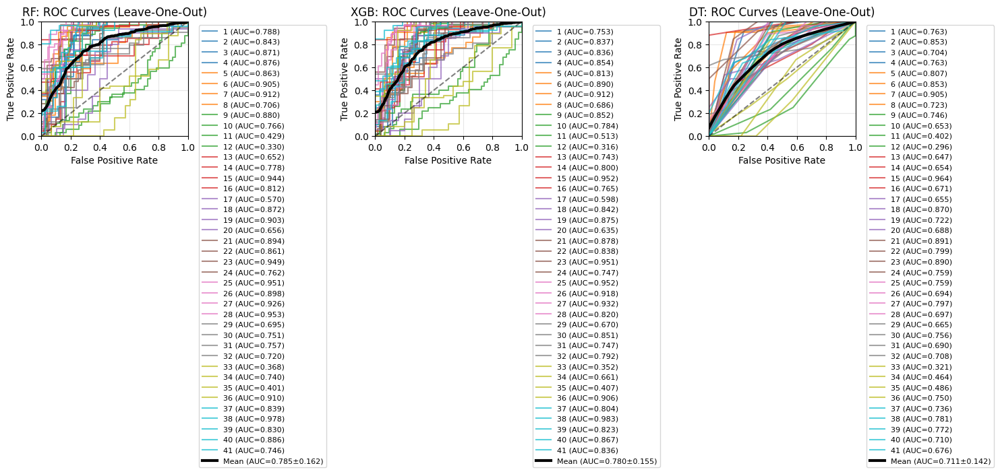

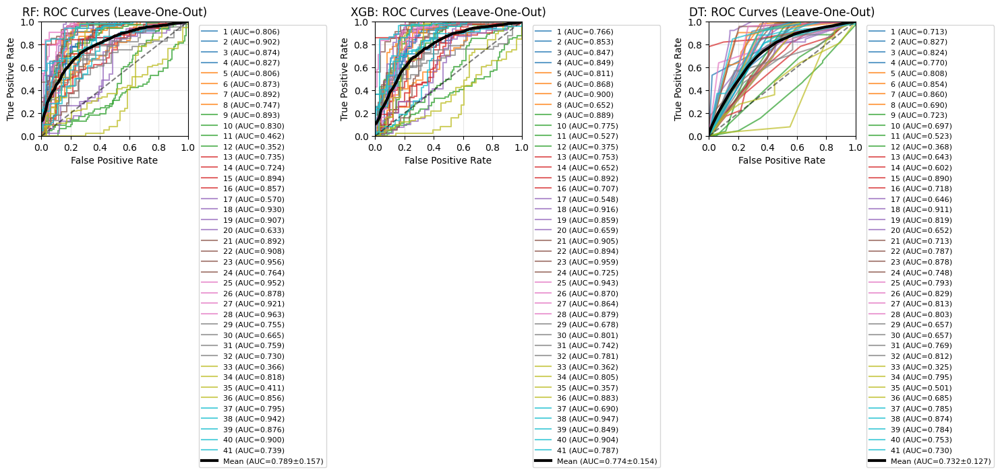

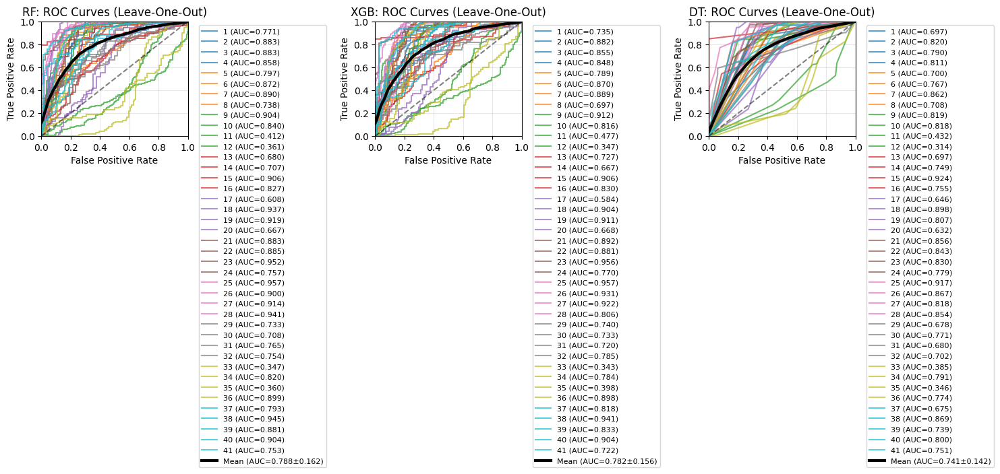

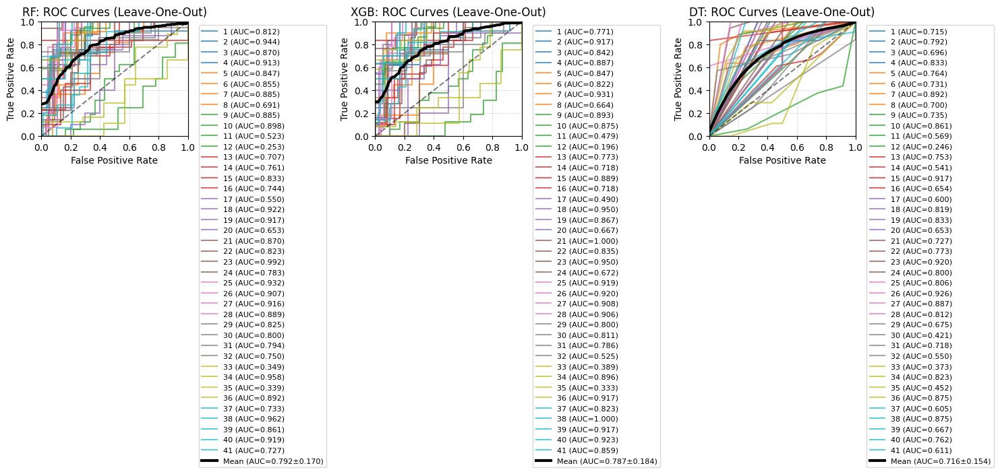

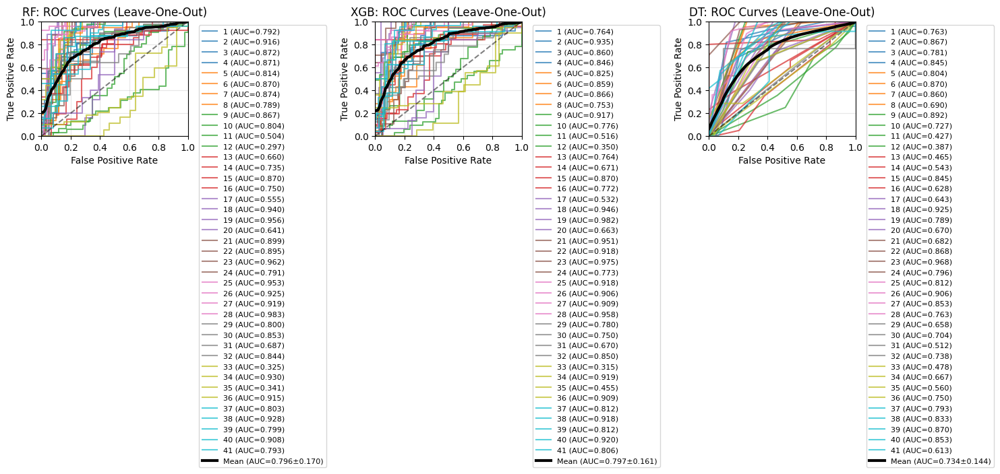

...

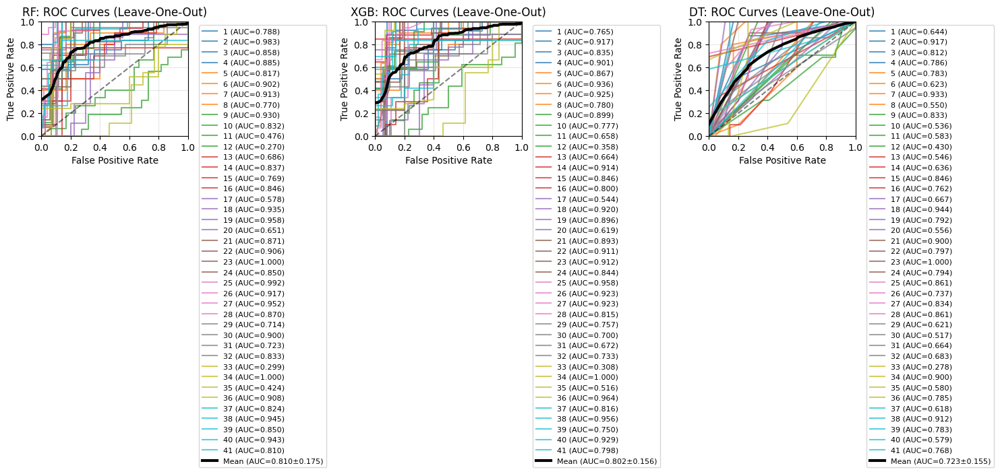

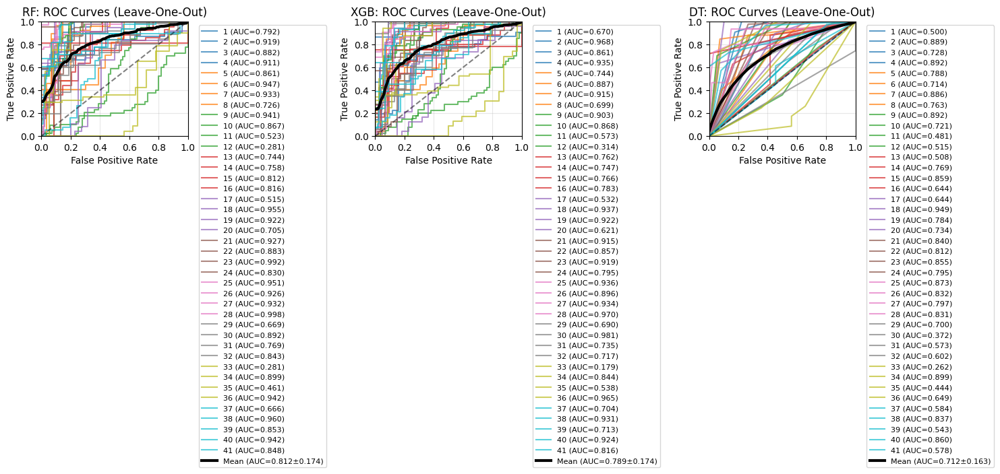

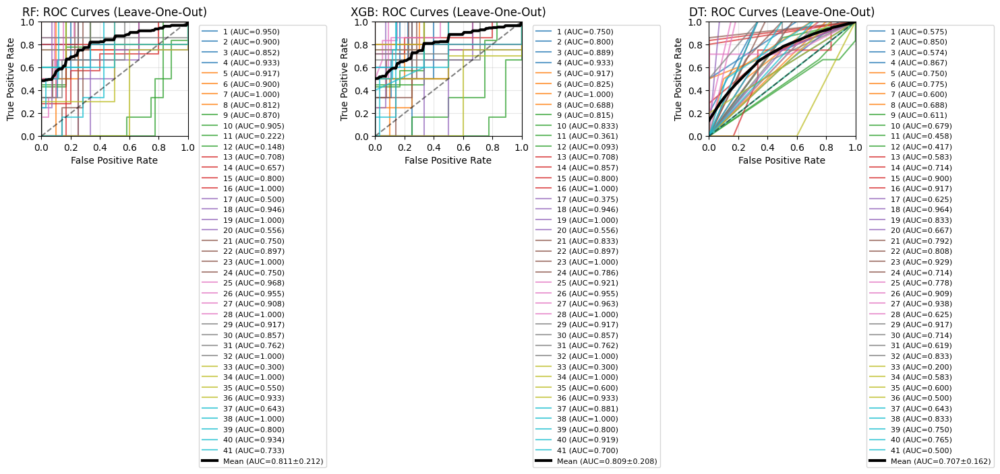

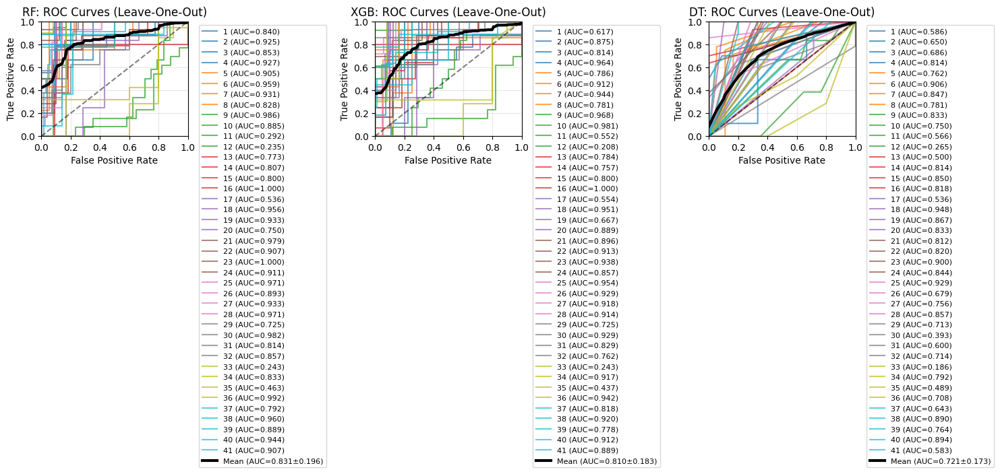

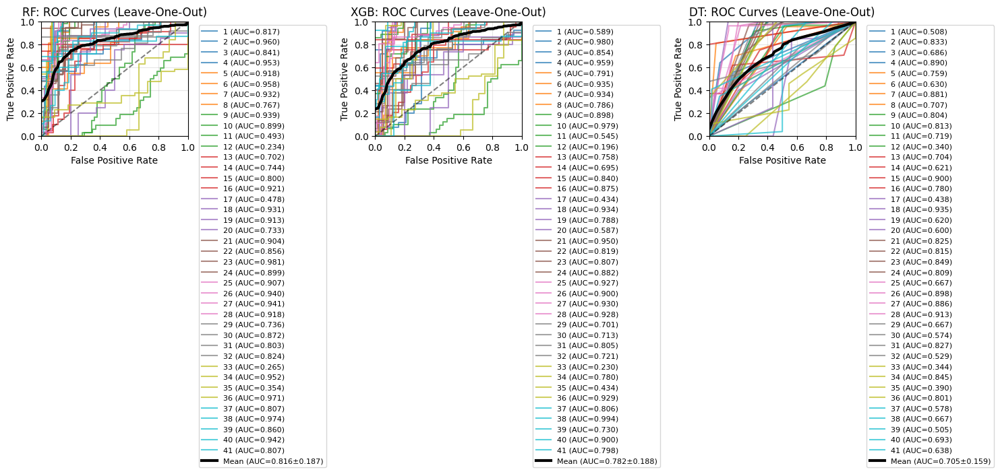

In [4]:
all_results = {}
for file in files:
    data_path = os.path.join(base_path, file)
    features = pd.read_csv(data_path)
    features.drop(columns=['center_time', 'start_time', 'end_time'], inplace=True)
    details = file.split('_')
    exp_name = f"{details[3]}_{details[-1].replace('.csv', '')}"
    print(f"Nested cross-validation for {exp_name}")
    
    X = features.drop(columns=['label', 'experiment_id'])
    y = features['label']
    groups = features['experiment_id']
    
    results = nested_cv_binary(X, y, groups, exp_name, positive_class="void", save_plots=True)

    # Save to csv
    results['results_dataframe'].to_csv(f'/home/edumaba/Public/MPhil_Thesis/Code/wear_uropatch/pipeline/nested_cv_results_loo/two_class/{exp_name}_two_class_nested_cv.csv')
    results['feature_summary'].to_csv(f'/home/edumaba/Public/MPhil_Thesis/Code/wear_uropatch/pipeline/nested_cv_results_loo/two_class/{exp_name}_two_class_feature_summary.csv')
    results['confusion_matrix_dataframe'].to_csv(f'/home/edumaba/Public/MPhil_Thesis/Code/wear_uropatch/pipeline/nested_cv_results_loo/two_class/{exp_name}_two_class_confusion_matrices.csv')


## Three class

In [5]:
# def nested_cv_multiclass(X, y, groups, exp_name, save_plots=True):
#     """
#     Run 3-class nested cross-validation with comprehensive results including confusion matrices.
    
#     Parameters:
#     -----------
#     X : DataFrame
#         Feature matrix
#     y : Series/array 
#         Target labels (3 classes: 'pre-void', 'void', 'post-void')
#     groups : Series/array
#         Group labels for GroupKFold
#     exp_name : str
#         Experiment name for saving plots
#     save_plots : bool
#         Whether to save visualization plots
        
#     Returns:
#     --------                cm_data = self.calculate_confusion_matrix(y_test_outer, y_pred, fold_idx, model_name)
#                     self.confusion_matrices[model_name].append(cm_data)
                    
#     dict: Comprehensive results including DataFrames and confusion matrices
#     """
#     # Initialize 3-class classifier
#     optimizer = NestedCVOptimizer(  
#         X=X,
#         y=y,
#         groups=groups,
#         n_outer_folds=5,
#         n_inner_folds=3,
#         n_trials=50,
#         random_state=42
#     )
    
#     print(f"\nRunning 3-class nested cross-validation...")
#     print(f"Expected classes: {sorted(y.unique())}")
#     summaries = optimizer.run_nested_cv()
    
#     # Get comprehensive results
#     results_df = optimizer.get_results_dataframe()
#     auc_summary = optimizer.get_auc_summary()
#     per_class_summary = optimizer.get_per_class_summary()
#     feature_summary = optimizer.get_feature_selection_summary()
#     cm_summary = optimizer.get_confusion_matrices_summary()
#     cm_dataframe = optimizer.get_confusion_matrix_dataframe()
    
#     # Print key results
#     print(f"\n📊 3-CLASS CLASSIFICATION RESULTS:")
#     if 'best_model' in summaries:
#         print(f"Best performing model: {summaries['best_model'].upper()}")
#         print(f"Best F1 (macro): {summaries['best_f1_macro']:.4f}")
#         print(f"Best accuracy: {summaries['best_accuracy']:.4f}")
#         print(f"Best macro AUC: {summaries['best_macro_auc']:.4f}")
#     else:
#         print("Error: Could not determine best model")
    
#     # Generate and save plots if requested
#     if save_plots:
#         plot_dir = f"plots_{exp_name}_multiclass"
#         import os
#         os.makedirs(plot_dir, exist_ok=True)
        
#         # ROC curves (one-vs-rest for each class)
#         optimizer.plot_roc_curves(save_path=f"{plot_dir}/roc_curves.png")
        
#         # AUC comparison
#         optimizer.plot_auc_comparison(save_path=f"{plot_dir}/auc_comparison.png")
        
#         # Feature selection analysis
#         optimizer.plot_feature_selection_analysis(save_path=f"{plot_dir}/feature_analysis.png")
        
#         # Confusion matrices - aggregated view
#         optimizer.plot_confusion_matrices(save_path=f"{plot_dir}/confusion_matrices.png")
        
#         # Individual fold confusion matrices for best model
#         best_model = summaries.get('best_model', 'rf')
#         optimizer.plot_individual_fold_cms(
#             model_name=best_model, 
#             save_path=f"{plot_dir}/cm_folds_{best_model}.png"
#         )
        
#         print(f"\n📁 Plots saved to: {plot_dir}/")
    
#     return {
#         'summary': summaries,
#         'results_dataframe': results_df,
#         'auc_summary': auc_summary,
#         'per_class_summary': per_class_summary,
#         'feature_summary': feature_summary,
#         'confusion_matrices': cm_summary,
#         'confusion_matrix_dataframe': cm_dataframe,
#         'optimizer': optimizer  # Keep reference for additional analysis
#     }

In [6]:
# files = [
#     'three_class_pp_1s_no.csv',
#     'three_class_pp_1s_0.5.csv',
#     'three_class_pp_1s_0.8.csv',
#     'three_class_pp_2s_no.csv',
#     'three_class_pp_2s_0.5.csv',
#     'three_class_pp_2s_0.8.csv',
#     'three_class_pp_3s_no.csv',
#     'three_class_pp_3s_0.5.csv',
#     'three_class_pp_3s_0.8.csv',
#     'three_class_pp_4s_no.csv',
#     'three_class_pp_4s_0.5.csv',
#     'three_class_pp_4s_0.8.csv',
#     'three_class_pp_5s_no.csv',
#     'three_class_pp_5s_0.5.csv',
#     'three_class_pp_5s_0.8.csv'
# ]

# base_path = '/home/edumaba/Public/MPhil_Thesis/Code/wear_uropatch/pipeline/modified/data_extracted_features'

In [7]:
# all_results = {}
# for file in files:
#     data_path = os.path.join(base_path, file)
#     features = pd.read_csv(data_path)
#     features.drop(columns=['center_time', 'start_time', 'end_time'], inplace=True)
#     details = file.split('_')
#     exp_name = f"{details[3]}_{details[-1].replace('.csv', '')}"
#     print(f"Nested cross-validation for {exp_name}")
    
#     X = features.drop(columns=['label', 'experiment_id'])
#     y = features['label']
#     groups = features['experiment_id']
    
#     results = nested_cv_multiclass(X, y, groups, exp_name, save_plots=True)

#     # Save to csv
#     results['results_dataframe'].to_csv(f'/home/edumaba/Public/MPhil_Thesis/Code/wear_uropatch/pipeline/modified/nested_cv_results/three_class/{exp_name}_two_class_nested_cv.csv')
#     results['feature_summary'].to_csv(f'/home/edumaba/Public/MPhil_Thesis/Code/wear_uropatch/pipeline/modified/nested_cv_results/three_class/{exp_name}_two_class_feature_summary.csv')
#     results['confusion_matrix_dataframe'].to_csv(f'/home/edumaba/Public/MPhil_Thesis/Code/wear_uropatch/pipeline/modified/nested_cv_results/three_class/{exp_name}_two_class_confusion_matrices.csv')